In [2]:
import numpy as np
import matplotlib.pyplot as plt
import osgeo.gdal as gdal
import osgeo.gdal_array
import pandas as pd
import os
import pandas as pd
from sklearn.metrics import r2_score
from maxvolpy.maxvol import rect_maxvol
from sklearn.naive_bayes import GaussianNB
from scipy.stats.mstats import mquantiles
from scipy.optimize import minimize
from maxvol_cut import rect_maxvol_cut, f_penal_2D
import clhs
from tools import norm_data, add_coords, gen_input, extend_score, points_selection_accuracy, f_no_cut, f_cut_eps, calc_score, good_points_brute_force, idx_to_idx
from tqdm import tqdm
import kennardstonealgorithm

%matplotlib inline

# Set BIG figure
plt.rcParams["figure.figsize"] = (12, 8)

ModuleNotFoundError: No module named 'kennardstonealgorithm'

In [ ]:
dr = './Variables_clustering_CCHR'  # The dir has a different name in repo
dr = 'Soil features'

names = [fl for fl in os.listdir(dr) if fl.endswith('.sdat')]
files = [gdal.Open(os.path.join(dr, x)) for x in names]
arrays = [x.ReadAsArray().flatten() for x in files]
shapes = [x.ReadAsArray().shape for x in files]
nodatas = [x.GetRasterBand(1).GetNoDataValue() for x in files]
names =  [x.replace('.sdat','').split('_')[2] for x in names]

global_nodata = nodatas[1]

In [34]:
#Create dataframe and drop NaN

df_without_types = pd.DataFrame(arrays, index = names).transpose()
empty_pixels = df_without_types['SIMWE'][0]
df_without_types.replace(empty_pixels, 0, regex=True, inplace=True)


In [35]:
#Browse soil types prediction

soil_types_raw1 = pd.read_csv(os.path.join(dr, 'naive_bayes_pred.csv'), sep = ";")
soil_types_raw2 = soil_types_raw1.rename(index=str, columns={"x": "Soil_types"})
soil_types = soil_types_raw2['Soil_types'].replace(float('NaN'), global_nodata)
soil_types.index = pd.to_numeric(soil_types.index)

In [36]:
#Create final dataframe with soil types

df_with_soil_types = pd.concat([df_without_types, soil_types], axis=1, ignore_index=False).fillna(global_nodata)
print("Old length = {}".format(len(df_with_soil_types)))

# ...and clean them
arrays_drop = df_with_soil_types
for i, no_d in enumerate(nodatas):
    arrays_drop = arrays_drop[arrays_drop.iloc[:, i] != no_d]

# Also drop NaH from 'Soil_types'
arrays_drop = arrays_drop[arrays_drop.iloc[:, -1] != global_nodata]
    
df_drop_with_types = arrays_drop.copy()
print("New length = {}".format(len(df_drop_with_types)))

Old length = 61845
New length = 57047


In [37]:
#Drop soil types to apply clustering

df_drop = df_drop_with_types.drop(['Soil_types'], axis = 1)

In [38]:
#Select only 5 variables

df_5features = df_drop[['slope','TWI','Cdep','FAcc','DEM']]

ar_5features  = np.asarray(df_5features.copy())

In [39]:
#data mode selection
mode = 3 # Change to 0, 1, 2 or 3
modes = ['usual', 'normed',
         'XY', 'XY_normed']

In [40]:
X, fn_X_embedded = gen_input(mode, df_5features, shapes, df_drop)
y = np.array(df_5features_types)[:,-1]

In [11]:
# Areas of types
vals, cnts = np.unique(y, return_counts=True)
print(vals, cnts)

[1. 2. 3. 4.] [ 1028 17912 34765  3342]


In [11]:
cnts[3]/(cnts[0]+cnts[1]+cnts[2]+cnts[3])

0.05858327344119761

In [12]:
%%time
n=15
f_cut = lambda idx, i : f_cut_eps(idx, i, X=X, eps=0.1)
f_penal = f_penal_2D(X = ar_5features[:, -2], Y = ar_5features[:, -1], bnd = 0.2, level = 0.5)
rr = points_selection_accuracy(X,y, n_pnts = n, cut_fun = f_cut, penalty = f_penal, to_ret_pred=True)

Accuracy: 0.39
CPU times: user 2.56 s, sys: 6.44 s, total: 9 s
Wall time: 787 ms


In [13]:
accrs = dict()
ress  = dict()
rng = range(7, 28)
for n in rng: 
    f_cut = lambda idx, i : f_cut_eps(idx, i, X=X, eps=0.1)
    f_penal = f_penal_2D(X = ar_5features[:, -2], Y = ar_5features[:, -1], bnd = 0.5, level = 0.5)

    rr = points_selection_accuracy(X,y, n_pnts = n, cut_fun = f_cut, penalty = f_penal, to_ret_pred=True)
                         
    accrs[n] = rr[0]
    ress[n]  = rr[1]

Accuracy: 0.42
Accuracy: 0.51
Accuracy: 0.52
Accuracy: 0.47
Accuracy: 0.47
Accuracy: 0.48
Accuracy: 0.49
Accuracy: 0.47
Accuracy: 0.63
Accuracy: 0.64
Accuracy: 0.64
Accuracy: 0.65
Accuracy: 0.62
Accuracy: 0.61
Accuracy: 0.61
Accuracy: 0.62
Accuracy: 0.62
Accuracy: 0.63
Accuracy: 0.63
Accuracy: 0.64
Accuracy: 0.64


In [14]:
x_ac_mv = sorted(accrs)
y_ac_mv = [accrs[i] for i in x_ac_mv]

### Random selection

In [15]:
#custom_accuracy
accrs_rnd = dict()
N = 1000
for n in rng:
    accrs_rnd[n] = np.empty(N)

for j in tqdm(range(N)):
    idx = np.random.choice(X.shape[0], rng[-1])
    for n in rng:
        accrs_rnd[n][j] = calc_score(idx[:n],X,y)

x_ac_rnd = sorted(accrs_rnd)
data = np.array([accrs_rnd[i] for i in x_ac_rnd]).T[:500]
y_ac_rnd = np.mean(data, axis=0)
eps = 0.05
qs = mquantiles(data, [eps, 1-eps], axis=0)

100%|██████████| 1000/1000 [03:28<00:00,  4.79it/s]


In [16]:
#vanilla_accuracy
plain_accrs_rnd = dict()
N = 1000
for n in rng:
    plain_accrs_rnd[n] = np.empty(N)

for j in tqdm(range(N)):
    idx = np.random.choice(X.shape[0], rng[-1])
    for n in rng:
        plain_accrs_rnd[n][j] = calc_score(idx[:n],X,y, to_ret_pred=False)

plain_x_ac_rnd = sorted(plain_accrs_rnd)
pl_data = np.array([plain_accrs_rnd[i] for i in plain_x_ac_rnd]).T[:500]
plain_y_ac_rnd = np.mean(data, axis=0)
eps = 0.05
plain_qs_rnd = mquantiles(pl_data, [eps, 1-eps], axis=0)

100%|██████████| 1000/1000 [03:44<00:00,  4.45it/s]


### CLHS selection

In [ ]:
#custom_accuracy
N = 1000
accrs_cLHS = dict()
for n in rng:
    accrs_cLHS[n] = np.zeros(N)

for j in tqdm(range(N)):
    for n in rng:

        num = clhs.clhs(X, num_samples = n)
        idx = num['sample_indices']
        np.seterr(divide='ignore', invalid='ignore')
        
        accrs_cLHS[n][j] = calc_score(idx,X,y)
        np.savetxt('cLHS_res_{}.txt'.format(n), accrs_cLHS[n])









  0%|          | 0/1000 [00:00<?, ?it/s]








cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |31/10000 [Elapsed time: 0.1035466194152832, ETA: 32.90411740733731, 302.97it/s]








cLHS:  1%|          |69/10000 [Elapsed time: 0.20474886894226074, ETA: 30.914319986317473, 321.24it/s]








cLHS:  1%|          |108/10000 [Elapsed time: 0.30684661865234375, ETA: 29.317218713714286, 337.41it/s]








cLHS:  1%|▏         |145/10000 [Elapsed time: 0.40866589546203613, ETA: 28.5888996571162, 344.71it/s]  








cLHS:  2%|▏         |173/10000 [Elapsed time: 0.5146074295043945, ETA: 31.083797576531733, 316.15it/s]








cLHS:  2%|▏         |201/10000 [Elapsed time: 0.6261043548583984, ETA: 33.24189244097856, 294.78it/s] 








cLHS:  2%|▏         |235/10000 [Elapsed time: 0.7264275550842285, ETA: 31.978523975089214, 305.36it/s]








cLHS:  3%|▎         |274/10000 [Elapsed time: 0.8277015686035156, ETA: 29.87168739797444, 325.59

cLHS: 52%|█████▏    |5155/10000 [Elapsed time: 12.499035835266113, ETA: 9.55863155183784, 506.87it/s] 








cLHS: 52%|█████▏    |5208/10000 [Elapsed time: 12.601319313049316, ETA: 9.388714601828969, 510.40it/s]








cLHS: 53%|█████▎    |5260/10000 [Elapsed time: 12.701753616333008, ETA: 9.250861424016948, 512.38it/s]








cLHS: 53%|█████▎    |5312/10000 [Elapsed time: 12.802786588668823, ETA: 9.137554424490144, 513.05it/s]








cLHS: 54%|█████▎    |5364/10000 [Elapsed time: 12.907004833221436, ETA: 9.108886875617289, 508.95it/s]








cLHS: 54%|█████▍    |5416/10000 [Elapsed time: 13.007980823516846, ETA: 8.978129386545627, 510.57it/s]








cLHS: 55%|█████▍    |5468/10000 [Elapsed time: 13.10811710357666, ETA: 8.830423613358848, 513.23it/s] 








cLHS: 55%|█████▌    |5520/10000 [Elapsed time: 13.20925259590149, ETA: 8.723103615391384, 513.58it/s]








cLHS: 56%|█████▌    |5572/10000 [Elapsed time: 13.310455799102783, ETA: 8.621137166818858, 513.62it/s]








cL

cLHS:  9%|▉         |930/10000 [Elapsed time: 1.822127103805542, ETA: 17.482680712352717, 518.80it/s] 








cLHS: 10%|▉         |983/10000 [Elapsed time: 1.9231386184692383, ETA: 17.320713576541998, 520.59it/s]








cLHS: 10%|█         |1036/10000 [Elapsed time: 2.0240139961242676, ETA: 17.17204838295887, 522.01it/s]








cLHS: 11%|█         |1089/10000 [Elapsed time: 2.1252119541168213, ETA: 17.053809525439107, 522.52it/s]








cLHS: 11%|█▏        |1142/10000 [Elapsed time: 2.226182222366333, ETA: 16.92988576022031, 523.22it/s]  








cLHS: 12%|█▏        |1195/10000 [Elapsed time: 2.327486991882324, ETA: 16.82876634847212, 523.21it/s]








cLHS: 12%|█▏        |1248/10000 [Elapsed time: 2.4290239810943604, ETA: 16.739261446398054, 522.84it/s]








cLHS: 13%|█▎        |1301/10000 [Elapsed time: 2.5298874378204346, ETA: 16.613120706893138, 523.62it/s]








cLHS: 14%|█▎        |1354/10000 [Elapsed time: 2.630509614944458, ETA: 16.482136529402364, 524.57it/s] 







cLHS: 67%|██████▋   |6745/10000 [Elapsed time: 14.107049703598022, ETA: 6.3072679122249955, 516.07it/s]








cLHS: 68%|██████▊   |6798/10000 [Elapsed time: 14.208949327468872, ETA: 6.192047022223482, 517.11it/s] 








cLHS: 68%|██████▊   |6850/10000 [Elapsed time: 14.310904026031494, ETA: 6.114407591682063, 515.18it/s]








cLHS: 69%|██████▉   |6902/10000 [Elapsed time: 14.41827392578125, ETA: 6.128554163032187, 505.50it/s] 








cLHS: 70%|██████▉   |6954/10000 [Elapsed time: 14.518784046173096, ETA: 5.985630874346395, 508.89it/s]








cLHS: 70%|███████   |7007/10000 [Elapsed time: 14.62015151977539, ETA: 5.833721038759967, 513.05it/s] 








cLHS: 71%|███████   |7060/10000 [Elapsed time: 14.721864938735962, ETA: 5.705329941031314, 515.31it/s]








cLHS: 71%|███████   |7112/10000 [Elapsed time: 14.826297998428345, ETA: 5.6622191589722215, 510.05it/s]








cLHS: 72%|███████▏  |7164/10000 [Elapsed time: 14.927258729934692, ETA: 5.543545464671755, 511.59it/s] 







cLHS: 25%|██▌       |2535/10000 [Elapsed time: 5.828806161880493, ETA: 20.79544614703167, 358.97it/s] 








cLHS: 26%|██▌       |2575/10000 [Elapsed time: 5.928866624832153, ETA: 20.04856570533955, 370.35it/s]








cLHS: 26%|██▌       |2615/10000 [Elapsed time: 6.02889347076416, ETA: 19.498153509249427, 378.75it/s]








cLHS: 27%|██▋       |2656/10000 [Elapsed time: 6.131066560745239, ETA: 19.064134321769917, 385.23it/s]








cLHS: 27%|██▋       |2697/10000 [Elapsed time: 6.232969760894775, ETA: 18.715738615628425, 390.21it/s]








cLHS: 27%|██▋       |2738/10000 [Elapsed time: 6.3353376388549805, ETA: 18.467237069935205, 393.24it/s]








cLHS: 28%|██▊       |2778/10000 [Elapsed time: 6.455613851547241, ETA: 19.364217805577056, 372.96it/s] 








cLHS: 28%|██▊       |2816/10000 [Elapsed time: 6.567987442016602, ETA: 19.864843604009454, 361.64it/s]








cLHS: 29%|██▊       |2866/10000 [Elapsed time: 6.669430255889893, ETA: 18.153227918383035, 392.99it/s]








c

cLHS: 77%|███████▋  |7664/10000 [Elapsed time: 18.72750473022461, ETA: 6.856211215794784, 340.71it/s] 








cLHS: 77%|███████▋  |7700/10000 [Elapsed time: 18.849090099334717, ETA: 7.056712895857404, 325.93it/s]








cLHS: 77%|███████▋  |7742/10000 [Elapsed time: 18.95126175880432, ETA: 6.490826256960742, 347.88it/s] 








cLHS: 78%|███████▊  |7784/10000 [Elapsed time: 19.051899909973145, ETA: 6.060099558155325, 365.67it/s]








cLHS: 78%|███████▊  |7822/10000 [Elapsed time: 19.153409242630005, ETA: 5.913313940248768, 368.32it/s]








cLHS: 79%|███████▊  |7860/10000 [Elapsed time: 19.28400468826294, ETA: 6.272166802051577, 341.19it/s] 








cLHS: 79%|███████▉  |7901/10000 [Elapsed time: 19.383965015411377, ETA: 5.843859090909642, 359.18it/s]








cLHS: 79%|███████▉  |7938/10000 [Elapsed time: 19.49878692626953, ETA: 5.935193781446315, 347.42it/s] 








cLHS: 80%|███████▉  |7974/10000 [Elapsed time: 19.61548662185669, ETA: 6.054626764144229, 334.62it/s]








cL

cLHS: 31%|███       |3093/10000 [Elapsed time: 6.63726019859314, ETA: 13.661366676139655, 505.59it/s] 








cLHS: 31%|███▏      |3144/10000 [Elapsed time: 6.780338764190674, ETA: 15.25551427848952, 449.41it/s]








cLHS: 32%|███▏      |3191/10000 [Elapsed time: 6.901987075805664, ETA: 15.8957836903483, 428.35it/s] 








cLHS: 32%|███▏      |3240/10000 [Elapsed time: 7.002448797225952, ETA: 15.208066457251524, 444.50it/s]








cLHS: 33%|███▎      |3292/10000 [Elapsed time: 7.103994607925415, ETA: 14.49657851520796, 462.73it/s] 








cLHS: 33%|███▎      |3344/10000 [Elapsed time: 7.205810070037842, ETA: 13.977611400244793, 476.19it/s]








cLHS: 34%|███▍      |3396/10000 [Elapsed time: 7.307124376296997, ETA: 13.564129644701572, 486.87it/s]








cLHS: 34%|███▍      |3447/10000 [Elapsed time: 7.408586263656616, ETA: 13.334819410898643, 491.42it/s]








cLHS: 35%|███▍      |3498/10000 [Elapsed time: 7.509895086288452, ETA: 13.13670123661665, 494.95it/s] 








cLH

cLHS: 85%|████████▌ |8511/10000 [Elapsed time: 19.32508683204651, ETA: 3.0617971973546525, 486.32it/s] 








cLHS: 86%|████████▌ |8563/10000 [Elapsed time: 19.426711559295654, ETA: 2.911674643279622, 493.53it/s]








cLHS: 86%|████████▌ |8614/10000 [Elapsed time: 19.52863621711731, ETA: 2.797061111774137, 495.52it/s] 








cLHS: 87%|████████▋ |8664/10000 [Elapsed time: 19.63246774673462, ETA: 2.7190099798673617, 491.36it/s]








cLHS: 87%|████████▋ |8714/10000 [Elapsed time: 19.755385160446167, ETA: 2.779545910322872, 462.67it/s]








cLHS: 88%|████████▊ |8761/10000 [Elapsed time: 19.8754985332489, ETA: 2.825121989046815, 438.57it/s]  








cLHS: 88%|████████▊ |8811/10000 [Elapsed time: 19.975878477096558, ETA: 2.6137983584169335, 454.89it/s]








cLHS: 89%|████████▊ |8859/10000 [Elapsed time: 20.076733827590942, ETA: 2.474508366606763, 461.10it/s] 








cLHS: 89%|████████▉ |8908/10000 [Elapsed time: 20.178282022476196, ETA: 2.3373557099047475, 467.19it/s]







cLHS: 35%|███▌      |3518/10000 [Elapsed time: 9.396878719329834, ETA: 24.640840726623576, 263.06it/s]








cLHS: 35%|███▌      |3545/10000 [Elapsed time: 9.510716915130615, ETA: 25.315084779821884, 254.99it/s]








cLHS: 36%|███▌      |3571/10000 [Elapsed time: 9.613609552383423, ETA: 25.30964045160148, 254.01it/s] 








cLHS: 36%|███▌      |3608/10000 [Elapsed time: 9.715096473693848, ETA: 22.877009746800162, 279.41it/s]








cLHS: 36%|███▋      |3646/10000 [Elapsed time: 9.816506147384644, ETA: 21.0041201455461, 302.51it/s]  








cLHS: 37%|███▋      |3680/10000 [Elapsed time: 9.91826605796814, ETA: 20.294593122364347, 311.41it/s]








cLHS: 37%|███▋      |3713/10000 [Elapsed time: 10.030997037887573, ETA: 20.578708902816434, 305.51it/s]








cLHS: 37%|███▋      |3747/10000 [Elapsed time: 10.134684801101685, ETA: 20.048079316815407, 311.90it/s]








cLHS: 38%|███▊      |3779/10000 [Elapsed time: 10.263939142227173, ETA: 21.494116711278153, 289.43it/s]









cLHS: 82%|████████▏ |8170/10000 [Elapsed time: 22.0662202835083, ETA: 4.348112871202674, 420.87it/s] 








cLHS: 82%|████████▏ |8214/10000 [Elapsed time: 22.1739501953125, ETA: 4.28198255265274, 417.10it/s] 








cLHS: 83%|████████▎ |8257/10000 [Elapsed time: 22.28167724609375, ETA: 4.234723005119339, 411.60it/s]








cLHS: 83%|████████▎ |8299/10000 [Elapsed time: 22.38692021369934, ETA: 4.172821818335293, 407.64it/s]








cLHS: 83%|████████▎ |8341/10000 [Elapsed time: 22.491724729537964, ETA: 4.090785939279556, 405.55it/s]








cLHS: 84%|████████▍ |8382/10000 [Elapsed time: 22.59456205368042, ETA: 4.009411146693965, 403.55it/s] 








cLHS: 84%|████████▍ |8425/10000 [Elapsed time: 22.69558572769165, ETA: 3.843238316080848, 409.81it/s]








cLHS: 85%|████████▍ |8477/10000 [Elapsed time: 22.79639744758606, ETA: 3.4873130678198314, 436.73it/s]








cLHS: 85%|████████▌ |8529/10000 [Elapsed time: 22.896633625030518, ETA: 3.2088021494565173, 458.43it/s]








cLHS: 

cLHS: 37%|███▋      |3659/10000 [Elapsed time: 8.691937923431396, ETA: 12.91561418532547, 490.96it/s]








cLHS: 37%|███▋      |3710/10000 [Elapsed time: 8.793693542480469, ETA: 12.728444263156263, 494.17it/s]








cLHS: 38%|███▊      |3760/10000 [Elapsed time: 8.897770404815674, ETA: 12.739810995928671, 489.80it/s]








cLHS: 38%|███▊      |3810/10000 [Elapsed time: 8.999529123306274, ETA: 12.622692009629088, 490.39it/s]








cLHS: 39%|███▊      |3860/10000 [Elapsed time: 9.101528644561768, ETA: 12.523351488570762, 490.28it/s]








cLHS: 39%|███▉      |3910/10000 [Elapsed time: 9.203177213668823, ETA: 12.411149020952111, 490.69it/s]








cLHS: 40%|███▉      |3960/10000 [Elapsed time: 9.307314157485962, ETA: 12.388091758705558, 487.57it/s]








cLHS: 40%|████      |4009/10000 [Elapsed time: 9.411288976669312, ETA: 12.418015663518226, 482.44it/s]








cLHS: 41%|████      |4058/10000 [Elapsed time: 9.513227939605713, ETA: 12.327870155751574, 482.00it/s]








cL

cLHS: 95%|█████████▌|9522/10000 [Elapsed time: 21.10354733467102, ETA: 1.5838455015449688, 301.80it/s]








cLHS: 96%|█████████▌|9554/10000 [Elapsed time: 21.20861530303955, ETA: 1.473923812602488, 302.59it/s] 








cLHS: 96%|█████████▌|9586/10000 [Elapsed time: 21.32860565185547, ETA: 1.423371469442963, 290.86it/s]








cLHS: 96%|█████████▌|9616/10000 [Elapsed time: 21.439203023910522, ETA: 1.3488109054431303, 284.70it/s]








cLHS: 96%|█████████▋|9648/10000 [Elapsed time: 21.5412118434906, ETA: 1.2013631525589392, 293.00it/s]  








cLHS: 97%|█████████▋|9678/10000 [Elapsed time: 21.640926361083984, ETA: 1.0913254255207898, 295.05it/s]








cLHS: 97%|█████████▋|9718/10000 [Elapsed time: 21.741148948669434, ETA: 0.8810622266649792, 320.07it/s]








cLHS: 98%|█████████▊|9760/10000 [Elapsed time: 21.843318939208984, ETA: 0.7001245645214116, 342.80it/s]








cLHS: 98%|█████████▊|9796/10000 [Elapsed time: 21.944477081298828, ETA: 0.5882859898984186, 346.77it/s]






cLHS: 51%|█████     |5065/10000 [Elapsed time: 10.901701211929321, ETA: 10.769331589825757, 458.25it/s]








cLHS: 51%|█████     |5116/10000 [Elapsed time: 11.00198221206665, ETA: 10.341770597894753, 472.26it/s] 








cLHS: 52%|█████▏    |5167/10000 [Elapsed time: 11.10292911529541, ETA: 10.037464883751785, 481.50it/s]








cLHS: 52%|█████▏    |5219/10000 [Elapsed time: 11.205023765563965, ETA: 9.765903616973203, 489.56it/s]








cLHS: 53%|█████▎    |5269/10000 [Elapsed time: 11.363145589828491, ETA: 11.247847691285074, 420.61it/s]








cLHS: 53%|█████▎    |5314/10000 [Elapsed time: 11.488407373428345, ETA: 11.709293253796279, 400.19it/s]








cLHS: 54%|█████▎    |5362/10000 [Elapsed time: 11.589144945144653, ETA: 11.036899274715976, 420.23it/s]








cLHS: 54%|█████▍    |5410/10000 [Elapsed time: 11.690718412399292, ETA: 10.557654888995645, 434.76it/s]








cLHS: 55%|█████▍    |5457/10000 [Elapsed time: 11.791143417358398, ETA: 10.231793757392428, 444.01it/s]




cLHS:  7%|▋         |689/10000 [Elapsed time: 1.4196133613586426, ETA: 18.083476241885606, 514.89it/s]








cLHS:  7%|▋         |741/10000 [Elapsed time: 1.520643949508667, ETA: 17.988303159700255, 514.72it/s] 








cLHS:  8%|▊         |794/10000 [Elapsed time: 1.622443437576294, ETA: 17.82475895780083, 516.47it/s] 








cLHS:  8%|▊         |846/10000 [Elapsed time: 1.7233161926269531, ETA: 17.72980495427685, 516.31it/s]








cLHS:  9%|▉         |899/10000 [Elapsed time: 1.8253693580627441, ETA: 17.601480616017046, 517.06it/s]








cLHS: 10%|▉         |952/10000 [Elapsed time: 1.9269664287567139, ETA: 17.45030460594243, 518.50it/s] 








cLHS: 10%|█         |1004/10000 [Elapsed time: 2.029618501663208, ETA: 17.467951341938214, 515.00it/s]








cLHS: 11%|█         |1056/10000 [Elapsed time: 2.1354188919067383, ETA: 17.610921077383374, 507.87it/s]








cLHS: 11%|█         |1107/10000 [Elapsed time: 2.2478187084198, ETA: 18.135599513577453, 490.36it/s]   








c

cLHS: 60%|██████    |6008/10000 [Elapsed time: 13.979434251785278, ETA: 8.415844997058727, 474.34it/s]








cLHS: 61%|██████    |6056/10000 [Elapsed time: 14.08207893371582, ETA: 8.352934118622017, 472.17it/s] 








cLHS: 61%|██████    |6104/10000 [Elapsed time: 14.184492826461792, ETA: 8.270658205922997, 471.06it/s]








cLHS: 62%|██████▏   |6152/10000 [Elapsed time: 14.285929918289185, ETA: 8.155441295182285, 471.83it/s]








cLHS: 62%|██████▏   |6200/10000 [Elapsed time: 14.386643648147583, ETA: 8.030827948974864, 473.18it/s]








cLHS: 62%|██████▎   |6250/10000 [Elapsed time: 14.48834753036499, ETA: 7.835074361873602, 478.62it/s] 








cLHS: 63%|██████▎   |6298/10000 [Elapsed time: 14.589583158493042, ETA: 7.756330566200123, 477.29it/s]








cLHS: 63%|██████▎   |6347/10000 [Elapsed time: 14.691733121871948, ETA: 7.6425980824441275, 477.98it/s]








cLHS: 64%|██████▍   |6395/10000 [Elapsed time: 14.79183554649353, ETA: 7.534842601152788, 478.44it/s]  









cLHS: 16%|█▌        |1592/10000 [Elapsed time: 3.587172508239746, ETA: 21.94420435888537, 383.15it/s]  








cLHS: 16%|█▋        |1631/10000 [Elapsed time: 3.689105272293091, ETA: 21.85193274468064, 382.99it/s]








cLHS: 17%|█▋        |1670/10000 [Elapsed time: 3.7898011207580566, ETA: 21.681964905102053, 384.19it/s]








cLHS: 17%|█▋        |1719/10000 [Elapsed time: 3.890739917755127, ETA: 20.20316740751216, 409.89it/s]  








cLHS: 18%|█▊        |1769/10000 [Elapsed time: 3.991360902786255, ETA: 19.02616624976318, 432.61it/s]








cLHS: 18%|█▊        |1819/10000 [Elapsed time: 4.092208623886108, ETA: 18.19267992304955, 449.69it/s]








cLHS: 19%|█▊        |1868/10000 [Elapsed time: 4.192961692810059, ETA: 17.669005741946638, 460.24it/s]








cLHS: 19%|█▉        |1916/10000 [Elapsed time: 4.294885873794556, ETA: 17.448439117943522, 463.31it/s]








cLHS: 20%|█▉        |1963/10000 [Elapsed time: 4.463608503341675, ETA: 20.79217836710158, 386.54it/s] 








c

cLHS: 75%|███████▍  |7451/10000 [Elapsed time: 15.84686017036438, ETA: 6.285758184543581, 405.52it/s] 








cLHS: 75%|███████▍  |7493/10000 [Elapsed time: 15.951292037963867, ETA: 6.199375105333379, 404.40it/s]








cLHS: 75%|███████▌  |7535/10000 [Elapsed time: 16.056145668029785, ETA: 6.112988152632407, 403.24it/s]








cLHS: 76%|███████▌  |7576/10000 [Elapsed time: 16.15893840789795, ETA: 6.0282179267106635, 402.11it/s]








cLHS: 76%|███████▌  |7617/10000 [Elapsed time: 16.262394189834595, ETA: 5.949434262012614, 400.54it/s]








cLHS: 77%|███████▋  |7658/10000 [Elapsed time: 16.365212440490723, ETA: 5.859811755890491, 399.67it/s]








cLHS: 77%|███████▋  |7699/10000 [Elapsed time: 16.48959469795227, ETA: 6.12393471183762, 375.74it/s]  








cLHS: 77%|███████▋  |7738/10000 [Elapsed time: 16.627095937728882, ETA: 6.607942384051205, 342.32it/s]








cLHS: 78%|███████▊  |7778/10000 [Elapsed time: 16.728466987609863, ETA: 6.234999579825545, 356.38it/s]








c

cLHS: 27%|██▋       |2681/10000 [Elapsed time: 6.808494567871094, ETA: 20.8736675824434, 350.63it/s]  








cLHS: 27%|██▋       |2723/10000 [Elapsed time: 6.910121440887451, ETA: 19.81315008524976, 367.28it/s]








cLHS: 28%|██▊       |2765/10000 [Elapsed time: 7.010697364807129, ETA: 18.98765229705766, 381.04it/s]








cLHS: 28%|██▊       |2807/10000 [Elapsed time: 7.111439943313599, ETA: 18.393038191909085, 391.07it/s]








cLHS: 28%|██▊       |2849/10000 [Elapsed time: 7.212450981140137, ETA: 17.968277357671347, 397.98it/s]








cLHS: 29%|██▉       |2892/10000 [Elapsed time: 7.314726829528809, ETA: 17.574080903672556, 404.46it/s]








cLHS: 29%|██▉       |2939/10000 [Elapsed time: 7.415158987045288, ETA: 16.739017460455248, 421.83it/s]








cLHS: 30%|██▉       |2988/10000 [Elapsed time: 7.515383243560791, ETA: 15.93290527963081, 440.10it/s] 








cLHS: 30%|███       |3033/10000 [Elapsed time: 7.662064075469971, ETA: 17.902422159928562, 389.17it/s]








cLH

cLHS: 81%|████████  |8091/10000 [Elapsed time: 19.242012977600098, ETA: 3.8289484265228726, 498.57it/s]








cLHS: 81%|████████▏ |8141/10000 [Elapsed time: 19.345112562179565, ETA: 3.7602938883745054, 494.38it/s]








cLHS: 82%|████████▏ |8191/10000 [Elapsed time: 19.44509506225586, ETA: 3.646867925188763, 496.04it/s]  








cLHS: 82%|████████▏ |8242/10000 [Elapsed time: 19.546142101287842, ETA: 3.5250755046945152, 498.71it/s]








cLHS: 83%|████████▎ |8293/10000 [Elapsed time: 19.647021055221558, ETA: 3.40876589992674, 500.77it/s]  








cLHS: 83%|████████▎ |8344/10000 [Elapsed time: 19.75383448600769, ETA: 3.3545374642608703, 493.66it/s]








cLHS: 84%|████████▍ |8394/10000 [Elapsed time: 19.85533118247986, ETA: 3.2566686028302616, 493.14it/s]








cLHS: 84%|████████▍ |8444/10000 [Elapsed time: 19.984530687332153, ETA: 3.4134008838012004, 455.85it/s]








cLHS: 85%|████████▍ |8491/10000 [Elapsed time: 20.10994839668274, ETA: 3.5261000451062534, 427.95it/s] 




cLHS: 36%|███▋      |3633/10000 [Elapsed time: 7.431033611297607, ETA: 12.582206646025096, 506.03it/s]








cLHS: 37%|███▋      |3684/10000 [Elapsed time: 7.531533718109131, ETA: 12.464483736666377, 506.72it/s]








cLHS: 37%|███▋      |3736/10000 [Elapsed time: 7.6332786083221436, ETA: 12.336549272607172, 507.76it/s]








cLHS: 38%|███▊      |3787/10000 [Elapsed time: 7.733909606933594, ETA: 12.242275851179311, 507.50it/s] 








cLHS: 38%|███▊      |3838/10000 [Elapsed time: 7.8346381187438965, ETA: 12.151812921935397, 507.08it/s]








cLHS: 39%|███▉      |3889/10000 [Elapsed time: 7.93475866317749, ETA: 12.033645868385001, 507.83it/s]  








cLHS: 39%|███▉      |3940/10000 [Elapsed time: 8.035848379135132, ETA: 11.955545669337646, 506.88it/s]








cLHS: 40%|███▉      |3991/10000 [Elapsed time: 8.141243696212769, ETA: 12.025677146161517, 499.68it/s]








cLHS: 40%|████      |4042/10000 [Elapsed time: 8.242424726486206, ETA: 11.892592488047915, 500.98it/s]







cLHS: 93%|█████████▎|9274/10000 [Elapsed time: 20.049699306488037, ETA: 1.5210313855984077, 477.31it/s]








cLHS: 93%|█████████▎|9326/10000 [Elapsed time: 20.151387214660645, ETA: 1.3839427243944828, 487.01it/s]








cLHS: 94%|█████████▍|9378/10000 [Elapsed time: 20.25341796875, ETA: 1.259900690003837, 493.69it/s]     








cLHS: 94%|█████████▍|9429/10000 [Elapsed time: 20.35364580154419, ETA: 1.1464576514902065, 498.06it/s]








cLHS: 95%|█████████▍|9479/10000 [Elapsed time: 20.45553183555603, ETA: 1.0505572834602335, 495.93it/s]








cLHS: 95%|█████████▌|9530/10000 [Elapsed time: 20.556447505950928, ETA: 0.9425199173870471, 498.66it/s]








cLHS: 96%|█████████▌|9581/10000 [Elapsed time: 20.656708240509033, ETA: 0.8351065302537497, 501.73it/s]








cLHS: 96%|█████████▋|9632/10000 [Elapsed time: 20.756836652755737, ETA: 0.7302687584392162, 503.92it/s]








cLHS: 97%|█████████▋|9683/10000 [Elapsed time: 20.860606908798218, ETA: 0.633724204587315, 500.22it/s] 




cLHS: 46%|████▋     |4625/10000 [Elapsed time: 10.928915977478027, ETA: 10.760332142356418, 499.52it/s]








cLHS: 47%|████▋     |4676/10000 [Elapsed time: 11.02932858467102, ETA: 10.604509662005118, 502.05it/s] 








cLHS: 47%|████▋     |4728/10000 [Elapsed time: 11.130868196487427, ETA: 10.441050898380771, 504.93it/s]








cLHS: 48%|████▊     |4780/10000 [Elapsed time: 11.23358678817749, ETA: 10.30825046248913, 506.39it/s]  








cLHS: 48%|████▊     |4831/10000 [Elapsed time: 11.425584554672241, ETA: 12.990184215600278, 397.92it/s]








cLHS: 49%|████▉     |4875/10000 [Elapsed time: 11.583617925643921, ETA: 14.531357884343373, 352.69it/s]








cLHS: 49%|████▉     |4914/10000 [Elapsed time: 11.729457139968872, ETA: 15.80918714633226, 321.71it/s] 








cLHS: 50%|████▉     |4950/10000 [Elapsed time: 11.86016058921814, ETA: 16.487714072377745, 306.29it/s]








cLHS: 50%|████▉     |4985/10000 [Elapsed time: 11.960444688796997, ETA: 15.775114451588884, 317.91it/s]



cLHS: 98%|█████████▊|9787/10000 [Elapsed time: 23.724972009658813, ETA: 0.4934088455719763, 431.69it/s]








cLHS: 98%|█████████▊|9836/10000 [Elapsed time: 23.824932098388672, ETA: 0.366399307278497, 447.60it/s] 








cLHS: 99%|█████████▉|9887/10000 [Elapsed time: 23.92552399635315, ETA: 0.24348958085318873, 464.09it/s]








cLHS: 99%|█████████▉|9935/10000 [Elapsed time: 24.025895595550537, ETA: 0.1388772132773395, 468.04it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 24.162933826446533, ETA: 0.0, 413.86it/s]               









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |42/10000 [Elapsed time: 0.10188126564025879, ETA: 24.018991504396713, 414.59it/s]








cLHS:  1%|          |70/10000 [Elapsed time: 0.20198678970336914, ETA: 27.422289081982203, 362.11it/s]








cLHS:  1%|          |103/10000 [Elapsed time: 0.30300211906433105, ETA: 28.199155443906783, 350.97it/s]








cLHS:  1%|▏         |131/10000 [El

cLHS: 55%|█████▍    |5478/10000 [Elapsed time: 11.806663751602173, ETA: 15.412656903194929, 293.40it/s]








cLHS: 55%|█████▌    |5509/10000 [Elapsed time: 11.928349018096924, ETA: 16.01099893394896, 280.49it/s] 








cLHS: 55%|█████▌    |5543/10000 [Elapsed time: 12.030108451843262, ETA: 15.12743575275718, 294.63it/s]








cLHS: 56%|█████▌    |5585/10000 [Elapsed time: 12.131865739822388, ETA: 13.698204690428566, 322.31it/s]








cLHS: 56%|█████▋    |5627/10000 [Elapsed time: 12.2333242893219, ETA: 12.667534371015687, 345.21it/s]  








cLHS: 57%|█████▋    |5663/10000 [Elapsed time: 12.354077100753784, ETA: 13.15367535147948, 329.72it/s]








cLHS: 57%|█████▋    |5698/10000 [Elapsed time: 12.468616724014282, ETA: 13.361369978887447, 321.97it/s]








cLHS: 57%|█████▋    |5739/10000 [Elapsed time: 12.568828582763672, ETA: 12.388342790209885, 343.95it/s]








cLHS: 58%|█████▊    |5781/10000 [Elapsed time: 12.670257568359375, ETA: 11.636179451180674, 362.58it/s]




cLHS: 10%|█         |1004/10000 [Elapsed time: 2.1275625228881836, ETA: 17.746777576734146, 506.91it/s]








cLHS: 11%|█         |1055/10000 [Elapsed time: 2.2277183532714844, ETA: 17.6302476764795, 507.37it/s]  








cLHS: 11%|█         |1107/10000 [Elapsed time: 2.3288984298706055, ETA: 17.448784624496714, 509.66it/s]








cLHS: 12%|█▏        |1159/10000 [Elapsed time: 2.430830240249634, ETA: 17.346424485788827, 509.67it/s] 








cLHS: 12%|█▏        |1211/10000 [Elapsed time: 2.5323822498321533, ETA: 17.222853991973555, 510.31it/s]








cLHS: 13%|█▎        |1263/10000 [Elapsed time: 2.634214162826538, ETA: 17.115265142029358, 510.48it/s] 








cLHS: 13%|█▎        |1315/10000 [Elapsed time: 2.7357189655303955, ETA: 17.00079187357805, 510.86it/s]








cLHS: 14%|█▎        |1367/10000 [Elapsed time: 2.838052749633789, ETA: 16.919072897759253, 510.25it/s]








cLHS: 14%|█▍        |1419/10000 [Elapsed time: 2.946619749069214, ETA: 17.150684267778846, 500.33it/s]





cLHS: 64%|██████▍   |6387/10000 [Elapsed time: 14.600267887115479, ETA: 7.560361478205582, 477.89it/s]








cLHS: 64%|██████▍   |6436/10000 [Elapsed time: 14.75157356262207, ETA: 8.525443140762967, 418.04it/s] 








cLHS: 65%|██████▍   |6480/10000 [Elapsed time: 14.861533880233765, ETA: 8.534279784909536, 412.45it/s]








cLHS: 65%|██████▌   |6523/10000 [Elapsed time: 14.973187685012817, ETA: 8.609456448476342, 403.86it/s]








cLHS: 66%|██████▌   |6565/10000 [Elapsed time: 15.082140922546387, ETA: 8.627236844054199, 398.16it/s]








cLHS: 66%|██████▌   |6606/10000 [Elapsed time: 15.188611268997192, ETA: 8.608170854072862, 394.28it/s]








cLHS: 66%|██████▋   |6646/10000 [Elapsed time: 15.348649740219116, ETA: 9.978408087778867, 336.13it/s]








cLHS: 67%|██████▋   |6682/10000 [Elapsed time: 15.45396113395691, ETA: 9.825854376601951, 337.68it/s] 








cLHS: 67%|██████▋   |6721/10000 [Elapsed time: 15.55557131767273, ETA: 9.360402425083741, 350.31it/s]








cL

cLHS: 14%|█▍        |1448/10000 [Elapsed time: 3.67496657371521, ETA: 19.179325188872077, 445.90it/s]  








cLHS: 15%|█▍        |1493/10000 [Elapsed time: 3.79640531539917, ETA: 20.232276225658232, 420.47it/s]








cLHS: 15%|█▌        |1540/10000 [Elapsed time: 3.897791862487793, ETA: 19.573614335060494, 432.21it/s]








cLHS: 16%|█▌        |1588/10000 [Elapsed time: 3.9988651275634766, ETA: 18.92925674005798, 444.39it/s]








cLHS: 16%|█▋        |1635/10000 [Elapsed time: 4.100131034851074, ETA: 18.59432132877734, 449.87it/s] 








cLHS: 17%|█▋        |1683/10000 [Elapsed time: 4.201345443725586, ETA: 18.189401467412754, 457.24it/s]








cLHS: 17%|█▋        |1730/10000 [Elapsed time: 4.303433418273926, ETA: 18.052099725075845, 458.12it/s]








cLHS: 18%|█▊        |1777/10000 [Elapsed time: 4.405347108840942, ETA: 17.91029312030874, 459.12it/s] 








cLHS: 18%|█▊        |1824/10000 [Elapsed time: 4.50853157043457, ETA: 17.853730586720868, 457.94it/s]








cL

cLHS: 69%|██████▉   |6911/10000 [Elapsed time: 16.19173502922058, ETA: 7.462505480815413, 413.94it/s] 








cLHS: 70%|██████▉   |6955/10000 [Elapsed time: 16.305874347686768, ETA: 7.52069231730262, 404.88it/s]








cLHS: 70%|██████▉   |6997/10000 [Elapsed time: 16.415344953536987, ETA: 7.539008063135619, 398.33it/s]








cLHS: 70%|███████   |7038/10000 [Elapsed time: 16.52177095413208, ETA: 7.5122154440069195, 394.29it/s]








cLHS: 71%|███████   |7079/10000 [Elapsed time: 16.629074335098267, ETA: 7.478670958724094, 390.58it/s]








cLHS: 71%|███████   |7119/10000 [Elapsed time: 16.73432445526123, ETA: 7.437871704805935, 387.34it/s] 








cLHS: 72%|███████▏  |7159/10000 [Elapsed time: 16.83842706680298, ETA: 7.352104561239372, 386.42it/s]








cLHS: 72%|███████▏  |7207/10000 [Elapsed time: 16.93863821029663, ETA: 6.8092939081465325, 410.17it/s]








cLHS: 73%|███████▎  |7258/10000 [Elapsed time: 17.0407874584198, ETA: 6.327992173829991, 433.31it/s]  








cLH

cLHS: 24%|██▎       |2372/10000 [Elapsed time: 5.679687023162842, ETA: 17.118294295387688, 445.61it/s]








cLHS: 24%|██▍       |2422/10000 [Elapsed time: 5.779972791671753, ETA: 16.463729242663653, 460.28it/s]








cLHS: 25%|██▍       |2472/10000 [Elapsed time: 5.880932807922363, ETA: 16.004672690914134, 470.36it/s]








cLHS: 25%|██▌       |2522/10000 [Elapsed time: 5.980905294418335, ETA: 15.616522418530543, 478.85it/s]








cLHS: 26%|██▌       |2573/10000 [Elapsed time: 6.08226203918457, ETA: 15.28708872699186, 485.83it/s]  








cLHS: 26%|██▌       |2623/10000 [Elapsed time: 6.183439493179321, ETA: 15.09967121445967, 488.55it/s]








cLHS: 27%|██▋       |2673/10000 [Elapsed time: 6.288732290267944, ETA: 15.134935673251535, 484.11it/s]








cLHS: 27%|██▋       |2723/10000 [Elapsed time: 6.390336990356445, ETA: 14.952030390804925, 486.69it/s]








cLHS: 28%|██▊       |2773/10000 [Elapsed time: 6.491297006607056, ETA: 14.7681480875717, 489.36it/s]  








cL

cLHS: 77%|███████▋  |7738/10000 [Elapsed time: 18.371798992156982, ETA: 7.851931813885813, 288.08it/s]








cLHS: 78%|███████▊  |7779/10000 [Elapsed time: 18.47350549697876, ETA: 7.047098969280169, 315.17it/s] 








cLHS: 78%|███████▊  |7820/10000 [Elapsed time: 18.575323581695557, ETA: 6.469386638325731, 336.97it/s]








cLHS: 79%|███████▊  |7861/10000 [Elapsed time: 18.677011013031006, ETA: 6.034522121347369, 354.46it/s]








cLHS: 79%|███████▉  |7898/10000 [Elapsed time: 18.800145626068115, ETA: 6.247052384920152, 336.48it/s]








cLHS: 79%|███████▉  |7933/10000 [Elapsed time: 18.91059970855713, ETA: 6.259880416123443, 330.20it/s] 








cLHS: 80%|███████▉  |7974/10000 [Elapsed time: 19.012726306915283, ETA: 5.808387184615996, 348.81it/s]








cLHS: 80%|████████  |8015/10000 [Elapsed time: 19.11461114883423, ETA: 5.4639595878083345, 363.29it/s]








cLHS: 81%|████████  |8056/10000 [Elapsed time: 19.21679711341858, ETA: 5.200104787362289, 373.84it/s] 








c

cLHS: 32%|███▏      |3161/10000 [Elapsed time: 6.986009836196899, ETA: 14.402350792196454, 474.85it/s]








cLHS: 32%|███▏      |3209/10000 [Elapsed time: 7.088022947311401, ETA: 14.33878312277532, 473.61it/s] 








cLHS: 33%|███▎      |3257/10000 [Elapsed time: 7.188482046127319, ETA: 14.210095404171796, 474.52it/s]








cLHS: 33%|███▎      |3307/10000 [Elapsed time: 7.290199518203735, ETA: 13.95148178937031, 479.73it/s] 








cLHS: 34%|███▎      |3357/10000 [Elapsed time: 7.392314910888672, ETA: 13.76234021544637, 482.69it/s]








cLHS: 34%|███▍      |3406/10000 [Elapsed time: 7.493991136550903, ETA: 13.67654678991152, 482.14it/s]








cLHS: 35%|███▍      |3456/10000 [Elapsed time: 7.5951690673828125, ETA: 13.467938881636874, 485.89it/s]








cLHS: 35%|███▌      |3506/10000 [Elapsed time: 7.696045398712158, ETA: 13.284751378565241, 488.83it/s] 








cLHS: 36%|███▌      |3555/10000 [Elapsed time: 7.803893327713013, ETA: 13.477242396834628, 478.21it/s]








c

cLHS: 87%|████████▋ |8681/10000 [Elapsed time: 19.452587604522705, ETA: 2.692936852099212, 489.80it/s]








cLHS: 87%|████████▋ |8731/10000 [Elapsed time: 19.553524017333984, ETA: 2.581759370521759, 491.53it/s]








cLHS: 88%|████████▊ |8781/10000 [Elapsed time: 19.65650224685669, ETA: 2.4895544277656456, 489.65it/s]








cLHS: 88%|████████▊ |8831/10000 [Elapsed time: 19.757209062576294, ETA: 2.377893235629306, 491.61it/s]








cLHS: 89%|████████▉ |8881/10000 [Elapsed time: 19.85882067680359, ETA: 2.275295115835784, 491.80it/s] 








cLHS: 89%|████████▉ |8931/10000 [Elapsed time: 19.960280656814575, ETA: 2.171509186256873, 492.28it/s]








cLHS: 90%|████████▉ |8981/10000 [Elapsed time: 20.06383466720581, ETA: 2.0826614023269614, 489.28it/s]








cLHS: 90%|█████████ |9030/10000 [Elapsed time: 20.17193579673767, ETA: 2.02862659513493, 478.16it/s]  








cLHS: 91%|█████████ |9078/10000 [Elapsed time: 20.273603916168213, ETA: 1.9364527871146933, 476.13it/s]










cLHS: 39%|███▊      |3868/10000 [Elapsed time: 9.1697838306427, ETA: 16.179099674320323, 379.01it/s] 








cLHS: 39%|███▉      |3907/10000 [Elapsed time: 9.26980996131897, ETA: 15.941677301789314, 382.21it/s]








cLHS: 39%|███▉      |3947/10000 [Elapsed time: 9.371665954589844, ETA: 15.70959787765691, 385.31it/s]








cLHS: 40%|███▉      |3987/10000 [Elapsed time: 9.4742431640625, ETA: 15.550669800994637, 386.67it/s] 








cLHS: 40%|████      |4028/10000 [Elapsed time: 9.574438571929932, ETA: 15.192165999442151, 393.10it/s]








cLHS: 41%|████      |4079/10000 [Elapsed time: 9.676224946975708, ETA: 14.090153987515638, 420.22it/s]








cLHS: 41%|████▏     |4130/10000 [Elapsed time: 9.777157306671143, ETA: 13.263378366290006, 442.57it/s]








cLHS: 42%|████▏     |4180/10000 [Elapsed time: 9.878686904907227, ETA: 12.750528739322494, 456.45it/s]








cLHS: 42%|████▏     |4231/10000 [Elapsed time: 9.979755878448486, ETA: 12.27747317532269, 469.88it/s] 








cLHS:

cLHS: 92%|█████████▏|9226/10000 [Elapsed time: 21.83018660545349, ETA: 1.5479370192308874, 500.02it/s]








cLHS: 93%|█████████▎|9277/10000 [Elapsed time: 21.93306803703308, ETA: 1.4501161290651432, 498.58it/s]








cLHS: 93%|█████████▎|9327/10000 [Elapsed time: 22.105791568756104, ETA: 1.6414173526980942, 410.01it/s]








cLHS: 94%|█████████▎|9371/10000 [Elapsed time: 22.223270177841187, ETA: 1.5782393035688438, 398.55it/s]








cLHS: 94%|█████████▍|9413/10000 [Elapsed time: 22.326627016067505, ETA: 1.4643647082177196, 400.86it/s]








cLHS: 95%|█████████▍|9455/10000 [Elapsed time: 22.430501461029053, ETA: 1.3560844149489037, 401.89it/s]








cLHS: 95%|█████████▍|9497/10000 [Elapsed time: 22.534005403518677, ETA: 1.2481890693436009, 402.98it/s]








cLHS: 95%|█████████▌|9538/10000 [Elapsed time: 22.63544487953186, ETA: 1.145093236019592, 403.46it/s]  








cLHS: 96%|█████████▌|9579/10000 [Elapsed time: 22.736156940460205, ETA: 1.0406957287055638, 404.54it/s]




cLHS: 47%|████▋     |4722/10000 [Elapsed time: 10.714232206344604, ETA: 10.861296030028004, 485.95it/s]








cLHS: 48%|████▊     |4774/10000 [Elapsed time: 10.815321207046509, ETA: 10.575684147596395, 494.15it/s]








cLHS: 48%|████▊     |4826/10000 [Elapsed time: 10.917065143585205, ETA: 10.365534145611342, 499.15it/s]








cLHS: 49%|████▉     |4877/10000 [Elapsed time: 11.017659664154053, ETA: 10.218578905342158, 501.34it/s]








cLHS: 49%|████▉     |4929/10000 [Elapsed time: 11.118976831436157, ETA: 10.04228666860622, 504.96it/s] 








cLHS: 50%|████▉     |4981/10000 [Elapsed time: 11.220717430114746, ETA: 9.903203763251804, 506.81it/s]








cLHS: 50%|█████     |5032/10000 [Elapsed time: 11.379251480102539, ETA: 11.490001989405501, 432.38it/s]








cLHS: 51%|█████     |5078/10000 [Elapsed time: 11.491516351699829, ETA: 11.57726736528441, 425.14it/s] 








cLHS: 51%|█████▏    |5130/10000 [Elapsed time: 11.593365669250488, ETA: 10.880217265947932, 447.60it/s]



cLHS:  5%|▍         |458/10000 [Elapsed time: 1.3416972160339355, ETA: 25.927788480098975, 368.02it/s]








cLHS:  5%|▍         |496/10000 [Elapsed time: 1.4705357551574707, ETA: 27.76499117760092, 342.30it/s] 








cLHS:  5%|▌         |537/10000 [Elapsed time: 1.5727028846740723, ETA: 26.424547020425006, 358.11it/s]








cLHS:  6%|▌         |578/10000 [Elapsed time: 1.6736400127410889, ETA: 25.37089595261046, 371.37it/s] 








cLHS:  6%|▌         |616/10000 [Elapsed time: 1.8027477264404297, ETA: 27.25143056416625, 344.35it/s]








cLHS:  7%|▋         |652/10000 [Elapsed time: 1.9101052284240723, ETA: 27.37228396289912, 341.51it/s]








cLHS:  7%|▋         |692/10000 [Elapsed time: 2.0105090141296387, ETA: 26.091410788771874, 356.75it/s]








cLHS:  7%|▋         |731/10000 [Elapsed time: 2.110778570175171, ETA: 25.337803760827324, 365.82it/s] 








cLHS:  8%|▊         |770/10000 [Elapsed time: 2.2112209796905518, ETA: 24.78847261887305, 372.35it/s]








cLHS

cLHS: 58%|█████▊    |5771/10000 [Elapsed time: 13.849182605743408, ETA: 10.776116685895834, 392.44it/s]








cLHS: 58%|█████▊    |5811/10000 [Elapsed time: 13.952340126037598, ETA: 10.713574065400557, 391.00it/s]








cLHS: 59%|█████▊    |5851/10000 [Elapsed time: 14.053923606872559, ETA: 10.590828529398328, 391.75it/s]








cLHS: 59%|█████▉    |5899/10000 [Elapsed time: 14.156286239624023, ETA: 9.95279573909503, 412.05it/s]  








cLHS: 59%|█████▉    |5941/10000 [Elapsed time: 14.258100271224976, ETA: 9.841962229307653, 412.42it/s]








cLHS: 60%|█████▉    |5983/10000 [Elapsed time: 14.383764266967773, ETA: 10.42772026718779, 385.22it/s]








cLHS: 60%|██████    |6032/10000 [Elapsed time: 14.484230518341064, ETA: 9.651606793742259, 411.12it/s]








cLHS: 61%|██████    |6075/10000 [Elapsed time: 14.585420846939087, ETA: 9.453852306083698, 415.17it/s]








cLHS: 61%|██████    |6118/10000 [Elapsed time: 14.712508201599121, ETA: 9.986891964086276, 388.71it/s]







cLHS: 11%|█▏        |1139/10000 [Elapsed time: 2.8358142375946045, ETA: 21.70357180906906, 408.27it/s]








cLHS: 12%|█▏        |1182/10000 [Elapsed time: 2.9453816413879395, ETA: 21.86197202085709, 403.35it/s]








cLHS: 12%|█▏        |1224/10000 [Elapsed time: 3.0521798133850098, ETA: 21.925120669649633, 400.27it/s]








cLHS: 13%|█▎        |1266/10000 [Elapsed time: 3.1582815647125244, ETA: 21.893219119588274, 398.94it/s]








cLHS: 13%|█▎        |1307/10000 [Elapsed time: 3.2628228664398193, ETA: 21.902752149726712, 396.89it/s]








cLHS: 13%|█▎        |1348/10000 [Elapsed time: 3.3657548427581787, ETA: 21.777169169152625, 397.30it/s]








cLHS: 14%|█▍        |1390/10000 [Elapsed time: 3.4675776958465576, ETA: 21.42829681810995, 401.81it/s] 








cLHS: 14%|█▍        |1439/10000 [Elapsed time: 3.569032669067383, ETA: 20.24044316531047, 422.97it/s] 








cLHS: 15%|█▍        |1488/10000 [Elapsed time: 3.6699860095977783, ETA: 19.344674322520106, 440.02it/s]





cLHS: 65%|██████▌   |6544/10000 [Elapsed time: 15.40441608428955, ETA: 7.099025509694718, 486.83it/s] 








cLHS: 66%|██████▌   |6593/10000 [Elapsed time: 15.505020141601562, ETA: 6.991342696306783, 487.32it/s]








cLHS: 66%|██████▋   |6642/10000 [Elapsed time: 15.608319520950317, ETA: 6.957407787665407, 482.65it/s]








cLHS: 67%|██████▋   |6692/10000 [Elapsed time: 15.708822011947632, ETA: 6.788183811747849, 487.32it/s]








cLHS: 67%|██████▋   |6743/10000 [Elapsed time: 15.810009717941284, ETA: 6.617085020576835, 492.21it/s]








cLHS: 68%|██████▊   |6793/10000 [Elapsed time: 15.910077333450317, ETA: 6.487229052805822, 494.36it/s]








cLHS: 68%|██████▊   |6843/10000 [Elapsed time: 16.011030673980713, ETA: 6.3836844789429295, 494.54it/s]








cLHS: 69%|██████▉   |6894/10000 [Elapsed time: 16.112539291381836, ETA: 6.249606276424369, 496.99it/s] 








cLHS: 69%|██████▉   |6945/10000 [Elapsed time: 16.21416139602661, ETA: 6.128017165443732, 498.53it/s] 









cLHS: 22%|██▏       |2245/10000 [Elapsed time: 4.4864020347595215, ETA: 15.521501765487232, 499.63it/s]








cLHS: 23%|██▎       |2295/10000 [Elapsed time: 4.5870044231414795, ETA: 15.446266580226894, 498.83it/s]








cLHS: 23%|██▎       |2345/10000 [Elapsed time: 4.687532424926758, ETA: 15.35365823684492, 498.58it/s]  








cLHS: 24%|██▍       |2395/10000 [Elapsed time: 4.788133144378662, ETA: 15.270948660891857, 498.00it/s]








cLHS: 24%|██▍       |2445/10000 [Elapsed time: 4.888387203216553, ETA: 15.165758942103677, 498.16it/s]








cLHS: 25%|██▍       |2495/10000 [Elapsed time: 4.989050388336182, ETA: 15.079011930917924, 497.71it/s]








cLHS: 25%|██▌       |2545/10000 [Elapsed time: 5.089114189147949, ETA: 14.960296433220833, 498.32it/s]








cLHS: 26%|██▌       |2598/10000 [Elapsed time: 5.191166400909424, ETA: 14.674920855759428, 504.40it/s]








cLHS: 27%|██▋       |2651/10000 [Elapsed time: 5.292918920516968, ETA: 14.433171400558876, 509.17it/s]








cLHS: 80%|████████  |8035/10000 [Elapsed time: 17.049813985824585, ETA: 4.992335864205507, 393.60it/s]








cLHS: 81%|████████  |8078/10000 [Elapsed time: 17.15112328529358, ETA: 4.775606968127648, 402.46it/s] 








cLHS: 81%|████████  |8119/10000 [Elapsed time: 17.251601457595825, ETA: 4.65045768513767, 404.48it/s]








cLHS: 82%|████████▏ |8160/10000 [Elapsed time: 17.354432344436646, ETA: 4.567602736943765, 402.84it/s]








cLHS: 82%|████████▏ |8201/10000 [Elapsed time: 17.454410314559937, ETA: 4.444222032291657, 404.80it/s]








cLHS: 82%|████████▏ |8243/10000 [Elapsed time: 17.556804418563843, ETA: 4.322615103624608, 406.47it/s]








cLHS: 83%|████████▎ |8288/10000 [Elapsed time: 17.657049417495728, ETA: 4.092005923495039, 418.38it/s]








cLHS: 83%|████████▎ |8340/10000 [Elapsed time: 17.758314609527588, ETA: 3.7489477749981486, 442.79it/s]








cLHS: 84%|████████▍ |8391/10000 [Elapsed time: 17.859319925308228, ETA: 3.49892681015746, 459.86it/s]  










cLHS: 35%|███▍      |3453/10000 [Elapsed time: 7.826678514480591, ETA: 17.913115295812805, 365.49it/s] 








cLHS: 35%|███▍      |3495/10000 [Elapsed time: 7.928494691848755, ETA: 17.190652629673128, 378.40it/s]








cLHS: 35%|███▌      |3537/10000 [Elapsed time: 8.030238389968872, ETA: 16.65191666186751, 388.12it/s] 








cLHS: 36%|███▌      |3577/10000 [Elapsed time: 8.16646933555603, ETA: 18.13176223544611, 354.24it/s] 








cLHS: 36%|███▌      |3618/10000 [Elapsed time: 8.268237352371216, ETA: 17.37728322840368, 367.26it/s]








cLHS: 37%|███▋      |3660/10000 [Elapsed time: 8.368946075439453, ETA: 16.645187743682307, 380.89it/s]








cLHS: 37%|███▋      |3702/10000 [Elapsed time: 8.469165563583374, ETA: 16.080218584321244, 391.66it/s]








cLHS: 37%|███▋      |3745/10000 [Elapsed time: 8.57156753540039, ETA: 15.650853316851828, 399.66it/s] 








cLHS: 38%|███▊      |3788/10000 [Elapsed time: 8.674178123474121, ETA: 15.316497628196242, 405.58it/s]








cL

cLHS: 92%|█████████▏|9192/10000 [Elapsed time: 20.076129913330078, ETA: 1.6486062009257905, 490.11it/s]








cLHS: 92%|█████████▏|9242/10000 [Elapsed time: 20.176839351654053, ETA: 1.5399531737231793, 492.22it/s]








cLHS: 93%|█████████▎|9292/10000 [Elapsed time: 20.28590154647827, ETA: 1.4697674791454103, 481.71it/s] 








cLHS: 93%|█████████▎|9341/10000 [Elapsed time: 20.387789011001587, ETA: 1.3691538512753576, 481.32it/s]








cLHS: 94%|█████████▍|9392/10000 [Elapsed time: 20.489776134490967, ETA: 1.2490783141841546, 486.76it/s]








cLHS: 94%|█████████▍|9442/10000 [Elapsed time: 20.589910745620728, ETA: 1.1375384807387, 490.53it/s]   








cLHS: 95%|█████████▍|9493/10000 [Elapsed time: 20.691314458847046, ETA: 1.0264069564014933, 493.96it/s]








cLHS: 95%|█████████▌|9544/10000 [Elapsed time: 20.792725324630737, ETA: 0.9182162686351849, 496.62it/s]








cLHS: 96%|█████████▌|9594/10000 [Elapsed time: 20.896682262420654, ETA: 0.8248431336606508, 492.21it/s]


cLHS: 47%|████▋     |4730/10000 [Elapsed time: 10.639470100402832, ETA: 13.018597655100402, 404.81it/s]








cLHS: 48%|████▊     |4772/10000 [Elapsed time: 10.746388912200928, ETA: 13.033400931878818, 401.12it/s]








cLHS: 48%|████▊     |4813/10000 [Elapsed time: 10.8512282371521, ETA: 13.030143600973839, 398.08it/s]  








cLHS: 49%|████▊     |4854/10000 [Elapsed time: 10.956082820892334, ETA: 12.994415538294255, 396.02it/s]








cLHS: 49%|████▉     |4894/10000 [Elapsed time: 11.066751718521118, ETA: 13.229560697140458, 385.95it/s]








cLHS: 49%|████▉     |4933/10000 [Elapsed time: 11.16794490814209, ETA: 13.169061653600316, 384.77it/s] 








cLHS: 50%|████▉     |4981/10000 [Elapsed time: 11.268027305603027, ETA: 12.27533073741043, 408.87it/s]








cLHS: 50%|█████     |5023/10000 [Elapsed time: 11.392173290252686, ETA: 12.930723545857653, 384.90it/s]








cLHS: 51%|█████     |5063/10000 [Elapsed time: 11.500597715377808, ETA: 13.005777974186524, 379.60it/s]



cLHS: 70%|███████   |7021/10000 [Elapsed time: 17.111793041229248, ETA: 7.940499155137106, 375.17it/s]








cLHS: 71%|███████   |7061/10000 [Elapsed time: 17.21361470222473, ETA: 7.729617381644513, 380.23it/s] 








cLHS: 71%|███████   |7101/10000 [Elapsed time: 17.316282987594604, ETA: 7.56811279456886, 383.05it/s]








cLHS: 71%|███████▏  |7140/10000 [Elapsed time: 17.467363595962524, ETA: 8.548557101956982, 334.56it/s]








cLHS: 72%|███████▏  |7175/10000 [Elapsed time: 17.574793815612793, ETA: 8.514685949437682, 331.78it/s]








cLHS: 72%|███████▏  |7215/10000 [Elapsed time: 17.676841735839844, ETA: 8.008010347053965, 347.78it/s]








cLHS: 73%|███████▎  |7254/10000 [Elapsed time: 17.77774953842163, ETA: 7.645497941392481, 359.17it/s] 








cLHS: 73%|███████▎  |7293/10000 [Elapsed time: 17.87729525566101, ETA: 7.361153315660719, 367.74it/s]








cLHS: 73%|███████▎  |7333/10000 [Elapsed time: 17.979527950286865, ETA: 7.121156641085722, 374.52it/s]








cLH

cLHS: 25%|██▍       |2467/10000 [Elapsed time: 5.449628591537476, ETA: 15.309849411070244, 492.04it/s]








cLHS: 25%|██▌       |2517/10000 [Elapsed time: 5.552884101867676, ETA: 15.27943674502694, 489.74it/s] 








cLHS: 26%|██▌       |2567/10000 [Elapsed time: 5.65831732749939, ETA: 15.324379283880369, 485.04it/s]








cLHS: 26%|██▌       |2616/10000 [Elapsed time: 5.7620298862457275, ETA: 15.34843212218851, 481.09it/s]








cLHS: 27%|██▋       |2665/10000 [Elapsed time: 5.865565299987793, ETA: 15.323390715966482, 478.68it/s]








cLHS: 27%|██▋       |2713/10000 [Elapsed time: 5.967750310897827, ETA: 15.306507474402771, 476.07it/s]








cLHS: 28%|██▊       |2761/10000 [Elapsed time: 6.068322658538818, ETA: 15.196815123826095, 476.35it/s]








cLHS: 28%|██▊       |2809/10000 [Elapsed time: 6.211493492126465, ETA: 16.996457050680984, 423.09it/s]








cLHS: 29%|██▊       |2853/10000 [Elapsed time: 6.324563264846802, ETA: 17.342205164009098, 412.12it/s]








cL

cLHS: 81%|████████  |8100/10000 [Elapsed time: 17.832512140274048, ETA: 3.8490861452994816, 493.62it/s]








cLHS: 82%|████████▏ |8151/10000 [Elapsed time: 17.93379807472229, ETA: 3.7220585449459427, 496.77it/s] 








cLHS: 82%|████████▏ |8202/10000 [Elapsed time: 18.03510284423828, ETA: 3.6050208590848234, 498.75it/s]








cLHS: 83%|████████▎ |8253/10000 [Elapsed time: 18.13613271713257, ETA: 3.4915919650535643, 500.34it/s]








cLHS: 83%|████████▎ |8304/10000 [Elapsed time: 18.23821473121643, ETA: 3.3903397790194076, 500.24it/s]








cLHS: 84%|████████▎ |8355/10000 [Elapsed time: 18.338980436325073, ETA: 3.2770306841848824, 501.98it/s]








cLHS: 84%|████████▍ |8406/10000 [Elapsed time: 18.439176559448242, ETA: 3.1625236722999266, 504.03it/s]








cLHS: 85%|████████▍ |8457/10000 [Elapsed time: 18.539788722991943, ETA: 3.057354497633699, 504.68it/s] 








cLHS: 85%|████████▌ |8508/10000 [Elapsed time: 18.640188694000244, ETA: 2.949354669971664, 505.87it/s]






cLHS: 37%|███▋      |3679/10000 [Elapsed time: 7.875304698944092, ETA: 12.443759531005185, 507.97it/s]








cLHS: 37%|███▋      |3730/10000 [Elapsed time: 7.979140281677246, ETA: 12.46749302196533, 502.91it/s] 








cLHS: 38%|███▊      |3781/10000 [Elapsed time: 8.088292598724365, ETA: 12.61415723290313, 493.02it/s]








cLHS: 38%|███▊      |3831/10000 [Elapsed time: 8.188308477401733, ETA: 12.494255413317829, 493.75it/s]








cLHS: 39%|███▉      |3883/10000 [Elapsed time: 8.290327548980713, ETA: 12.275578081064202, 498.31it/s]








cLHS: 39%|███▉      |3935/10000 [Elapsed time: 8.392306804656982, ETA: 12.08506394751753, 501.86it/s] 








cLHS: 40%|███▉      |3986/10000 [Elapsed time: 8.492808818817139, ETA: 11.943883290571966, 503.52it/s]








cLHS: 40%|████      |4037/10000 [Elapsed time: 8.593137264251709, ETA: 11.811853866789999, 504.83it/s]








cLHS: 41%|████      |4089/10000 [Elapsed time: 8.695091247558594, ETA: 11.673208388479578, 506.37it/s]








cL

cLHS: 85%|████████▍ |8497/10000 [Elapsed time: 20.65114688873291, ETA: 4.103350103980156, 366.29it/s] 








cLHS: 85%|████████▌ |8537/10000 [Elapsed time: 20.753166675567627, ETA: 3.915696144175136, 373.62it/s]








cLHS: 86%|████████▌ |8576/10000 [Elapsed time: 20.854284048080444, ETA: 3.775632223150359, 377.16it/s]








cLHS: 86%|████████▌ |8619/10000 [Elapsed time: 20.957605123519897, ETA: 3.548890482509739, 389.14it/s]








cLHS: 87%|████████▋ |8666/10000 [Elapsed time: 21.057891607284546, ETA: 3.2615881252200936, 409.00it/s]








cLHS: 87%|████████▋ |8713/10000 [Elapsed time: 21.1580650806427, ETA: 3.0254436707043943, 425.39it/s]  








cLHS: 88%|████████▊ |8760/10000 [Elapsed time: 21.259344577789307, ETA: 2.8422111592736905, 436.28it/s]








cLHS: 88%|████████▊ |8809/10000 [Elapsed time: 21.361557006835938, ETA: 2.656210158134283, 448.38it/s] 








cLHS: 89%|████████▊ |8857/10000 [Elapsed time: 21.462676763534546, ETA: 2.501054191736333, 457.01it/s]







cLHS: 34%|███▍      |3450/10000 [Elapsed time: 8.853016138076782, ETA: 13.491757333498297, 485.48it/s]








cLHS: 35%|███▌      |3501/10000 [Elapsed time: 8.95376706123352, ETA: 13.225004897282318, 491.42it/s] 








cLHS: 36%|███▌      |3551/10000 [Elapsed time: 9.053746700286865, ETA: 13.055751018755602, 493.96it/s]








cLHS: 36%|███▌      |3602/10000 [Elapsed time: 9.15468144416809, ETA: 12.862868033334562, 497.40it/s] 








cLHS: 37%|███▋      |3653/10000 [Elapsed time: 9.255524158477783, ETA: 12.697885612516847, 499.85it/s]








cLHS: 37%|███▋      |3704/10000 [Elapsed time: 9.357235193252563, ETA: 12.58332508866626, 500.34it/s] 








cLHS: 38%|███▊      |3755/10000 [Elapsed time: 9.526784181594849, ETA: 14.958437037437157, 417.49it/s]








cLHS: 38%|███▊      |3800/10000 [Elapsed time: 9.654676914215088, ETA: 15.687975248010478, 395.21it/s]








cLHS: 38%|███▊      |3842/10000 [Elapsed time: 9.762070178985596, ETA: 15.626157716246974, 394.08it/s]








c

cLHS: 80%|███████▉  |7982/10000 [Elapsed time: 21.818405866622925, ETA: 4.528476385845623, 445.62it/s]








cLHS: 80%|████████  |8033/10000 [Elapsed time: 21.919254779815674, ETA: 4.258354853051127, 461.92it/s]








cLHS: 81%|████████  |8083/10000 [Elapsed time: 22.01981258392334, ETA: 4.061797028354653, 471.96it/s] 








cLHS: 81%|████████▏ |8134/10000 [Elapsed time: 22.120139360427856, ETA: 3.868710901173385, 482.33it/s]








cLHS: 82%|████████▏ |8185/10000 [Elapsed time: 22.220823049545288, ETA: 3.7090972739574006, 489.34it/s]








cLHS: 82%|████████▏ |8236/10000 [Elapsed time: 22.320985555648804, ETA: 3.563039992038734, 495.08it/s] 








cLHS: 83%|████████▎ |8286/10000 [Elapsed time: 22.428032398223877, ETA: 3.5246114245119937, 486.29it/s]








cLHS: 83%|████████▎ |8335/10000 [Elapsed time: 22.531447410583496, ETA: 3.4502772901886845, 482.57it/s]








cLHS: 84%|████████▍ |8384/10000 [Elapsed time: 22.633795738220215, ETA: 3.3580142962720805, 481.24it/s]






cLHS: 36%|███▌      |3554/10000 [Elapsed time: 7.852820873260498, ETA: 18.689695305516597, 344.90it/s]








cLHS: 36%|███▌      |3590/10000 [Elapsed time: 7.957587003707886, ETA: 18.606398937413534, 344.51it/s]








cLHS: 36%|███▋      |3626/10000 [Elapsed time: 8.070873022079468, ETA: 18.978445146736487, 335.85it/s]








cLHS: 37%|███▋      |3668/10000 [Elapsed time: 8.171701192855835, ETA: 17.74830637314892, 356.77it/s] 








cLHS: 37%|███▋      |3710/10000 [Elapsed time: 8.272249221801758, ETA: 16.866556559675967, 372.93it/s]








cLHS: 38%|███▊      |3753/10000 [Elapsed time: 8.374551773071289, ETA: 16.18191134939811, 386.05it/s] 








cLHS: 38%|███▊      |3793/10000 [Elapsed time: 8.518074035644531, ETA: 17.935273674351624, 346.08it/s]








cLHS: 38%|███▊      |3829/10000 [Elapsed time: 8.65058946609497, ETA: 19.294286924540053, 319.84it/s] 








cLHS: 39%|███▊      |3863/10000 [Elapsed time: 8.780773401260376, ETA: 20.48490790802804, 299.59it/s]








cL

cLHS: 88%|████████▊ |8849/10000 [Elapsed time: 20.446117401123047, ETA: 2.95389816301522, 389.65it/s]  








cLHS: 89%|████████▉ |8889/10000 [Elapsed time: 20.55052947998047, ETA: 2.8670241695951506, 387.51it/s]








cLHS: 89%|████████▉ |8928/10000 [Elapsed time: 20.651796102523804, ETA: 2.771843770701072, 386.75it/s]








cLHS: 90%|████████▉ |8969/10000 [Elapsed time: 20.753003358840942, ETA: 2.6298186448630565, 392.04it/s]








cLHS: 90%|█████████ |9017/10000 [Elapsed time: 20.85424566268921, ETA: 2.377625094484669, 413.44it/s]  








cLHS: 91%|█████████ |9063/10000 [Elapsed time: 20.95543098449707, ETA: 2.204669222614785, 425.01it/s]








cLHS: 91%|█████████ |9111/10000 [Elapsed time: 21.05557608604431, ETA: 2.0205149948888317, 439.99it/s]








cLHS: 92%|█████████▏|9162/10000 [Elapsed time: 21.15596652030945, ETA: 1.8276538208436608, 458.51it/s]








cLHS: 92%|█████████▏|9213/10000 [Elapsed time: 21.257490634918213, ETA: 1.6718305752497902, 470.74it/s]








cLHS: 44%|████▍     |4382/10000 [Elapsed time: 9.349843502044678, ETA: 11.44948059129086, 490.68it/s]








cLHS: 44%|████▍     |4433/10000 [Elapsed time: 9.451237440109253, ETA: 11.264083468929009, 494.23it/s]








cLHS: 45%|████▍     |4484/10000 [Elapsed time: 9.552832126617432, ETA: 11.106458237814268, 496.65it/s]








cLHS: 45%|████▌     |4534/10000 [Elapsed time: 9.658724308013916, ETA: 11.177592022616357, 489.01it/s]








cLHS: 46%|████▌     |4585/10000 [Elapsed time: 9.759409427642822, ETA: 10.960090736316292, 494.07it/s]








cLHS: 46%|████▋     |4636/10000 [Elapsed time: 9.859684228897095, ETA: 10.761544007970723, 498.44it/s]








cLHS: 47%|████▋     |4687/10000 [Elapsed time: 9.960256814956665, ETA: 10.604236849657052, 501.03it/s]








cLHS: 47%|████▋     |4738/10000 [Elapsed time: 10.064608812332153, ETA: 10.57615630931819, 497.53it/s]








cLHS: 48%|████▊     |4788/10000 [Elapsed time: 10.165537118911743, ETA: 10.492652007275058, 496.73it/s]








c

cLHS: 95%|█████████▍|9499/10000 [Elapsed time: 22.284830570220947, ETA: 1.2747378484945537, 393.02it/s]








cLHS: 95%|█████████▌|9539/10000 [Elapsed time: 22.387864112854004, ETA: 1.1766246406661207, 391.80it/s]








cLHS: 96%|█████████▌|9579/10000 [Elapsed time: 22.49031662940979, ETA: 1.0763064369452315, 391.15it/s] 








cLHS: 96%|█████████▌|9624/10000 [Elapsed time: 22.590684413909912, ETA: 0.9247593068264013, 406.59it/s]








cLHS: 97%|█████████▋|9665/10000 [Elapsed time: 22.730704069137573, ETA: 0.9204131607446604, 363.97it/s]








cLHS: 97%|█████████▋|9703/10000 [Elapsed time: 22.831085205078125, ETA: 0.8063572226214152, 368.32it/s]








cLHS: 97%|█████████▋|9743/10000 [Elapsed time: 22.932146787643433, ETA: 0.6834406573853938, 376.04it/s]








cLHS: 98%|█████████▊|9784/10000 [Elapsed time: 23.033273220062256, ETA: 0.5615274589271382, 384.67it/s]








cLHS: 98%|█████████▊|9826/10000 [Elapsed time: 23.135286331176758, ETA: 0.44342859663016737, 392.40it/s]

cLHS: 50%|████▉     |4986/10000 [Elapsed time: 11.076897621154785, ETA: 12.606588476533082, 397.73it/s]








cLHS: 50%|█████     |5027/10000 [Elapsed time: 11.21365737915039, ETA: 13.72832769599311, 362.24it/s]  








cLHS: 51%|█████     |5067/10000 [Elapsed time: 11.314490795135498, ETA: 13.264678959199074, 371.89it/s]








cLHS: 51%|█████     |5107/10000 [Elapsed time: 11.41510796546936, ETA: 12.9021115464752, 379.24it/s]   








cLHS: 51%|█████▏    |5147/10000 [Elapsed time: 11.515618085861206, ETA: 12.615191035983216, 384.69it/s]








cLHS: 52%|█████▏    |5187/10000 [Elapsed time: 11.615861654281616, ETA: 12.373903764056847, 388.96it/s]








cLHS: 52%|█████▏    |5227/10000 [Elapsed time: 11.716421604156494, ETA: 12.194363453498784, 391.41it/s]








cLHS: 53%|█████▎    |5267/10000 [Elapsed time: 11.816818952560425, ETA: 12.023650613565904, 393.64it/s]








cLHS: 53%|█████▎    |5317/10000 [Elapsed time: 11.918000936508179, ETA: 11.170787258984438, 419.22it/s]


cLHS:  8%|▊         |778/10000 [Elapsed time: 1.6237218379974365, ETA: 18.86592832099562, 488.82it/s] 








cLHS:  8%|▊         |828/10000 [Elapsed time: 1.7246787548065186, ETA: 18.691301742002384, 490.71it/s]








cLHS:  9%|▉         |878/10000 [Elapsed time: 1.8252089023590088, ETA: 18.51919952047697, 492.57it/s] 








cLHS:  9%|▉         |928/10000 [Elapsed time: 1.9253759384155273, ETA: 18.34027645757713, 494.65it/s]








cLHS: 10%|▉         |979/10000 [Elapsed time: 2.027514934539795, ETA: 18.181467647532845, 496.16it/s]








cLHS: 10%|█         |1029/10000 [Elapsed time: 2.1308488845825195, ETA: 18.227509786470215, 492.17it/s]








cLHS: 11%|█         |1079/10000 [Elapsed time: 2.23616361618042, ETA: 18.323151890908242, 486.87it/s]  








cLHS: 11%|█▏        |1128/10000 [Elapsed time: 2.3432796001434326, ETA: 18.570055267895654, 477.76it/s]








cLHS: 12%|█▏        |1176/10000 [Elapsed time: 2.4436283111572266, ETA: 18.459102221888333, 478.03it/s]









cLHS: 62%|██████▏   |6247/10000 [Elapsed time: 14.150508403778076, ETA: 11.908702882048615, 315.15it/s]








cLHS: 63%|██████▎   |6283/10000 [Elapsed time: 14.25214695930481, ETA: 11.412846989266788, 325.69it/s] 








cLHS: 63%|██████▎   |6324/10000 [Elapsed time: 14.353502750396729, ETA: 10.620181586759626, 346.13it/s]








cLHS: 64%|██████▎   |6360/10000 [Elapsed time: 14.496296644210815, ETA: 11.694827654878692, 311.25it/s]








cLHS: 64%|██████▍   |6395/10000 [Elapsed time: 14.597232580184937, ETA: 11.230157653912526, 321.01it/s]








cLHS: 64%|██████▍   |6430/10000 [Elapsed time: 14.69888424873352, ETA: 10.89537372919269, 327.66it/s]  








cLHS: 65%|██████▍   |6464/10000 [Elapsed time: 14.834192991256714, ETA: 11.772217750295276, 300.37it/s]








cLHS: 65%|██████▍   |6496/10000 [Elapsed time: 14.949387788772583, ETA: 11.950604143602982, 293.21it/s]








cLHS: 65%|██████▌   |6527/10000 [Elapsed time: 15.061667680740356, ETA: 12.066234543636444, 287.83it/s]


cLHS: 15%|█▌        |1544/10000 [Elapsed time: 3.590240955352783, ETA: 22.66463866659002, 373.09it/s]  








cLHS: 16%|█▌        |1583/10000 [Elapsed time: 3.69061017036438, ETA: 22.295303631806462, 377.52it/s]








cLHS: 16%|█▌        |1622/10000 [Elapsed time: 3.7919399738311768, ETA: 22.064884274171487, 379.70it/s]








cLHS: 17%|█▋        |1661/10000 [Elapsed time: 3.892583131790161, ETA: 21.83050773999364, 381.99it/s]  








cLHS: 17%|█▋        |1700/10000 [Elapsed time: 3.9928460121154785, ETA: 21.605197711574224, 384.17it/s]








cLHS: 17%|█▋        |1739/10000 [Elapsed time: 4.093084812164307, ETA: 21.42400199117904, 385.60it/s]  








cLHS: 18%|█▊        |1779/10000 [Elapsed time: 4.194293260574341, ETA: 21.160594880351457, 388.51it/s]








cLHS: 18%|█▊        |1829/10000 [Elapsed time: 4.29503607749939, ETA: 19.670438677790287, 415.39it/s] 








cLHS: 19%|█▉        |1878/10000 [Elapsed time: 4.395336866378784, ETA: 18.668215882604294, 435.07it/s]







cLHS: 72%|███████▏  |7212/10000 [Elapsed time: 15.892253160476685, ETA: 5.525739733825523, 504.55it/s]








cLHS: 73%|███████▎  |7264/10000 [Elapsed time: 15.994066715240479, ETA: 5.400794125243223, 506.59it/s]








cLHS: 73%|███████▎  |7315/10000 [Elapsed time: 16.098172664642334, ETA: 5.355359561407461, 501.37it/s]








cLHS: 74%|███████▎  |7366/10000 [Elapsed time: 16.198894500732422, ETA: 5.240314453855129, 502.64it/s]








cLHS: 74%|███████▍  |7418/10000 [Elapsed time: 16.29950761795044, ETA: 5.094885028071041, 506.78it/s] 








cLHS: 75%|███████▍  |7469/10000 [Elapsed time: 16.400516986846924, ETA: 4.998413634736775, 506.36it/s]








cLHS: 75%|███████▌  |7520/10000 [Elapsed time: 16.505091190338135, ETA: 4.953807354337089, 500.63it/s]








cLHS: 76%|███████▌  |7571/10000 [Elapsed time: 16.60626792907715, ETA: 4.8431461724401075, 501.53it/s]








cLHS: 76%|███████▌  |7623/10000 [Elapsed time: 16.707668781280518, ETA: 4.708430086092608, 504.84it/s]








c

cLHS: 27%|██▋       |2745/10000 [Elapsed time: 5.921498775482178, ETA: 14.615409746468904, 496.39it/s]








cLHS: 28%|██▊       |2796/10000 [Elapsed time: 6.022484540939331, ETA: 14.433448948986621, 499.12it/s]








cLHS: 28%|██▊       |2847/10000 [Elapsed time: 6.123385429382324, ETA: 14.279457809159076, 500.93it/s]








cLHS: 29%|██▉       |2898/10000 [Elapsed time: 6.223767518997192, ETA: 14.117673502239285, 503.06it/s]








cLHS: 29%|██▉       |2949/10000 [Elapsed time: 6.325530767440796, ETA: 14.03076179297539, 502.54it/s] 








cLHS: 30%|███       |3000/10000 [Elapsed time: 6.43235182762146, ETA: 14.155948970385758, 494.49it/s]








cLHS: 31%|███       |3051/10000 [Elapsed time: 6.533840894699097, ETA: 13.984986773735669, 496.89it/s]








cLHS: 31%|███       |3101/10000 [Elapsed time: 6.634001016616821, ETA: 13.868189468427191, 497.47it/s]








cLHS: 32%|███▏      |3152/10000 [Elapsed time: 6.735044479370117, ETA: 13.702578702706264, 499.76it/s]








cL

cLHS: 82%|████████▏ |8219/10000 [Elapsed time: 18.478156805038452, ETA: 3.4822308852890713, 511.45it/s]








cLHS: 83%|████████▎ |8271/10000 [Elapsed time: 18.57914924621582, ETA: 3.3736203058960106, 512.51it/s] 








cLHS: 83%|████████▎ |8323/10000 [Elapsed time: 18.68047547340393, ETA: 3.2717507164874964, 512.57it/s]








cLHS: 84%|████████▍ |8375/10000 [Elapsed time: 18.78199291229248, ETA: 3.1699867978614567, 512.62it/s]








cLHS: 84%|████████▍ |8427/10000 [Elapsed time: 18.883326768875122, ETA: 3.0679967323048056, 512.71it/s]








cLHS: 85%|████████▍ |8479/10000 [Elapsed time: 18.984126091003418, ETA: 2.9607925195130327, 513.71it/s]








cLHS: 85%|████████▌ |8531/10000 [Elapsed time: 19.11314868927002, ETA: 3.0937321072543793, 474.83it/s] 








cLHS: 86%|████████▌ |8580/10000 [Elapsed time: 19.254453420639038, ETA: 3.3232510480847703, 427.29it/s]








cLHS: 86%|████████▋ |8631/10000 [Elapsed time: 19.355647325515747, ETA: 3.057272082838963, 447.78it/s] 




cLHS: 36%|███▌      |3570/10000 [Elapsed time: 8.61815881729126, ETA: 13.231152769661994, 485.97it/s]








cLHS: 36%|███▌      |3621/10000 [Elapsed time: 8.719231367111206, ETA: 12.980980842761193, 491.41it/s]








cLHS: 37%|███▋      |3672/10000 [Elapsed time: 8.820786237716675, ETA: 12.789911875639348, 494.76it/s]








cLHS: 37%|███▋      |3723/10000 [Elapsed time: 8.922602415084839, ETA: 12.64272199060974, 496.49it/s] 








cLHS: 38%|███▊      |3773/10000 [Elapsed time: 9.025346040725708, ETA: 12.617752809010502, 493.51it/s]








cLHS: 38%|███▊      |3824/10000 [Elapsed time: 9.127154111862183, ETA: 12.458637538265146, 495.72it/s]








cLHS: 39%|███▉      |3875/10000 [Elapsed time: 9.228708267211914, ETA: 12.306463080159304, 497.71it/s]








cLHS: 39%|███▉      |3926/10000 [Elapsed time: 9.330693483352661, ETA: 12.188046844425788, 498.36it/s]








cLHS: 40%|███▉      |3976/10000 [Elapsed time: 9.448787212371826, ETA: 12.724318339908988, 473.42it/s]








cL

cLHS: 95%|█████████▍|9453/10000 [Elapsed time: 20.96673011779785, ETA: 1.3339133535318504, 410.07it/s] 








cLHS: 95%|█████████▍|9496/10000 [Elapsed time: 21.07158374786377, ETA: 1.2290707227691198, 410.07it/s]








cLHS: 95%|█████████▌|9538/10000 [Elapsed time: 21.17705202102661, ETA: 1.1364472451946985, 406.53it/s]








cLHS: 96%|█████████▌|9580/10000 [Elapsed time: 21.32560634613037, ETA: 1.1675248706159536, 359.74it/s]








cLHS: 96%|█████████▌|9618/10000 [Elapsed time: 21.433056831359863, ETA: 1.0687210918953172, 357.44it/s]








cLHS: 97%|█████████▋|9660/10000 [Elapsed time: 21.53468084335327, ETA: 0.9127798056312179, 372.49it/s] 








cLHS: 97%|█████████▋|9699/10000 [Elapsed time: 21.64562177658081, ETA: 0.8209995799407422, 366.63it/s]








cLHS: 97%|█████████▋|9737/10000 [Elapsed time: 21.767446756362915, ETA: 0.7566443198533346, 347.59it/s]








cLHS: 98%|█████████▊|9779/10000 [Elapsed time: 21.86923050880432, ETA: 0.605545939276032, 364.96it/s]  






cLHS: 50%|████▉     |4986/10000 [Elapsed time: 10.824910402297974, ETA: 10.24016767414142, 489.64it/s]








cLHS: 50%|█████     |5036/10000 [Elapsed time: 10.92512035369873, ETA: 10.08268134513146, 492.33it/s] 








cLHS: 51%|█████     |5087/10000 [Elapsed time: 11.026287317276001, ETA: 9.910777877393041, 495.72it/s]








cLHS: 51%|█████▏    |5138/10000 [Elapsed time: 11.128225088119507, ETA: 9.776509707123417, 497.31it/s]








cLHS: 52%|█████▏    |5189/10000 [Elapsed time: 11.229923248291016, ETA: 9.653634613678275, 498.36it/s]








cLHS: 52%|█████▏    |5239/10000 [Elapsed time: 11.335704803466797, ETA: 9.682746772346206, 491.70it/s]








cLHS: 53%|█████▎    |5289/10000 [Elapsed time: 11.44330358505249, ETA: 9.773568439468521, 482.01it/s] 








cLHS: 53%|█████▎    |5338/10000 [Elapsed time: 11.605048894882202, ETA: 11.382009685475921, 409.59it/s]








cLHS: 54%|█████▍    |5381/10000 [Elapsed time: 11.71506929397583, ETA: 11.44162646065453, 403.70it/s]  









cLHS: 98%|█████████▊|9801/10000 [Elapsed time: 23.564871788024902, ETA: 0.4474321121647504, 444.76it/s]








cLHS: 99%|█████████▊|9852/10000 [Elapsed time: 23.666597366333008, ETA: 0.321519053116375, 460.31it/s] 








cLHS: 99%|█████████▉|9903/10000 [Elapsed time: 23.768427848815918, ETA: 0.20569738770743956, 471.57it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 23.967912435531616, ETA: 0.0, 417.22it/s]               









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |39/10000 [Elapsed time: 0.10230803489685059, ETA: 25.859906043761814, 385.19it/s]








cLHS:  1%|          |74/10000 [Elapsed time: 0.20307326316833496, ETA: 26.662491494203223, 372.28it/s]








cLHS:  1%|▏         |125/10000 [Elapsed time: 0.3054163455963135, ETA: 24.502682232928667, 403.02it/s]








cLHS:  2%|▏         |173/10000 [Elapsed time: 0.40627360343933105, ETA: 23.261641996242034, 422.46it/s]








cLHS:  2%|▏         |223/10000 [El

cLHS: 54%|█████▎    |5362/10000 [Elapsed time: 12.08111023902893, ETA: 9.306588810196386, 498.36it/s] 








cLHS: 54%|█████▍    |5414/10000 [Elapsed time: 12.182718276977539, ETA: 9.129867379734462, 502.31it/s]








cLHS: 55%|█████▍    |5465/10000 [Elapsed time: 12.287732362747192, ETA: 9.122690438077726, 497.11it/s]








cLHS: 55%|█████▌    |5515/10000 [Elapsed time: 12.390815734863281, ETA: 9.08910374305228, 493.45it/s] 








cLHS: 56%|█████▌    |5566/10000 [Elapsed time: 12.492011547088623, ETA: 8.926190957721296, 496.74it/s]








cLHS: 56%|█████▌    |5617/10000 [Elapsed time: 12.59266209602356, ETA: 8.774208538298545, 499.53it/s] 








cLHS: 57%|█████▋    |5669/10000 [Elapsed time: 12.694958448410034, ETA: 8.62273856231582, 502.28it/s]








cLHS: 57%|█████▋    |5721/10000 [Elapsed time: 12.796826601028442, ETA: 8.479372637962895, 504.64it/s]








cLHS: 58%|█████▊    |5772/10000 [Elapsed time: 12.89903998374939, ETA: 8.407498966212307, 502.88it/s] 








cL

cLHS: 11%|█         |1067/10000 [Elapsed time: 2.12196683883667, ETA: 17.377310871193895, 514.06it/s] 








cLHS: 11%|█         |1119/10000 [Elapsed time: 2.2249691486358643, ETA: 17.382126926868708, 510.93it/s]








cLHS: 12%|█▏        |1171/10000 [Elapsed time: 2.3274123668670654, ETA: 17.313644371810522, 509.94it/s]








cLHS: 12%|█▏        |1222/10000 [Elapsed time: 2.429994821548462, ETA: 17.348166814145994, 505.99it/s] 








cLHS: 13%|█▎        |1274/10000 [Elapsed time: 2.5311012268066406, ETA: 17.146693181898154, 508.90it/s]








cLHS: 13%|█▎        |1326/10000 [Elapsed time: 2.633002758026123, ETA: 17.03401850213951, 509.22it/s]  








cLHS: 14%|█▍        |1378/10000 [Elapsed time: 2.7346019744873047, ETA: 16.907414589334913, 509.95it/s]








cLHS: 14%|█▍        |1430/10000 [Elapsed time: 2.836819887161255, ETA: 16.81982251852856, 509.52it/s]  








cLHS: 15%|█▍        |1482/10000 [Elapsed time: 2.9383208751678467, ETA: 16.685718451805567, 510.50it/s]



cLHS: 68%|██████▊   |6752/10000 [Elapsed time: 14.443909168243408, ETA: 8.686133405342048, 373.93it/s]








cLHS: 68%|██████▊   |6793/10000 [Elapsed time: 14.544123411178589, ETA: 8.352160508971394, 383.97it/s]








cLHS: 68%|██████▊   |6834/10000 [Elapsed time: 14.644416093826294, ETA: 8.095641162131272, 391.07it/s]








cLHS: 69%|██████▉   |6875/10000 [Elapsed time: 14.744691371917725, ETA: 7.885917765926435, 396.28it/s]








cLHS: 69%|██████▉   |6916/10000 [Elapsed time: 14.845127820968628, ETA: 7.715744893806568, 399.70it/s]








cLHS: 70%|██████▉   |6958/10000 [Elapsed time: 14.94737696647644, ETA: 7.547479776957441, 403.05it/s] 








cLHS: 70%|███████   |7005/10000 [Elapsed time: 15.048448324203491, ETA: 7.1355323356294305, 419.73it/s]








cLHS: 71%|███████   |7052/10000 [Elapsed time: 15.148945093154907, ETA: 6.805932725271456, 433.15it/s] 








cLHS: 71%|███████   |7099/10000 [Elapsed time: 15.249873876571655, ETA: 6.558365437799169, 442.34it/s]









cLHS: 22%|██▏       |2200/10000 [Elapsed time: 5.315221309661865, ETA: 21.123688120983218, 369.25it/s]








cLHS: 22%|██▏       |2238/10000 [Elapsed time: 5.420066595077515, ETA: 21.132880971152808, 367.29it/s]








cLHS: 23%|██▎       |2276/10000 [Elapsed time: 5.549839973449707, ETA: 22.620402198434704, 341.46it/s]








cLHS: 23%|██▎       |2311/10000 [Elapsed time: 5.660989284515381, ETA: 23.099549349318025, 332.86it/s]








cLHS: 24%|██▎       |2352/10000 [Elapsed time: 5.7628257274627686, ETA: 21.794497778917524, 350.91it/s]








cLHS: 24%|██▍       |2393/10000 [Elapsed time: 5.863746881484985, ETA: 20.786981098494397, 365.95it/s] 








cLHS: 24%|██▍       |2434/10000 [Elapsed time: 5.964817762374878, ETA: 20.069559251325288, 376.99it/s]








cLHS: 25%|██▍       |2475/10000 [Elapsed time: 6.06549334526062, ETA: 19.51865388672774, 385.53it/s]  








cLHS: 25%|██▌       |2515/10000 [Elapsed time: 6.165972948074341, ETA: 19.207480720751388, 389.69it/s]









cLHS: 74%|███████▍  |7376/10000 [Elapsed time: 17.84509253501892, ETA: 5.864555481950446, 447.43it/s]  








cLHS: 74%|███████▍  |7427/10000 [Elapsed time: 17.947476863861084, ETA: 5.572891990010678, 461.70it/s]








cLHS: 75%|███████▍  |7477/10000 [Elapsed time: 18.048750400543213, ETA: 5.3600972467146075, 470.70it/s]








cLHS: 75%|███████▌  |7527/10000 [Elapsed time: 18.14910054206848, ETA: 5.167371277240637, 478.58it/s]  








cLHS: 76%|███████▌  |7577/10000 [Elapsed time: 18.25065279006958, ETA: 5.019426390777237, 482.72it/s]








cLHS: 76%|███████▋  |7628/10000 [Elapsed time: 18.352429151535034, ETA: 4.859995612797811, 488.07it/s]








cLHS: 77%|███████▋  |7679/10000 [Elapsed time: 18.454407453536987, ETA: 4.722085847875093, 491.52it/s]








cLHS: 77%|███████▋  |7729/10000 [Elapsed time: 18.55787467956543, ETA: 4.643473095474192, 489.07it/s] 








cLHS: 78%|███████▊  |7779/10000 [Elapsed time: 18.665263175964355, ETA: 4.608477607940104, 481.94it/s]









cLHS: 29%|██▉       |2888/10000 [Elapsed time: 6.282411813735962, ETA: 17.225922611329818, 412.87it/s]








cLHS: 29%|██▉       |2931/10000 [Elapsed time: 6.388750076293945, ETA: 17.23210605757682, 410.22it/s] 








cLHS: 30%|██▉       |2973/10000 [Elapsed time: 6.494699716567993, ETA: 17.29809438333261, 406.23it/s]








cLHS: 30%|███       |3015/10000 [Elapsed time: 6.599030017852783, ETA: 17.24852936477668, 404.96it/s]








cLHS: 31%|███       |3057/10000 [Elapsed time: 6.701134920120239, ETA: 17.05510112859136, 407.09it/s]








cLHS: 31%|███       |3098/10000 [Elapsed time: 6.803408145904541, ETA: 17.0324799949251, 405.23it/s] 








cLHS: 31%|███▏      |3142/10000 [Elapsed time: 6.904049873352051, ETA: 16.569177503303976, 413.90it/s]








cLHS: 32%|███▏      |3194/10000 [Elapsed time: 7.005694389343262, ETA: 15.489309126934387, 439.40it/s]








cLHS: 32%|███▏      |3242/10000 [Elapsed time: 7.1074278354644775, ETA: 15.066922120742435, 448.53it/s]








cLHS

cLHS: 77%|███████▋  |7733/10000 [Elapsed time: 19.120977640151978, ETA: 4.682277963142367, 484.17it/s]








cLHS: 78%|███████▊  |7783/10000 [Elapsed time: 19.221765279769897, ETA: 4.545132559880283, 487.77it/s]








cLHS: 78%|███████▊  |7833/10000 [Elapsed time: 19.323035717010498, ETA: 4.428060016524747, 489.38it/s]








cLHS: 79%|███████▉  |7883/10000 [Elapsed time: 19.430371284484863, ETA: 4.3900061946668725, 482.23it/s]








cLHS: 79%|███████▉  |7932/10000 [Elapsed time: 19.535507678985596, ETA: 4.333943828439092, 477.16it/s] 








cLHS: 80%|███████▉  |7980/10000 [Elapsed time: 19.637070894241333, ETA: 4.245547053506333, 475.79it/s]








cLHS: 80%|████████  |8028/10000 [Elapsed time: 19.738434314727783, ETA: 4.149419137441881, 475.25it/s]








cLHS: 81%|████████  |8077/10000 [Elapsed time: 19.839482307434082, ETA: 4.023826584874376, 477.90it/s]








cLHS: 81%|████████▏ |8127/10000 [Elapsed time: 19.941386938095093, ETA: 3.8888981341840987, 481.63it/s]








cLHS: 28%|██▊       |2777/10000 [Elapsed time: 7.189422607421875, ETA: 18.37759694351073, 393.03it/s]








cLHS: 28%|██▊       |2817/10000 [Elapsed time: 7.294371604919434, ETA: 18.449574932553446, 389.33it/s]








cLHS: 29%|██▊       |2857/10000 [Elapsed time: 7.398833751678467, ETA: 18.440781422674718, 387.35it/s]








cLHS: 29%|██▉       |2897/10000 [Elapsed time: 7.502826452255249, ETA: 18.375297236830022, 386.55it/s]








cLHS: 29%|██▉       |2941/10000 [Elapsed time: 7.604623794555664, ETA: 17.684543010323335, 399.16it/s]








cLHS: 30%|██▉       |2990/10000 [Elapsed time: 7.7051682472229, ETA: 16.606755266831932, 422.12it/s]  








cLHS: 30%|███       |3039/10000 [Elapsed time: 7.807697534561157, ETA: 15.906924604596176, 437.61it/s]








cLHS: 31%|███       |3084/10000 [Elapsed time: 7.957590103149414, ETA: 17.979232174497092, 384.67it/s]








cLHS: 31%|███▏      |3125/10000 [Elapsed time: 8.058996200561523, ETA: 17.612361558684512, 390.35it/s]








cL

cLHS: 80%|████████  |8021/10000 [Elapsed time: 19.940099477767944, ETA: 4.751285009121338, 416.52it/s] 








cLHS: 81%|████████  |8069/10000 [Elapsed time: 20.040356636047363, ETA: 4.455327450810023, 433.41it/s]








cLHS: 81%|████████  |8118/10000 [Elapsed time: 20.14245629310608, ETA: 4.215725949564984, 446.42it/s] 








cLHS: 82%|████████▏ |8165/10000 [Elapsed time: 20.242638111114502, ETA: 4.051404514046986, 452.93it/s]








cLHS: 82%|████████▏ |8212/10000 [Elapsed time: 20.3426570892334, ETA: 3.9057060915636663, 457.79it/s] 








cLHS: 83%|████████▎ |8260/10000 [Elapsed time: 20.444215059280396, ETA: 3.763441610321886, 462.34it/s]








cLHS: 83%|████████▎ |8307/10000 [Elapsed time: 20.557206392288208, ETA: 3.783288064074043, 447.49it/s]








cLHS: 84%|████████▎ |8352/10000 [Elapsed time: 20.673652410507202, ETA: 3.8595709939349128, 426.99it/s]








cLHS: 84%|████████▍ |8403/10000 [Elapsed time: 20.774964094161987, ETA: 3.569652686600482, 447.38it/s] 








cLHS: 36%|███▌      |3618/10000 [Elapsed time: 8.361519575119019, ETA: 19.31828586864094, 330.36it/s]








cLHS: 37%|███▋      |3652/10000 [Elapsed time: 8.479255437850952, ETA: 20.065809757624887, 316.36it/s]








cLHS: 37%|███▋      |3692/10000 [Elapsed time: 8.580934286117554, ETA: 18.769046385261984, 336.09it/s]








cLHS: 37%|███▋      |3733/10000 [Elapsed time: 8.682986497879028, ETA: 17.739683537123494, 353.28it/s]








cLHS: 38%|███▊      |3774/10000 [Elapsed time: 8.78467583656311, ETA: 16.963742713543894, 367.02it/s] 








cLHS: 38%|███▊      |3812/10000 [Elapsed time: 8.916617155075073, ETA: 18.234895939712445, 339.35it/s]








cLHS: 38%|███▊      |3847/10000 [Elapsed time: 9.02553105354309, ETA: 18.451413063457768, 333.47it/s] 








cLHS: 39%|███▉      |3888/10000 [Elapsed time: 9.125982284545898, ETA: 17.32264078711922, 352.83it/s]








cLHS: 39%|███▉      |3930/10000 [Elapsed time: 9.22795844078064, ETA: 16.4604031644573, 368.76it/s]  








cLHS

cLHS: 83%|████████▎ |8335/10000 [Elapsed time: 21.179094791412354, ETA: 4.086165624668355, 407.47it/s]








cLHS: 84%|████████▍ |8384/10000 [Elapsed time: 21.281388998031616, ETA: 3.7869840526122425, 426.72it/s]








cLHS: 84%|████████▍ |8430/10000 [Elapsed time: 21.381620407104492, ETA: 3.59991855740945, 436.12it/s]  








cLHS: 85%|████████▍ |8474/10000 [Elapsed time: 21.534291982650757, ETA: 4.036260736575442, 378.07it/s]








cLHS: 85%|████████▌ |8514/10000 [Elapsed time: 21.696991205215454, ETA: 4.553232811783161, 326.36it/s]








cLHS: 85%|████████▌ |8549/10000 [Elapsed time: 21.797573804855347, ETA: 4.3797761738377625, 331.30it/s]








cLHS: 86%|████████▌ |8587/10000 [Elapsed time: 21.898520946502686, ETA: 4.11066032589852, 343.74it/s]  








cLHS: 86%|████████▋ |8626/10000 [Elapsed time: 22.001216173171997, ETA: 3.8830935505548956, 353.84it/s]








cLHS: 87%|████████▋ |8664/10000 [Elapsed time: 22.102277040481567, ETA: 3.70757144503698, 360.34it/s]  





cLHS: 36%|███▌      |3554/10000 [Elapsed time: 7.7535951137542725, ETA: 14.087586444511702, 457.57it/s]








cLHS: 36%|███▌      |3606/10000 [Elapsed time: 7.855281114578247, ETA: 13.53487486426153, 472.41it/s]  








cLHS: 37%|███▋      |3657/10000 [Elapsed time: 7.956182956695557, ETA: 13.162645106599268, 481.89it/s]








cLHS: 37%|███▋      |3709/10000 [Elapsed time: 8.058011054992676, ETA: 12.835057953394694, 490.14it/s]








cLHS: 38%|███▊      |3761/10000 [Elapsed time: 8.159948110580444, ETA: 12.578220828728412, 496.02it/s]








cLHS: 38%|███▊      |3812/10000 [Elapsed time: 8.260725259780884, ETA: 12.40092180690704, 499.00it/s] 








cLHS: 39%|███▊      |3863/10000 [Elapsed time: 8.424135446548462, ETA: 14.500480221675668, 423.23it/s]








cLHS: 39%|███▉      |3908/10000 [Elapsed time: 8.537202835083008, ETA: 14.675949750736882, 415.10it/s]








cLHS: 40%|███▉      |3959/10000 [Elapsed time: 8.63860034942627, ETA: 13.791665337517545, 438.02it/s] 









cLHS: 93%|█████████▎|9345/10000 [Elapsed time: 20.578983068466187, ETA: 1.6418575019927812, 398.94it/s]








cLHS: 94%|█████████▍|9396/10000 [Elapsed time: 20.680882453918457, ETA: 1.4215477806862191, 424.89it/s]








cLHS: 94%|█████████▍|9443/10000 [Elapsed time: 20.782326221466064, ETA: 1.2786876982551088, 435.60it/s]








cLHS: 95%|█████████▍|9491/10000 [Elapsed time: 20.883750677108765, ETA: 1.1404032201118635, 446.33it/s]








cLHS: 95%|█████████▌|9540/10000 [Elapsed time: 20.98520278930664, ETA: 1.0071366668935096, 456.74it/s] 








cLHS: 96%|█████████▌|9587/10000 [Elapsed time: 21.085307121276855, ETA: 0.8970428555389252, 460.40it/s]








cLHS: 96%|█████████▋|9635/10000 [Elapsed time: 21.186826705932617, ETA: 0.7863601335783298, 464.16it/s]








cLHS: 97%|█████████▋|9684/10000 [Elapsed time: 21.287256002426147, ETA: 0.6709502898423886, 470.97it/s]








cLHS: 97%|█████████▋|9732/10000 [Elapsed time: 21.446335554122925, ETA: 0.6646273532923098, 403.23it/s]


cLHS: 51%|█████     |5054/10000 [Elapsed time: 10.80118727684021, ETA: 9.944379351229491, 497.37it/s]  








cLHS: 51%|█████     |5106/10000 [Elapsed time: 10.901548147201538, ETA: 9.729218187422614, 503.02it/s]








cLHS: 52%|█████▏    |5158/10000 [Elapsed time: 11.002142190933228, ETA: 9.54814585306442, 507.11it/s] 








cLHS: 52%|█████▏    |5210/10000 [Elapsed time: 11.10287356376648, ETA: 9.396063924548233, 509.79it/s]








cLHS: 53%|█████▎    |5262/10000 [Elapsed time: 11.211727380752563, ETA: 9.479149540525677, 499.83it/s]








cLHS: 53%|█████▎    |5313/10000 [Elapsed time: 11.379591703414917, ETA: 11.189095050056416, 418.89it/s]








cLHS: 54%|█████▎    |5358/10000 [Elapsed time: 11.481974124908447, ETA: 10.93115518689394, 424.66it/s] 








cLHS: 54%|█████▍    |5407/10000 [Elapsed time: 11.584046840667725, ETA: 10.439446671327444, 439.97it/s]








cLHS: 55%|█████▍    |5458/10000 [Elapsed time: 11.685941934585571, ETA: 9.950364110449362, 456.47it/s] 







cLHS:  7%|▋         |654/10000 [Elapsed time: 1.318549633026123, ETA: 18.893184767703488, 494.68it/s]








cLHS:  7%|▋         |705/10000 [Elapsed time: 1.419823169708252, ETA: 18.689610388732067, 497.34it/s]








cLHS:  8%|▊         |757/10000 [Elapsed time: 1.5216238498687744, ETA: 18.43899927066518, 501.27it/s]








cLHS:  8%|▊         |808/10000 [Elapsed time: 1.6216554641723633, ETA: 18.245326234788124, 503.80it/s]








cLHS:  9%|▊         |859/10000 [Elapsed time: 1.7278261184692383, ETA: 18.405956429325688, 496.63it/s]








cLHS:  9%|▉         |909/10000 [Elapsed time: 1.8316645622253418, ETA: 18.477796684333946, 492.00it/s]








cLHS: 10%|▉         |959/10000 [Elapsed time: 1.9350948333740234, ETA: 18.47543295313937, 489.35it/s] 








cLHS: 10%|█         |1008/10000 [Elapsed time: 2.0364131927490234, ETA: 18.440819428469524, 487.61it/s]








cLHS: 11%|█         |1057/10000 [Elapsed time: 2.1380786895751953, ETA: 18.40468907110631, 485.91it/s] 








cL

cLHS: 66%|██████▌   |6588/10000 [Elapsed time: 13.555988311767578, ETA: 8.868359022134111, 384.74it/s]








cLHS: 66%|██████▋   |6632/10000 [Elapsed time: 13.655870199203491, ETA: 8.42642503970531, 399.70it/s] 








cLHS: 67%|██████▋   |6681/10000 [Elapsed time: 13.75680661201477, ETA: 7.8611447190925, 422.20it/s]  








cLHS: 67%|██████▋   |6725/10000 [Elapsed time: 13.885895490646362, ETA: 8.313203749719369, 393.95it/s]








cLHS: 68%|██████▊   |6766/10000 [Elapsed time: 14.01665997505188, ETA: 8.83923581706192, 365.87it/s]  








cLHS: 68%|██████▊   |6804/10000 [Elapsed time: 14.120194911956787, ETA: 8.728206188298335, 366.17it/s]








cLHS: 68%|██████▊   |6848/10000 [Elapsed time: 14.221651792526245, ETA: 8.202961626179455, 384.25it/s]








cLHS: 69%|██████▉   |6896/10000 [Elapsed time: 14.322296857833862, ETA: 7.610701538560486, 407.85it/s]








cLHS: 69%|██████▉   |6944/10000 [Elapsed time: 14.424118280410767, ETA: 7.188247891837684, 425.14it/s]








cL

cLHS: 26%|██▌       |2565/10000 [Elapsed time: 5.133756637573242, ETA: 17.310731769540805, 429.50it/s]








cLHS: 26%|██▌       |2609/10000 [Elapsed time: 5.238882064819336, ETA: 17.344367281672696, 426.13it/s]








cLHS: 27%|██▋       |2653/10000 [Elapsed time: 5.343933582305908, ETA: 17.330403413025753, 423.94it/s]








cLHS: 27%|██▋       |2696/10000 [Elapsed time: 5.4465491771698, ETA: 17.2887979127136, 422.47it/s]    








cLHS: 27%|██▋       |2740/10000 [Elapsed time: 5.546838760375977, ETA: 16.995181570248672, 427.18it/s]








cLHS: 28%|██▊       |2788/10000 [Elapsed time: 5.647885322570801, ETA: 16.372215635627988, 440.50it/s]








cLHS: 28%|██▊       |2836/10000 [Elapsed time: 5.749303817749023, ETA: 15.9117407026591, 450.23it/s]  








cLHS: 29%|██▉       |2884/10000 [Elapsed time: 5.850872039794922, ETA: 15.569523125810978, 457.05it/s]








cLHS: 29%|██▉       |2931/10000 [Elapsed time: 5.951479196548462, ETA: 15.376350211404326, 459.73it/s]








c

cLHS: 77%|███████▋  |7688/10000 [Elapsed time: 17.95007634162903, ETA: 5.943630577454033, 388.99it/s]  








cLHS: 77%|███████▋  |7739/10000 [Elapsed time: 18.052258491516113, ETA: 5.4272926782256805, 416.60it/s]








cLHS: 78%|███████▊  |7790/10000 [Elapsed time: 18.15413999557495, ETA: 5.039193794136109, 438.56it/s]  








cLHS: 78%|███████▊  |7841/10000 [Elapsed time: 18.25521206855774, ETA: 4.7286221579781875, 456.58it/s]








cLHS: 79%|███████▉  |7891/10000 [Elapsed time: 18.35612416267395, ETA: 4.500334367755345, 468.63it/s] 








cLHS: 79%|███████▉  |7942/10000 [Elapsed time: 18.456639528274536, ETA: 4.301512168447617, 478.44it/s]








cLHS: 80%|███████▉  |7993/10000 [Elapsed time: 18.55734634399414, ETA: 4.124683656494708, 486.58it/s] 








cLHS: 80%|████████  |8043/10000 [Elapsed time: 18.660561323165894, ETA: 4.02707747535576, 485.96it/s]








cLHS: 81%|████████  |8094/10000 [Elapsed time: 18.761423349380493, ETA: 3.8773405117260427, 491.57it/s]








cLHS: 31%|███       |3072/10000 [Elapsed time: 6.964708566665649, ETA: 17.04925450031376, 406.35it/s] 








cLHS: 31%|███       |3115/10000 [Elapsed time: 7.098442316055298, ETA: 18.288045946560477, 376.48it/s]








cLHS: 32%|███▏      |3155/10000 [Elapsed time: 7.230185031890869, ETA: 19.490636513177215, 351.19it/s]








cLHS: 32%|███▏      |3194/10000 [Elapsed time: 7.331400632858276, ETA: 18.861940811700094, 360.83it/s]








cLHS: 32%|███▏      |3234/10000 [Elapsed time: 7.433728218078613, ETA: 18.318470322624236, 369.35it/s]








cLHS: 33%|███▎      |3275/10000 [Elapsed time: 7.535102128982544, ETA: 17.73440886569971, 379.21it/s] 








cLHS: 33%|███▎      |3317/10000 [Elapsed time: 7.637320041656494, ETA: 17.215579827758955, 388.19it/s]








cLHS: 34%|███▎      |3358/10000 [Elapsed time: 7.739824533462524, ETA: 16.958101299003555, 391.67it/s]








cLHS: 34%|███▍      |3398/10000 [Elapsed time: 7.841942548751831, ETA: 16.854918417343498, 391.70it/s]








c

cLHS: 85%|████████▌ |8539/10000 [Elapsed time: 19.566879749298096, ETA: 2.933816346092079, 497.99it/s]








cLHS: 86%|████████▌ |8590/10000 [Elapsed time: 19.668290376663208, ETA: 2.823058785623733, 499.46it/s]








cLHS: 86%|████████▋ |8641/10000 [Elapsed time: 19.769338130950928, ETA: 2.7120186900542436, 501.10it/s]








cLHS: 87%|████████▋ |8692/10000 [Elapsed time: 19.869860887527466, ETA: 2.6001730344233556, 503.04it/s]








cLHS: 87%|████████▋ |8743/10000 [Elapsed time: 19.972944498062134, ETA: 2.511788537198004, 500.44it/s] 








cLHS: 88%|████████▊ |8794/10000 [Elapsed time: 20.074438095092773, ETA: 2.4070406973133562, 501.03it/s]








cLHS: 88%|████████▊ |8845/10000 [Elapsed time: 20.177353620529175, ETA: 2.312994291348334, 499.35it/s] 








cLHS: 89%|████████▉ |8896/10000 [Elapsed time: 20.278831958770752, ETA: 2.2061233550691566, 500.43it/s]








cLHS: 89%|████████▉ |8947/10000 [Elapsed time: 20.379645109176636, ETA: 2.09734238298041, 502.06it/s]  




cLHS: 42%|████▏     |4200/10000 [Elapsed time: 9.409732580184937, ETA: 12.03770393986255, 481.82it/s] 








cLHS: 42%|████▏     |4249/10000 [Elapsed time: 9.512714385986328, ETA: 11.981441325029262, 479.99it/s]








cLHS: 43%|████▎     |4298/10000 [Elapsed time: 9.614500522613525, ETA: 11.871587692627662, 480.31it/s]








cLHS: 43%|████▎     |4349/10000 [Elapsed time: 9.714951515197754, ETA: 11.575019812663824, 488.21it/s]








cLHS: 44%|████▍     |4400/10000 [Elapsed time: 9.815433740615845, ETA: 11.336556577509098, 493.98it/s]








cLHS: 44%|████▍     |4450/10000 [Elapsed time: 9.91710901260376, ETA: 11.253976295172084, 493.16it/s] 








cLHS: 45%|████▌     |4500/10000 [Elapsed time: 10.022212505340576, ETA: 11.271427491521836, 487.96it/s]








cLHS: 45%|████▌     |4549/10000 [Elapsed time: 10.12403416633606, ETA: 11.218946655781245, 485.87it/s] 








cLHS: 46%|████▌     |4600/10000 [Elapsed time: 10.224280595779419, ETA: 10.963486950574495, 492.54it/s]








cLHS: 95%|█████████▍|9474/10000 [Elapsed time: 22.096806526184082, ETA: 1.3874707776377397, 379.11it/s]








cLHS: 95%|█████████▌|9513/10000 [Elapsed time: 22.198702096939087, ETA: 1.280907918030323, 380.20it/s] 








cLHS: 96%|█████████▌|9552/10000 [Elapsed time: 22.30073571205139, ETA: 1.1764940268389554, 380.79it/s]








cLHS: 96%|█████████▌|9591/10000 [Elapsed time: 22.40255331993103, ETA: 1.072072307129445, 381.50it/s] 








cLHS: 96%|█████████▋|9637/10000 [Elapsed time: 22.504311084747314, ETA: 0.9071520631679695, 400.15it/s]








cLHS: 97%|█████████▋|9683/10000 [Elapsed time: 22.604846000671387, ETA: 0.7624769566639715, 415.75it/s]








cLHS: 97%|█████████▋|9729/10000 [Elapsed time: 22.70518660545349, ETA: 0.6336427606149301, 427.69it/s] 








cLHS: 98%|█████████▊|9776/10000 [Elapsed time: 22.80632472038269, ETA: 0.5110949515208142, 438.27it/s]








cLHS: 98%|█████████▊|9821/10000 [Elapsed time: 22.921271800994873, ETA: 0.4228989039249445, 423.27it/s]





cLHS: 39%|███▉      |3915/10000 [Elapsed time: 11.296257495880127, ETA: 12.625199804470324, 481.97it/s]








cLHS: 40%|███▉      |3964/10000 [Elapsed time: 11.403427600860596, ETA: 12.722030925111723, 474.45it/s]








cLHS: 40%|████      |4012/10000 [Elapsed time: 11.506691932678223, ETA: 12.702188564057286, 471.41it/s]








cLHS: 41%|████      |4060/10000 [Elapsed time: 11.609907388687134, ETA: 12.649139257665855, 469.60it/s]








cLHS: 41%|████      |4107/10000 [Elapsed time: 11.71062421798706, ETA: 12.575112987700674, 468.62it/s] 








cLHS: 42%|████▏     |4154/10000 [Elapsed time: 11.874861240386963, ETA: 14.853280702841163, 393.58it/s]








cLHS: 42%|████▏     |4196/10000 [Elapsed time: 12.036405563354492, ETA: 17.017144933795727, 341.07it/s]








cLHS: 42%|████▏     |4233/10000 [Elapsed time: 12.158235549926758, ETA: 17.536101137492526, 328.86it/s]








cLHS: 43%|████▎     |4275/10000 [Elapsed time: 12.260332822799683, ETA: 16.363602596327144, 349.86it/s]


cLHS: 95%|█████████▍|9458/10000 [Elapsed time: 23.7623553276062, ETA: 1.115917257944017, 485.70it/s]  








cLHS: 95%|█████████▌|9507/10000 [Elapsed time: 23.862659215927124, ETA: 1.013143073400017, 486.60it/s]








cLHS: 96%|█████████▌|9556/10000 [Elapsed time: 23.963342666625977, ETA: 0.9123726012745575, 486.64it/s]








cLHS: 96%|█████████▌|9605/10000 [Elapsed time: 24.064034938812256, ETA: 0.8116883091111474, 486.64it/s]








cLHS: 97%|█████████▋|9655/10000 [Elapsed time: 24.166078805923462, ETA: 0.7074346103731205, 487.68it/s]








cLHS: 97%|█████████▋|9704/10000 [Elapsed time: 24.266388177871704, ETA: 0.6068145915123253, 487.79it/s]








cLHS: 98%|█████████▊|9754/10000 [Elapsed time: 24.368384838104248, ETA: 0.5034585798440042, 488.62it/s]








cLHS: 98%|█████████▊|9803/10000 [Elapsed time: 24.468990564346313, ETA: 0.40356758858209596, 488.15it/s]








cLHS: 99%|█████████▊|9852/10000 [Elapsed time: 24.569257736206055, ETA: 0.3030819297946377, 488.32it/s] 


cLHS: 48%|████▊     |4787/10000 [Elapsed time: 11.439138174057007, ETA: 12.582482032282751, 414.31it/s]








cLHS: 48%|████▊     |4834/10000 [Elapsed time: 11.54243016242981, ETA: 12.096023597155725, 427.08it/s] 








cLHS: 49%|████▉     |4881/10000 [Elapsed time: 11.643138647079468, ETA: 11.716449715934159, 436.91it/s]








cLHS: 49%|████▉     |4930/10000 [Elapsed time: 11.74513030052185, ETA: 11.290777567843124, 449.04it/s] 








cLHS: 50%|████▉     |4981/10000 [Elapsed time: 11.84597373008728, ETA: 10.800260421114357, 464.71it/s]








cLHS: 50%|█████     |5030/10000 [Elapsed time: 11.9469153881073, ETA: 10.556403468554132, 470.80it/s] 








cLHS: 51%|█████     |5080/10000 [Elapsed time: 12.048921585083008, ETA: 10.327701735340398, 476.39it/s]








cLHS: 51%|█████▏    |5128/10000 [Elapsed time: 12.203680753707886, ETA: 11.861149768569934, 410.75it/s]








cLHS: 52%|█████▏    |5171/10000 [Elapsed time: 12.342856407165527, ETA: 12.926795365629962, 373.57it/s]




cLHS:  2%|▏         |229/10000 [Elapsed time: 0.5273797512054443, ETA: 24.25193879464846, 402.90it/s] 








cLHS:  3%|▎         |264/10000 [Elapsed time: 0.6312294006347656, ETA: 25.58811683845305, 380.49it/s]








cLHS:  3%|▎         |306/10000 [Elapsed time: 0.7328283786773682, ETA: 24.866791448628042, 389.84it/s]








cLHS:  3%|▎         |348/10000 [Elapsed time: 0.8336484432220459, ETA: 24.282046160766924, 397.50it/s]








cLHS:  4%|▍         |390/10000 [Elapsed time: 0.9343652725219727, ETA: 23.838334826848627, 403.13it/s]








cLHS:  4%|▍         |432/10000 [Elapsed time: 1.0357208251953125, ETA: 23.536629597636445, 406.52it/s]








cLHS:  5%|▍         |474/10000 [Elapsed time: 1.137010097503662, ETA: 23.299596767832103, 408.85it/s] 








cLHS:  5%|▌         |516/10000 [Elapsed time: 1.2380595207214355, ETA: 23.08446100411641, 410.84it/s]








cLHS:  6%|▌         |558/10000 [Elapsed time: 1.3393218517303467, ETA: 22.917191806764727, 412.01it/s]








cLH

cLHS: 55%|█████▍    |5476/10000 [Elapsed time: 13.067572116851807, ETA: 9.078568418604965, 498.32it/s]








cLHS: 55%|█████▌    |5526/10000 [Elapsed time: 13.169415712356567, ETA: 9.018446074215925, 496.09it/s]








cLHS: 56%|█████▌    |5576/10000 [Elapsed time: 13.271475553512573, ETA: 8.955222070056308, 494.01it/s]








cLHS: 56%|█████▋    |5627/10000 [Elapsed time: 13.372564315795898, ETA: 8.794769008997129, 497.23it/s]








cLHS: 57%|█████▋    |5678/10000 [Elapsed time: 13.474421739578247, ETA: 8.67372138480188, 498.29it/s] 








cLHS: 57%|█████▋    |5728/10000 [Elapsed time: 13.576598167419434, ETA: 8.621316041872285, 495.52it/s]








cLHS: 58%|█████▊    |5778/10000 [Elapsed time: 13.683420896530151, ETA: 8.666884618324351, 487.14it/s]








cLHS: 58%|█████▊    |5827/10000 [Elapsed time: 13.786589860916138, ETA: 8.635449944315758, 483.24it/s]








cLHS: 59%|█████▉    |5878/10000 [Elapsed time: 13.888396978378296, ETA: 8.437744941601073, 488.52it/s]








c

cLHS: 10%|█         |1048/10000 [Elapsed time: 2.9606518745422363, ETA: 24.018164611497895, 372.72it/s]








cLHS: 11%|█         |1087/10000 [Elapsed time: 3.0613293647766113, ETA: 23.65544441354533, 376.78it/s] 








cLHS: 11%|█▏        |1127/10000 [Elapsed time: 3.1641335487365723, ETA: 23.32076640838628, 380.48it/s]








cLHS: 12%|█▏        |1171/10000 [Elapsed time: 3.2663214206695557, ETA: 22.393053659352258, 394.27it/s]








cLHS: 12%|█▏        |1220/10000 [Elapsed time: 3.3672068119049072, ETA: 21.02087171250916, 417.68it/s] 








cLHS: 13%|█▎        |1269/10000 [Elapsed time: 3.468296527862549, ETA: 20.034912826225202, 435.79it/s]








cLHS: 13%|█▎        |1320/10000 [Elapsed time: 3.5699732303619385, ETA: 19.134547088228537, 453.63it/s]








cLHS: 14%|█▎        |1369/10000 [Elapsed time: 3.671255350112915, ETA: 18.666411850316436, 462.38it/s] 








cLHS: 14%|█▍        |1420/10000 [Elapsed time: 3.7732739448547363, ETA: 18.14098539895681, 472.96it/s]





cLHS: 65%|██████▌   |6512/10000 [Elapsed time: 15.602410316467285, ETA: 10.947012783499696, 318.63it/s]








cLHS: 66%|██████▌   |6554/10000 [Elapsed time: 15.70377802848816, ETA: 10.066558967253915, 342.32it/s] 








cLHS: 66%|██████▌   |6590/10000 [Elapsed time: 15.813934087753296, ETA: 10.105554591596498, 337.44it/s]








cLHS: 66%|██████▋   |6625/10000 [Elapsed time: 15.941284418106079, ETA: 10.684566078114281, 315.88it/s]








cLHS: 67%|██████▋   |6658/10000 [Elapsed time: 16.055941820144653, ETA: 10.89368103675631, 306.78it/s] 








cLHS: 67%|██████▋   |6699/10000 [Elapsed time: 16.15708303451538, ETA: 9.97327418658864, 330.98it/s]  








cLHS: 67%|██████▋   |6741/10000 [Elapsed time: 16.257257223129272, ETA: 9.226431562358, 353.22it/s] 








cLHS: 68%|██████▊   |6778/10000 [Elapsed time: 16.37767243385315, ETA: 9.52563067115933, 338.25it/s]








cLHS: 68%|██████▊   |6813/10000 [Elapsed time: 16.494861841201782, ETA: 9.80065077447112, 325.18it/s]








c

cLHS: 19%|█▊        |1870/10000 [Elapsed time: 4.09425687789917, ETA: 16.75314507173486, 485.28it/s]  








cLHS: 19%|█▉        |1919/10000 [Elapsed time: 4.265223741531372, ETA: 20.107278769814826, 401.89it/s]








cLHS: 20%|█▉        |1962/10000 [Elapsed time: 4.3758885860443115, ETA: 20.21517956047514, 397.62it/s]








cLHS: 20%|██        |2013/10000 [Elapsed time: 4.4766364097595215, ETA: 18.79414452948044, 424.97it/s]








cLHS: 21%|██        |2064/10000 [Elapsed time: 4.577196836471558, ETA: 17.762241825366015, 446.79it/s]








cLHS: 21%|██        |2115/10000 [Elapsed time: 4.677983045578003, ETA: 17.034449698224982, 462.89it/s]








cLHS: 22%|██▏       |2166/10000 [Elapsed time: 4.778325080871582, ETA: 16.466339517650557, 475.76it/s]








cLHS: 22%|██▏       |2217/10000 [Elapsed time: 4.880230903625488, ETA: 16.112609103666546, 483.04it/s]








cLHS: 23%|██▎       |2266/10000 [Elapsed time: 4.981364488601685, ETA: 16.004453286652854, 483.24it/s]








c

cLHS: 73%|███████▎  |7335/10000 [Elapsed time: 16.71841835975647, ETA: 5.377002137531881, 495.63it/s]








cLHS: 74%|███████▍  |7386/10000 [Elapsed time: 16.81991457939148, ETA: 5.252224882695179, 497.69it/s]








cLHS: 74%|███████▍  |7436/10000 [Elapsed time: 16.920504093170166, ETA: 5.152451409694472, 497.63it/s]








cLHS: 75%|███████▍  |7486/10000 [Elapsed time: 17.02502727508545, ETA: 5.114498758323656, 491.54it/s] 








cLHS: 75%|███████▌  |7537/10000 [Elapsed time: 17.126893997192383, ETA: 4.98150381729393, 494.43it/s]








cLHS: 76%|███████▌  |7587/10000 [Elapsed time: 17.28511357307434, ETA: 5.706100557257761, 422.88it/s]








cLHS: 76%|███████▋  |7632/10000 [Elapsed time: 17.398581981658936, ETA: 5.71251455884454, 414.53it/s]








cLHS: 77%|███████▋  |7675/10000 [Elapsed time: 17.50737190246582, ETA: 5.690987581849062, 408.54it/s]








cLHS: 77%|███████▋  |7717/10000 [Elapsed time: 17.613463163375854, ETA: 5.6421270002254404, 404.63it/s]








cLHS: 

cLHS: 28%|██▊       |2779/10000 [Elapsed time: 6.1286914348602295, ETA: 14.723083081698828, 490.45it/s]








cLHS: 28%|██▊       |2829/10000 [Elapsed time: 6.303817272186279, ETA: 17.763851309638095, 403.68it/s] 








cLHS: 29%|██▊       |2873/10000 [Elapsed time: 6.426817178726196, ETA: 18.339387382693292, 388.62it/s]








cLHS: 29%|██▉       |2914/10000 [Elapsed time: 6.532914161682129, ETA: 18.25732643439193, 388.12it/s] 








cLHS: 30%|██▉       |2955/10000 [Elapsed time: 6.638959169387817, ETA: 18.18142338909662, 387.48it/s]








cLHS: 30%|██▉       |2995/10000 [Elapsed time: 6.7427544593811035, ETA: 18.10479888748581, 386.91it/s]








cLHS: 30%|███       |3035/10000 [Elapsed time: 6.8459813594818115, ETA: 17.995062979839624, 387.05it/s]








cLHS: 31%|███       |3075/10000 [Elapsed time: 6.948364496231079, ETA: 17.844413370769423, 388.08it/s] 








cLHS: 31%|███       |3115/10000 [Elapsed time: 7.060055494308472, ETA: 18.165170138349453, 379.02it/s]








cLHS: 82%|████████▏ |8168/10000 [Elapsed time: 18.8517427444458, ETA: 4.534843321383272, 403.98it/s]   








cLHS: 82%|████████▏ |8210/10000 [Elapsed time: 18.95234179496765, ETA: 4.38839442164068, 407.89it/s]








cLHS: 83%|████████▎ |8252/10000 [Elapsed time: 19.05319833755493, ETA: 4.259561660060794, 410.37it/s]








cLHS: 83%|████████▎ |8295/10000 [Elapsed time: 19.15484857559204, ETA: 4.117943834754039, 414.04it/s]








cLHS: 83%|████████▎ |8337/10000 [Elapsed time: 19.29476499557495, ETA: 4.471580894745869, 371.90it/s]








cLHS: 84%|████████▍ |8376/10000 [Elapsed time: 19.425399780273438, ETA: 4.689425796196595, 346.31it/s]








cLHS: 84%|████████▍ |8415/10000 [Elapsed time: 19.525542974472046, ETA: 4.425153698667441, 358.18it/s]








cLHS: 85%|████████▍ |8455/10000 [Elapsed time: 19.62662410736084, ETA: 4.1903088036397875, 368.71it/s]








cLHS: 85%|████████▍ |8495/10000 [Elapsed time: 19.727339267730713, ETA: 3.9951660501360275, 376.71it/s]








cLHS

cLHS: 38%|███▊      |3769/10000 [Elapsed time: 8.088874340057373, ETA: 13.914987950289222, 447.79it/s]








cLHS: 38%|███▊      |3818/10000 [Elapsed time: 8.190026044845581, ETA: 13.490532163182293, 458.25it/s]








cLHS: 39%|███▊      |3867/10000 [Elapsed time: 8.292188882827759, ETA: 13.206575084895817, 464.39it/s]








cLHS: 39%|███▉      |3916/10000 [Elapsed time: 8.393194198608398, ETA: 12.935476104116484, 470.33it/s]








cLHS: 40%|███▉      |3965/10000 [Elapsed time: 8.494596719741821, ETA: 12.72742805939456, 474.17it/s] 








cLHS: 40%|████      |4013/10000 [Elapsed time: 8.595528364181519, ETA: 12.615244871433678, 474.58it/s]








cLHS: 41%|████      |4062/10000 [Elapsed time: 8.695781946182251, ETA: 12.401809375410151, 478.80it/s]








cLHS: 41%|████      |4111/10000 [Elapsed time: 8.797559976577759, ETA: 12.27733821446472, 479.66it/s] 








cLHS: 42%|████▏     |4160/10000 [Elapsed time: 8.898738384246826, ETA: 12.140033994914896, 481.05it/s]








c

cLHS: 96%|█████████▋|9645/10000 [Elapsed time: 20.6473650932312, ETA: 0.7172310981459468, 494.96it/s]  








cLHS: 97%|█████████▋|9695/10000 [Elapsed time: 20.747373342514038, ETA: 0.6144219684184031, 496.40it/s]








cLHS: 97%|█████████▋|9745/10000 [Elapsed time: 20.852533102035522, ETA: 0.5203627229821837, 490.04it/s]








cLHS: 98%|█████████▊|9796/10000 [Elapsed time: 20.9529230594635, ETA: 0.4119938116681186, 495.15it/s]  








cLHS: 98%|█████████▊|9847/10000 [Elapsed time: 21.053771018981934, ETA: 0.3070414610943291, 498.30it/s]








cLHS: 99%|█████████▉|9898/10000 [Elapsed time: 21.15403914451599, ETA: 0.2034444586282813, 501.37it/s] 








cLHS:100%|██████████|10000/10000 [Elapsed time: 21.357307195663452, ETA: 0.0, 468.22it/s]               









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |31/10000 [Elapsed time: 0.10068249702453613, ETA: 32.18203180836093, 309.77it/s]








cLHS:  1%|          |76/10000 [Ela

cLHS: 55%|█████▍    |5462/10000 [Elapsed time: 11.497726202011108, ETA: 12.013081897011483, 377.75it/s]








cLHS: 55%|█████▌    |5502/10000 [Elapsed time: 11.598737955093384, ETA: 11.741259139451481, 383.09it/s]








cLHS: 55%|█████▌    |5541/10000 [Elapsed time: 11.741117000579834, ETA: 13.025602561125496, 342.33it/s]








cLHS: 56%|█████▌    |5577/10000 [Elapsed time: 11.857138872146606, ETA: 13.325083171987043, 331.93it/s]








cLHS: 56%|█████▌    |5617/10000 [Elapsed time: 11.958593845367432, ETA: 12.581549992502495, 348.37it/s]








cLHS: 57%|█████▋    |5658/10000 [Elapsed time: 12.058566808700562, ETA: 11.902255596151015, 364.80it/s]








cLHS: 57%|█████▋    |5700/10000 [Elapsed time: 12.159090518951416, ETA: 11.339343959151119, 379.21it/s]








cLHS: 57%|█████▋    |5742/10000 [Elapsed time: 12.25980281829834, ETA: 10.923060442701312, 389.82it/s] 








cLHS: 58%|█████▊    |5783/10000 [Elapsed time: 12.36118197441101, ETA: 10.696570866823908, 394.24it/s]



cLHS:  9%|▉         |888/10000 [Elapsed time: 2.410277843475342, ETA: 23.106393423691237, 394.35it/s] 








cLHS:  9%|▉         |930/10000 [Elapsed time: 2.5112054347991943, ETA: 22.63803231828045, 400.65it/s]








cLHS: 10%|▉         |972/10000 [Elapsed time: 2.6117606163024902, ETA: 22.262412029075758, 405.53it/s]








cLHS: 10%|█         |1015/10000 [Elapsed time: 2.7125630378723145, ETA: 21.820388321050345, 411.77it/s]








cLHS: 11%|█         |1064/10000 [Elapsed time: 2.813127279281616, ETA: 20.697715581546657, 431.74it/s] 








cLHS: 11%|█         |1113/10000 [Elapsed time: 2.9138927459716797, ETA: 19.890534587269816, 446.80it/s]








cLHS: 12%|█▏        |1163/10000 [Elapsed time: 3.0152997970581055, ETA: 19.240906523826276, 459.28it/s]








cLHS: 12%|█▏        |1215/10000 [Elapsed time: 3.1158926486968994, ETA: 18.476181194478958, 475.48it/s]








cLHS: 13%|█▎        |1267/10000 [Elapsed time: 3.2167928218841553, ETA: 17.93884495071401, 486.82it/s] 






cLHS: 66%|██████▌   |6588/10000 [Elapsed time: 14.951698303222656, ETA: 8.604066064731775, 396.56it/s]








cLHS: 66%|██████▋   |6628/10000 [Elapsed time: 15.05240273475647, ETA: 8.499783090498834, 396.72it/s] 








cLHS: 67%|██████▋   |6675/10000 [Elapsed time: 15.152519226074219, ETA: 7.9922461955920205, 416.03it/s]








cLHS: 67%|██████▋   |6724/10000 [Elapsed time: 15.253184080123901, ETA: 7.532777334599532, 434.90it/s] 








cLHS: 68%|██████▊   |6776/10000 [Elapsed time: 15.354783773422241, ETA: 7.077431060336562, 455.53it/s]








cLHS: 68%|██████▊   |6824/10000 [Elapsed time: 15.456942558288574, ETA: 6.9091030705084515, 459.68it/s]








cLHS: 69%|██████▊   |6871/10000 [Elapsed time: 15.558816194534302, ETA: 6.79886087228229, 460.22it/s]  








cLHS: 69%|██████▉   |6918/10000 [Elapsed time: 15.659350872039795, ETA: 6.666771996934111, 462.29it/s]








cLHS: 70%|██████▉   |6965/10000 [Elapsed time: 15.759927749633789, ETA: 6.54334087267356, 463.83it/s] 







cLHS: 25%|██▍       |2457/10000 [Elapsed time: 4.874549388885498, ETA: 15.091868120687556, 499.81it/s] 








cLHS: 25%|██▌       |2508/10000 [Elapsed time: 4.9786696434021, ETA: 15.08330700720861, 496.71it/s]   








cLHS: 26%|██▌       |2560/10000 [Elapsed time: 5.079347610473633, ETA: 14.805775357622137, 502.51it/s]








cLHS: 26%|██▌       |2612/10000 [Elapsed time: 5.179899215698242, ETA: 14.577983613969462, 506.79it/s]








cLHS: 27%|██▋       |2663/10000 [Elapsed time: 5.282256364822388, ETA: 14.550401250482315, 504.25it/s]








cLHS: 27%|██▋       |2714/10000 [Elapsed time: 5.38607931137085, ETA: 14.564293366965074, 500.26it/s] 








cLHS: 28%|██▊       |2765/10000 [Elapsed time: 5.4897301197052, ETA: 14.534747376265594, 497.77it/s] 








cLHS: 28%|██▊       |2815/10000 [Elapsed time: 5.59203028678894, ETA: 14.514108475431035, 495.04it/s]








cLHS: 29%|██▊       |2867/10000 [Elapsed time: 5.692734718322754, ETA: 14.231674815219232, 501.21it/s]








cL

cLHS: 78%|███████▊  |7805/10000 [Elapsed time: 17.389009714126587, ETA: 5.586449442651629, 392.92it/s]








cLHS: 78%|███████▊  |7846/10000 [Elapsed time: 17.488656044006348, ETA: 5.4168661557426105, 397.65it/s]








cLHS: 79%|███████▉  |7887/10000 [Elapsed time: 17.5913245677948, ETA: 5.305826117096599, 398.24it/s]   








cLHS: 79%|███████▉  |7928/10000 [Elapsed time: 17.694873571395874, ETA: 5.212743127775257, 397.49it/s]








cLHS: 80%|███████▉  |7968/10000 [Elapsed time: 17.83106803894043, ETA: 5.6532057268279745, 359.44it/s]








cLHS: 80%|████████  |8007/10000 [Elapsed time: 17.93136477470398, ETA: 5.419350384408466, 367.76it/s] 








cLHS: 80%|████████  |8047/10000 [Elapsed time: 18.0328369140625, ETA: 5.204318216485813, 375.27it/s] 








cLHS: 81%|████████  |8087/10000 [Elapsed time: 18.134289741516113, ETA: 5.023640716871097, 380.80it/s]








cLHS: 81%|████████▏ |8127/10000 [Elapsed time: 18.23572325706482, ETA: 4.867882863749641, 384.77it/s] 










cLHS: 33%|███▎      |3324/10000 [Elapsed time: 7.1898033618927, ETA: 13.889582034969298, 480.65it/s]  








cLHS: 34%|███▎      |3373/10000 [Elapsed time: 7.347856760025024, ETA: 16.060782795673386, 412.62it/s]








cLHS: 34%|███▍      |3416/10000 [Elapsed time: 7.45671272277832, ETA: 16.1687026838003, 407.21it/s]   








cLHS: 35%|███▍      |3458/10000 [Elapsed time: 7.6117103099823, ETA: 18.479773404445904, 354.01it/s]








cLHS: 35%|███▍      |3496/10000 [Elapsed time: 7.718729257583618, ETA: 18.366849018706827, 354.12it/s]








cLHS: 35%|███▌      |3538/10000 [Elapsed time: 7.820829153060913, ETA: 17.486223114579968, 369.55it/s]








cLHS: 36%|███▌      |3580/10000 [Elapsed time: 7.922746896743774, ETA: 16.837615772703128, 381.29it/s]








cLHS: 36%|███▌      |3622/10000 [Elapsed time: 8.024386644363403, ETA: 16.33965156624756, 390.34it/s] 








cLHS: 37%|███▋      |3664/10000 [Elapsed time: 8.125516414642334, ETA: 15.937878654238933, 397.54it/s]








cLH

cLHS: 90%|█████████ |9037/10000 [Elapsed time: 19.66949772834778, ETA: 2.173700530399733, 443.02it/s]  








cLHS: 91%|█████████ |9088/10000 [Elapsed time: 19.77138900756836, ETA: 1.9871588760554868, 458.95it/s]








cLHS: 91%|█████████▏|9139/10000 [Elapsed time: 19.872216939926147, ETA: 1.8244630036006666, 471.92it/s]








cLHS: 92%|█████████▏|9191/10000 [Elapsed time: 19.972781896591187, ETA: 1.6690728336818754, 484.70it/s]








cLHS: 92%|█████████▏|9243/10000 [Elapsed time: 20.07356286048889, ETA: 1.53375060715908, 493.56it/s]   








cLHS: 93%|█████████▎|9295/10000 [Elapsed time: 20.17535662651062, ETA: 1.4135561029822106, 498.74it/s]








cLHS: 93%|█████████▎|9346/10000 [Elapsed time: 20.284056663513184, ETA: 1.3360250148847572, 489.51it/s]








cLHS: 94%|█████████▍|9396/10000 [Elapsed time: 20.389402627944946, ETA: 1.2457593248234575, 484.84it/s]








cLHS: 94%|█████████▍|9445/10000 [Elapsed time: 20.490930557250977, ETA: 1.146267716392977, 484.18it/s] 




cLHS: 51%|█████     |5112/10000 [Elapsed time: 10.05859088897705, ETA: 9.963017630124725, 490.61it/s]








cLHS: 52%|█████▏    |5162/10000 [Elapsed time: 10.16339921951294, ETA: 9.944692666433175, 486.49it/s]








cLHS: 52%|█████▏    |5211/10000 [Elapsed time: 10.264577388763428, ETA: 9.858259921845153, 485.79it/s]








cLHS: 53%|█████▎    |5261/10000 [Elapsed time: 10.366509199142456, ETA: 9.726927201881557, 487.20it/s]








cLHS: 53%|█████▎    |5312/10000 [Elapsed time: 10.468458414077759, ETA: 9.547906954896078, 491.00it/s]








cLHS: 54%|█████▎    |5363/10000 [Elapsed time: 10.56955361366272, ETA: 9.368385022091624, 494.96it/s] 








cLHS: 54%|█████▍    |5415/10000 [Elapsed time: 10.671366453170776, ETA: 9.176464940324268, 499.65it/s]








cLHS: 55%|█████▍    |5467/10000 [Elapsed time: 10.77260160446167, ETA: 8.999140699027189, 503.71it/s] 








cLHS: 55%|█████▌    |5519/10000 [Elapsed time: 10.8733971118927, ETA: 8.832554077427574, 507.33it/s] 








cLHS

cLHS:  8%|▊         |813/10000 [Elapsed time: 2.0940637588500977, ETA: 23.657120249181364, 388.34it/s]








cLHS:  9%|▊         |853/10000 [Elapsed time: 2.1955225467681885, ETA: 23.452281529918938, 390.03it/s]








cLHS:  9%|▉         |894/10000 [Elapsed time: 2.2974679470062256, ETA: 23.1331132693036, 393.63it/s]  








cLHS:  9%|▉         |937/10000 [Elapsed time: 2.3978352546691895, ETA: 22.471071181199704, 403.32it/s]








cLHS: 10%|▉         |987/10000 [Elapsed time: 2.499648332595825, ETA: 21.146161417006113, 426.22it/s] 








cLHS: 10%|█         |1031/10000 [Elapsed time: 2.6157965660095215, ETA: 21.82066310868256, 411.03it/s]








cLHS: 11%|█         |1073/10000 [Elapsed time: 2.7387335300445557, ETA: 23.050666160829913, 387.28it/s]








cLHS: 11%|█         |1114/10000 [Elapsed time: 2.8400213718414307, ETA: 22.640968544345846, 392.47it/s]








cLHS: 12%|█▏        |1155/10000 [Elapsed time: 2.941735029220581, ETA: 22.361697138303498, 395.54it/s] 








cLHS: 65%|██████▌   |6513/10000 [Elapsed time: 14.520423889160156, ETA: 7.053806623371954, 494.34it/s] 








cLHS: 66%|██████▌   |6563/10000 [Elapsed time: 14.653893232345581, ETA: 7.61529572230527, 451.33it/s] 








cLHS: 66%|██████▌   |6609/10000 [Elapsed time: 14.782876968383789, ETA: 8.113673967463823, 417.94it/s]








cLHS: 67%|██████▋   |6652/10000 [Elapsed time: 14.887982368469238, ETA: 8.062506477087231, 415.26it/s]








cLHS: 67%|██████▋   |6695/10000 [Elapsed time: 14.99294662475586, ETA: 7.993292208263376, 413.47it/s] 








cLHS: 67%|██████▋   |6737/10000 [Elapsed time: 15.095463514328003, ETA: 7.912719348759552, 412.37it/s]








cLHS: 68%|██████▊   |6779/10000 [Elapsed time: 15.198198318481445, ETA: 7.830963609268747, 411.32it/s]








cLHS: 68%|██████▊   |6821/10000 [Elapsed time: 15.302000522613525, ETA: 7.766798754396076, 409.31it/s]








cLHS: 69%|██████▊   |6863/10000 [Elapsed time: 15.404508590698242, ETA: 7.660956394999765, 409.48it/s]










cLHS: 22%|██▏       |2220/10000 [Elapsed time: 4.996573209762573, ETA: 20.232764160804177, 384.52it/s]








cLHS: 23%|██▎       |2261/10000 [Elapsed time: 5.098221063613892, ETA: 19.84352345273201, 390.00it/s] 








cLHS: 23%|██▎       |2302/10000 [Elapsed time: 5.1998608112335205, ETA: 19.5395714917499, 393.97it/s]








cLHS: 23%|██▎       |2343/10000 [Elapsed time: 5.30131983757019, ETA: 19.289172494277647, 396.96it/s]








cLHS: 24%|██▍       |2386/10000 [Elapsed time: 5.401366949081421, ETA: 18.747965584535685, 406.12it/s]








cLHS: 24%|██▍       |2434/10000 [Elapsed time: 5.5015270709991455, ETA: 17.771222822113717, 425.74it/s]








cLHS: 25%|██▍       |2478/10000 [Elapsed time: 5.603495836257935, ETA: 17.59228937702404, 427.57it/s]  








cLHS: 25%|██▌       |2522/10000 [Elapsed time: 5.746882438659668, ETA: 19.55836227088874, 382.34it/s]








cLHS: 26%|██▌       |2563/10000 [Elapsed time: 5.847337484359741, ETA: 19.082609941686513, 389.73it/s]








cL

cLHS: 75%|███████▍  |7462/10000 [Elapsed time: 17.375693321228027, ETA: 6.193392750709793, 409.79it/s]








cLHS: 75%|███████▌  |7510/10000 [Elapsed time: 17.476245403289795, ETA: 5.819273836316585, 427.89it/s]








cLHS: 76%|███████▌  |7560/10000 [Elapsed time: 17.578133821487427, ETA: 5.482513869863788, 445.05it/s]








cLHS: 76%|███████▌  |7605/10000 [Elapsed time: 17.724907398223877, ETA: 6.108022195355857, 392.11it/s]








cLHS: 76%|███████▋  |7646/10000 [Elapsed time: 17.839558601379395, ETA: 6.180146364629104, 380.90it/s]








cLHS: 77%|███████▋  |7696/10000 [Elapsed time: 17.941073417663574, ETA: 5.637825211798233, 408.67it/s]








cLHS: 77%|███████▋  |7744/10000 [Elapsed time: 18.04247498512268, ETA: 5.294636656553094, 426.09it/s] 








cLHS: 78%|███████▊  |7792/10000 [Elapsed time: 18.142565727233887, ETA: 5.007601914352549, 440.93it/s]








cLHS: 78%|███████▊  |7842/10000 [Elapsed time: 18.244213342666626, ETA: 4.742898070574073, 455.00it/s]








c

cLHS: 28%|██▊       |2775/10000 [Elapsed time: 7.205557823181152, ETA: 17.160935058351104, 421.01it/s]








cLHS: 28%|██▊       |2824/10000 [Elapsed time: 7.306619882583618, ETA: 16.371807594921925, 438.31it/s]








cLHS: 29%|██▊       |2873/10000 [Elapsed time: 7.407589912414551, ETA: 15.79060583244041, 451.34it/s] 








cLHS: 29%|██▉       |2922/10000 [Elapsed time: 7.508966684341431, ETA: 15.368121958016717, 460.56it/s]








cLHS: 30%|██▉       |2970/10000 [Elapsed time: 7.609233617782593, ETA: 15.092954275324706, 465.78it/s]








cLHS: 30%|███       |3018/10000 [Elapsed time: 7.775516748428345, ETA: 17.74047577210603, 393.56it/s] 








cLHS: 31%|███       |3060/10000 [Elapsed time: 7.897176504135132, ETA: 18.38114461593509, 377.56it/s]








cLHS: 31%|███       |3100/10000 [Elapsed time: 8.000588655471802, ETA: 18.14394838563138, 380.29it/s]








cLHS: 31%|███▏      |3140/10000 [Elapsed time: 8.10432744026184, ETA: 17.962202869839807, 381.91it/s]








cLHS

cLHS: 82%|████████▏ |8161/10000 [Elapsed time: 19.749393701553345, ETA: 3.7570504832795355, 489.48it/s]








cLHS: 82%|████████▏ |8211/10000 [Elapsed time: 19.850478649139404, ETA: 3.6473973418158665, 490.49it/s]








cLHS: 83%|████████▎ |8262/10000 [Elapsed time: 19.952194929122925, ETA: 3.5204803617028557, 493.68it/s]








cLHS: 83%|████████▎ |8313/10000 [Elapsed time: 20.053927659988403, ETA: 3.40122727226954, 496.00it/s]  








cLHS: 84%|████████▎ |8364/10000 [Elapsed time: 20.155491828918457, ETA: 3.2866764370449237, 497.77it/s]








cLHS: 84%|████████▍ |8415/10000 [Elapsed time: 20.257099390029907, ETA: 3.1763032199180503, 499.01it/s]








cLHS: 85%|████████▍ |8465/10000 [Elapsed time: 20.360433101654053, ETA: 3.104809666710853, 494.39it/s] 








cLHS: 85%|████████▌ |8515/10000 [Elapsed time: 20.462541103363037, ETA: 3.0122066545012403, 492.99it/s]








cLHS: 86%|████████▌ |8565/10000 [Elapsed time: 20.562827587127686, ETA: 2.9004745787627404, 494.75it/s]


cLHS: 37%|███▋      |3725/10000 [Elapsed time: 8.33691668510437, ETA: 16.232607850120228, 386.57it/s]








cLHS: 38%|███▊      |3765/10000 [Elapsed time: 8.439083099365234, ETA: 16.06467226785556, 388.12it/s]








cLHS: 38%|███▊      |3806/10000 [Elapsed time: 8.53940224647522, ETA: 15.715573984942814, 394.13it/s]








cLHS: 38%|███▊      |3849/10000 [Elapsed time: 8.641390562057495, ETA: 15.308128693991627, 401.81it/s]








cLHS: 39%|███▉      |3899/10000 [Elapsed time: 8.741788625717163, ETA: 14.30118170858691, 426.61it/s] 








cLHS: 39%|███▉      |3943/10000 [Elapsed time: 8.888014554977417, ETA: 15.973164952111913, 379.20it/s]








cLHS: 40%|███▉      |3983/10000 [Elapsed time: 9.025458097457886, ETA: 17.309062789564905, 347.62it/s]








cLHS: 40%|████      |4028/10000 [Elapsed time: 9.126628160476685, ETA: 16.055069395991598, 371.97it/s]








cLHS: 41%|████      |4078/10000 [Elapsed time: 9.227154731750488, ETA: 14.718957308019759, 402.34it/s]








cLHS

cLHS: 90%|████████▉ |8977/10000 [Elapsed time: 21.08963370323181, ETA: 2.0935456024789514, 488.64it/s]








cLHS: 90%|█████████ |9026/10000 [Elapsed time: 21.19387698173523, ETA: 2.016126182531953, 483.10it/s] 








cLHS: 91%|█████████ |9076/10000 [Elapsed time: 21.294256448745728, ETA: 1.8963089353710105, 487.26it/s]








cLHS: 91%|█████████▏|9126/10000 [Elapsed time: 21.39633274078369, ETA: 1.7903280795996317, 488.18it/s] 








cLHS: 92%|█████████▏|9175/10000 [Elapsed time: 21.498225450515747, ETA: 1.6969562688505748, 486.16it/s]








cLHS: 92%|█████████▏|9226/10000 [Elapsed time: 21.59998106956482, ETA: 1.5788059740284257, 490.24it/s] 








cLHS: 93%|█████████▎|9277/10000 [Elapsed time: 21.70169162750244, ETA: 1.46479874027176, 493.58it/s]  








cLHS: 93%|█████████▎|9327/10000 [Elapsed time: 21.805083751678467, ETA: 1.3718405790124415, 490.58it/s]








cLHS: 94%|█████████▍|9377/10000 [Elapsed time: 21.90631341934204, ETA: 1.2670415932361234, 491.70it/s] 





cLHS: 44%|████▍     |4437/10000 [Elapsed time: 10.138962507247925, ETA: 13.30486892614396, 418.12it/s] 








cLHS: 45%|████▍     |4480/10000 [Elapsed time: 10.242556095123291, ETA: 13.232142743670469, 417.17it/s]








cLHS: 45%|████▌     |4524/10000 [Elapsed time: 10.344049453735352, ETA: 12.979850581515258, 421.88it/s]








cLHS: 46%|████▌     |4576/10000 [Elapsed time: 10.445584297180176, ETA: 12.173264503038386, 445.57it/s]








cLHS: 46%|████▋     |4628/10000 [Elapsed time: 10.547294616699219, ETA: 11.593846169190718, 463.35it/s]








cLHS: 47%|████▋     |4675/10000 [Elapsed time: 10.698262929916382, ETA: 13.17183886844741, 404.27it/s] 








cLHS: 47%|████▋     |4718/10000 [Elapsed time: 10.818240404129028, ETA: 13.573827887366598, 389.13it/s]








cLHS: 48%|████▊     |4760/10000 [Elapsed time: 10.92005467414856, ETA: 13.23700528358505, 395.86it/s]  








cLHS: 48%|████▊     |4802/10000 [Elapsed time: 11.02252984046936, ETA: 12.993071984172918, 400.06it/s]



cLHS: 92%|█████████▏|9223/10000 [Elapsed time: 22.93263006210327, ETA: 1.5746915242648152, 493.43it/s]








cLHS: 93%|█████████▎|9273/10000 [Elapsed time: 23.033039093017578, ETA: 1.469386128319435, 494.76it/s]








cLHS: 93%|█████████▎|9324/10000 [Elapsed time: 23.13521432876587, ETA: 1.3623456068331463, 496.20it/s]








cLHS: 94%|█████████▎|9374/10000 [Elapsed time: 23.24026083946228, ETA: 1.2775606776142134, 490.00it/s]








cLHS: 94%|█████████▍|9424/10000 [Elapsed time: 23.345017671585083, ETA: 1.1856330162820552, 485.82it/s]








cLHS: 95%|█████████▍|9473/10000 [Elapsed time: 23.446338891983032, ETA: 1.0862763321603042, 485.14it/s]








cLHS: 95%|█████████▌|9524/10000 [Elapsed time: 23.54771852493286, ETA: 0.970456320514, 490.49it/s]     








cLHS: 96%|█████████▌|9574/10000 [Elapsed time: 23.686875581741333, ETA: 0.9631614796567477, 442.29it/s]








cLHS: 96%|█████████▌|9620/10000 [Elapsed time: 23.821085691452026, ETA: 0.9318628825599253, 407.79it/s]






cLHS: 44%|████▍     |4415/10000 [Elapsed time: 10.808345556259155, ETA: 11.462330725715427, 487.25it/s]








cLHS: 45%|████▍     |4465/10000 [Elapsed time: 10.97367548942566, ETA: 13.440530076551328, 411.81it/s] 








cLHS: 45%|████▌     |4509/10000 [Elapsed time: 11.089439868927002, ETA: 13.667774427057088, 401.75it/s]








cLHS: 46%|████▌     |4558/10000 [Elapsed time: 11.190859079360962, ETA: 12.867280520655628, 422.93it/s]








cLHS: 46%|████▌     |4609/10000 [Elapsed time: 11.29140853881836, ETA: 12.110515480193094, 445.15it/s] 








cLHS: 47%|████▋     |4661/10000 [Elapsed time: 11.393779754638672, ETA: 11.547220084827162, 462.36it/s]








cLHS: 47%|████▋     |4709/10000 [Elapsed time: 11.496006965637207, ETA: 11.389064964892214, 464.57it/s]








cLHS: 48%|████▊     |4757/10000 [Elapsed time: 11.596208095550537, ETA: 11.183314181859835, 468.82it/s]








cLHS: 48%|████▊     |4808/10000 [Elapsed time: 11.696470737457275, ETA: 10.81324778874093, 480.15it/s] 


cLHS:  3%|▎         |301/10000 [Elapsed time: 0.6085951328277588, ETA: 19.404649583728354, 499.83it/s]








cLHS:  4%|▎         |352/10000 [Elapsed time: 0.7092556953430176, ETA: 19.224721463740043, 501.85it/s]








cLHS:  4%|▍         |403/10000 [Elapsed time: 0.8096170425415039, ETA: 19.050058439097796, 503.78it/s]








cLHS:  5%|▍         |454/10000 [Elapsed time: 0.909989595413208, ETA: 18.901247240397822, 505.05it/s] 








cLHS:  5%|▌         |504/10000 [Elapsed time: 1.0112278461456299, ETA: 18.927060537984463, 501.72it/s]








cLHS:  6%|▌         |553/10000 [Elapsed time: 1.11448073387146, ETA: 19.155576140097825, 493.17it/s]  








cLHS:  6%|▌         |602/10000 [Elapsed time: 1.2170259952545166, ETA: 19.23972350135385, 488.47it/s]








cLHS:  7%|▋         |652/10000 [Elapsed time: 1.318138837814331, ETA: 19.066408236539754, 490.29it/s]








cLHS:  7%|▋         |704/10000 [Elapsed time: 1.4203410148620605, ETA: 18.750458327439297, 495.77it/s]








cLH

cLHS: 63%|██████▎   |6268/10000 [Elapsed time: 12.618775129318237, ETA: 7.56033163205612, 493.63it/s] 








cLHS: 63%|██████▎   |6318/10000 [Elapsed time: 12.722057819366455, ETA: 7.503703025042743, 490.69it/s]








cLHS: 64%|██████▎   |6368/10000 [Elapsed time: 12.82458782196045, ETA: 7.415312199562852, 489.80it/s] 








cLHS: 64%|██████▍   |6419/10000 [Elapsed time: 12.926134824752808, ETA: 7.25517139618155, 493.58it/s]








cLHS: 65%|██████▍   |6470/10000 [Elapsed time: 13.028064966201782, ETA: 7.1244891134354305, 495.47it/s]








cLHS: 65%|██████▌   |6520/10000 [Elapsed time: 13.128206968307495, ETA: 7.006362816954106, 496.69it/s] 








cLHS: 66%|██████▌   |6570/10000 [Elapsed time: 13.228361129760742, ETA: 6.896097492858808, 497.38it/s]








cLHS: 66%|██████▌   |6621/10000 [Elapsed time: 13.330084085464478, ETA: 6.776566040457269, 498.63it/s]








cLHS: 67%|██████▋   |6671/10000 [Elapsed time: 13.43014669418335, ETA: 6.671740162678388, 498.97it/s] 










cLHS: 17%|█▋        |1687/10000 [Elapsed time: 4.088776350021362, ETA: 17.27068225618498, 481.34it/s] 








cLHS: 17%|█▋        |1739/10000 [Elapsed time: 4.189181566238403, ETA: 16.79415174022183, 491.90it/s]








cLHS: 18%|█▊        |1791/10000 [Elapsed time: 4.2895667552948, ETA: 16.43967908085962, 499.34it/s]  








cLHS: 18%|█▊        |1843/10000 [Elapsed time: 4.389981746673584, ETA: 16.160751577420466, 504.74it/s]








cLHS: 19%|█▉        |1894/10000 [Elapsed time: 4.491137504577637, ETA: 16.06112833237107, 504.70it/s] 








cLHS: 19%|█▉        |1946/10000 [Elapsed time: 4.591630935668945, ETA: 15.842869567102243, 508.37it/s]








cLHS: 20%|█▉        |1997/10000 [Elapsed time: 4.6962056159973145, ETA: 15.940961275048823, 502.04it/s]








cLHS: 20%|██        |2048/10000 [Elapsed time: 4.796512603759766, ETA: 15.774841272938716, 504.09it/s] 








cLHS: 21%|██        |2099/10000 [Elapsed time: 4.900746583938599, ETA: 15.819109975048642, 499.46it/s]








c

cLHS: 73%|███████▎  |7286/10000 [Elapsed time: 16.397297620773315, ETA: 5.447103075104238, 498.25it/s]








cLHS: 73%|███████▎  |7336/10000 [Elapsed time: 16.498550415039062, ETA: 5.36008722482164, 497.01it/s] 








cLHS: 74%|███████▍  |7386/10000 [Elapsed time: 16.604780197143555, ETA: 5.347579122445068, 488.82it/s]








cLHS: 74%|███████▍  |7435/10000 [Elapsed time: 16.70703125, ETA: 5.281164142852557, 485.69it/s]       








cLHS: 75%|███████▍  |7484/10000 [Elapsed time: 16.811962127685547, ETA: 5.241525284396567, 480.01it/s]








cLHS: 75%|███████▌  |7533/10000 [Elapsed time: 16.916977643966675, ETA: 5.1835293494084835, 475.93it/s]








cLHS: 76%|███████▌  |7581/10000 [Elapsed time: 17.0199031829834, ETA: 5.114053198884148, 473.01it/s]   








cLHS: 76%|███████▋  |7629/10000 [Elapsed time: 17.120530605316162, ETA: 4.99888021446045, 474.31it/s]








cLHS: 77%|███████▋  |7678/10000 [Elapsed time: 17.222718477249146, ETA: 4.88149017680919, 475.67it/s]








c

cLHS: 32%|███▏      |3195/10000 [Elapsed time: 6.405874252319336, ETA: 13.354297430699285, 509.57it/s]








cLHS: 32%|███▏      |3247/10000 [Elapsed time: 6.507907152175903, ETA: 13.251738491588194, 509.59it/s]








cLHS: 33%|███▎      |3298/10000 [Elapsed time: 6.6079182624816895, ETA: 13.14892385831027, 509.70it/s]








cLHS: 33%|███▎      |3349/10000 [Elapsed time: 6.709283351898193, ETA: 13.098864811789506, 507.75it/s]








cLHS: 34%|███▍      |3400/10000 [Elapsed time: 6.810279130935669, ETA: 13.018612442335973, 506.97it/s]








cLHS: 35%|███▍      |3451/10000 [Elapsed time: 6.911157608032227, ETA: 12.931073457978282, 506.45it/s]








cLHS: 35%|███▌      |3502/10000 [Elapsed time: 7.014018535614014, ETA: 12.912303800050433, 503.24it/s]








cLHS: 36%|███▌      |3553/10000 [Elapsed time: 7.11967658996582, ETA: 12.974065359838018, 496.91it/s] 








cLHS: 36%|███▌      |3603/10000 [Elapsed time: 7.222922325134277, ETA: 12.973511721098648, 493.08it/s]








c

cLHS: 90%|█████████ |9012/10000 [Elapsed time: 18.652929067611694, ETA: 1.9907198461141657, 496.30it/s]








cLHS: 91%|█████████ |9063/10000 [Elapsed time: 18.754551887512207, ETA: 1.8816786280623696, 497.96it/s]








cLHS: 91%|█████████ |9114/10000 [Elapsed time: 18.855487823486328, ETA: 1.771069619463679, 500.26it/s] 








cLHS: 92%|█████████▏|9165/10000 [Elapsed time: 18.956225395202637, ETA: 1.6635976828807628, 501.92it/s]








cLHS: 92%|█████████▏|9216/10000 [Elapsed time: 19.061410427093506, ETA: 1.5777990146469596, 496.89it/s]








cLHS: 93%|█████████▎|9267/10000 [Elapsed time: 19.162941455841064, ETA: 1.4701175621465932, 498.60it/s]








cLHS: 93%|█████████▎|9318/10000 [Elapsed time: 19.263681411743164, ETA: 1.3621489891612855, 500.68it/s]








cLHS: 94%|█████████▎|9369/10000 [Elapsed time: 19.36374831199646, ETA: 1.2535905759428059, 503.35it/s] 








cLHS: 94%|█████████▍|9420/10000 [Elapsed time: 19.465256690979004, ETA: 1.1527654696925473, 503.14it/s]


cLHS: 50%|█████     |5018/10000 [Elapsed time: 9.962160348892212, ETA: 9.858978746989045, 505.33it/s]








cLHS: 51%|█████     |5069/10000 [Elapsed time: 10.0627281665802, ETA: 9.744418005652706, 506.03it/s] 








cLHS: 51%|█████     |5121/10000 [Elapsed time: 10.163660049438477, ETA: 9.593386718255736, 508.58it/s]








cLHS: 52%|█████▏    |5172/10000 [Elapsed time: 10.263807535171509, ETA: 9.489194507833366, 508.79it/s]








cLHS: 52%|█████▏    |5224/10000 [Elapsed time: 10.365602016448975, ETA: 9.37555900380817, 509.41it/s] 








cLHS: 53%|█████▎    |5276/10000 [Elapsed time: 10.467095136642456, ETA: 9.257728348821347, 510.28it/s]








cLHS: 53%|█████▎    |5328/10000 [Elapsed time: 10.568499565124512, ETA: 9.139294955590373, 511.20it/s]








cLHS: 54%|█████▍    |5380/10000 [Elapsed time: 10.669687747955322, ETA: 9.026100864862308, 511.85it/s]








cLHS: 54%|█████▍    |5432/10000 [Elapsed time: 10.770968675613403, ETA: 8.916480071286772, 512.31it/s]








cLH

cLHS:  8%|▊         |792/10000 [Elapsed time: 1.6179492473602295, ETA: 18.234193476512857, 504.99it/s]








cLHS:  8%|▊         |844/10000 [Elapsed time: 1.7195656299591064, ETA: 18.058738108544897, 507.01it/s]








cLHS:  9%|▉         |895/10000 [Elapsed time: 1.820476770401001, ETA: 17.97473488773804, 506.54it/s]  








cLHS:  9%|▉         |946/10000 [Elapsed time: 1.9211316108703613, ETA: 17.856887969965257, 507.03it/s]








cLHS: 10%|▉         |997/10000 [Elapsed time: 2.021512269973755, ETA: 17.766324712502133, 506.75it/s] 








cLHS: 10%|█         |1049/10000 [Elapsed time: 2.123690128326416, ETA: 17.641174105796818, 507.39it/s]








cLHS: 11%|█         |1100/10000 [Elapsed time: 2.2245068550109863, ETA: 17.5493372084067, 507.14it/s] 








cLHS: 12%|█▏        |1151/10000 [Elapsed time: 2.3247315883636475, ETA: 17.43078617224879, 507.66it/s]








cLHS: 12%|█▏        |1203/10000 [Elapsed time: 2.4257893562316895, ETA: 17.26182320645777, 509.62it/s]








c

cLHS: 67%|██████▋   |6725/10000 [Elapsed time: 13.646911859512329, ETA: 6.90200049844478, 474.50it/s] 








cLHS: 68%|██████▊   |6773/10000 [Elapsed time: 13.749429941177368, ETA: 6.828034157388385, 472.61it/s]








cLHS: 68%|██████▊   |6821/10000 [Elapsed time: 13.851790189743042, ETA: 6.742299600042306, 471.50it/s]








cLHS: 69%|██████▊   |6869/10000 [Elapsed time: 13.95392394065857, ETA: 6.646903108028774, 471.05it/s] 








cLHS: 69%|██████▉   |6917/10000 [Elapsed time: 14.056445121765137, ETA: 6.557944352520268, 470.12it/s]








cLHS: 70%|██████▉   |6965/10000 [Elapsed time: 14.158898115158081, ETA: 6.461463538706744, 469.71it/s]








cLHS: 70%|███████   |7013/10000 [Elapsed time: 14.260543823242188, ETA: 6.3485370384804085, 470.50it/s]








cLHS: 71%|███████   |7061/10000 [Elapsed time: 14.36184024810791, ETA: 6.234052999297796, 471.44it/s]  








cLHS: 71%|███████   |7109/10000 [Elapsed time: 14.464205026626587, ETA: 6.141786724300775, 470.71it/s]









cLHS: 21%|██        |2121/10000 [Elapsed time: 4.934996604919434, ETA: 19.711418818921445, 399.72it/s]








cLHS: 22%|██▏       |2167/10000 [Elapsed time: 5.036710262298584, ETA: 18.916342921207622, 414.09it/s]








cLHS: 22%|██▏       |2216/10000 [Elapsed time: 5.136952638626099, ETA: 17.930543394201212, 434.12it/s]








cLHS: 23%|██▎       |2260/10000 [Elapsed time: 5.281786918640137, ETA: 20.100744830040476, 385.06it/s]








cLHS: 23%|██▎       |2301/10000 [Elapsed time: 5.3823277950286865, ETA: 19.683403354894555, 391.14it/s]








cLHS: 23%|██▎       |2343/10000 [Elapsed time: 5.484815359115601, ETA: 19.304017627444676, 396.65it/s] 








cLHS: 24%|██▍       |2384/10000 [Elapsed time: 5.585041284561157, ETA: 19.029848730263694, 400.21it/s]








cLHS: 24%|██▍       |2426/10000 [Elapsed time: 5.687337636947632, ETA: 18.778892796476892, 403.33it/s]








cLHS: 25%|██▍       |2468/10000 [Elapsed time: 5.789412260055542, ETA: 18.573886504813512, 405.52it/s]









cLHS: 76%|███████▋  |7647/10000 [Elapsed time: 17.522151947021484, ETA: 4.9898290122541535, 471.56it/s]








cLHS: 77%|███████▋  |7699/10000 [Elapsed time: 17.623301029205322, ETA: 4.7551583726271085, 483.90it/s]








cLHS: 77%|███████▋  |7748/10000 [Elapsed time: 17.725242376327515, ETA: 4.6649269024168705, 482.75it/s]








cLHS: 78%|███████▊  |7799/10000 [Elapsed time: 17.825798749923706, ETA: 4.492564308166281, 489.92it/s] 








cLHS: 79%|███████▊  |7851/10000 [Elapsed time: 17.927056312561035, ETA: 4.32423508576852, 496.97it/s] 








cLHS: 79%|███████▉  |7901/10000 [Elapsed time: 18.029292583465576, ETA: 4.246208730079393, 494.32it/s]








cLHS: 80%|███████▉  |7951/10000 [Elapsed time: 18.13139581680298, ETA: 4.15548332809254, 493.08it/s]  








cLHS: 80%|████████  |8001/10000 [Elapsed time: 18.23266100883484, ETA: 4.0540067766769425, 493.09it/s]








cLHS: 81%|████████  |8053/10000 [Elapsed time: 18.334614038467407, ETA: 3.909515970108668, 498.02it/s]







cLHS: 37%|███▋      |3678/10000 [Elapsed time: 7.206343173980713, ETA: 12.356150213689, 511.65it/s]   








cLHS: 37%|███▋      |3730/10000 [Elapsed time: 7.307380676269531, ETA: 12.232723857862332, 512.56it/s]








cLHS: 38%|███▊      |3782/10000 [Elapsed time: 7.411956548690796, ETA: 12.242108726880089, 507.92it/s]








cLHS: 38%|███▊      |3833/10000 [Elapsed time: 7.515553951263428, ETA: 12.257501773536287, 503.12it/s]








cLHS: 39%|███▉      |3884/10000 [Elapsed time: 7.61976957321167, ETA: 12.258690112689377, 498.91it/s] 








cLHS: 39%|███▉      |3935/10000 [Elapsed time: 7.7198896408081055, ETA: 12.082393584305413, 501.97it/s]








cLHS: 40%|███▉      |3987/10000 [Elapsed time: 7.821397304534912, ETA: 11.905988330496756, 505.04it/s] 








cLHS: 40%|████      |4038/10000 [Elapsed time: 7.924002408981323, ETA: 11.861457482985516, 502.64it/s]








cLHS: 41%|████      |4089/10000 [Elapsed time: 8.028449773788452, ETA: 11.863458933149683, 498.25it/s]









cLHS: 97%|█████████▋|9733/10000 [Elapsed time: 19.23328971862793, ETA: 0.5287513052500485, 504.96it/s] 








cLHS: 98%|█████████▊|9784/10000 [Elapsed time: 19.333402395248413, ETA: 0.42662878576723695, 506.29it/s]








cLHS: 98%|█████████▊|9835/10000 [Elapsed time: 19.434061527252197, ETA: 0.32581928809290933, 506.42it/s]








cLHS: 99%|█████████▉|9888/10000 [Elapsed time: 19.535691738128662, ETA: 0.21924657226072428, 510.84it/s]








cLHS: 99%|█████████▉|9941/10000 [Elapsed time: 19.63733673095703, ETA: 0.11479483565873144, 513.96it/s] 








cLHS:100%|██████████|10000/10000 [Elapsed time: 19.751931190490723, ETA: 0.0, 506.28it/s]                









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |48/10000 [Elapsed time: 0.10261988639831543, ETA: 21.163125832875572, 470.25it/s]








cLHS:  1%|          |92/10000 [Elapsed time: 0.2026968002319336, ETA: 21.512401884432997, 460.57it/s] 








cLHS:  1%|▏         |144/1000

cLHS: 54%|█████▍    |5428/10000 [Elapsed time: 11.654872179031372, ETA: 11.653973122920577, 392.31it/s]








cLHS: 55%|█████▍    |5468/10000 [Elapsed time: 11.758932113647461, ETA: 11.623552568980433, 389.90it/s]








cLHS: 55%|█████▌    |5508/10000 [Elapsed time: 11.861919164657593, ETA: 11.53398560170491, 389.46it/s] 








cLHS: 55%|█████▌    |5548/10000 [Elapsed time: 11.965887308120728, ETA: 11.474402418003805, 387.99it/s]








cLHS: 56%|█████▌    |5593/10000 [Elapsed time: 12.066495180130005, ETA: 10.90926886356347, 403.97it/s] 








cLHS: 56%|█████▋    |5634/10000 [Elapsed time: 12.17566442489624, ETA: 11.048012142070178, 395.18it/s]








cLHS: 57%|█████▋    |5674/10000 [Elapsed time: 12.282481908798218, ETA: 11.133066820136756, 388.57it/s]








cLHS: 57%|█████▋    |5724/10000 [Elapsed time: 12.382477521896362, ETA: 10.26892176274861, 416.40it/s] 








cLHS: 58%|█████▊    |5775/10000 [Elapsed time: 12.482990980148315, ETA: 9.599991085517015, 440.10it/s]




cLHS: 12%|█▏        |1160/10000 [Elapsed time: 2.326770305633545, ETA: 17.366104189813704, 509.04it/s]








cLHS: 12%|█▏        |1211/10000 [Elapsed time: 2.4286301136016846, ETA: 17.350603966025016, 506.55it/s]








cLHS: 13%|█▎        |1262/10000 [Elapsed time: 2.533559799194336, ETA: 17.468430312338295, 500.22it/s] 








cLHS: 13%|█▎        |1313/10000 [Elapsed time: 2.6338119506835938, ETA: 17.279258705015256, 502.74it/s]








cLHS: 14%|█▎        |1364/10000 [Elapsed time: 2.73400616645813, ETA: 17.1126046347187, 504.66it/s]    








cLHS: 14%|█▍        |1416/10000 [Elapsed time: 2.8355677127838135, ETA: 16.939806676383, 506.74it/s]








cLHS: 15%|█▍        |1469/10000 [Elapsed time: 2.936953544616699, ETA: 16.680772711761662, 511.43it/s]








cLHS: 15%|█▌        |1521/10000 [Elapsed time: 3.038921356201172, ETA: 16.593195050521754, 510.99it/s]








cLHS: 16%|█▌        |1573/10000 [Elapsed time: 3.1389410495758057, ETA: 16.40638946316375, 513.64it/s]









cLHS: 73%|███████▎  |7258/10000 [Elapsed time: 14.358816146850586, ETA: 5.507989732602416, 497.82it/s]








cLHS: 73%|███████▎  |7308/10000 [Elapsed time: 14.46091604232788, ETA: 5.434369451463137, 495.37it/s] 








cLHS: 74%|███████▎  |7358/10000 [Elapsed time: 14.56408953666687, ETA: 5.368913749984982, 492.09it/s]








cLHS: 74%|███████▍  |7408/10000 [Elapsed time: 14.666454553604126, ETA: 5.278746928860303, 491.03it/s]








cLHS: 75%|███████▍  |7458/10000 [Elapsed time: 14.768192052841187, ETA: 5.175521994436442, 491.16it/s]








cLHS: 75%|███████▌  |7508/10000 [Elapsed time: 14.87043023109436, ETA: 5.080520038158337, 490.50it/s] 








cLHS: 76%|███████▌  |7558/10000 [Elapsed time: 14.972031831741333, ETA: 4.973640127786609, 490.99it/s]








cLHS: 76%|███████▌  |7608/10000 [Elapsed time: 15.073475122451782, ETA: 4.866225334278985, 491.55it/s]








cLHS: 77%|███████▋  |7658/10000 [Elapsed time: 15.175358295440674, ETA: 4.766532179024738, 491.34it/s]








cL

cLHS: 31%|███       |3061/10000 [Elapsed time: 6.41843056678772, ETA: 13.934883156687924, 497.96it/s]  








cLHS: 31%|███       |3112/10000 [Elapsed time: 6.51875638961792, ETA: 13.744629564959352, 501.14it/s]








cLHS: 32%|███▏      |3163/10000 [Elapsed time: 6.620868921279907, ETA: 13.660775448466204, 500.48it/s]








cLHS: 32%|███▏      |3214/10000 [Elapsed time: 6.722509384155273, ETA: 13.547689105241643, 500.90it/s]








cLHS: 33%|███▎      |3265/10000 [Elapsed time: 6.824904441833496, ETA: 13.470990682460734, 499.96it/s]








cLHS: 33%|███▎      |3316/10000 [Elapsed time: 6.926999568939209, ETA: 13.369681801550895, 499.94it/s]








cLHS: 34%|███▎      |3367/10000 [Elapsed time: 7.027587413787842, ETA: 13.215222865443367, 501.92it/s]








cLHS: 34%|███▍      |3418/10000 [Elapsed time: 7.138334512710571, ETA: 13.4626885731048, 488.91it/s]  








cLHS: 35%|███▍      |3467/10000 [Elapsed time: 7.240203142166138, ETA: 13.434528084297908, 486.28it/s]








c

cLHS: 90%|█████████ |9013/10000 [Elapsed time: 18.46436643600464, ETA: 1.9955716359608733, 494.60it/s]








cLHS: 91%|█████████ |9063/10000 [Elapsed time: 18.567395210266113, ETA: 1.9052047965091015, 491.81it/s]








cLHS: 91%|█████████ |9113/10000 [Elapsed time: 18.670652151107788, ETA: 1.8121431578148819, 489.48it/s]








cLHS: 92%|█████████▏|9164/10000 [Elapsed time: 18.77259397506714, ETA: 1.6971708765350797, 492.58it/s] 








cLHS: 92%|█████████▏|9215/10000 [Elapsed time: 18.87424898147583, ETA: 1.5850331432308586, 495.26it/s]








cLHS: 93%|█████████▎|9265/10000 [Elapsed time: 18.975602865219116, ETA: 1.4856490233318898, 494.73it/s]








cLHS: 93%|█████████▎|9315/10000 [Elapsed time: 19.08122754096985, ETA: 1.4033451601874423, 488.12it/s] 








cLHS: 94%|█████████▎|9365/10000 [Elapsed time: 19.18217945098877, ETA: 1.2952818811153919, 490.24it/s]








cLHS: 94%|█████████▍|9416/10000 [Elapsed time: 19.283462524414062, ETA: 1.181908112236705, 494.12it/s]






cLHS: 49%|████▉     |4911/10000 [Elapsed time: 9.966687679290771, ETA: 10.481183972178487, 485.54it/s]








cLHS: 50%|████▉     |4961/10000 [Elapsed time: 10.068624496459961, ETA: 10.3471987150352, 486.99it/s] 








cLHS: 50%|█████     |5012/10000 [Elapsed time: 10.169912338256836, ETA: 10.142384854898602, 491.80it/s]








cLHS: 51%|█████     |5063/10000 [Elapsed time: 10.271312952041626, ETA: 9.971982454981422, 495.09it/s] 








cLHS: 51%|█████     |5114/10000 [Elapsed time: 10.373036861419678, ETA: 9.83203996111897, 496.95it/s] 








cLHS: 52%|█████▏    |5165/10000 [Elapsed time: 10.475010633468628, ETA: 9.709785510442408, 497.95it/s]








cLHS: 52%|█████▏    |5216/10000 [Elapsed time: 10.576298475265503, ETA: 9.576508113064081, 499.56it/s]








cLHS: 53%|█████▎    |5267/10000 [Elapsed time: 10.677437543869019, ETA: 9.44790293191839, 500.96it/s] 








cLHS: 53%|█████▎    |5318/10000 [Elapsed time: 10.77852201461792, ETA: 9.32416570960751, 502.14it/s] 










cLHS:  7%|▋         |709/10000 [Elapsed time: 1.7373361587524414, ETA: 20.112778195551492, 461.95it/s]








cLHS:  8%|▊         |756/10000 [Elapsed time: 1.886169672012329, ETA: 22.783035491630006, 405.74it/s] 








cLHS:  8%|▊         |799/10000 [Elapsed time: 1.9928488731384277, ETA: 22.72337736655394, 404.91it/s]








cLHS:  8%|▊         |841/10000 [Elapsed time: 2.0969905853271484, ETA: 22.645077487774216, 404.46it/s]








cLHS:  9%|▉         |883/10000 [Elapsed time: 2.2006773948669434, ETA: 22.53226213008803, 404.62it/s] 








cLHS:  9%|▉         |924/10000 [Elapsed time: 2.3022332191467285, ETA: 22.444509399471876, 404.38it/s]








cLHS: 10%|▉         |965/10000 [Elapsed time: 2.4043266773223877, ETA: 22.39359150500919, 403.46it/s] 








cLHS: 10%|█         |1006/10000 [Elapsed time: 2.504356622695923, ETA: 22.1868399199222, 405.38it/s] 








cLHS: 11%|█         |1054/10000 [Elapsed time: 2.6062116622924805, ETA: 21.146777578525633, 423.04it/s]








cL

cLHS: 63%|██████▎   |6337/10000 [Elapsed time: 14.243528366088867, ETA: 8.421415038524986, 434.96it/s]








cLHS: 64%|██████▍   |6388/10000 [Elapsed time: 14.34503698348999, ETA: 7.970428845143933, 453.18it/s] 








cLHS: 64%|██████▍   |6439/10000 [Elapsed time: 14.4470374584198, ETA: 7.634945199999267, 466.41it/s] 








cLHS: 65%|██████▍   |6488/10000 [Elapsed time: 14.5478675365448, ETA: 7.441285387852622, 471.96it/s]








cLHS: 65%|██████▌   |6539/10000 [Elapsed time: 14.648413896560669, ETA: 7.178860820438384, 482.11it/s]








cLHS: 66%|██████▌   |6590/10000 [Elapsed time: 14.749657154083252, ETA: 6.9820454430317875, 488.40it/s]








cLHS: 66%|██████▋   |6640/10000 [Elapsed time: 14.851069927215576, ETA: 6.8585533923977815, 489.90it/s]








cLHS: 67%|██████▋   |6691/10000 [Elapsed time: 14.951646566390991, ETA: 6.688631519560823, 494.72it/s] 








cLHS: 67%|██████▋   |6743/10000 [Elapsed time: 15.05371904373169, ETA: 6.524376454227025, 499.20it/s] 








c

cLHS: 17%|█▋        |1714/10000 [Elapsed time: 4.167458534240723, ETA: 17.70922094819458, 467.89it/s]








cLHS: 18%|█▊        |1763/10000 [Elapsed time: 4.2687013149261475, ETA: 17.431852366770627, 472.53it/s]








cLHS: 18%|█▊        |1811/10000 [Elapsed time: 4.375633478164673, ETA: 17.600499250162336, 465.27it/s] 








cLHS: 19%|█▊        |1858/10000 [Elapsed time: 4.480530261993408, ETA: 17.7002540272115, 459.99it/s]  








cLHS: 19%|█▉        |1905/10000 [Elapsed time: 4.585875749588013, ETA: 17.760240365948878, 455.79it/s]








cLHS: 20%|█▉        |1952/10000 [Elapsed time: 4.6875011920928955, ETA: 17.582736096383098, 457.72it/s]








cLHS: 20%|█▉        |1998/10000 [Elapsed time: 4.788416624069214, ETA: 17.503078045952737, 457.18it/s] 








cLHS: 20%|██        |2046/10000 [Elapsed time: 4.888744354248047, ETA: 17.17139370855044, 463.21it/s] 








cLHS: 21%|██        |2095/10000 [Elapsed time: 4.990026950836182, ETA: 16.837101816761372, 469.50it/s]








cLHS: 73%|███████▎  |7286/10000 [Elapsed time: 16.806162118911743, ETA: 7.050311134335083, 384.95it/s]








cLHS: 73%|███████▎  |7327/10000 [Elapsed time: 16.907331466674805, ETA: 6.84000210373874, 390.79it/s] 








cLHS: 74%|███████▎  |7368/10000 [Elapsed time: 17.008082389831543, ETA: 6.652056474153675, 395.67it/s]








cLHS: 74%|███████▍  |7409/10000 [Elapsed time: 17.10885763168335, ETA: 6.49748788445746, 398.77it/s]  








cLHS: 75%|███████▍  |7454/10000 [Elapsed time: 17.209263563156128, ETA: 6.1732654759238414, 412.42it/s]








cLHS: 75%|███████▌  |7501/10000 [Elapsed time: 17.3092520236969, ETA: 5.837401756889253, 428.10it/s]   








cLHS: 75%|███████▌  |7548/10000 [Elapsed time: 17.410372972488403, ETA: 5.590637364803388, 438.59it/s]








cLHS: 76%|███████▌  |7595/10000 [Elapsed time: 17.510932207107544, ETA: 5.381600969651832, 446.89it/s]








cLHS: 76%|███████▋  |7644/10000 [Elapsed time: 17.61226749420166, ETA: 5.154214006736991, 457.10it/s] 









cLHS: 30%|██▉       |2991/10000 [Elapsed time: 6.328465700149536, ETA: 14.198979469588334, 493.63it/s]








cLHS: 30%|███       |3041/10000 [Elapsed time: 6.4343743324279785, ETA: 14.284617517145927, 487.17it/s]








cLHS: 31%|███       |3090/10000 [Elapsed time: 6.5360963344573975, ETA: 14.236454477459294, 485.37it/s]








cLHS: 31%|███▏      |3141/10000 [Elapsed time: 6.63686990737915, ETA: 13.958941971461039, 491.37it/s]  








cLHS: 32%|███▏      |3193/10000 [Elapsed time: 6.7380571365356445, ETA: 13.670845065715454, 497.92it/s]








cLHS: 32%|███▏      |3243/10000 [Elapsed time: 6.839015483856201, ETA: 13.592342913088332, 497.12it/s] 








cLHS: 33%|███▎      |3295/10000 [Elapsed time: 6.9401843547821045, ETA: 13.35552945228945, 502.04it/s]








cLHS: 33%|███▎      |3346/10000 [Elapsed time: 7.040891408920288, ETA: 13.220710382590068, 503.30it/s]








cLHS: 34%|███▍      |3398/10000 [Elapsed time: 7.142852067947388, ETA: 13.06365619188224, 505.37it/s] 






cLHS: 87%|████████▋ |8704/10000 [Elapsed time: 18.6592435836792, ETA: 2.706799756644204, 478.79it/s]  








cLHS: 88%|████████▊ |8754/10000 [Elapsed time: 18.76092267036438, ETA: 2.5821278675011197, 482.55it/s]








cLHS: 88%|████████▊ |8803/10000 [Elapsed time: 18.861809015274048, ETA: 2.476206797285472, 483.40it/s]








cLHS: 89%|████████▊ |8852/10000 [Elapsed time: 18.99334955215454, ETA: 2.5856995135648644, 443.98it/s]








cLHS: 89%|████████▉ |8898/10000 [Elapsed time: 19.103877782821655, ETA: 2.5327148382175704, 435.11it/s]








cLHS: 89%|████████▉ |8948/10000 [Elapsed time: 19.205185174942017, ETA: 2.33213072959569, 451.09it/s]  








cLHS: 90%|████████▉ |8999/10000 [Elapsed time: 19.30753207206726, ETA: 2.1554224548347585, 464.41it/s]








cLHS: 90%|█████████ |9047/10000 [Elapsed time: 19.409406423568726, ETA: 2.0435644385906517, 466.34it/s]








cLHS: 91%|█████████ |9097/10000 [Elapsed time: 19.51085114479065, ETA: 1.9055276775705983, 473.88it/s] 







cLHS: 42%|████▏     |4213/10000 [Elapsed time: 9.429766416549683, ETA: 11.813803158048067, 489.85it/s]








cLHS: 43%|████▎     |4263/10000 [Elapsed time: 9.534669637680054, ETA: 11.815263614405314, 485.56it/s]








cLHS: 43%|████▎     |4313/10000 [Elapsed time: 9.634926080703735, ETA: 11.620797618875468, 489.38it/s]








cLHS: 44%|████▎     |4364/10000 [Elapsed time: 9.73727560043335, ETA: 11.451097472684241, 492.18it/s] 








cLHS: 44%|████▍     |4414/10000 [Elapsed time: 9.84373927116394, ETA: 11.513643548485154, 485.16it/s]








cLHS: 45%|████▍     |4463/10000 [Elapsed time: 9.947152137756348, ETA: 11.494581179718912, 481.71it/s]








cLHS: 45%|████▌     |4512/10000 [Elapsed time: 10.053267240524292, ETA: 11.541974951146784, 475.48it/s]








cLHS: 46%|████▌     |4561/10000 [Elapsed time: 10.154613018035889, ETA: 11.383067809507128, 477.81it/s]








cLHS: 46%|████▌     |4611/10000 [Elapsed time: 10.256292819976807, ETA: 11.183460060905372, 481.87it/s]









cLHS:  0%|          |43/10000 [Elapsed time: 0.10205221176147461, ETA: 23.49642376567042, 423.77it/s]








cLHS:  1%|          |86/10000 [Elapsed time: 0.20335793495178223, ETA: 23.386410582342812, 423.92it/s]








cLHS:  1%|▏         |134/10000 [Elapsed time: 0.30381035804748535, ETA: 22.485948329373848, 438.76it/s]








cLHS:  2%|▏         |182/10000 [Elapsed time: 0.4050602912902832, ETA: 21.875144068727657, 448.82it/s] 








cLHS:  2%|▏         |230/10000 [Elapsed time: 0.507225751876831, ETA: 21.476536580236147, 454.92it/s] 








cLHS:  3%|▎         |278/10000 [Elapsed time: 0.6080820560455322, ETA: 21.083361035798358, 461.12it/s]








cLHS:  3%|▎         |329/10000 [Elapsed time: 0.7095005512237549, ETA: 20.456162182959726, 472.77it/s]








cLHS:  4%|▍         |379/10000 [Elapsed time: 0.8097138404846191, ETA: 20.030592761580902, 480.32it/s]








cLHS:  4%|▍         |429/10000 [Elapsed time: 0.9109663963317871, ETA: 19.761952706037945, 484.31it/s]










cLHS: 59%|█████▉    |5887/10000 [Elapsed time: 12.30716872215271, ETA: 11.676875829030964, 352.23it/s]








cLHS: 59%|█████▉    |5926/10000 [Elapsed time: 12.460289716720581, ETA: 12.894032551918096, 315.96it/s]








cLHS: 60%|█████▉    |5961/10000 [Elapsed time: 12.600151300430298, ETA: 13.787862690445406, 292.94it/s]








cLHS: 60%|█████▉    |5993/10000 [Elapsed time: 12.708084344863892, ETA: 13.633228035299846, 293.91it/s]








cLHS: 60%|██████    |6024/10000 [Elapsed time: 12.833778619766235, ETA: 14.30369158714648, 277.97it/s] 








cLHS: 61%|██████    |6054/10000 [Elapsed time: 12.959991216659546, ETA: 14.913932782631843, 264.58it/s]








cLHS: 61%|██████    |6082/10000 [Elapsed time: 13.07422924041748, ETA: 15.164886760474921, 258.36it/s] 








cLHS: 61%|██████    |6111/10000 [Elapsed time: 13.177345514297485, ETA: 14.685850115642184, 264.81it/s]








cLHS: 61%|██████▏   |6139/10000 [Elapsed time: 13.292171239852905, ETA: 14.951095346324173, 258.24it/s]



cLHS:  9%|▉         |945/10000 [Elapsed time: 1.9214093685150146, ETA: 17.995174721535076, 503.19it/s]








cLHS: 10%|▉         |996/10000 [Elapsed time: 2.0276689529418945, ETA: 18.154111992663967, 495.98it/s]








cLHS: 10%|█         |1047/10000 [Elapsed time: 2.1286585330963135, ETA: 17.95604258508307, 498.61it/s]








cLHS: 11%|█         |1098/10000 [Elapsed time: 2.2303943634033203, ETA: 17.823349114084746, 499.46it/s]








cLHS: 11%|█▏        |1149/10000 [Elapsed time: 2.3314857482910156, ETA: 17.66909099434204, 500.93it/s] 








cLHS: 12%|█▏        |1201/10000 [Elapsed time: 2.4328932762145996, ETA: 17.444089223426662, 504.41it/s]








cLHS: 13%|█▎        |1253/10000 [Elapsed time: 2.5348610877990723, ETA: 17.283132723638452, 506.10it/s]








cLHS: 13%|█▎        |1305/10000 [Elapsed time: 2.6363120079040527, ETA: 17.116523974719378, 507.99it/s]








cLHS: 14%|█▎        |1357/10000 [Elapsed time: 2.7381086349487305, ETA: 16.983680151828896, 508.90it/s]





cLHS: 69%|██████▉   |6919/10000 [Elapsed time: 13.937790632247925, ETA: 6.1575661091821905, 500.36it/s]








cLHS: 70%|██████▉   |6971/10000 [Elapsed time: 14.039380073547363, ETA: 6.012786649373403, 503.76it/s] 








cLHS: 70%|███████   |7023/10000 [Elapsed time: 14.140134572982788, ETA: 5.867525149124925, 507.37it/s]








cLHS: 71%|███████   |7074/10000 [Elapsed time: 14.24090838432312, ETA: 5.770792401295366, 507.04it/s] 








cLHS: 71%|███████▏  |7125/10000 [Elapsed time: 14.345497369766235, ETA: 5.737865290699912, 501.06it/s]








cLHS: 72%|███████▏  |7176/10000 [Elapsed time: 14.449760913848877, ETA: 5.677218241092542, 497.43it/s]








cLHS: 72%|███████▏  |7226/10000 [Elapsed time: 14.552953958511353, ETA: 5.621231711795332, 493.49it/s]








cLHS: 73%|███████▎  |7276/10000 [Elapsed time: 14.655659675598145, ETA: 5.542482527881902, 491.48it/s]








cLHS: 73%|███████▎  |7326/10000 [Elapsed time: 14.758594274520874, ETA: 5.4600600447076175, 489.74it/s]








cLHS: 27%|██▋       |2748/10000 [Elapsed time: 5.607839822769165, ETA: 14.803231237998192, 489.89it/s]








cLHS: 28%|██▊       |2798/10000 [Elapsed time: 5.712584972381592, ETA: 14.82360722065585, 485.85it/s] 








cLHS: 28%|██▊       |2849/10000 [Elapsed time: 5.8135857582092285, ETA: 14.549126235649934, 491.51it/s]








cLHS: 29%|██▉       |2899/10000 [Elapsed time: 5.918206691741943, ETA: 14.567102997676928, 487.47it/s] 








cLHS: 29%|██▉       |2949/10000 [Elapsed time: 6.019529104232788, ETA: 14.409045599011625, 489.35it/s]








cLHS: 30%|██▉       |2998/10000 [Elapsed time: 6.123061180114746, ETA: 14.454666530199864, 484.41it/s]








cLHS: 30%|███       |3049/10000 [Elapsed time: 6.223619222640991, ETA: 14.162663248766874, 490.80it/s]








cLHS: 31%|███       |3101/10000 [Elapsed time: 6.3252527713775635, ETA: 13.884407014612426, 496.89it/s]








cLHS: 32%|███▏      |3151/10000 [Elapsed time: 6.4314117431640625, ETA: 14.008693943569323, 488.91it/s]







cLHS: 86%|████████▋ |8649/10000 [Elapsed time: 17.888113260269165, ETA: 2.974036768728512, 454.26it/s]








cLHS: 87%|████████▋ |8697/10000 [Elapsed time: 17.99026393890381, ETA: 2.8400272977924432, 458.80it/s]








cLHS: 87%|████████▋ |8745/10000 [Elapsed time: 18.09199833869934, ETA: 2.7127186454238332, 462.64it/s]








cLHS: 88%|████████▊ |8793/10000 [Elapsed time: 18.19423270225525, ETA: 2.597157241543162, 464.74it/s] 








cLHS: 88%|████████▊ |8840/10000 [Elapsed time: 18.295780897140503, ETA: 2.4999113750149777, 464.02it/s]








cLHS: 89%|████████▉ |8888/10000 [Elapsed time: 18.39688539505005, ETA: 2.380252707220654, 467.18it/s]  








cLHS: 89%|████████▉ |8936/10000 [Elapsed time: 18.49791932106018, ETA: 2.2662120578604426, 469.51it/s]








cLHS: 90%|████████▉ |8984/10000 [Elapsed time: 18.662995100021362, ETA: 2.5614904899218205, 396.64it/s]








cLHS: 90%|█████████ |9026/10000 [Elapsed time: 18.777669668197632, ETA: 2.513257140896794, 387.54it/s] 







cLHS: 39%|███▉      |3918/10000 [Elapsed time: 9.237900257110596, ETA: 13.11634513665838, 463.70it/s] 








cLHS: 40%|███▉      |3965/10000 [Elapsed time: 9.380049228668213, ETA: 14.587177429469127, 413.72it/s]








cLHS: 40%|████      |4008/10000 [Elapsed time: 9.508695840835571, ETA: 15.51922664027627, 386.10it/s] 








cLHS: 41%|████      |4057/10000 [Elapsed time: 9.609935283660889, ETA: 14.457987768666824, 411.05it/s]








cLHS: 41%|████      |4107/10000 [Elapsed time: 9.71112060546875, ETA: 13.617395178617505, 432.76it/s] 








cLHS: 42%|████▏     |4158/10000 [Elapsed time: 9.812349557876587, ETA: 12.925771519487702, 451.97it/s]








cLHS: 42%|████▏     |4209/10000 [Elapsed time: 9.91392183303833, ETA: 12.426417471196544, 466.02it/s] 








cLHS: 43%|████▎     |4259/10000 [Elapsed time: 10.013907194137573, ETA: 12.071015839843412, 475.60it/s]








cLHS: 43%|████▎     |4310/10000 [Elapsed time: 10.114087343215942, ETA: 11.723890489091351, 485.33it/s]









cLHS: 97%|█████████▋|9717/10000 [Elapsed time: 21.760255813598633, ETA: 0.6406344919895769, 441.75it/s]








cLHS: 98%|█████████▊|9765/10000 [Elapsed time: 21.86174774169922, ETA: 0.5215122480667778, 450.61it/s] 








cLHS: 98%|█████████▊|9813/10000 [Elapsed time: 21.963682174682617, ETA: 0.40969421257725785, 456.44it/s]








cLHS: 99%|█████████▊|9862/10000 [Elapsed time: 22.06566572189331, ETA: 0.29776060565498175, 463.46it/s] 








cLHS: 99%|█████████▉|9912/10000 [Elapsed time: 22.167423009872437, ETA: 0.18666355947033658, 471.44it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 22.36908984184265, ETA: 0.0, 447.05it/s]                








  0%|          | 4/1000 [31:41<131:00:27, 473.52s/it]








cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |45/10000 [Elapsed time: 0.10281777381896973, ETA: 22.62136549419827, 440.07it/s]








cLHS:  1%|          |83/10000 [Elapsed time: 0.20411992073059082, ETA: 23.71274388

cLHS: 22%|██▏       |2199/10000 [Elapsed time: 5.648677587509155, ETA: 20.109233719506456, 387.93it/s] 








cLHS: 22%|██▏       |2243/10000 [Elapsed time: 5.748898506164551, ETA: 19.29485430349448, 402.02it/s] 








cLHS: 23%|██▎       |2291/10000 [Elapsed time: 5.849860429763794, ETA: 18.289842834923153, 421.49it/s]








cLHS: 23%|██▎       |2334/10000 [Elapsed time: 5.996887445449829, ETA: 20.594148817829097, 372.24it/s]








cLHS: 24%|██▎       |2373/10000 [Elapsed time: 6.112321853637695, ETA: 21.115921859324388, 361.20it/s]








cLHS: 24%|██▍       |2415/10000 [Elapsed time: 6.214518308639526, ETA: 20.236632966657865, 374.82it/s]








cLHS: 25%|██▍       |2456/10000 [Elapsed time: 6.314894676208496, ETA: 19.630189701154734, 384.31it/s]








cLHS: 25%|██▍       |2498/10000 [Elapsed time: 6.417356014251709, ETA: 19.155363534325577, 391.64it/s]








cLHS: 25%|██▌       |2540/10000 [Elapsed time: 6.519562244415283, ETA: 18.773960761815253, 397.36it/s]










cLHS: 75%|███████▍  |7460/10000 [Elapsed time: 18.17330837249756, ETA: 6.274807576523688, 404.79it/s] 








cLHS: 75%|███████▌  |7502/10000 [Elapsed time: 18.30634880065918, ETA: 6.693680362969781, 373.19it/s]








cLHS: 75%|███████▌  |7544/10000 [Elapsed time: 18.406944751739502, ETA: 6.371623780802296, 385.46it/s]








cLHS: 76%|███████▌  |7585/10000 [Elapsed time: 18.507115125656128, ETA: 6.154761069200524, 392.38it/s]








cLHS: 76%|███████▋  |7625/10000 [Elapsed time: 18.607521533966064, ETA: 6.023525792923946, 394.29it/s]








cLHS: 77%|███████▋  |7665/10000 [Elapsed time: 18.707613706588745, ETA: 5.900414032573607, 395.73it/s]








cLHS: 77%|███████▋  |7705/10000 [Elapsed time: 18.807840824127197, ETA: 5.783779511025681, 396.80it/s]








cLHS: 77%|███████▋  |7745/10000 [Elapsed time: 18.929475784301758, ETA: 6.033982292662447, 373.72it/s]








cLHS: 78%|███████▊  |7783/10000 [Elapsed time: 19.055557012557983, ETA: 6.360428086313534, 348.56it/s]








cL

cLHS: 29%|██▊       |2872/10000 [Elapsed time: 6.745580196380615, ETA: 14.23954513306673, 500.58it/s] 








cLHS: 29%|██▉       |2924/10000 [Elapsed time: 6.847254991531372, ETA: 14.043161695607292, 503.88it/s]








cLHS: 30%|██▉       |2975/10000 [Elapsed time: 6.997596025466919, ETA: 15.961038535952737, 440.13it/s]








cLHS: 30%|███       |3021/10000 [Elapsed time: 7.149545907974243, ETA: 18.02482333914965, 387.19it/s] 








cLHS: 31%|███       |3062/10000 [Elapsed time: 7.255848169326782, ETA: 17.93390702415671, 386.86it/s]








cLHS: 31%|███       |3103/10000 [Elapsed time: 7.3613622188568115, ETA: 17.80801500290227, 387.30it/s]








cLHS: 31%|███▏      |3143/10000 [Elapsed time: 7.463652849197388, ETA: 17.645283162155774, 388.60it/s]








cLHS: 32%|███▏      |3183/10000 [Elapsed time: 7.565860748291016, ETA: 17.515019107377167, 389.21it/s]








cLHS: 32%|███▏      |3223/10000 [Elapsed time: 7.667849540710449, ETA: 17.367572737075854, 390.21it/s]








cL

cLHS: 84%|████████▍ |8443/10000 [Elapsed time: 19.38865041732788, ETA: 3.133626257188475, 496.87it/s] 








cLHS: 85%|████████▍ |8495/10000 [Elapsed time: 19.490321159362793, ETA: 3.0027655053297426, 501.20it/s]








cLHS: 85%|████████▌ |8546/10000 [Elapsed time: 19.595645904541016, ETA: 2.921219443852893, 497.74it/s] 








cLHS: 86%|████████▌ |8596/10000 [Elapsed time: 19.694531202316284, ETA: 2.817255945222153, 498.36it/s]








cLHS: 86%|████████▋ |8648/10000 [Elapsed time: 19.795199394226074, ETA: 2.684756918459087, 503.58it/s]








cLHS: 87%|████████▋ |8699/10000 [Elapsed time: 19.895353078842163, ETA: 2.574886324485371, 505.27it/s]








cLHS: 88%|████████▊ |8750/10000 [Elapsed time: 20.059568881988525, ETA: 2.9384902738668117, 425.39it/s]








cLHS: 88%|████████▊ |8795/10000 [Elapsed time: 20.171324491500854, ETA: 2.8817914091838643, 418.14it/s]








cLHS: 88%|████████▊ |8846/10000 [Elapsed time: 20.271399974822998, ETA: 2.6110990688806863, 441.96it/s]






cLHS: 40%|████      |4019/10000 [Elapsed time: 9.038656234741211, ETA: 14.78411359219235, 404.56it/s] 








cLHS: 41%|████      |4070/10000 [Elapsed time: 9.140701055526733, ETA: 13.820921595169184, 429.06it/s]








cLHS: 41%|████      |4121/10000 [Elapsed time: 9.241376876831055, ETA: 13.07406908001074, 449.67it/s] 








cLHS: 42%|████▏     |4172/10000 [Elapsed time: 9.342232465744019, ETA: 12.530840827639237, 465.09it/s]








cLHS: 42%|████▏     |4222/10000 [Elapsed time: 9.444512844085693, ETA: 12.242166090726295, 471.98it/s]








cLHS: 43%|████▎     |4272/10000 [Elapsed time: 9.545305252075195, ETA: 11.956943321156205, 479.05it/s]








cLHS: 43%|████▎     |4323/10000 [Elapsed time: 9.645946979522705, ETA: 11.653409162384603, 487.15it/s]








cLHS: 44%|████▎     |4374/10000 [Elapsed time: 9.746242046356201, ETA: 11.406010337942593, 493.25it/s]








cLHS: 44%|████▍     |4425/10000 [Elapsed time: 9.846803426742554, ETA: 11.208541437936372, 497.39it/s]








c

cLHS: 93%|█████████▎|9259/10000 [Elapsed time: 21.717207193374634, ETA: 1.9734155175278558, 375.49it/s]








cLHS: 93%|█████████▎|9298/10000 [Elapsed time: 21.81725311279297, ETA: 1.848801436490101, 379.71it/s]  








cLHS: 93%|█████████▎|9338/10000 [Elapsed time: 21.919829845428467, ETA: 1.7295710654516778, 382.75it/s]








cLHS: 94%|█████████▍|9377/10000 [Elapsed time: 22.053133726119995, ETA: 1.7785242403849264, 350.29it/s]








cLHS: 94%|█████████▍|9415/10000 [Elapsed time: 22.154104232788086, ETA: 1.635262899178369, 357.74it/s] 








cLHS: 95%|█████████▍|9455/10000 [Elapsed time: 22.25463056564331, ETA: 1.477649712797832, 368.83it/s] 








cLHS: 95%|█████████▍|9495/10000 [Elapsed time: 22.355019569396973, ETA: 1.337595746883048, 377.54it/s]








cLHS: 95%|█████████▌|9535/10000 [Elapsed time: 22.45543360710144, ETA: 1.213290158489906, 383.26it/s] 








cLHS: 96%|█████████▌|9575/10000 [Elapsed time: 22.556015968322754, ETA: 1.0963738008210309, 387.64it/s]





cLHS: 46%|████▌     |4572/10000 [Elapsed time: 10.689335584640503, ETA: 12.917022154754838, 420.22it/s]








cLHS: 46%|████▌     |4621/10000 [Elapsed time: 10.790109395980835, ETA: 12.276535987885126, 438.15it/s]








cLHS: 47%|████▋     |4671/10000 [Elapsed time: 10.892315864562988, ETA: 11.782901857075533, 452.27it/s]








cLHS: 47%|████▋     |4720/10000 [Elapsed time: 10.993607997894287, ETA: 11.447038039469232, 461.25it/s]








cLHS: 48%|████▊     |4767/10000 [Elapsed time: 11.093906879425049, ETA: 11.288641864472723, 463.56it/s]








cLHS: 48%|████▊     |4814/10000 [Elapsed time: 11.194523096084595, ETA: 11.16669970696107, 464.42it/s] 








cLHS: 49%|████▊     |4864/10000 [Elapsed time: 11.295946598052979, ETA: 10.864155439936207, 472.75it/s]








cLHS: 49%|████▉     |4913/10000 [Elapsed time: 11.398131847381592, ETA: 10.713938032690802, 474.80it/s]








cLHS: 50%|████▉     |4961/10000 [Elapsed time: 11.500580310821533, ETA: 10.655949636690826, 472.88it/s]


cLHS:  0%|          |34/10000 [Elapsed time: 0.10123705863952637, ETA: 29.407129357842837, 338.90it/s]








cLHS:  1%|          |66/10000 [Elapsed time: 0.20138859748840332, ETA: 29.89487011792028, 332.30it/s] 








cLHS:  1%|          |108/10000 [Elapsed time: 0.30278944969177246, ETA: 27.976736465840272, 353.58it/s]








cLHS:  2%|▏         |151/10000 [Elapsed time: 0.4042339324951172, ETA: 26.474561997113213, 372.02it/s] 








cLHS:  2%|▏         |201/10000 [Elapsed time: 0.5054171085357666, ETA: 24.3808516445951, 401.91it/s]  








cLHS:  3%|▎         |252/10000 [Elapsed time: 0.6054520606994629, ETA: 22.720250081967016, 429.04it/s]








cLHS:  3%|▎         |304/10000 [Elapsed time: 0.7073490619659424, ETA: 21.520123753272596, 450.56it/s]








cLHS:  4%|▎         |355/10000 [Elapsed time: 0.809328556060791, ETA: 20.77018712488137, 464.37it/s]  








cLHS:  4%|▍         |406/10000 [Elapsed time: 0.9093868732452393, ETA: 20.109341886927172, 477.09it/s]









cLHS: 60%|██████    |6018/10000 [Elapsed time: 12.129381656646729, ETA: 7.823313946821163, 508.99it/s]








cLHS: 61%|██████    |6070/10000 [Elapsed time: 12.230340480804443, ETA: 7.693425930246071, 510.83it/s]








cLHS: 61%|██████    |6122/10000 [Elapsed time: 12.334129095077515, ETA: 7.632957789590102, 508.06it/s]








cLHS: 62%|██████▏   |6174/10000 [Elapsed time: 12.435754776000977, ETA: 7.5169166039559965, 508.99it/s]








cLHS: 62%|██████▏   |6226/10000 [Elapsed time: 12.536231994628906, ETA: 7.378372800595116, 511.49it/s] 








cLHS: 63%|██████▎   |6279/10000 [Elapsed time: 12.638024091720581, ETA: 7.23475886225206, 514.32it/s] 








cLHS: 63%|██████▎   |6331/10000 [Elapsed time: 12.738138437271118, ETA: 7.112729845394544, 515.84it/s]








cLHS: 64%|██████▍   |6383/10000 [Elapsed time: 12.844320297241211, ETA: 7.124766877554241, 507.67it/s]








cLHS: 64%|██████▍   |6434/10000 [Elapsed time: 12.94866394996643, ETA: 7.107486917674879, 501.72it/s] 









cLHS: 20%|█▉        |1966/10000 [Elapsed time: 3.967068910598755, ETA: 16.092577542566396, 499.24it/s]








cLHS: 20%|██        |2018/10000 [Elapsed time: 4.068261623382568, ETA: 15.846426573725592, 503.71it/s]








cLHS: 21%|██        |2069/10000 [Elapsed time: 4.169235944747925, ETA: 15.735766024211086, 504.01it/s]








cLHS: 21%|██        |2121/10000 [Elapsed time: 4.2701005935668945, ETA: 15.528248491284437, 507.40it/s]








cLHS: 22%|██▏       |2172/10000 [Elapsed time: 4.3743462562561035, ETA: 15.599028279637889, 501.83it/s]








cLHS: 22%|██▏       |2224/10000 [Elapsed time: 4.476201057434082, ETA: 15.41221173000253, 504.53it/s]  








cLHS: 23%|██▎       |2275/10000 [Elapsed time: 4.576138257980347, ETA: 15.262921697251308, 506.13it/s]








cLHS: 23%|██▎       |2326/10000 [Elapsed time: 4.676668167114258, ETA: 15.15032118845443, 506.52it/s] 








cLHS: 24%|██▍       |2378/10000 [Elapsed time: 4.77704381942749, ETA: 14.94230321672002, 510.10it/s] 









cLHS: 79%|███████▉  |7927/10000 [Elapsed time: 16.141705751419067, ETA: 4.410120671943403, 470.06it/s]








cLHS: 80%|███████▉  |7977/10000 [Elapsed time: 16.24361300468445, ETA: 4.249259927058805, 476.08it/s] 








cLHS: 80%|████████  |8028/10000 [Elapsed time: 16.343820810317993, ETA: 4.062585905658335, 485.41it/s]








cLHS: 81%|████████  |8079/10000 [Elapsed time: 16.443921089172363, ETA: 3.902385216895277, 492.26it/s]








cLHS: 81%|████████▏ |8131/10000 [Elapsed time: 16.54551076889038, ETA: 3.7550329488380143, 497.73it/s]








cLHS: 82%|████████▏ |8181/10000 [Elapsed time: 16.648018836975098, ETA: 3.6757697756110916, 494.86it/s]








cLHS: 82%|████████▏ |8231/10000 [Elapsed time: 16.752585649490356, ETA: 3.614051814019078, 489.48it/s] 








cLHS: 83%|████████▎ |8280/10000 [Elapsed time: 16.855224132537842, ETA: 3.540200998274736, 485.85it/s]








cLHS: 83%|████████▎ |8329/10000 [Elapsed time: 16.958394527435303, ETA: 3.4604337783540453, 482.89it/s]








cLHS: 39%|███▉      |3947/10000 [Elapsed time: 7.736180067062378, ETA: 11.909597111266132, 508.25it/s]








cLHS: 40%|████      |4000/10000 [Elapsed time: 7.838064193725586, ETA: 11.72227745832528, 511.85it/s] 








cLHS: 41%|████      |4052/10000 [Elapsed time: 7.9381020069122314, ETA: 11.56799416479062, 514.18it/s]








cLHS: 41%|████      |4104/10000 [Elapsed time: 8.040716648101807, ETA: 11.517385129937486, 511.92it/s]








cLHS: 42%|████▏     |4156/10000 [Elapsed time: 8.144593238830566, ETA: 11.49391509986857, 508.44it/s] 








cLHS: 42%|████▏     |4207/10000 [Elapsed time: 8.248025894165039, ETA: 11.49921984999139, 503.77it/s]








cLHS: 43%|████▎     |4258/10000 [Elapsed time: 8.351063966751099, ETA: 11.458786691884757, 501.10it/s]








cLHS: 43%|████▎     |4309/10000 [Elapsed time: 8.454426527023315, ETA: 11.4085967032568, 498.83it/s]  








cLHS: 44%|████▎     |4361/10000 [Elapsed time: 8.555147171020508, ETA: 11.192313153290122, 503.83it/s]








cL

cLHS:  0%|          |48/10000 [Elapsed time: 0.10154247283935547, ETA: 20.93944549560547, 475.28it/s]








cLHS:  1%|          |95/10000 [Elapsed time: 0.20203161239624023, ETA: 20.94489512544997, 472.91it/s]








cLHS:  1%|▏         |148/10000 [Elapsed time: 0.30264973640441895, ETA: 20.18220341163675, 488.15it/s]








cLHS:  2%|▏         |200/10000 [Elapsed time: 0.4033224582672119, ETA: 19.753685673843346, 496.11it/s]








cLHS:  3%|▎         |253/10000 [Elapsed time: 0.5052268505096436, ETA: 19.37900902212566, 502.97it/s] 








cLHS:  3%|▎         |303/10000 [Elapsed time: 0.6070172786712646, ETA: 19.416009171498533, 499.43it/s]








cLHS:  4%|▎         |352/10000 [Elapsed time: 0.7089896202087402, ETA: 19.537297076768656, 493.82it/s]








cLHS:  4%|▍         |404/10000 [Elapsed time: 0.8108766078948975, ETA: 19.244892264149893, 498.63it/s]








cLHS:  5%|▍         |456/10000 [Elapsed time: 0.9116122722625732, ETA: 18.936394076230968, 504.00it/s]








cLH

cLHS: 61%|██████▏   |6127/10000 [Elapsed time: 12.227772235870361, ETA: 9.737446579138908, 397.74it/s]








cLHS: 62%|██████▏   |6169/10000 [Elapsed time: 12.329862594604492, ETA: 9.534261590880886, 401.81it/s]








cLHS: 62%|██████▏   |6210/10000 [Elapsed time: 12.467998743057251, ETA: 10.433863661032287, 363.24it/s]








cLHS: 62%|██████▏   |6248/10000 [Elapsed time: 12.570061922073364, ETA: 10.256144191215139, 365.83it/s]








cLHS: 63%|██████▎   |6290/10000 [Elapsed time: 12.672332286834717, ETA: 9.810414454273431, 378.17it/s] 








cLHS: 63%|██████▎   |6332/10000 [Elapsed time: 12.774687767028809, ETA: 9.471148353878572, 387.28it/s]








cLHS: 64%|██████▎   |6374/10000 [Elapsed time: 12.876827716827393, ETA: 9.198542882832664, 394.19it/s]








cLHS: 64%|██████▍   |6416/10000 [Elapsed time: 12.978410243988037, ETA: 8.964812276914287, 399.79it/s]








cLHS: 65%|██████▍   |6458/10000 [Elapsed time: 13.080519199371338, ETA: 8.786126679776446, 403.14it/s]








cLHS: 16%|█▌        |1592/10000 [Elapsed time: 3.556525945663452, ETA: 16.365513568703875, 513.76it/s]








cLHS: 16%|█▋        |1644/10000 [Elapsed time: 3.660173177719116, ETA: 16.375397070932724, 510.28it/s]








cLHS: 17%|█▋        |1696/10000 [Elapsed time: 3.761061906814575, ETA: 16.231963502455542, 511.58it/s]








cLHS: 17%|█▋        |1748/10000 [Elapsed time: 3.867910385131836, ETA: 16.38080179677187, 503.76it/s] 








cLHS: 18%|█▊        |1799/10000 [Elapsed time: 3.971200942993164, ETA: 16.374837255833317, 500.83it/s]








cLHS: 19%|█▊        |1851/10000 [Elapsed time: 4.071702718734741, ETA: 16.112916840902706, 505.74it/s]








cLHS: 19%|█▉        |1903/10000 [Elapsed time: 4.173065185546875, ETA: 15.94246115887858, 507.89it/s] 








cLHS: 20%|█▉        |1955/10000 [Elapsed time: 4.2740137577056885, ETA: 15.770327840523962, 510.14it/s]








cLHS: 20%|██        |2007/10000 [Elapsed time: 4.374541759490967, ETA: 15.606252615369513, 512.17it/s] 









cLHS: 73%|███████▎  |7313/10000 [Elapsed time: 16.017096996307373, ETA: 5.298352016639448, 507.14it/s]








cLHS: 74%|███████▎  |7365/10000 [Elapsed time: 16.11915397644043, ETA: 5.1875295895218265, 507.95it/s]








cLHS: 74%|███████▍  |7416/10000 [Elapsed time: 16.219520568847656, ETA: 5.086676225097184, 507.99it/s]








cLHS: 75%|███████▍  |7468/10000 [Elapsed time: 16.321581840515137, ETA: 4.979153285723813, 508.52it/s]








cLHS: 75%|███████▌  |7519/10000 [Elapsed time: 16.422277450561523, ETA: 4.885476997819278, 507.83it/s]








cLHS: 76%|███████▌  |7570/10000 [Elapsed time: 16.522555589675903, ETA: 4.782540839242089, 508.10it/s]








cLHS: 76%|███████▌  |7621/10000 [Elapsed time: 16.62320899963379, ETA: 4.687623681065758, 507.51it/s] 








cLHS: 77%|███████▋  |7673/10000 [Elapsed time: 16.72517418861389, ETA: 4.57815995415104, 508.28it/s] 








cLHS: 77%|███████▋  |7725/10000 [Elapsed time: 16.826982736587524, ETA: 4.469297933872987, 509.03it/s]








cL

cLHS: 32%|███▏      |3215/10000 [Elapsed time: 6.507470607757568, ETA: 13.441045614086322, 504.80it/s] 








cLHS: 33%|███▎      |3266/10000 [Elapsed time: 6.610938549041748, ETA: 13.434282134306269, 501.25it/s]








cLHS: 33%|███▎      |3317/10000 [Elapsed time: 6.712385892868042, ETA: 13.32415890555259, 501.57it/s] 








cLHS: 34%|███▎      |3368/10000 [Elapsed time: 6.813318729400635, ETA: 13.190968231744439, 502.77it/s]








cLHS: 34%|███▍      |3419/10000 [Elapsed time: 6.916095972061157, ETA: 13.14638023114749, 500.59it/s] 








cLHS: 35%|███▍      |3470/10000 [Elapsed time: 7.01703667640686, ETA: 13.006666495694589, 502.05it/s]








cLHS: 35%|███▌      |3521/10000 [Elapsed time: 7.117485046386719, ETA: 12.861931805651542, 503.73it/s]








cLHS: 36%|███▌      |3572/10000 [Elapsed time: 7.219701290130615, ETA: 12.798521941009197, 502.25it/s]








cLHS: 36%|███▌      |3623/10000 [Elapsed time: 7.3212621212005615, ETA: 12.69664468215525, 502.26it/s]








c

cLHS: 92%|█████████▏|9176/10000 [Elapsed time: 18.53593635559082, ETA: 1.6401021536077784, 502.41it/s]








cLHS: 92%|█████████▏|9227/10000 [Elapsed time: 18.637527227401733, ETA: 1.539518171516477, 502.11it/s]








cLHS: 93%|█████████▎|9278/10000 [Elapsed time: 18.740411043167114, ETA: 1.4433921579444968, 500.21it/s]








cLHS: 93%|█████████▎|9329/10000 [Elapsed time: 18.842405796051025, ETA: 1.3408752429597435, 500.42it/s]








cLHS: 94%|█████████▍|9380/10000 [Elapsed time: 18.94531488418579, ETA: 1.2432636318977817, 498.69it/s] 








cLHS: 94%|█████████▍|9430/10000 [Elapsed time: 19.046533823013306, ETA: 1.146211998426158, 497.29it/s]








cLHS: 95%|█████████▍|9481/10000 [Elapsed time: 19.148317575454712, ETA: 1.041113531688689, 498.50it/s]








cLHS: 95%|█████████▌|9532/10000 [Elapsed time: 19.250407457351685, ETA: 0.9381156038266997, 498.87it/s]








cLHS: 96%|█████████▌|9582/10000 [Elapsed time: 19.355243921279907, ETA: 0.8497706673954472, 491.90it/s]






cLHS: 50%|█████     |5024/10000 [Elapsed time: 10.296181678771973, ETA: 9.992780125786204, 497.96it/s] 








cLHS: 51%|█████     |5074/10000 [Elapsed time: 10.400828123092651, ETA: 10.021923278898068, 491.52it/s]








cLHS: 51%|█████     |5124/10000 [Elapsed time: 10.504969596862793, ETA: 9.990546186518587, 488.06it/s] 








cLHS: 52%|█████▏    |5174/10000 [Elapsed time: 10.605983972549438, ETA: 9.846669919489772, 490.11it/s]








cLHS: 52%|█████▏    |5224/10000 [Elapsed time: 10.70862340927124, ETA: 9.762725113717806, 489.21it/s] 








cLHS: 53%|█████▎    |5274/10000 [Elapsed time: 10.809625148773193, ETA: 9.626132025436403, 490.96it/s]








cLHS: 53%|█████▎    |5324/10000 [Elapsed time: 10.9095778465271, ETA: 9.47282088761629, 493.62it/s]   








cLHS: 54%|█████▎    |5374/10000 [Elapsed time: 11.010416507720947, ETA: 9.359477557153163, 494.26it/s]








cLHS: 54%|█████▍    |5425/10000 [Elapsed time: 11.111480236053467, ETA: 9.195736936774463, 497.51it/s]








cLHS:  8%|▊         |759/10000 [Elapsed time: 1.619131326675415, ETA: 19.331141133512645, 478.04it/s]








cLHS:  8%|▊         |807/10000 [Elapsed time: 1.7213656902313232, ETA: 19.340130933550377, 475.33it/s]








cLHS:  9%|▊         |855/10000 [Elapsed time: 1.8232715129852295, ETA: 19.2878300148642, 474.13it/s]  








cLHS:  9%|▉         |903/10000 [Elapsed time: 1.9258766174316406, ETA: 19.264640981352343, 472.21it/s]








cLHS: 10%|▉         |951/10000 [Elapsed time: 2.0283315181732178, ETA: 19.211633593274176, 471.02it/s]








cLHS: 10%|▉         |999/10000 [Elapsed time: 2.131031036376953, ETA: 19.15008669783888, 470.02it/s]  








cLHS: 10%|█         |1046/10000 [Elapsed time: 2.231077194213867, ETA: 19.05116828863053, 470.00it/s]








cLHS: 11%|█         |1094/10000 [Elapsed time: 2.33244252204895, ETA: 18.90589878929428, 471.07it/s] 








cLHS: 11%|█▏        |1142/10000 [Elapsed time: 2.4345500469207764, ETA: 18.81543961739151, 470.78it/s]








cLHS

cLHS: 66%|██████▌   |6616/10000 [Elapsed time: 13.609861135482788, ETA: 7.058088366444843, 479.45it/s]








cLHS: 67%|██████▋   |6665/10000 [Elapsed time: 13.709898710250854, ETA: 6.912718586241013, 482.44it/s]








cLHS: 67%|██████▋   |6714/10000 [Elapsed time: 13.814751625061035, ETA: 6.880254825805538, 477.60it/s]








cLHS: 68%|██████▊   |6763/10000 [Elapsed time: 13.916189193725586, ETA: 6.757385757345943, 479.03it/s]








cLHS: 68%|██████▊   |6813/10000 [Elapsed time: 14.018550634384155, ETA: 6.60840243113316, 482.26it/s] 








cLHS: 69%|██████▊   |6862/10000 [Elapsed time: 14.12227749824524, ETA: 6.552875405390205, 478.87it/s]








cLHS: 69%|██████▉   |6911/10000 [Elapsed time: 14.222578525543213, ETA: 6.4077678961619515, 482.07it/s]








cLHS: 70%|██████▉   |6960/10000 [Elapsed time: 14.323750734329224, ETA: 6.299222945056534, 482.60it/s] 








cLHS: 70%|███████   |7010/10000 [Elapsed time: 14.426025629043579, ETA: 6.1714785361173625, 484.49it/s]









cLHS: 23%|██▎       |2349/10000 [Elapsed time: 4.871253252029419, ETA: 15.640199861022044, 489.19it/s]








cLHS: 24%|██▍       |2400/10000 [Elapsed time: 4.9721999168396, ETA: 15.391119955808517, 493.79it/s]  








cLHS: 25%|██▍       |2451/10000 [Elapsed time: 5.073145866394043, ETA: 15.184238975952075, 497.16it/s]








cLHS: 25%|██▌       |2501/10000 [Elapsed time: 5.173312187194824, ETA: 15.065311428714002, 497.77it/s]








cLHS: 26%|██▌       |2552/10000 [Elapsed time: 5.274780988693237, ETA: 14.919399464745192, 499.22it/s]








cLHS: 26%|██▌       |2602/10000 [Elapsed time: 5.375484228134155, ETA: 14.841093316935432, 498.48it/s]








cLHS: 27%|██▋       |2652/10000 [Elapsed time: 5.477624893188477, ETA: 14.824410032479818, 495.67it/s]








cLHS: 27%|██▋       |2702/10000 [Elapsed time: 5.581082344055176, ETA: 14.835020738615158, 491.94it/s]








cLHS: 28%|██▊       |2752/10000 [Elapsed time: 5.683620452880859, ETA: 14.772835803464105, 490.63it/s]








c

cLHS: 81%|████████  |8124/10000 [Elapsed time: 17.035958766937256, ETA: 3.861949625087119, 485.77it/s]








cLHS: 82%|████████▏ |8173/10000 [Elapsed time: 17.139352083206177, ETA: 3.78596762494358, 482.57it/s] 








cLHS: 82%|████████▏ |8222/10000 [Elapsed time: 17.242502689361572, ETA: 3.7030500750284703, 480.14it/s]








cLHS: 83%|████████▎ |8272/10000 [Elapsed time: 17.34326410293579, ETA: 3.5657317905641674, 484.61it/s] 








cLHS: 83%|████████▎ |8321/10000 [Elapsed time: 17.445502758026123, ETA: 3.4753357222030767, 483.12it/s]








cLHS: 84%|████████▎ |8370/10000 [Elapsed time: 17.547245740890503, ETA: 3.3741410587168956, 483.09it/s]








cLHS: 84%|████████▍ |8420/10000 [Elapsed time: 17.648176193237305, ETA: 3.2483660208651486, 486.40it/s]








cLHS: 85%|████████▍ |8470/10000 [Elapsed time: 17.74874258041382, ETA: 3.1243102480200373, 489.71it/s] 








cLHS: 85%|████████▌ |8520/10000 [Elapsed time: 17.849350214004517, ETA: 3.0088888815103547, 491.88it/s]




cLHS: 37%|███▋      |3714/10000 [Elapsed time: 8.233186721801758, ETA: 13.020175146435232, 482.79it/s]








cLHS: 38%|███▊      |3763/10000 [Elapsed time: 8.33397364616394, ETA: 12.890213818856266, 483.86it/s] 








cLHS: 38%|███▊      |3812/10000 [Elapsed time: 8.490537643432617, ETA: 14.880972376705008, 415.83it/s]








cLHS: 39%|███▊      |3856/10000 [Elapsed time: 8.60245394706726, ETA: 15.02889066253805, 408.81it/s]  








cLHS: 39%|███▉      |3899/10000 [Elapsed time: 8.711015462875366, ETA: 15.069680584224933, 404.85it/s]








cLHS: 39%|███▉      |3941/10000 [Elapsed time: 8.817484617233276, ETA: 15.083835519762717, 401.69it/s]








cLHS: 40%|███▉      |3982/10000 [Elapsed time: 8.921884775161743, ETA: 15.082098576295683, 399.02it/s]








cLHS: 40%|████      |4023/10000 [Elapsed time: 9.049059629440308, ETA: 16.044089116726376, 372.54it/s]








cLHS: 41%|████      |4061/10000 [Elapsed time: 9.17538070678711, ETA: 17.089824261172268, 347.52it/s] 








c

cLHS: 94%|█████████▍|9398/10000 [Elapsed time: 20.654370069503784, ETA: 1.211763467474598, 496.80it/s] 








cLHS: 94%|█████████▍|9448/10000 [Elapsed time: 20.755348920822144, ETA: 1.1122929276512894, 496.27it/s]








cLHS: 95%|█████████▍|9498/10000 [Elapsed time: 20.856818437576294, ETA: 1.0140781167299406, 495.03it/s]








cLHS: 95%|█████████▌|9549/10000 [Elapsed time: 20.95761799812317, ETA: 0.9049983107000475, 498.34it/s] 








cLHS: 96%|█████████▌|9599/10000 [Elapsed time: 21.08009910583496, ETA: 0.8579568250489501, 467.39it/s]








cLHS: 96%|█████████▋|9649/10000 [Elapsed time: 21.18202042579651, ETA: 0.740217584239615, 474.18it/s] 








cLHS: 97%|█████████▋|9700/10000 [Elapsed time: 21.283528327941895, ETA: 0.6220523508655179, 482.27it/s]








cLHS: 98%|█████████▊|9750/10000 [Elapsed time: 21.385457515716553, ETA: 0.5158703057788316, 484.62it/s]








cLHS: 98%|█████████▊|9801/10000 [Elapsed time: 21.48711585998535, ETA: 0.4063991790730479, 489.67it/s] 




cLHS: 45%|████▍     |4495/10000 [Elapsed time: 11.337978839874268, ETA: 11.196991936063155, 491.65it/s]








cLHS: 45%|████▌     |4545/10000 [Elapsed time: 11.438878774642944, ETA: 11.09242240724815, 491.78it/s] 








cLHS: 46%|████▌     |4596/10000 [Elapsed time: 11.540210247039795, ETA: 10.916410920913204, 495.03it/s]








cLHS: 46%|████▋     |4647/10000 [Elapsed time: 11.641782522201538, ETA: 10.764039556560695, 497.30it/s]








cLHS: 47%|████▋     |4698/10000 [Elapsed time: 11.743801355361938, ETA: 10.648635145316184, 497.90it/s]








cLHS: 47%|████▋     |4749/10000 [Elapsed time: 11.845388889312744, ETA: 10.519202162386566, 499.18it/s]








cLHS: 48%|████▊     |4800/10000 [Elapsed time: 11.94771695137024, ETA: 10.419093328835505, 499.08it/s] 








cLHS: 48%|████▊     |4850/10000 [Elapsed time: 12.048398494720459, ETA: 10.337810629879357, 498.17it/s]








cLHS: 49%|████▉     |4900/10000 [Elapsed time: 12.202767610549927, ETA: 11.884047046209513, 429.15it/s]


cLHS:  0%|          |41/10000 [Elapsed time: 0.10291004180908203, ETA: 24.84930757196938, 400.78it/s]








cLHS:  1%|          |84/10000 [Elapsed time: 0.20453286170959473, ETA: 24.355823300091707, 407.13it/s]








cLHS:  1%|▏         |131/10000 [Elapsed time: 0.30612850189208984, ETA: 23.367978493311032, 422.33it/s]








cLHS:  2%|▏         |181/10000 [Elapsed time: 0.4071812629699707, ETA: 22.22830229729243, 441.73it/s]  








cLHS:  2%|▏         |231/10000 [Elapsed time: 0.5081989765167236, ETA: 21.401980058026275, 456.45it/s]








cLHS:  3%|▎         |282/10000 [Elapsed time: 0.609572172164917, ETA: 20.6988927957648, 469.49it/s]   








cLHS:  3%|▎         |333/10000 [Elapsed time: 0.7103612422943115, ETA: 20.147129488603117, 479.82it/s]








cLHS:  4%|▍         |384/10000 [Elapsed time: 0.8121294975280762, ETA: 19.781073834898493, 486.12it/s]








cLHS:  4%|▍         |435/10000 [Elapsed time: 0.9129750728607178, ETA: 19.44867447520516, 491.81it/s] 










cLHS: 55%|█████▌    |5505/10000 [Elapsed time: 12.757858514785767, ETA: 9.89136206217847, 454.44it/s] 








cLHS: 56%|█████▌    |5552/10000 [Elapsed time: 12.858745574951172, ETA: 9.713622415820959, 457.91it/s]








cLHS: 56%|█████▌    |5600/10000 [Elapsed time: 12.959639072418213, ETA: 9.496875358558167, 463.31it/s]








cLHS: 56%|█████▋    |5648/10000 [Elapsed time: 13.06069016456604, ETA: 9.32735681591288, 466.58it/s]  








cLHS: 57%|█████▋    |5696/10000 [Elapsed time: 13.164377212524414, ETA: 9.247992592921964, 465.40it/s]








cLHS: 57%|█████▋    |5743/10000 [Elapsed time: 13.314558744430542, ETA: 10.479974271012502, 406.20it/s]








cLHS: 58%|█████▊    |5786/10000 [Elapsed time: 13.43291974067688, ETA: 10.743467856247282, 392.24it/s] 








cLHS: 58%|█████▊    |5833/10000 [Elapsed time: 13.534658908843994, ETA: 10.145556779715587, 410.72it/s]








cLHS: 59%|█████▉    |5884/10000 [Elapsed time: 13.636420249938965, ETA: 9.47732499190009, 434.30it/s]  







cLHS: 11%|█▏        |1148/10000 [Elapsed time: 2.735903739929199, ETA: 18.464305218036085, 479.41it/s] 








cLHS: 12%|█▏        |1197/10000 [Elapsed time: 2.836728096008301, ETA: 18.284764708306504, 481.44it/s]








cLHS: 12%|█▏        |1246/10000 [Elapsed time: 2.9402387142181396, ETA: 18.271211470344213, 479.11it/s]








cLHS: 13%|█▎        |1295/10000 [Elapsed time: 3.040839433670044, ETA: 18.082190671826893, 481.41it/s] 








cLHS: 13%|█▎        |1344/10000 [Elapsed time: 3.142169237136841, ETA: 17.96390671064408, 481.86it/s] 








cLHS: 14%|█▍        |1395/10000 [Elapsed time: 3.243129253387451, ETA: 17.611656185896535, 488.60it/s]








cLHS: 14%|█▍        |1446/10000 [Elapsed time: 3.3448169231414795, ETA: 17.37289292521015, 492.38it/s]








cLHS: 15%|█▍        |1496/10000 [Elapsed time: 3.4516632556915283, ETA: 17.534186951949565, 485.00it/s]








cLHS: 15%|█▌        |1545/10000 [Elapsed time: 3.554628610610962, ETA: 17.535142302255597, 482.17it/s] 






cLHS: 68%|██████▊   |6755/10000 [Elapsed time: 15.210417747497559, ETA: 7.906257926999735, 410.43it/s]








cLHS: 68%|██████▊   |6797/10000 [Elapsed time: 15.315711975097656, ETA: 7.871125159222754, 406.93it/s]








cLHS: 68%|██████▊   |6842/10000 [Elapsed time: 15.416292190551758, ETA: 7.552211471777441, 418.16it/s]








cLHS: 69%|██████▉   |6893/10000 [Elapsed time: 15.518251419067383, ETA: 7.064954775312056, 439.78it/s]








cLHS: 69%|██████▉   |6944/10000 [Elapsed time: 15.620099067687988, ETA: 6.694547660780914, 456.49it/s]








cLHS: 70%|██████▉   |6992/10000 [Elapsed time: 15.72092080116272, ETA: 6.507135006002619, 462.26it/s] 








cLHS: 70%|███████   |7039/10000 [Elapsed time: 15.822494506835938, ETA: 6.401186525612926, 462.57it/s]








cLHS: 71%|███████   |7087/10000 [Elapsed time: 15.923956394195557, ETA: 6.25808564981878, 465.48it/s] 








cLHS: 71%|███████▏  |7138/10000 [Elapsed time: 16.02564525604248, ETA: 6.014798576165618, 475.83it/s]








cL

cLHS: 20%|█▉        |1993/10000 [Elapsed time: 4.725859642028809, ETA: 19.75697563799882, 405.27it/s]








cLHS: 20%|██        |2036/10000 [Elapsed time: 4.827240705490112, ETA: 19.39374054219514, 410.65it/s]








cLHS: 21%|██        |2078/10000 [Elapsed time: 4.943309545516968, ETA: 20.07064823080802, 394.71it/s]








cLHS: 21%|██▏       |2128/10000 [Elapsed time: 5.0444371700286865, ETA: 18.73419960205689, 420.19it/s]








cLHS: 22%|██▏       |2179/10000 [Elapsed time: 5.145830869674683, ETA: 17.69530896240933, 441.98it/s] 








cLHS: 22%|██▏       |2229/10000 [Elapsed time: 5.24807071685791, ETA: 17.06929333853037, 455.26it/s] 








cLHS: 23%|██▎       |2278/10000 [Elapsed time: 5.348324775695801, ETA: 16.619084908761778, 464.65it/s]








cLHS: 23%|██▎       |2329/10000 [Elapsed time: 5.450601816177368, ETA: 16.17309100835919, 474.31it/s] 








cLHS: 24%|██▍       |2377/10000 [Elapsed time: 5.550776958465576, ETA: 16.022031887309005, 475.78it/s]








cLHS:

cLHS: 75%|███████▌  |7526/10000 [Elapsed time: 17.19834041595459, ETA: 5.37547562233487, 460.24it/s]  








cLHS: 76%|███████▌  |7577/10000 [Elapsed time: 17.298781633377075, ETA: 5.117730718073852, 473.45it/s]








cLHS: 76%|███████▋  |7628/10000 [Elapsed time: 17.39908790588379, ETA: 4.9042035016113354, 483.67it/s]








cLHS: 77%|███████▋  |7677/10000 [Elapsed time: 17.500715017318726, ETA: 4.809005977542842, 483.05it/s]








cLHS: 77%|███████▋  |7726/10000 [Elapsed time: 17.60246777534485, ETA: 4.711895129111205, 482.61it/s] 








cLHS: 78%|███████▊  |7775/10000 [Elapsed time: 17.703858375549316, ETA: 4.607897109824385, 482.87it/s]








cLHS: 78%|███████▊  |7824/10000 [Elapsed time: 17.805139303207397, ETA: 4.5045375987127345, 483.07it/s]








cLHS: 79%|███████▊  |7873/10000 [Elapsed time: 17.96262526512146, ETA: 5.128774330459282, 414.72it/s]  








cLHS: 79%|███████▉  |7917/10000 [Elapsed time: 18.08031725883484, ETA: 5.190070760203587, 401.34it/s]










cLHS: 32%|███▏      |3236/10000 [Elapsed time: 6.963635206222534, ETA: 14.641593552261202, 461.97it/s]








cLHS: 33%|███▎      |3283/10000 [Elapsed time: 7.066620349884033, ETA: 14.592494028784305, 460.31it/s]








cLHS: 33%|███▎      |3330/10000 [Elapsed time: 7.167753219604492, ETA: 14.45176132829345, 461.54it/s] 








cLHS: 34%|███▍      |3377/10000 [Elapsed time: 7.269084692001343, ETA: 14.33018499918127, 462.17it/s]








cLHS: 34%|███▍      |3424/10000 [Elapsed time: 7.372096300125122, ETA: 14.282510260912687, 460.42it/s]








cLHS: 35%|███▍      |3472/10000 [Elapsed time: 7.474053382873535, ETA: 14.079289443536839, 463.66it/s]








cLHS: 35%|███▌      |3520/10000 [Elapsed time: 7.5742433071136475, ETA: 13.844029946980088, 468.07it/s]








cLHS: 36%|███▌      |3568/10000 [Elapsed time: 7.674409866333008, ETA: 13.644975614796495, 471.38it/s] 








cLHS: 36%|███▌      |3616/10000 [Elapsed time: 7.774532079696655, ETA: 13.47691551015829, 473.70it/s] 










cLHS: 91%|█████████ |9058/10000 [Elapsed time: 19.17690396308899, ETA: 1.9610911797933437, 480.34it/s]








cLHS: 91%|█████████ |9108/10000 [Elapsed time: 19.27919840812683, ETA: 1.84713948267878, 482.91it/s]  








cLHS: 92%|█████████▏|9157/10000 [Elapsed time: 19.381643295288086, ETA: 1.7490385084695306, 481.98it/s]








cLHS: 92%|█████████▏|9206/10000 [Elapsed time: 19.531675338745117, ETA: 1.882696200854621, 421.74it/s] 








cLHS: 92%|█████████▎|9250/10000 [Elapsed time: 19.65625810623169, ETA: 1.8815732064993846, 398.60it/s]








cLHS: 93%|█████████▎|9292/10000 [Elapsed time: 19.79505944252014, ETA: 1.9455325503251997, 363.91it/s]








cLHS: 93%|█████████▎|9331/10000 [Elapsed time: 19.896505117416382, ETA: 1.8108492092006503, 369.44it/s]








cLHS: 94%|█████████▎|9370/10000 [Elapsed time: 19.998539447784424, ETA: 1.6871734362741186, 373.41it/s]








cLHS: 94%|█████████▍|9409/10000 [Elapsed time: 20.100297927856445, ETA: 1.5707424589906382, 376.26it/s]






cLHS: 40%|███▉      |3988/10000 [Elapsed time: 10.06922698020935, ETA: 12.45352713222266, 482.75it/s]








cLHS: 40%|████      |4038/10000 [Elapsed time: 10.170180797576904, ETA: 12.256842739749363, 486.42it/s]








cLHS: 41%|████      |4088/10000 [Elapsed time: 10.270631790161133, ETA: 12.065071254452532, 490.01it/s]








cLHS: 41%|████▏     |4138/10000 [Elapsed time: 10.374242067337036, ETA: 12.023158662110701, 487.56it/s]








cLHS: 42%|████▏     |4187/10000 [Elapsed time: 10.474703073501587, ETA: 11.920135749726331, 487.66it/s]








cLHS: 42%|████▏     |4236/10000 [Elapsed time: 10.57475471496582, ETA: 11.804662430392662, 488.28it/s] 








cLHS: 43%|████▎     |4285/10000 [Elapsed time: 10.676603317260742, ETA: 11.755552967738778, 486.15it/s]








cLHS: 43%|████▎     |4334/10000 [Elapsed time: 10.777586936950684, ETA: 11.663162922703417, 485.80it/s]








cLHS: 44%|████▍     |4383/10000 [Elapsed time: 10.935613870620728, ETA: 13.52291682828039, 415.37it/s] 




cLHS: 96%|█████████▌|9604/10000 [Elapsed time: 22.690335750579834, ETA: 0.7916774206343811, 500.20it/s]








cLHS: 97%|█████████▋|9655/10000 [Elapsed time: 22.792677402496338, ETA: 0.6904632422680358, 499.66it/s]








cLHS: 97%|█████████▋|9705/10000 [Elapsed time: 22.89629077911377, ETA: 0.596517654282386, 494.54it/s]  








cLHS: 98%|█████████▊|9756/10000 [Elapsed time: 22.997897624969482, ETA: 0.4913314852100927, 496.61it/s]








cLHS: 98%|█████████▊|9806/10000 [Elapsed time: 23.098212957382202, ETA: 0.39027782352073215, 497.08it/s]








cLHS: 99%|█████████▊|9857/10000 [Elapsed time: 23.200170278549194, ETA: 0.2870752328695008, 498.13it/s] 








cLHS: 99%|█████████▉|9908/10000 [Elapsed time: 23.300969123840332, ETA: 0.18384825797209411, 500.41it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 23.48536252975464, ETA: 0.0, 425.80it/s]                









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |41/10000

cLHS: 51%|█████     |5069/10000 [Elapsed time: 11.655422449111938, ETA: 11.74112678287868, 419.98it/s] 








cLHS: 51%|█████     |5119/10000 [Elapsed time: 11.757054567337036, ETA: 11.111115866865186, 439.29it/s]








cLHS: 52%|█████▏    |5169/10000 [Elapsed time: 11.858635187149048, ETA: 10.64575024317034, 453.80it/s] 








cLHS: 52%|█████▏    |5219/10000 [Elapsed time: 11.96056318283081, ETA: 10.2967732402141, 464.32it/s]  








cLHS: 53%|█████▎    |5269/10000 [Elapsed time: 12.06263518333435, ETA: 10.029175731240816, 471.72it/s]








cLHS: 53%|█████▎    |5317/10000 [Elapsed time: 12.162813901901245, ETA: 9.877958181966472, 474.09it/s]








cLHS: 54%|█████▎    |5366/10000 [Elapsed time: 12.264899969100952, ETA: 9.743100880160593, 475.62it/s]








cLHS: 54%|█████▍    |5415/10000 [Elapsed time: 12.365840196609497, ETA: 9.579903821850476, 478.61it/s]








cLHS: 55%|█████▍    |5463/10000 [Elapsed time: 12.471214056015015, ETA: 9.62228952016494, 471.51it/s] 








cLHS:  2%|▏         |192/10000 [Elapsed time: 0.40592122077941895, ETA: 20.785130411919997, 471.88it/s]








cLHS:  2%|▏         |239/10000 [Elapsed time: 0.5061964988708496, ETA: 20.732229226789276, 470.81it/s] 








cLHS:  3%|▎         |287/10000 [Elapsed time: 0.6068227291107178, ETA: 20.558982862829616, 472.45it/s]








cLHS:  3%|▎         |337/10000 [Elapsed time: 0.7073032855987549, ETA: 20.13522296018418, 479.91it/s] 








cLHS:  4%|▍         |387/10000 [Elapsed time: 0.807286262512207, ETA: 19.791609743579723, 485.71it/s]








cLHS:  4%|▍         |437/10000 [Elapsed time: 0.9083597660064697, ETA: 19.589041683421453, 488.18it/s]








cLHS:  5%|▍         |487/10000 [Elapsed time: 1.0085506439208984, ETA: 19.3604725137924, 491.36it/s]  








cLHS:  5%|▌         |537/10000 [Elapsed time: 1.1088967323303223, ETA: 19.17587007200815, 493.48it/s]








cLHS:  6%|▌         |587/10000 [Elapsed time: 1.2094979286193848, ETA: 19.031138436919647, 494.61it/s]








c

cLHS: 57%|█████▋    |5681/10000 [Elapsed time: 12.842734813690186, ETA: 9.73186870658796, 443.80it/s]








cLHS: 57%|█████▋    |5732/10000 [Elapsed time: 12.944050550460815, ETA: 9.276169730842547, 460.10it/s]








cLHS: 58%|█████▊    |5784/10000 [Elapsed time: 13.045922994613647, ETA: 8.892057506732325, 474.13it/s]








cLHS: 58%|█████▊    |5835/10000 [Elapsed time: 13.14778184890747, ETA: 8.64469821917918, 481.80it/s]  








cLHS: 59%|█████▉    |5886/10000 [Elapsed time: 13.248090505599976, ETA: 8.40298761048866, 489.59it/s]








cLHS: 59%|█████▉    |5937/10000 [Elapsed time: 13.348450183868408, ETA: 8.208230704955849, 494.99it/s]








cLHS: 60%|█████▉    |5988/10000 [Elapsed time: 13.448485374450684, ETA: 8.03476767596281, 499.33it/s] 








cLHS: 60%|██████    |6039/10000 [Elapsed time: 13.549978971481323, ETA: 7.918481198008952, 500.22it/s]








cLHS: 61%|██████    |6090/10000 [Elapsed time: 13.652808666229248, ETA: 7.836497990767978, 498.95it/s]








cLH

cLHS: 14%|█▍        |1429/10000 [Elapsed time: 3.1070597171783447, ETA: 17.30538555406068, 495.28it/s]








cLHS: 15%|█▍        |1480/10000 [Elapsed time: 3.2081432342529297, ETA: 17.100886722726866, 498.22it/s]








cLHS: 15%|█▌        |1530/10000 [Elapsed time: 3.3128600120544434, ETA: 17.22165315714153, 491.82it/s] 








cLHS: 16%|█▌        |1581/10000 [Elapsed time: 3.4131791591644287, ETA: 16.94929962245066, 496.72it/s]








cLHS: 16%|█▋        |1634/10000 [Elapsed time: 3.515015125274658, ETA: 16.615348732852638, 503.51it/s]








cLHS: 17%|█▋        |1685/10000 [Elapsed time: 3.689674139022827, ETA: 20.095352428713277, 413.78it/s]








cLHS: 17%|█▋        |1730/10000 [Elapsed time: 3.800966262817383, ETA: 20.133557018930734, 410.76it/s]








cLHS: 18%|█▊        |1777/10000 [Elapsed time: 3.901240825653076, ETA: 19.270033617931013, 426.72it/s]








cLHS: 18%|█▊        |1824/10000 [Elapsed time: 4.001216411590576, ETA: 18.632658747726737, 438.80it/s]









cLHS: 72%|███████▏  |7185/10000 [Elapsed time: 15.617781162261963, ETA: 6.939083400249714, 405.67it/s]








cLHS: 72%|███████▏  |7227/10000 [Elapsed time: 15.726304054260254, ETA: 6.9347594076501275, 399.87it/s]








cLHS: 73%|███████▎  |7268/10000 [Elapsed time: 15.870593786239624, ETA: 7.666258825260424, 356.37it/s] 








cLHS: 73%|███████▎  |7307/10000 [Elapsed time: 15.971742630004883, ETA: 7.385526783717315, 364.63it/s]








cLHS: 73%|███████▎  |7346/10000 [Elapsed time: 16.07254981994629, ETA: 7.146970994464299, 371.35it/s] 








cLHS: 74%|███████▍  |7385/10000 [Elapsed time: 16.173896551132202, ETA: 6.967023087328548, 375.34it/s]








cLHS: 74%|███████▍  |7424/10000 [Elapsed time: 16.274224042892456, ETA: 6.7901784023636065, 379.37it/s]








cLHS: 75%|███████▍  |7463/10000 [Elapsed time: 16.398932695388794, ETA: 7.117460126828087, 356.45it/s] 








cLHS: 75%|███████▌  |7500/10000 [Elapsed time: 16.5169460773468, ETA: 7.303739021183199, 342.29it/s]  







cLHS: 23%|██▎       |2295/10000 [Elapsed time: 4.968995809555054, ETA: 15.58895598083984, 494.26it/s] 








cLHS: 23%|██▎       |2345/10000 [Elapsed time: 5.073305606842041, ETA: 15.633106103746918, 489.67it/s]








cLHS: 24%|██▍       |2396/10000 [Elapsed time: 5.1747119426727295, ETA: 15.40424692343524, 493.63it/s]








cLHS: 24%|██▍       |2448/10000 [Elapsed time: 5.276472330093384, ETA: 15.145088582590212, 498.64it/s]








cLHS: 25%|██▍       |2499/10000 [Elapsed time: 5.378047466278076, ETA: 15.010832414101397, 499.71it/s]








cLHS: 25%|██▌       |2549/10000 [Elapsed time: 5.481649875640869, ETA: 15.069574505082421, 494.44it/s]








cLHS: 26%|██▌       |2600/10000 [Elapsed time: 5.582861661911011, ETA: 14.880133885633464, 497.31it/s]








cLHS: 27%|██▋       |2652/10000 [Elapsed time: 5.684742212295532, ETA: 14.664943964431666, 501.06it/s]








cLHS: 27%|██▋       |2703/10000 [Elapsed time: 5.786490440368652, ETA: 14.55780799253499, 501.24it/s] 








c

cLHS: 81%|████████  |8122/10000 [Elapsed time: 17.35920214653015, ETA: 3.8524101207568395, 487.49it/s]








cLHS: 82%|████████▏ |8172/10000 [Elapsed time: 17.522942781448364, ETA: 4.418237527073368, 413.74it/s]








cLHS: 82%|████████▏ |8216/10000 [Elapsed time: 17.639456272125244, ETA: 4.438111781815189, 401.97it/s]








cLHS: 83%|████████▎ |8266/10000 [Elapsed time: 17.74030327796936, ETA: 4.06908781213858, 426.14it/s]  








cLHS: 83%|████████▎ |8317/10000 [Elapsed time: 17.841969966888428, ETA: 3.7715773030251234, 446.23it/s]








cLHS: 84%|████████▎ |8366/10000 [Elapsed time: 17.942679405212402, ETA: 3.57012363667934, 457.69it/s]  








cLHS: 84%|████████▍ |8417/10000 [Elapsed time: 18.043946981430054, ETA: 3.3635038377719555, 470.64it/s]








cLHS: 85%|████████▍ |8468/10000 [Elapsed time: 18.14576268196106, ETA: 3.1969584480401787, 479.21it/s] 








cLHS: 85%|████████▌ |8519/10000 [Elapsed time: 18.246522665023804, ETA: 3.0405862140510096, 487.08it/s]






cLHS: 40%|████      |4012/10000 [Elapsed time: 8.230161428451538, ETA: 11.91831179051877, 502.42it/s]








cLHS: 41%|████      |4064/10000 [Elapsed time: 8.331051349639893, ETA: 11.724415582720882, 506.29it/s]








cLHS: 41%|████      |4116/10000 [Elapsed time: 8.432721614837646, ETA: 11.587012161085523, 507.81it/s]








cLHS: 42%|████▏     |4167/10000 [Elapsed time: 8.537133693695068, ETA: 11.625099915368253, 501.76it/s]








cLHS: 42%|████▏     |4218/10000 [Elapsed time: 8.637349128723145, ETA: 11.475905253082736, 503.84it/s]








cLHS: 43%|████▎     |4270/10000 [Elapsed time: 8.738282442092896, ETA: 11.298133329632355, 507.16it/s]








cLHS: 43%|████▎     |4322/10000 [Elapsed time: 8.83866286277771, ETA: 11.118021959458503, 510.70it/s] 








cLHS: 44%|████▎     |4374/10000 [Elapsed time: 8.9393789768219, ETA: 10.98730280758008, 512.05it/s]  








cLHS: 44%|████▍     |4427/10000 [Elapsed time: 9.041460752487183, ETA: 10.838555145198088, 514.18it/s]








cLH

cLHS:  1%|          |93/10000 [Elapsed time: 0.20143771171569824, ETA: 21.539232772340604, 459.95it/s]








cLHS:  1%|▏         |146/10000 [Elapsed time: 0.3027839660644531, ETA: 20.644814597249738, 477.31it/s]








cLHS:  2%|▏         |199/10000 [Elapsed time: 0.4043393135070801, ETA: 20.015244532595933, 489.68it/s]








cLHS:  3%|▎         |252/10000 [Elapsed time: 0.5057036876678467, ETA: 19.525873089990146, 499.24it/s]








cLHS:  3%|▎         |305/10000 [Elapsed time: 0.6073782444000244, ETA: 19.174318265059878, 505.62it/s]








cLHS:  4%|▎         |358/10000 [Elapsed time: 0.7088408470153809, ETA: 18.88544125123408, 510.55it/s] 








cLHS:  4%|▍         |410/10000 [Elapsed time: 0.8098671436309814, ETA: 18.73265848625498, 511.94it/s]








cLHS:  5%|▍         |463/10000 [Elapsed time: 0.9116895198822021, ETA: 18.544085242269084, 514.29it/s]








cLHS:  5%|▌         |515/10000 [Elapsed time: 1.0119829177856445, ETA: 18.38906789503026, 515.80it/s] 








cL

cLHS: 60%|██████    |6031/10000 [Elapsed time: 12.329806089401245, ETA: 8.630086850700414, 459.90it/s]








cLHS: 61%|██████    |6081/10000 [Elapsed time: 12.431405067443848, ETA: 8.350082239977818, 469.34it/s]








cLHS: 61%|██████▏   |6129/10000 [Elapsed time: 12.587306261062622, ETA: 9.531590569469886, 406.12it/s]








cLHS: 62%|██████▏   |6172/10000 [Elapsed time: 12.692456245422363, ETA: 9.421823635302323, 406.29it/s]








cLHS: 62%|██████▏   |6214/10000 [Elapsed time: 12.794528484344482, ETA: 9.283091258824948, 407.84it/s]








cLHS: 63%|██████▎   |6256/10000 [Elapsed time: 12.89716625213623, ETA: 9.171031166110806, 408.24it/s] 








cLHS: 63%|██████▎   |6298/10000 [Elapsed time: 12.999318599700928, ETA: 9.050626759500522, 409.03it/s]








cLHS: 63%|██████▎   |6340/10000 [Elapsed time: 13.124936819076538, ETA: 9.542002472864338, 383.57it/s]








cLHS: 64%|██████▍   |6379/10000 [Elapsed time: 13.242080450057983, ETA: 9.878161139407217, 366.57it/s]








c

cLHS: 13%|█▎        |1328/10000 [Elapsed time: 2.980105400085449, ETA: 17.11202611239134, 506.78it/s] 








cLHS: 14%|█▍        |1379/10000 [Elapsed time: 3.081103563308716, ETA: 17.03425395665676, 506.10it/s]








cLHS: 14%|█▍        |1430/10000 [Elapsed time: 3.212916612625122, ETA: 18.48866706914951, 463.53it/s]








cLHS: 15%|█▍        |1478/10000 [Elapsed time: 3.3228888511657715, ETA: 18.735039366165466, 454.87it/s]








cLHS: 15%|█▌        |1529/10000 [Elapsed time: 3.4236133098602295, ETA: 18.05921838280572, 469.07it/s] 








cLHS: 16%|█▌        |1579/10000 [Elapsed time: 3.523963689804077, ETA: 17.634405586580602, 477.53it/s]








cLHS: 16%|█▋        |1629/10000 [Elapsed time: 3.625556468963623, ETA: 17.369030548964805, 481.95it/s]








cLHS: 17%|█▋        |1679/10000 [Elapsed time: 3.7262895107269287, ETA: 17.105267790672514, 486.46it/s]








cLHS: 17%|█▋        |1730/10000 [Elapsed time: 3.8277087211608887, ETA: 16.846166457413712, 490.91it/s]









cLHS: 71%|███████   |7069/10000 [Elapsed time: 15.394931316375732, ETA: 5.668682628033434, 517.05it/s]








cLHS: 71%|███████   |7121/10000 [Elapsed time: 15.496627807617188, ETA: 5.5883864238774095, 515.18it/s]








cLHS: 72%|███████▏  |7173/10000 [Elapsed time: 15.597790479660034, ETA: 5.489661604940143, 514.97it/s] 








cLHS: 72%|███████▏  |7225/10000 [Elapsed time: 15.701616287231445, ETA: 5.43504994553337, 510.57it/s] 








cLHS: 73%|███████▎  |7277/10000 [Elapsed time: 15.802460432052612, ETA: 5.3174392858821555, 512.09it/s]








cLHS: 73%|███████▎  |7329/10000 [Elapsed time: 15.902544736862183, ETA: 5.192898058827008, 514.36it/s] 








cLHS: 74%|███████▍  |7381/10000 [Elapsed time: 16.002766132354736, ETA: 5.078754645453587, 515.68it/s]








cLHS: 74%|███████▍  |7433/10000 [Elapsed time: 16.103612422943115, ETA: 4.976253191363053, 515.85it/s]








cLHS: 75%|███████▍  |7485/10000 [Elapsed time: 16.205564498901367, ETA: 4.893161513929005, 513.98it/s]







cLHS: 31%|███       |3091/10000 [Elapsed time: 6.103832483291626, ETA: 13.595093380820728, 508.20it/s] 








cLHS: 31%|███▏      |3143/10000 [Elapsed time: 6.205278635025024, ETA: 13.459242302449502, 509.46it/s]








cLHS: 32%|███▏      |3195/10000 [Elapsed time: 6.3076746463775635, ETA: 13.36634335348662, 509.11it/s]








cLHS: 32%|███▏      |3246/10000 [Elapsed time: 6.413529634475708, ETA: 13.492414931543218, 500.58it/s]








cLHS: 33%|███▎      |3297/10000 [Elapsed time: 6.5175697803497314, ETA: 13.477466521438037, 497.35it/s]








cLHS: 33%|███▎      |3347/10000 [Elapsed time: 6.6205432415008545, ETA: 13.474528848415472, 493.75it/s]








cLHS: 34%|███▍      |3397/10000 [Elapsed time: 6.724073648452759, ETA: 13.4602025733649, 490.56it/s]   








cLHS: 34%|███▍      |3447/10000 [Elapsed time: 6.825592994689941, ETA: 13.346156675038959, 491.00it/s]








cLHS: 35%|███▍      |3497/10000 [Elapsed time: 6.9270548820495605, ETA: 13.230043650780928, 491.53it/s]






cLHS: 91%|█████████▏|9133/10000 [Elapsed time: 18.16354513168335, ETA: 1.7040117993172186, 508.80it/s] 








cLHS: 92%|█████████▏|9185/10000 [Elapsed time: 18.264423608779907, ETA: 1.5952381170301753, 510.90it/s]








cLHS: 92%|█████████▏|9237/10000 [Elapsed time: 18.36789298057556, ETA: 1.5010051946755316, 508.33it/s] 








cLHS: 93%|█████████▎|9289/10000 [Elapsed time: 18.469041347503662, ETA: 1.3939949576007202, 510.04it/s]








cLHS: 93%|█████████▎|9341/10000 [Elapsed time: 18.56997537612915, ETA: 1.2875563232913825, 511.82it/s] 








cLHS: 94%|█████████▍|9393/10000 [Elapsed time: 18.676007986068726, ETA: 1.2018597387220256, 505.05it/s]








cLHS: 94%|█████████▍|9444/10000 [Elapsed time: 18.777806043624878, ETA: 1.1037167740740998, 503.75it/s]








cLHS: 95%|█████████▍|9495/10000 [Elapsed time: 18.877981424331665, ETA: 0.999144841924443, 505.43it/s] 








cLHS: 95%|█████████▌|9546/10000 [Elapsed time: 18.979102611541748, ETA: 0.8989077836015821, 505.06it/s]


cLHS: 52%|█████▏    |5172/10000 [Elapsed time: 10.16694450378418, ETA: 9.408611230695458, 513.15it/s] 








cLHS: 52%|█████▏    |5224/10000 [Elapsed time: 10.270240068435669, ETA: 9.360429094368715, 510.23it/s]








cLHS: 53%|█████▎    |5276/10000 [Elapsed time: 10.37282919883728, ETA: 9.2768763002298, 509.22it/s]   








cLHS: 53%|█████▎    |5328/10000 [Elapsed time: 10.473661661148071, ETA: 9.141067186214158, 511.10it/s]








cLHS: 54%|█████▍    |5380/10000 [Elapsed time: 10.574443578720093, ETA: 9.01381101836484, 512.55it/s] 








cLHS: 54%|█████▍    |5432/10000 [Elapsed time: 10.67681074142456, ETA: 8.932723716007821, 511.38it/s]








cLHS: 55%|█████▍    |5484/10000 [Elapsed time: 10.779908418655396, ETA: 8.868885840868103, 509.20it/s]








cLHS: 55%|█████▌    |5535/10000 [Elapsed time: 10.880647659301758, ETA: 8.784421884847717, 508.29it/s]








cLHS: 56%|█████▌    |5586/10000 [Elapsed time: 10.982649087905884, ETA: 8.727265433173534, 505.77it/s]








cL

cLHS: 10%|█         |1017/10000 [Elapsed time: 2.5531702041625977, ETA: 24.84985157341813, 361.49it/s]








cLHS: 11%|█         |1066/10000 [Elapsed time: 2.654568672180176, ETA: 22.84687439849945, 391.04it/s] 








cLHS: 11%|█         |1116/10000 [Elapsed time: 2.7560789585113525, ETA: 21.311415147077316, 416.87it/s]








cLHS: 12%|█▏        |1165/10000 [Elapsed time: 2.856602191925049, ETA: 20.279206023706415, 435.67it/s] 








cLHS: 12%|█▏        |1216/10000 [Elapsed time: 2.9576058387756348, ETA: 19.3259143692816, 454.52it/s] 








cLHS: 13%|█▎        |1263/10000 [Elapsed time: 3.103938579559326, ETA: 21.61134690587969, 404.28it/s]








cLHS: 13%|█▎        |1306/10000 [Elapsed time: 3.2295145988464355, ETA: 22.67675343344331, 383.39it/s]








cLHS: 13%|█▎        |1346/10000 [Elapsed time: 3.3356690406799316, ETA: 22.687491618476628, 381.44it/s]








cLHS: 14%|█▍        |1386/10000 [Elapsed time: 3.439011335372925, ETA: 22.484113716687375, 383.11it/s] 








cLHS: 61%|██████▏   |6127/10000 [Elapsed time: 15.236166715621948, ETA: 7.8707391474338735, 492.08it/s]








cLHS: 62%|██████▏   |6177/10000 [Elapsed time: 15.34525990486145, ETA: 7.94416587297164, 481.23it/s]   








cLHS: 62%|██████▏   |6228/10000 [Elapsed time: 15.446346759796143, ETA: 7.729014725315789, 488.03it/s]








cLHS: 63%|██████▎   |6279/10000 [Elapsed time: 15.546538352966309, ETA: 7.529409277657252, 494.20it/s]








cLHS: 63%|██████▎   |6329/10000 [Elapsed time: 15.647984027862549, ETA: 7.435388318237779, 493.72it/s]








cLHS: 64%|██████▍   |6379/10000 [Elapsed time: 15.750391721725464, ETA: 7.356206236811847, 492.24it/s]








cLHS: 64%|██████▍   |6430/10000 [Elapsed time: 15.851513385772705, ETA: 7.203287285651484, 495.61it/s]








cLHS: 65%|██████▍   |6481/10000 [Elapsed time: 15.952732801437378, ETA: 7.063891364573585, 498.17it/s]








cLHS: 65%|██████▌   |6532/10000 [Elapsed time: 16.053398609161377, ETA: 6.928034796111587, 500.57it/s]









cLHS: 21%|██        |2105/10000 [Elapsed time: 4.167715549468994, ETA: 15.428476711899778, 511.72it/s] 








cLHS: 22%|██▏       |2157/10000 [Elapsed time: 4.268762588500977, ETA: 15.301211248737895, 512.57it/s]








cLHS: 22%|██▏       |2209/10000 [Elapsed time: 4.370078802108765, ETA: 15.193866971500814, 512.77it/s]








cLHS: 23%|██▎       |2261/10000 [Elapsed time: 4.471292495727539, ETA: 15.08361058892742, 513.07it/s] 








cLHS: 23%|██▎       |2313/10000 [Elapsed time: 4.572803974151611, ETA: 14.989188641952968, 512.84it/s]








cLHS: 24%|██▎       |2365/10000 [Elapsed time: 4.674268960952759, ETA: 14.891085830274234, 512.72it/s]








cLHS: 24%|██▍       |2417/10000 [Elapsed time: 4.775824785232544, ETA: 14.795367384685784, 512.53it/s]








cLHS: 25%|██▍       |2469/10000 [Elapsed time: 4.87679123878479, ETA: 14.672689907056133, 513.27it/s] 








cLHS: 25%|██▌       |2521/10000 [Elapsed time: 4.97832989692688, ETA: 14.58096698242452, 512.93it/s] 








c

cLHS: 82%|████████▏ |8208/10000 [Elapsed time: 16.188036918640137, ETA: 3.6101105734801506, 496.38it/s]








cLHS: 83%|████████▎ |8259/10000 [Elapsed time: 16.28821301460266, ETA: 3.4805435773452538, 500.21it/s] 








cLHS: 83%|████████▎ |8311/10000 [Elapsed time: 16.3901526927948, ETA: 3.357331971346114, 503.08it/s]  








cLHS: 84%|████████▎ |8362/10000 [Elapsed time: 16.490628242492676, ETA: 3.247361111385803, 504.41it/s]








cLHS: 84%|████████▍ |8413/10000 [Elapsed time: 16.593416213989258, ETA: 3.1616302083246444, 501.96it/s]








cLHS: 85%|████████▍ |8464/10000 [Elapsed time: 16.701462507247925, ETA: 3.1182580623231178, 492.58it/s]








cLHS: 85%|████████▌ |8514/10000 [Elapsed time: 16.807299375534058, ETA: 3.0553893612561485, 486.35it/s]








cLHS: 86%|████████▌ |8563/10000 [Elapsed time: 16.909594774246216, ETA: 2.968198639543071, 484.13it/s] 








cLHS: 86%|████████▌ |8614/10000 [Elapsed time: 17.010085582733154, ETA: 2.823562727472427, 490.87it/s]





cLHS: 43%|████▎     |4269/10000 [Elapsed time: 8.442017555236816, ETA: 11.402391840676824, 502.61it/s]








cLHS: 43%|████▎     |4320/10000 [Elapsed time: 8.542739152908325, ETA: 11.277461395760769, 503.66it/s]








cLHS: 44%|████▎     |4371/10000 [Elapsed time: 8.643289566040039, ETA: 11.14840141735349, 504.92it/s] 








cLHS: 44%|████▍     |4422/10000 [Elapsed time: 8.743801355361938, ETA: 11.031505119907488, 505.64it/s]








cLHS: 45%|████▍     |4473/10000 [Elapsed time: 8.848156452178955, ETA: 11.046458879724756, 500.34it/s]








cLHS: 45%|████▌     |4524/10000 [Elapsed time: 8.948307037353516, ETA: 10.88855634953433, 502.91it/s] 








cLHS: 46%|████▌     |4576/10000 [Elapsed time: 9.049789905548096, ETA: 10.723782012734334, 505.79it/s]








cLHS: 46%|████▋     |4628/10000 [Elapsed time: 9.151648998260498, ETA: 10.592571236819118, 507.15it/s]








cLHS: 47%|████▋     |4680/10000 [Elapsed time: 9.25304913520813, ETA: 10.455252084218028, 508.84it/s] 








c

cLHS:  3%|▎         |298/10000 [Elapsed time: 0.608170747756958, ETA: 19.68079029093823, 492.97it/s]  








cLHS:  3%|▎         |347/10000 [Elapsed time: 0.7090990543365479, ETA: 19.674754312348057, 490.63it/s]








cLHS:  4%|▍         |397/10000 [Elapsed time: 0.8094322681427002, ETA: 19.478487110080216, 493.01it/s]








cLHS:  4%|▍         |448/10000 [Elapsed time: 0.9108743667602539, ETA: 19.260585381253012, 495.94it/s]








cLHS:  5%|▍         |498/10000 [Elapsed time: 1.010972499847412, ETA: 19.118535628434625, 497.00it/s] 








cLHS:  5%|▌         |547/10000 [Elapsed time: 1.1128144264221191, ETA: 19.208390925661064, 492.13it/s]








cLHS:  6%|▌         |596/10000 [Elapsed time: 1.2147488594055176, ETA: 19.245377957032254, 488.64it/s]








cLHS:  6%|▋         |647/10000 [Elapsed time: 1.3157737255096436, ETA: 18.959110761740572, 493.32it/s]








cLHS:  7%|▋         |698/10000 [Elapsed time: 1.4168484210968018, ETA: 18.728628603641404, 496.67it/s]








c

cLHS: 61%|██████▏   |6143/10000 [Elapsed time: 12.719414234161377, ETA: 9.598942101655576, 401.82it/s]








cLHS: 62%|██████▏   |6184/10000 [Elapsed time: 12.861702680587769, ETA: 10.592804833609126, 360.24it/s]








cLHS: 62%|██████▏   |6230/10000 [Elapsed time: 12.96103549003601, ETA: 9.791934577711714, 385.01it/s]  








cLHS: 63%|██████▎   |6278/10000 [Elapsed time: 13.061791181564331, ETA: 9.110036884791139, 408.56it/s]








cLHS: 63%|██████▎   |6326/10000 [Elapsed time: 13.162482261657715, ETA: 8.607720485232088, 426.83it/s]








cLHS: 64%|██████▍   |6376/10000 [Elapsed time: 13.26298451423645, ETA: 8.125914894227051, 445.98it/s] 








cLHS: 64%|██████▍   |6424/10000 [Elapsed time: 13.36364197731018, ETA: 7.863907211005337, 454.74it/s]








cLHS: 65%|██████▍   |6475/10000 [Elapsed time: 13.465376853942871, ETA: 7.537263049948762, 467.68it/s]








cLHS: 65%|██████▌   |6525/10000 [Elapsed time: 13.566410541534424, ETA: 7.306446328965836, 475.61it/s]










cLHS: 17%|█▋        |1737/10000 [Elapsed time: 3.856764316558838, ETA: 16.32402036190862, 506.19it/s]  








cLHS: 18%|█▊        |1789/10000 [Elapsed time: 3.9584689140319824, ETA: 16.166748354721957, 507.89it/s]








cLHS: 18%|█▊        |1841/10000 [Elapsed time: 4.060375452041626, ETA: 16.04566208819584, 508.49it/s]  








cLHS: 19%|█▉        |1892/10000 [Elapsed time: 4.162576198577881, ETA: 16.035879349448276, 505.62it/s]








cLHS: 19%|█▉        |1944/10000 [Elapsed time: 4.263995409011841, ETA: 15.868040248561085, 507.69it/s]








cLHS: 20%|█▉        |1995/10000 [Elapsed time: 4.36447811126709, ETA: 15.76461870701162, 507.78it/s]  








cLHS: 20%|██        |2046/10000 [Elapsed time: 4.464555978775024, ETA: 15.649056360168625, 508.27it/s]








cLHS: 21%|██        |2097/10000 [Elapsed time: 4.564448833465576, ETA: 15.533319778540898, 508.78it/s]








cLHS: 21%|██▏       |2149/10000 [Elapsed time: 4.666534185409546, ETA: 15.422665938000662, 509.06it/s]








cLHS: 71%|███████   |7121/10000 [Elapsed time: 16.56012725830078, ETA: 5.9273279704296895, 485.72it/s]








cLHS: 72%|███████▏  |7170/10000 [Elapsed time: 16.660444974899292, ETA: 5.8153359150551065, 486.64it/s]








cLHS: 72%|███████▏  |7219/10000 [Elapsed time: 16.762768268585205, ETA: 5.742812251527686, 484.26it/s] 








cLHS: 73%|███████▎  |7269/10000 [Elapsed time: 16.863780975341797, ETA: 5.602625443605382, 487.45it/s]








cLHS: 73%|███████▎  |7319/10000 [Elapsed time: 16.96473002433777, ETA: 5.473157953482793, 489.85it/s] 








cLHS: 74%|███████▎  |7369/10000 [Elapsed time: 17.065452814102173, ETA: 5.348403164165688, 491.92it/s]








cLHS: 74%|███████▍  |7419/10000 [Elapsed time: 17.174824476242065, ETA: 5.368932408287247, 480.73it/s]








cLHS: 75%|███████▍  |7468/10000 [Elapsed time: 17.281795263290405, ETA: 5.344166571432458, 473.79it/s]








cLHS: 75%|███████▌  |7516/10000 [Elapsed time: 17.383764028549194, ETA: 5.253641256365129, 472.81it/s]









cLHS: 24%|██▍       |2448/10000 [Elapsed time: 6.275928974151611, ETA: 15.284273609861852, 494.10it/s]








cLHS: 25%|██▍       |2499/10000 [Elapsed time: 6.377307176589966, ETA: 15.096579151401688, 496.87it/s]








cLHS: 26%|██▌       |2550/10000 [Elapsed time: 6.478358745574951, ETA: 14.92715900434347, 499.09it/s] 








cLHS: 26%|██▌       |2601/10000 [Elapsed time: 6.579436302185059, ETA: 14.777646326526643, 500.69it/s]








cLHS: 27%|██▋       |2652/10000 [Elapsed time: 6.681207656860352, ETA: 14.67215327190881, 500.81it/s] 








cLHS: 27%|██▋       |2703/10000 [Elapsed time: 6.78226637840271, ETA: 14.536948518897814, 501.96it/s]








cLHS: 28%|██▊       |2754/10000 [Elapsed time: 6.883464336395264, ETA: 14.417313756000373, 502.59it/s]








cLHS: 28%|██▊       |2805/10000 [Elapsed time: 6.984665632247925, ETA: 14.298693362590429, 503.19it/s]








cLHS: 29%|██▊       |2856/10000 [Elapsed time: 7.086425065994263, ETA: 14.220089796581034, 502.39it/s]








cL

cLHS: 75%|███████▍  |7470/10000 [Elapsed time: 18.918495893478394, ETA: 5.254036970270881, 481.53it/s]








cLHS: 75%|███████▌  |7522/10000 [Elapsed time: 19.019983053207397, ETA: 5.052292217450504, 490.47it/s]








cLHS: 76%|███████▌  |7573/10000 [Elapsed time: 19.12120771408081, ETA: 4.9092068721820965, 494.38it/s]








cLHS: 76%|███████▌  |7624/10000 [Elapsed time: 19.222409963607788, ETA: 4.777296791921126, 497.35it/s]








cLHS: 77%|███████▋  |7676/10000 [Elapsed time: 19.323843240737915, ETA: 4.631011869638474, 501.83it/s]








cLHS: 77%|███████▋  |7728/10000 [Elapsed time: 19.42590022087097, ETA: 4.508005922649652, 503.99it/s] 








cLHS: 78%|███████▊  |7779/10000 [Elapsed time: 19.52786946296692, ETA: 4.415535039274163, 503.00it/s]








cLHS: 78%|███████▊  |7830/10000 [Elapsed time: 19.649549961090088, ETA: 4.573596539413064, 474.46it/s]








cLHS: 79%|███████▉  |7878/10000 [Elapsed time: 19.768508434295654, ETA: 4.708428456146455, 450.68it/s]








cL

cLHS: 31%|███▏      |3149/10000 [Elapsed time: 6.9679601192474365, ETA: 13.626212203902327, 502.78it/s]








cLHS: 32%|███▏      |3201/10000 [Elapsed time: 7.06881856918335, ETA: 13.423508000452426, 506.50it/s]  








cLHS: 33%|███▎      |3252/10000 [Elapsed time: 7.220105409622192, ETA: 15.32636184279839, 440.29it/s]








cLHS: 33%|███▎      |3298/10000 [Elapsed time: 7.3353962898254395, ETA: 15.706892457075417, 426.69it/s]








cLHS: 33%|███▎      |3349/10000 [Elapsed time: 7.436376094818115, ETA: 14.865994976883181, 447.40it/s] 








cLHS: 34%|███▍      |3401/10000 [Elapsed time: 7.5380213260650635, ETA: 14.185810859203956, 465.18it/s]








cLHS: 35%|███▍      |3453/10000 [Elapsed time: 7.638987302780151, ETA: 13.665807518877948, 479.08it/s] 








cLHS: 35%|███▌      |3505/10000 [Elapsed time: 7.740044116973877, ETA: 13.276024318276788, 489.23it/s]








cLHS: 36%|███▌      |3557/10000 [Elapsed time: 7.841471433639526, ETA: 12.985856055869263, 496.16it/s]






cLHS: 92%|█████████▏|9177/10000 [Elapsed time: 19.567073345184326, ETA: 1.7843814717262694, 461.22it/s]








cLHS: 92%|█████████▏|9228/10000 [Elapsed time: 19.667189359664917, ETA: 1.6265719201260946, 474.62it/s]








cLHS: 93%|█████████▎|9280/10000 [Elapsed time: 19.769355058670044, ETA: 1.4861410801236066, 484.48it/s]








cLHS: 93%|█████████▎|9331/10000 [Elapsed time: 19.870040893554688, ETA: 1.3630419626844017, 490.81it/s]








cLHS: 94%|█████████▍|9381/10000 [Elapsed time: 19.970094203948975, ETA: 1.2542693747915699, 493.51it/s]








cLHS: 94%|█████████▍|9432/10000 [Elapsed time: 20.07027840614319, ETA: 1.1402192476420865, 498.15it/s] 








cLHS: 95%|█████████▍|9483/10000 [Elapsed time: 20.199889659881592, ETA: 1.1201224259139686, 461.56it/s]








cLHS: 95%|█████████▌|9530/10000 [Elapsed time: 20.3211452960968, ETA: 1.0768910928315385, 436.44it/s]  








cLHS: 96%|█████████▌|9581/10000 [Elapsed time: 20.42121386528015, ETA: 0.9187283347737684, 456.07it/s]



cLHS: 46%|████▌     |4606/10000 [Elapsed time: 10.84325098991394, ETA: 11.730092021029185, 459.84it/s]








cLHS: 47%|████▋     |4653/10000 [Elapsed time: 10.981759071350098, ETA: 12.87342580629119, 415.35it/s]








cLHS: 47%|████▋     |4696/10000 [Elapsed time: 11.092697143554688, ETA: 13.042918867657, 406.66it/s]  








cLHS: 47%|████▋     |4738/10000 [Elapsed time: 11.201053142547607, ETA: 13.129174351520447, 400.79it/s]








cLHS: 48%|████▊     |4779/10000 [Elapsed time: 11.307504177093506, ETA: 13.18369864273361, 396.02it/s] 








cLHS: 48%|████▊     |4820/10000 [Elapsed time: 11.413881778717041, ETA: 13.189615599091285, 392.73it/s]








cLHS: 49%|████▊     |4860/10000 [Elapsed time: 11.518127918243408, ETA: 13.181071055381915, 389.95it/s]








cLHS: 49%|████▉     |4909/10000 [Elapsed time: 11.619857549667358, ETA: 12.31204854042051, 413.50it/s] 








cLHS: 50%|████▉     |4960/10000 [Elapsed time: 11.720770835876465, ETA: 11.52366029124964, 437.36it/s]






cLHS:  3%|▎         |283/10000 [Elapsed time: 0.7085328102111816, ETA: 23.825057305692894, 407.85it/s]








cLHS:  3%|▎         |334/10000 [Elapsed time: 0.8089313507080078, ETA: 22.294036168180405, 433.57it/s]








cLHS:  4%|▍         |385/10000 [Elapsed time: 0.9107370376586914, ETA: 21.287199357047246, 451.68it/s]








cLHS:  4%|▍         |435/10000 [Elapsed time: 1.0110552310943604, ETA: 20.58042904642312, 464.76it/s] 








cLHS:  5%|▍         |486/10000 [Elapsed time: 1.1117398738861084, ETA: 19.961911517857615, 476.61it/s]








cLHS:  5%|▌         |535/10000 [Elapsed time: 1.2790422439575195, ETA: 23.584781022022735, 401.32it/s]








cLHS:  6%|▌         |578/10000 [Elapsed time: 1.402524709701538, ETA: 24.53171782597139, 384.07it/s]  








cLHS:  6%|▌         |619/10000 [Elapsed time: 1.502915620803833, ETA: 24.017897741232282, 390.58it/s]








cLHS:  7%|▋         |661/10000 [Elapsed time: 1.6051626205444336, ETA: 23.552629194897634, 396.52it/s]








cL

cLHS: 62%|██████▎   |6250/10000 [Elapsed time: 13.195627927780151, ETA: 7.327994367855185, 511.74it/s]








cLHS: 63%|██████▎   |6302/10000 [Elapsed time: 13.296456575393677, ETA: 7.210597956313838, 512.86it/s]








cLHS: 64%|██████▎   |6354/10000 [Elapsed time: 13.3973970413208, ETA: 7.099035433031618, 513.59it/s]  








cLHS: 64%|██████▍   |6406/10000 [Elapsed time: 13.49921989440918, ETA: 7.010025354565718, 512.69it/s]








cLHS: 65%|██████▍   |6458/10000 [Elapsed time: 13.600304365158081, ETA: 6.90203718628065, 513.18it/s]








cLHS: 65%|██████▌   |6510/10000 [Elapsed time: 13.70176887512207, ETA: 6.801798327317549, 513.10it/s]








cLHS: 66%|██████▌   |6562/10000 [Elapsed time: 13.80344271659851, ETA: 6.7080902782794585, 512.52it/s]








cLHS: 66%|██████▌   |6614/10000 [Elapsed time: 13.904754877090454, ETA: 6.603320526559112, 512.77it/s]








cLHS: 67%|██████▋   |6666/10000 [Elapsed time: 14.006433248519897, ETA: 6.507788292227758, 512.31it/s]








cLHS

cLHS: 14%|█▍        |1438/10000 [Elapsed time: 4.24165678024292, ETA: 24.504860227721093, 349.40it/s] 








cLHS: 15%|█▍        |1479/10000 [Elapsed time: 4.343034505844116, ETA: 23.394967350270356, 364.22it/s]








cLHS: 15%|█▌        |1517/10000 [Elapsed time: 4.470954895019531, ETA: 24.853467068435286, 341.32it/s]








cLHS: 16%|█▌        |1552/10000 [Elapsed time: 4.589566469192505, ETA: 25.94514172724607, 325.61it/s] 








cLHS: 16%|█▌        |1586/10000 [Elapsed time: 4.7021894454956055, ETA: 26.443785149188667, 318.18it/s]








cLHS: 16%|█▌        |1619/10000 [Elapsed time: 4.817781925201416, ETA: 27.252230785178373, 307.53it/s] 








cLHS: 17%|█▋        |1658/10000 [Elapsed time: 4.919837713241577, ETA: 25.536540628328495, 326.67it/s]








cLHS: 17%|█▋        |1697/10000 [Elapsed time: 5.020848512649536, ETA: 24.239637118282342, 342.54it/s]








cLHS: 17%|█▋        |1736/10000 [Elapsed time: 5.122741222381592, ETA: 23.368576875920517, 353.64it/s]









cLHS: 70%|███████   |7022/10000 [Elapsed time: 16.72920536994934, ETA: 6.088139322792089, 489.15it/s]  








cLHS: 71%|███████   |7072/10000 [Elapsed time: 16.831674814224243, ETA: 5.991161227754481, 488.72it/s]








cLHS: 71%|███████   |7122/10000 [Elapsed time: 16.932324409484863, ETA: 5.8595186386039515, 491.17it/s]








cLHS: 72%|███████▏  |7173/10000 [Elapsed time: 17.034335613250732, ETA: 5.724802271514626, 493.82it/s] 








cLHS: 72%|███████▏  |7223/10000 [Elapsed time: 17.134862184524536, ETA: 5.611375321787005, 494.89it/s]








cLHS: 73%|███████▎  |7274/10000 [Elapsed time: 17.236948251724243, ETA: 5.4923158856091225, 496.33it/s]








cLHS: 73%|███████▎  |7324/10000 [Elapsed time: 17.337162017822266, ETA: 5.382990253786666, 497.12it/s] 








cLHS: 74%|███████▎  |7374/10000 [Elapsed time: 17.43755006790161, ETA: 5.279180331404589, 497.43it/s] 








cLHS: 74%|███████▍  |7424/10000 [Elapsed time: 17.54030704498291, ETA: 5.211963944208432, 494.25it/s]







cLHS: 23%|██▎       |2328/10000 [Elapsed time: 5.53835654258728, ETA: 19.36473322146557, 396.18it/s]  








cLHS: 24%|██▎       |2369/10000 [Elapsed time: 5.642719984054565, ETA: 19.309358338289805, 395.20it/s]








cLHS: 24%|██▍       |2409/10000 [Elapsed time: 5.745262384414673, ETA: 19.28453687399414, 393.63it/s] 








cLHS: 24%|██▍       |2449/10000 [Elapsed time: 5.847068548202515, ETA: 19.19567370010224, 393.37it/s]








cLHS: 25%|██▍       |2498/10000 [Elapsed time: 5.948381423950195, ETA: 18.005963998530785, 416.64it/s]








cLHS: 25%|██▌       |2541/10000 [Elapsed time: 6.054439067840576, ETA: 18.04203852310387, 413.42it/s] 








cLHS: 26%|██▌       |2583/10000 [Elapsed time: 6.180282831192017, ETA: 19.232422260150862, 385.65it/s]








cLHS: 26%|██▋       |2633/10000 [Elapsed time: 6.2807557582855225, ETA: 17.812295999861398, 413.59it/s]








cLHS: 27%|██▋       |2685/10000 [Elapsed time: 6.38234806060791, ETA: 16.668470974859993, 438.85it/s]  










cLHS: 83%|████████▎ |8279/10000 [Elapsed time: 17.633203506469727, ETA: 3.389712323070475, 507.71it/s]








cLHS: 83%|████████▎ |8331/10000 [Elapsed time: 17.73511052131653, ETA: 3.2825374556600773, 508.45it/s]








cLHS: 84%|████████▍ |8382/10000 [Elapsed time: 17.835355758666992, ETA: 3.180944292097327, 508.65it/s]








cLHS: 84%|████████▍ |8433/10000 [Elapsed time: 17.936784267425537, ETA: 3.092177144700502, 506.76it/s]








cLHS: 85%|████████▍ |8485/10000 [Elapsed time: 18.038594484329224, ETA: 2.982635149163419, 507.94it/s]








cLHS: 85%|████████▌ |8537/10000 [Elapsed time: 18.140494346618652, ETA: 2.875628789882888, 508.76it/s]








cLHS: 86%|████████▌ |8589/10000 [Elapsed time: 18.24218487739563, ETA: 2.769610716244453, 509.46it/s] 








cLHS: 86%|████████▋ |8641/10000 [Elapsed time: 18.344074726104736, ETA: 2.666067311522895, 509.74it/s]








cLHS: 87%|████████▋ |8693/10000 [Elapsed time: 18.445822954177856, ETA: 2.561641795461434, 510.22it/s]








c

cLHS: 40%|████      |4005/10000 [Elapsed time: 8.592730045318604, ETA: 12.086410522154715, 496.01it/s]








cLHS: 41%|████      |4055/10000 [Elapsed time: 8.694321155548096, ETA: 12.010022515620461, 495.00it/s]








cLHS: 41%|████      |4105/10000 [Elapsed time: 8.795738220214844, ETA: 11.92709059308269, 494.25it/s] 








cLHS: 42%|████▏     |4155/10000 [Elapsed time: 8.896169424057007, ETA: 11.79860788826843, 495.40it/s]








cLHS: 42%|████▏     |4205/10000 [Elapsed time: 9.0020112991333, ETA: 11.859718258533215, 488.63it/s] 








cLHS: 43%|████▎     |4255/10000 [Elapsed time: 9.103351593017578, ETA: 11.733827359532953, 489.61it/s]








cLHS: 43%|████▎     |4305/10000 [Elapsed time: 9.204734802246094, ETA: 11.602254223142825, 490.85it/s]








cLHS: 44%|████▎     |4355/10000 [Elapsed time: 9.305649280548096, ETA: 11.471953410529498, 492.07it/s]








cLHS: 44%|████▍     |4405/10000 [Elapsed time: 9.407109022140503, ETA: 11.363225833901298, 492.38it/s]








cLH

cLHS: 95%|█████████▌|9547/10000 [Elapsed time: 21.151320934295654, ETA: 1.052749419743594, 430.30it/s] 








cLHS: 96%|█████████▌|9597/10000 [Elapsed time: 21.25270175933838, ETA: 0.9007747520519331, 447.39it/s]








cLHS: 96%|█████████▋|9647/10000 [Elapsed time: 21.352715969085693, ETA: 0.7642393290974541, 461.90it/s]








cLHS: 97%|█████████▋|9698/10000 [Elapsed time: 21.45342206954956, ETA: 0.636403258823066, 474.54it/s]  








cLHS: 97%|█████████▋|9749/10000 [Elapsed time: 21.55492925643921, ETA: 0.5201685599268027, 482.54it/s]








cLHS: 98%|█████████▊|9800/10000 [Elapsed time: 21.656220197677612, ETA: 0.4093075251366425, 488.63it/s]








cLHS: 99%|█████████▊|9851/10000 [Elapsed time: 21.75788116455078, ETA: 0.3025740660450527, 492.44it/s] 








cLHS: 99%|█████████▉|9901/10000 [Elapsed time: 21.858559608459473, ETA: 0.20050731270549393, 493.75it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 22.11535334587097, ETA: 0.0, 452.17it/s]                


cLHS: 51%|█████     |5091/10000 [Elapsed time: 11.314045190811157, ETA: 9.884821891591548, 496.62it/s]








cLHS: 51%|█████▏    |5141/10000 [Elapsed time: 11.415680646896362, ETA: 9.809483629624692, 495.34it/s]








cLHS: 52%|█████▏    |5191/10000 [Elapsed time: 11.518426418304443, ETA: 9.762704256185058, 492.59it/s]








cLHS: 52%|█████▏    |5241/10000 [Elapsed time: 11.61866021156311, ETA: 9.625718872396858, 494.40it/s] 








cLHS: 53%|█████▎    |5291/10000 [Elapsed time: 11.719231128692627, ETA: 9.50848570770641, 495.24it/s]








cLHS: 53%|█████▎    |5341/10000 [Elapsed time: 11.821354150772095, ETA: 9.440234349559553, 493.53it/s]








cLHS: 54%|█████▍    |5391/10000 [Elapsed time: 11.923976421356201, ETA: 9.376348830152246, 491.56it/s]








cLHS: 54%|█████▍    |5441/10000 [Elapsed time: 12.027261734008789, ETA: 9.315714680020683, 489.39it/s]








cLHS: 55%|█████▍    |5490/10000 [Elapsed time: 12.129774570465088, ETA: 9.279494651434971, 486.02it/s]








cL

cLHS:  8%|▊         |802/10000 [Elapsed time: 1.8286266326904297, ETA: 18.596010558195758, 494.62it/s]








cLHS:  9%|▊         |853/10000 [Elapsed time: 1.929936170578003, ETA: 18.395271986572443, 497.25it/s] 








cLHS:  9%|▉         |904/10000 [Elapsed time: 2.031940460205078, ETA: 18.257583665555803, 498.20it/s]








cLHS: 10%|▉         |954/10000 [Elapsed time: 2.1326346397399902, ETA: 18.17842625575784, 497.62it/s]








cLHS: 10%|█         |1005/10000 [Elapsed time: 2.232806444168091, ETA: 17.951052596469395, 501.08it/s]








cLHS: 11%|█         |1056/10000 [Elapsed time: 2.3357245922088623, ETA: 17.9119062058504, 499.33it/s] 








cLHS: 11%|█         |1108/10000 [Elapsed time: 2.4369075298309326, ETA: 17.65311295662471, 503.71it/s]








cLHS: 12%|█▏        |1159/10000 [Elapsed time: 2.5382637977600098, ETA: 17.562659155594982, 503.40it/s]








cLHS: 12%|█▏        |1210/10000 [Elapsed time: 2.639542579650879, ETA: 17.45941786389457, 503.45it/s]  








c

cLHS: 67%|██████▋   |6669/10000 [Elapsed time: 13.998038053512573, ETA: 6.58224194495057, 506.06it/s]








cLHS: 67%|██████▋   |6721/10000 [Elapsed time: 14.098411321640015, ETA: 6.432412340319538, 509.76it/s]








cLHS: 68%|██████▊   |6772/10000 [Elapsed time: 14.199458837509155, ETA: 6.3536154422158795, 508.06it/s]








cLHS: 68%|██████▊   |6825/10000 [Elapsed time: 14.301438331604004, ETA: 6.205165524651066, 511.67it/s] 








cLHS: 69%|██████▉   |6877/10000 [Elapsed time: 14.405212640762329, ETA: 6.135478689825137, 509.01it/s]








cLHS: 69%|██████▉   |6928/10000 [Elapsed time: 14.562751054763794, ETA: 7.077679874771257, 434.04it/s]








cLHS: 70%|██████▉   |6974/10000 [Elapsed time: 14.673635244369507, ETA: 7.067429539928709, 428.16it/s]








cLHS: 70%|███████   |7019/10000 [Elapsed time: 14.782541275024414, ETA: 7.039822966856442, 423.45it/s]








cLHS: 71%|███████   |7063/10000 [Elapsed time: 14.888638973236084, ETA: 6.9796126239355525, 420.80it/s]









cLHS: 23%|██▎       |2264/10000 [Elapsed time: 4.969396352767944, ETA: 15.576627409648701, 496.64it/s]








cLHS: 23%|██▎       |2317/10000 [Elapsed time: 5.07123327255249, ETA: 15.260987744534896, 503.44it/s] 








cLHS: 24%|██▎       |2369/10000 [Elapsed time: 5.1716272830963135, ETA: 15.029301077721195, 507.74it/s]








cLHS: 24%|██▍       |2421/10000 [Elapsed time: 5.2725560665130615, ETA: 14.864840320937189, 509.86it/s]








cLHS: 25%|██▍       |2473/10000 [Elapsed time: 5.373796224594116, ETA: 14.730070520516668, 511.00it/s] 








cLHS: 25%|██▌       |2525/10000 [Elapsed time: 5.474716901779175, ETA: 14.588380308680486, 512.39it/s]








cLHS: 26%|██▌       |2577/10000 [Elapsed time: 5.577219009399414, ETA: 14.530918947436811, 510.84it/s]








cLHS: 26%|██▋       |2630/10000 [Elapsed time: 5.6790711879730225, ETA: 14.348371341616978, 513.65it/s]








cLHS: 27%|██▋       |2682/10000 [Elapsed time: 5.78256893157959, ETA: 14.34111967769098, 510.28it/s]   






cLHS: 81%|████████▏ |8129/10000 [Elapsed time: 17.389599561691284, ETA: 3.610464433469442, 518.22it/s] 








cLHS: 82%|████████▏ |8181/10000 [Elapsed time: 17.489851474761963, ETA: 3.509628702995285, 518.29it/s]








cLHS: 82%|████████▏ |8233/10000 [Elapsed time: 17.592228651046753, ETA: 3.4307245036587353, 515.05it/s]








cLHS: 83%|████████▎ |8285/10000 [Elapsed time: 17.692873239517212, ETA: 3.3261470936300186, 515.61it/s]








cLHS: 83%|████████▎ |8338/10000 [Elapsed time: 17.794192790985107, ETA: 3.209513553224209, 517.84it/s] 








cLHS: 84%|████████▍ |8390/10000 [Elapsed time: 17.93348979949951, ETA: 3.466787043661606, 464.41it/s] 








cLHS: 84%|████████▍ |8438/10000 [Elapsed time: 18.049232244491577, ETA: 3.487443505935929, 447.89it/s]








cLHS: 85%|████████▍ |8490/10000 [Elapsed time: 18.149819374084473, ETA: 3.236496237170088, 466.55it/s]








cLHS: 85%|████████▌ |8543/10000 [Elapsed time: 18.251299142837524, ETA: 3.0222431451698855, 482.09it/s]






cLHS: 42%|████▏     |4229/10000 [Elapsed time: 8.21627402305603, ETA: 11.517072899819428, 501.08it/s] 








cLHS: 43%|████▎     |4280/10000 [Elapsed time: 8.31637716293335, ETA: 11.358777180261757, 503.58it/s]








cLHS: 43%|████▎     |4332/10000 [Elapsed time: 8.416805982589722, ETA: 11.16022476738585, 507.88it/s]








cLHS: 44%|████▍     |4384/10000 [Elapsed time: 8.51684308052063, ETA: 10.981510472375454, 511.41it/s]








cLHS: 44%|████▍     |4436/10000 [Elapsed time: 8.6172456741333, ETA: 10.841100099780906, 513.23it/s] 








cLHS: 45%|████▍     |4488/10000 [Elapsed time: 8.723373174667358, ETA: 10.890669603566208, 506.12it/s]








cLHS: 45%|████▌     |4540/10000 [Elapsed time: 8.823989868164062, ETA: 10.72363365696812, 509.16it/s] 








cLHS: 46%|████▌     |4592/10000 [Elapsed time: 8.92569613456726, ETA: 10.606138407966974, 509.89it/s]








cLHS: 46%|████▋     |4644/10000 [Elapsed time: 9.027989625930786, ETA: 10.51668094948932, 509.29it/s]








cLHS: 4

cLHS:  4%|▎         |358/10000 [Elapsed time: 0.708014965057373, ETA: 18.811696347133353, 512.55it/s] 








cLHS:  4%|▍         |411/10000 [Elapsed time: 0.8098208904266357, ETA: 18.620772072263524, 514.96it/s]








cLHS:  5%|▍         |463/10000 [Elapsed time: 0.9107873439788818, ETA: 18.51926453365006, 514.98it/s] 








cLHS:  5%|▌         |516/10000 [Elapsed time: 1.012526512145996, ETA: 18.35346721389386, 516.74it/s] 








cLHS:  6%|▌         |569/10000 [Elapsed time: 1.113671064376831, ETA: 18.174599815758278, 518.91it/s]








cLHS:  6%|▌         |621/10000 [Elapsed time: 1.2137153148651123, ETA: 18.06533857917413, 519.17it/s]








cLHS:  7%|▋         |674/10000 [Elapsed time: 1.314601182937622, ETA: 17.90038691905118, 520.99it/s] 








cLHS:  7%|▋         |727/10000 [Elapsed time: 1.4156508445739746, ETA: 17.758719221046416, 522.17it/s]








cLHS:  8%|▊         |780/10000 [Elapsed time: 1.516890525817871, ETA: 17.64789881464166, 522.44it/s]  








cLHS:

cLHS: 66%|██████▌   |6563/10000 [Elapsed time: 12.791313171386719, ETA: 8.25679193031261, 416.26it/s]








cLHS: 66%|██████▌   |6606/10000 [Elapsed time: 12.89528751373291, ETA: 8.16935280215658, 415.46it/s] 








cLHS: 66%|██████▋   |6648/10000 [Elapsed time: 12.996079921722412, ETA: 8.061701609061975, 415.79it/s]








cLHS: 67%|██████▋   |6693/10000 [Elapsed time: 13.097951412200928, ETA: 7.812381410707357, 423.30it/s]








cLHS: 67%|██████▋   |6744/10000 [Elapsed time: 13.19825029373169, ETA: 7.3072254967639445, 445.59it/s]








cLHS: 68%|██████▊   |6795/10000 [Elapsed time: 13.29881477355957, ETA: 6.9309603239747455, 462.42it/s]








cLHS: 68%|██████▊   |6847/10000 [Elapsed time: 13.40079951286316, ETA: 6.626700690679499, 475.80it/s] 








cLHS: 69%|██████▉   |6898/10000 [Elapsed time: 13.50112247467041, ETA: 6.394480191662968, 485.11it/s]








cLHS: 69%|██████▉   |6949/10000 [Elapsed time: 13.601706266403198, ETA: 6.2074875618437835, 491.50it/s]








cLH

cLHS: 17%|█▋        |1704/10000 [Elapsed time: 4.0625505447387695, ETA: 21.119065066937218, 392.82it/s]








cLHS: 17%|█▋        |1745/10000 [Elapsed time: 4.163262844085693, ETA: 20.78378877093457, 397.18it/s]  








cLHS: 18%|█▊        |1786/10000 [Elapsed time: 4.263843536376953, ETA: 20.531855733200672, 400.06it/s]








cLHS: 18%|█▊        |1828/10000 [Elapsed time: 4.365292549133301, ETA: 20.220450568123645, 404.15it/s]








cLHS: 19%|█▊        |1870/10000 [Elapsed time: 4.466019153594971, ETA: 19.928359562968744, 407.96it/s]








cLHS: 19%|█▉        |1921/10000 [Elapsed time: 4.566533803939819, ETA: 18.64367520774502, 433.34it/s] 








cLHS: 20%|█▉        |1972/10000 [Elapsed time: 4.667417764663696, ETA: 17.724685669265543, 452.93it/s]








cLHS: 20%|██        |2024/10000 [Elapsed time: 4.768415212631226, ETA: 16.98039532158605, 469.72it/s] 








cLHS: 21%|██        |2075/10000 [Elapsed time: 4.8689305782318115, ETA: 16.497041616634014, 480.39it/s]








cLHS: 78%|███████▊  |7759/10000 [Elapsed time: 16.4204843044281, ETA: 4.601136251381075, 487.05it/s]   








cLHS: 78%|███████▊  |7811/10000 [Elapsed time: 16.520781755447388, ETA: 4.411939583567736, 496.15it/s]








cLHS: 79%|███████▊  |7864/10000 [Elapsed time: 16.622853755950928, ETA: 4.247895415994995, 502.84it/s]








cLHS: 79%|███████▉  |7916/10000 [Elapsed time: 16.723366498947144, ETA: 4.108707047641619, 507.22it/s]








cLHS: 80%|███████▉  |7969/10000 [Elapsed time: 16.82563591003418, ETA: 3.979512472993044, 510.36it/s] 








cLHS: 80%|████████  |8021/10000 [Elapsed time: 16.925965785980225, ETA: 3.859594609289567, 512.75it/s]








cLHS: 81%|████████  |8073/10000 [Elapsed time: 17.026495933532715, ETA: 3.74885440094219, 514.02it/s] 








cLHS: 81%|████████▏ |8125/10000 [Elapsed time: 17.126936674118042, ETA: 3.6387401027006843, 515.29it/s]








cLHS: 82%|████████▏ |8177/10000 [Elapsed time: 17.228622436523438, ETA: 3.54701668277689, 513.95it/s]  








cLHS: 37%|███▋      |3731/10000 [Elapsed time: 7.9042088985443115, ETA: 12.291316196142176, 510.03it/s]








cLHS: 38%|███▊      |3783/10000 [Elapsed time: 8.005719900131226, ETA: 12.174805469598644, 510.64it/s] 








cLHS: 38%|███▊      |3835/10000 [Elapsed time: 8.107195615768433, ETA: 12.061300020776962, 511.14it/s]








cLHS: 39%|███▉      |3887/10000 [Elapsed time: 8.207684993743896, ETA: 11.911692331126787, 513.19it/s]








cLHS: 39%|███▉      |3939/10000 [Elapsed time: 8.308205127716064, ETA: 11.787085046030287, 514.21it/s]








cLHS: 40%|███▉      |3992/10000 [Elapsed time: 8.410437822341919, ETA: 11.653563054248588, 515.55it/s]








cLHS: 40%|████      |4044/10000 [Elapsed time: 8.51046371459961, ETA: 11.524212080857438, 516.82it/s] 








cLHS: 41%|████      |4096/10000 [Elapsed time: 8.672888278961182, ETA: 13.52164014920633, 436.63it/s]








cLHS: 41%|████▏     |4142/10000 [Elapsed time: 8.822185039520264, ETA: 15.082207609010162, 388.40it/s]










cLHS: 97%|█████████▋|9667/10000 [Elapsed time: 20.303905487060547, ETA: 0.658279250344473, 505.86it/s]








cLHS: 97%|█████████▋|9720/10000 [Elapsed time: 20.405333995819092, ETA: 0.5481407442566372, 510.82it/s]








cLHS: 98%|█████████▊|9773/10000 [Elapsed time: 20.507309675216675, ETA: 0.442087971610677, 513.47it/s] 








cLHS: 98%|█████████▊|9825/10000 [Elapsed time: 20.608981370925903, ETA: 0.3412679495671763, 512.79it/s]








cLHS: 99%|█████████▉|9878/10000 [Elapsed time: 20.710910081863403, ETA: 0.23686618259244832, 515.06it/s]








cLHS: 99%|█████████▉|9931/10000 [Elapsed time: 20.812657833099365, ETA: 0.13353643634647522, 516.71it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 20.94868493080139, ETA: 0.0, 477.36it/s]                









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |46/10000 [Elapsed time: 0.10129690170288086, ETA: 21.78516592150149, 456.92it/s]








cLHS:  1%|          |86/10000 [El

cLHS: 50%|████▉     |4967/10000 [Elapsed time: 11.840915441513062, ETA: 11.02037195689977, 456.70it/s]








cLHS: 50%|█████     |5018/10000 [Elapsed time: 11.941210746765137, ETA: 10.575375171671263, 471.09it/s]








cLHS: 51%|█████     |5069/10000 [Elapsed time: 12.04231858253479, ETA: 10.257566716926009, 480.72it/s] 








cLHS: 51%|█████     |5120/10000 [Elapsed time: 12.143188953399658, ETA: 10.001701649278637, 487.92it/s]








cLHS: 52%|█████▏    |5171/10000 [Elapsed time: 12.244482278823853, ETA: 9.807990524529547, 492.35it/s] 








cLHS: 52%|█████▏    |5221/10000 [Elapsed time: 12.345197916030884, ETA: 9.68344506124728, 493.52it/s] 








cLHS: 53%|█████▎    |5272/10000 [Elapsed time: 12.445874214172363, ETA: 9.49968772219087, 497.70it/s]








cLHS: 53%|█████▎    |5323/10000 [Elapsed time: 12.547019004821777, ETA: 9.365465596898087, 499.39it/s]








cLHS: 54%|█████▎    |5374/10000 [Elapsed time: 12.71072506904602, ETA: 10.93571511282577, 423.02it/s] 








cLHS:  6%|▌         |561/10000 [Elapsed time: 1.3186936378479004, ETA: 19.601290759986895, 481.55it/s]








cLHS:  6%|▌         |612/10000 [Elapsed time: 1.4190011024475098, ETA: 19.18178158599571, 489.42it/s] 








cLHS:  7%|▋         |664/10000 [Elapsed time: 1.5210037231445312, ETA: 18.84510687388372, 495.41it/s]








cLHS:  7%|▋         |715/10000 [Elapsed time: 1.6210834980010986, ETA: 18.601195812753296, 499.16it/s]








cLHS:  8%|▊         |767/10000 [Elapsed time: 1.7226760387420654, ETA: 18.351563851275007, 503.12it/s]








cLHS:  8%|▊         |819/10000 [Elapsed time: 1.824899673461914, ETA: 18.186842180669725, 504.82it/s] 








cLHS:  9%|▊         |871/10000 [Elapsed time: 1.9272527694702148, ETA: 18.044699937182195, 505.91it/s]








cLHS:  9%|▉         |922/10000 [Elapsed time: 2.027904748916626, ETA: 17.93811156631881, 506.07it/s]  








cLHS: 10%|▉         |973/10000 [Elapsed time: 2.1293647289276123, ETA: 17.866101863782852, 505.26it/s]








cL

cLHS: 65%|██████▌   |6503/10000 [Elapsed time: 13.650319814682007, ETA: 7.013910191381589, 498.58it/s]








cLHS: 66%|██████▌   |6553/10000 [Elapsed time: 13.750821590423584, ETA: 6.9172625287972425, 498.32it/s]








cLHS: 66%|██████▌   |6604/10000 [Elapsed time: 13.852651596069336, ETA: 6.806218668208898, 498.96it/s] 








cLHS: 67%|██████▋   |6655/10000 [Elapsed time: 13.9529447555542, ETA: 6.666411339368421, 501.77it/s]  








cLHS: 67%|██████▋   |6707/10000 [Elapsed time: 14.0549898147583, ETA: 6.532618100180807, 504.09it/s]








cLHS: 68%|██████▊   |6758/10000 [Elapsed time: 14.155022144317627, ETA: 6.409395765978167, 505.82it/s]








cLHS: 68%|██████▊   |6809/10000 [Elapsed time: 14.256935358047485, ETA: 6.329081409290197, 504.18it/s]








cLHS: 69%|██████▊   |6860/10000 [Elapsed time: 14.358545303344727, ETA: 6.236643938569451, 503.48it/s]








cLHS: 69%|██████▉   |6911/10000 [Elapsed time: 14.459598779678345, ETA: 6.131005449648101, 503.83it/s]








c

cLHS: 24%|██▍       |2392/10000 [Elapsed time: 5.197956323623657, ETA: 17.298623055385143, 439.80it/s]








cLHS: 24%|██▍       |2438/10000 [Elapsed time: 5.324401140213013, ETA: 18.277205966863786, 413.74it/s]








cLHS: 25%|██▍       |2481/10000 [Elapsed time: 5.434519290924072, ETA: 18.497160975648843, 406.49it/s]








cLHS: 25%|██▌       |2523/10000 [Elapsed time: 5.542394161224365, ETA: 18.635422188599264, 401.23it/s]








cLHS: 26%|██▌       |2564/10000 [Elapsed time: 5.647348880767822, ETA: 18.685005792303226, 397.97it/s]








cLHS: 26%|██▌       |2605/10000 [Elapsed time: 5.7525482177734375, ETA: 18.700923410331875, 395.44it/s]








cLHS: 26%|██▋       |2645/10000 [Elapsed time: 5.8554699420928955, ETA: 18.696837054479996, 393.38it/s]








cLHS: 27%|██▋       |2690/10000 [Elapsed time: 5.9557013511657715, ETA: 17.89355338476623, 408.53it/s] 








cLHS: 27%|██▋       |2741/10000 [Elapsed time: 6.055788993835449, ETA: 16.714805107888523, 434.29it/s]








cLHS: 82%|████████▏ |8238/10000 [Elapsed time: 17.696515560150146, ETA: 3.5878374455170685, 491.10it/s]








cLHS: 83%|████████▎ |8291/10000 [Elapsed time: 17.798043251037598, ETA: 3.4192665896507046, 499.81it/s]








cLHS: 83%|████████▎ |8344/10000 [Elapsed time: 17.900256633758545, ETA: 3.2763279740224807, 505.44it/s]








cLHS: 84%|████████▍ |8396/10000 [Elapsed time: 18.000479221343994, ETA: 3.148586710200148, 509.43it/s] 








cLHS: 84%|████████▍ |8449/10000 [Elapsed time: 18.10270047187805, ETA: 3.0286438290103983, 512.11it/s]








cLHS: 85%|████████▌ |8501/10000 [Elapsed time: 18.276827812194824, ETA: 3.5533151737627917, 421.86it/s]








cLHS: 85%|████████▌ |8546/10000 [Elapsed time: 18.385340452194214, ETA: 3.4660303426233683, 419.50it/s]








cLHS: 86%|████████▌ |8598/10000 [Elapsed time: 18.48690390586853, ETA: 3.1611092263373277, 443.52it/s] 








cLHS: 86%|████████▋ |8650/10000 [Elapsed time: 18.587976217269897, ETA: 2.9180345145289412, 462.64it/s]



cLHS: 42%|████▏     |4199/10000 [Elapsed time: 8.52923059463501, ETA: 11.75864608827835, 493.34it/s]  








cLHS: 42%|████▎     |4250/10000 [Elapsed time: 8.630286455154419, ETA: 11.577592787246427, 496.65it/s]








cLHS: 43%|████▎     |4300/10000 [Elapsed time: 8.78010606765747, ETA: 13.15449336774644, 433.31it/s]  








cLHS: 43%|████▎     |4345/10000 [Elapsed time: 8.894268274307251, ETA: 13.442204991935073, 420.69it/s]








cLHS: 44%|████▍     |4395/10000 [Elapsed time: 8.994927406311035, ETA: 12.712002531629919, 440.92it/s]








cLHS: 44%|████▍     |4444/10000 [Elapsed time: 9.096408367156982, ETA: 12.274695905964466, 452.64it/s]








cLHS: 45%|████▍     |4495/10000 [Elapsed time: 9.198351383209229, ETA: 11.813497816560053, 465.99it/s]








cLHS: 45%|████▌     |4543/10000 [Elapsed time: 9.304461240768433, ETA: 11.806262347605692, 462.21it/s]








cLHS: 46%|████▌     |4592/10000 [Elapsed time: 9.40488052368164, ETA: 11.523374961281935, 469.31it/s] 








c

cLHS:  1%|          |89/10000 [Elapsed time: 0.20249223709106445, ETA: 22.784990850546002, 434.98it/s]








cLHS:  1%|▏         |140/10000 [Elapsed time: 0.30402278900146484, ETA: 21.755957659623977, 453.21it/s]








cLHS:  2%|▏         |191/10000 [Elapsed time: 0.4060056209564209, ETA: 21.03438173538874, 466.33it/s]  








cLHS:  2%|▏         |242/10000 [Elapsed time: 0.5066561698913574, ETA: 20.426578119977776, 477.71it/s]








cLHS:  3%|▎         |294/10000 [Elapsed time: 0.6082162857055664, ETA: 19.909517354376202, 487.51it/s]








cLHS:  3%|▎         |345/10000 [Elapsed time: 0.708869457244873, ETA: 19.579940276910275, 493.11it/s] 








cLHS:  4%|▍         |391/10000 [Elapsed time: 0.8726098537445068, ETA: 23.883986847592126, 402.32it/s]








cLHS:  4%|▍         |432/10000 [Elapsed time: 1.0088486671447754, ETA: 26.186401947083223, 365.38it/s]








cLHS:  5%|▍         |471/10000 [Elapsed time: 1.1089823246002197, ETA: 25.594967631669167, 372.30it/s]









cLHS: 58%|█████▊    |5782/10000 [Elapsed time: 12.788697004318237, ETA: 10.031207462592063, 420.49it/s]








cLHS: 58%|█████▊    |5825/10000 [Elapsed time: 12.91682767868042, ETA: 10.680592781231995, 390.90it/s] 








cLHS: 59%|█████▊    |5874/10000 [Elapsed time: 13.017293453216553, ETA: 9.929555612610848, 415.53it/s]








cLHS: 59%|█████▉    |5925/10000 [Elapsed time: 13.119054317474365, ETA: 9.304521804717531, 437.96it/s]








cLHS: 60%|█████▉    |5976/10000 [Elapsed time: 13.219311952590942, ETA: 8.80410256212541, 457.06it/s] 








cLHS: 60%|██████    |6027/10000 [Elapsed time: 13.320038795471191, ETA: 8.43700964479359, 470.90it/s]








cLHS: 61%|██████    |6078/10000 [Elapsed time: 13.420543909072876, ETA: 8.148262255205939, 481.33it/s]








cLHS: 61%|██████▏   |6129/10000 [Elapsed time: 13.520694017410278, ETA: 7.910872676631223, 489.33it/s]








cLHS: 62%|██████▏   |6180/10000 [Elapsed time: 13.621900796890259, ETA: 7.737425686376658, 493.70it/s]










cLHS: 16%|█▌        |1585/10000 [Elapsed time: 3.539332389831543, ETA: 18.887984287420746, 445.52it/s]








cLHS: 16%|█▋        |1636/10000 [Elapsed time: 3.64052152633667, ETA: 18.116949014933695, 461.67it/s] 








cLHS: 17%|█▋        |1687/10000 [Elapsed time: 3.741624116897583, ETA: 17.551215652403616, 473.64it/s]








cLHS: 17%|█▋        |1738/10000 [Elapsed time: 3.842874765396118, ETA: 17.1311316963863, 482.28it/s]  








cLHS: 18%|█▊        |1789/10000 [Elapsed time: 3.944789409637451, ETA: 16.841132798299697, 487.56it/s]








cLHS: 18%|█▊        |1839/10000 [Elapsed time: 4.044895648956299, ETA: 16.620186068167516, 491.03it/s]








cLHS: 19%|█▉        |1889/10000 [Elapsed time: 4.179036617279053, ETA: 18.081429821164036, 448.58it/s]








cLHS: 19%|█▉        |1935/10000 [Elapsed time: 4.329744577407837, ETA: 20.514387422607378, 393.14it/s]








cLHS: 20%|█▉        |1977/10000 [Elapsed time: 4.472663640975952, ETA: 22.470871522785302, 357.04it/s]








c

cLHS: 72%|███████▏  |7238/10000 [Elapsed time: 15.990041017532349, ETA: 5.475981065901208, 504.38it/s]








cLHS: 73%|███████▎  |7289/10000 [Elapsed time: 16.092951774597168, ETA: 5.403109276997376, 501.75it/s]








cLHS: 73%|███████▎  |7340/10000 [Elapsed time: 16.256539583206177, ETA: 6.267742457191027, 424.40it/s]








cLHS: 74%|███████▍  |7385/10000 [Elapsed time: 16.36904788017273, ETA: 6.274532907848996, 416.76it/s] 








cLHS: 74%|███████▍  |7435/10000 [Elapsed time: 16.469197034835815, ETA: 5.852383209456446, 438.28it/s]








cLHS: 75%|███████▍  |7486/10000 [Elapsed time: 16.56993317604065, ETA: 5.50489557661028, 456.68it/s]  








cLHS: 75%|███████▌  |7537/10000 [Elapsed time: 16.671915531158447, ETA: 5.252812932657018, 468.89it/s]








cLHS: 76%|███████▌  |7588/10000 [Elapsed time: 16.772531747817993, ETA: 5.027569841976833, 479.75it/s]








cLHS: 76%|███████▋  |7639/10000 [Elapsed time: 16.87365746498108, ETA: 4.850330348983664, 486.77it/s] 








c

cLHS: 23%|██▎       |2285/10000 [Elapsed time: 6.684106349945068, ETA: 16.390026484259852, 470.71it/s]








cLHS: 23%|██▎       |2336/10000 [Elapsed time: 6.784965515136719, ETA: 15.945165748306076, 480.65it/s]








cLHS: 24%|██▍       |2387/10000 [Elapsed time: 6.885537385940552, ETA: 15.584523778782746, 488.50it/s]








cLHS: 24%|██▍       |2438/10000 [Elapsed time: 6.986943483352661, ETA: 15.345817281634575, 492.77it/s]








cLHS: 25%|██▍       |2489/10000 [Elapsed time: 7.088965892791748, ETA: 15.181576037467028, 494.74it/s]








cLHS: 25%|██▌       |2540/10000 [Elapsed time: 7.190648555755615, ETA: 15.015230195921312, 496.83it/s]








cLHS: 26%|██▌       |2590/10000 [Elapsed time: 7.292979717254639, ETA: 14.99130999926174, 494.29it/s] 








cLHS: 26%|██▋       |2640/10000 [Elapsed time: 7.393918514251709, ETA: 14.880007104416103, 494.62it/s]








cLHS: 27%|██▋       |2691/10000 [Elapsed time: 7.4943342208862305, ETA: 14.658376647082385, 498.62it/s]










cLHS: 82%|████████▏ |8162/10000 [Elapsed time: 19.00648260116577, ETA: 3.81317482785207, 482.01it/s]  








cLHS: 82%|████████▏ |8211/10000 [Elapsed time: 19.108938217163086, ETA: 3.721077263627185, 480.77it/s]








cLHS: 83%|████████▎ |8263/10000 [Elapsed time: 19.210646867752075, ETA: 3.549095716292257, 489.42it/s]








cLHS: 83%|████████▎ |8312/10000 [Elapsed time: 19.31247305870056, ETA: 3.4669567954931897, 486.88it/s]








cLHS: 84%|████████▎ |8363/10000 [Elapsed time: 19.41263699531555, ETA: 3.3169799470142634, 493.52it/s]








cLHS: 84%|████████▍ |8415/10000 [Elapsed time: 19.5135395526886, ETA: 3.171268732105106, 499.80it/s]  








cLHS: 85%|████████▍ |8466/10000 [Elapsed time: 19.61404037475586, ETA: 3.055695242537628, 502.01it/s]








cLHS: 85%|████████▌ |8518/10000 [Elapsed time: 19.71483564376831, ETA: 2.9280152333566942, 506.14it/s]








cLHS: 86%|████████▌ |8569/10000 [Elapsed time: 19.815441131591797, ETA: 2.826561137818771, 506.27it/s]








cL

cLHS: 42%|████▏     |4245/10000 [Elapsed time: 8.268023014068604, ETA: 11.16042436843542, 515.66it/s] 








cLHS: 43%|████▎     |4297/10000 [Elapsed time: 8.368704319000244, ETA: 11.05357927474444, 515.94it/s]








cLHS: 43%|████▎     |4349/10000 [Elapsed time: 8.46902346611023, ETA: 10.938041665017304, 516.64it/s]








cLHS: 44%|████▍     |4401/10000 [Elapsed time: 8.570163488388062, ETA: 10.853075243036582, 515.89it/s]








cLHS: 45%|████▍     |4453/10000 [Elapsed time: 8.670685052871704, ETA: 10.743524234772131, 516.31it/s]








cLHS: 45%|████▌     |4505/10000 [Elapsed time: 8.773035526275635, ETA: 10.695089366085202, 513.79it/s]








cLHS: 46%|████▌     |4557/10000 [Elapsed time: 8.873396396636963, ETA: 10.56715808060665, 515.09it/s] 








cLHS: 46%|████▌     |4609/10000 [Elapsed time: 8.974178075790405, ETA: 10.460869186521881, 515.35it/s]








cLHS: 47%|████▋     |4661/10000 [Elapsed time: 9.074196815490723, ETA: 10.332334980370634, 516.73it/s]








cLH

cLHS:  4%|▎         |354/10000 [Elapsed time: 0.7040393352508545, ETA: 18.94679565381792, 509.11it/s]








cLHS:  4%|▍         |406/10000 [Elapsed time: 0.8056488037109375, ETA: 18.816953663987356, 509.86it/s]








cLHS:  5%|▍         |458/10000 [Elapsed time: 0.9060318470001221, ETA: 18.62648311208055, 512.28it/s] 








cLHS:  5%|▌         |510/10000 [Elapsed time: 1.0061256885528564, ETA: 18.447569085829976, 514.43it/s]








cLHS:  6%|▌         |562/10000 [Elapsed time: 1.1066679954528809, ETA: 18.312110088950536, 515.40it/s]








cLHS:  6%|▌         |615/10000 [Elapsed time: 1.20863938331604, ETA: 18.16768806969944, 516.58it/s]   








cLHS:  7%|▋         |667/10000 [Elapsed time: 1.3091773986816406, ETA: 18.060707795261358, 516.76it/s]








cLHS:  7%|▋         |719/10000 [Elapsed time: 1.4093725681304932, ETA: 17.936993285221636, 517.42it/s]








cLHS:  8%|▊         |771/10000 [Elapsed time: 1.5096685886383057, ETA: 17.825781809277263, 517.73it/s]








cL

cLHS: 65%|██████▍   |6451/10000 [Elapsed time: 12.715166330337524, ETA: 8.571525727721754, 414.05it/s]








cLHS: 65%|██████▌   |6501/10000 [Elapsed time: 12.81526517868042, ETA: 8.017441880535376, 436.42it/s] 








cLHS: 66%|██████▌   |6552/10000 [Elapsed time: 12.917247295379639, ETA: 7.592757188561849, 454.12it/s]








cLHS: 66%|██████▌   |6602/10000 [Elapsed time: 13.017624616622925, ETA: 7.284364788859378, 466.48it/s]








cLHS: 67%|██████▋   |6652/10000 [Elapsed time: 13.11821174621582, ETA: 7.043311874695813, 475.34it/s] 








cLHS: 67%|██████▋   |6703/10000 [Elapsed time: 13.219544887542725, ETA: 6.8216932280845155, 483.31it/s]








cLHS: 68%|██████▊   |6754/10000 [Elapsed time: 13.321412086486816, ETA: 6.646438701307979, 488.38it/s] 








cLHS: 68%|██████▊   |6805/10000 [Elapsed time: 13.423422813415527, ETA: 6.497026874445045, 491.76it/s]








cLHS: 69%|██████▊   |6856/10000 [Elapsed time: 13.5251624584198, ETA: 6.356087751576147, 494.64it/s]  









cLHS: 16%|█▌        |1602/10000 [Elapsed time: 3.811532974243164, ETA: 22.095752618151124, 380.07it/s]








cLHS: 16%|█▋        |1641/10000 [Elapsed time: 3.9141647815704346, ETA: 21.994638370269485, 380.05it/s]








cLHS: 17%|█▋        |1680/10000 [Elapsed time: 4.0155839920043945, ETA: 21.815166843938123, 381.39it/s]








cLHS: 17%|█▋        |1719/10000 [Elapsed time: 4.117673873901367, ETA: 21.702464996656946, 381.57it/s] 








cLHS: 18%|█▊        |1767/10000 [Elapsed time: 4.2181901931762695, ETA: 20.283086938614314, 405.90it/s]








cLHS: 18%|█▊        |1818/10000 [Elapsed time: 4.319682836532593, ETA: 18.99061844309713, 430.84it/s]  








cLHS: 19%|█▊        |1862/10000 [Elapsed time: 4.460433721542358, ETA: 21.024252242749714, 387.08it/s]








cLHS: 19%|█▉        |1903/10000 [Elapsed time: 4.578530550003052, ETA: 21.64537102351423, 374.08it/s] 








cLHS: 19%|█▉        |1944/10000 [Elapsed time: 4.679364919662476, ETA: 21.018854393516822, 383.27it/s]






cLHS: 69%|██████▊   |6851/10000 [Elapsed time: 16.36341381072998, ETA: 10.780238410853764, 292.11it/s]








cLHS: 69%|██████▉   |6892/10000 [Elapsed time: 16.46611189842224, ETA: 9.780189046313337, 317.79it/s] 








cLHS: 69%|██████▉   |6934/10000 [Elapsed time: 16.56810188293457, ETA: 8.990220862874757, 341.04it/s]








cLHS: 70%|██████▉   |6970/10000 [Elapsed time: 16.68896245956421, ETA: 9.270624713424041, 326.84it/s]








cLHS: 70%|███████   |7004/10000 [Elapsed time: 16.80781054496765, ETA: 9.565335555767822, 313.21it/s]








cLHS: 70%|███████   |7042/10000 [Elapsed time: 16.9085636138916, ETA: 8.963931128997789, 329.99it/s] 








cLHS: 71%|███████   |7082/10000 [Elapsed time: 17.010090112686157, ETA: 8.41078003661364, 346.94it/s]








cLHS: 71%|███████   |7122/10000 [Elapsed time: 17.111998319625854, ETA: 8.0071044601977, 359.43it/s] 








cLHS: 72%|███████▏  |7162/10000 [Elapsed time: 17.213688135147095, ETA: 7.691407955483818, 368.98it/s]








cLHS: 7

cLHS: 23%|██▎       |2290/10000 [Elapsed time: 5.0823376178741455, ETA: 16.910941441041608, 455.92it/s]








cLHS: 23%|██▎       |2336/10000 [Elapsed time: 5.185905456542969, ETA: 16.943670670171777, 452.32it/s] 








cLHS: 24%|██▍       |2382/10000 [Elapsed time: 5.345439910888672, ETA: 19.712294631063813, 386.46it/s]








cLHS: 24%|██▍       |2423/10000 [Elapsed time: 5.484382629394531, ETA: 21.42388168150318, 353.67it/s] 








cLHS: 25%|██▍       |2461/10000 [Elapsed time: 5.628376007080078, ETA: 23.492459784779214, 320.91it/s]








cLHS: 25%|██▍       |2495/10000 [Elapsed time: 5.736002206802368, ETA: 23.49775465603796, 319.39it/s] 








cLHS: 25%|██▌       |2529/10000 [Elapsed time: 5.861240386962891, ETA: 24.63790606493326, 303.23it/s]








cLHS: 26%|██▌       |2561/10000 [Elapsed time: 5.975351333618164, ETA: 25.121354485203103, 296.12it/s]








cLHS: 26%|██▌       |2600/10000 [Elapsed time: 6.075742244720459, ETA: 23.216585487280284, 318.74it/s]










cLHS: 78%|███████▊  |7829/10000 [Elapsed time: 17.73573660850525, ETA: 4.323382944166088, 502.15it/s] 








cLHS: 79%|███████▉  |7880/10000 [Elapsed time: 17.91520595550537, ETA: 5.192146480779363, 408.31it/s]








cLHS: 79%|███████▉  |7924/10000 [Elapsed time: 18.01891779899597, ETA: 5.028325608168803, 412.86it/s]








cLHS: 80%|███████▉  |7973/10000 [Elapsed time: 18.120164155960083, ETA: 4.694408782006886, 431.79it/s]








cLHS: 80%|████████  |8024/10000 [Elapsed time: 18.22051477432251, ETA: 4.369780056266163, 452.20it/s] 








cLHS: 81%|████████  |8075/10000 [Elapsed time: 18.321056842803955, ETA: 4.118653734058196, 467.39it/s]








cLHS: 81%|████████▏ |8127/10000 [Elapsed time: 18.423072338104248, ETA: 3.9051633236835412, 479.62it/s]








cLHS: 82%|████████▏ |8178/10000 [Elapsed time: 18.523104906082153, ETA: 3.7326665675981396, 488.12it/s]








cLHS: 82%|████████▏ |8230/10000 [Elapsed time: 18.624853134155273, ETA: 3.5780145007091635, 494.69it/s]










cLHS: 34%|███▍      |3412/10000 [Elapsed time: 7.889055490493774, ETA: 14.341596141489957, 459.36it/s]








cLHS: 35%|███▍      |3462/10000 [Elapsed time: 7.990804672241211, ETA: 13.951526592080473, 468.62it/s]








cLHS: 35%|███▌      |3513/10000 [Elapsed time: 8.092472076416016, ETA: 13.572080279284645, 477.97it/s]








cLHS: 36%|███▌      |3564/10000 [Elapsed time: 8.194196701049805, ETA: 13.277652457845535, 484.72it/s]








cLHS: 36%|███▌      |3614/10000 [Elapsed time: 8.294451236724854, ETA: 13.055327460887918, 489.15it/s]








cLHS: 37%|███▋      |3664/10000 [Elapsed time: 8.396373987197876, ETA: 12.945479021546051, 489.44it/s]








cLHS: 37%|███▋      |3714/10000 [Elapsed time: 8.496651649475098, ETA: 12.777468528230301, 491.96it/s]








cLHS: 38%|███▊      |3765/10000 [Elapsed time: 8.598495244979858, ETA: 12.603322017062025, 494.71it/s]








cLHS: 38%|███▊      |3816/10000 [Elapsed time: 8.700014114379883, ETA: 12.445271782120727, 496.90it/s]








c

cLHS: 91%|█████████ |9061/10000 [Elapsed time: 20.34801721572876, ETA: 1.937590580457168, 484.62it/s]  








cLHS: 91%|█████████ |9110/10000 [Elapsed time: 20.44999647140503, ETA: 1.8409233479101486, 483.45it/s]








cLHS: 92%|█████████▏|9160/10000 [Elapsed time: 20.55025362968445, ETA: 1.7220115899390744, 487.80it/s]








cLHS: 92%|█████████▏|9209/10000 [Elapsed time: 20.652307271957397, ETA: 1.6289174213918316, 485.60it/s]








cLHS: 93%|█████████▎|9258/10000 [Elapsed time: 20.755107641220093, ETA: 1.5370321086074739, 482.75it/s]








cLHS: 93%|█████████▎|9307/10000 [Elapsed time: 20.858680486679077, ETA: 1.4442429454511694, 479.84it/s]








cLHS: 94%|█████████▎|9356/10000 [Elapsed time: 20.962124586105347, ETA: 1.3474127997070136, 477.95it/s]








cLHS: 94%|█████████▍|9406/10000 [Elapsed time: 21.06274127960205, ETA: 1.228103296669831, 483.67it/s]  








cLHS: 95%|█████████▍|9457/10000 [Elapsed time: 21.163623809814453, ETA: 1.108366120841755, 489.91it/s]





cLHS: 50%|█████     |5015/10000 [Elapsed time: 10.016991138458252, ETA: 9.857128873115315, 505.73it/s]








cLHS: 51%|█████     |5066/10000 [Elapsed time: 10.1211838722229, ETA: 9.853674680365437, 500.73it/s]  








cLHS: 51%|█████     |5117/10000 [Elapsed time: 10.221999168395996, ETA: 9.724060429596875, 502.16it/s]








cLHS: 52%|█████▏    |5168/10000 [Elapsed time: 10.322765350341797, ETA: 9.589395909463244, 503.89it/s]








cLHS: 52%|█████▏    |5219/10000 [Elapsed time: 10.425098657608032, ETA: 9.528526112879677, 501.76it/s]








cLHS: 53%|█████▎    |5270/10000 [Elapsed time: 10.525629997253418, ETA: 9.397454119944427, 503.33it/s]








cLHS: 53%|█████▎    |5321/10000 [Elapsed time: 10.626370906829834, ETA: 9.279799104634911, 504.21it/s]








cLHS: 54%|█████▎    |5372/10000 [Elapsed time: 10.72662091255188, ETA: 9.153929426321811, 505.58it/s] 








cLHS: 54%|█████▍    |5423/10000 [Elapsed time: 10.827266216278076, ETA: 9.04717287255538, 505.90it/s]








cL

cLHS:  9%|▉         |944/10000 [Elapsed time: 1.9254958629608154, ETA: 18.2782583120731, 495.45it/s]  








cLHS: 10%|▉         |994/10000 [Elapsed time: 2.025829553604126, ETA: 18.139469685993348, 496.49it/s]








cLHS: 10%|█         |1044/10000 [Elapsed time: 2.1272966861724854, ETA: 18.080621786882826, 495.34it/s]








cLHS: 11%|█         |1095/10000 [Elapsed time: 2.2280044555664062, ETA: 17.86355707466397, 498.50it/s] 








cLHS: 11%|█▏        |1146/10000 [Elapsed time: 2.32940673828125, ETA: 17.71472833804744, 499.81it/s]  








cLHS: 12%|█▏        |1197/10000 [Elapsed time: 2.4304542541503906, ETA: 17.560755890152972, 501.29it/s]








cLHS: 12%|█▏        |1248/10000 [Elapsed time: 2.533604383468628, ETA: 17.528053940690782, 499.31it/s] 








cLHS: 13%|█▎        |1298/10000 [Elapsed time: 2.634603261947632, ETA: 17.47584525752562, 497.94it/s] 








cLHS: 13%|█▎        |1349/10000 [Elapsed time: 2.736131191253662, ETA: 17.329175227551648, 499.22it/s]








cLHS: 69%|██████▉   |6946/10000 [Elapsed time: 13.882037878036499, ETA: 6.215766457102354, 491.33it/s]








cLHS: 70%|██████▉   |6997/10000 [Elapsed time: 13.983217000961304, ETA: 6.06574360795606, 495.08it/s] 








cLHS: 70%|███████   |7048/10000 [Elapsed time: 14.084755659103394, ETA: 5.937020559897876, 497.22it/s]








cLHS: 71%|███████   |7099/10000 [Elapsed time: 14.186714172363281, ETA: 5.8237223008985355, 498.14it/s]








cLHS: 72%|███████▏  |7150/10000 [Elapsed time: 14.287792682647705, ETA: 5.699725613761412, 500.02it/s] 








cLHS: 72%|███████▏  |7201/10000 [Elapsed time: 14.389383316040039, ETA: 5.591094818839075, 500.62it/s]








cLHS: 73%|███████▎  |7252/10000 [Elapsed time: 14.490711450576782, ETA: 5.48042476982523, 501.42it/s] 








cLHS: 73%|███████▎  |7303/10000 [Elapsed time: 14.592829465866089, ETA: 5.385119004527311, 500.82it/s]








cLHS: 74%|███████▎  |7354/10000 [Elapsed time: 14.696152448654175, ETA: 5.3065594947388925, 498.63it/s]








cLHS: 28%|██▊       |2799/10000 [Elapsed time: 6.001451015472412, ETA: 16.349780605856242, 440.43it/s]








cLHS: 28%|██▊       |2849/10000 [Elapsed time: 6.103434085845947, ETA: 15.742701712479793, 454.24it/s]








cLHS: 29%|██▉       |2897/10000 [Elapsed time: 6.204476356506348, ETA: 15.430572234351612, 460.32it/s]








cLHS: 29%|██▉       |2946/10000 [Elapsed time: 6.305279016494751, ETA: 15.080852899583022, 467.75it/s]








cLHS: 30%|██▉       |2994/10000 [Elapsed time: 6.426403999328613, ETA: 15.778052196420845, 444.03it/s]








cLHS: 30%|███       |3039/10000 [Elapsed time: 6.550524473190308, ETA: 16.731290503376364, 416.05it/s]








cLHS: 31%|███       |3087/10000 [Elapsed time: 6.651500940322876, ETA: 16.007544938456473, 431.86it/s]








cLHS: 31%|███▏      |3131/10000 [Elapsed time: 6.775733709335327, ETA: 16.94437387904161, 405.39it/s] 








cLHS: 32%|███▏      |3173/10000 [Elapsed time: 6.892279386520386, ETA: 17.479420052898032, 390.57it/s]








c

cLHS: 87%|████████▋ |8744/10000 [Elapsed time: 18.552048206329346, ETA: 2.5418365007549975, 494.13it/s]








cLHS: 88%|████████▊ |8795/10000 [Elapsed time: 18.653836727142334, ETA: 2.4277594017354254, 496.34it/s]








cLHS: 88%|████████▊ |8845/10000 [Elapsed time: 18.797147750854492, ETA: 2.620233764021616, 440.80it/s] 








cLHS: 89%|████████▉ |8891/10000 [Elapsed time: 18.913392543792725, ETA: 2.6040715619770753, 425.87it/s]








cLHS: 89%|████████▉ |8942/10000 [Elapsed time: 19.01507043838501, ETA: 2.372039938998871, 446.03it/s]  








cLHS: 90%|████████▉ |8994/10000 [Elapsed time: 19.11682105064392, ETA: 2.169291966662978, 463.75it/s]








cLHS: 90%|█████████ |9045/10000 [Elapsed time: 19.217710256576538, ETA: 2.00833606947911, 475.52it/s]








cLHS: 91%|█████████ |9096/10000 [Elapsed time: 19.319791316986084, ETA: 1.8735167468706295, 482.52it/s]








cLHS: 91%|█████████▏|9148/10000 [Elapsed time: 19.421490907669067, ETA: 1.7360041564682422, 490.78it/s]






cLHS: 46%|████▌     |4555/10000 [Elapsed time: 9.668991088867188, ETA: 10.899287714765372, 499.57it/s]








cLHS: 46%|████▌     |4606/10000 [Elapsed time: 9.769275188446045, ETA: 10.738543537463718, 502.30it/s]








cLHS: 47%|████▋     |4657/10000 [Elapsed time: 9.924988746643066, ETA: 12.336109195384735, 433.12it/s]








cLHS: 47%|████▋     |4703/10000 [Elapsed time: 10.041728973388672, ETA: 12.593930975988583, 420.60it/s]








cLHS: 47%|████▋     |4747/10000 [Elapsed time: 10.154431104660034, ETA: 12.775867034965865, 411.17it/s]








cLHS: 48%|████▊     |4790/10000 [Elapsed time: 10.263758659362793, ETA: 12.846325817372122, 405.56it/s]








cLHS: 48%|████▊     |4832/10000 [Elapsed time: 10.3712637424469, ETA: 12.89059234303299, 400.91it/s]   








cLHS: 49%|████▊     |4873/10000 [Elapsed time: 10.476123809814453, ETA: 12.883692016683405, 397.94it/s]








cLHS: 49%|████▉     |4914/10000 [Elapsed time: 10.638987064361572, ETA: 14.952633746753337, 340.14it/s]





cLHS: 99%|█████████▉|9888/10000 [Elapsed time: 22.30654740333557, ETA: 0.2255379608425353, 496.59it/s] 








cLHS: 99%|█████████▉|9939/10000 [Elapsed time: 22.4071102142334, ETA: 0.12212950884001182, 499.47it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 22.553109645843506, ETA: 0.0, 443.40it/s]                









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |34/10000 [Elapsed time: 0.10204291343688965, ETA: 29.655499556485346, 336.06it/s]








cLHS:  1%|          |69/10000 [Elapsed time: 0.2029581069946289, ETA: 29.30911461211052, 338.84it/s]  








cLHS:  1%|          |120/10000 [Elapsed time: 0.304964542388916, ETA: 26.32940330000484, 375.25it/s]








cLHS:  2%|▏         |171/10000 [Elapsed time: 0.4065108299255371, ETA: 24.206653456097488, 406.05it/s]








cLHS:  2%|▏         |222/10000 [Elapsed time: 0.5066332817077637, ETA: 22.616092589118335, 432.35it/s]








cLHS:  3%|▎         |274/10000 [Elapsed

cLHS: 54%|█████▍    |5377/10000 [Elapsed time: 12.309641599655151, ETA: 9.887635484275048, 467.55it/s] 








cLHS: 54%|█████▍    |5428/10000 [Elapsed time: 12.409987688064575, ETA: 9.536309957028301, 479.43it/s]








cLHS: 55%|█████▍    |5480/10000 [Elapsed time: 12.51163935661316, ETA: 9.250187944239059, 488.64it/s] 








cLHS: 55%|█████▌    |5531/10000 [Elapsed time: 12.61292052268982, ETA: 9.067802388816306, 492.84it/s]








cLHS: 56%|█████▌    |5583/10000 [Elapsed time: 12.714905977249146, ETA: 8.871241129702254, 497.90it/s]








cLHS: 56%|█████▋    |5634/10000 [Elapsed time: 12.816050291061401, ETA: 8.733973182495252, 499.89it/s]








cLHS: 57%|█████▋    |5685/10000 [Elapsed time: 12.922544240951538, ETA: 8.74671505999701, 493.33it/s] 








cLHS: 57%|█████▋    |5736/10000 [Elapsed time: 13.022718906402588, ETA: 8.563519328081586, 497.93it/s]








cLHS: 58%|█████▊    |5787/10000 [Elapsed time: 13.123320579528809, ETA: 8.416745425647711, 500.55it/s]








c

cLHS:  9%|▉         |877/10000 [Elapsed time: 2.0260419845581055, ETA: 18.235081669723584, 500.30it/s]








cLHS:  9%|▉         |928/10000 [Elapsed time: 2.127587080001831, ETA: 18.114134302119897, 500.82it/s] 








cLHS: 10%|▉         |979/10000 [Elapsed time: 2.2275543212890625, ETA: 17.918126104564585, 503.46it/s]








cLHS: 10%|█         |1031/10000 [Elapsed time: 2.329616069793701, ETA: 17.748583293846913, 505.34it/s]








cLHS: 11%|█         |1082/10000 [Elapsed time: 2.4301600456237793, ETA: 17.629581971357286, 505.85it/s]








cLHS: 11%|█▏        |1134/10000 [Elapsed time: 2.5317492485046387, ETA: 17.46473275211392, 507.65it/s] 








cLHS: 12%|█▏        |1185/10000 [Elapsed time: 2.632824182510376, ETA: 17.399718165813795, 506.62it/s]








cLHS: 12%|█▏        |1237/10000 [Elapsed time: 2.734790325164795, ETA: 17.25898892886079, 507.74it/s] 








cLHS: 13%|█▎        |1289/10000 [Elapsed time: 2.8366334438323975, ETA: 17.128404733381164, 508.57it/s]








cLHS: 64%|██████▍   |6408/10000 [Elapsed time: 14.677649021148682, ETA: 7.7897059889446485, 461.12it/s]








cLHS: 65%|██████▍   |6458/10000 [Elapsed time: 14.779560565948486, ETA: 7.544479690066835, 469.48it/s] 








cLHS: 65%|██████▌   |6510/10000 [Elapsed time: 14.880520820617676, ETA: 7.23588582769141, 482.32it/s] 








cLHS: 66%|██████▌   |6562/10000 [Elapsed time: 14.981046915054321, ETA: 6.981514216242037, 492.44it/s]








cLHS: 66%|██████▌   |6612/10000 [Elapsed time: 15.082695007324219, ETA: 6.884561243388316, 492.12it/s]








cLHS: 67%|██████▋   |6662/10000 [Elapsed time: 15.190551042556763, ETA: 6.904998436726574, 483.42it/s]








cLHS: 67%|██████▋   |6711/10000 [Elapsed time: 15.316298723220825, ETA: 7.297622082757563, 450.69it/s]








cLHS: 68%|██████▊   |6763/10000 [Elapsed time: 15.41677188873291, ETA: 6.9039120793721205, 468.86it/s]








cLHS: 68%|██████▊   |6815/10000 [Elapsed time: 15.517412900924683, ETA: 6.602345564137725, 482.40it/s]









cLHS: 22%|██▏       |2219/10000 [Elapsed time: 4.5542590618133545, ETA: 15.424490009018813, 504.46it/s]








cLHS: 23%|██▎       |2271/10000 [Elapsed time: 4.656432867050171, ETA: 15.278276503308504, 505.88it/s] 








cLHS: 23%|██▎       |2322/10000 [Elapsed time: 4.757131814956665, ETA: 15.171551359239688, 506.08it/s]








cLHS: 24%|██▎       |2373/10000 [Elapsed time: 4.857835531234741, ETA: 15.06836703515927, 506.16it/s] 








cLHS: 24%|██▍       |2424/10000 [Elapsed time: 4.958353519439697, ETA: 14.960227296362337, 506.41it/s]








cLHS: 25%|██▍       |2475/10000 [Elapsed time: 5.058865070343018, ETA: 14.850207136211928, 506.73it/s]








cLHS: 25%|██▌       |2526/10000 [Elapsed time: 5.159310579299927, ETA: 14.740100224190845, 507.05it/s]








cLHS: 26%|██▌       |2578/10000 [Elapsed time: 5.261625528335571, ETA: 14.624828907264936, 507.49it/s]








cLHS: 26%|██▋       |2629/10000 [Elapsed time: 5.362710475921631, ETA: 14.55364936224846, 506.47it/s] 









cLHS: 83%|████████▎ |8259/10000 [Elapsed time: 16.505351781845093, ETA: 3.4312636605489515, 507.39it/s]








cLHS: 83%|████████▎ |8310/10000 [Elapsed time: 16.60576868057251, ETA: 3.3303629942350907, 507.45it/s] 








cLHS: 84%|████████▎ |8362/10000 [Elapsed time: 16.707844018936157, ETA: 3.2241351482405833, 508.04it/s]








cLHS: 84%|████████▍ |8414/10000 [Elapsed time: 16.80946373939514, ETA: 3.115296658879308, 509.10it/s]  








cLHS: 85%|████████▍ |8465/10000 [Elapsed time: 16.90965509414673, ETA: 3.015014061465799, 509.12it/s]








cLHS: 85%|████████▌ |8516/10000 [Elapsed time: 17.0100257396698, ETA: 2.9163634813155226, 508.85it/s]








cLHS: 86%|████████▌ |8567/10000 [Elapsed time: 17.178969860076904, ETA: 3.3944576491772325, 422.16it/s]








cLHS: 86%|████████▌ |8612/10000 [Elapsed time: 17.292370796203613, ETA: 3.3506287446482337, 414.25it/s]








cLHS: 87%|████████▋ |8656/10000 [Elapsed time: 17.402900218963623, ETA: 3.2844757025305373, 409.20it/s]






cLHS: 40%|████      |4022/10000 [Elapsed time: 8.31368374824524, ETA: 11.91735321369445, 501.62it/s] 








cLHS: 41%|████      |4073/10000 [Elapsed time: 8.414103984832764, ETA: 11.772282930131947, 503.47it/s]








cLHS: 41%|████      |4124/10000 [Elapsed time: 8.520307779312134, ETA: 11.833967517999188, 496.54it/s]








cLHS: 42%|████▏     |4174/10000 [Elapsed time: 8.623023509979248, ETA: 11.811070828844668, 493.27it/s]








cLHS: 42%|████▏     |4224/10000 [Elapsed time: 8.725226163864136, ETA: 11.73645690246778, 492.14it/s] 








cLHS: 43%|████▎     |4275/10000 [Elapsed time: 8.826536178588867, ETA: 11.554157357254365, 495.49it/s]








cLHS: 43%|████▎     |4326/10000 [Elapsed time: 8.927175283432007, ETA: 11.377791026361493, 498.69it/s]








cLHS: 44%|████▍     |4377/10000 [Elapsed time: 9.028154850006104, ETA: 11.224625707937966, 500.95it/s]








cLHS: 44%|████▍     |4428/10000 [Elapsed time: 9.128545045852661, ETA: 11.08403697190215, 502.70it/s] 








cL

cLHS: 96%|█████████▌|9619/10000 [Elapsed time: 20.85341167449951, ETA: 0.7826103897834782, 486.83it/s]








cLHS: 97%|█████████▋|9670/10000 [Elapsed time: 20.9535813331604, ETA: 0.6692711816443968, 493.07it/s] 








cLHS: 97%|█████████▋|9721/10000 [Elapsed time: 21.054965019226074, ETA: 0.5626330625823367, 495.88it/s]








cLHS: 98%|█████████▊|9771/10000 [Elapsed time: 21.155708074569702, ETA: 0.46159673786752253, 496.10it/s]








cLHS: 98%|█████████▊|9821/10000 [Elapsed time: 21.257148265838623, ETA: 0.3614330785329634, 495.25it/s] 








cLHS: 99%|█████████▊|9871/10000 [Elapsed time: 21.36007833480835, ETA: 0.262004553952281, 492.36it/s]  








cLHS: 99%|█████████▉|9921/10000 [Elapsed time: 21.460904836654663, ETA: 0.16013827750278592, 493.32it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 21.651710748672485, ETA: 0.0, 461.86it/s]               









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |42/10000 [

cLHS: 54%|█████▍    |5426/10000 [Elapsed time: 11.714746236801147, ETA: 9.091653719761663, 503.10it/s]








cLHS: 55%|█████▍    |5477/10000 [Elapsed time: 11.816498279571533, ETA: 8.998605100531854, 502.63it/s]








cLHS: 55%|█████▌    |5528/10000 [Elapsed time: 11.9848153591156, ETA: 10.65309278972312, 419.78it/s]  








cLHS: 56%|█████▌    |5573/10000 [Elapsed time: 12.11169171333313, ETA: 11.128183384151397, 397.82it/s]








cLHS: 56%|█████▌    |5624/10000 [Elapsed time: 12.213431596755981, ETA: 10.321790048636535, 423.96it/s]








cLHS: 57%|█████▋    |5675/10000 [Elapsed time: 12.314663648605347, ETA: 9.717964725836508, 445.05it/s] 








cLHS: 57%|█████▋    |5726/10000 [Elapsed time: 12.415732383728027, ETA: 9.26002013598904, 461.55it/s] 








cLHS: 58%|█████▊    |5775/10000 [Elapsed time: 12.516883850097656, ETA: 9.027371483835953, 468.02it/s]








cLHS: 58%|█████▊    |5827/10000 [Elapsed time: 12.619068145751953, ETA: 8.698017242933457, 479.76it/s]









cLHS: 11%|█         |1103/10000 [Elapsed time: 2.616981267929077, ETA: 21.963583416008113, 405.08it/s]








cLHS: 11%|█▏        |1145/10000 [Elapsed time: 2.724912643432617, ETA: 22.12932848615846, 400.15it/s] 








cLHS: 12%|█▏        |1186/10000 [Elapsed time: 2.829023838043213, ETA: 22.133032173167994, 398.23it/s]








cLHS: 12%|█▏        |1227/10000 [Elapsed time: 2.933525562286377, ETA: 22.13219195377611, 396.39it/s] 








cLHS: 13%|█▎        |1272/10000 [Elapsed time: 3.034959316253662, ETA: 21.31728192786071, 409.43it/s]








cLHS: 13%|█▎        |1324/10000 [Elapsed time: 3.1368818283081055, ETA: 19.93684834020303, 435.17it/s]








cLHS: 14%|█▎        |1369/10000 [Elapsed time: 3.2636656761169434, ETA: 21.17176090875517, 407.67it/s]








cLHS: 14%|█▍        |1411/10000 [Elapsed time: 3.3764331340789795, ETA: 21.676125203314623, 396.24it/s]








cLHS: 15%|█▍        |1462/10000 [Elapsed time: 3.478041172027588, ETA: 20.185635004317007, 422.97it/s] 










cLHS: 64%|██████▍   |6450/10000 [Elapsed time: 15.169187068939209, ETA: 7.158232618480397, 495.93it/s]








cLHS: 65%|██████▌   |6500/10000 [Elapsed time: 15.32779335975647, ETA: 8.265378298982824, 423.45it/s] 








cLHS: 65%|██████▌   |6545/10000 [Elapsed time: 15.447500467300415, ETA: 8.47199645025906, 407.81it/s]








cLHS: 66%|██████▌   |6595/10000 [Elapsed time: 15.548293590545654, ETA: 7.906003612205649, 430.69it/s]








cLHS: 66%|██████▋   |6646/10000 [Elapsed time: 15.648825407028198, ETA: 7.4328352257101615, 451.24it/s]








cLHS: 67%|██████▋   |6697/10000 [Elapsed time: 15.749964237213135, ETA: 7.0915037960729235, 465.77it/s]








cLHS: 67%|██████▋   |6749/10000 [Elapsed time: 15.851719856262207, ETA: 6.793441283715785, 478.55it/s] 








cLHS: 68%|██████▊   |6800/10000 [Elapsed time: 15.95294976234436, ETA: 6.582601151368382, 486.13it/s] 








cLHS: 69%|██████▊   |6851/10000 [Elapsed time: 16.053232431411743, ETA: 6.392043293479842, 492.64it/s]









cLHS: 16%|█▋        |1641/10000 [Elapsed time: 4.835727214813232, ETA: 18.12660076182352, 461.15it/s] 








cLHS: 17%|█▋        |1692/10000 [Elapsed time: 4.936826944351196, ETA: 17.5520078695855, 473.34it/s] 








cLHS: 17%|█▋        |1742/10000 [Elapsed time: 5.037369251251221, ETA: 17.192691304571458, 480.32it/s]








cLHS: 18%|█▊        |1791/10000 [Elapsed time: 5.172908544540405, ETA: 18.777820231681936, 437.16it/s]








cLHS: 18%|█▊        |1836/10000 [Elapsed time: 5.300434112548828, ETA: 20.002011947701916, 408.16it/s]








cLHS: 19%|█▉        |1878/10000 [Elapsed time: 5.402132511138916, ETA: 19.825672156475644, 409.67it/s]








cLHS: 19%|█▉        |1920/10000 [Elapsed time: 5.50703763961792, ETA: 19.85844595124439, 406.88it/s]  








cLHS: 20%|█▉        |1962/10000 [Elapsed time: 5.614846706390381, ETA: 20.020543560824567, 401.49it/s]








cLHS: 20%|██        |2003/10000 [Elapsed time: 5.719630002975464, ETA: 20.073373695106856, 398.39it/s]








cL

cLHS: 72%|███████▏  |7154/10000 [Elapsed time: 17.520849227905273, ETA: 9.22457658336483, 308.52it/s] 








cLHS: 72%|███████▏  |7194/10000 [Elapsed time: 17.62277054786682, ETA: 8.512752775417978, 329.62it/s]








cLHS: 72%|███████▏  |7234/10000 [Elapsed time: 17.72326922416687, ETA: 7.958900670859295, 347.54it/s]








cLHS: 73%|███████▎  |7275/10000 [Elapsed time: 17.82639741897583, ETA: 7.543764618434053, 361.23it/s]








cLHS: 73%|███████▎  |7315/10000 [Elapsed time: 17.927329301834106, ETA: 7.235723533061184, 371.08it/s]








cLHS: 74%|███████▎  |7355/10000 [Elapsed time: 18.02814531326294, ETA: 6.989374253981369, 378.43it/s] 








cLHS: 74%|███████▍  |7395/10000 [Elapsed time: 18.13270878791809, ETA: 6.855830989808869, 379.97it/s]








cLHS: 74%|███████▍  |7434/10000 [Elapsed time: 18.260288953781128, ETA: 7.248279325294212, 354.02it/s]








cLHS: 75%|███████▍  |7474/10000 [Elapsed time: 18.362075805664062, ETA: 6.92251273418262, 364.90it/s] 








cLHS:

cLHS: 26%|██▌       |2619/10000 [Elapsed time: 5.818880796432495, ETA: 14.987176466782318, 492.49it/s]








cLHS: 27%|██▋       |2669/10000 [Elapsed time: 5.919550895690918, ETA: 14.832079899236879, 494.27it/s]








cLHS: 27%|██▋       |2719/10000 [Elapsed time: 6.01954197883606, ETA: 14.690290769560866, 495.63it/s] 








cLHS: 28%|██▊       |2769/10000 [Elapsed time: 6.122663497924805, ETA: 14.662070688475985, 493.18it/s]








cLHS: 28%|██▊       |2819/10000 [Elapsed time: 6.226903438568115, ETA: 14.702181765826658, 488.43it/s]








cLHS: 29%|██▊       |2870/10000 [Elapsed time: 6.3281097412109375, ETA: 14.469377160887001, 492.76it/s]








cLHS: 29%|██▉       |2921/10000 [Elapsed time: 6.430047988891602, ETA: 14.296605670141329, 495.15it/s] 








cLHS: 30%|██▉       |2971/10000 [Elapsed time: 6.530470609664917, ETA: 14.178848901605962, 495.74it/s]








cLHS: 30%|███       |3022/10000 [Elapsed time: 6.632889032363892, ETA: 14.04206486551193, 496.94it/s] 









cLHS: 80%|███████▉  |7952/10000 [Elapsed time: 18.480799436569214, ETA: 4.474821389988071, 457.67it/s]








cLHS: 80%|████████  |8004/10000 [Elapsed time: 18.58246660232544, ETA: 4.224119391014679, 472.52it/s] 








cLHS: 81%|████████  |8056/10000 [Elapsed time: 18.68352961540222, ETA: 4.012594476536404, 484.47it/s]








cLHS: 81%|████████  |8108/10000 [Elapsed time: 18.78506302833557, ETA: 3.842297761174794, 492.41it/s]








cLHS: 82%|████████▏ |8160/10000 [Elapsed time: 18.88659954071045, ETA: 3.6933335069586737, 498.19it/s]








cLHS: 82%|████████▏ |8211/10000 [Elapsed time: 18.98698329925537, ETA: 3.5694815932125903, 501.19it/s]








cLHS: 83%|████████▎ |8263/10000 [Elapsed time: 19.088484525680542, ETA: 3.443724142311901, 504.40it/s]








cLHS: 83%|████████▎ |8315/10000 [Elapsed time: 19.189635753631592, ETA: 3.3213980259048603, 507.32it/s]








cLHS: 84%|████████▎ |8366/10000 [Elapsed time: 19.35129189491272, ETA: 3.807478739620225, 429.16it/s]  








c

cLHS: 30%|██▉       |2960/10000 [Elapsed time: 8.303455829620361, ETA: 20.175110706559092, 348.94it/s]








cLHS: 30%|██▉       |2996/10000 [Elapsed time: 8.42509126663208, ETA: 21.1519856245305, 331.13it/s]   








cLHS: 30%|███       |3035/10000 [Elapsed time: 8.52519154548645, ETA: 20.087928954023447, 346.73it/s]








cLHS: 31%|███       |3075/10000 [Elapsed time: 8.625730037689209, ETA: 19.200902940870918, 360.66it/s]








cLHS: 31%|███       |3115/10000 [Elapsed time: 8.727065324783325, ETA: 18.596891726018644, 370.22it/s]








cLHS: 32%|███▏      |3155/10000 [Elapsed time: 8.827759742736816, ETA: 18.110883919940328, 377.95it/s]








cLHS: 32%|███▏      |3195/10000 [Elapsed time: 8.928742408752441, ETA: 17.758654423190254, 383.19it/s]








cLHS: 32%|███▏      |3235/10000 [Elapsed time: 9.029775619506836, ETA: 17.485406450330046, 386.89it/s]








cLHS: 33%|███▎      |3275/10000 [Elapsed time: 9.130114793777466, ETA: 17.23225073955272, 390.26it/s] 








cL

cLHS: 87%|████████▋ |8666/10000 [Elapsed time: 20.526190757751465, ETA: 2.6518438943191596, 503.05it/s]








cLHS: 87%|████████▋ |8717/10000 [Elapsed time: 20.627383947372437, ETA: 2.5492085820082684, 503.29it/s]








cLHS: 88%|████████▊ |8768/10000 [Elapsed time: 20.728618383407593, ETA: 2.4457120404499526, 503.74it/s]








cLHS: 88%|████████▊ |8819/10000 [Elapsed time: 20.833770513534546, ETA: 2.37225579391742, 497.84it/s]  








cLHS: 89%|████████▊ |8869/10000 [Elapsed time: 20.937065362930298, ETA: 2.291528423383529, 493.56it/s]








cLHS: 89%|████████▉ |8919/10000 [Elapsed time: 21.037224292755127, ETA: 2.1829972347652262, 495.19it/s]








cLHS: 90%|████████▉ |8970/10000 [Elapsed time: 21.13784694671631, ETA: 2.065517970017502, 498.66it/s]  








cLHS: 90%|█████████ |9021/10000 [Elapsed time: 21.23895001411438, ETA: 1.9567298492429892, 500.32it/s]








cLHS: 91%|█████████ |9072/10000 [Elapsed time: 21.3406982421875, ETA: 1.8538882532723626, 500.57it/s] 





cLHS: 47%|████▋     |4683/10000 [Elapsed time: 9.25753927230835, ETA: 10.469770733408708, 507.84it/s] 








cLHS: 47%|████▋     |4734/10000 [Elapsed time: 9.357800960540771, ETA: 10.359672197494959, 508.32it/s]








cLHS: 48%|████▊     |4785/10000 [Elapsed time: 9.457677125930786, ETA: 10.249299961601595, 508.82it/s]








cLHS: 48%|████▊     |4836/10000 [Elapsed time: 9.55840516090393, ETA: 10.163877417789264, 508.07it/s] 








cLHS: 49%|████▉     |4887/10000 [Elapsed time: 9.659205675125122, ETA: 10.07753496339821, 507.37it/s]








cLHS: 49%|████▉     |4939/10000 [Elapsed time: 9.760950565338135, ETA: 9.95297328262065, 508.49it/s] 








cLHS: 50%|████▉     |4991/10000 [Elapsed time: 9.862694025039673, ETA: 9.835825102646128, 509.26it/s]








cLHS: 50%|█████     |5042/10000 [Elapsed time: 9.962810754776001, ETA: 9.734691011799498, 509.31it/s]








cLHS: 51%|█████     |5094/10000 [Elapsed time: 10.064914226531982, ETA: 9.632648049262864, 509.31it/s]








cLHS:

cLHS:  7%|▋         |746/10000 [Elapsed time: 1.513397216796875, ETA: 18.451540457839027, 501.53it/s] 








cLHS:  8%|▊         |797/10000 [Elapsed time: 1.6151719093322754, ETA: 18.35597042577957, 501.36it/s]








cLHS:  8%|▊         |847/10000 [Elapsed time: 1.7158122062683105, ETA: 18.30353139013014, 500.07it/s]








cLHS:  9%|▉         |897/10000 [Elapsed time: 1.8184516429901123, ETA: 18.35135908353104, 496.04it/s]








cLHS:  9%|▉         |948/10000 [Elapsed time: 1.9200842380523682, ETA: 18.185732315000557, 497.75it/s]








cLHS: 10%|▉         |999/10000 [Elapsed time: 2.021430015563965, ETA: 18.0242006272465, 499.38it/s]   








cLHS: 10%|█         |1049/10000 [Elapsed time: 2.1221933364868164, ETA: 17.95622104194598, 498.49it/s]








cLHS: 11%|█         |1100/10000 [Elapsed time: 2.2240638732910156, ETA: 17.831372599261254, 499.12it/s]








cLHS: 12%|█▏        |1150/10000 [Elapsed time: 2.325319528579712, ETA: 17.789626822258725, 497.48it/s] 








cL

cLHS: 68%|██████▊   |6758/10000 [Elapsed time: 13.504993200302124, ETA: 6.356646445238029, 510.02it/s]








cLHS: 68%|██████▊   |6810/10000 [Elapsed time: 13.606722116470337, ETA: 6.250340915718632, 510.37it/s]








cLHS: 69%|██████▊   |6862/10000 [Elapsed time: 13.708411455154419, ETA: 6.144976921691982, 510.66it/s]








cLHS: 69%|██████▉   |6914/10000 [Elapsed time: 13.81102204322815, ETA: 6.05688852306668, 509.50it/s]  








cLHS: 70%|██████▉   |6965/10000 [Elapsed time: 13.912015676498413, ETA: 5.97303388808122, 508.12it/s]








cLHS: 70%|███████   |7016/10000 [Elapsed time: 14.012140274047852, ETA: 5.868035796510405, 508.52it/s]








cLHS: 71%|███████   |7067/10000 [Elapsed time: 14.11218547821045, ETA: 5.763264680780726, 508.91it/s] 








cLHS: 71%|███████   |7118/10000 [Elapsed time: 14.21363115310669, ETA: 5.683764511768015, 507.06it/s]








cLHS: 72%|███████▏  |7169/10000 [Elapsed time: 14.315441608428955, ETA: 5.603569347768394, 505.21it/s]








cLH

cLHS: 23%|██▎       |2279/10000 [Elapsed time: 5.766711235046387, ETA: 16.31624523445245, 473.21it/s]








cLHS: 23%|██▎       |2327/10000 [Elapsed time: 5.8690361976623535, ETA: 16.25834616478946, 471.94it/s]








cLHS: 24%|██▍       |2375/10000 [Elapsed time: 5.970318794250488, ETA: 16.139895440823214, 472.43it/s]








cLHS: 24%|██▍       |2423/10000 [Elapsed time: 6.0729820728302, ETA: 16.088756550474226, 470.95it/s]  








cLHS: 25%|██▍       |2472/10000 [Elapsed time: 6.174746990203857, ETA: 15.875886203300677, 474.18it/s]








cLHS: 25%|██▌       |2521/10000 [Elapsed time: 6.276124954223633, ETA: 15.688232190915892, 476.73it/s]








cLHS: 26%|██▌       |2570/10000 [Elapsed time: 6.377207279205322, ETA: 15.507604916782162, 479.12it/s]








cLHS: 26%|██▌       |2618/10000 [Elapsed time: 6.538512229919434, ETA: 18.214641958514243, 405.28it/s]








cLHS: 27%|██▋       |2661/10000 [Elapsed time: 6.65307354927063, ETA: 18.55328494565001, 395.56it/s]  








cL

cLHS: 78%|███████▊  |7793/10000 [Elapsed time: 18.22935962677002, ETA: 5.220844949117493, 422.73it/s]








cLHS: 78%|███████▊  |7838/10000 [Elapsed time: 18.343377828598022, ETA: 5.2237671788322535, 413.88it/s]








cLHS: 79%|███████▉  |7881/10000 [Elapsed time: 18.452404260635376, ETA: 5.195617280965829, 407.84it/s] 








cLHS: 79%|███████▉  |7923/10000 [Elapsed time: 18.55927085876465, ETA: 5.150206628316018, 403.28it/s] 








cLHS: 80%|███████▉  |7965/10000 [Elapsed time: 18.666701316833496, ETA: 5.093388549849876, 399.54it/s]








cLHS: 80%|████████  |8006/10000 [Elapsed time: 18.771295070648193, ETA: 5.013304991454233, 397.74it/s]








cLHS: 80%|████████  |8047/10000 [Elapsed time: 18.877283573150635, ETA: 4.960725027797168, 393.69it/s]








cLHS: 81%|████████  |8097/10000 [Elapsed time: 18.977381944656372, ETA: 4.526618677782033, 420.40it/s]








cLHS: 81%|████████▏ |8149/10000 [Elapsed time: 19.078677654266357, ETA: 4.16267071323374, 444.67it/s] 










cLHS: 38%|███▊      |3849/10000 [Elapsed time: 7.468983888626099, ETA: 11.866382468616251, 518.36it/s]








cLHS: 39%|███▉      |3901/10000 [Elapsed time: 7.569761276245117, ETA: 11.783226161946741, 517.60it/s]








cLHS: 40%|███▉      |3953/10000 [Elapsed time: 7.670513868331909, ETA: 11.681930252199935, 517.64it/s]








cLHS: 40%|████      |4005/10000 [Elapsed time: 7.770793914794922, ETA: 11.582298021613827, 517.60it/s]








cLHS: 41%|████      |4057/10000 [Elapsed time: 7.871343374252319, ETA: 11.48528380094642, 517.44it/s] 








cLHS: 41%|████      |4109/10000 [Elapsed time: 7.971490383148193, ETA: 11.37621195482569, 517.83it/s]








cLHS: 42%|████▏     |4161/10000 [Elapsed time: 8.073746919631958, ETA: 11.338262558504054, 514.98it/s]








cLHS: 42%|████▏     |4214/10000 [Elapsed time: 8.175380945205688, ETA: 11.193204282584302, 516.92it/s]








cLHS: 43%|████▎     |4267/10000 [Elapsed time: 8.27722716331482, ETA: 11.068524127373667, 517.96it/s] 








cL

cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |48/10000 [Elapsed time: 0.1024477481842041, ETA: 21.12837505340576, 471.03it/s]








cLHS:  1%|          |94/10000 [Elapsed time: 0.2034921646118164, ETA: 21.25213596846746, 466.12it/s]








cLHS:  1%|▏         |146/10000 [Elapsed time: 0.30350661277770996, ETA: 20.483723216393717, 481.06it/s]








cLHS:  2%|▏         |198/10000 [Elapsed time: 0.4036421775817871, ETA: 19.925863141642964, 491.92it/s] 








cLHS:  3%|▎         |251/10000 [Elapsed time: 0.5056259632110596, ETA: 19.500393349193516, 499.94it/s]








cLHS:  3%|▎         |303/10000 [Elapsed time: 0.6060745716094971, ETA: 19.197039889614928, 505.13it/s]








cLHS:  4%|▎         |356/10000 [Elapsed time: 0.7077665328979492, ETA: 18.915307870431405, 509.85it/s]








cLHS:  4%|▍         |408/10000 [Elapsed time: 0.8078649044036865, ETA: 18.709693952813957, 512.68it/s]








cLHS:  5%|▍         |461/10000 [Elapsed time

cLHS: 62%|██████▏   |6158/10000 [Elapsed time: 11.927875757217407, ETA: 7.498846300308474, 512.35it/s] 








cLHS: 62%|██████▏   |6210/10000 [Elapsed time: 12.029350757598877, ETA: 7.391593069761422, 512.74it/s]








cLHS: 63%|██████▎   |6262/10000 [Elapsed time: 12.130304098129272, ETA: 7.285605510505213, 513.07it/s]








cLHS: 63%|██████▎   |6314/10000 [Elapsed time: 12.231223821640015, ETA: 7.174471284353206, 513.77it/s]








cLHS: 64%|██████▎   |6366/10000 [Elapsed time: 12.333769083023071, ETA: 7.100556563535578, 511.79it/s]








cLHS: 64%|██████▍   |6418/10000 [Elapsed time: 12.439153671264648, ETA: 7.066954833086193, 506.87it/s]








cLHS: 65%|██████▍   |6470/10000 [Elapsed time: 12.540341138839722, ETA: 6.94367611969965, 508.38it/s] 








cLHS: 65%|██████▌   |6522/10000 [Elapsed time: 12.640785217285156, ETA: 6.807230021980038, 510.93it/s]








cLHS: 66%|██████▌   |6574/10000 [Elapsed time: 12.74107313156128, ETA: 6.676047207922893, 513.18it/s] 










cLHS: 23%|██▎       |2286/10000 [Elapsed time: 4.436667442321777, ETA: 14.885514763361808, 518.22it/s]








cLHS: 23%|██▎       |2338/10000 [Elapsed time: 4.536782264709473, ETA: 14.774911738050829, 518.58it/s]








cLHS: 24%|██▍       |2391/10000 [Elapsed time: 4.6387341022491455, ETA: 14.662076843711352, 518.96it/s]








cLHS: 24%|██▍       |2443/10000 [Elapsed time: 4.739602088928223, ETA: 14.591587138403826, 517.90it/s] 








cLHS: 25%|██▍       |2495/10000 [Elapsed time: 4.839703321456909, ETA: 14.477171691319413, 518.40it/s]








cLHS: 25%|██▌       |2547/10000 [Elapsed time: 4.940372943878174, ETA: 14.392691666285984, 517.83it/s]








cLHS: 26%|██▌       |2599/10000 [Elapsed time: 5.041443347930908, ETA: 14.32071382095152, 516.80it/s] 








cLHS: 27%|██▋       |2651/10000 [Elapsed time: 5.141794443130493, ETA: 14.20799197088438, 517.24it/s]








cLHS: 27%|██▋       |2703/10000 [Elapsed time: 5.241923093795776, ETA: 14.090294499713785, 517.87it/s]










cLHS: 84%|████████▍ |8434/10000 [Elapsed time: 16.344640970230103, ETA: 3.0242968370543544, 517.81it/s]








cLHS: 85%|████████▍ |8486/10000 [Elapsed time: 16.444684505462646, ETA: 2.920490558240675, 518.41it/s] 








cLHS: 85%|████████▌ |8538/10000 [Elapsed time: 16.54542875289917, ETA: 2.8238651303940374, 517.73it/s]








cLHS: 86%|████████▌ |8590/10000 [Elapsed time: 16.645615577697754, ETA: 2.7212442145619633, 518.15it/s]








cLHS: 86%|████████▋ |8643/10000 [Elapsed time: 16.747573375701904, ETA: 2.6164829956533695, 518.64it/s]








cLHS: 87%|████████▋ |8695/10000 [Elapsed time: 16.847991228103638, ETA: 2.517504708967137, 518.37it/s] 








cLHS: 87%|████████▋ |8747/10000 [Elapsed time: 16.948268175125122, ETA: 2.4168078374252815, 518.45it/s]








cLHS: 88%|████████▊ |8800/10000 [Elapsed time: 17.050316333770752, ETA: 2.313271366990055, 518.75it/s] 








cLHS: 89%|████████▊ |8852/10000 [Elapsed time: 17.150736093521118, ETA: 2.2143616881164134, 518.43it/s]



cLHS: 43%|████▎     |4267/10000 [Elapsed time: 8.819868803024292, ETA: 11.3804096845961, 503.76it/s]  








cLHS: 43%|████▎     |4318/10000 [Elapsed time: 8.921873092651367, ETA: 11.305201417151514, 502.60it/s]








cLHS: 44%|████▎     |4369/10000 [Elapsed time: 9.022997856140137, ETA: 11.18891844442443, 503.27it/s] 








cLHS: 44%|████▍     |4420/10000 [Elapsed time: 9.124055624008179, ETA: 11.082424764243928, 503.50it/s]








cLHS: 45%|████▍     |4471/10000 [Elapsed time: 9.224300384521484, ETA: 10.944695506129646, 505.18it/s]








cLHS: 45%|████▌     |4522/10000 [Elapsed time: 9.326010465621948, ETA: 10.867423207302233, 504.08it/s]








cLHS: 46%|████▌     |4573/10000 [Elapsed time: 9.42900800704956, ETA: 10.826937835930915, 501.25it/s] 








cLHS: 46%|████▌     |4624/10000 [Elapsed time: 9.530993700027466, ETA: 10.732661433295679, 500.90it/s]








cLHS: 47%|████▋     |4675/10000 [Elapsed time: 9.63224720954895, ETA: 10.615105607306306, 501.64it/s] 








c

cLHS:  2%|▏         |228/10000 [Elapsed time: 0.5079619884490967, ETA: 22.099828065952117, 442.18it/s]








cLHS:  3%|▎         |278/10000 [Elapsed time: 0.6084303855895996, ETA: 21.24679769776426, 457.57it/s] 








cLHS:  3%|▎         |329/10000 [Elapsed time: 0.7096846103668213, ETA: 20.558669537410726, 470.41it/s]








cLHS:  4%|▍         |380/10000 [Elapsed time: 0.8111908435821533, ETA: 20.055620240038685, 479.67it/s]








cLHS:  4%|▍         |430/10000 [Elapsed time: 0.9118695259094238, ETA: 19.74889434321132, 484.58it/s] 








cLHS:  5%|▍         |480/10000 [Elapsed time: 1.0138499736785889, ETA: 19.577558121525566, 486.27it/s]








cLHS:  5%|▌         |529/10000 [Elapsed time: 1.1146700382232666, ETA: 19.481301313507704, 486.16it/s]








cLHS:  6%|▌         |579/10000 [Elapsed time: 1.2148616313934326, ETA: 19.22740455216983, 489.98it/s] 








cLHS:  6%|▋         |630/10000 [Elapsed time: 1.316565752029419, ETA: 18.99183058259495, 493.37it/s] 








cL

cLHS: 62%|██████▏   |6187/10000 [Elapsed time: 12.479891061782837, ETA: 7.617596367306325, 500.55it/s]








cLHS: 62%|██████▏   |6238/10000 [Elapsed time: 12.582417488098145, ETA: 7.529840366493436, 499.61it/s]








cLHS: 63%|██████▎   |6288/10000 [Elapsed time: 12.68254542350769, ETA: 7.430893917892602, 499.54it/s] 








cLHS: 63%|██████▎   |6338/10000 [Elapsed time: 12.783514499664307, ETA: 7.340833463802973, 498.85it/s]








cLHS: 64%|██████▍   |6389/10000 [Elapsed time: 12.884965181350708, ETA: 7.2307579540826525, 499.39it/s]








cLHS: 64%|██████▍   |6439/10000 [Elapsed time: 12.987447023391724, ETA: 7.178963780245064, 496.03it/s] 








cLHS: 65%|██████▍   |6489/10000 [Elapsed time: 13.088480949401855, ETA: 7.0847629301666855, 495.57it/s]








cLHS: 65%|██████▌   |6539/10000 [Elapsed time: 13.189018249511719, ETA: 6.976272873257319, 496.11it/s] 








cLHS: 66%|██████▌   |6589/10000 [Elapsed time: 13.28920030593872, ETA: 6.863275482129598, 496.99it/s] 







cLHS: 21%|██▏       |2141/10000 [Elapsed time: 4.23969578742981, ETA: 15.488199213909114, 507.42it/s] 








cLHS: 22%|██▏       |2192/10000 [Elapsed time: 4.3397698402404785, ETA: 15.367243894008213, 508.09it/s]








cLHS: 22%|██▏       |2243/10000 [Elapsed time: 4.439958333969116, ETA: 15.25855683035391, 508.37it/s]  








cLHS: 23%|██▎       |2294/10000 [Elapsed time: 4.540372848510742, ETA: 15.162236905829692, 508.24it/s]








cLHS: 23%|██▎       |2345/10000 [Elapsed time: 4.6407506465911865, ETA: 15.063523051290387, 508.18it/s]








cLHS: 24%|██▍       |2397/10000 [Elapsed time: 4.7427732944488525, ETA: 14.948270664691357, 508.62it/s]








cLHS: 24%|██▍       |2448/10000 [Elapsed time: 4.843026638031006, ETA: 14.846603284973519, 508.67it/s] 








cLHS: 25%|██▍       |2499/10000 [Elapsed time: 4.943191051483154, ETA: 14.742151713218492, 508.81it/s]








cLHS: 26%|██▌       |2550/10000 [Elapsed time: 5.043420314788818, ETA: 14.64168029053656, 508.82it/s] 






cLHS: 82%|████████▏ |8163/10000 [Elapsed time: 16.163488626480103, ETA: 3.6179299871264137, 507.75it/s]








cLHS: 82%|████████▏ |8215/10000 [Elapsed time: 16.265392303466797, ETA: 3.5099989295947815, 508.55it/s]








cLHS: 83%|████████▎ |8266/10000 [Elapsed time: 16.3655047416687, ETA: 3.407977756087464, 508.81it/s]   








cLHS: 83%|████████▎ |8317/10000 [Elapsed time: 16.46618628501892, ETA: 3.3123161621767383, 508.10it/s]








cLHS: 84%|████████▎ |8368/10000 [Elapsed time: 16.566214084625244, ETA: 3.2086772918233644, 508.62it/s]








cLHS: 84%|████████▍ |8419/10000 [Elapsed time: 16.66638422012329, ETA: 3.107528632847553, 508.76it/s]  








cLHS: 85%|████████▍ |8471/10000 [Elapsed time: 16.768322467803955, ETA: 3.0029013716663226, 509.17it/s]








cLHS: 85%|████████▌ |8522/10000 [Elapsed time: 16.868449687957764, ETA: 2.9024228303163166, 509.23it/s]








cLHS: 86%|████████▌ |8574/10000 [Elapsed time: 16.970417022705078, ETA: 2.799051701933936, 509.46it/s] 



cLHS: 42%|████▏     |4166/10000 [Elapsed time: 8.294486999511719, ETA: 11.545191410925112, 505.32it/s]








cLHS: 42%|████▏     |4218/10000 [Elapsed time: 8.396571397781372, ETA: 11.41501946897239, 506.53it/s] 








cLHS: 43%|████▎     |4270/10000 [Elapsed time: 8.49807071685791, ETA: 11.273961135011954, 508.25it/s]








cLHS: 43%|████▎     |4321/10000 [Elapsed time: 8.598336219787598, ETA: 11.170957621414628, 508.37it/s]








cLHS: 44%|████▎     |4373/10000 [Elapsed time: 8.700222969055176, ETA: 11.054466080729549, 509.03it/s]








cLHS: 44%|████▍     |4424/10000 [Elapsed time: 8.800323486328125, ETA: 10.951461191077673, 509.16it/s]








cLHS: 45%|████▍     |4475/10000 [Elapsed time: 8.90088415145874, ETA: 10.865608371325287, 508.49it/s] 








cLHS: 45%|████▌     |4526/10000 [Elapsed time: 9.001049995422363, ETA: 10.760504739523242, 508.71it/s]








cLHS: 46%|████▌     |4577/10000 [Elapsed time: 9.10117244720459, ETA: 10.656219224644436, 508.90it/s] 








cL

cLHS:  1%|▏         |141/10000 [Elapsed time: 0.30327343940734863, ETA: 21.22402449266976, 464.52it/s]








cLHS:  2%|▏         |192/10000 [Elapsed time: 0.4048466682434082, ETA: 20.63913741822654, 475.21it/s] 








cLHS:  2%|▏         |243/10000 [Elapsed time: 0.5057873725891113, ETA: 20.167166286798736, 483.81it/s]








cLHS:  3%|▎         |294/10000 [Elapsed time: 0.6073119640350342, ETA: 19.83875785487943, 489.24it/s] 








cLHS:  3%|▎         |345/10000 [Elapsed time: 0.7088649272918701, ETA: 19.582760243492192, 493.04it/s]








cLHS:  4%|▍         |396/10000 [Elapsed time: 0.8095695972442627, ETA: 19.3247181548386, 496.98it/s]  








cLHS:  4%|▍         |447/10000 [Elapsed time: 0.9105017185211182, ETA: 19.12794362473041, 499.43it/s]








cLHS:  5%|▍         |496/10000 [Elapsed time: 1.011526346206665, ETA: 19.19666991199916, 495.09it/s] 








cLHS:  5%|▌         |546/10000 [Elapsed time: 1.1128568649291992, ETA: 19.115008763956794, 494.59it/s]








cLH

cLHS: 62%|██████▏   |6153/10000 [Elapsed time: 12.24980354309082, ETA: 7.632974609623862, 504.00it/s] 








cLHS: 62%|██████▏   |6204/10000 [Elapsed time: 12.3498055934906, ETA: 7.505368594178489, 505.77it/s] 








cLHS: 63%|██████▎   |6255/10000 [Elapsed time: 12.44997239112854, ETA: 7.389767374236595, 506.78it/s]








cLHS: 63%|██████▎   |6306/10000 [Elapsed time: 12.550832033157349, ETA: 7.294251654624449, 506.43it/s]








cLHS: 64%|██████▎   |6357/10000 [Elapsed time: 12.651558876037598, ETA: 7.194086020023077, 506.39it/s]








cLHS: 64%|██████▍   |6408/10000 [Elapsed time: 12.753718614578247, ETA: 7.123427315020234, 504.25it/s]








cLHS: 65%|██████▍   |6459/10000 [Elapsed time: 12.856173276901245, ETA: 7.046806035672785, 502.50it/s]








cLHS: 65%|██████▌   |6510/10000 [Elapsed time: 12.962267637252808, ETA: 7.039920694287176, 495.74it/s]








cLHS: 66%|██████▌   |6560/10000 [Elapsed time: 13.065141677856445, ETA: 6.98100822735498, 492.77it/s] 








cLH

cLHS: 17%|█▋        |1698/10000 [Elapsed time: 4.360037326812744, ETA: 19.277127407154246, 430.67it/s]








cLHS: 17%|█▋        |1743/10000 [Elapsed time: 4.461554050445557, ETA: 19.014004174707253, 434.26it/s]








cLHS: 18%|█▊        |1796/10000 [Elapsed time: 4.563370704650879, ETA: 17.95270419239826, 456.98it/s] 








cLHS: 18%|█▊        |1848/10000 [Elapsed time: 4.66418981552124, ETA: 17.229534842294353, 473.14it/s]








cLHS: 19%|█▉        |1900/10000 [Elapsed time: 4.764723777770996, ETA: 16.683375490056054, 485.51it/s]








cLHS: 20%|█▉        |1953/10000 [Elapsed time: 4.866579532623291, ETA: 16.23573534162553, 495.64it/s] 








cLHS: 20%|██        |2005/10000 [Elapsed time: 4.968616724014282, ETA: 16.00185504164231, 499.63it/s]








cLHS: 21%|██        |2058/10000 [Elapsed time: 5.070384740829468, ETA: 15.697944491644973, 505.93it/s]








cLHS: 21%|██        |2110/10000 [Elapsed time: 5.1717095375061035, ETA: 15.535004975634404, 507.89it/s]








cL

cLHS: 78%|███████▊  |7778/10000 [Elapsed time: 16.338093996047974, ETA: 4.329109239530034, 513.27it/s]








cLHS: 78%|███████▊  |7830/10000 [Elapsed time: 16.438364028930664, ETA: 4.214213041067262, 514.92it/s]








cLHS: 79%|███████▉  |7882/10000 [Elapsed time: 16.539859533309937, ETA: 4.120598103913869, 514.00it/s]








cLHS: 79%|███████▉  |7934/10000 [Elapsed time: 16.640446662902832, ETA: 4.011917886419745, 514.97it/s]








cLHS: 80%|███████▉  |7986/10000 [Elapsed time: 16.741512060165405, ETA: 3.9125255002537855, 514.76it/s]








cLHS: 80%|████████  |8038/10000 [Elapsed time: 16.841678619384766, ETA: 3.8010644564345406, 516.17it/s]








cLHS: 81%|████████  |8090/10000 [Elapsed time: 16.943132400512695, ETA: 3.7084863974330493, 515.03it/s]








cLHS: 81%|████████▏ |8143/10000 [Elapsed time: 17.044869661331177, ETA: 3.5935501183460894, 516.76it/s]








cLHS: 82%|████████▏ |8195/10000 [Elapsed time: 17.145465850830078, ETA: 3.4923871148081043, 516.84it/s]






cLHS: 39%|███▉      |3939/10000 [Elapsed time: 7.603569507598877, ETA: 11.636965217606532, 520.84it/s]








cLHS: 40%|███▉      |3992/10000 [Elapsed time: 7.704545736312866, ETA: 11.508825485654153, 522.03it/s]








cLHS: 40%|████      |4045/10000 [Elapsed time: 7.805867910385132, ETA: 11.40035129006763, 522.35it/s] 








cLHS: 41%|████      |4098/10000 [Elapsed time: 7.907169580459595, ETA: 11.29338171605839, 522.61it/s]








cLHS: 42%|████▏     |4151/10000 [Elapsed time: 8.008803129196167, ETA: 11.199277606662395, 522.27it/s]








cLHS: 42%|████▏     |4204/10000 [Elapsed time: 8.112350702285767, ETA: 11.165138097813003, 519.12it/s]








cLHS: 43%|████▎     |4256/10000 [Elapsed time: 8.212433099746704, ETA: 11.062362254808155, 519.24it/s]








cLHS: 43%|████▎     |4309/10000 [Elapsed time: 8.313451766967773, ETA: 10.926338029138456, 520.85it/s]








cLHS: 44%|████▎     |4362/10000 [Elapsed time: 8.414905786514282, ETA: 10.814154205209231, 521.35it/s]








cL

cLHS:  1%|▏         |143/10000 [Elapsed time: 0.3038294315338135, ETA: 21.050331676168984, 468.26it/s]








cLHS:  2%|▏         |196/10000 [Elapsed time: 0.40530848503112793, ETA: 20.288296139247404, 483.23it/s]








cLHS:  2%|▏         |249/10000 [Elapsed time: 0.5071306228637695, ETA: 19.743064694652038, 493.89it/s] 








cLHS:  3%|▎         |302/10000 [Elapsed time: 0.6082959175109863, ETA: 19.30022317341916, 502.48it/s] 








cLHS:  4%|▎         |354/10000 [Elapsed time: 0.7091755867004395, ETA: 19.0510457001395, 506.32it/s] 








cLHS:  4%|▍         |407/10000 [Elapsed time: 0.8109095096588135, ETA: 18.784992487938865, 510.67it/s]








cLHS:  5%|▍         |460/10000 [Elapsed time: 0.912100076675415, ETA: 18.543350649997834, 514.47it/s] 








cLHS:  5%|▌         |513/10000 [Elapsed time: 1.0139105319976807, ETA: 18.37519781394465, 516.29it/s]








cLHS:  6%|▌         |566/10000 [Elapsed time: 1.115166187286377, ETA: 18.19625343424073, 518.46it/s] 








cL

cLHS: 64%|██████▍   |6393/10000 [Elapsed time: 12.277829885482788, ETA: 6.94833339463984, 519.12it/s] 








cLHS: 64%|██████▍   |6446/10000 [Elapsed time: 12.378967761993408, ETA: 6.826412680848258, 520.62it/s]








cLHS: 65%|██████▍   |6499/10000 [Elapsed time: 12.480438232421875, ETA: 6.718581744517259, 521.09it/s]








cLHS: 66%|██████▌   |6552/10000 [Elapsed time: 12.582943677902222, ETA: 6.631351163061319, 519.95it/s]








cLHS: 66%|██████▌   |6604/10000 [Elapsed time: 12.685373544692993, ETA: 6.579529196217035, 516.15it/s]








cLHS: 67%|██████▋   |6656/10000 [Elapsed time: 12.785742044448853, ETA: 6.471763762616186, 516.71it/s]








cLHS: 67%|██████▋   |6709/10000 [Elapsed time: 12.886652708053589, ETA: 6.338116938143589, 519.24it/s]








cLHS: 68%|██████▊   |6762/10000 [Elapsed time: 12.98780345916748, ETA: 6.219078407494327, 520.66it/s] 








cLHS: 68%|██████▊   |6815/10000 [Elapsed time: 13.089046716690063, ETA: 6.107574731043656, 521.48it/s]








c

cLHS: 26%|██▌       |2572/10000 [Elapsed time: 4.961045503616333, ETA: 14.17868892076792, 523.88it/s] 








cLHS: 26%|██▋       |2625/10000 [Elapsed time: 5.061902284622192, ETA: 14.06497803979965, 524.35it/s]








cLHS: 27%|██▋       |2678/10000 [Elapsed time: 5.163093566894531, ETA: 13.968631969455048, 524.17it/s]








cLHS: 27%|██▋       |2731/10000 [Elapsed time: 5.26408839225769, ETA: 13.86222478869729, 524.37it/s]  








cLHS: 28%|██▊       |2784/10000 [Elapsed time: 5.365358591079712, ETA: 13.769722740559247, 524.05it/s]








cLHS: 28%|██▊       |2837/10000 [Elapsed time: 5.4665207862854, ETA: 13.669341751983337, 524.02it/s]  








cLHS: 29%|██▉       |2890/10000 [Elapsed time: 5.567709684371948, ETA: 13.569645994173536, 523.96it/s]








cLHS: 29%|██▉       |2943/10000 [Elapsed time: 5.668874740600586, ETA: 13.469793490830673, 523.91it/s]








cLHS: 30%|██▉       |2996/10000 [Elapsed time: 5.770715236663818, ETA: 13.395546901908592, 522.86it/s]








cL

cLHS: 88%|████████▊ |8804/10000 [Elapsed time: 16.93450093269348, ETA: 2.305823369226803, 518.69it/s] 








cLHS: 89%|████████▊ |8856/10000 [Elapsed time: 17.034664392471313, ETA: 2.2049700922028754, 518.83it/s]








cLHS: 89%|████████▉ |8908/10000 [Elapsed time: 17.139779806137085, ETA: 2.1351079344838455, 511.45it/s]








cLHS: 90%|████████▉ |8960/10000 [Elapsed time: 17.242207288742065, ETA: 2.038419365888807, 510.20it/s] 








cLHS: 90%|█████████ |9012/10000 [Elapsed time: 17.34658670425415, ETA: 1.9502519804278733, 506.60it/s]








cLHS: 91%|█████████ |9065/10000 [Elapsed time: 17.448196411132812, ETA: 1.8300119192146913, 510.93it/s]








cLHS: 91%|█████████ |9118/10000 [Elapsed time: 17.549323797225952, ETA: 1.713202084755162, 514.83it/s] 








cLHS: 92%|█████████▏|9171/10000 [Elapsed time: 17.65071988105774, ETA: 1.602963349900512, 517.17it/s] 








cLHS: 92%|█████████▏|9224/10000 [Elapsed time: 17.7516987323761, ETA: 1.4937932100597324, 519.48it/s]







cLHS: 50%|█████     |5000/10000 [Elapsed time: 9.635316610336304, ETA: 9.563374234244083, 522.83it/s]








cLHS: 51%|█████     |5053/10000 [Elapsed time: 9.736705541610718, ETA: 9.462236084414426, 522.82it/s]








cLHS: 51%|█████     |5106/10000 [Elapsed time: 9.83803105354309, ETA: 9.359715874979205, 522.88it/s] 








cLHS: 52%|█████▏    |5159/10000 [Elapsed time: 9.93929672241211, ETA: 9.255796602432968, 523.02it/s]








cLHS: 52%|█████▏    |5212/10000 [Elapsed time: 10.042036771774292, ETA: 9.192540798070743, 520.86it/s]








cLHS: 53%|█████▎    |5265/10000 [Elapsed time: 10.143529415130615, ETA: 9.083584392660411, 521.27it/s]








cLHS: 53%|█████▎    |5318/10000 [Elapsed time: 10.24527382850647, ETA: 8.983850448380766, 521.16it/s] 








cLHS: 54%|█████▎    |5371/10000 [Elapsed time: 10.346498966217041, ETA: 8.8697847100826, 521.88it/s] 








cLHS: 54%|█████▍    |5424/10000 [Elapsed time: 10.447819948196411, ETA: 8.76089935152448, 522.32it/s]








cLHS: 55

cLHS: 12%|█▏        |1203/10000 [Elapsed time: 2.3318114280700684, ETA: 16.88868540132538, 520.88it/s] 








cLHS: 13%|█▎        |1256/10000 [Elapsed time: 2.433114767074585, ETA: 16.764961407988444, 521.56it/s]








cLHS: 13%|█▎        |1309/10000 [Elapsed time: 2.5355939865112305, ETA: 16.705656196165265, 520.24it/s]








cLHS: 14%|█▎        |1362/10000 [Elapsed time: 2.6404261589050293, ETA: 16.747821763835926, 515.77it/s]








cLHS: 14%|█▍        |1414/10000 [Elapsed time: 2.741689443588257, ETA: 16.66883251485567, 515.09it/s]  








cLHS: 15%|█▍        |1467/10000 [Elapsed time: 2.843113899230957, ETA: 16.495591507388134, 517.29it/s]








cLHS: 15%|█▌        |1520/10000 [Elapsed time: 2.9444878101348877, ETA: 16.340912933648827, 518.94it/s]








cLHS: 16%|█▌        |1573/10000 [Elapsed time: 3.0458579063415527, ETA: 16.202683109586957, 520.10it/s]








cLHS: 16%|█▋        |1626/10000 [Elapsed time: 3.1475989818573, ETA: 16.09301608380491, 520.35it/s]    




cLHS: 74%|███████▍  |7448/10000 [Elapsed time: 14.324229001998901, ETA: 4.892133587989728, 521.65it/s]








cLHS: 75%|███████▌  |7501/10000 [Elapsed time: 14.42545223236084, ETA: 4.784914751165082, 522.27it/s] 








cLHS: 76%|███████▌  |7554/10000 [Elapsed time: 14.526787519454956, ETA: 4.681366690341456, 522.50it/s]








cLHS: 76%|███████▌  |7607/10000 [Elapsed time: 14.62845492362976, ETA: 4.583423721339602, 522.10it/s] 








cLHS: 77%|███████▋  |7660/10000 [Elapsed time: 14.729687213897705, ETA: 4.4779160108065135, 522.56it/s]








cLHS: 77%|███████▋  |7713/10000 [Elapsed time: 14.830975770950317, ETA: 4.3750536067899555, 522.74it/s]








cLHS: 78%|███████▊  |7766/10000 [Elapsed time: 14.932951211929321, ETA: 4.28089227795158, 521.85it/s]  








cLHS: 78%|███████▊  |7819/10000 [Elapsed time: 15.036985397338867, ETA: 4.209845691772698, 518.07it/s]








cLHS: 79%|███████▊  |7871/10000 [Elapsed time: 15.138434410095215, ETA: 4.121863785877461, 516.51it/s]








cLHS: 36%|███▋      |3642/10000 [Elapsed time: 7.002379894256592, ETA: 12.167178175273683, 522.55it/s]








cLHS: 37%|███▋      |3695/10000 [Elapsed time: 7.103696584701538, ETA: 12.06058420472251, 522.78it/s] 








cLHS: 37%|███▋      |3748/10000 [Elapsed time: 7.205922365188599, ETA: 11.987111287114336, 521.56it/s]








cLHS: 38%|███▊      |3801/10000 [Elapsed time: 7.309832334518433, ETA: 11.966427434224096, 518.03it/s]








cLHS: 39%|███▊      |3854/10000 [Elapsed time: 7.41137170791626, ETA: 11.840048189537118, 519.09it/s] 








cLHS: 39%|███▉      |3907/10000 [Elapsed time: 7.512927532196045, ETA: 11.719088164662358, 519.92it/s]








cLHS: 40%|███▉      |3960/10000 [Elapsed time: 7.614323139190674, ETA: 11.598668116785685, 520.75it/s]








cLHS: 40%|████      |4013/10000 [Elapsed time: 7.715787410736084, ETA: 11.486055810213724, 521.24it/s]








cLHS: 41%|████      |4066/10000 [Elapsed time: 7.816972494125366, ETA: 11.367760074879678, 522.00it/s]








c

cLHS: 99%|█████████▊|9869/10000 [Elapsed time: 19.00171971321106, ETA: 0.2506111029251317, 522.72it/s]








cLHS: 99%|█████████▉|9922/10000 [Elapsed time: 19.103382349014282, ETA: 0.1493519796291036, 522.26it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 19.25452995300293, ETA: 0.0, 519.36it/s]               









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |46/10000 [Elapsed time: 0.1007072925567627, ETA: 21.674192159072213, 459.26it/s]








cLHS:  1%|          |92/10000 [Elapsed time: 0.20069146156311035, ETA: 21.569516175726186, 459.35it/s]








cLHS:  1%|▏         |145/10000 [Elapsed time: 0.3015875816345215, ETA: 20.64623873971641, 477.33it/s] 








cLHS:  2%|▏         |198/10000 [Elapsed time: 0.4029419422149658, ETA: 19.994926930885416, 490.22it/s]








cLHS:  3%|▎         |251/10000 [Elapsed time: 0.5042781829833984, ETA: 19.512387889225927, 499.63it/s]








cLHS:  3%|▎         |304/10000 [Elapsed 

cLHS: 61%|██████    |6062/10000 [Elapsed time: 11.674394845962524, ETA: 7.565362595921853, 520.53it/s]








cLHS: 61%|██████    |6115/10000 [Elapsed time: 11.776444673538208, ETA: 7.468734400686404, 520.17it/s]








cLHS: 62%|██████▏   |6168/10000 [Elapsed time: 11.880389213562012, ETA: 7.41177411270645, 517.02it/s] 








cLHS: 62%|██████▏   |6221/10000 [Elapsed time: 11.981832265853882, ETA: 7.286326546791221, 518.64it/s]








cLHS: 63%|██████▎   |6274/10000 [Elapsed time: 12.083221912384033, ETA: 7.167270805429632, 519.86it/s]








cLHS: 63%|██████▎   |6327/10000 [Elapsed time: 12.184417963027954, ETA: 7.049682500720947, 521.02it/s]








cLHS: 64%|██████▍   |6380/10000 [Elapsed time: 12.28570032119751, ETA: 6.938630045027647, 521.72it/s] 








cLHS: 64%|██████▍   |6433/10000 [Elapsed time: 12.387952089309692, ETA: 6.85064328608789, 520.68it/s]








cLHS: 65%|██████▍   |6486/10000 [Elapsed time: 12.489709615707397, ETA: 6.748098448207425, 520.74it/s]








cL

cLHS: 22%|██▏       |2157/10000 [Elapsed time: 4.367861270904541, ETA: 16.124472126557897, 486.40it/s]








cLHS: 22%|██▏       |2207/10000 [Elapsed time: 4.468827247619629, ETA: 15.93928464093721, 488.92it/s] 








cLHS: 23%|██▎       |2258/10000 [Elapsed time: 4.569251775741577, ETA: 15.656574763965947, 494.49it/s]








cLHS: 23%|██▎       |2309/10000 [Elapsed time: 4.669599533081055, ETA: 15.426167734212273, 498.57it/s]








cLHS: 24%|██▎       |2360/10000 [Elapsed time: 4.7696754932403564, ETA: 15.224972389801641, 501.81it/s]








cLHS: 24%|██▍       |2411/10000 [Elapsed time: 4.87012791633606, ETA: 15.071120455386662, 503.55it/s]  








cLHS: 25%|██▍       |2462/10000 [Elapsed time: 4.970484733581543, ETA: 14.928911016667593, 504.93it/s]








cLHS: 25%|██▌       |2515/10000 [Elapsed time: 5.072534799575806, ETA: 14.704704190723305, 509.02it/s]








cLHS: 26%|██▌       |2568/10000 [Elapsed time: 5.174467325210571, ETA: 14.509099475232604, 512.23it/s]









cLHS: 84%|████████▎ |8357/10000 [Elapsed time: 16.33329439163208, ETA: 3.1564909084293493, 520.51it/s] 








cLHS: 84%|████████▍ |8410/10000 [Elapsed time: 16.435746908187866, ETA: 3.0602720191937562, 519.56it/s]








cLHS: 85%|████████▍ |8462/10000 [Elapsed time: 16.537423610687256, ETA: 2.9744011787068887, 517.08it/s]








cLHS: 85%|████████▌ |8515/10000 [Elapsed time: 16.63890051841736, ETA: 2.8633240628249568, 518.63it/s] 








cLHS: 86%|████████▌ |8568/10000 [Elapsed time: 16.7409508228302, ETA: 2.759457202224162, 518.94it/s]  








cLHS: 86%|████████▌ |8620/10000 [Elapsed time: 16.843017578125, ETA: 2.674512902478202, 515.98it/s] 








cLHS: 87%|████████▋ |8672/10000 [Elapsed time: 16.94433856010437, ETA: 2.5777953498867983, 515.17it/s]








cLHS: 87%|████████▋ |8725/10000 [Elapsed time: 17.04582691192627, ETA: 2.465022142984065, 517.24it/s] 








cLHS: 88%|████████▊ |8778/10000 [Elapsed time: 17.14727258682251, ETA: 2.355489306566342, 518.79it/s]










cLHS: 45%|████▌     |4530/10000 [Elapsed time: 8.737259149551392, ETA: 10.522726751710564, 519.83it/s]








cLHS: 46%|████▌     |4582/10000 [Elapsed time: 8.837885618209839, ETA: 10.442883641214376, 518.82it/s]








cLHS: 46%|████▋     |4635/10000 [Elapsed time: 8.939142227172852, ETA: 10.31100179555243, 520.32it/s] 








cLHS: 47%|████▋     |4688/10000 [Elapsed time: 9.0407133102417, ETA: 10.201197425940519, 520.72it/s] 








cLHS: 47%|████▋     |4741/10000 [Elapsed time: 9.142492771148682, ETA: 10.09926927438778, 520.73it/s]








cLHS: 48%|████▊     |4794/10000 [Elapsed time: 9.244210958480835, ETA: 9.995596069042453, 520.83it/s]








cLHS: 48%|████▊     |4847/10000 [Elapsed time: 9.345661401748657, ETA: 9.884880937282164, 521.30it/s]








cLHS: 49%|████▉     |4900/10000 [Elapsed time: 9.447418212890625, ETA: 9.785240328163066, 521.19it/s]








cLHS: 50%|████▉     |4953/10000 [Elapsed time: 9.548998832702637, ETA: 9.680834739655333, 521.34it/s]








cLHS: 5

cLHS:  7%|▋         |722/10000 [Elapsed time: 1.4124271869659424, ETA: 17.877090333834676, 518.99it/s]








cLHS:  8%|▊         |774/10000 [Elapsed time: 1.513706922531128, ETA: 17.83969889120147, 517.16it/s]  








cLHS:  8%|▊         |826/10000 [Elapsed time: 1.6165993213653564, ETA: 17.860621449008406, 513.64it/s]








cLHS:  9%|▉         |878/10000 [Elapsed time: 1.7172019481658936, ETA: 17.726063335815443, 514.61it/s]








cLHS:  9%|▉         |930/10000 [Elapsed time: 1.817779779434204, ETA: 17.60040209807749, 515.33it/s]  








cLHS: 10%|▉         |982/10000 [Elapsed time: 1.9179832935333252, ETA: 17.462108843231597, 516.43it/s]








cLHS: 10%|█         |1034/10000 [Elapsed time: 2.018179416656494, ETA: 17.335792783706346, 517.20it/s]








cLHS: 11%|█         |1086/10000 [Elapsed time: 2.119320869445801, ETA: 17.266105915445245, 516.27it/s]








cLHS: 11%|█▏        |1138/10000 [Elapsed time: 2.2216720581054688, ETA: 17.24929163465831, 513.76it/s]








c

cLHS: 69%|██████▉   |6935/10000 [Elapsed time: 13.394219398498535, ETA: 5.9135247615235, 518.30it/s]  








cLHS: 70%|██████▉   |6987/10000 [Elapsed time: 13.494456052780151, ETA: 5.811600394782143, 518.45it/s]








cLHS: 70%|███████   |7040/10000 [Elapsed time: 13.59632682800293, ETA: 5.703236440187432, 519.00it/s] 








cLHS: 71%|███████   |7093/10000 [Elapsed time: 13.697946071624756, ETA: 5.593090501757822, 519.75it/s]








cLHS: 71%|███████▏  |7145/10000 [Elapsed time: 13.797948598861694, ETA: 5.492357167122254, 519.81it/s]








cLHS: 72%|███████▏  |7197/10000 [Elapsed time: 13.898063898086548, ETA: 5.39331175566569, 519.72it/s] 








cLHS: 72%|███████▎  |7250/10000 [Elapsed time: 14.000060319900513, ETA: 5.291709974946902, 519.68it/s]








cLHS: 73%|███████▎  |7302/10000 [Elapsed time: 14.100295782089233, ETA: 5.194279573429994, 519.42it/s]








cLHS: 74%|███████▎  |7355/10000 [Elapsed time: 14.201671600341797, ETA: 5.082180631676139, 520.45it/s]








c

cLHS: 31%|███       |3071/10000 [Elapsed time: 5.9824628829956055, ETA: 13.47010392281159, 514.40it/s]








cLHS: 31%|███       |3123/10000 [Elapsed time: 6.084693908691406, ETA: 13.411469722782229, 512.77it/s]








cLHS: 32%|███▏      |3175/10000 [Elapsed time: 6.185839414596558, ETA: 13.302368557812843, 513.07it/s]








cLHS: 32%|███▏      |3227/10000 [Elapsed time: 6.287090063095093, ETA: 13.197286071439104, 513.21it/s]








cLHS: 33%|███▎      |3280/10000 [Elapsed time: 6.388533115386963, ETA: 13.024120716088012, 515.97it/s]








cLHS: 33%|███▎      |3333/10000 [Elapsed time: 6.490333080291748, ETA: 12.887607416362927, 517.32it/s]








cLHS: 34%|███▍      |3385/10000 [Elapsed time: 6.590411901473999, ETA: 12.769925364339267, 518.01it/s]








cLHS: 34%|███▍      |3438/10000 [Elapsed time: 6.692356586456299, ETA: 12.652562688245096, 518.63it/s]








cLHS: 35%|███▍      |3491/10000 [Elapsed time: 6.794214248657227, ETA: 12.53928883360877, 519.09it/s] 








c

cLHS: 93%|█████████▎|9292/10000 [Elapsed time: 17.975513219833374, ETA: 1.3606514127237403, 520.34it/s]








cLHS: 93%|█████████▎|9345/10000 [Elapsed time: 18.077879190444946, ETA: 1.2606909375797481, 519.56it/s]








cLHS: 94%|█████████▍|9398/10000 [Elapsed time: 18.179327964782715, ETA: 1.1567599414760616, 520.42it/s]








cLHS: 95%|█████████▍|9451/10000 [Elapsed time: 18.281466722488403, ETA: 1.0558627948264065, 519.95it/s]








cLHS: 95%|█████████▌|9503/10000 [Elapsed time: 18.382328033447266, ETA: 0.9582790242845999, 518.64it/s]








cLHS: 96%|█████████▌|9556/10000 [Elapsed time: 18.484192848205566, ETA: 0.8552728287833751, 519.13it/s]








cLHS: 96%|█████████▌|9609/10000 [Elapsed time: 18.586179494857788, ETA: 0.752937954784174, 519.30it/s] 








cLHS: 97%|█████████▋|9661/10000 [Elapsed time: 18.686331272125244, ETA: 0.652825594639485, 519.28it/s]








cLHS: 97%|█████████▋|9713/10000 [Elapsed time: 18.786945581436157, ETA: 0.5534549531992217, 518.56it/s]



cLHS: 51%|█████     |5071/10000 [Elapsed time: 10.522413492202759, ETA: 9.880644110666955, 498.85it/s]








cLHS: 51%|█████     |5122/10000 [Elapsed time: 10.624237775802612, ETA: 9.764469337525709, 499.57it/s]








cLHS: 52%|█████▏    |5173/10000 [Elapsed time: 10.726130247116089, ETA: 9.656914915903663, 499.85it/s]








cLHS: 52%|█████▏    |5224/10000 [Elapsed time: 10.828031539916992, ETA: 9.551198903930338, 500.04it/s]








cLHS: 53%|█████▎    |5275/10000 [Elapsed time: 10.929932594299316, ETA: 9.446655354901155, 500.18it/s]








cLHS: 53%|█████▎    |5326/10000 [Elapsed time: 11.032149076461792, ETA: 9.351105041340752, 499.83it/s]








cLHS: 54%|█████▍    |5377/10000 [Elapsed time: 11.133893728256226, ETA: 9.241711562962967, 500.23it/s]








cLHS: 54%|█████▍    |5428/10000 [Elapsed time: 11.23709774017334, ETA: 9.169507105734597, 498.61it/s] 








cLHS: 55%|█████▍    |5478/10000 [Elapsed time: 11.33800458908081, ETA: 9.089421095370913, 497.50it/s]








cL

cLHS: 10%|█         |1004/10000 [Elapsed time: 2.0240275859832764, ETA: 17.815818612814645, 504.94it/s]








cLHS: 11%|█         |1055/10000 [Elapsed time: 2.124598264694214, ETA: 17.68683303394874, 505.74it/s]  








cLHS: 11%|█         |1106/10000 [Elapsed time: 2.2263684272766113, ETA: 17.637201330005155, 504.28it/s]








cLHS: 12%|█▏        |1157/10000 [Elapsed time: 2.329357862472534, ETA: 17.63551559651222, 501.43it/s]  








cLHS: 12%|█▏        |1208/10000 [Elapsed time: 2.4319040775299072, ETA: 17.576583476008597, 500.21it/s]








cLHS: 13%|█▎        |1259/10000 [Elapsed time: 2.533670663833618, ETA: 17.465364098679213, 500.48it/s] 








cLHS: 13%|█▎        |1310/10000 [Elapsed time: 2.636925458908081, ETA: 17.432223738076203, 498.50it/s]








cLHS: 14%|█▎        |1360/10000 [Elapsed time: 2.7417807579040527, ETA: 17.566401149993833, 491.85it/s]








cLHS: 14%|█▍        |1410/10000 [Elapsed time: 2.8429415225982666, ETA: 17.44037523684843, 492.54it/s] 



cLHS: 70%|███████   |7012/10000 [Elapsed time: 13.979990482330322, ETA: 6.038883706205558, 494.79it/s]








cLHS: 71%|███████   |7063/10000 [Elapsed time: 14.080879211425781, ETA: 5.8980849099829005, 497.96it/s]








cLHS: 71%|███████   |7114/10000 [Elapsed time: 14.181793928146362, ETA: 5.769919786131066, 500.18it/s] 








cLHS: 72%|███████▏  |7165/10000 [Elapsed time: 14.282428979873657, ETA: 5.645815014903663, 502.14it/s]








cLHS: 72%|███████▏  |7216/10000 [Elapsed time: 14.382542371749878, ETA: 5.5204361306428105, 504.31it/s]








cLHS: 73%|███████▎  |7267/10000 [Elapsed time: 14.48336124420166, ETA: 5.414610490544246, 504.75it/s]  








cLHS: 73%|███████▎  |7318/10000 [Elapsed time: 14.5838303565979, ETA: 5.302500415505971, 505.80it/s] 








cLHS: 74%|███████▎  |7369/10000 [Elapsed time: 14.685307025909424, ETA: 5.213407530074231, 504.66it/s]








cLHS: 74%|███████▍  |7420/10000 [Elapsed time: 14.78581690788269, ETA: 5.103950285394191, 505.49it/s] 








cLHS: 30%|██▉       |2975/10000 [Elapsed time: 5.9884419441223145, ETA: 14.144850521870554, 496.65it/s]








cLHS: 30%|███       |3025/10000 [Elapsed time: 6.089066743850708, ETA: 14.042130535970223, 496.72it/s] 








cLHS: 31%|███       |3076/10000 [Elapsed time: 6.19064474105835, ETA: 13.893637490080204, 498.36it/s] 








cLHS: 31%|███▏      |3127/10000 [Elapsed time: 6.291380882263184, ETA: 13.727384999296756, 500.68it/s]








cLHS: 32%|███▏      |3178/10000 [Elapsed time: 6.391875267028809, ETA: 13.570847656102327, 502.70it/s]








cLHS: 32%|███▏      |3229/10000 [Elapsed time: 6.492904424667358, ETA: 13.45282146076519, 503.31it/s] 








cLHS: 33%|███▎      |3280/10000 [Elapsed time: 6.59381103515625, ETA: 13.33426812267084, 503.96it/s] 








cLHS: 33%|███▎      |3331/10000 [Elapsed time: 6.694917440414429, ETA: 13.230083430688767, 504.08it/s]








cLHS: 34%|███▍      |3382/10000 [Elapsed time: 6.795714616775513, ETA: 13.113505482176349, 504.67it/s]










cLHS: 90%|████████▉ |8984/10000 [Elapsed time: 17.957079648971558, ETA: 2.0137670066282647, 504.53it/s]








cLHS: 90%|█████████ |9035/10000 [Elapsed time: 18.057920217514038, ETA: 1.91129067975625, 504.89it/s]  








cLHS: 91%|█████████ |9086/10000 [Elapsed time: 18.158998012542725, ETA: 1.8105489681513218, 504.82it/s]








cLHS: 91%|█████████▏|9137/10000 [Elapsed time: 18.262186527252197, ETA: 1.720579240381807, 501.58it/s] 








cLHS: 92%|█████████▏|9188/10000 [Elapsed time: 18.363571882247925, ETA: 1.6175314571756745, 502.00it/s]








cLHS: 92%|█████████▏|9239/10000 [Elapsed time: 18.464634895324707, ETA: 1.5135716239145096, 502.78it/s]








cLHS: 93%|█████████▎|9290/10000 [Elapsed time: 18.56566047668457, ETA: 1.4103153695251605, 503.43it/s] 








cLHS: 93%|█████████▎|9341/10000 [Elapsed time: 18.667083978652954, ETA: 1.3095699839665464, 503.22it/s]








cLHS: 94%|█████████▍|9392/10000 [Elapsed time: 18.76876926422119, ETA: 1.2094232794604385, 502.72it/s] 


cLHS: 47%|████▋     |4709/10000 [Elapsed time: 10.086064577102661, ETA: 10.57393717267834, 500.38it/s]








cLHS: 48%|████▊     |4760/10000 [Elapsed time: 10.188026428222656, ETA: 10.472742163679458, 500.35it/s]








cLHS: 48%|████▊     |4811/10000 [Elapsed time: 10.289689779281616, ETA: 10.363602920258927, 500.69it/s]








cLHS: 49%|████▊     |4862/10000 [Elapsed time: 10.391429901123047, ETA: 10.258505335027095, 500.85it/s]








cLHS: 49%|████▉     |4913/10000 [Elapsed time: 10.494384527206421, ETA: 10.189720506276736, 499.23it/s]








cLHS: 50%|████▉     |4963/10000 [Elapsed time: 10.595657587051392, ETA: 10.12337781298146, 497.56it/s] 








cLHS: 50%|█████     |5014/10000 [Elapsed time: 10.697558641433716, ETA: 10.004116642319161, 498.39it/s]








cLHS: 51%|█████     |5064/10000 [Elapsed time: 10.79787802696228, ETA: 9.90282543710297, 498.44it/s]   








cLHS: 51%|█████     |5114/10000 [Elapsed time: 10.89949893951416, ETA: 9.841108555321782, 496.49it/s]





cLHS:  4%|▍         |396/10000 [Elapsed time: 1.2269024848937988, ETA: 27.235731853588465, 352.63it/s]








cLHS:  4%|▍         |436/10000 [Elapsed time: 1.3290214538574219, ETA: 26.31094351052074, 363.50it/s] 








cLHS:  5%|▍         |473/10000 [Elapsed time: 1.4437885284423828, ETA: 27.196432185256395, 350.30it/s]








cLHS:  5%|▌         |509/10000 [Elapsed time: 1.5672345161437988, ETA: 28.73499713976042, 330.29it/s] 








cLHS:  5%|▌         |548/10000 [Elapsed time: 1.6679751873016357, ETA: 27.367751105168754, 345.37it/s]








cLHS:  6%|▌         |587/10000 [Elapsed time: 1.7683258056640625, ETA: 26.33058803004485, 357.49it/s] 








cLHS:  6%|▋         |626/10000 [Elapsed time: 1.8686034679412842, ETA: 25.59374553310127, 366.26it/s]








cLHS:  7%|▋         |666/10000 [Elapsed time: 1.970163106918335, ETA: 24.95471462154521, 374.04it/s] 








cLHS:  7%|▋         |706/10000 [Elapsed time: 2.0722289085388184, ETA: 24.50611005385353, 379.25it/s]








cLHS

cLHS: 55%|█████▍    |5467/10000 [Elapsed time: 13.797969341278076, ETA: 9.037532769976751, 501.57it/s]








cLHS: 55%|█████▌    |5518/10000 [Elapsed time: 13.901177406311035, ETA: 8.975688548178685, 499.35it/s]








cLHS: 56%|█████▌    |5568/10000 [Elapsed time: 14.002331733703613, ETA: 8.901727797229237, 497.88it/s]








cLHS: 56%|█████▌    |5618/10000 [Elapsed time: 14.103893041610718, ETA: 8.832459004682411, 496.12it/s]








cLHS: 57%|█████▋    |5669/10000 [Elapsed time: 14.205287218093872, ETA: 8.694336287446385, 498.14it/s]








cLHS: 57%|█████▋    |5720/10000 [Elapsed time: 14.306691408157349, ETA: 8.568160800146336, 499.52it/s]








cLHS: 58%|█████▊    |5771/10000 [Elapsed time: 14.407878398895264, ETA: 8.442447002786299, 500.92it/s]








cLHS: 58%|█████▊    |5822/10000 [Elapsed time: 14.509756565093994, ETA: 8.34115422693406, 500.89it/s] 








cLHS: 59%|█████▊    |5873/10000 [Elapsed time: 14.610657215118408, ETA: 8.218296674757969, 502.17it/s]








c

cLHS: 14%|█▍        |1404/10000 [Elapsed time: 2.830219030380249, ETA: 16.988791047010942, 505.98it/s]








cLHS: 15%|█▍        |1455/10000 [Elapsed time: 2.931034803390503, ETA: 16.88912079370655, 505.95it/s] 








cLHS: 15%|█▌        |1506/10000 [Elapsed time: 3.032130241394043, ETA: 16.802563043016438, 505.52it/s]








cLHS: 16%|█▌        |1557/10000 [Elapsed time: 3.132632255554199, ETA: 16.682481761424587, 506.10it/s]








cLHS: 16%|█▌        |1608/10000 [Elapsed time: 3.233168125152588, ETA: 16.56515470027899, 506.61it/s] 








cLHS: 17%|█▋        |1659/10000 [Elapsed time: 3.334489345550537, ETA: 16.50145356300293, 505.47it/s]








cLHS: 17%|█▋        |1710/10000 [Elapsed time: 3.435671091079712, ETA: 16.41358144537426, 505.07it/s]








cLHS: 18%|█▊        |1761/10000 [Elapsed time: 3.5381581783294678, ETA: 16.38676616159126, 502.78it/s]








cLHS: 18%|█▊        |1812/10000 [Elapsed time: 3.639787197113037, ETA: 16.293538063379312, 502.53it/s]








cLH

cLHS: 74%|███████▍  |7423/10000 [Elapsed time: 14.737905740737915, ETA: 5.086569848120584, 506.63it/s]








cLHS: 75%|███████▍  |7474/10000 [Elapsed time: 14.84133768081665, ETA: 5.026545886776403, 502.53it/s] 








cLHS: 75%|███████▌  |7525/10000 [Elapsed time: 14.946049451828003, ETA: 4.9727857004395934, 497.71it/s]








cLHS: 76%|███████▌  |7575/10000 [Elapsed time: 15.048769235610962, ETA: 4.904073200467424, 494.49it/s] 








cLHS: 76%|███████▋  |7626/10000 [Elapsed time: 15.149937391281128, ETA: 4.775556259449824, 497.11it/s]








cLHS: 77%|███████▋  |7677/10000 [Elapsed time: 15.250617265701294, ETA: 4.6468423811093835, 499.91it/s]








cLHS: 77%|███████▋  |7728/10000 [Elapsed time: 15.351492643356323, ETA: 4.525305383482769, 502.07it/s] 








cLHS: 78%|███████▊  |7779/10000 [Elapsed time: 15.451472043991089, ETA: 4.40693306710444, 503.98it/s] 








cLHS: 78%|███████▊  |7830/10000 [Elapsed time: 15.552425861358643, ETA: 4.302826934184944, 504.32it/s]







cLHS: 33%|███▎      |3349/10000 [Elapsed time: 6.797070026397705, ETA: 13.00552777174237, 511.40it/s] 








cLHS: 34%|███▍      |3401/10000 [Elapsed time: 6.898697137832642, ETA: 12.910939178810949, 511.12it/s]








cLHS: 35%|███▍      |3453/10000 [Elapsed time: 7.000036954879761, ETA: 12.785076276496603, 512.08it/s]








cLHS: 35%|███▌      |3505/10000 [Elapsed time: 7.101445198059082, ETA: 12.687217177309156, 511.93it/s]








cLHS: 36%|███▌      |3557/10000 [Elapsed time: 7.203539848327637, ETA: 12.604056360443519, 511.18it/s]








cLHS: 36%|███▌      |3609/10000 [Elapsed time: 7.305026292800903, ETA: 12.494530387516045, 511.50it/s]








cLHS: 37%|███▋      |3661/10000 [Elapsed time: 7.407714128494263, ETA: 12.422687226256354, 510.28it/s]








cLHS: 37%|███▋      |3713/10000 [Elapsed time: 7.509287595748901, ETA: 12.31624884673111, 510.46it/s] 








cLHS: 38%|███▊      |3765/10000 [Elapsed time: 7.6105122566223145, ETA: 12.181148749192811, 511.86it/s]










cLHS: 94%|█████████▍|9427/10000 [Elapsed time: 18.804460525512695, ETA: 1.1244007436317327, 509.60it/s]








cLHS: 95%|█████████▍|9478/10000 [Elapsed time: 18.90638542175293, ETA: 1.0298169918430597, 506.89it/s] 








cLHS: 95%|█████████▌|9529/10000 [Elapsed time: 19.006548166275024, ETA: 0.927934428664828, 507.58it/s]








cLHS: 96%|█████████▌|9581/10000 [Elapsed time: 19.10839819908142, ETA: 0.8241892240580918, 508.38it/s]








cLHS: 96%|█████████▋|9632/10000 [Elapsed time: 19.208539485931396, ETA: 0.7236368263024737, 508.54it/s]








cLHS: 97%|█████████▋|9684/10000 [Elapsed time: 19.309889793395996, ETA: 0.6194716204685862, 510.11it/s]








cLHS: 97%|█████████▋|9736/10000 [Elapsed time: 19.412591695785522, ETA: 0.5188116495537536, 508.86it/s]








cLHS: 98%|█████████▊|9788/10000 [Elapsed time: 19.514466285705566, ETA: 0.4161675494958154, 509.41it/s]








cLHS: 98%|█████████▊|9840/10000 [Elapsed time: 19.61628484725952, ETA: 0.3139127291087871, 509.70it/s] 




cLHS: 52%|█████▏    |5249/10000 [Elapsed time: 10.767485618591309, ETA: 9.500048742430687, 500.10it/s]








cLHS: 53%|█████▎    |5300/10000 [Elapsed time: 10.870120286941528, ETA: 9.415589070399513, 499.17it/s]








cLHS: 54%|█████▎    |5350/10000 [Elapsed time: 10.970152139663696, ETA: 9.312257012944716, 499.34it/s]








cLHS: 54%|█████▍    |5400/10000 [Elapsed time: 11.071475505828857, ETA: 9.246973503262462, 497.46it/s]








cLHS: 55%|█████▍    |5450/10000 [Elapsed time: 11.171887636184692, ETA: 9.141835573399554, 497.71it/s]








cLHS: 55%|█████▌    |5500/10000 [Elapsed time: 11.271889686584473, ETA: 9.029848861981693, 498.35it/s]








cLHS: 56%|█████▌    |5551/10000 [Elapsed time: 11.373553991317749, ETA: 8.90891116843046, 499.39it/s] 








cLHS: 56%|█████▌    |5601/10000 [Elapsed time: 11.474025249481201, ETA: 8.821092728648058, 498.69it/s]








cLHS: 57%|█████▋    |5652/10000 [Elapsed time: 11.576087713241577, ETA: 8.710233451622676, 499.18it/s]








c

cLHS: 11%|█         |1120/10000 [Elapsed time: 2.3321759700775146, ETA: 17.78601781039302, 499.27it/s]








cLHS: 12%|█▏        |1170/10000 [Elapsed time: 2.43273663520813, ETA: 17.70247086911531, 498.80it/s]  








cLHS: 12%|█▏        |1221/10000 [Elapsed time: 2.5347232818603516, ETA: 17.58654819696289, 499.19it/s]








cLHS: 13%|█▎        |1271/10000 [Elapsed time: 2.6353049278259277, ETA: 17.503388221978476, 498.70it/s]








cLHS: 13%|█▎        |1321/10000 [Elapsed time: 2.7363789081573486, ETA: 17.44551621750024, 497.49it/s] 








cLHS: 14%|█▎        |1372/10000 [Elapsed time: 2.8381733894348145, ETA: 17.312666112797984, 498.36it/s]








cLHS: 14%|█▍        |1423/10000 [Elapsed time: 2.939652919769287, ETA: 17.1639608654092, 499.71it/s]   








cLHS: 15%|█▍        |1474/10000 [Elapsed time: 3.0414576530456543, ETA: 17.054088305917816, 499.94it/s]








cLHS: 15%|█▌        |1524/10000 [Elapsed time: 3.1439661979675293, ETA: 17.075304794802804, 496.39it/s]





cLHS: 71%|███████   |7057/10000 [Elapsed time: 14.283107280731201, ETA: 5.957310823074517, 494.01it/s]








cLHS: 71%|███████   |7107/10000 [Elapsed time: 14.384761095046997, ETA: 5.866433309601275, 493.14it/s]








cLHS: 72%|███████▏  |7157/10000 [Elapsed time: 14.484779834747314, ETA: 5.741780025049135, 495.14it/s]








cLHS: 72%|███████▏  |7207/10000 [Elapsed time: 14.586176633834839, ETA: 5.648853625994246, 494.44it/s]








cLHS: 73%|███████▎  |7257/10000 [Elapsed time: 14.688822746276855, ETA: 5.570091370120293, 492.45it/s]








cLHS: 73%|███████▎  |7307/10000 [Elapsed time: 14.790396213531494, ETA: 5.4692998100313135, 492.38it/s]








cLHS: 74%|███████▎  |7357/10000 [Elapsed time: 14.890562534332275, ETA: 5.347297702190663, 494.27it/s] 








cLHS: 74%|███████▍  |7408/10000 [Elapsed time: 14.99235987663269, ETA: 5.222677860773467, 496.30it/s] 








cLHS: 75%|███████▍  |7458/10000 [Elapsed time: 15.09285855293274, ETA: 5.1192198601424055, 496.56it/s]









cLHS: 29%|██▉       |2948/10000 [Elapsed time: 5.873795032501221, ETA: 13.968446657275056, 504.85it/s]








cLHS: 30%|██▉       |2999/10000 [Elapsed time: 5.974704265594482, ETA: 13.85292243773845, 505.38it/s] 








cLHS: 30%|███       |3050/10000 [Elapsed time: 6.077000379562378, ETA: 13.804827320608169, 503.45it/s]








cLHS: 31%|███       |3101/10000 [Elapsed time: 6.178277492523193, ETA: 13.706014751369993, 503.36it/s]








cLHS: 32%|███▏      |3152/10000 [Elapsed time: 6.2789130210876465, ETA: 13.578024980443283, 504.34it/s]








cLHS: 32%|███▏      |3204/10000 [Elapsed time: 6.38099479675293, ETA: 13.433891291590923, 505.88it/s]  








cLHS: 33%|███▎      |3255/10000 [Elapsed time: 6.4824512004852295, ETA: 13.358501345600125, 504.92it/s]








cLHS: 33%|███▎      |3306/10000 [Elapsed time: 6.583806991577148, ETA: 13.272021924615334, 504.37it/s] 








cLHS: 34%|███▎      |3358/10000 [Elapsed time: 6.685895919799805, ETA: 13.12855244637333, 505.92it/s] 







cLHS: 90%|████████▉ |8969/10000 [Elapsed time: 17.85720729827881, ETA: 2.0451674179053807, 504.12it/s]








cLHS: 90%|█████████ |9020/10000 [Elapsed time: 17.96146512031555, ETA: 1.9619366755385284, 499.51it/s]








cLHS: 91%|█████████ |9071/10000 [Elapsed time: 18.063127040863037, ETA: 1.8575574834227955, 500.12it/s]








cLHS: 91%|█████████ |9122/10000 [Elapsed time: 18.16604232788086, ETA: 1.760620367490322, 498.69it/s]  








cLHS: 92%|█████████▏|9172/10000 [Elapsed time: 18.271712064743042, ETA: 1.6869247642755008, 490.83it/s]








cLHS: 92%|█████████▏|9222/10000 [Elapsed time: 18.374672889709473, ETA: 1.5904372683227306, 489.17it/s]








cLHS: 93%|█████████▎|9273/10000 [Elapsed time: 18.47545075416565, ETA: 1.470972153589849, 494.23it/s]  








cLHS: 93%|█████████▎|9324/10000 [Elapsed time: 18.576350212097168, ETA: 1.3585674621927417, 497.58it/s]








cLHS: 94%|█████████▍|9375/10000 [Elapsed time: 18.67647361755371, ETA: 1.247653552855124, 500.94it/s]  




cLHS: 49%|████▉     |4875/10000 [Elapsed time: 9.862748622894287, ETA: 10.105084002814602, 507.17it/s]








cLHS: 49%|████▉     |4927/10000 [Elapsed time: 9.964470386505127, ETA: 9.973495386553163, 508.65it/s] 








cLHS: 50%|████▉     |4979/10000 [Elapsed time: 10.065882921218872, ETA: 9.852436134235727, 509.62it/s]








cLHS: 50%|█████     |5030/10000 [Elapsed time: 10.166459560394287, ETA: 9.766908312250337, 508.86it/s]








cLHS: 51%|█████     |5082/10000 [Elapsed time: 10.268263816833496, ETA: 9.651490014700814, 509.56it/s]








cLHS: 51%|█████▏    |5134/10000 [Elapsed time: 10.370265483856201, ETA: 9.549802649116854, 509.54it/s]








cLHS: 52%|█████▏    |5185/10000 [Elapsed time: 10.470373630523682, ETA: 9.451761007809955, 509.43it/s]








cLHS: 52%|█████▏    |5236/10000 [Elapsed time: 10.57054352760315, ETA: 9.3509097756802, 509.47it/s]   








cLHS: 53%|█████▎    |5287/10000 [Elapsed time: 10.672627449035645, ETA: 9.30391246537504, 506.56it/s]








cL

cLHS:  9%|▉         |907/10000 [Elapsed time: 1.818049430847168, ETA: 17.722955344929737, 513.06it/s] 








cLHS: 10%|▉         |959/10000 [Elapsed time: 1.919471263885498, ETA: 17.624462692055314, 512.98it/s]








cLHS: 10%|█         |1011/10000 [Elapsed time: 2.020203113555908, ETA: 17.490748629769637, 513.93it/s]








cLHS: 11%|█         |1063/10000 [Elapsed time: 2.121779203414917, ETA: 17.411236565288537, 513.29it/s]








cLHS: 11%|█         |1115/10000 [Elapsed time: 2.2236645221710205, ETA: 17.336314033348028, 512.51it/s]








cLHS: 12%|█▏        |1167/10000 [Elapsed time: 2.3245978355407715, ETA: 17.21081100665381, 513.22it/s] 








cLHS: 12%|█▏        |1219/10000 [Elapsed time: 2.4253640174865723, ETA: 17.081612769880483, 514.06it/s]








cLHS: 13%|█▎        |1271/10000 [Elapsed time: 2.526625633239746, ETA: 16.985276017201617, 513.92it/s] 








cLHS: 13%|█▎        |1323/10000 [Elapsed time: 2.6275649070739746, ETA: 16.870449288526807, 514.33it/s]







cLHS: 70%|███████   |7033/10000 [Elapsed time: 13.78216028213501, ETA: 5.776782092145211, 513.61it/s] 








cLHS: 71%|███████   |7085/10000 [Elapsed time: 13.883854627609253, ETA: 5.682957012816226, 512.94it/s]








cLHS: 71%|███████▏  |7137/10000 [Elapsed time: 13.98547649383545, ETA: 5.585759580525185, 512.55it/s] 








cLHS: 72%|███████▏  |7189/10000 [Elapsed time: 14.086851596832275, ETA: 5.482999553695225, 512.68it/s]








cLHS: 72%|███████▏  |7241/10000 [Elapsed time: 14.187676668167114, ETA: 5.371485138035087, 513.64it/s]








cLHS: 73%|███████▎  |7293/10000 [Elapsed time: 14.288602590560913, ETA: 5.265829210633586, 514.07it/s]








cLHS: 73%|███████▎  |7345/10000 [Elapsed time: 14.390166282653809, ETA: 5.171009944839323, 513.44it/s]








cLHS: 74%|███████▍  |7397/10000 [Elapsed time: 14.4920175075531, ETA: 5.077459335502365, 512.66it/s]  








cLHS: 74%|███████▍  |7449/10000 [Elapsed time: 14.594737529754639, ETA: 4.995707541097089, 510.64it/s]








c

cLHS: 31%|███       |3109/10000 [Elapsed time: 6.074976682662964, ETA: 13.398374252375547, 514.32it/s]








cLHS: 32%|███▏      |3161/10000 [Elapsed time: 6.175938844680786, ETA: 13.291176614786984, 514.55it/s]








cLHS: 32%|███▏      |3213/10000 [Elapsed time: 6.2769153118133545, ETA: 13.186809690769907, 514.68it/s]








cLHS: 33%|███▎      |3265/10000 [Elapsed time: 6.3779137134552, ETA: 13.08465480965636, 514.73it/s]    








cLHS: 33%|███▎      |3317/10000 [Elapsed time: 6.479364395141602, ETA: 13.000068460690823, 514.07it/s]








cLHS: 34%|███▎      |3369/10000 [Elapsed time: 6.580485105514526, ETA: 12.89657883795429, 514.17it/s] 








cLHS: 34%|███▍      |3421/10000 [Elapsed time: 6.681565523147583, ETA: 12.794816872884466, 514.19it/s]








cLHS: 35%|███▍      |3473/10000 [Elapsed time: 6.782086372375488, ETA: 12.670259379361838, 515.14it/s]








cLHS: 35%|███▌      |3525/10000 [Elapsed time: 6.883440732955933, ETA: 12.584736259479511, 514.51it/s]









cLHS: 92%|█████████▏|9231/10000 [Elapsed time: 18.04702877998352, ETA: 1.5006453829616186, 512.45it/s] 








cLHS: 93%|█████████▎|9283/10000 [Elapsed time: 18.14804482460022, ETA: 1.3972687829651487, 513.14it/s]








cLHS: 93%|█████████▎|9335/10000 [Elapsed time: 18.249420881271362, ETA: 1.2960814518834813, 513.09it/s]








cLHS: 94%|█████████▍|9387/10000 [Elapsed time: 18.350826501846313, ETA: 1.1949452333224206, 512.99it/s]








cLHS: 94%|█████████▍|9439/10000 [Elapsed time: 18.45224952697754, ETA: 1.0936602756108567, 512.96it/s] 








cLHS: 95%|█████████▍|9491/10000 [Elapsed time: 18.55330204963684, ETA: 0.9914317262839207, 513.40it/s]








cLHS: 95%|█████████▌|9543/10000 [Elapsed time: 18.654052257537842, ETA: 0.8887100905982962, 514.23it/s]








cLHS: 96%|█████████▌|9595/10000 [Elapsed time: 18.756314754486084, ETA: 0.7901034774963476, 512.59it/s]








cLHS: 96%|█████████▋|9647/10000 [Elapsed time: 18.857138872146606, ETA: 0.6875326963769127, 513.43it/s]




cLHS: 53%|█████▎    |5334/10000 [Elapsed time: 10.442544221878052, ETA: 9.112765122016288, 512.03it/s]








cLHS: 54%|█████▍    |5386/10000 [Elapsed time: 10.544514656066895, ETA: 9.023140626376968, 511.35it/s]








cLHS: 54%|█████▍    |5438/10000 [Elapsed time: 10.645651578903198, ETA: 8.906672342510387, 512.20it/s]








cLHS: 55%|█████▍    |5490/10000 [Elapsed time: 10.746594905853271, ETA: 8.789830470978647, 513.09it/s]








cLHS: 55%|█████▌    |5542/10000 [Elapsed time: 10.847592115402222, ETA: 8.6802637855962, 513.58it/s]  








cLHS: 56%|█████▌    |5594/10000 [Elapsed time: 10.948717832565308, ETA: 8.575156512593985, 513.81it/s]








cLHS: 56%|█████▋    |5646/10000 [Elapsed time: 11.04953932762146, ETA: 8.464192877408008, 514.40it/s] 








cLHS: 57%|█████▋    |5698/10000 [Elapsed time: 11.15028691291809, ETA: 8.355005883952208, 514.90it/s]








cLHS: 57%|█████▊    |5750/10000 [Elapsed time: 11.251264333724976, ETA: 8.253746352979062, 514.92it/s]








cL

cLHS: 14%|█▍        |1433/10000 [Elapsed time: 2.844993829727173, ETA: 16.859621922309298, 508.14it/s]








cLHS: 15%|█▍        |1485/10000 [Elapsed time: 2.946232557296753, ETA: 16.703453632035913, 509.77it/s]








cLHS: 15%|█▌        |1537/10000 [Elapsed time: 3.047609806060791, ETA: 16.57023380131373, 510.74it/s] 








cLHS: 16%|█▌        |1589/10000 [Elapsed time: 3.1484358310699463, ETA: 16.420349439810458, 512.23it/s]








cLHS: 16%|█▋        |1641/10000 [Elapsed time: 3.2494564056396484, ETA: 16.295566894711932, 512.96it/s]








cLHS: 17%|█▋        |1693/10000 [Elapsed time: 3.3507440090179443, ETA: 16.18921921723641, 513.12it/s] 








cLHS: 17%|█▋        |1745/10000 [Elapsed time: 3.4520063400268555, ETA: 16.084746443589403, 513.22it/s]








cLHS: 18%|█▊        |1797/10000 [Elapsed time: 3.5529158115386963, ETA: 15.962539271854752, 513.89it/s]








cLHS: 18%|█▊        |1849/10000 [Elapsed time: 3.653918743133545, ETA: 15.85425627175412, 514.12it/s]  





cLHS: 76%|███████▌  |7574/10000 [Elapsed time: 14.838701963424683, ETA: 4.691639334503747, 517.09it/s]








cLHS: 76%|███████▋  |7626/10000 [Elapsed time: 14.939737796783447, ETA: 4.5979738962445955, 516.31it/s]








cLHS: 77%|███████▋  |7678/10000 [Elapsed time: 15.040846586227417, ETA: 4.5025669114177616, 515.71it/s]








cLHS: 77%|███████▋  |7730/10000 [Elapsed time: 15.140890836715698, ETA: 4.391362023389346, 516.92it/s] 








cLHS: 78%|███████▊  |7782/10000 [Elapsed time: 15.241583347320557, ETA: 4.291931346494261, 516.78it/s]








cLHS: 78%|███████▊  |7834/10000 [Elapsed time: 15.342166900634766, ETA: 4.190835753198447, 516.84it/s]








cLHS: 79%|███████▉  |7886/10000 [Elapsed time: 15.442806959152222, ETA: 4.089918885029959, 516.88it/s]








cLHS: 79%|███████▉  |7938/10000 [Elapsed time: 15.543355941772461, ETA: 3.987070124781103, 517.17it/s]








cLHS: 80%|███████▉  |7990/10000 [Elapsed time: 15.647464752197266, ETA: 3.9300011450657415, 511.45it/s]







cLHS: 37%|███▋      |3680/10000 [Elapsed time: 7.160458087921143, ETA: 12.257998535587669, 515.58it/s]








cLHS: 37%|███▋      |3732/10000 [Elapsed time: 7.261061429977417, ETA: 12.136348839685963, 516.47it/s]








cLHS: 38%|███▊      |3784/10000 [Elapsed time: 7.360942363739014, ETA: 12.018323196210769, 517.21it/s]








cLHS: 38%|███▊      |3836/10000 [Elapsed time: 7.462259292602539, ETA: 11.945612580827536, 516.01it/s]








cLHS: 39%|███▉      |3888/10000 [Elapsed time: 7.563183784484863, ETA: 11.849618520159924, 515.80it/s]








cLHS: 39%|███▉      |3940/10000 [Elapsed time: 7.664161205291748, ETA: 11.754471902361287, 515.55it/s]








cLHS: 40%|███▉      |3992/10000 [Elapsed time: 7.765527963638306, ETA: 11.671433848034606, 514.76it/s]








cLHS: 40%|████      |4044/10000 [Elapsed time: 7.866420745849609, ETA: 11.566409229633242, 514.94it/s]








cLHS: 41%|████      |4096/10000 [Elapsed time: 7.967102766036987, ETA: 11.444073640152324, 515.90it/s]








c

cLHS: 98%|█████████▊|9815/10000 [Elapsed time: 19.09286093711853, ETA: 0.3592501849271747, 514.96it/s] 








cLHS: 99%|█████████▊|9867/10000 [Elapsed time: 19.19408893585205, ETA: 0.25845959149543524, 514.59it/s]








cLHS: 99%|█████████▉|9919/10000 [Elapsed time: 19.29678440093994, ETA: 0.1581824704862699, 512.07it/s] 








cLHS:100%|██████████|10000/10000 [Elapsed time: 19.45473003387451, ETA: 0.0, 514.01it/s]                 









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |47/10000 [Elapsed time: 0.10158705711364746, ETA: 21.3782788591182, 465.57it/s]








cLHS:  1%|          |85/10000 [Elapsed time: 0.2020263671875, ETA: 22.78113839147072, 435.23it/s]   








cLHS:  1%|▏         |137/10000 [Elapsed time: 0.3030421733856201, ETA: 21.612960614389262, 456.35it/s]








cLHS:  2%|▏         |189/10000 [Elapsed time: 0.404691219329834, ETA: 20.80266453244784, 471.62it/s]  








cLHS:  2%|▏         |240/10000 [Elapsed

cLHS: 58%|█████▊    |5818/10000 [Elapsed time: 11.568370819091797, ETA: 8.53784956732306, 489.82it/s] 








cLHS: 59%|█████▊    |5867/10000 [Elapsed time: 11.670027494430542, ETA: 8.477440209293478, 487.53it/s]








cLHS: 59%|█████▉    |5919/10000 [Elapsed time: 11.772222518920898, ETA: 8.265003659489654, 493.77it/s]








cLHS: 60%|█████▉    |5970/10000 [Elapsed time: 11.87292194366455, ETA: 8.101975362523916, 497.41it/s] 








cLHS: 60%|██████    |6022/10000 [Elapsed time: 11.975010395050049, ETA: 7.941122637344471, 500.94it/s]








cLHS: 61%|██████    |6073/10000 [Elapsed time: 12.074991941452026, ETA: 7.797704411898547, 503.61it/s]








cLHS: 61%|██████    |6124/10000 [Elapsed time: 12.176533460617065, ETA: 7.703782179635054, 503.13it/s]








cLHS: 62%|██████▏   |6175/10000 [Elapsed time: 12.281360149383545, ETA: 7.651329641550877, 499.91it/s]








cLHS: 62%|██████▏   |6226/10000 [Elapsed time: 12.384343385696411, ETA: 7.594998218477077, 496.91it/s]








c

cLHS: 18%|█▊        |1836/10000 [Elapsed time: 3.646665334701538, ETA: 16.01422750544816, 509.80it/s] 








cLHS: 19%|█▉        |1888/10000 [Elapsed time: 3.747743606567383, ETA: 15.869713158128864, 511.16it/s]








cLHS: 19%|█▉        |1940/10000 [Elapsed time: 3.8488359451293945, ETA: 15.737784033421047, 512.14it/s]








cLHS: 20%|█▉        |1992/10000 [Elapsed time: 3.9495575428009033, ETA: 15.597578233791188, 513.41it/s]








cLHS: 20%|██        |2044/10000 [Elapsed time: 4.050455808639526, ETA: 15.478976328561963, 513.99it/s] 








cLHS: 21%|██        |2096/10000 [Elapsed time: 4.1514458656311035, ETA: 15.370187392883597, 514.24it/s]








cLHS: 21%|██▏       |2148/10000 [Elapsed time: 4.252598524093628, ETA: 15.26989322321922, 514.21it/s]  








cLHS: 22%|██▏       |2200/10000 [Elapsed time: 4.35320258140564, ETA: 15.145717217749684, 515.00it/s]








cLHS: 23%|██▎       |2252/10000 [Elapsed time: 4.453738451004028, ETA: 15.020426333518865, 515.83it/s]







cLHS: 80%|███████▉  |7950/10000 [Elapsed time: 15.6253182888031, ETA: 3.9911230405976497, 513.64it/s]  








cLHS: 80%|████████  |8002/10000 [Elapsed time: 15.72740387916565, ETA: 3.8995971410505965, 512.36it/s]








cLHS: 81%|████████  |8054/10000 [Elapsed time: 15.828352212905884, ETA: 3.7920214948229303, 513.18it/s]








cLHS: 81%|████████  |8106/10000 [Elapsed time: 15.930364608764648, ETA: 3.6980859897273928, 512.16it/s]








cLHS: 82%|████████▏ |8158/10000 [Elapsed time: 16.033035039901733, ETA: 3.608752732095402, 510.43it/s] 








cLHS: 82%|████████▏ |8210/10000 [Elapsed time: 16.13572907447815, ETA: 3.515351900283138, 509.20it/s] 








cLHS: 83%|████████▎ |8261/10000 [Elapsed time: 16.236870288848877, ETA: 3.4252361754565026, 507.70it/s]








cLHS: 83%|████████▎ |8312/10000 [Elapsed time: 16.342437744140625, ETA: 3.37506936648733, 500.14it/s]  








cLHS: 84%|████████▎ |8363/10000 [Elapsed time: 16.448487281799316, ETA: 3.312479991714756, 494.19it/s]





cLHS: 39%|███▊      |3874/10000 [Elapsed time: 7.999691724777222, ETA: 12.276444989687006, 499.00it/s]








cLHS: 39%|███▉      |3925/10000 [Elapsed time: 8.10087275505066, ETA: 12.127265964010473, 500.94it/s] 








cLHS: 40%|███▉      |3976/10000 [Elapsed time: 8.201750993728638, ETA: 11.993356915386252, 502.28it/s]








cLHS: 40%|████      |4027/10000 [Elapsed time: 8.305143117904663, ETA: 11.965128717679299, 499.20it/s]








cLHS: 41%|████      |4077/10000 [Elapsed time: 8.409384965896606, ETA: 12.006110318935676, 493.33it/s]








cLHS: 41%|████▏     |4128/10000 [Elapsed time: 8.510696649551392, ETA: 11.829047524031976, 496.41it/s]








cLHS: 42%|████▏     |4179/10000 [Elapsed time: 8.611823081970215, ETA: 11.669806188171393, 498.81it/s]








cLHS: 42%|████▏     |4229/10000 [Elapsed time: 8.7160062789917, ETA: 11.714111061027902, 492.65it/s]  








cLHS: 43%|████▎     |4279/10000 [Elapsed time: 8.819317817687988, ETA: 11.668444059373309, 490.30it/s]








c

cLHS: 98%|█████████▊|9816/10000 [Elapsed time: 20.09934377670288, ETA: 0.37544313907385146, 490.09it/s]








cLHS: 99%|█████████▊|9867/10000 [Elapsed time: 20.200406074523926, ETA: 0.26903543694597004, 494.36it/s]








cLHS: 99%|█████████▉|9918/10000 [Elapsed time: 20.30067467689514, ETA: 0.16438196440584346, 498.84it/s] 








cLHS:100%|██████████|10000/10000 [Elapsed time: 20.468259572982788, ETA: 0.0, 488.56it/s]              









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |40/10000 [Elapsed time: 0.10118603706359863, ETA: 25.03390645980835, 397.86it/s]








cLHS:  1%|          |86/10000 [Elapsed time: 0.2020888328552246, ETA: 23.975997534109197, 413.50it/s]








cLHS:  1%|▏         |136/10000 [Elapsed time: 0.3025977611541748, ETA: 22.645296825947966, 435.59it/s]








cLHS:  2%|▏         |186/10000 [Elapsed time: 0.4033842086791992, ETA: 21.704802123862766, 452.16it/s]








cLHS:  2%|▏         |235/10000 [Elaps

cLHS: 58%|█████▊    |5803/10000 [Elapsed time: 11.598087310791016, ETA: 8.332992024245366, 503.66it/s]








cLHS: 59%|█████▊    |5854/10000 [Elapsed time: 11.698439598083496, ETA: 8.21162877551944, 504.89it/s] 








cLHS: 59%|█████▉    |5906/10000 [Elapsed time: 11.80047345161438, ETA: 8.08369808057994, 506.45it/s] 








cLHS: 60%|█████▉    |5957/10000 [Elapsed time: 11.902817487716675, ETA: 8.008216636829111, 504.86it/s]








cLHS: 60%|██████    |6008/10000 [Elapsed time: 12.002969026565552, ETA: 7.901108766209149, 505.25it/s]








cLHS: 61%|██████    |6059/10000 [Elapsed time: 12.10343885421753, ETA: 7.789863463357602, 505.91it/s] 








cLHS: 61%|██████    |6110/10000 [Elapsed time: 12.205402851104736, ETA: 7.716677255919111, 504.10it/s]








cLHS: 62%|██████▏   |6161/10000 [Elapsed time: 12.3060302734375, ETA: 7.602693857061655, 504.95it/s]  








cLHS: 62%|██████▏   |6212/10000 [Elapsed time: 12.40624213218689, ETA: 7.481777925171648, 506.30it/s]








cLH

cLHS: 18%|█▊        |1839/10000 [Elapsed time: 3.6503140926361084, ETA: 15.955646875336672, 511.48it/s]








cLHS: 19%|█▉        |1891/10000 [Elapsed time: 3.7519359588623047, ETA: 15.853526336566059, 511.50it/s]








cLHS: 19%|█▉        |1943/10000 [Elapsed time: 3.855522871017456, ETA: 15.838743044255851, 508.69it/s] 








cLHS: 20%|█▉        |1994/10000 [Elapsed time: 3.956573724746704, ETA: 15.777378820468162, 507.44it/s]








cLHS: 20%|██        |2045/10000 [Elapsed time: 4.05707311630249, ETA: 15.674918250545437, 507.50it/s] 








cLHS: 21%|██        |2096/10000 [Elapsed time: 4.158412933349609, ETA: 15.610799086451298, 506.32it/s]








cLHS: 21%|██▏       |2148/10000 [Elapsed time: 4.259793996810913, ETA: 15.453532674976787, 508.10it/s]








cLHS: 22%|██▏       |2200/10000 [Elapsed time: 4.360583543777466, ETA: 15.280612574259195, 510.45it/s]








cLHS: 23%|██▎       |2252/10000 [Elapsed time: 4.462995529174805, ETA: 15.201901264778813, 509.67it/s]








cLHS: 80%|███████▉  |7965/10000 [Elapsed time: 15.624143838882446, ETA: 3.9663995848258007, 513.06it/s]








cLHS: 80%|████████  |8017/10000 [Elapsed time: 15.726204633712769, ETA: 3.872653859079876, 512.05it/s] 








cLHS: 81%|████████  |8069/10000 [Elapsed time: 15.827868700027466, ETA: 3.772836683615542, 511.82it/s]








cLHS: 81%|████████  |8121/10000 [Elapsed time: 15.929081678390503, ETA: 3.6670514660330977, 512.40it/s]








cLHS: 82%|████████▏ |8173/10000 [Elapsed time: 16.03148865699768, ETA: 3.575306823623124, 511.01it/s]  








cLHS: 82%|████████▏ |8225/10000 [Elapsed time: 16.13417077064514, ETA: 3.4824180777836773, 509.70it/s]








cLHS: 83%|████████▎ |8276/10000 [Elapsed time: 16.235626220703125, ETA: 3.397080799332011, 507.49it/s]








cLHS: 83%|████████▎ |8327/10000 [Elapsed time: 16.336005210876465, ETA: 3.295366826636983, 507.68it/s]








cLHS: 84%|████████▍ |8379/10000 [Elapsed time: 16.437134265899658, ETA: 3.1808073346581405, 509.62it/s]






cLHS: 38%|███▊      |3839/10000 [Elapsed time: 8.057113885879517, ETA: 12.014237688328267, 512.81it/s]








cLHS: 39%|███▉      |3891/10000 [Elapsed time: 8.158954620361328, ETA: 11.928299835672993, 512.14it/s]








cLHS: 39%|███▉      |3943/10000 [Elapsed time: 8.260074138641357, ETA: 11.807589270638204, 512.98it/s]








cLHS: 40%|███▉      |3995/10000 [Elapsed time: 8.361841917037964, ETA: 11.7231259829944, 512.24it/s]  








cLHS: 40%|████      |4047/10000 [Elapsed time: 8.46279239654541, ETA: 11.598852844999131, 513.24it/s]








cLHS: 41%|████      |4099/10000 [Elapsed time: 8.56391978263855, ETA: 11.488806434110769, 513.63it/s]








cLHS: 42%|████▏     |4151/10000 [Elapsed time: 8.665163040161133, ETA: 11.389120412434664, 513.56it/s]








cLHS: 42%|████▏     |4203/10000 [Elapsed time: 8.767858266830444, ETA: 11.337767797987542, 511.30it/s]








cLHS: 43%|████▎     |4255/10000 [Elapsed time: 8.868839025497437, ETA: 11.212942450693758, 512.35it/s]








cLH

cLHS: 99%|█████████▊|9863/10000 [Elapsed time: 20.166551113128662, ETA: 0.2670334457141097, 513.04it/s]








cLHS: 99%|█████████▉|9915/10000 [Elapsed time: 20.268800497055054, ETA: 0.16604750818813038, 511.90it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 20.436630249023438, ETA: 0.0, 489.32it/s]               









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |45/10000 [Elapsed time: 0.10233354568481445, ETA: 22.516775157716538, 442.11it/s]








cLHS:  1%|          |94/10000 [Elapsed time: 0.20389533042907715, ETA: 21.847018569375383, 453.43it/s]








cLHS:  1%|▏         |146/10000 [Elapsed time: 0.30397772789001465, ETA: 20.902712604484858, 471.42it/s]








cLHS:  2%|▏         |198/10000 [Elapsed time: 0.4048295021057129, ETA: 20.244424828269743, 484.18it/s] 








cLHS:  2%|▎         |250/10000 [Elapsed time: 0.5068874359130859, ETA: 19.83945400734742, 491.44it/s] 








cLHS:  3%|▎         |302/10000 [El

cLHS: 59%|█████▉    |5941/10000 [Elapsed time: 11.693573474884033, ETA: 7.953520743515659, 510.34it/s]








cLHS: 60%|█████▉    |5993/10000 [Elapsed time: 11.794814109802246, ETA: 7.834478073776042, 511.46it/s]








cLHS: 60%|██████    |6045/10000 [Elapsed time: 11.895705461502075, ETA: 7.716546801989276, 512.53it/s]








cLHS: 61%|██████    |6097/10000 [Elapsed time: 11.998446226119995, ETA: 7.643885148525315, 510.60it/s]








cLHS: 61%|██████▏   |6149/10000 [Elapsed time: 12.09992504119873, ETA: 7.53402816580086, 511.15it/s]  








cLHS: 62%|██████▏   |6201/10000 [Elapsed time: 12.202372789382935, ETA: 7.448456514755873, 510.04it/s]








cLHS: 63%|██████▎   |6253/10000 [Elapsed time: 12.303941488265991, ETA: 7.339070396754018, 510.56it/s]








cLHS: 63%|██████▎   |6305/10000 [Elapsed time: 12.405651330947876, ETA: 7.2318811728291585, 510.93it/s]








cLHS: 64%|██████▎   |6357/10000 [Elapsed time: 12.50748872756958, ETA: 7.133256368167694, 510.71it/s]  









cLHS: 17%|█▋        |1670/10000 [Elapsed time: 3.5540239810943604, ETA: 16.876620187775142, 493.58it/s]








cLHS: 17%|█▋        |1720/10000 [Elapsed time: 3.654573917388916, ETA: 16.74345779589939, 494.52it/s]  








cLHS: 18%|█▊        |1771/10000 [Elapsed time: 3.75553297996521, ETA: 16.535784387591068, 497.65it/s]








cLHS: 18%|█▊        |1822/10000 [Elapsed time: 3.8569581508636475, ETA: 16.380727087196373, 499.25it/s]








cLHS: 19%|█▊        |1873/10000 [Elapsed time: 3.9579596519470215, ETA: 16.223649261371243, 500.94it/s]








cLHS: 19%|█▉        |1924/10000 [Elapsed time: 4.060874938964844, ETA: 16.170246556276847, 499.44it/s] 








cLHS: 20%|█▉        |1974/10000 [Elapsed time: 4.1616294384002686, ETA: 16.10322011221134, 498.41it/s]








cLHS: 20%|██        |2024/10000 [Elapsed time: 4.261730432510376, ETA: 15.989520172660477, 498.83it/s]








cLHS: 21%|██        |2075/10000 [Elapsed time: 4.3621814250946045, ETA: 15.808775488075192, 501.30it/s]






cLHS: 77%|███████▋  |7683/10000 [Elapsed time: 15.538748741149902, ETA: 4.654898134649549, 497.76it/s]








cLHS: 77%|███████▋  |7733/10000 [Elapsed time: 15.639972686767578, ETA: 4.564098490863578, 496.70it/s]








cLHS: 78%|███████▊  |7783/10000 [Elapsed time: 15.740602016448975, ETA: 4.461707021678271, 496.90it/s]








cLHS: 78%|███████▊  |7833/10000 [Elapsed time: 15.842411279678345, ETA: 4.379618659555736, 494.79it/s]








cLHS: 79%|███████▉  |7883/10000 [Elapsed time: 15.943653106689453, ETA: 4.276397071814744, 495.04it/s]








cLHS: 79%|███████▉  |7933/10000 [Elapsed time: 16.044415950775146, ETA: 4.176470965947884, 494.92it/s]








cLHS: 80%|███████▉  |7984/10000 [Elapsed time: 16.14516258239746, ETA: 4.043375988621758, 498.59it/s] 








cLHS: 80%|████████  |8035/10000 [Elapsed time: 16.24627923965454, ETA: 3.9282651014703522, 500.22it/s]








cLHS: 81%|████████  |8086/10000 [Elapsed time: 16.349421501159668, ETA: 3.841100297005816, 498.29it/s]








c

cLHS: 36%|███▌      |3616/10000 [Elapsed time: 7.310457229614258, ETA: 12.77184840514766, 499.85it/s] 








cLHS: 37%|███▋      |3667/10000 [Elapsed time: 7.411586046218872, ETA: 12.636138282994732, 501.18it/s]








cLHS: 37%|███▋      |3718/10000 [Elapsed time: 7.513291597366333, ETA: 12.531450493233159, 501.30it/s]








cLHS: 38%|███▊      |3769/10000 [Elapsed time: 7.614591836929321, ETA: 12.41455600711311, 501.91it/s] 








cLHS: 38%|███▊      |3820/10000 [Elapsed time: 7.716294050216675, ETA: 12.311641983782778, 501.96it/s]








cLHS: 39%|███▊      |3871/10000 [Elapsed time: 7.816892623901367, ETA: 12.176404543927582, 503.35it/s]








cLHS: 39%|███▉      |3922/10000 [Elapsed time: 7.917681694030762, ETA: 12.054120641158347, 504.23it/s]








cLHS: 40%|███▉      |3973/10000 [Elapsed time: 8.018963813781738, ETA: 11.961982131688655, 503.85it/s]








cLHS: 40%|████      |4024/10000 [Elapsed time: 8.119837522506714, ETA: 11.845321746932886, 504.50it/s]








c

cLHS: 96%|█████████▌|9606/10000 [Elapsed time: 19.306854724884033, ETA: 0.784643104943231, 502.14it/s] 








cLHS: 97%|█████████▋|9657/10000 [Elapsed time: 19.408473014831543, ETA: 0.6828137783602445, 502.33it/s]








cLHS: 97%|█████████▋|9708/10000 [Elapsed time: 19.509541034698486, ETA: 0.5807691035130874, 502.78it/s]








cLHS: 98%|█████████▊|9759/10000 [Elapsed time: 19.61097002029419, ETA: 0.47933774358732556, 502.78it/s]








cLHS: 98%|█████████▊|9810/10000 [Elapsed time: 19.71192741394043, ETA: 0.3773583273988009, 503.50it/s] 








cLHS: 99%|█████████▊|9861/10000 [Elapsed time: 19.81379461288452, ETA: 0.27653606691536425, 502.65it/s]








cLHS: 99%|█████████▉|9912/10000 [Elapsed time: 19.91516876220703, ETA: 0.17502689539748012, 502.78it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 20.091519832611084, ETA: 0.0, 497.72it/s]               









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |32/10000 [E

cLHS: 56%|█████▌    |5560/10000 [Elapsed time: 11.172854900360107, ETA: 8.899585835165968, 498.90it/s]








cLHS: 56%|█████▌    |5611/10000 [Elapsed time: 11.273953199386597, ETA: 8.768315894274899, 500.55it/s]








cLHS: 57%|█████▋    |5662/10000 [Elapsed time: 11.375863075256348, ETA: 8.667614612479738, 500.48it/s]








cLHS: 57%|█████▋    |5713/10000 [Elapsed time: 11.47719955444336, ETA: 8.550817469030907, 501.36it/s] 








cLHS: 58%|█████▊    |5764/10000 [Elapsed time: 11.579227447509766, ETA: 8.45613751743238, 500.94it/s]








cLHS: 58%|█████▊    |5815/10000 [Elapsed time: 11.680225849151611, ETA: 8.334854235518836, 502.11it/s]








cLHS: 59%|█████▊    |5866/10000 [Elapsed time: 11.781050682067871, ETA: 8.215074094001958, 503.22it/s]








cLHS: 59%|█████▉    |5917/10000 [Elapsed time: 11.882433652877808, ETA: 8.114188491213305, 503.19it/s]








cLHS: 60%|█████▉    |5968/10000 [Elapsed time: 11.983449220657349, ETA: 8.005311542619598, 503.67it/s]








cL

cLHS: 15%|█▍        |1468/10000 [Elapsed time: 3.0402936935424805, ETA: 17.18061378164997, 496.61it/s] 








cLHS: 15%|█▌        |1519/10000 [Elapsed time: 3.141763925552368, ETA: 17.017533221554036, 498.37it/s]








cLHS: 16%|█▌        |1569/10000 [Elapsed time: 3.2419917583465576, ETA: 16.912048619904542, 498.52it/s]








cLHS: 16%|█▌        |1620/10000 [Elapsed time: 3.3438212871551514, ETA: 16.78899270917017, 499.14it/s] 








cLHS: 17%|█▋        |1671/10000 [Elapsed time: 3.4455723762512207, ETA: 16.660591222467303, 499.92it/s]








cLHS: 17%|█▋        |1721/10000 [Elapsed time: 3.5461504459381104, ETA: 16.590128676368902, 499.03it/s]








cLHS: 18%|█▊        |1772/10000 [Elapsed time: 3.6481735706329346, ETA: 16.47970155532532, 499.28it/s] 








cLHS: 18%|█▊        |1823/10000 [Elapsed time: 3.7495675086975098, ETA: 16.34335502863021, 500.33it/s]








cLHS: 19%|█▊        |1874/10000 [Elapsed time: 3.851870536804199, ETA: 16.255922933429428, 499.88it/s]





cLHS: 75%|███████▍  |7478/10000 [Elapsed time: 15.043617725372314, ETA: 5.105188596140678, 494.01it/s]








cLHS: 75%|███████▌  |7529/10000 [Elapsed time: 15.145107984542847, ETA: 4.978951282956222, 496.29it/s]








cLHS: 76%|███████▌  |7579/10000 [Elapsed time: 15.245453119277954, ETA: 4.873020883464291, 496.82it/s]








cLHS: 76%|███████▋  |7630/10000 [Elapsed time: 15.346172332763672, ETA: 4.742371125505968, 499.75it/s]








cLHS: 77%|███████▋  |7681/10000 [Elapsed time: 15.448052883148193, ETA: 4.637988132996444, 500.00it/s]








cLHS: 77%|███████▋  |7732/10000 [Elapsed time: 15.55264663696289, ETA: 4.570773727070934, 496.20it/s] 








cLHS: 78%|███████▊  |7782/10000 [Elapsed time: 15.654091835021973, ETA: 4.478812399043318, 495.22it/s]








cLHS: 78%|███████▊  |7832/10000 [Elapsed time: 15.754762172698975, ETA: 4.366975892346144, 496.45it/s]








cLHS: 79%|███████▉  |7882/10000 [Elapsed time: 15.858389616012573, ETA: 4.309340248815173, 491.49it/s]








c

cLHS: 34%|███▍      |3449/10000 [Elapsed time: 6.87154221534729, ETA: 12.925668660928803, 506.82it/s] 








cLHS: 35%|███▌      |3500/10000 [Elapsed time: 6.971863508224487, ETA: 12.812832632214343, 507.30it/s]








cLHS: 36%|███▌      |3551/10000 [Elapsed time: 7.072088241577148, ETA: 12.70068364987767, 507.77it/s] 








cLHS: 36%|███▌      |3602/10000 [Elapsed time: 7.172518730163574, ETA: 12.598466151109708, 507.84it/s]








cLHS: 37%|███▋      |3653/10000 [Elapsed time: 7.272923707962036, ETA: 12.49734910712277, 507.87it/s] 








cLHS: 37%|███▋      |3704/10000 [Elapsed time: 7.3760857582092285, ETA: 12.499855985689994, 503.69it/s]








cLHS: 38%|███▊      |3755/10000 [Elapsed time: 7.479086637496948, ETA: 12.462719199129115, 501.09it/s] 








cLHS: 38%|███▊      |3806/10000 [Elapsed time: 7.58124041557312, ETA: 12.374896886499702, 500.53it/s] 








cLHS: 39%|███▊      |3857/10000 [Elapsed time: 7.688048362731934, ETA: 12.449115014284223, 493.45it/s]









cLHS: 95%|█████████▍|9451/10000 [Elapsed time: 18.848203420639038, ETA: 1.09031578779957, 503.52it/s] 








cLHS: 95%|█████████▌|9502/10000 [Elapsed time: 18.949472188949585, ETA: 0.9889618942614972, 503.56it/s]








cLHS: 96%|█████████▌|9553/10000 [Elapsed time: 19.04983401298523, ETA: 0.8852202736857187, 504.96it/s] 








cLHS: 96%|█████████▌|9604/10000 [Elapsed time: 19.153422594070435, ETA: 0.7902652920431903, 501.10it/s]








cLHS: 97%|█████████▋|9655/10000 [Elapsed time: 19.254590034484863, ETA: 0.6872520009136386, 502.00it/s]








cLHS: 97%|█████████▋|9706/10000 [Elapsed time: 19.35593056678772, ETA: 0.5852590260581798, 502.34it/s] 








cLHS: 98%|█████████▊|9757/10000 [Elapsed time: 19.456884145736694, ETA: 0.482881578010868, 503.23it/s]








cLHS: 98%|█████████▊|9808/10000 [Elapsed time: 19.561228275299072, ETA: 0.3849116904698215, 498.82it/s]








cLHS: 99%|█████████▊|9858/10000 [Elapsed time: 19.664185285568237, ETA: 0.2870013160018161, 494.77it/s]




cLHS: 53%|█████▎    |5330/10000 [Elapsed time: 10.894394636154175, ETA: 9.390717015906116, 497.30it/s]








cLHS: 54%|█████▍    |5381/10000 [Elapsed time: 10.995439767837524, ETA: 9.245602199570637, 499.59it/s]








cLHS: 54%|█████▍    |5432/10000 [Elapsed time: 11.096789360046387, ETA: 9.12511207739699, 500.60it/s] 








cLHS: 55%|█████▍    |5483/10000 [Elapsed time: 11.198416709899902, ETA: 9.015871505782846, 501.01it/s]








cLHS: 55%|█████▌    |5534/10000 [Elapsed time: 11.305810689926147, ETA: 9.060924614717646, 492.89it/s]








cLHS: 56%|█████▌    |5584/10000 [Elapsed time: 11.405891180038452, ETA: 8.92414020624286, 494.84it/s] 








cLHS: 56%|█████▋    |5634/10000 [Elapsed time: 11.506229639053345, ETA: 8.803659823178076, 495.93it/s]








cLHS: 57%|█████▋    |5685/10000 [Elapsed time: 11.607729196548462, ETA: 8.670056672898738, 497.69it/s]








cLHS: 57%|█████▋    |5736/10000 [Elapsed time: 11.708652257919312, ETA: 8.528971193320873, 499.94it/s]








c

cLHS: 12%|█▏        |1243/10000 [Elapsed time: 2.5309343338012695, ETA: 17.40826067456094, 503.04it/s]








cLHS: 13%|█▎        |1294/10000 [Elapsed time: 2.631653070449829, ETA: 17.272492540598577, 504.04it/s]








cLHS: 13%|█▎        |1345/10000 [Elapsed time: 2.73249888420105, ETA: 17.15513838996775, 504.51it/s]  








cLHS: 14%|█▍        |1396/10000 [Elapsed time: 2.835683584213257, ETA: 17.157649310194113, 501.47it/s]








cLHS: 14%|█▍        |1447/10000 [Elapsed time: 2.9391634464263916, ETA: 17.146773377657894, 498.81it/s]








cLHS: 15%|█▍        |1497/10000 [Elapsed time: 3.0392005443573, ETA: 17.036668576669218, 499.10it/s]   








cLHS: 15%|█▌        |1548/10000 [Elapsed time: 3.1402688026428223, ETA: 16.878955967327837, 500.74it/s]








cLHS: 16%|█▌        |1599/10000 [Elapsed time: 3.2443840503692627, ETA: 16.88749137934115, 497.47it/s] 








cLHS: 16%|█▋        |1649/10000 [Elapsed time: 3.346220016479492, ETA: 16.854173591455584, 495.49it/s]







cLHS: 72%|███████▎  |7250/10000 [Elapsed time: 14.494762182235718, ETA: 5.461117229426659, 503.56it/s]








cLHS: 73%|███████▎  |7301/10000 [Elapsed time: 14.596059560775757, ETA: 5.360279305289709, 503.52it/s]








cLHS: 74%|███████▎  |7352/10000 [Elapsed time: 14.699378728866577, ETA: 5.290545876149806, 500.52it/s]








cLHS: 74%|███████▍  |7403/10000 [Elapsed time: 14.803900003433228, ETA: 5.228378464876424, 496.71it/s]








cLHS: 75%|███████▍  |7453/10000 [Elapsed time: 14.905230283737183, ETA: 5.138167775716655, 495.70it/s]








cLHS: 75%|███████▌  |7504/10000 [Elapsed time: 15.006888151168823, ETA: 5.017467584709136, 497.46it/s]








cLHS: 76%|███████▌  |7554/10000 [Elapsed time: 15.108855724334717, ETA: 4.938269316821531, 495.32it/s]








cLHS: 76%|███████▌  |7604/10000 [Elapsed time: 15.209135055541992, ETA: 4.827827803675357, 496.29it/s]








cLHS: 77%|███████▋  |7654/10000 [Elapsed time: 15.309239149093628, ETA: 4.717407178008265, 497.31it/s]








c

cLHS: 32%|███▏      |3214/10000 [Elapsed time: 6.274333238601685, ETA: 13.270735070804767, 511.35it/s]








cLHS: 33%|███▎      |3266/10000 [Elapsed time: 6.3753509521484375, ETA: 13.143155840733543, 512.36it/s]








cLHS: 33%|███▎      |3318/10000 [Elapsed time: 6.47681736946106, ETA: 13.04034613091295, 512.41it/s]   








cLHS: 34%|███▎      |3370/10000 [Elapsed time: 6.577430009841919, ETA: 12.906395800597638, 513.70it/s]








cLHS: 34%|███▍      |3422/10000 [Elapsed time: 6.6781604290008545, ETA: 12.78570446493344, 514.48it/s]








cLHS: 35%|███▍      |3474/10000 [Elapsed time: 6.778867721557617, ETA: 12.670799944741448, 515.04it/s]








cLHS: 35%|███▌      |3526/10000 [Elapsed time: 6.879865646362305, ETA: 12.57131005209855, 514.98it/s] 








cLHS: 36%|███▌      |3578/10000 [Elapsed time: 6.981861114501953, ETA: 12.506736054339381, 513.48it/s]








cLHS: 36%|███▋      |3630/10000 [Elapsed time: 7.083157062530518, ETA: 12.407758466127591, 513.39it/s]









cLHS: 93%|█████████▎|9297/10000 [Elapsed time: 18.285841703414917, ETA: 1.3854372750187351, 507.42it/s]








cLHS: 93%|█████████▎|9348/10000 [Elapsed time: 18.390838146209717, ETA: 1.3021251819652604, 500.72it/s]








cLHS: 94%|█████████▍|9399/10000 [Elapsed time: 18.495816707611084, ETA: 1.2113060439342476, 496.16it/s]








cLHS: 94%|█████████▍|9449/10000 [Elapsed time: 18.599043130874634, ETA: 1.118663271315792, 492.55it/s] 








cLHS: 95%|█████████▌|9500/10000 [Elapsed time: 18.700573205947876, ETA: 1.009299994088238, 495.39it/s]








cLHS: 96%|█████████▌|9552/10000 [Elapsed time: 18.80241084098816, ETA: 0.8962465394314155, 499.86it/s]








cLHS: 96%|█████████▌|9604/10000 [Elapsed time: 18.90403938293457, ETA: 0.7867221487406519, 503.35it/s]








cLHS: 97%|█████████▋|9655/10000 [Elapsed time: 19.004737615585327, ETA: 0.6841414238306441, 504.28it/s]








cLHS: 97%|█████████▋|9706/10000 [Elapsed time: 19.10585379600525, ETA: 0.5830056066476569, 504.28it/s] 





cLHS: 53%|█████▎    |5279/10000 [Elapsed time: 10.571404457092285, ETA: 9.305989191517092, 507.31it/s]








cLHS: 53%|█████▎    |5331/10000 [Elapsed time: 10.672984600067139, ETA: 9.183468743216919, 508.41it/s]








cLHS: 54%|█████▍    |5383/10000 [Elapsed time: 10.774403095245361, ETA: 9.058187950816636, 509.70it/s]








cLHS: 54%|█████▍    |5435/10000 [Elapsed time: 10.876543521881104, ETA: 8.960196886370316, 509.48it/s]








cLHS: 55%|█████▍    |5487/10000 [Elapsed time: 10.977957248687744, ETA: 8.840365815786527, 510.50it/s]








cLHS: 55%|█████▌    |5539/10000 [Elapsed time: 11.08097505569458, ETA: 8.76804803765926, 508.78it/s]  








cLHS: 56%|█████▌    |5590/10000 [Elapsed time: 11.181763648986816, ETA: 8.682875296892764, 507.90it/s]








cLHS: 56%|█████▋    |5641/10000 [Elapsed time: 11.284529447555542, ETA: 8.640502921361378, 504.48it/s]








cLHS: 57%|█████▋    |5692/10000 [Elapsed time: 11.391239404678345, ETA: 8.68131362859398, 496.24it/s] 








c

cLHS: 12%|█▏        |1217/10000 [Elapsed time: 2.5328001976013184, ETA: 17.591116033420708, 499.29it/s]








cLHS: 13%|█▎        |1268/10000 [Elapsed time: 2.633798837661743, ETA: 17.42254984050081, 501.19it/s]  








cLHS: 13%|█▎        |1319/10000 [Elapsed time: 2.7341625690460205, ETA: 17.251144974385756, 503.21it/s]








cLHS: 14%|█▎        |1370/10000 [Elapsed time: 2.8403308391571045, ETA: 17.395947071401253, 496.09it/s]








cLHS: 14%|█▍        |1420/10000 [Elapsed time: 2.940420150756836, ETA: 17.259430289674924, 497.12it/s] 








cLHS: 15%|█▍        |1470/10000 [Elapsed time: 3.0415029525756836, ETA: 17.181892293824422, 496.45it/s]








cLHS: 15%|█▌        |1521/10000 [Elapsed time: 3.1430883407592773, ETA: 17.020660541316957, 498.16it/s]








cLHS: 16%|█▌        |1572/10000 [Elapsed time: 3.2445123195648193, ETA: 16.87072231634227, 499.56it/s] 








cLHS: 16%|█▌        |1622/10000 [Elapsed time: 3.345609664916992, ETA: 16.826607252523424, 497.90it/s]



cLHS: 72%|███████▏  |7182/10000 [Elapsed time: 14.571733713150024, ETA: 5.73203452911283, 491.62it/s] 








cLHS: 72%|███████▏  |7232/10000 [Elapsed time: 14.67598032951355, ETA: 5.671735602699646, 488.03it/s]








cLHS: 73%|███████▎  |7281/10000 [Elapsed time: 14.776447534561157, ETA: 5.573098913869391, 487.88it/s]








cLHS: 73%|███████▎  |7332/10000 [Elapsed time: 14.878062725067139, ETA: 5.4234820720820744, 491.93it/s]








cLHS: 74%|███████▍  |7383/10000 [Elapsed time: 14.980263710021973, ETA: 5.29597903709072, 494.15it/s]  








cLHS: 74%|███████▍  |7434/10000 [Elapsed time: 15.081811904907227, ETA: 5.168317621968765, 496.49it/s]








cLHS: 75%|███████▍  |7484/10000 [Elapsed time: 15.184227466583252, ETA: 5.091581904536907, 494.15it/s]








cLHS: 75%|███████▌  |7535/10000 [Elapsed time: 15.2852041721344, ETA: 4.9583438383171154, 497.14it/s] 








cLHS: 76%|███████▌  |7586/10000 [Elapsed time: 15.385315418243408, ETA: 4.819749956470072, 500.86it/s]










cLHS: 32%|███▏      |3188/10000 [Elapsed time: 6.303225994110107, ETA: 13.399894991152676, 508.36it/s]








cLHS: 32%|███▏      |3239/10000 [Elapsed time: 6.403296709060669, ETA: 13.28961958143983, 508.74it/s] 








cLHS: 33%|███▎      |3291/10000 [Elapsed time: 6.5052125453948975, ETA: 13.176367823775795, 509.17it/s]








cLHS: 33%|███▎      |3343/10000 [Elapsed time: 6.606998682022095, ETA: 13.060905264881852, 509.69it/s] 








cLHS: 34%|███▍      |3394/10000 [Elapsed time: 6.707124710083008, ETA: 12.963454012904277, 509.59it/s]








cLHS: 34%|███▍      |3445/10000 [Elapsed time: 6.808899402618408, ETA: 12.926034973869674, 507.12it/s]








cLHS: 35%|███▍      |3496/10000 [Elapsed time: 6.9099814891815186, ETA: 12.84799053843185, 506.23it/s]








cLHS: 35%|███▌      |3547/10000 [Elapsed time: 7.010809898376465, ETA: 12.750580450776155, 506.09it/s]








cLHS: 36%|███▌      |3599/10000 [Elapsed time: 7.1115076541900635, ETA: 12.572011673307541, 509.15it/s]








cLHS: 92%|█████████▏|9195/10000 [Elapsed time: 18.31314253807068, ETA: 1.5781973613415616, 510.08it/s]








cLHS: 92%|█████████▏|9247/10000 [Elapsed time: 18.414178371429443, ETA: 1.4723726992860782, 511.42it/s]








cLHS: 93%|█████████▎|9299/10000 [Elapsed time: 18.51528763771057, ETA: 1.3683686399189954, 512.29it/s] 








cLHS: 94%|█████████▎|9351/10000 [Elapsed time: 18.616575479507446, ETA: 1.2658798258125241, 512.69it/s]








cLHS: 94%|█████████▍|9403/10000 [Elapsed time: 18.718241691589355, ETA: 1.1653712460912549, 512.28it/s]








cLHS: 95%|█████████▍|9455/10000 [Elapsed time: 18.820034742355347, ETA: 1.0647857440593045, 511.84it/s]








cLHS: 95%|█████████▌|9507/10000 [Elapsed time: 18.92625665664673, ETA: 0.9762302751668828, 505.00it/s] 








cLHS: 96%|█████████▌|9558/10000 [Elapsed time: 19.026734113693237, ETA: 0.8740160446707521, 505.71it/s]








cLHS: 96%|█████████▌|9609/10000 [Elapsed time: 19.126952409744263, ETA: 0.7716752911975759, 506.69it/s]



cLHS: 51%|█████     |5066/10000 [Elapsed time: 10.400160789489746, ETA: 9.866117553802928, 500.10it/s]








cLHS: 51%|█████     |5117/10000 [Elapsed time: 10.50379729270935, ETA: 9.810928207271859, 497.71it/s] 








cLHS: 52%|█████▏    |5168/10000 [Elapsed time: 10.604907989501953, ETA: 9.67051502858678, 499.66it/s]








cLHS: 52%|█████▏    |5218/10000 [Elapsed time: 10.707859992980957, ETA: 9.654532469252171, 495.31it/s]








cLHS: 53%|█████▎    |5268/10000 [Elapsed time: 10.809501886367798, ETA: 9.573732898930015, 494.27it/s]








cLHS: 53%|█████▎    |5319/10000 [Elapsed time: 10.911142349243164, ETA: 9.427730696245094, 496.51it/s]








cLHS: 54%|█████▎    |5370/10000 [Elapsed time: 11.012383937835693, ETA: 9.28364036368479, 498.73it/s] 








cLHS: 54%|█████▍    |5420/10000 [Elapsed time: 11.116961240768433, ETA: 9.299605204464726, 492.49it/s]








cLHS: 55%|█████▍    |5470/10000 [Elapsed time: 11.218696594238281, ETA: 9.20685643998324, 492.02it/s] 








cL

cLHS:  9%|▉         |940/10000 [Elapsed time: 2.0282654762268066, ETA: 18.574202009485443, 487.77it/s]








cLHS: 10%|▉         |989/10000 [Elapsed time: 2.132540702819824, ETA: 18.684461725368227, 482.27it/s] 








cLHS: 10%|█         |1038/10000 [Elapsed time: 2.2350244522094727, ETA: 18.63116983084317, 481.02it/s]








cLHS: 11%|█         |1087/10000 [Elapsed time: 2.3376801013946533, ETA: 18.572771597888238, 479.90it/s]








cLHS: 11%|█▏        |1135/10000 [Elapsed time: 2.4377851486206055, ETA: 18.47723813207358, 479.78it/s] 








cLHS: 12%|█▏        |1184/10000 [Elapsed time: 2.5398077964782715, ETA: 18.368514993133562, 479.95it/s]








cLHS: 12%|█▏        |1232/10000 [Elapsed time: 2.640272855758667, ETA: 18.29415729291814, 479.28it/s]  








cLHS: 13%|█▎        |1280/10000 [Elapsed time: 2.740405559539795, ETA: 18.192231497445004, 479.33it/s]








cLHS: 13%|█▎        |1329/10000 [Elapsed time: 2.8408031463623047, ETA: 17.99361977025146, 481.89it/s]







cLHS: 68%|██████▊   |6830/10000 [Elapsed time: 14.12634015083313, ETA: 6.462695586559662, 490.51it/s]








cLHS: 69%|██████▉   |6880/10000 [Elapsed time: 14.22840404510498, ETA: 6.354072335186451, 491.02it/s]








cLHS: 69%|██████▉   |6930/10000 [Elapsed time: 14.330270528793335, ETA: 6.2622707307855485, 490.24it/s]








cLHS: 70%|██████▉   |6981/10000 [Elapsed time: 14.430350542068481, ETA: 6.086978580182641, 495.98it/s] 








cLHS: 70%|███████   |7031/10000 [Elapsed time: 14.531031131744385, ETA: 5.984066311036657, 496.15it/s]








cLHS: 71%|███████   |7082/10000 [Elapsed time: 14.633043050765991, ETA: 5.867041782937788, 497.35it/s]








cLHS: 71%|███████▏  |7132/10000 [Elapsed time: 14.733701944351196, ETA: 5.770475732482533, 497.01it/s]








cLHS: 72%|███████▏  |7183/10000 [Elapsed time: 14.835278511047363, ETA: 5.649573222702152, 498.62it/s]








cLHS: 72%|███████▏  |7234/10000 [Elapsed time: 14.93557333946228, ETA: 5.516007137672407, 501.45it/s] 








c

cLHS: 28%|██▊       |2783/10000 [Elapsed time: 5.474748134613037, ETA: 14.076336122251599, 512.70it/s]








cLHS: 28%|██▊       |2835/10000 [Elapsed time: 5.57661247253418, ETA: 13.993503277193593, 512.02it/s] 








cLHS: 29%|██▉       |2887/10000 [Elapsed time: 5.6778724193573, ETA: 13.879152019697703, 512.50it/s] 








cLHS: 29%|██▉       |2939/10000 [Elapsed time: 5.7815186977386475, ETA: 13.866348592096598, 509.22it/s]








cLHS: 30%|██▉       |2991/10000 [Elapsed time: 5.883134126663208, ETA: 13.744632256388565, 509.94it/s] 








cLHS: 30%|███       |3043/10000 [Elapsed time: 5.984380722045898, ETA: 13.613770229922961, 511.03it/s]








cLHS: 31%|███       |3095/10000 [Elapsed time: 6.085824251174927, ETA: 13.499293619689197, 511.51it/s]








cLHS: 31%|███▏      |3147/10000 [Elapsed time: 6.187372207641602, ETA: 13.395667798437799, 511.58it/s]








cLHS: 32%|███▏      |3199/10000 [Elapsed time: 6.2883923053741455, ETA: 13.266192535550084, 512.66it/s]









cLHS: 89%|████████▊ |8854/10000 [Elapsed time: 17.486223697662354, ETA: 2.2944460945696488, 499.47it/s]








cLHS: 89%|████████▉ |8904/10000 [Elapsed time: 17.59008526802063, ETA: 2.219029678830069, 493.91it/s]  








cLHS: 90%|████████▉ |8955/10000 [Elapsed time: 17.691264867782593, ETA: 2.103198072632921, 496.86it/s]








cLHS: 90%|█████████ |9007/10000 [Elapsed time: 17.79263663291931, ETA: 1.9797850050310857, 501.57it/s]








cLHS: 91%|█████████ |9059/10000 [Elapsed time: 17.894232988357544, ETA: 1.8647480586054466, 504.63it/s]








cLHS: 91%|█████████ |9111/10000 [Elapsed time: 17.996044635772705, ETA: 1.7552449800249863, 506.48it/s]








cLHS: 92%|█████████▏|9163/10000 [Elapsed time: 18.097675800323486, ETA: 1.6476795743385821, 507.99it/s]








cLHS: 92%|█████████▏|9214/10000 [Elapsed time: 18.19896125793457, ETA: 1.5512513181696868, 506.69it/s] 








cLHS: 93%|█████████▎|9265/10000 [Elapsed time: 18.300032377243042, ETA: 1.4523558952516753, 506.07it/s]




cLHS: 49%|████▊     |4858/10000 [Elapsed time: 9.652724027633667, ETA: 10.17243868991905, 505.48it/s] 








cLHS: 49%|████▉     |4909/10000 [Elapsed time: 9.753925085067749, ETA: 10.08296903336042, 504.91it/s]








cLHS: 50%|████▉     |4960/10000 [Elapsed time: 9.85502815246582, ETA: 9.983084933681559, 504.85it/s] 








cLHS: 50%|█████     |5011/10000 [Elapsed time: 9.95515513420105, ETA: 9.855136688392136, 506.23it/s]








cLHS: 51%|█████     |5062/10000 [Elapsed time: 10.05557894706726, ETA: 9.748733998286117, 506.53it/s]








cLHS: 51%|█████     |5113/10000 [Elapsed time: 10.159218311309814, ETA: 9.73152833638204, 502.18it/s]








cLHS: 52%|█████▏    |5164/10000 [Elapsed time: 10.259729385375977, ETA: 9.600129579084767, 503.74it/s]








cLHS: 52%|█████▏    |5215/10000 [Elapsed time: 10.359810590744019, ETA: 9.465608866701464, 505.51it/s]








cLHS: 53%|█████▎    |5267/10000 [Elapsed time: 10.461881160736084, ETA: 9.339915995651069, 506.75it/s]








cLHS: 5

cLHS:  8%|▊         |792/10000 [Elapsed time: 1.616145372390747, ETA: 18.152929513013486, 507.25it/s] 








cLHS:  8%|▊         |844/10000 [Elapsed time: 1.718029260635376, ETA: 18.016758432800422, 508.19it/s]








cLHS:  9%|▉         |896/10000 [Elapsed time: 1.8195481300354004, ETA: 17.869933986908485, 509.46it/s]








cLHS:  9%|▉         |947/10000 [Elapsed time: 1.920731782913208, ETA: 17.817633427929366, 508.09it/s] 








cLHS: 10%|▉         |999/10000 [Elapsed time: 2.022655963897705, ETA: 17.691378470036987, 508.78it/s]








cLHS: 10%|█         |1050/10000 [Elapsed time: 2.1236884593963623, ETA: 17.625743652856652, 507.78it/s]








cLHS: 11%|█         |1101/10000 [Elapsed time: 2.2239413261413574, ETA: 17.51659326915308, 508.03it/s] 








cLHS: 12%|█▏        |1152/10000 [Elapsed time: 2.325071096420288, ETA: 17.462656558641093, 506.68it/s]








cLHS: 12%|█▏        |1204/10000 [Elapsed time: 2.4271204471588135, ETA: 17.328840974489108, 507.59it/s]










cLHS: 67%|██████▋   |6722/10000 [Elapsed time: 13.653025150299072, ETA: 6.890925026939339, 475.70it/s]








cLHS: 68%|██████▊   |6770/10000 [Elapsed time: 13.75789475440979, ETA: 6.869395788720542, 470.20it/s] 








cLHS: 68%|██████▊   |6818/10000 [Elapsed time: 13.861293315887451, ETA: 6.7923239829767335, 468.47it/s]








cLHS: 69%|██████▊   |6865/10000 [Elapsed time: 13.961952924728394, ETA: 6.698312918604626, 468.03it/s] 








cLHS: 69%|██████▉   |6913/10000 [Elapsed time: 14.063083171844482, ETA: 6.5673454196864265, 470.05it/s]








cLHS: 70%|██████▉   |6961/10000 [Elapsed time: 14.167984247207642, ETA: 6.519560806004158, 466.14it/s] 








cLHS: 70%|███████   |7010/10000 [Elapsed time: 14.268948078155518, ETA: 6.33843492529127, 471.73it/s] 








cLHS: 71%|███████   |7060/10000 [Elapsed time: 14.370705366134644, ETA: 6.158720855705658, 477.37it/s]








cLHS: 71%|███████   |7108/10000 [Elapsed time: 14.473926782608032, ETA: 6.105834383496345, 473.65it/s]







cLHS: 27%|██▋       |2658/10000 [Elapsed time: 5.2775843143463135, ETA: 14.547269745731493, 504.70it/s]








cLHS: 27%|██▋       |2709/10000 [Elapsed time: 5.3783228397369385, ETA: 14.43228884979651, 505.19it/s] 








cLHS: 28%|██▊       |2761/10000 [Elapsed time: 5.479660749435425, ETA: 14.263010487780125, 507.54it/s]








cLHS: 28%|██▊       |2813/10000 [Elapsed time: 5.5816810131073, ETA: 14.143786791906821, 508.14it/s]  








cLHS: 29%|██▊       |2864/10000 [Elapsed time: 5.682841777801514, ETA: 14.070751366496188, 507.15it/s]








cLHS: 29%|██▉       |2915/10000 [Elapsed time: 5.7881104946136475, ETA: 14.170087510672019, 500.00it/s]








cLHS: 30%|██▉       |2966/10000 [Elapsed time: 5.894179105758667, ETA: 14.236474640332528, 494.08it/s] 








cLHS: 30%|███       |3016/10000 [Elapsed time: 5.998152017593384, ETA: 14.250745616855477, 490.08it/s]








cLHS: 31%|███       |3066/10000 [Elapsed time: 6.101871013641357, ETA: 14.219795469007245, 487.63it/s]







cLHS: 87%|████████▋ |8684/10000 [Elapsed time: 17.294803619384766, ETA: 2.6130254100736323, 503.63it/s]








cLHS: 87%|████████▋ |8736/10000 [Elapsed time: 17.396615505218506, ETA: 2.4991732039618544, 505.77it/s]








cLHS: 88%|████████▊ |8787/10000 [Elapsed time: 17.496731758117676, ETA: 2.393405274854552, 506.81it/s] 








cLHS: 88%|████████▊ |8839/10000 [Elapsed time: 17.598578453063965, ETA: 2.285526406159909, 507.98it/s]








cLHS: 89%|████████▉ |8890/10000 [Elapsed time: 17.69967555999756, ETA: 2.189610599564635, 506.94it/s] 








cLHS: 89%|████████▉ |8941/10000 [Elapsed time: 17.801175355911255, ETA: 2.094725470390228, 505.56it/s]








cLHS: 90%|████████▉ |8992/10000 [Elapsed time: 17.90223526954651, ETA: 1.9949451388673682, 505.28it/s]








cLHS: 90%|█████████ |9044/10000 [Elapsed time: 18.004292488098145, ETA: 1.887343543890154, 506.53it/s]








cLHS: 91%|█████████ |9095/10000 [Elapsed time: 18.106626510620117, ETA: 1.7949723318352457, 504.19it/s]







cLHS: 47%|████▋     |4652/10000 [Elapsed time: 9.357896089553833, ETA: 10.911943626664138, 490.11it/s]








cLHS: 47%|████▋     |4703/10000 [Elapsed time: 9.459762811660767, ETA: 10.738667357877551, 493.26it/s]








cLHS: 48%|████▊     |4754/10000 [Elapsed time: 9.560839653015137, ETA: 10.564599141621692, 496.56it/s]








cLHS: 48%|████▊     |4804/10000 [Elapsed time: 9.6655592918396, ETA: 10.589474495810444, 490.68it/s]  








cLHS: 49%|████▊     |4855/10000 [Elapsed time: 9.767348766326904, ETA: 10.420395637278292, 493.74it/s]








cLHS: 49%|████▉     |4906/10000 [Elapsed time: 9.868433952331543, ETA: 10.250774280024565, 496.94it/s]








cLHS: 50%|████▉     |4956/10000 [Elapsed time: 9.97278642654419, ETA: 10.26270723279005, 491.49it/s]  








cLHS: 50%|█████     |5006/10000 [Elapsed time: 10.074810981750488, ETA: 10.166846099043918, 491.20it/s]








cLHS: 51%|█████     |5056/10000 [Elapsed time: 10.17481517791748, ETA: 10.012098679866577, 493.80it/s] 









cLHS:  6%|▌         |604/10000 [Elapsed time: 1.215759038925171, ETA: 18.605342293802313, 505.02it/s] 








cLHS:  7%|▋         |656/10000 [Elapsed time: 1.3175196647644043, ETA: 18.43744604309222, 506.79it/s]








cLHS:  7%|▋         |708/10000 [Elapsed time: 1.4193065166473389, ETA: 18.290690890428976, 508.02it/s]








cLHS:  8%|▊         |760/10000 [Elapsed time: 1.520730972290039, ETA: 18.137811847082997, 509.43it/s] 








cLHS:  8%|▊         |812/10000 [Elapsed time: 1.6226038932800293, ETA: 18.02512794731049, 509.73it/s]








cLHS:  9%|▊         |864/10000 [Elapsed time: 1.7245230674743652, ETA: 17.918694707990163, 509.86it/s]








cLHS:  9%|▉         |916/10000 [Elapsed time: 1.8258607387542725, ETA: 17.78262991847937, 510.84it/s] 








cLHS: 10%|▉         |968/10000 [Elapsed time: 1.9287488460540771, ETA: 17.737523966138554, 509.20it/s]








cLHS: 10%|█         |1019/10000 [Elapsed time: 2.029510736465454, ETA: 17.66784974234191, 508.32it/s] 








cLH

cLHS: 67%|██████▋   |6669/10000 [Elapsed time: 13.157715559005737, ETA: 6.593256302394602, 505.21it/s]








cLHS: 67%|██████▋   |6721/10000 [Elapsed time: 13.25948691368103, ETA: 6.468822447888876, 506.89it/s] 








cLHS: 68%|██████▊   |6773/10000 [Elapsed time: 13.361252546310425, ETA: 6.35092337670333, 508.12it/s]








cLHS: 68%|██████▊   |6824/10000 [Elapsed time: 13.461263656616211, ETA: 6.24386963951335, 508.66it/s]








cLHS: 69%|██████▉   |6876/10000 [Elapsed time: 13.563289403915405, ETA: 6.137635044996292, 508.99it/s]








cLHS: 69%|██████▉   |6927/10000 [Elapsed time: 13.663608312606812, ETA: 6.039091755230737, 508.85it/s]








cLHS: 70%|██████▉   |6978/10000 [Elapsed time: 13.763838529586792, ETA: 5.939479737649475, 508.80it/s]








cLHS: 70%|███████   |7029/10000 [Elapsed time: 13.86644172668457, ETA: 5.880087302955364, 505.26it/s] 








cLHS: 71%|███████   |7080/10000 [Elapsed time: 13.969269514083862, ETA: 5.812344284012241, 502.38it/s]








cLH

cLHS: 27%|██▋       |2694/10000 [Elapsed time: 5.359567165374756, ETA: 14.478253199968565, 504.62it/s]








cLHS: 27%|██▋       |2745/10000 [Elapsed time: 5.460049152374268, ETA: 14.347444806908848, 505.66it/s]








cLHS: 28%|██▊       |2796/10000 [Elapsed time: 5.560072660446167, ETA: 14.215720180673319, 506.76it/s]








cLHS: 28%|██▊       |2847/10000 [Elapsed time: 5.660098552703857, ETA: 14.089464038995555, 507.68it/s]








cLHS: 29%|██▉       |2898/10000 [Elapsed time: 5.761207103729248, ETA: 14.016732081027698, 506.68it/s]








cLHS: 29%|██▉       |2949/10000 [Elapsed time: 5.861299753189087, ETA: 13.892605195060979, 507.54it/s]








cLHS: 30%|███       |3000/10000 [Elapsed time: 5.9629762172698975, ETA: 13.840445100351493, 505.76it/s]








cLHS: 31%|███       |3051/10000 [Elapsed time: 6.066553592681885, ETA: 13.849955814872818, 501.73it/s] 








cLHS: 31%|███       |3102/10000 [Elapsed time: 6.169302940368652, ETA: 13.795508043820945, 500.02it/s]









cLHS: 87%|████████▋ |8719/10000 [Elapsed time: 17.282562494277954, ETA: 2.5308841124719548, 506.15it/s]








cLHS: 88%|████████▊ |8770/10000 [Elapsed time: 17.382626056671143, ETA: 2.4249494200996318, 507.23it/s]








cLHS: 88%|████████▊ |8822/10000 [Elapsed time: 17.484716653823853, ETA: 2.3195349897351347, 507.86it/s]








cLHS: 89%|████████▊ |8873/10000 [Elapsed time: 17.585179328918457, ETA: 2.2194638947115233, 507.78it/s]








cLHS: 89%|████████▉ |8924/10000 [Elapsed time: 17.685576915740967, ETA: 2.1186692518267694, 507.87it/s]








cLHS: 90%|████████▉ |8975/10000 [Elapsed time: 17.78621530532837, ETA: 2.018857366919297, 507.71it/s]  








cLHS: 90%|█████████ |9026/10000 [Elapsed time: 17.886249780654907, ETA: 1.9166095450114242, 508.19it/s]








cLHS: 91%|█████████ |9077/10000 [Elapsed time: 17.986355304718018, ETA: 1.8148784004795846, 508.57it/s]








cLHS: 91%|█████████▏|9128/10000 [Elapsed time: 18.0866379737854, ETA: 1.7147393434070266, 508.53it/s]  


cLHS: 47%|████▋     |4680/10000 [Elapsed time: 9.295161485671997, ETA: 10.478895600609325, 507.69it/s]








cLHS: 47%|████▋     |4731/10000 [Elapsed time: 9.39604139328003, ETA: 10.39201294605493, 507.02it/s]  








cLHS: 48%|████▊     |4783/10000 [Elapsed time: 9.497873067855835, ETA: 10.267591043530569, 508.10it/s]








cLHS: 48%|████▊     |4834/10000 [Elapsed time: 9.598024845123291, ETA: 10.160205682213629, 508.45it/s]








cLHS: 49%|████▉     |4885/10000 [Elapsed time: 9.698200941085815, ETA: 10.055780523637464, 508.66it/s]








cLHS: 49%|████▉     |4936/10000 [Elapsed time: 9.798333644866943, ETA: 9.95190164393941, 508.85it/s]  








cLHS: 50%|████▉     |4987/10000 [Elapsed time: 9.898441553115845, ETA: 9.848150033511253, 509.03it/s]








cLHS: 50%|█████     |5038/10000 [Elapsed time: 9.998486757278442, ETA: 9.743575357967977, 509.26it/s]








cLHS: 51%|█████     |5089/10000 [Elapsed time: 10.099342823028564, ETA: 9.662873270045287, 508.23it/s]








cLH

cLHS:  6%|▋         |640/10000 [Elapsed time: 1.3137598037719727, ETA: 18.760236681621524, 498.93it/s]








cLHS:  7%|▋         |691/10000 [Elapsed time: 1.4142112731933594, ETA: 18.560642054700775, 501.55it/s]








cLHS:  7%|▋         |742/10000 [Elapsed time: 1.5146596431732178, ETA: 18.386064246450534, 503.53it/s]








cLHS:  8%|▊         |793/10000 [Elapsed time: 1.6153435707092285, ETA: 18.257911833901723, 504.27it/s]








cLHS:  8%|▊         |844/10000 [Elapsed time: 1.715843677520752, ETA: 18.11628180892527, 505.40it/s]  








cLHS:  9%|▉         |895/10000 [Elapsed time: 1.815974235534668, ETA: 17.97921551013381, 506.42it/s]








cLHS:  9%|▉         |946/10000 [Elapsed time: 1.9172937870025635, ETA: 17.910176212832333, 505.52it/s]








cLHS: 10%|▉         |997/10000 [Elapsed time: 2.018157958984375, ETA: 17.808833078147345, 505.54it/s] 








cLHS: 10%|█         |1048/10000 [Elapsed time: 2.1186625957489014, ETA: 17.688824430699544, 506.08it/s]








cL

cLHS: 67%|██████▋   |6660/10000 [Elapsed time: 13.218839168548584, ETA: 6.830835166650313, 488.96it/s]








cLHS: 67%|██████▋   |6709/10000 [Elapsed time: 13.320213317871094, ETA: 6.754477656274231, 487.23it/s]








cLHS: 68%|██████▊   |6758/10000 [Elapsed time: 13.420392274856567, ETA: 6.645964386029566, 487.81it/s]








cLHS: 68%|██████▊   |6809/10000 [Elapsed time: 13.522139310836792, ETA: 6.488964112048726, 491.76it/s]








cLHS: 69%|██████▊   |6859/10000 [Elapsed time: 13.62227749824524, ETA: 6.358171141581638, 494.01it/s] 








cLHS: 69%|██████▉   |6909/10000 [Elapsed time: 13.722821474075317, ETA: 6.242645002924828, 495.14it/s]








cLHS: 70%|██████▉   |6959/10000 [Elapsed time: 13.822824239730835, ETA: 6.125637996600783, 496.44it/s]








cLHS: 70%|███████   |7009/10000 [Elapsed time: 13.923060655593872, ETA: 6.016372643962427, 497.14it/s]








cLHS: 71%|███████   |7059/10000 [Elapsed time: 14.023877620697021, ETA: 5.914260536612671, 497.27it/s]








c

cLHS: 26%|██▌       |2567/10000 [Elapsed time: 5.171191453933716, ETA: 14.933074042571805, 497.75it/s]








cLHS: 26%|██▌       |2617/10000 [Elapsed time: 5.272614240646362, ETA: 14.880478630546143, 496.15it/s]








cLHS: 27%|██▋       |2668/10000 [Elapsed time: 5.373348236083984, ETA: 14.688907475624589, 499.15it/s]








cLHS: 27%|██▋       |2719/10000 [Elapsed time: 5.474058628082275, ETA: 14.52371319685689, 501.32it/s] 








cLHS: 28%|██▊       |2770/10000 [Elapsed time: 5.574992895126343, ETA: 14.386713375235681, 502.55it/s]








cLHS: 28%|██▊       |2821/10000 [Elapsed time: 5.676807165145874, ETA: 14.30093964181407, 501.99it/s] 








cLHS: 29%|██▊       |2872/10000 [Elapsed time: 5.776895523071289, ETA: 14.135647648921632, 504.26it/s]








cLHS: 29%|██▉       |2923/10000 [Elapsed time: 5.877179384231567, ETA: 13.998874577762479, 505.54it/s]








cLHS: 30%|██▉       |2974/10000 [Elapsed time: 5.977874279022217, ETA: 13.89066936102817, 505.81it/s] 








c

cLHS: 86%|████████▌ |8585/10000 [Elapsed time: 17.071796894073486, ETA: 2.791488645049378, 506.90it/s] 








cLHS: 86%|████████▋ |8636/10000 [Elapsed time: 17.17345643043518, ETA: 2.6994828213975413, 505.28it/s]








cLHS: 87%|████████▋ |8687/10000 [Elapsed time: 17.273988962173462, ETA: 2.5953011653334737, 505.91it/s]








cLHS: 87%|████████▋ |8738/10000 [Elapsed time: 17.374400854110718, ETA: 2.4908818044518948, 506.65it/s]








cLHS: 88%|████████▊ |8789/10000 [Elapsed time: 17.474547386169434, ETA: 2.387240434509259, 507.28it/s] 








cLHS: 88%|████████▊ |8840/10000 [Elapsed time: 17.575861930847168, ETA: 2.2919653510165334, 506.12it/s]








cLHS: 89%|████████▉ |8891/10000 [Elapsed time: 17.676214694976807, ETA: 2.188526961826912, 506.73it/s] 








cLHS: 89%|████████▉ |8942/10000 [Elapsed time: 17.77651834487915, ETA: 2.0857618437405914, 507.25it/s]








cLHS: 90%|████████▉ |8993/10000 [Elapsed time: 17.877490997314453, ETA: 1.987816108024751, 506.59it/s]





cLHS: 46%|████▌     |4578/10000 [Elapsed time: 9.109293699264526, ETA: 10.714541789094962, 506.04it/s]








cLHS: 46%|████▋     |4629/10000 [Elapsed time: 9.209532976150513, ETA: 10.60366121836053, 506.52it/s] 








cLHS: 47%|████▋     |4680/10000 [Elapsed time: 9.310155868530273, ETA: 10.504202729840323, 506.46it/s]








cLHS: 47%|████▋     |4731/10000 [Elapsed time: 9.410868167877197, ETA: 10.403934646934117, 506.44it/s]








cLHS: 48%|████▊     |4782/10000 [Elapsed time: 9.511488437652588, ETA: 10.297061302121902, 506.75it/s]








cLHS: 48%|████▊     |4833/10000 [Elapsed time: 9.611665964126587, ETA: 10.185496730219995, 507.29it/s]








cLHS: 49%|████▉     |4884/10000 [Elapsed time: 9.712520599365234, ETA: 10.094884837644583, 506.79it/s]








cLHS: 49%|████▉     |4935/10000 [Elapsed time: 9.813151597976685, ETA: 9.989577849513417, 507.03it/s] 








cLHS: 50%|████▉     |4986/10000 [Elapsed time: 9.918543338775635, ETA: 10.035357664468533, 499.63it/s]








c

cLHS:  5%|▌         |545/10000 [Elapsed time: 1.114802598953247, ETA: 18.837123718670796, 501.93it/s] 








cLHS:  6%|▌         |596/10000 [Elapsed time: 1.215724229812622, ETA: 18.69756935809119, 502.95it/s] 








cLHS:  6%|▋         |647/10000 [Elapsed time: 1.3162105083465576, ETA: 18.54460336083787, 504.35it/s]








cLHS:  7%|▋         |698/10000 [Elapsed time: 1.4172627925872803, ETA: 18.441034007761957, 504.42it/s]








cLHS:  7%|▋         |749/10000 [Elapsed time: 1.5178186893463135, ETA: 18.308796873549124, 505.28it/s]








cLHS:  8%|▊         |800/10000 [Elapsed time: 1.6185100078582764, ETA: 18.18749385018176, 505.84it/s] 








cLHS:  9%|▊         |851/10000 [Elapsed time: 1.7189838886260986, ETA: 18.076291228814952, 506.13it/s]








cLHS:  9%|▉         |902/10000 [Elapsed time: 1.8196756839752197, ETA: 17.971350717164665, 506.25it/s]








cLHS: 10%|▉         |953/10000 [Elapsed time: 1.9199872016906738, ETA: 17.84683104027818, 506.92it/s] 








cLH

cLHS: 66%|██████▌   |6578/10000 [Elapsed time: 13.009763479232788, ETA: 6.7560529173862145, 506.51it/s]








cLHS: 66%|██████▋   |6629/10000 [Elapsed time: 13.110849857330322, ETA: 6.662604452999195, 505.96it/s] 








cLHS: 67%|██████▋   |6680/10000 [Elapsed time: 13.211482048034668, ETA: 6.558798208389041, 506.19it/s]








cLHS: 67%|██████▋   |6731/10000 [Elapsed time: 13.312810182571411, ETA: 6.469249871543303, 505.31it/s]








cLHS: 68%|██████▊   |6782/10000 [Elapsed time: 13.414659261703491, ETA: 6.383963621845806, 504.08it/s]








cLHS: 68%|██████▊   |6833/10000 [Elapsed time: 13.516007661819458, ETA: 6.287305401353765, 503.71it/s]








cLHS: 69%|██████▉   |6884/10000 [Elapsed time: 13.617467880249023, ETA: 6.189832645152772, 503.41it/s]








cLHS: 69%|██████▉   |6935/10000 [Elapsed time: 13.719422578811646, ETA: 6.100157801654485, 502.45it/s]








cLHS: 70%|██████▉   |6986/10000 [Elapsed time: 13.821064710617065, ETA: 6.001142848748578, 502.24it/s]









cLHS: 25%|██▌       |2525/10000 [Elapsed time: 5.059112787246704, ETA: 14.79640182467211, 505.19it/s] 








cLHS: 26%|██▌       |2576/10000 [Elapsed time: 5.159554719924927, ETA: 14.673173133374688, 505.96it/s]








cLHS: 26%|██▋       |2627/10000 [Elapsed time: 5.260138034820557, ETA: 14.563650183563968, 506.26it/s]








cLHS: 27%|██▋       |2678/10000 [Elapsed time: 5.36095404624939, ETA: 14.465133946977213, 506.18it/s] 








cLHS: 27%|██▋       |2729/10000 [Elapsed time: 5.462272882461548, ETA: 14.391050821061972, 505.24it/s]








cLHS: 28%|██▊       |2780/10000 [Elapsed time: 5.562971830368042, ETA: 14.276883799394948, 505.71it/s]








cLHS: 28%|██▊       |2831/10000 [Elapsed time: 5.663652181625366, ETA: 14.169688691800877, 505.94it/s]








cLHS: 29%|██▉       |2882/10000 [Elapsed time: 5.764664173126221, ETA: 14.07815087580861, 505.61it/s] 








cLHS: 29%|██▉       |2933/10000 [Elapsed time: 5.865572452545166, ETA: 13.978279514472382, 505.57it/s]








c

cLHS: 85%|████████▌ |8539/10000 [Elapsed time: 16.973254442214966, ETA: 2.8818846093354935, 506.96it/s]








cLHS: 86%|████████▌ |8590/10000 [Elapsed time: 17.073597192764282, ETA: 2.7790650507304773, 507.36it/s]








cLHS: 86%|████████▋ |8641/10000 [Elapsed time: 17.17416739463806, ETA: 2.6782124920418444, 507.43it/s] 








cLHS: 87%|████████▋ |8692/10000 [Elapsed time: 17.274301767349243, ETA: 2.5753495481158906, 507.89it/s]








cLHS: 87%|████████▋ |8743/10000 [Elapsed time: 17.374617338180542, ETA: 2.4742134156782827, 508.04it/s]








cLHS: 88%|████████▊ |8794/10000 [Elapsed time: 17.47520875930786, ETA: 2.3755336836536065, 507.68it/s] 








cLHS: 88%|████████▊ |8845/10000 [Elapsed time: 17.576770782470703, ETA: 2.282530412460428, 506.02it/s]








cLHS: 89%|████████▉ |8896/10000 [Elapsed time: 17.677083253860474, ETA: 2.178675274237905, 506.73it/s]








cLHS: 89%|████████▉ |8947/10000 [Elapsed time: 17.77773666381836, ETA: 2.0781346685362436, 506.70it/s]





cLHS: 45%|████▍     |4451/10000 [Elapsed time: 9.165430068969727, ETA: 10.773038382627417, 515.08it/s]








cLHS: 45%|████▌     |4503/10000 [Elapsed time: 9.26807951927185, ETA: 10.726485739644366, 512.47it/s] 








cLHS: 46%|████▌     |4555/10000 [Elapsed time: 9.36904501914978, ETA: 10.609007539854586, 513.24it/s]








cLHS: 46%|████▌     |4607/10000 [Elapsed time: 9.47061800956726, ETA: 10.517436542721304, 512.77it/s]








cLHS: 47%|████▋     |4659/10000 [Elapsed time: 9.571538925170898, ETA: 10.399427618320862, 513.59it/s]








cLHS: 47%|████▋     |4711/10000 [Elapsed time: 9.672962188720703, ETA: 10.310825873417738, 512.96it/s]








cLHS: 48%|████▊     |4763/10000 [Elapsed time: 9.775049924850464, ETA: 10.220919900453797, 512.38it/s]








cLHS: 48%|████▊     |4815/10000 [Elapsed time: 9.881080865859985, ETA: 10.265104791981635, 505.11it/s]








cLHS: 49%|████▊     |4867/10000 [Elapsed time: 9.981739282608032, ETA: 10.094565709920486, 508.49it/s]








cLH

cLHS:  5%|▌         |531/10000 [Elapsed time: 1.1129004955291748, ETA: 19.106297334855306, 495.60it/s]








cLHS:  6%|▌         |581/10000 [Elapsed time: 1.2132885456085205, ETA: 18.971241665264085, 496.49it/s]








cLHS:  6%|▋         |633/10000 [Elapsed time: 1.3147683143615723, ETA: 18.69025076192042, 501.17it/s] 








cLHS:  7%|▋         |685/10000 [Elapsed time: 1.416024923324585, ETA: 18.45558689601278, 504.73it/s] 








cLHS:  7%|▋         |736/10000 [Elapsed time: 1.5182054042816162, ETA: 18.419675515785315, 502.94it/s]








cLHS:  8%|▊         |788/10000 [Elapsed time: 1.6199383735656738, ETA: 18.226213870564752, 505.43it/s]








cLHS:  8%|▊         |840/10000 [Elapsed time: 1.7217686176300049, ETA: 18.066332431629206, 507.02it/s]








cLHS:  9%|▉         |892/10000 [Elapsed time: 1.8229146003723145, ETA: 17.891277125224477, 509.07it/s]








cLHS:  9%|▉         |944/10000 [Elapsed time: 1.924403429031372, ETA: 17.752712466285136, 510.12it/s] 








cL

cLHS: 67%|██████▋   |6657/10000 [Elapsed time: 13.096380710601807, ETA: 6.584253283651138, 507.73it/s]








cLHS: 67%|██████▋   |6708/10000 [Elapsed time: 13.197705745697021, ETA: 6.499306714389589, 506.52it/s]








cLHS: 68%|██████▊   |6759/10000 [Elapsed time: 13.298932552337646, ETA: 6.411819674779827, 505.47it/s]








cLHS: 68%|██████▊   |6811/10000 [Elapsed time: 13.400331735610962, ETA: 6.279956482961675, 507.81it/s]








cLHS: 69%|██████▊   |6863/10000 [Elapsed time: 13.501734018325806, ETA: 6.160048826772007, 509.25it/s]








cLHS: 69%|██████▉   |6914/10000 [Elapsed time: 13.602597951889038, ETA: 6.071380246587971, 508.29it/s]








cLHS: 70%|██████▉   |6966/10000 [Elapsed time: 13.703665733337402, ETA: 5.948796724145337, 510.02it/s]








cLHS: 70%|███████   |7018/10000 [Elapsed time: 13.804626703262329, ETA: 5.829717131179999, 511.52it/s]








cLHS: 71%|███████   |7070/10000 [Elapsed time: 13.905916690826416, ETA: 5.721718646796847, 512.08it/s]








c

cLHS: 24%|██▍       |2443/10000 [Elapsed time: 5.408466815948486, ETA: 15.109437652321281, 500.15it/s]








cLHS: 25%|██▍       |2495/10000 [Elapsed time: 5.509636640548706, ETA: 14.882325797503285, 504.29it/s]








cLHS: 25%|██▌       |2547/10000 [Elapsed time: 5.610633611679077, ETA: 14.685939246448722, 507.49it/s]








cLHS: 26%|██▌       |2598/10000 [Elapsed time: 5.710687160491943, ETA: 14.570288630597172, 508.02it/s]








cLHS: 26%|██▋       |2649/10000 [Elapsed time: 5.811327934265137, ETA: 14.477156679629633, 507.77it/s]








cLHS: 27%|██▋       |2701/10000 [Elapsed time: 5.912763595581055, ETA: 14.334713570660561, 509.18it/s]








cLHS: 28%|██▊       |2753/10000 [Elapsed time: 6.013647079467773, ETA: 14.180273564453094, 511.06it/s]








cLHS: 28%|██▊       |2805/10000 [Elapsed time: 6.115847110748291, ETA: 14.097439297588355, 510.38it/s]








cLHS: 29%|██▊       |2857/10000 [Elapsed time: 6.21639084815979, ETA: 13.940069663471553, 512.41it/s] 








c

cLHS: 85%|████████▍ |8487/10000 [Elapsed time: 17.500810384750366, ETA: 2.9693810832119807, 509.53it/s]








cLHS: 85%|████████▌ |8538/10000 [Elapsed time: 17.60089683532715, ETA: 2.8697772387209604, 509.45it/s] 








cLHS: 86%|████████▌ |8590/10000 [Elapsed time: 17.702712297439575, ETA: 2.765681880720564, 509.82it/s]








cLHS: 86%|████████▋ |8642/10000 [Elapsed time: 17.803855419158936, ETA: 2.656591690791772, 511.18it/s]








cLHS: 87%|████████▋ |8694/10000 [Elapsed time: 17.90558362007141, ETA: 2.5548319543147118, 511.19it/s]








cLHS: 87%|████████▋ |8746/10000 [Elapsed time: 18.00875473022461, ETA: 2.463534173597626, 509.02it/s] 








cLHS: 88%|████████▊ |8797/10000 [Elapsed time: 18.170721769332886, ETA: 2.799598920120308, 429.70it/s]








cLHS: 88%|████████▊ |8843/10000 [Elapsed time: 18.287416458129883, ETA: 2.7636934269274294, 418.64it/s]








cLHS: 89%|████████▉ |8887/10000 [Elapsed time: 18.399492502212524, ETA: 2.7125300299105795, 410.32it/s]







cLHS: 44%|████▍     |4439/10000 [Elapsed time: 8.707237005233765, ETA: 10.821589132196532, 513.88it/s]








cLHS: 45%|████▍     |4491/10000 [Elapsed time: 8.8086097240448, ETA: 10.725722032810692, 513.63it/s]  








cLHS: 45%|████▌     |4543/10000 [Elapsed time: 8.910077095031738, ETA: 10.630844519685843, 513.32it/s]








cLHS: 46%|████▌     |4595/10000 [Elapsed time: 9.011936902999878, ETA: 10.54792431352449, 512.42it/s] 








cLHS: 46%|████▋     |4647/10000 [Elapsed time: 9.112592220306396, ETA: 10.421136971143373, 513.67it/s]








cLHS: 47%|████▋     |4699/10000 [Elapsed time: 9.213711500167847, ETA: 10.315980677601713, 513.86it/s]








cLHS: 48%|████▊     |4751/10000 [Elapsed time: 9.315110683441162, ETA: 10.221279528453154, 513.54it/s]








cLHS: 48%|████▊     |4803/10000 [Elapsed time: 9.417614698410034, ETA: 10.157346674955923, 511.65it/s]








cLHS: 49%|████▊     |4855/10000 [Elapsed time: 9.518980026245117, ETA: 10.047781884997976, 512.05it/s]








c

cLHS:  5%|▍         |478/10000 [Elapsed time: 1.0121352672576904, ETA: 19.34922444683473, 492.11it/s]








cLHS:  5%|▌         |529/10000 [Elapsed time: 1.1132619380950928, ETA: 19.106256534294598, 495.70it/s]








cLHS:  6%|▌         |581/10000 [Elapsed time: 1.2154443264007568, ETA: 18.850870813210005, 499.66it/s]








cLHS:  6%|▋         |633/10000 [Elapsed time: 1.317077875137329, ETA: 18.616145284397327, 503.17it/s] 








cLHS:  7%|▋         |685/10000 [Elapsed time: 1.4190754890441895, ETA: 18.438787531521744, 505.19it/s]








cLHS:  7%|▋         |736/10000 [Elapsed time: 1.5194921493530273, ETA: 18.308458483322568, 506.00it/s]








cLHS:  8%|▊         |787/10000 [Elapsed time: 1.6210963726043701, ETA: 18.25613714025845, 504.65it/s] 








cLHS:  8%|▊         |838/10000 [Elapsed time: 1.7257905006408691, ETA: 18.348137853593396, 499.34it/s]








cLHS:  9%|▉         |889/10000 [Elapsed time: 1.8261168003082275, ETA: 18.15237307647657, 501.92it/s] 








cL

cLHS: 65%|██████▌   |6521/10000 [Elapsed time: 12.97418761253357, ETA: 6.859893290004779, 507.15it/s]  








cLHS: 66%|██████▌   |6572/10000 [Elapsed time: 13.07516860961914, ETA: 6.769495657782182, 506.39it/s]








cLHS: 66%|██████▌   |6623/10000 [Elapsed time: 13.175999641418457, ETA: 6.668815403468608, 506.39it/s]








cLHS: 67%|██████▋   |6675/10000 [Elapsed time: 13.277953863143921, ETA: 6.553476943501386, 507.36it/s]








cLHS: 67%|██████▋   |6727/10000 [Elapsed time: 13.379854679107666, ETA: 6.439888303535122, 508.24it/s]








cLHS: 68%|██████▊   |6779/10000 [Elapsed time: 13.481732606887817, ETA: 6.329463666426173, 508.89it/s]








cLHS: 68%|██████▊   |6830/10000 [Elapsed time: 13.587165117263794, ETA: 6.323783929476235, 501.28it/s]








cLHS: 69%|██████▉   |6881/10000 [Elapsed time: 13.689733266830444, ETA: 6.2397398376441275, 499.86it/s]








cLHS: 69%|██████▉   |6932/10000 [Elapsed time: 13.790837049484253, ETA: 6.121161573177003, 501.21it/s] 









cLHS: 26%|██▌       |2556/10000 [Elapsed time: 5.072953224182129, ETA: 14.501761386125342, 513.32it/s]








cLHS: 26%|██▌       |2608/10000 [Elapsed time: 5.173905611038208, ETA: 14.385674649547585, 513.84it/s]








cLHS: 27%|██▋       |2660/10000 [Elapsed time: 5.275633335113525, ETA: 14.306729829408189, 513.05it/s]








cLHS: 27%|██▋       |2712/10000 [Elapsed time: 5.3770036697387695, ETA: 14.205944537332517, 513.02it/s]








cLHS: 28%|██▊       |2764/10000 [Elapsed time: 5.47830057144165, ETA: 14.10207494867894, 513.12it/s]   








cLHS: 28%|██▊       |2816/10000 [Elapsed time: 5.579779386520386, ETA: 14.00552069872789, 512.94it/s]








cLHS: 29%|██▊       |2868/10000 [Elapsed time: 5.681015491485596, ETA: 13.899113204971943, 513.13it/s]








cLHS: 29%|██▉       |2920/10000 [Elapsed time: 5.783129453659058, ETA: 13.829297022750369, 511.96it/s]








cLHS: 30%|██▉       |2972/10000 [Elapsed time: 5.885221004486084, ETA: 13.747493826515067, 511.22it/s]










cLHS: 87%|████████▋ |8670/10000 [Elapsed time: 17.03962254524231, ETA: 2.5900348972480396, 513.51it/s] 








cLHS: 87%|████████▋ |8722/10000 [Elapsed time: 17.140997171401978, ETA: 2.4895030746545697, 513.36it/s]








cLHS: 88%|████████▊ |8774/10000 [Elapsed time: 17.24225616455078, ETA: 2.388014415236169, 513.40it/s]  








cLHS: 88%|████████▊ |8826/10000 [Elapsed time: 17.34322166442871, ETA: 2.2845423896121337, 513.89it/s]








cLHS: 89%|████████▉ |8878/10000 [Elapsed time: 17.444132328033447, ETA: 2.1813505849050774, 514.36it/s]








cLHS: 89%|████████▉ |8930/10000 [Elapsed time: 17.545587062835693, ETA: 2.082649740174916, 513.77it/s] 








cLHS: 90%|████████▉ |8982/10000 [Elapsed time: 17.646737813949585, ETA: 1.9813981994454657, 513.78it/s]








cLHS: 90%|█████████ |9034/10000 [Elapsed time: 17.747957944869995, ETA: 1.8797802682482418, 513.89it/s]








cLHS: 91%|█████████ |9086/10000 [Elapsed time: 17.849517107009888, ETA: 1.780677682364989, 513.29it/s] 



cLHS: 47%|████▋     |4694/10000 [Elapsed time: 9.313993692398071, ETA: 10.459656392576457, 507.28it/s]








cLHS: 47%|████▋     |4746/10000 [Elapsed time: 9.415755987167358, ETA: 10.338897934592195, 508.18it/s]








cLHS: 48%|████▊     |4797/10000 [Elapsed time: 9.517037868499756, ETA: 10.265726256746008, 506.83it/s]








cLHS: 48%|████▊     |4848/10000 [Elapsed time: 9.618162155151367, ETA: 10.176915094131457, 506.24it/s]








cLHS: 49%|████▉     |4899/10000 [Elapsed time: 9.718390226364136, ETA: 10.062956314310037, 506.91it/s]








cLHS: 50%|████▉     |4951/10000 [Elapsed time: 9.81998085975647, ETA: 9.932958801230827, 508.31it/s]  








cLHS: 50%|█████     |5002/10000 [Elapsed time: 9.9237961769104, ETA: 9.934812176983918, 503.08it/s] 








cLHS: 51%|█████     |5053/10000 [Elapsed time: 10.02436637878418, ETA: 9.807993377886019, 504.38it/s]








cLHS: 51%|█████     |5105/10000 [Elapsed time: 10.12627124786377, ETA: 9.670385603573209, 506.18it/s]








cLHS:

cLHS:  7%|▋         |679/10000 [Elapsed time: 1.4134347438812256, ETA: 18.624233069151522, 500.48it/s]








cLHS:  7%|▋         |731/10000 [Elapsed time: 1.515434980392456, ETA: 18.41219296746482, 503.42it/s]  








cLHS:  8%|▊         |782/10000 [Elapsed time: 1.616947889328003, ETA: 18.32375309848478, 503.06it/s]








cLHS:  8%|▊         |833/10000 [Elapsed time: 1.7178287506103516, ETA: 18.198445228279166, 503.72it/s]








cLHS:  9%|▉         |884/10000 [Elapsed time: 1.8180301189422607, ETA: 18.03680538459287, 505.41it/s] 








cLHS:  9%|▉         |936/10000 [Elapsed time: 1.9199161529541016, ETA: 17.885526266559776, 506.78it/s]








cLHS: 10%|▉         |987/10000 [Elapsed time: 2.0203945636749268, ETA: 17.77129392132918, 507.17it/s] 








cLHS: 10%|█         |1038/10000 [Elapsed time: 2.1220650672912598, ETA: 17.73267509733853, 505.39it/s]








cLHS: 11%|█         |1089/10000 [Elapsed time: 2.222766876220703, ETA: 17.61308822481024, 505.93it/s] 








cLH

cLHS: 67%|██████▋   |6702/10000 [Elapsed time: 13.399674892425537, ETA: 6.53275932843404, 504.84it/s] 








cLHS: 68%|██████▊   |6753/10000 [Elapsed time: 13.499855041503906, ETA: 6.415502112245969, 506.12it/s]








cLHS: 68%|██████▊   |6804/10000 [Elapsed time: 13.60249948501587, ETA: 6.351267188701912, 503.21it/s] 








cLHS: 69%|██████▊   |6855/10000 [Elapsed time: 13.704939126968384, ETA: 6.266096911552147, 501.91it/s]








cLHS: 69%|██████▉   |6906/10000 [Elapsed time: 13.808473825454712, ETA: 6.200802822861901, 498.97it/s]








cLHS: 70%|██████▉   |6956/10000 [Elapsed time: 13.909209251403809, ETA: 6.113388545090316, 497.92it/s]








cLHS: 70%|███████   |7008/10000 [Elapsed time: 14.011258125305176, ETA: 5.9659328707795565, 501.51it/s]








cLHS: 71%|███████   |7059/10000 [Elapsed time: 14.111298084259033, ETA: 5.83650954928055, 503.90it/s]  








cLHS: 71%|███████   |7110/10000 [Elapsed time: 14.211777210235596, ETA: 5.722314957913205, 505.04it/s]









cLHS: 27%|██▋       |2681/10000 [Elapsed time: 5.352301597595215, ETA: 14.43581860884784, 507.00it/s] 








cLHS: 27%|██▋       |2732/10000 [Elapsed time: 5.452860355377197, ETA: 14.332567728802067, 507.10it/s]








cLHS: 28%|██▊       |2783/10000 [Elapsed time: 5.553469181060791, ETA: 14.23418499688756, 507.02it/s] 








cLHS: 28%|██▊       |2834/10000 [Elapsed time: 5.654058456420898, ETA: 14.131691962044655, 507.09it/s]








cLHS: 29%|██▉       |2885/10000 [Elapsed time: 5.75460410118103, ETA: 14.028196930256629, 507.19it/s] 








cLHS: 29%|██▉       |2936/10000 [Elapsed time: 5.85535192489624, ETA: 13.94130634856534, 506.70it/s] 








cLHS: 30%|██▉       |2988/10000 [Elapsed time: 5.957309722900391, ETA: 13.804630362624234, 507.95it/s]








cLHS: 30%|███       |3040/10000 [Elapsed time: 6.059242010116577, ETA: 13.689579449809061, 508.42it/s]








cLHS: 31%|███       |3091/10000 [Elapsed time: 6.1599602699279785, ETA: 13.601677999276284, 507.95it/s]








c

cLHS: 87%|████████▋ |8706/10000 [Elapsed time: 17.296547174453735, ETA: 2.5799416140414486, 501.56it/s]








cLHS: 88%|████████▊ |8757/10000 [Elapsed time: 17.397883892059326, ETA: 2.4751738434273767, 502.19it/s]








cLHS: 88%|████████▊ |8808/10000 [Elapsed time: 17.498066902160645, ETA: 2.3639873058265617, 504.23it/s]








cLHS: 89%|████████▊ |8859/10000 [Elapsed time: 17.598434686660767, ETA: 2.25764504242537, 505.39it/s]  








cLHS: 89%|████████▉ |8910/10000 [Elapsed time: 17.699679851531982, ETA: 2.1589287633581082, 504.88it/s]








cLHS: 90%|████████▉ |8962/10000 [Elapsed time: 17.801436185836792, ETA: 2.049115923590974, 506.56it/s] 








cLHS: 90%|█████████ |9013/10000 [Elapsed time: 17.902413368225098, ETA: 1.949885030575908, 506.18it/s]








cLHS: 91%|█████████ |9064/10000 [Elapsed time: 18.002843141555786, ETA: 1.8475103697502808, 506.63it/s]








cLHS: 91%|█████████ |9115/10000 [Elapsed time: 18.10295557975769, ETA: 1.7434882810214514, 507.60it/s] 



cLHS: 47%|████▋     |4730/10000 [Elapsed time: 9.347959041595459, ETA: 10.287504097741792, 512.27it/s]








cLHS: 48%|████▊     |4782/10000 [Elapsed time: 9.449299573898315, ETA: 10.179960541473864, 512.58it/s]








cLHS: 48%|████▊     |4834/10000 [Elapsed time: 9.550599813461304, ETA: 10.074955028561696, 512.76it/s]








cLHS: 49%|████▉     |4886/10000 [Elapsed time: 9.65190863609314, ETA: 9.970535868051108, 512.91it/s]  








cLHS: 49%|████▉     |4938/10000 [Elapsed time: 9.753748178482056, ETA: 9.881156258326763, 512.29it/s]








cLHS: 50%|████▉     |4990/10000 [Elapsed time: 9.855618000030518, ETA: 9.791425698045112, 511.67it/s]








cLHS: 50%|█████     |5042/10000 [Elapsed time: 9.958149433135986, ETA: 9.715597469126115, 510.31it/s]








cLHS: 51%|█████     |5094/10000 [Elapsed time: 10.060260772705078, ETA: 9.619854630299592, 509.99it/s]








cLHS: 51%|█████▏    |5146/10000 [Elapsed time: 10.162507772445679, ETA: 9.525071974942383, 509.60it/s]








cLHS

cLHS:  7%|▋         |722/10000 [Elapsed time: 1.5202982425689697, ETA: 18.56570516449482, 499.74it/s]








cLHS:  8%|▊         |773/10000 [Elapsed time: 1.6215405464172363, ETA: 18.4231639602893, 500.84it/s] 








cLHS:  8%|▊         |824/10000 [Elapsed time: 1.725243330001831, ETA: 18.42186522267115, 498.10it/s]








cLHS:  9%|▊         |874/10000 [Elapsed time: 1.825892448425293, ETA: 18.336156187778528, 497.71it/s]








cLHS:  9%|▉         |924/10000 [Elapsed time: 1.9262135028839111, ETA: 18.224953920242257, 498.00it/s]








cLHS: 10%|▉         |974/10000 [Elapsed time: 2.0283026695251465, ETA: 18.222073333978894, 495.33it/s]








cLHS: 10%|█         |1025/10000 [Elapsed time: 2.129866361618042, ETA: 18.043833710061154, 497.40it/s]








cLHS: 11%|█         |1076/10000 [Elapsed time: 2.2318167686462402, ETA: 17.90576336259669, 498.39it/s]








cLHS: 11%|█▏        |1126/10000 [Elapsed time: 2.3323562145233154, ETA: 17.823861181641355, 497.87it/s]








cLHS:

cLHS: 67%|██████▋   |6738/10000 [Elapsed time: 13.44858455657959, ETA: 6.553696806542276, 497.73it/s] 








cLHS: 68%|██████▊   |6788/10000 [Elapsed time: 13.549147367477417, ETA: 6.455338594953472, 497.57it/s]








cLHS: 68%|██████▊   |6838/10000 [Elapsed time: 13.652596235275269, ETA: 6.410869136310993, 493.22it/s]








cLHS: 69%|██████▉   |6888/10000 [Elapsed time: 13.755559921264648, ETA: 6.339714549085105, 490.87it/s]








cLHS: 69%|██████▉   |6938/10000 [Elapsed time: 13.85816478729248, ETA: 6.251165526053041, 489.83it/s] 








cLHS: 70%|██████▉   |6988/10000 [Elapsed time: 13.958832502365112, ETA: 6.122272016739573, 491.97it/s]








cLHS: 70%|███████   |7038/10000 [Elapsed time: 14.063902616500854, ETA: 6.083085013978739, 486.92it/s]








cLHS: 71%|███████   |7089/10000 [Elapsed time: 14.164679527282715, ETA: 5.910919011326142, 492.48it/s]








cLHS: 71%|███████▏  |7140/10000 [Elapsed time: 14.264813661575317, ETA: 5.748855878474717, 497.49it/s]








c

cLHS: 27%|██▋       |2718/10000 [Elapsed time: 5.379826545715332, ETA: 14.247826087312129, 511.10it/s] 








cLHS: 28%|██▊       |2770/10000 [Elapsed time: 5.481218099594116, ETA: 14.13243098674819, 511.59it/s] 








cLHS: 28%|██▊       |2822/10000 [Elapsed time: 5.582629203796387, ETA: 14.02099260541639, 511.95it/s]








cLHS: 29%|██▊       |2874/10000 [Elapsed time: 5.685269117355347, ETA: 13.963062778551757, 510.35it/s]








cLHS: 29%|██▉       |2926/10000 [Elapsed time: 5.787755012512207, ETA: 13.884492802182129, 509.49it/s]








cLHS: 30%|██▉       |2978/10000 [Elapsed time: 5.889138460159302, ETA: 13.756001396028674, 510.47it/s]








cLHS: 30%|███       |3030/10000 [Elapsed time: 5.9910712242126465, ETA: 13.656776727386745, 510.37it/s]








cLHS: 31%|███       |3082/10000 [Elapsed time: 6.092621326446533, ETA: 13.54141507331245, 510.88it/s]  








cLHS: 31%|███▏      |3134/10000 [Elapsed time: 6.194537401199341, ETA: 13.445038612280152, 510.67it/s]









cLHS: 88%|████████▊ |8823/10000 [Elapsed time: 17.384166717529297, ETA: 2.316531909005058, 508.09it/s]








cLHS: 89%|████████▊ |8874/10000 [Elapsed time: 17.484519481658936, ETA: 2.215792986462084, 508.17it/s]








cLHS: 89%|████████▉ |8925/10000 [Elapsed time: 17.584863901138306, ETA: 2.115436447227367, 508.17it/s]








cLHS: 90%|████████▉ |8977/10000 [Elapsed time: 17.68678092956543, ETA: 2.0107611122119597, 508.76it/s]








cLHS: 90%|█████████ |9029/10000 [Elapsed time: 17.788321256637573, ETA: 1.9046528069263426, 509.80it/s]








cLHS: 91%|█████████ |9080/10000 [Elapsed time: 17.88867712020874, ETA: 1.8064188482546282, 509.29it/s] 








cLHS: 91%|█████████▏|9132/10000 [Elapsed time: 17.99058699607849, ETA: 1.7034136432354696, 509.57it/s]








cLHS: 92%|█████████▏|9184/10000 [Elapsed time: 18.092068910598755, ETA: 1.5984222253338738, 510.50it/s]








cLHS: 92%|█████████▏|9236/10000 [Elapsed time: 18.193333387374878, ETA: 1.4941893062201652, 511.31it/s]







cLHS: 46%|████▋     |4644/10000 [Elapsed time: 9.850248336791992, ETA: 10.686819448102904, 501.18it/s]








cLHS: 47%|████▋     |4695/10000 [Elapsed time: 9.951183080673218, ETA: 10.55874863095967, 502.43it/s] 








cLHS: 47%|████▋     |4746/10000 [Elapsed time: 10.055192232131958, ETA: 10.536169877366255, 498.66it/s]








cLHS: 48%|████▊     |4797/10000 [Elapsed time: 10.155669689178467, ETA: 10.378848467193306, 501.31it/s]








cLHS: 48%|████▊     |4848/10000 [Elapsed time: 10.2573983669281, ETA: 10.279103534238319, 501.21it/s]  








cLHS: 49%|████▉     |4899/10000 [Elapsed time: 10.358225345611572, ETA: 10.148667513556745, 502.63it/s]








cLHS: 50%|████▉     |4950/10000 [Elapsed time: 10.460628986358643, ETA: 10.076943275503664, 501.14it/s]








cLHS: 50%|█████     |5001/10000 [Elapsed time: 10.560913562774658, ETA: 9.930240660259368, 503.41it/s] 








cLHS: 51%|█████     |5052/10000 [Elapsed time: 10.662444353103638, ETA: 9.836623869974606, 503.02it/s]





cLHS:  4%|▍         |436/10000 [Elapsed time: 0.9093978404998779, ETA: 19.634508704635387, 487.10it/s]








cLHS:  5%|▍         |487/10000 [Elapsed time: 1.0095481872558594, ETA: 19.275427836980942, 493.53it/s]








cLHS:  5%|▌         |538/10000 [Elapsed time: 1.1098895072937012, ETA: 19.005356538023406, 497.86it/s]








cLHS:  6%|▌         |589/10000 [Elapsed time: 1.210878849029541, ETA: 18.823155717009247, 499.97it/s] 








cLHS:  6%|▋         |641/10000 [Elapsed time: 1.3128859996795654, ETA: 18.6116784735447, 502.86it/s] 








cLHS:  7%|▋         |692/10000 [Elapsed time: 1.412900686264038, ETA: 18.432730474385927, 504.97it/s]








cLHS:  7%|▋         |744/10000 [Elapsed time: 1.5142548084259033, ETA: 18.242437916615813, 507.39it/s]








cLHS:  8%|▊         |795/10000 [Elapsed time: 1.6151604652404785, ETA: 18.158198003366635, 506.93it/s]








cLHS:  8%|▊         |846/10000 [Elapsed time: 1.716651201248169, ETA: 18.110145621325113, 505.46it/s] 








cLH

cLHS: 65%|██████▌   |6515/10000 [Elapsed time: 12.96963620185852, ETA: 6.813366620445811, 511.49it/s] 








cLHS: 66%|██████▌   |6567/10000 [Elapsed time: 13.073847770690918, ETA: 6.764699776122582, 507.49it/s]








cLHS: 66%|██████▌   |6618/10000 [Elapsed time: 13.174506902694702, ETA: 6.6652623313465496, 507.41it/s]








cLHS: 67%|██████▋   |6669/10000 [Elapsed time: 13.27981972694397, ETA: 6.658524766099501, 500.26it/s]  








cLHS: 67%|██████▋   |6720/10000 [Elapsed time: 13.380009651184082, ETA: 6.522174759062854, 502.90it/s]








cLHS: 68%|██████▊   |6771/10000 [Elapsed time: 13.485450267791748, ETA: 6.49702284749483, 497.00it/s] 








cLHS: 68%|██████▊   |6821/10000 [Elapsed time: 13.587931632995605, ETA: 6.432513620141372, 494.21it/s]








cLHS: 69%|██████▊   |6871/10000 [Elapsed time: 13.687894344329834, ETA: 6.312036437683755, 495.72it/s]








cLHS: 69%|██████▉   |6923/10000 [Elapsed time: 13.788650751113892, ETA: 6.132131309028369, 501.78it/s]









cLHS: 26%|██▌       |2559/10000 [Elapsed time: 5.071051359176636, ETA: 14.61310103365222, 509.20it/s] 








cLHS: 26%|██▌       |2611/10000 [Elapsed time: 5.1727564334869385, ETA: 14.496864139228395, 509.70it/s]








cLHS: 27%|██▋       |2663/10000 [Elapsed time: 5.274369478225708, ETA: 14.377754618301932, 510.30it/s] 








cLHS: 27%|██▋       |2715/10000 [Elapsed time: 5.376553773880005, ETA: 14.286353068231612, 509.93it/s]








cLHS: 28%|██▊       |2767/10000 [Elapsed time: 5.477692604064941, ETA: 14.150645067994922, 511.14it/s]








cLHS: 28%|██▊       |2819/10000 [Elapsed time: 5.57854962348938, ETA: 14.0126186319947, 512.47it/s]   








cLHS: 29%|██▊       |2871/10000 [Elapsed time: 5.681596994400024, ETA: 13.975896021047545, 510.09it/s]








cLHS: 29%|██▉       |2923/10000 [Elapsed time: 5.783557653427124, ETA: 13.873739970947804, 510.10it/s]








cLHS: 30%|██▉       |2975/10000 [Elapsed time: 5.884793281555176, ETA: 13.744053676424127, 511.13it/s]









cLHS: 87%|████████▋ |8657/10000 [Elapsed time: 17.080952882766724, ETA: 2.639535948142285, 508.80it/s]








cLHS: 87%|████████▋ |8709/10000 [Elapsed time: 17.181976556777954, ETA: 2.528564821439401, 510.57it/s]








cLHS: 88%|████████▊ |8761/10000 [Elapsed time: 17.283732175827026, ETA: 2.425915827054925, 510.73it/s]








cLHS: 88%|████████▊ |8813/10000 [Elapsed time: 17.386157751083374, ETA: 2.328416804961649, 509.79it/s]








cLHS: 89%|████████▊ |8865/10000 [Elapsed time: 17.487929105758667, ETA: 2.2248853276154987, 510.14it/s]








cLHS: 89%|████████▉ |8917/10000 [Elapsed time: 17.59026074409485, ETA: 2.125207160820611, 509.60it/s]  








cLHS: 90%|████████▉ |8968/10000 [Elapsed time: 17.694021940231323, ETA: 2.047171472840694, 504.11it/s]








cLHS: 90%|█████████ |9019/10000 [Elapsed time: 17.796208381652832, ETA: 1.9523747266699965, 502.47it/s]








cLHS: 91%|█████████ |9071/10000 [Elapsed time: 17.89803457260132, ETA: 1.8399533399685257, 504.90it/s] 







cLHS: 47%|████▋     |4727/10000 [Elapsed time: 9.360677242279053, ETA: 10.327331158189956, 510.59it/s]








cLHS: 48%|████▊     |4779/10000 [Elapsed time: 9.462634325027466, ETA: 10.224762584426397, 510.62it/s]








cLHS: 48%|████▊     |4831/10000 [Elapsed time: 9.56520128250122, ETA: 10.147720867875398, 509.38it/s] 








cLHS: 49%|████▉     |4883/10000 [Elapsed time: 9.66627311706543, ETA: 10.014230703402019, 510.97it/s]








cLHS: 49%|████▉     |4935/10000 [Elapsed time: 9.76699948310852, ETA: 9.880525791870634, 512.62it/s] 








cLHS: 50%|████▉     |4987/10000 [Elapsed time: 9.871492385864258, ETA: 9.866968038603233, 508.06it/s]








cLHS: 50%|█████     |5039/10000 [Elapsed time: 9.973097324371338, ETA: 9.74571905578563, 509.04it/s] 








cLHS: 51%|█████     |5091/10000 [Elapsed time: 10.074406623840332, ETA: 9.620341229028531, 510.27it/s]








cLHS: 51%|█████▏    |5143/10000 [Elapsed time: 10.176996946334839, ETA: 9.536995750894349, 509.28it/s]








cLHS:

cLHS:  8%|▊         |783/10000 [Elapsed time: 1.6182684898376465, ETA: 18.303745260097127, 503.56it/s]








cLHS:  8%|▊         |835/10000 [Elapsed time: 1.7202813625335693, ETA: 18.130106624861554, 505.51it/s]








cLHS:  9%|▉         |886/10000 [Elapsed time: 1.822770357131958, ETA: 18.115861622687344, 503.10it/s] 








cLHS:  9%|▉         |937/10000 [Elapsed time: 1.9230144023895264, ETA: 17.95420223637491, 504.78it/s]








cLHS: 10%|▉         |988/10000 [Elapsed time: 2.023458957672119, ETA: 17.817158607406622, 505.80it/s]








cLHS: 10%|█         |1040/10000 [Elapsed time: 2.1249711513519287, ETA: 17.655419911035672, 507.49it/s]








cLHS: 11%|█         |1092/10000 [Elapsed time: 2.226375102996826, ETA: 17.49961590217964, 509.04it/s]  








cLHS: 11%|█▏        |1143/10000 [Elapsed time: 2.327024459838867, ETA: 17.420436967012094, 508.43it/s]








cLHS: 12%|█▏        |1195/10000 [Elapsed time: 2.428448438644409, ETA: 17.27770155619437, 509.62it/s] 








c

cLHS: 69%|██████▉   |6886/10000 [Elapsed time: 13.616765975952148, ETA: 6.148594797200242, 506.46it/s]








cLHS: 69%|██████▉   |6937/10000 [Elapsed time: 13.717519044876099, ETA: 6.048357321609654, 506.42it/s]








cLHS: 70%|██████▉   |6988/10000 [Elapsed time: 13.817830801010132, ETA: 5.940482839991176, 507.03it/s]








cLHS: 70%|███████   |7039/10000 [Elapsed time: 13.921815633773804, ETA: 5.897720305867717, 502.06it/s]








cLHS: 71%|███████   |7090/10000 [Elapsed time: 14.0262610912323, ETA: 5.84709597909762, 497.68it/s]   








cLHS: 71%|███████▏  |7141/10000 [Elapsed time: 14.126790761947632, ETA: 5.711406086870157, 500.58it/s]








cLHS: 72%|███████▏  |7192/10000 [Elapsed time: 14.22842264175415, ETA: 5.6044842907105, 501.03it/s]   








cLHS: 72%|███████▏  |7243/10000 [Elapsed time: 14.333938598632812, ETA: 5.5647801909806995, 495.44it/s]








cLHS: 73%|███████▎  |7294/10000 [Elapsed time: 14.434945106506348, ETA: 5.430334493962309, 498.31it/s] 









cLHS: 29%|██▉       |2904/10000 [Elapsed time: 5.784550905227661, ETA: 13.867772432256247, 511.69it/s]








cLHS: 30%|██▉       |2956/10000 [Elapsed time: 5.886871099472046, ETA: 13.7933346131698, 510.68it/s]  








cLHS: 30%|███       |3008/10000 [Elapsed time: 5.988358020782471, ETA: 13.677710076084624, 511.20it/s]








cLHS: 31%|███       |3060/10000 [Elapsed time: 6.089982032775879, ETA: 13.57318709651265, 511.30it/s] 








cLHS: 31%|███       |3112/10000 [Elapsed time: 6.193472385406494, ETA: 13.541687518772473, 508.65it/s]








cLHS: 32%|███▏      |3163/10000 [Elapsed time: 6.2944395542144775, ETA: 13.469609704062917, 507.59it/s]








cLHS: 32%|███▏      |3215/10000 [Elapsed time: 6.3962929248809814, ETA: 13.344024138000547, 508.47it/s]








cLHS: 33%|███▎      |3266/10000 [Elapsed time: 6.496739864349365, ETA: 13.244207127321738, 508.45it/s] 








cLHS: 33%|███▎      |3318/10000 [Elapsed time: 6.5985941886901855, ETA: 13.128449137955224, 508.97it/s]







cLHS: 90%|████████▉ |8998/10000 [Elapsed time: 17.772499561309814, ETA: 1.9671072515679513, 509.38it/s]








cLHS: 90%|█████████ |9050/10000 [Elapsed time: 17.873703241348267, ETA: 1.8600808497760042, 510.73it/s]








cLHS: 91%|█████████ |9102/10000 [Elapsed time: 17.975332021713257, ETA: 1.7570555837386073, 511.08it/s]








cLHS: 92%|█████████▏|9154/10000 [Elapsed time: 18.07777714729309, ETA: 1.6591416201073548, 509.90it/s] 








cLHS: 92%|█████████▏|9206/10000 [Elapsed time: 18.17878222465515, ETA: 1.552451394226316, 511.45it/s] 








cLHS: 93%|█████████▎|9258/10000 [Elapsed time: 18.280678272247314, ETA: 1.4517911767828993, 511.09it/s]








cLHS: 93%|█████████▎|9310/10000 [Elapsed time: 18.381823778152466, ETA: 1.347852073029071, 511.93it/s] 








cLHS: 94%|█████████▎|9362/10000 [Elapsed time: 18.48343777656555, ETA: 1.2464012738826824, 511.87it/s]








cLHS: 94%|█████████▍|9414/10000 [Elapsed time: 18.584563732147217, ETA: 1.1432595638363439, 512.57it/s]




cLHS: 51%|█████     |5083/10000 [Elapsed time: 9.895826816558838, ETA: 9.537216328710516, 515.56it/s]








cLHS: 51%|█████▏    |5135/10000 [Elapsed time: 9.996036291122437, ETA: 9.417690595400225, 516.58it/s]








cLHS: 52%|█████▏    |5187/10000 [Elapsed time: 10.096533298492432, ETA: 9.312630192573032, 516.82it/s]








cLHS: 52%|█████▏    |5239/10000 [Elapsed time: 10.197995901107788, ETA: 9.233940398680566, 515.60it/s]








cLHS: 53%|█████▎    |5291/10000 [Elapsed time: 10.2989981174469, ETA: 9.138608667910836, 515.29it/s]  








cLHS: 53%|█████▎    |5343/10000 [Elapsed time: 10.399627447128296, ETA: 9.02897436302333, 515.78it/s]








cLHS: 54%|█████▍    |5395/10000 [Elapsed time: 10.500218391418457, ETA: 8.923039884704899, 516.08it/s]








cLHS: 54%|█████▍    |5447/10000 [Elapsed time: 10.601107120513916, ETA: 8.825865612535495, 515.87it/s]








cLHS: 55%|█████▍    |5499/10000 [Elapsed time: 10.702252626419067, ETA: 8.732845693914848, 515.41it/s]








cLHS

cLHS: 12%|█▏        |1155/10000 [Elapsed time: 2.329029083251953, ETA: 17.47139145538041, 506.26it/s] 








cLHS: 12%|█▏        |1206/10000 [Elapsed time: 2.4301745891571045, ETA: 17.38922423420833, 505.72it/s]








cLHS: 13%|█▎        |1258/10000 [Elapsed time: 2.53126859664917, ETA: 17.199369634862506, 508.27it/s] 








cLHS: 13%|█▎        |1309/10000 [Elapsed time: 2.631758451461792, ETA: 17.110190954898467, 507.94it/s]








cLHS: 14%|█▎        |1361/10000 [Elapsed time: 2.733494281768799, ETA: 16.976631008361135, 508.88it/s]








cLHS: 14%|█▍        |1412/10000 [Elapsed time: 2.8338940143585205, ETA: 16.885505567421177, 508.60it/s]








cLHS: 15%|█▍        |1463/10000 [Elapsed time: 2.9341742992401123, ETA: 16.78650714188905, 508.56it/s] 








cLHS: 15%|█▌        |1515/10000 [Elapsed time: 3.036177396774292, ETA: 16.66822542398613, 509.05it/s] 








cLHS: 16%|█▌        |1566/10000 [Elapsed time: 3.1372740268707275, ETA: 16.618426025151273, 507.51it/s]








cLHS: 72%|███████▏  |7234/10000 [Elapsed time: 14.288461685180664, ETA: 5.445301942782615, 507.96it/s]








cLHS: 73%|███████▎  |7286/10000 [Elapsed time: 14.389938354492188, ETA: 5.330738367083051, 509.12it/s]








cLHS: 73%|███████▎  |7337/10000 [Elapsed time: 14.490680932998657, ETA: 5.23988378015066, 508.22it/s] 








cLHS: 74%|███████▍  |7389/10000 [Elapsed time: 14.592039108276367, ETA: 5.121994571928422, 509.76it/s]








cLHS: 74%|███████▍  |7440/10000 [Elapsed time: 14.692733526229858, ETA: 5.0319256359563, 508.75it/s]  








cLHS: 75%|███████▍  |7491/10000 [Elapsed time: 14.796729326248169, ETA: 4.986648283196356, 503.14it/s]








cLHS: 75%|███████▌  |7542/10000 [Elapsed time: 14.897343158721924, ETA: 4.87484018815149, 504.22it/s] 








cLHS: 76%|███████▌  |7593/10000 [Elapsed time: 14.999232769012451, ETA: 4.783436404236487, 503.19it/s]








cLHS: 76%|███████▋  |7644/10000 [Elapsed time: 15.09991192817688, ETA: 4.673553110889221, 504.11it/s] 








c

cLHS: 33%|███▎      |3303/10000 [Elapsed time: 6.4762351512908936, ETA: 13.32298679798105, 502.67it/s]








cLHS: 34%|███▎      |3354/10000 [Elapsed time: 6.577131509780884, ETA: 13.19815326852847, 503.56it/s] 








cLHS: 34%|███▍      |3405/10000 [Elapsed time: 6.677273750305176, ETA: 13.053416454707289, 505.23it/s]








cLHS: 35%|███▍      |3457/10000 [Elapsed time: 6.778296709060669, ETA: 12.879262777797083, 508.03it/s]








cLHS: 35%|███▌      |3509/10000 [Elapsed time: 6.879424333572388, ETA: 12.730476280218534, 509.88it/s]








cLHS: 36%|███▌      |3561/10000 [Elapsed time: 6.980967283248901, ETA: 12.612352604878287, 510.53it/s]








cLHS: 36%|███▌      |3613/10000 [Elapsed time: 7.082093954086304, ETA: 12.483417115150816, 511.64it/s]








cLHS: 37%|███▋      |3665/10000 [Elapsed time: 7.183620452880859, ETA: 12.381436383411355, 511.65it/s]








cLHS: 37%|███▋      |3717/10000 [Elapsed time: 7.285024404525757, ETA: 12.268718464272546, 512.12it/s]








c

cLHS: 94%|█████████▍|9434/10000 [Elapsed time: 18.390336275100708, ETA: 1.0937553756475416, 517.48it/s]








cLHS: 95%|█████████▍|9486/10000 [Elapsed time: 18.490988731384277, ETA: 0.9940288036504519, 517.09it/s]








cLHS: 95%|█████████▌|9538/10000 [Elapsed time: 18.591965675354004, ETA: 0.89450411463187, 516.49it/s]  








cLHS: 96%|█████████▌|9590/10000 [Elapsed time: 18.69331121444702, ETA: 0.7954679074951578, 515.42it/s]








cLHS: 96%|█████████▋|9642/10000 [Elapsed time: 18.794416427612305, ETA: 0.694942945761722, 515.15it/s]








cLHS: 97%|█████████▋|9694/10000 [Elapsed time: 18.896785020828247, ETA: 0.5965513030067713, 512.95it/s]








cLHS: 97%|█████████▋|9746/10000 [Elapsed time: 18.998165369033813, ETA: 0.4952138009247564, 512.91it/s]








cLHS: 98%|█████████▊|9798/10000 [Elapsed time: 19.09945011138916, ETA: 0.39373436506043347, 513.04it/s]








cLHS: 98%|█████████▊|9850/10000 [Elapsed time: 19.200126886367798, ETA: 0.2917746237784007, 514.10it/s]




cLHS: 55%|█████▌    |5541/10000 [Elapsed time: 10.816025733947754, ETA: 8.620131019274606, 517.28it/s]








cLHS: 56%|█████▌    |5593/10000 [Elapsed time: 10.916873693466187, ETA: 8.519108242877794, 517.31it/s]








cLHS: 56%|█████▋    |5645/10000 [Elapsed time: 11.017395257949829, ETA: 8.427589181461888, 516.76it/s]








cLHS: 57%|█████▋    |5697/10000 [Elapsed time: 11.118252038955688, ETA: 8.332837782586802, 516.39it/s]








cLHS: 57%|█████▋    |5749/10000 [Elapsed time: 11.218883275985718, ETA: 8.230489968194341, 516.49it/s]








cLHS: 58%|█████▊    |5801/10000 [Elapsed time: 11.320311069488525, ETA: 8.147661571688992, 515.36it/s]








cLHS: 59%|█████▊    |5853/10000 [Elapsed time: 11.420844078063965, ETA: 8.037209680383413, 515.98it/s]








cLHS: 59%|█████▉    |5905/10000 [Elapsed time: 11.521538257598877, ETA: 7.935065378092843, 516.06it/s]








cLHS: 60%|█████▉    |5957/10000 [Elapsed time: 11.622557163238525, ETA: 7.840589246585876, 515.65it/s]








c

cLHS: 15%|█▍        |1462/10000 [Elapsed time: 3.2473113536834717, ETA: 17.31463005331545, 493.11it/s]








cLHS: 15%|█▌        |1512/10000 [Elapsed time: 3.3482561111450195, ETA: 17.18689903523209, 493.86it/s]








cLHS: 16%|█▌        |1562/10000 [Elapsed time: 3.4490420818328857, ETA: 17.068562999734628, 494.36it/s]








cLHS: 16%|█▌        |1612/10000 [Elapsed time: 3.549365282058716, ETA: 16.922277677018684, 495.68it/s] 








cLHS: 17%|█▋        |1662/10000 [Elapsed time: 3.6513254642486572, ETA: 16.87303309154109, 494.16it/s]








cLHS: 17%|█▋        |1712/10000 [Elapsed time: 3.7540624141693115, ETA: 16.852068305053628, 491.81it/s]








cLHS: 18%|█▊        |1762/10000 [Elapsed time: 3.8543965816497803, ETA: 16.68727430842203, 493.67it/s] 








cLHS: 18%|█▊        |1813/10000 [Elapsed time: 3.9562387466430664, ETA: 16.514408670609477, 495.75it/s]








cLHS: 19%|█▊        |1863/10000 [Elapsed time: 4.057286977767944, ETA: 16.421256222559297, 495.52it/s] 





cLHS: 74%|███████▍  |7395/10000 [Elapsed time: 15.163842916488647, ETA: 5.220107172084839, 499.03it/s] 








cLHS: 74%|███████▍  |7445/10000 [Elapsed time: 15.264386892318726, ETA: 5.123706741565106, 498.66it/s]








cLHS: 75%|███████▍  |7495/10000 [Elapsed time: 15.365318059921265, ETA: 5.034696023257699, 497.55it/s]








cLHS: 75%|███████▌  |7545/10000 [Elapsed time: 15.465460062026978, ETA: 4.928752900626753, 498.10it/s]








cLHS: 76%|███████▌  |7595/10000 [Elapsed time: 15.568100452423096, ETA: 4.859825185460796, 494.87it/s]








cLHS: 76%|███████▋  |7645/10000 [Elapsed time: 15.673589944839478, ETA: 4.818929639472114, 488.70it/s]








cLHS: 77%|███████▋  |7694/10000 [Elapsed time: 15.773759365081787, ETA: 4.720359385804575, 488.52it/s]








cLHS: 77%|███████▋  |7745/10000 [Elapsed time: 15.875843524932861, ETA: 4.587039267270901, 491.60it/s]








cLHS: 78%|███████▊  |7795/10000 [Elapsed time: 15.97635817527771, ETA: 4.468638456279688, 493.44it/s] 










cLHS: 29%|██▊       |2871/10000 [Elapsed time: 6.769098997116089, ETA: 15.019235420096877, 474.66it/s]








cLHS: 29%|██▉       |2921/10000 [Elapsed time: 6.871178388595581, ETA: 14.771741231632943, 479.23it/s]








cLHS: 30%|██▉       |2971/10000 [Elapsed time: 6.972388029098511, ETA: 14.53844536404412, 483.48it/s] 








cLHS: 30%|███       |3020/10000 [Elapsed time: 7.107907772064209, ETA: 15.880326433725047, 439.54it/s]








cLHS: 31%|███       |3065/10000 [Elapsed time: 7.2232606410980225, ETA: 16.39445368228425, 423.01it/s]








cLHS: 31%|███       |3114/10000 [Elapsed time: 7.323828458786011, ETA: 15.635873963084055, 440.40it/s]








cLHS: 32%|███▏      |3164/10000 [Elapsed time: 7.425300121307373, ETA: 15.02834303128962, 454.87it/s] 








cLHS: 32%|███▏      |3213/10000 [Elapsed time: 7.5271501541137695, ETA: 14.673583697576133, 462.53it/s]








cLHS: 33%|███▎      |3260/10000 [Elapsed time: 7.693305969238281, ETA: 17.34336201327891, 388.62it/s]  









cLHS: 81%|████████  |8122/10000 [Elapsed time: 19.472113609313965, ETA: 3.676791378401293, 510.77it/s]








cLHS: 82%|████████▏ |8174/10000 [Elapsed time: 19.57497501373291, ETA: 3.5854515634386415, 509.28it/s]








cLHS: 82%|████████▏ |8225/10000 [Elapsed time: 19.675439596176147, ETA: 3.4890291457552407, 508.74it/s]








cLHS: 83%|████████▎ |8277/10000 [Elapsed time: 19.776631593704224, ETA: 3.3758167691476433, 510.40it/s]








cLHS: 83%|████████▎ |8329/10000 [Elapsed time: 19.878533124923706, ETA: 3.2745863670061213, 510.29it/s]








cLHS: 84%|████████▍ |8381/10000 [Elapsed time: 19.98093867301941, ETA: 3.1777803235807034, 509.48it/s] 








cLHS: 84%|████████▍ |8432/10000 [Elapsed time: 20.081290245056152, ETA: 3.079888420375907, 509.11it/s]








cLHS: 85%|████████▍ |8483/10000 [Elapsed time: 20.183934211730957, ETA: 3.0022756465204203, 505.28it/s]








cLHS: 85%|████████▌ |8534/10000 [Elapsed time: 20.284698724746704, ETA: 2.8993589341437116, 505.63it/s]





cLHS: 41%|████      |4122/10000 [Elapsed time: 8.228055715560913, ETA: 11.362103936547088, 517.33it/s]








cLHS: 42%|████▏     |4175/10000 [Elapsed time: 8.330193758010864, ETA: 11.247442610849658, 517.90it/s]








cLHS: 42%|████▏     |4227/10000 [Elapsed time: 8.431001901626587, ETA: 11.160291095769107, 517.28it/s]








cLHS: 43%|████▎     |4279/10000 [Elapsed time: 8.53209400177002, ETA: 11.08236925931628, 516.23it/s]  








cLHS: 43%|████▎     |4332/10000 [Elapsed time: 8.63412094116211, ETA: 10.956545089088513, 517.32it/s]








cLHS: 44%|████▍     |4385/10000 [Elapsed time: 8.736069679260254, ETA: 10.836111032954035, 518.17it/s]








cLHS: 44%|████▍     |4437/10000 [Elapsed time: 8.836176633834839, ETA: 10.73133785277197, 518.39it/s] 








cLHS: 45%|████▍     |4490/10000 [Elapsed time: 8.937869548797607, ETA: 10.611322377918535, 519.26it/s]








cLHS: 45%|████▌     |4542/10000 [Elapsed time: 9.04180383682251, ETA: 10.630383618645984, 513.43it/s] 








cL

cLHS:  2%|▎         |250/10000 [Elapsed time: 0.5057477951049805, ETA: 19.848048185194077, 491.23it/s] 








cLHS:  3%|▎         |303/10000 [Elapsed time: 0.6068482398986816, ETA: 19.36739233398745, 500.69it/s] 








cLHS:  4%|▎         |356/10000 [Elapsed time: 0.7080440521240234, ETA: 19.005946701651965, 507.42it/s]








cLHS:  4%|▍         |409/10000 [Elapsed time: 0.808821439743042, ETA: 18.70293444420952, 512.81it/s]  








cLHS:  5%|▍         |462/10000 [Elapsed time: 0.909761905670166, ETA: 18.46996752622503, 516.41it/s]








cLHS:  5%|▌         |515/10000 [Elapsed time: 1.0111558437347412, ETA: 18.300098751706404, 518.30it/s]








cLHS:  6%|▌         |568/10000 [Elapsed time: 1.1126079559326172, ETA: 18.15552012368099, 519.51it/s] 








cLHS:  6%|▌         |620/10000 [Elapsed time: 1.2130560874938965, ETA: 18.07254899350271, 519.02it/s]








cLHS:  7%|▋         |672/10000 [Elapsed time: 1.31423020362854, ETA: 18.025940534534534, 517.48it/s] 








cLHS

cLHS: 65%|██████▍   |6495/10000 [Elapsed time: 12.475112438201904, ETA: 6.748252640536174, 519.39it/s]








cLHS: 65%|██████▌   |6548/10000 [Elapsed time: 12.576751708984375, ETA: 6.638177357767328, 520.02it/s]








cLHS: 66%|██████▌   |6601/10000 [Elapsed time: 12.677937507629395, ETA: 6.522391574660584, 521.13it/s]








cLHS: 67%|██████▋   |6654/10000 [Elapsed time: 12.779146671295166, ETA: 6.411336697909393, 521.89it/s]








cLHS: 67%|██████▋   |6707/10000 [Elapsed time: 12.880709171295166, ETA: 6.3096632342070516, 521.90it/s]








cLHS: 68%|██████▊   |6760/10000 [Elapsed time: 12.983468294143677, ETA: 6.230481586954222, 520.02it/s] 








cLHS: 68%|██████▊   |6813/10000 [Elapsed time: 13.08686089515686, ETA: 6.155097543186252, 517.78it/s] 








cLHS: 69%|██████▊   |6865/10000 [Elapsed time: 13.18800163269043, ETA: 6.066558181525261, 516.77it/s]








cLHS: 69%|██████▉   |6918/10000 [Elapsed time: 13.28985071182251, ETA: 5.952557566248066, 517.76it/s]








c

cLHS: 25%|██▌       |2507/10000 [Elapsed time: 5.185214281082153, ETA: 14.492554984233587, 517.02it/s]








cLHS: 26%|██▌       |2560/10000 [Elapsed time: 5.286985397338867, ETA: 14.353527950684581, 518.34it/s]








cLHS: 26%|██▌       |2612/10000 [Elapsed time: 5.387899160385132, ETA: 14.281437257309378, 517.31it/s]








cLHS: 27%|██▋       |2665/10000 [Elapsed time: 5.489908933639526, ETA: 14.158056100007775, 518.08it/s]








cLHS: 27%|██▋       |2717/10000 [Elapsed time: 5.590393543243408, ETA: 14.06687032932322, 517.74it/s] 








cLHS: 28%|██▊       |2770/10000 [Elapsed time: 5.691940069198608, ETA: 13.925860801126616, 519.18it/s]








cLHS: 28%|██▊       |2822/10000 [Elapsed time: 5.793316841125488, ETA: 13.876051210001386, 517.29it/s]








cLHS: 29%|██▊       |2874/10000 [Elapsed time: 5.894478797912598, ETA: 13.805057353094208, 516.19it/s]








cLHS: 29%|██▉       |2926/10000 [Elapsed time: 5.994958877563477, ETA: 13.693409771609463, 516.60it/s]








c

cLHS: 87%|████████▋ |8668/10000 [Elapsed time: 17.134071111679077, ETA: 2.576581679004655, 516.96it/s] 








cLHS: 87%|████████▋ |8720/10000 [Elapsed time: 17.23440432548523, ETA: 2.474303144734578, 517.32it/s] 








cLHS: 88%|████████▊ |8772/10000 [Elapsed time: 17.336110591888428, ETA: 2.3825401843022673, 515.42it/s]








cLHS: 88%|████████▊ |8824/10000 [Elapsed time: 17.437088012695312, ETA: 2.282094895136913, 515.32it/s] 








cLHS: 89%|████████▉ |8876/10000 [Elapsed time: 17.53737235069275, ETA: 2.176552655145894, 516.41it/s] 








cLHS: 89%|████████▉ |8928/10000 [Elapsed time: 17.63872194290161, ETA: 2.0806004342889275, 515.24it/s]








cLHS: 90%|████████▉ |8980/10000 [Elapsed time: 17.73993182182312, ETA: 1.981198527844592, 514.84it/s] 








cLHS: 90%|█████████ |9032/10000 [Elapsed time: 17.843193531036377, ETA: 1.8929594357732336, 511.37it/s]








cLHS: 91%|█████████ |9084/10000 [Elapsed time: 17.94344139099121, ETA: 1.7835266408285835, 513.59it/s] 






cLHS: 48%|████▊     |4839/10000 [Elapsed time: 9.338945627212524, ETA: 9.893807036426322, 521.64it/s]








cLHS: 49%|████▉     |4892/10000 [Elapsed time: 9.44033408164978, ETA: 9.78579473239605, 521.98it/s]  








cLHS: 49%|████▉     |4945/10000 [Elapsed time: 9.54128122329712, ETA: 9.667504787785232, 522.89it/s]








cLHS: 50%|████▉     |4998/10000 [Elapsed time: 9.642062425613403, ETA: 9.549483525458744, 523.80it/s]








cLHS: 51%|█████     |5051/10000 [Elapsed time: 9.743397235870361, ETA: 9.4523290158729, 523.57it/s]  








cLHS: 51%|█████     |5104/10000 [Elapsed time: 9.84433102607727, ETA: 9.343393214083903, 524.01it/s]








cLHS: 52%|█████▏    |5157/10000 [Elapsed time: 9.946052074432373, ETA: 9.257983328112479, 523.12it/s]








cLHS: 52%|█████▏    |5210/10000 [Elapsed time: 10.050135135650635, ETA: 9.231679881307517, 518.87it/s]








cLHS: 53%|█████▎    |5262/10000 [Elapsed time: 10.15047311782837, ETA: 9.134703459000855, 518.68it/s] 








cLHS: 53%|

cLHS: 10%|▉         |999/10000 [Elapsed time: 2.0199906826019287, ETA: 17.513863155627575, 513.94it/s]








cLHS: 11%|█         |1052/10000 [Elapsed time: 2.121884822845459, ETA: 17.351727384354398, 515.68it/s]








cLHS: 11%|█         |1104/10000 [Elapsed time: 2.222613573074341, ETA: 17.243815327678167, 515.90it/s]








cLHS: 12%|█▏        |1156/10000 [Elapsed time: 2.3256006240844727, ETA: 17.257907683885076, 512.46it/s]








cLHS: 12%|█▏        |1208/10000 [Elapsed time: 2.4271860122680664, ETA: 17.15921776753838, 512.38it/s] 








cLHS: 13%|█▎        |1260/10000 [Elapsed time: 2.5278661251068115, ETA: 17.010472305819217, 513.80it/s]








cLHS: 13%|█▎        |1312/10000 [Elapsed time: 2.630614995956421, ETA: 16.993267794215313, 511.26it/s] 








cLHS: 14%|█▎        |1364/10000 [Elapsed time: 2.7316458225250244, ETA: 16.8552749696323, 512.36it/s] 








cLHS: 14%|█▍        |1416/10000 [Elapsed time: 2.8324201107025146, ETA: 16.723107303524042, 513.30it/s]






cLHS: 71%|███████▏  |7139/10000 [Elapsed time: 14.003981590270996, ETA: 5.8062797636462316, 492.74it/s]








cLHS: 72%|███████▏  |7189/10000 [Elapsed time: 14.107523918151855, ETA: 5.738483245218486, 489.85it/s] 








cLHS: 72%|███████▏  |7239/10000 [Elapsed time: 14.2117760181427, ETA: 5.6739184913591405, 486.61it/s] 








cLHS: 73%|███████▎  |7288/10000 [Elapsed time: 14.313737630844116, ETA: 5.5945552523328415, 484.76it/s]








cLHS: 73%|███████▎  |7339/10000 [Elapsed time: 14.415013074874878, ETA: 5.428391752039625, 490.20it/s] 








cLHS: 74%|███████▍  |7389/10000 [Elapsed time: 14.518427610397339, ETA: 5.348144912128618, 488.21it/s]








cLHS: 74%|███████▍  |7439/10000 [Elapsed time: 14.620206832885742, ETA: 5.235096415888563, 489.20it/s]








cLHS: 75%|███████▍  |7490/10000 [Elapsed time: 14.722009420394897, ETA: 5.095943469605471, 492.55it/s]








cLHS: 75%|███████▌  |7540/10000 [Elapsed time: 14.825830221176147, ETA: 5.027863045090381, 489.27it/s]







cLHS: 29%|██▉       |2897/10000 [Elapsed time: 6.537600755691528, ETA: 17.310091135024663, 410.34it/s]








cLHS: 29%|██▉       |2940/10000 [Elapsed time: 6.6406121253967285, ETA: 17.125839067049437, 412.24it/s]








cLHS: 30%|██▉       |2983/10000 [Elapsed time: 6.743770122528076, ETA: 16.95187971539404, 413.94it/s]  








cLHS: 30%|███       |3026/10000 [Elapsed time: 6.846225261688232, ETA: 16.781816028041884, 415.57it/s]








cLHS: 31%|███       |3069/10000 [Elapsed time: 6.948747634887695, ETA: 16.633131037551216, 416.70it/s]








cLHS: 31%|███       |3112/10000 [Elapsed time: 7.051779747009277, ETA: 16.52210030230997, 416.90it/s] 








cLHS: 32%|███▏      |3154/10000 [Elapsed time: 7.1521337032318115, ETA: 16.39940113728504, 417.45it/s]








cLHS: 32%|███▏      |3196/10000 [Elapsed time: 7.297074317932129, ETA: 18.451216870184115, 368.76it/s]








cLHS: 32%|███▏      |3235/10000 [Elapsed time: 7.4129478931427, ETA: 18.875423816584213, 358.40it/s]  









cLHS: 84%|████████▍ |8443/10000 [Elapsed time: 19.07126474380493, ETA: 3.9299054777300717, 396.19it/s]








cLHS: 85%|████████▍ |8488/10000 [Elapsed time: 19.17168116569519, ETA: 3.6825022867623667, 410.59it/s]








cLHS: 85%|████████▌ |8532/10000 [Elapsed time: 19.271846055984497, ETA: 3.505230340176844, 418.80it/s]








cLHS: 86%|████████▌ |8578/10000 [Elapsed time: 19.372472286224365, ETA: 3.310573505479058, 429.53it/s]








cLHS: 86%|████████▌ |8624/10000 [Elapsed time: 19.474636554718018, ETA: 3.1594720618182452, 435.52it/s]








cLHS: 87%|████████▋ |8669/10000 [Elapsed time: 19.57531762123108, ETA: 3.0330725718734253, 438.83it/s] 








cLHS: 87%|████████▋ |8715/10000 [Elapsed time: 19.677183628082275, ETA: 2.9025440033178755, 442.72it/s]








cLHS: 88%|████████▊ |8762/10000 [Elapsed time: 19.778152465820312, ETA: 2.7561661363213514, 449.17it/s]








cLHS: 88%|████████▊ |8808/10000 [Elapsed time: 19.879725694656372, ETA: 2.646392563557368, 450.42it/s] 






cLHS: 42%|████▏     |4163/10000 [Elapsed time: 8.632579326629639, ETA: 11.561505406951952, 504.87it/s]








cLHS: 42%|████▏     |4214/10000 [Elapsed time: 8.792041301727295, ETA: 13.4517462771747, 430.13it/s]  








cLHS: 43%|████▎     |4259/10000 [Elapsed time: 8.904736280441284, ETA: 13.651903300789703, 420.53it/s]








cLHS: 43%|████▎     |4303/10000 [Elapsed time: 9.015512704849243, ETA: 13.78623127295013, 413.24it/s] 








cLHS: 43%|████▎     |4346/10000 [Elapsed time: 9.126269340515137, ETA: 13.944613944108786, 405.46it/s]








cLHS: 44%|████▍     |4388/10000 [Elapsed time: 9.233520984649658, ETA: 13.992068977508161, 401.08it/s]








cLHS: 44%|████▍     |4429/10000 [Elapsed time: 9.336464405059814, ETA: 13.917322437806948, 400.29it/s]








cLHS: 45%|████▍     |4470/10000 [Elapsed time: 9.441351652145386, ETA: 13.917842953708137, 397.33it/s]








cLHS: 45%|████▌     |4520/10000 [Elapsed time: 9.54261064529419, ETA: 12.98237141377298, 422.11it/s]  








c

cLHS:  1%|          |108/10000 [Elapsed time: 0.3037581443786621, ETA: 28.396654675642644, 348.35it/s]








cLHS:  1%|▏         |148/10000 [Elapsed time: 0.4049820899963379, ETA: 27.268806971120828, 361.29it/s]








cLHS:  2%|▏         |188/10000 [Elapsed time: 0.5058450698852539, ETA: 26.4289961522754, 371.26it/s]  








cLHS:  2%|▏         |228/10000 [Elapsed time: 0.6070339679718018, ETA: 25.846534268118056, 378.08it/s]








cLHS:  3%|▎         |268/10000 [Elapsed time: 0.7086446285247803, ETA: 25.44095919816603, 382.53it/s] 








cLHS:  3%|▎         |308/10000 [Elapsed time: 0.8098475933074951, ETA: 25.086268810129912, 386.35it/s]








cLHS:  4%|▎         |355/10000 [Elapsed time: 0.9118521213531494, ETA: 23.767321051209436, 405.81it/s]








cLHS:  4%|▍         |405/10000 [Elapsed time: 1.0135149955749512, ETA: 22.397157892110226, 428.40it/s]








cLHS:  5%|▍         |454/10000 [Elapsed time: 1.1135034561157227, ETA: 21.450400315408665, 445.03it/s]








c

cLHS: 57%|█████▋    |5728/10000 [Elapsed time: 12.443742990493774, ETA: 8.450513209021745, 505.53it/s]








cLHS: 58%|█████▊    |5779/10000 [Elapsed time: 12.545417547225952, ETA: 8.369579595191043, 504.33it/s]








cLHS: 58%|█████▊    |5830/10000 [Elapsed time: 12.648185729980469, ETA: 8.297848431462866, 502.54it/s]








cLHS: 59%|█████▉    |5881/10000 [Elapsed time: 12.75529146194458, ETA: 8.343019552974136, 493.71it/s] 








cLHS: 59%|█████▉    |5932/10000 [Elapsed time: 12.856451034545898, ETA: 8.190141340874284, 496.69it/s]








cLHS: 60%|█████▉    |5983/10000 [Elapsed time: 12.956640720367432, ETA: 8.02668098719788, 500.46it/s] 








cLHS: 60%|██████    |6034/10000 [Elapsed time: 13.056686162948608, ETA: 7.880992645534003, 503.24it/s]








cLHS: 61%|██████    |6085/10000 [Elapsed time: 13.158208847045898, ETA: 7.785694395915527, 502.85it/s]








cLHS: 61%|██████▏   |6136/10000 [Elapsed time: 13.258970737457275, ETA: 7.666181368723304, 504.03it/s]








c

cLHS: 18%|█▊        |1777/10000 [Elapsed time: 3.4447898864746094, ETA: 15.781346724224317, 521.06it/s]








cLHS: 18%|█▊        |1830/10000 [Elapsed time: 3.547896385192871, ETA: 15.746654017427797, 518.84it/s] 








cLHS: 19%|█▉        |1882/10000 [Elapsed time: 3.6480045318603516, ETA: 15.641407559289487, 519.01it/s]








cLHS: 19%|█▉        |1935/10000 [Elapsed time: 3.750060796737671, ETA: 15.536021158946403, 519.12it/s] 








cLHS: 20%|█▉        |1988/10000 [Elapsed time: 3.8515875339508057, ETA: 15.408502187928645, 519.97it/s]








cLHS: 20%|██        |2041/10000 [Elapsed time: 3.9534924030303955, ETA: 15.305093217919499, 520.02it/s]








cLHS: 21%|██        |2094/10000 [Elapsed time: 4.05680251121521, ETA: 15.264273413296259, 517.94it/s]  








cLHS: 21%|██▏       |2147/10000 [Elapsed time: 4.1584954261779785, ETA: 15.135212585152752, 518.86it/s]








cLHS: 22%|██▏       |2199/10000 [Elapsed time: 4.259475231170654, ETA: 15.06878201988731, 517.69it/s]  


cLHS: 80%|███████▉  |7977/10000 [Elapsed time: 15.42748761177063, ETA: 3.8990494444355672, 518.84it/s]








cLHS: 80%|████████  |8029/10000 [Elapsed time: 15.528229236602783, ETA: 3.8047570408618925, 518.04it/s]








cLHS: 81%|████████  |8082/10000 [Elapsed time: 15.630259990692139, ETA: 3.699684731867098, 518.42it/s] 








cLHS: 81%|████████▏ |8135/10000 [Elapsed time: 15.731697082519531, ETA: 3.589059838312371, 519.63it/s]








cLHS: 82%|████████▏ |8188/10000 [Elapsed time: 15.83365774154663, ETA: 3.486427102902535, 519.73it/s] 








cLHS: 82%|████████▏ |8241/10000 [Elapsed time: 15.93518614768982, ETA: 3.380041312471401, 520.41it/s]








cLHS: 83%|████████▎ |8294/10000 [Elapsed time: 16.037416696548462, ETA: 3.2820306748611934, 519.80it/s]








cLHS: 83%|████████▎ |8347/10000 [Elapsed time: 16.139045476913452, ETA: 3.1766893446538473, 520.35it/s]








cLHS: 84%|████████▍ |8400/10000 [Elapsed time: 16.24154829978943, ETA: 3.0807705474777376, 519.35it/s] 







cLHS: 41%|████      |4057/10000 [Elapsed time: 8.029877662658691, ETA: 11.91510349634717, 498.78it/s] 








cLHS: 41%|████      |4108/10000 [Elapsed time: 8.130070686340332, ETA: 11.743321768628025, 501.73it/s]








cLHS: 42%|████▏     |4160/10000 [Elapsed time: 8.23096513748169, ETA: 11.548123445496119, 505.71it/s] 








cLHS: 42%|████▏     |4212/10000 [Elapsed time: 8.332510948181152, ETA: 11.40254141520094, 507.61it/s]








cLHS: 43%|████▎     |4264/10000 [Elapsed time: 8.433270454406738, ETA: 11.243629670945605, 510.16it/s]








cLHS: 43%|████▎     |4316/10000 [Elapsed time: 8.5352783203125, ETA: 11.14230873361847, 510.13it/s]   








cLHS: 44%|████▎     |4368/10000 [Elapsed time: 8.635852575302124, ETA: 10.997599712067489, 512.11it/s]








cLHS: 44%|████▍     |4420/10000 [Elapsed time: 8.737355947494507, ETA: 10.897171924373222, 512.06it/s]








cLHS: 45%|████▍     |4472/10000 [Elapsed time: 8.838001251220703, ETA: 10.765422799958117, 513.50it/s]








cL

cLHS:  1%|▏         |131/10000 [Elapsed time: 0.3023228645324707, ETA: 24.752069888383218, 398.71it/s]








cLHS:  2%|▏         |181/10000 [Elapsed time: 0.40267181396484375, ETA: 23.153686807304382, 424.08it/s]








cLHS:  2%|▏         |232/10000 [Elapsed time: 0.5030078887939453, ETA: 21.886906211805215, 446.29it/s] 








cLHS:  3%|▎         |284/10000 [Elapsed time: 0.6030385494232178, ETA: 20.847299201837327, 466.06it/s]








cLHS:  3%|▎         |337/10000 [Elapsed time: 0.7047958374023438, ETA: 20.079909933936037, 481.23it/s]








cLHS:  4%|▍         |389/10000 [Elapsed time: 0.8049280643463135, ETA: 19.532991671522865, 492.04it/s]








cLHS:  4%|▍         |441/10000 [Elapsed time: 0.9049534797668457, ETA: 19.1155097233453, 500.07it/s]  








cLHS:  5%|▍         |494/10000 [Elapsed time: 1.006866216659546, ETA: 18.790097123400308, 505.90it/s]








cLHS:  5%|▌         |547/10000 [Elapsed time: 1.1087892055511475, ETA: 18.533969995235264, 510.04it/s]










cLHS: 63%|██████▎   |6324/10000 [Elapsed time: 12.259454011917114, ETA: 7.299904258340623, 503.57it/s]








cLHS: 64%|██████▍   |6375/10000 [Elapsed time: 12.36080551147461, ETA: 7.203266037104515, 503.24it/s] 








cLHS: 64%|██████▍   |6426/10000 [Elapsed time: 12.460937738418579, ETA: 7.07557204875211, 505.12it/s]








cLHS: 65%|██████▍   |6478/10000 [Elapsed time: 12.562459945678711, ETA: 6.944214450284472, 507.18it/s]








cLHS: 65%|██████▌   |6530/10000 [Elapsed time: 12.663329601287842, ETA: 6.808418856659538, 509.66it/s]








cLHS: 66%|██████▌   |6582/10000 [Elapsed time: 12.764007091522217, ETA: 6.680277996516932, 511.66it/s]








cLHS: 66%|██████▋   |6634/10000 [Elapsed time: 12.864341974258423, ETA: 6.553173627749195, 513.64it/s]








cLHS: 67%|██████▋   |6686/10000 [Elapsed time: 12.966222524642944, ETA: 6.4642285671697035, 512.67it/s]








cLHS: 67%|██████▋   |6738/10000 [Elapsed time: 13.068650007247925, ETA: 6.381946629071558, 511.13it/s] 










cLHS: 24%|██▍       |2416/10000 [Elapsed time: 4.824262619018555, ETA: 15.203850275210435, 498.82it/s]








cLHS: 25%|██▍       |2466/10000 [Elapsed time: 4.927887678146362, ETA: 15.26032115101501, 493.70it/s] 








cLHS: 25%|██▌       |2517/10000 [Elapsed time: 5.028119325637817, ETA: 15.021874771740384, 498.14it/s]








cLHS: 26%|██▌       |2569/10000 [Elapsed time: 5.129902362823486, ETA: 14.806134093599407, 501.89it/s]








cLHS: 26%|██▌       |2620/10000 [Elapsed time: 5.234004259109497, ETA: 14.812129828810948, 498.24it/s]








cLHS: 27%|██▋       |2672/10000 [Elapsed time: 5.334642171859741, ETA: 14.55029665089757, 503.63it/s] 








cLHS: 27%|██▋       |2724/10000 [Elapsed time: 5.435351371765137, ETA: 14.338753723190758, 507.44it/s]








cLHS: 28%|██▊       |2776/10000 [Elapsed time: 5.5359532833099365, ETA: 14.155847399274274, 510.32it/s]








cLHS: 28%|██▊       |2828/10000 [Elapsed time: 5.636229515075684, ETA: 13.986699758937915, 512.77it/s] 









cLHS: 85%|████████▌ |8506/10000 [Elapsed time: 16.84348201751709, ETA: 2.9465322832882617, 507.04it/s]








cLHS: 86%|████████▌ |8557/10000 [Elapsed time: 16.94532823562622, ETA: 2.8578218146406, 504.93it/s]   








cLHS: 86%|████████▌ |8608/10000 [Elapsed time: 17.045469045639038, ETA: 2.749840671686579, 506.21it/s]








cLHS: 87%|████████▋ |8660/10000 [Elapsed time: 17.146806240081787, ETA: 2.6364883396654544, 508.25it/s]








cLHS: 87%|████████▋ |8712/10000 [Elapsed time: 17.247833251953125, ETA: 2.52467118352609, 510.17it/s]  








cLHS: 88%|████████▊ |8764/10000 [Elapsed time: 17.348405599594116, ETA: 2.413029324352007, 512.22it/s]








cLHS: 88%|████████▊ |8816/10000 [Elapsed time: 17.449463367462158, ETA: 2.3077324910020423, 513.06it/s]








cLHS: 89%|████████▊ |8868/10000 [Elapsed time: 17.551509380340576, ETA: 2.2109854903687336, 511.99it/s]








cLHS: 89%|████████▉ |8920/10000 [Elapsed time: 17.65303683280945, ETA: 2.110036915311119, 511.84it/s]  






cLHS: 46%|████▋     |4629/10000 [Elapsed time: 9.00556230545044, ETA: 10.575937806195851, 507.85it/s]








cLHS: 47%|████▋     |4681/10000 [Elapsed time: 9.107254266738892, ETA: 10.454353471436818, 508.78it/s]








cLHS: 47%|████▋     |4733/10000 [Elapsed time: 9.207653522491455, ETA: 10.297094434240822, 511.50it/s]








cLHS: 48%|████▊     |4785/10000 [Elapsed time: 9.307732343673706, ETA: 10.147548895958431, 513.92it/s]








cLHS: 48%|████▊     |4838/10000 [Elapsed time: 9.409780263900757, ETA: 10.012929775086658, 515.53it/s]








cLHS: 49%|████▉     |4890/10000 [Elapsed time: 9.509832382202148, ETA: 9.888057774405652, 516.79it/s] 








cLHS: 49%|████▉     |4942/10000 [Elapsed time: 9.610050439834595, ETA: 9.775721504188347, 517.40it/s]








cLHS: 50%|████▉     |4994/10000 [Elapsed time: 9.710103034973145, ETA: 9.662256670904313, 518.10it/s]








cLHS: 50%|█████     |5046/10000 [Elapsed time: 9.811174631118774, ETA: 9.582258396934147, 517.00it/s]








cLHS:

cLHS:  8%|▊         |772/10000 [Elapsed time: 1.5168871879577637, ETA: 17.780202379969705, 519.00it/s]








cLHS:  8%|▊         |824/10000 [Elapsed time: 1.6169605255126953, ETA: 17.673496083403354, 519.20it/s]








cLHS:  9%|▉         |876/10000 [Elapsed time: 1.7172462940216064, ETA: 17.579160614877907, 519.02it/s]








cLHS:  9%|▉         |928/10000 [Elapsed time: 1.818023443222046, ETA: 17.50870359338634, 518.14it/s]  








cLHS: 10%|▉         |980/10000 [Elapsed time: 1.9199528694152832, ETA: 17.49263549064866, 515.65it/s]








cLHS: 10%|█         |1032/10000 [Elapsed time: 2.0203163623809814, ETA: 17.36722716153207, 516.37it/s]








cLHS: 11%|█         |1084/10000 [Elapsed time: 2.120537042617798, ETA: 17.24102936412325, 517.14it/s] 








cLHS: 11%|█▏        |1137/10000 [Elapsed time: 2.222586154937744, ETA: 17.114717833862425, 517.86it/s]








cLHS: 12%|█▏        |1189/10000 [Elapsed time: 2.3233158588409424, ETA: 17.03272621570219, 517.30it/s]








cL

cLHS: 69%|██████▉   |6941/10000 [Elapsed time: 13.432865858078003, ETA: 5.951093898243644, 514.02it/s]








cLHS: 70%|██████▉   |6993/10000 [Elapsed time: 13.534035921096802, ETA: 5.850045424051715, 514.01it/s]








cLHS: 70%|███████   |7045/10000 [Elapsed time: 13.634413003921509, ETA: 5.7352494818228426, 515.23it/s]








cLHS: 71%|███████   |7098/10000 [Elapsed time: 13.736279964447021, ETA: 5.616149926496099, 516.72it/s] 








cLHS: 72%|███████▏  |7150/10000 [Elapsed time: 13.83653998374939, ETA: 5.509445655510703, 517.29it/s] 








cLHS: 72%|███████▏  |7202/10000 [Elapsed time: 13.936690330505371, ETA: 5.402637863201061, 517.90it/s]








cLHS: 73%|███████▎  |7254/10000 [Elapsed time: 14.037630319595337, ETA: 5.309687219900248, 517.17it/s]








cLHS: 73%|███████▎  |7306/10000 [Elapsed time: 14.13940143585205, ETA: 5.229282225170375, 515.18it/s] 








cLHS: 74%|███████▎  |7358/10000 [Elapsed time: 14.239463806152344, ETA: 5.115117995774858, 516.51it/s]









cLHS: 31%|███       |3070/10000 [Elapsed time: 5.950356721878052, ETA: 13.469584867641743, 514.49it/s]








cLHS: 31%|███       |3122/10000 [Elapsed time: 6.051369667053223, ETA: 13.366505797853112, 514.57it/s]








cLHS: 32%|███▏      |3174/10000 [Elapsed time: 6.153182744979858, ETA: 13.296607155269736, 513.36it/s]








cLHS: 32%|███▏      |3226/10000 [Elapsed time: 6.254880905151367, ETA: 13.208618788631446, 512.85it/s]








cLHS: 33%|███▎      |3278/10000 [Elapsed time: 6.356963396072388, ETA: 13.137176685275785, 511.68it/s]








cLHS: 33%|███▎      |3330/10000 [Elapsed time: 6.458083152770996, ETA: 13.0142437845479, 512.52it/s]  








cLHS: 34%|███▍      |3382/10000 [Elapsed time: 6.559331655502319, ETA: 12.903847527553769, 512.87it/s]








cLHS: 34%|███▍      |3434/10000 [Elapsed time: 6.660465478897095, ETA: 12.793550985164801, 513.23it/s]








cLHS: 35%|███▍      |3486/10000 [Elapsed time: 6.76178240776062, ETA: 12.692013596204198, 513.24it/s] 








c

cLHS: 92%|█████████▏|9179/10000 [Elapsed time: 17.96450686454773, ETA: 1.6120872879481478, 509.28it/s] 








cLHS: 92%|█████████▏|9230/10000 [Elapsed time: 18.064680337905884, ETA: 1.5120930409959574, 509.23it/s]








cLHS: 93%|█████████▎|9282/10000 [Elapsed time: 18.165964365005493, ETA: 1.4063097854148685, 510.56it/s]








cLHS: 93%|█████████▎|9334/10000 [Elapsed time: 18.267651557922363, ETA: 1.3038217785471213, 510.81it/s]








cLHS: 94%|█████████▍|9386/10000 [Elapsed time: 18.368776559829712, ETA: 1.1995940277997688, 511.84it/s]








cLHS: 94%|█████████▍|9438/10000 [Elapsed time: 18.470415592193604, ETA: 1.0979794105446206, 511.85it/s]








cLHS: 95%|█████████▍|9490/10000 [Elapsed time: 18.572373867034912, ETA: 0.9978023479539894, 511.12it/s]








cLHS: 95%|█████████▌|9542/10000 [Elapsed time: 18.674386262893677, ETA: 0.8963165636287915, 510.98it/s]








cLHS: 96%|█████████▌|9594/10000 [Elapsed time: 18.77776265144348, ETA: 0.798744660792109, 508.30it/s]  


cLHS: 51%|█████▏    |5134/10000 [Elapsed time: 10.362437963485718, ETA: 9.71102534629656, 501.08it/s] 








cLHS: 52%|█████▏    |5185/10000 [Elapsed time: 10.463919878005981, ETA: 9.601580947432794, 501.48it/s]








cLHS: 52%|█████▏    |5236/10000 [Elapsed time: 10.56862759590149, ETA: 9.583716127762107, 497.09it/s] 








cLHS: 53%|█████▎    |5287/10000 [Elapsed time: 10.669716596603394, ETA: 9.438792259333942, 499.32it/s]








cLHS: 53%|█████▎    |5337/10000 [Elapsed time: 10.770214080810547, ETA: 9.350199007114599, 498.71it/s]








cLHS: 54%|█████▍    |5388/10000 [Elapsed time: 10.870843887329102, ETA: 9.203891965331282, 501.09it/s]








cLHS: 54%|█████▍    |5439/10000 [Elapsed time: 10.97143840789795, ETA: 9.068843044512805, 502.93it/s] 








cLHS: 55%|█████▍    |5490/10000 [Elapsed time: 11.073132038116455, ETA: 8.976343413767877, 502.43it/s]








cLHS: 55%|█████▌    |5541/10000 [Elapsed time: 11.174320220947266, ETA: 8.865016632473324, 502.99it/s]








c

cLHS: 10%|█         |1046/10000 [Elapsed time: 2.2217235565185547, ETA: 17.613975510616765, 508.35it/s]








cLHS: 11%|█         |1098/10000 [Elapsed time: 2.3229739665985107, ETA: 17.457908402052656, 509.91it/s]








cLHS: 12%|█▏        |1150/10000 [Elapsed time: 2.4247636795043945, ETA: 17.3465910352686, 510.19it/s]  








cLHS: 12%|█▏        |1202/10000 [Elapsed time: 2.527012825012207, ETA: 17.259830481986036, 509.74it/s]








cLHS: 13%|█▎        |1254/10000 [Elapsed time: 2.628431558609009, ETA: 17.125806378303206, 510.69it/s]








cLHS: 13%|█▎        |1306/10000 [Elapsed time: 2.7318930625915527, ETA: 17.099828832276994, 508.43it/s]








cLHS: 14%|█▎        |1357/10000 [Elapsed time: 2.8331830501556396, ETA: 17.03782597663823, 507.28it/s] 








cLHS: 14%|█▍        |1408/10000 [Elapsed time: 2.9343349933624268, ETA: 16.977322298137516, 506.09it/s]








cLHS: 15%|█▍        |1459/10000 [Elapsed time: 3.0362038612365723, ETA: 16.92888900288573, 504.52it/s] 




cLHS: 70%|███████   |7044/10000 [Elapsed time: 14.218737840652466, ETA: 5.90487181389218, 500.60it/s]








cLHS: 71%|███████   |7095/10000 [Elapsed time: 14.32188868522644, ETA: 5.823764093200168, 498.82it/s]








cLHS: 71%|███████▏  |7145/10000 [Elapsed time: 14.425400495529175, ETA: 5.777563867596458, 494.15it/s]








cLHS: 72%|███████▏  |7195/10000 [Elapsed time: 14.52593731880188, ETA: 5.668598879787957, 494.83it/s] 








cLHS: 72%|███████▏  |7245/10000 [Elapsed time: 14.628243207931519, ETA: 5.588203388831548, 493.00it/s]








cLHS: 73%|███████▎  |7295/10000 [Elapsed time: 14.730361938476562, ETA: 5.497017564258439, 492.09it/s]








cLHS: 73%|███████▎  |7346/10000 [Elapsed time: 14.832456111907959, ETA: 5.370242768119671, 494.20it/s]








cLHS: 74%|███████▍  |7397/10000 [Elapsed time: 14.934227228164673, ETA: 5.2445965162673875, 496.32it/s]








cLHS: 74%|███████▍  |7447/10000 [Elapsed time: 15.03963851928711, ETA: 5.215545789242777, 489.50it/s]  








c

cLHS: 30%|███       |3028/10000 [Elapsed time: 5.971540689468384, ETA: 13.674519636130434, 509.85it/s]








cLHS: 31%|███       |3080/10000 [Elapsed time: 6.073466777801514, ETA: 13.569926143861313, 509.95it/s]








cLHS: 31%|███▏      |3132/10000 [Elapsed time: 6.175392150878906, ETA: 13.465702921260178, 510.04it/s]








cLHS: 32%|███▏      |3184/10000 [Elapsed time: 6.277538776397705, ETA: 13.372497384676986, 509.70it/s]








cLHS: 32%|███▏      |3235/10000 [Elapsed time: 6.377958059310913, ETA: 13.28698438367294, 509.14it/s] 








cLHS: 33%|███▎      |3286/10000 [Elapsed time: 6.478882312774658, ETA: 13.216243282875896, 508.01it/s]








cLHS: 33%|███▎      |3338/10000 [Elapsed time: 6.5806496143341064, ETA: 13.091325357401335, 508.89it/s]








cLHS: 34%|███▍      |3390/10000 [Elapsed time: 6.682509660720825, ETA: 12.976983667668648, 509.36it/s] 








cLHS: 34%|███▍      |3441/10000 [Elapsed time: 6.783097982406616, ETA: 12.894624820196936, 508.66it/s]









cLHS: 91%|█████████ |9101/10000 [Elapsed time: 17.934165954589844, ETA: 1.760135110626098, 510.76it/s]








cLHS: 92%|█████████▏|9153/10000 [Elapsed time: 18.036782264709473, ETA: 1.6622499409273106, 509.55it/s]








cLHS: 92%|█████████▏|9204/10000 [Elapsed time: 18.136839151382446, ETA: 1.5620394017961845, 509.59it/s]








cLHS: 93%|█████████▎|9256/10000 [Elapsed time: 18.23843264579773, ETA: 1.4579811902286797, 510.29it/s] 








cLHS: 93%|█████████▎|9308/10000 [Elapsed time: 18.3403537273407, ETA: 1.3561891276223355, 510.25it/s] 








cLHS: 94%|█████████▎|9360/10000 [Elapsed time: 18.442585229873657, ETA: 1.2554698381463834, 509.77it/s]








cLHS: 94%|█████████▍|9411/10000 [Elapsed time: 18.542784929275513, ETA: 1.1559820010778141, 509.52it/s]








cLHS: 95%|█████████▍|9463/10000 [Elapsed time: 18.644279718399048, ETA: 1.0521431899008646, 510.39it/s]








cLHS: 95%|█████████▌|9515/10000 [Elapsed time: 18.746248483657837, ETA: 0.9505275765610826, 510.24it/s]




cLHS: 51%|█████     |5121/10000 [Elapsed time: 10.12188982963562, ETA: 9.61458811705736, 507.46it/s]  








cLHS: 52%|█████▏    |5173/10000 [Elapsed time: 10.223453760147095, ETA: 9.487426038173645, 508.78it/s]








cLHS: 52%|█████▏    |5225/10000 [Elapsed time: 10.32570481300354, ETA: 9.385193461672952, 508.78it/s] 








cLHS: 53%|█████▎    |5276/10000 [Elapsed time: 10.427452564239502, ETA: 9.327580191565849, 506.46it/s]








cLHS: 53%|█████▎    |5328/10000 [Elapsed time: 10.529136180877686, ETA: 9.197935090022485, 507.94it/s]








cLHS: 54%|█████▍    |5380/10000 [Elapsed time: 10.630843162536621, ETA: 9.078518318983846, 508.89it/s]








cLHS: 54%|█████▍    |5431/10000 [Elapsed time: 10.731182336807251, ETA: 8.981317188413605, 508.72it/s]








cLHS: 55%|█████▍    |5483/10000 [Elapsed time: 10.833139896392822, ETA: 8.871866661835258, 509.14it/s]








cLHS: 55%|█████▌    |5534/10000 [Elapsed time: 10.935095310211182, ETA: 8.819274431587122, 506.39it/s]








c

cLHS: 11%|█         |1109/10000 [Elapsed time: 2.2246367931365967, ETA: 17.45749840773901, 509.29it/s]








cLHS: 12%|█▏        |1161/10000 [Elapsed time: 2.3264217376708984, ETA: 17.342055161815882, 509.69it/s]








cLHS: 12%|█▏        |1212/10000 [Elapsed time: 2.426630973815918, ETA: 17.246419051771852, 509.56it/s] 








cLHS: 13%|█▎        |1263/10000 [Elapsed time: 2.526831865310669, ETA: 17.152021578034436, 509.39it/s]








cLHS: 13%|█▎        |1315/10000 [Elapsed time: 2.628859043121338, ETA: 17.047345677405232, 509.46it/s]








cLHS: 14%|█▎        |1366/10000 [Elapsed time: 2.7298595905303955, ETA: 16.993313265791144, 508.08it/s]








cLHS: 14%|█▍        |1418/10000 [Elapsed time: 2.8318324089050293, ETA: 16.87247304086751, 508.64it/s] 








cLHS: 15%|█▍        |1469/10000 [Elapsed time: 2.932121992111206, ETA: 16.773442711945286, 508.60it/s]








cLHS: 15%|█▌        |1521/10000 [Elapsed time: 3.034034490585327, ETA: 16.65189556354082, 509.19it/s] 







cLHS: 72%|███████▏  |7154/10000 [Elapsed time: 14.151800632476807, ETA: 5.663963900168845, 502.47it/s] 








cLHS: 72%|███████▏  |7205/10000 [Elapsed time: 14.252751350402832, ETA: 5.553310345961015, 503.30it/s]








cLHS: 73%|███████▎  |7256/10000 [Elapsed time: 14.353294134140015, ETA: 5.439180023407016, 504.49it/s]








cLHS: 73%|███████▎  |7307/10000 [Elapsed time: 14.454111099243164, ETA: 5.333033126468827, 504.97it/s]








cLHS: 74%|███████▎  |7358/10000 [Elapsed time: 14.556662559509277, ETA: 5.257114605720407, 502.56it/s]








cLHS: 74%|███████▍  |7409/10000 [Elapsed time: 14.658698081970215, ETA: 5.162714981812393, 501.87it/s]








cLHS: 75%|███████▍  |7460/10000 [Elapsed time: 14.759942293167114, ETA: 5.056759805031409, 502.30it/s]








cLHS: 75%|███████▌  |7511/10000 [Elapsed time: 14.860281705856323, ETA: 4.937532620907144, 504.10it/s]








cLHS: 76%|███████▌  |7562/10000 [Elapsed time: 14.961053133010864, ETA: 4.830805042854035, 504.68it/s]










cLHS: 32%|███▏      |3153/10000 [Elapsed time: 6.175021171569824, ETA: 13.372540391015294, 512.02it/s] 








cLHS: 32%|███▏      |3205/10000 [Elapsed time: 6.278036832809448, ETA: 13.32813662978058, 509.82it/s] 








cLHS: 33%|███▎      |3256/10000 [Elapsed time: 6.379457235336304, ETA: 13.28291767296444, 507.72it/s]








cLHS: 33%|███▎      |3308/10000 [Elapsed time: 6.48139500617981, ETA: 13.160753158424075, 508.48it/s]








cLHS: 34%|███▎      |3360/10000 [Elapsed time: 6.5831122398376465, ETA: 13.038699604670194, 509.25it/s]








cLHS: 34%|███▍      |3412/10000 [Elapsed time: 6.684798717498779, ETA: 12.920616795490217, 509.88it/s] 








cLHS: 35%|███▍      |3464/10000 [Elapsed time: 6.785947322845459, ETA: 12.787473905569671, 511.13it/s]








cLHS: 35%|███▌      |3516/10000 [Elapsed time: 6.886491298675537, ETA: 12.640724155503941, 512.95it/s]








cLHS: 36%|███▌      |3568/10000 [Elapsed time: 6.987439870834351, ETA: 12.52391970016661, 513.58it/s] 










cLHS: 93%|█████████▎|9272/10000 [Elapsed time: 18.106966257095337, ETA: 1.4138620444303458, 514.90it/s]








cLHS: 93%|█████████▎|9324/10000 [Elapsed time: 18.20755386352539, ETA: 1.3112685199884282, 515.53it/s] 








cLHS: 94%|█████████▍|9376/10000 [Elapsed time: 18.308233976364136, ETA: 1.2091940202543732, 516.05it/s]








cLHS: 94%|█████████▍|9428/10000 [Elapsed time: 18.408259391784668, ETA: 1.106346860183344, 517.02it/s] 








cLHS: 95%|█████████▍|9480/10000 [Elapsed time: 18.50855278968811, ETA: 1.0049391318967358, 517.44it/s]








cLHS: 95%|█████████▌|9532/10000 [Elapsed time: 18.609220504760742, ETA: 0.9050258491093479, 517.11it/s]








cLHS: 96%|█████████▌|9584/10000 [Elapsed time: 18.709694623947144, ETA: 0.8039898506410204, 517.42it/s]








cLHS: 96%|█████████▋|9636/10000 [Elapsed time: 18.809735774993896, ETA: 0.7027329757173321, 517.98it/s]








cLHS: 97%|█████████▋|9688/10000 [Elapsed time: 18.90982174873352, ETA: 0.6017984005427037, 518.45it/s] 



cLHS: 53%|█████▎    |5293/10000 [Elapsed time: 10.472188472747803, ETA: 9.267304273939864, 507.91it/s]








cLHS: 53%|█████▎    |5345/10000 [Elapsed time: 10.573762893676758, ETA: 9.140963155342096, 509.25it/s]








cLHS: 54%|█████▍    |5397/10000 [Elapsed time: 10.675671815872192, ETA: 9.035130976231553, 509.46it/s]








cLHS: 54%|█████▍    |5449/10000 [Elapsed time: 10.777669191360474, ETA: 8.931131149798988, 509.57it/s]








cLHS: 55%|█████▌    |5500/10000 [Elapsed time: 10.877980947494507, ETA: 8.838229848388778, 509.15it/s]








cLHS: 56%|█████▌    |5552/10000 [Elapsed time: 10.979340076446533, ETA: 8.713443427104485, 510.48it/s]








cLHS: 56%|█████▌    |5604/10000 [Elapsed time: 11.08595585823059, ETA: 8.733665097880287, 503.34it/s] 








cLHS: 57%|█████▋    |5656/10000 [Elapsed time: 11.187426328659058, ETA: 8.58439212185854, 506.03it/s]








cLHS: 57%|█████▋    |5708/10000 [Elapsed time: 11.289541244506836, ETA: 8.463073385558767, 507.14it/s]








cL

cLHS: 14%|█▍        |1386/10000 [Elapsed time: 2.7266318798065186, ETA: 16.824183688748715, 512.00it/s]








cLHS: 14%|█▍        |1438/10000 [Elapsed time: 2.8272132873535156, ETA: 16.674169661535863, 513.49it/s]








cLHS: 15%|█▍        |1490/10000 [Elapsed time: 2.9275639057159424, ETA: 16.52691240362454, 514.92it/s] 








cLHS: 15%|█▌        |1542/10000 [Elapsed time: 3.0282914638519287, ETA: 16.41387016302252, 515.30it/s]








cLHS: 16%|█▌        |1594/10000 [Elapsed time: 3.128908395767212, ETA: 16.29863898590237, 515.75it/s] 








cLHS: 16%|█▋        |1646/10000 [Elapsed time: 3.2298104763031006, ETA: 16.201056865815584, 515.65it/s]








cLHS: 17%|█▋        |1698/10000 [Elapsed time: 3.3304026126861572, ETA: 16.08910715828325, 516.00it/s] 








cLHS: 18%|█▊        |1750/10000 [Elapsed time: 3.4310595989227295, ETA: 15.982559084385258, 516.19it/s]








cLHS: 18%|█▊        |1802/10000 [Elapsed time: 3.5321786403656006, ETA: 15.899410165822431, 515.62it/s]




cLHS: 75%|███████▌  |7522/10000 [Elapsed time: 14.637923955917358, ETA: 4.844591406830697, 511.50it/s]








cLHS: 76%|███████▌  |7574/10000 [Elapsed time: 14.739311695098877, ETA: 4.739552725980569, 511.86it/s]








cLHS: 76%|███████▋  |7626/10000 [Elapsed time: 14.840277194976807, ETA: 4.629390242364829, 512.81it/s]








cLHS: 77%|███████▋  |7678/10000 [Elapsed time: 14.941328763961792, ETA: 4.522974761311353, 513.38it/s]








cLHS: 77%|███████▋  |7730/10000 [Elapsed time: 15.04516887664795, ETA: 4.455216772183675, 509.52it/s] 








cLHS: 78%|███████▊  |7781/10000 [Elapsed time: 15.146517515182495, ETA: 4.371072140221043, 507.66it/s]








cLHS: 78%|███████▊  |7833/10000 [Elapsed time: 15.24841570854187, ETA: 4.262481441581982, 508.39it/s] 








cLHS: 79%|███████▉  |7885/10000 [Elapsed time: 15.349901914596558, ETA: 4.150206300017894, 509.61it/s]








cLHS: 79%|███████▉  |7937/10000 [Elapsed time: 15.450898170471191, ETA: 4.036048286454008, 511.14it/s]








c

cLHS: 36%|███▌      |3609/10000 [Elapsed time: 7.079843044281006, ETA: 12.398881976220972, 515.45it/s]








cLHS: 37%|███▋      |3661/10000 [Elapsed time: 7.180931806564331, ETA: 12.306116302456608, 515.11it/s]








cLHS: 37%|███▋      |3713/10000 [Elapsed time: 7.281813859939575, ETA: 12.202163230367423, 515.24it/s]








cLHS: 38%|███▊      |3765/10000 [Elapsed time: 7.382877826690674, ETA: 12.106700552093233, 515.00it/s]








cLHS: 38%|███▊      |3817/10000 [Elapsed time: 7.483843088150024, ETA: 12.005124969397968, 515.03it/s]








cLHS: 39%|███▊      |3869/10000 [Elapsed time: 7.585107803344727, ETA: 11.915250931986783, 514.55it/s]








cLHS: 39%|███▉      |3921/10000 [Elapsed time: 7.685699701309204, ETA: 11.79920463475465, 515.20it/s] 








cLHS: 40%|███▉      |3973/10000 [Elapsed time: 7.78656268119812, ETA: 11.694405043768056, 515.37it/s]








cLHS: 40%|████      |4025/10000 [Elapsed time: 7.887444496154785, ETA: 11.593033612566728, 515.40it/s]








cL

cLHS: 97%|█████████▋|9737/10000 [Elapsed time: 19.034756183624268, ETA: 0.5141840477636508, 511.49it/s]








cLHS: 98%|█████████▊|9789/10000 [Elapsed time: 19.13675355911255, ETA: 0.4129258064856665, 510.99it/s] 








cLHS: 98%|█████████▊|9841/10000 [Elapsed time: 19.238425970077515, ETA: 0.3111035059765712, 511.08it/s]








cLHS: 99%|█████████▉|9893/10000 [Elapsed time: 19.341288328170776, ETA: 0.2100367833562071, 509.43it/s]








cLHS: 99%|█████████▉|9945/10000 [Elapsed time: 19.442028284072876, ETA: 0.10754015094325929, 511.44it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 19.550846338272095, ETA: 0.0, 511.49it/s]                









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |47/10000 [Elapsed time: 0.1009526252746582, ETA: 21.24574539509225, 468.47it/s]








cLHS:  1%|          |87/10000 [Elapsed time: 0.2032942771911621, ETA: 22.376908258516735, 443.00it/s]








cLHS:  1%|▏         |138/10000 [Ela

cLHS: 57%|█████▋    |5684/10000 [Elapsed time: 11.359630346298218, ETA: 8.559383847914173, 504.24it/s]








cLHS: 57%|█████▋    |5735/10000 [Elapsed time: 11.461403846740723, ETA: 8.476186374310629, 503.17it/s]








cLHS: 58%|█████▊    |5786/10000 [Elapsed time: 11.562725305557251, ETA: 8.371744827216963, 503.36it/s]








cLHS: 58%|█████▊    |5837/10000 [Elapsed time: 11.66348385810852, ETA: 8.258261806860137, 504.10it/s] 








cLHS: 59%|█████▉    |5888/10000 [Elapsed time: 11.763864517211914, ETA: 8.13668029936812, 505.37it/s]








cLHS: 59%|█████▉    |5939/10000 [Elapsed time: 11.864754676818848, ETA: 8.035771458094947, 505.37it/s]








cLHS: 60%|█████▉    |5990/10000 [Elapsed time: 11.968102931976318, ETA: 7.992667791843725, 501.71it/s]








cLHS: 60%|██████    |6041/10000 [Elapsed time: 12.069072484970093, ETA: 7.875296721063193, 502.71it/s]








cLHS: 61%|██████    |6092/10000 [Elapsed time: 12.17257046699524, ETA: 7.819098147095432, 499.80it/s] 








cL

cLHS: 16%|█▋        |1640/10000 [Elapsed time: 3.336653709411621, ETA: 16.261452422864178, 514.10it/s]








cLHS: 17%|█▋        |1692/10000 [Elapsed time: 3.438014030456543, ETA: 16.17197698619909, 513.73it/s] 








cLHS: 17%|█▋        |1744/10000 [Elapsed time: 3.5390942096710205, ETA: 16.060478827867886, 514.06it/s]








cLHS: 18%|█▊        |1796/10000 [Elapsed time: 3.639766216278076, ETA: 15.935179396283166, 514.84it/s] 








cLHS: 18%|█▊        |1848/10000 [Elapsed time: 3.740307331085205, ETA: 15.81330157364988, 515.52it/s] 








cLHS: 19%|█▉        |1900/10000 [Elapsed time: 3.843118906021118, ETA: 15.804971052409497, 512.50it/s]








cLHS: 20%|█▉        |1952/10000 [Elapsed time: 3.9438445568084717, ETA: 15.667940260696085, 513.66it/s]








cLHS: 20%|██        |2004/10000 [Elapsed time: 4.043958425521851, ETA: 15.517839611092548, 515.28it/s] 








cLHS: 21%|██        |2056/10000 [Elapsed time: 4.144454717636108, ETA: 15.395942157938444, 515.98it/s]







cLHS: 78%|███████▊  |7793/10000 [Elapsed time: 15.283435106277466, ETA: 4.320824671872559, 510.78it/s]








cLHS: 78%|███████▊  |7845/10000 [Elapsed time: 15.384624242782593, ETA: 4.214856253443891, 511.29it/s]








cLHS: 79%|███████▉  |7897/10000 [Elapsed time: 15.485035181045532, ETA: 4.093715470326385, 513.71it/s]








cLHS: 79%|███████▉  |7949/10000 [Elapsed time: 15.588722944259644, ETA: 4.024569589548378, 509.62it/s]








cLHS: 80%|████████  |8000/10000 [Elapsed time: 15.690088748931885, ETA: 3.9374666607565056, 507.94it/s]








cLHS: 81%|████████  |8052/10000 [Elapsed time: 15.790561437606812, ETA: 3.8134231173432656, 510.83it/s]








cLHS: 81%|████████  |8104/10000 [Elapsed time: 15.890774488449097, ETA: 3.696475170230578, 512.92it/s] 








cLHS: 82%|████████▏ |8156/10000 [Elapsed time: 15.991804122924805, ETA: 3.590072847773532, 513.64it/s]








cLHS: 82%|████████▏ |8208/10000 [Elapsed time: 16.09372305870056, ETA: 3.4980652524930465, 512.28it/s]








cLHS: 39%|███▉      |3948/10000 [Elapsed time: 7.614730596542358, ETA: 11.661004206949157, 518.99it/s]








cLHS: 40%|████      |4000/10000 [Elapsed time: 7.714952230453491, ETA: 11.56308998486421, 518.89it/s] 








cLHS: 41%|████      |4053/10000 [Elapsed time: 7.816728353500366, ETA: 11.448422465234003, 519.46it/s]








cLHS: 41%|████      |4106/10000 [Elapsed time: 7.918148040771484, ETA: 11.326288548165312, 520.38it/s]








cLHS: 42%|████▏     |4159/10000 [Elapsed time: 8.019336700439453, ETA: 11.202689617076748, 521.39it/s]








cLHS: 42%|████▏     |4212/10000 [Elapsed time: 8.12087631225586, ETA: 11.0971838282976, 521.57it/s]   








cLHS: 43%|████▎     |4265/10000 [Elapsed time: 8.224449396133423, ETA: 11.05830969076959, 518.61it/s]








cLHS: 43%|████▎     |4318/10000 [Elapsed time: 8.326209545135498, ETA: 10.942714931195042, 519.25it/s]








cLHS: 44%|████▎     |4371/10000 [Elapsed time: 8.427886724472046, ETA: 10.828382212393313, 519.84it/s]








cL

cLHS:  1%|▏         |131/10000 [Elapsed time: 0.3018684387207031, ETA: 24.048459751394056, 410.38it/s]








cLHS:  2%|▏         |182/10000 [Elapsed time: 0.4019806385040283, ETA: 22.52895105541391, 435.79it/s] 








cLHS:  2%|▏         |234/10000 [Elapsed time: 0.5022757053375244, ETA: 21.337044952379113, 457.70it/s]








cLHS:  3%|▎         |286/10000 [Elapsed time: 0.6025912761688232, ETA: 20.47655603790332, 474.40it/s] 








cLHS:  3%|▎         |339/10000 [Elapsed time: 0.704016923904419, ETA: 19.80401385672662, 487.83it/s] 








cLHS:  4%|▍         |391/10000 [Elapsed time: 0.8047454357147217, ETA: 19.37286804359292, 496.00it/s]








cLHS:  4%|▍         |444/10000 [Elapsed time: 0.9065146446228027, ETA: 18.98909385726911, 503.24it/s]








cLHS:  5%|▍         |496/10000 [Elapsed time: 1.006800889968872, ETA: 18.71892349462605, 507.72it/s] 








cLHS:  5%|▌         |549/10000 [Elapsed time: 1.1082408428192139, ETA: 18.45796472614, 512.03it/s]  








cLHS:  

cLHS: 64%|██████▎   |6365/10000 [Elapsed time: 12.283047437667847, ETA: 6.9534416914236274, 522.76it/s]








cLHS: 64%|██████▍   |6418/10000 [Elapsed time: 12.38631558418274, ETA: 6.890226293459986, 519.87it/s]  








cLHS: 65%|██████▍   |6471/10000 [Elapsed time: 12.488138198852539, ETA: 6.785663005544348, 520.07it/s]








cLHS: 65%|██████▌   |6524/10000 [Elapsed time: 12.589346885681152, ETA: 6.669918278925772, 521.15it/s]








cLHS: 66%|██████▌   |6577/10000 [Elapsed time: 12.690574407577515, ETA: 6.558738031508402, 521.90it/s]








cLHS: 66%|██████▋   |6630/10000 [Elapsed time: 12.793471097946167, ETA: 6.48329234292341, 519.80it/s] 








cLHS: 67%|██████▋   |6683/10000 [Elapsed time: 12.894795656204224, ETA: 6.368872584747436, 520.81it/s]








cLHS: 67%|██████▋   |6736/10000 [Elapsed time: 12.99600601196289, ETA: 6.25730814127146, 521.63it/s]  








cLHS: 68%|██████▊   |6789/10000 [Elapsed time: 13.097926378250122, ETA: 6.16137822903438, 521.15it/s]










cLHS: 25%|██▍       |2477/10000 [Elapsed time: 4.985309839248657, ETA: 14.97357762239338, 502.42it/s] 








cLHS: 25%|██▌       |2529/10000 [Elapsed time: 5.08706259727478, ETA: 14.798432110251204, 504.85it/s]








cLHS: 26%|██▌       |2580/10000 [Elapsed time: 5.187107086181641, ETA: 14.654128578947805, 506.34it/s]








cLHS: 26%|██▋       |2631/10000 [Elapsed time: 5.287793874740601, ETA: 14.551147341358854, 506.42it/s]








cLHS: 27%|██▋       |2683/10000 [Elapsed time: 5.388812303543091, ETA: 14.379088964323348, 508.86it/s]








cLHS: 27%|██▋       |2734/10000 [Elapsed time: 5.489404916763306, ETA: 14.297006588809584, 508.22it/s]








cLHS: 28%|██▊       |2786/10000 [Elapsed time: 5.591066837310791, ETA: 14.16186562202322, 509.40it/s] 








cLHS: 28%|██▊       |2838/10000 [Elapsed time: 5.692260503768921, ETA: 14.026679101341267, 510.60it/s]








cLHS: 29%|██▉       |2890/10000 [Elapsed time: 5.794961452484131, ETA: 13.959308224581145, 509.34it/s]








cL

cLHS: 86%|████████▌ |8572/10000 [Elapsed time: 16.974143743515015, ETA: 2.8500026945645156, 501.05it/s]








cLHS: 86%|████████▌ |8623/10000 [Elapsed time: 17.07602620124817, ETA: 2.7497876521898124, 500.77it/s] 








cLHS: 87%|████████▋ |8674/10000 [Elapsed time: 17.177422523498535, ETA: 2.6444258437941888, 501.43it/s]








cLHS: 87%|████████▋ |8726/10000 [Elapsed time: 17.278714895248413, ETA: 2.5229944267716893, 504.96it/s]








cLHS: 88%|████████▊ |8777/10000 [Elapsed time: 17.379551887512207, ETA: 2.421186753836826, 505.12it/s] 








cLHS: 88%|████████▊ |8829/10000 [Elapsed time: 17.480965614318848, ETA: 2.3075281259399665, 507.47it/s]








cLHS: 89%|████████▉ |8881/10000 [Elapsed time: 17.582407236099243, ETA: 2.1982433085344337, 509.04it/s]








cLHS: 89%|████████▉ |8932/10000 [Elapsed time: 17.684840440750122, ETA: 2.112596105938171, 505.54it/s] 








cLHS: 90%|████████▉ |8983/10000 [Elapsed time: 17.79213547706604, ETA: 2.0470911169567825, 496.80it/s]



cLHS: 47%|████▋     |4700/10000 [Elapsed time: 9.131985425949097, ETA: 10.247531158739426, 517.20it/s]








cLHS: 48%|████▊     |4753/10000 [Elapsed time: 9.233654499053955, ETA: 10.120827322948744, 518.44it/s]








cLHS: 48%|████▊     |4806/10000 [Elapsed time: 9.33536410331726, ETA: 10.003476352265844, 519.22it/s] 








cLHS: 49%|████▊     |4859/10000 [Elapsed time: 9.437133073806763, ETA: 9.891659217539448, 519.73it/s]








cLHS: 49%|████▉     |4912/10000 [Elapsed time: 9.538818120956421, ETA: 9.78101931131905, 520.19it/s] 








cLHS: 50%|████▉     |4965/10000 [Elapsed time: 9.640142440795898, ETA: 9.664203504802266, 520.99it/s]








cLHS: 50%|█████     |5018/10000 [Elapsed time: 9.741703033447266, ETA: 9.557600054085896, 521.26it/s]








cLHS: 51%|█████     |5071/10000 [Elapsed time: 9.84325385093689, ETA: 9.452567221598802, 521.45it/s] 








cLHS: 51%|█████     |5124/10000 [Elapsed time: 9.945036888122559, ETA: 9.35418933002835, 521.26it/s]








cLHS: 52

cLHS:  9%|▉         |888/10000 [Elapsed time: 1.7257933616638184, ETA: 17.51745965206449, 520.17it/s]








cLHS:  9%|▉         |941/10000 [Elapsed time: 1.8272976875305176, ETA: 17.395686601106526, 520.76it/s]








cLHS: 10%|▉         |994/10000 [Elapsed time: 1.928621768951416, ETA: 17.271094326655344, 521.45it/s] 








cLHS: 10%|█         |1047/10000 [Elapsed time: 2.0306174755096436, ETA: 17.187322003544544, 520.91it/s]








cLHS: 11%|█         |1100/10000 [Elapsed time: 2.1321909427642822, ETA: 17.076726314746256, 521.18it/s]








cLHS: 12%|█▏        |1153/10000 [Elapsed time: 2.2338645458221436, ETA: 16.97388979388889, 521.21it/s] 








cLHS: 12%|█▏        |1206/10000 [Elapsed time: 2.3351693153381348, ETA: 16.85348756809631, 521.79it/s]








cLHS: 13%|█▎        |1259/10000 [Elapsed time: 2.436735153198242, ETA: 16.751655585183666, 521.80it/s]








cLHS: 13%|█▎        |1312/10000 [Elapsed time: 2.53865909576416, ETA: 16.667338671923627, 521.26it/s] 









cLHS: 71%|███████▏  |7125/10000 [Elapsed time: 13.726859331130981, ETA: 5.525666149097839, 520.30it/s]








cLHS: 72%|███████▏  |7178/10000 [Elapsed time: 13.830020427703857, ETA: 5.444136689935339, 518.36it/s]








cLHS: 72%|███████▏  |7230/10000 [Elapsed time: 13.930315971374512, ETA: 5.3436145629561915, 518.38it/s]








cLHS: 73%|███████▎  |7283/10000 [Elapsed time: 14.031673669815063, ETA: 5.227629720595473, 519.74it/s] 








cLHS: 73%|███████▎  |7336/10000 [Elapsed time: 14.1335129737854, ETA: 5.123406471209352, 519.97it/s]  








cLHS: 74%|███████▍  |7389/10000 [Elapsed time: 14.234899282455444, ETA: 5.0139472685728155, 520.75it/s]








cLHS: 74%|███████▍  |7442/10000 [Elapsed time: 14.336846113204956, ETA: 4.914591076041999, 520.49it/s] 








cLHS: 75%|███████▍  |7495/10000 [Elapsed time: 14.438838243484497, ETA: 4.815123226407451, 520.24it/s]








cLHS: 75%|███████▌  |7548/10000 [Elapsed time: 14.540915966033936, ETA: 4.71601766125339, 519.93it/s] 







cLHS: 33%|███▎      |3297/10000 [Elapsed time: 6.39202880859375, ETA: 12.97765028459857, 516.50it/s]  








cLHS: 34%|███▎      |3350/10000 [Elapsed time: 6.493807315826416, ETA: 12.844529102407263, 517.73it/s]








cLHS: 34%|███▍      |3402/10000 [Elapsed time: 6.5938990116119385, ETA: 12.731237241234266, 518.25it/s]








cLHS: 35%|███▍      |3455/10000 [Elapsed time: 6.695436716079712, ETA: 12.60088637700459, 519.41it/s]  








cLHS: 35%|███▌      |3508/10000 [Elapsed time: 6.79707407951355, ETA: 12.484893225250461, 519.99it/s]








cLHS: 36%|███▌      |3561/10000 [Elapsed time: 6.898842096328735, ETA: 12.377337982459794, 520.22it/s]








cLHS: 36%|███▌      |3614/10000 [Elapsed time: 7.001121759414673, ETA: 12.28982959800822, 519.62it/s] 








cLHS: 37%|███▋      |3667/10000 [Elapsed time: 7.1028828620910645, ETA: 12.17913288310807, 519.99it/s]








cLHS: 37%|███▋      |3720/10000 [Elapsed time: 7.204491376876831, ETA: 12.065787762074079, 520.48it/s]










cLHS: 95%|█████████▌|9509/10000 [Elapsed time: 18.362951517105103, ETA: 0.9477365574246112, 518.08it/s]








cLHS: 96%|█████████▌|9562/10000 [Elapsed time: 18.46486759185791, ETA: 0.8444812595986528, 518.66it/s] 








cLHS: 96%|█████████▌|9614/10000 [Elapsed time: 18.565276384353638, ETA: 0.7445923537040865, 518.40it/s]








cLHS: 97%|█████████▋|9667/10000 [Elapsed time: 18.667243480682373, ETA: 0.6418391737296782, 518.82it/s]








cLHS: 97%|█████████▋|9720/10000 [Elapsed time: 18.76903772354126, ETA: 0.5391123514544277, 519.37it/s] 








cLHS: 98%|█████████▊|9772/10000 [Elapsed time: 18.869155168533325, ETA: 0.43894809929896156, 519.42it/s]








cLHS: 98%|█████████▊|9825/10000 [Elapsed time: 18.970930099487305, ETA: 0.33665832864666195, 519.81it/s]








cLHS: 99%|█████████▉|9878/10000 [Elapsed time: 19.07266068458557, ETA: 0.2345600501251557, 520.12it/s]  








cLHS: 99%|█████████▉|9931/10000 [Elapsed time: 19.175870180130005, ETA: 0.13315467405177303, 518.19it

cLHS: 56%|█████▌    |5621/10000 [Elapsed time: 10.923573017120361, ETA: 8.448678177624805, 518.31it/s]








cLHS: 57%|█████▋    |5673/10000 [Elapsed time: 11.024322271347046, ETA: 8.358342550966713, 517.69it/s]








cLHS: 57%|█████▋    |5725/10000 [Elapsed time: 11.124743461608887, ETA: 8.257302268586772, 517.72it/s]








cLHS: 58%|█████▊    |5778/10000 [Elapsed time: 11.226507425308228, ETA: 8.1405494983303, 518.64it/s]  








cLHS: 58%|█████▊    |5831/10000 [Elapsed time: 11.328226804733276, ETA: 8.027512277095028, 519.34it/s]








cLHS: 59%|█████▉    |5883/10000 [Elapsed time: 11.42834210395813, ETA: 7.927219303514963, 519.35it/s] 








cLHS: 59%|█████▉    |5935/10000 [Elapsed time: 11.52868103981018, ETA: 7.831709897702627, 519.04it/s]








cLHS: 60%|█████▉    |5987/10000 [Elapsed time: 11.62889575958252, ETA: 7.732181768701366, 519.00it/s]








cLHS: 60%|██████    |6040/10000 [Elapsed time: 11.730913162231445, ETA: 7.628013766625609, 519.14it/s]








cLH

cLHS: 17%|█▋        |1733/10000 [Elapsed time: 3.454414129257202, ETA: 16.039817684115416, 515.40it/s] 








cLHS: 18%|█▊        |1785/10000 [Elapsed time: 3.5546834468841553, ETA: 15.909017378543217, 516.37it/s]








cLHS: 18%|█▊        |1837/10000 [Elapsed time: 3.6549389362335205, ETA: 15.786826622520461, 517.08it/s]








cLHS: 19%|█▉        |1889/10000 [Elapsed time: 3.756009101867676, ETA: 15.709961638859811, 516.30it/s] 








cLHS: 19%|█▉        |1941/10000 [Elapsed time: 3.857344150543213, ETA: 15.635305755410164, 515.44it/s]








cLHS: 20%|█▉        |1993/10000 [Elapsed time: 3.9576168060302734, ETA: 15.508414230823755, 516.30it/s]








cLHS: 20%|██        |2045/10000 [Elapsed time: 4.05882716178894, ETA: 15.430994427309715, 515.52it/s]  








cLHS: 21%|██        |2097/10000 [Elapsed time: 4.159545660018921, ETA: 15.322965980071539, 515.76it/s]








cLHS: 21%|██▏       |2149/10000 [Elapsed time: 4.260328769683838, ETA: 15.20649609794063, 516.29it/s] 





cLHS: 79%|███████▊  |7852/10000 [Elapsed time: 15.40812373161316, ETA: 4.154207428258331, 517.07it/s]  








cLHS: 79%|███████▉  |7904/10000 [Elapsed time: 15.509167432785034, ETA: 4.060275982482068, 516.22it/s]








cLHS: 80%|███████▉  |7956/10000 [Elapsed time: 15.609453439712524, ETA: 3.9551389098402554, 516.80it/s]








cLHS: 80%|████████  |8008/10000 [Elapsed time: 15.709599733352661, ETA: 3.847905305739285, 517.68it/s] 








cLHS: 81%|████████  |8060/10000 [Elapsed time: 15.816181898117065, ETA: 3.8163824759936626, 508.33it/s]








cLHS: 81%|████████  |8111/10000 [Elapsed time: 15.921779155731201, ETA: 3.774620904006763, 500.45it/s] 








cLHS: 82%|████████▏ |8162/10000 [Elapsed time: 16.024384260177612, ETA: 3.680619666519625, 499.37it/s]








cLHS: 82%|████████▏ |8214/10000 [Elapsed time: 16.125852346420288, ETA: 3.5488081653984502, 503.27it/s]








cLHS: 83%|████████▎ |8266/10000 [Elapsed time: 16.226781129837036, ETA: 3.421845933591954, 506.74it/s] 




cLHS: 39%|███▉      |3889/10000 [Elapsed time: 7.742888450622559, ETA: 11.931202941089218, 512.19it/s]








cLHS: 39%|███▉      |3941/10000 [Elapsed time: 7.84660530090332, ETA: 11.90745157582066, 508.84it/s]  








cLHS: 40%|███▉      |3992/10000 [Elapsed time: 7.946696043014526, ETA: 11.802608749153986, 509.04it/s]








cLHS: 40%|████      |4044/10000 [Elapsed time: 8.047876834869385, ETA: 11.66698929808194, 510.50it/s] 








cLHS: 41%|████      |4096/10000 [Elapsed time: 8.148449182510376, ETA: 11.521206291421704, 512.45it/s]








cLHS: 41%|████▏     |4148/10000 [Elapsed time: 8.255458354949951, ETA: 11.605182127733842, 504.26it/s]








cLHS: 42%|████▏     |4199/10000 [Elapsed time: 8.360655784606934, ETA: 11.64282265957675, 498.25it/s] 








cLHS: 42%|████▏     |4249/10000 [Elapsed time: 8.462726354598999, ETA: 11.602796780745095, 495.66it/s]








cLHS: 43%|████▎     |4300/10000 [Elapsed time: 8.563020467758179, ETA: 11.411207795866265, 499.51it/s]








c

cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |35/10000 [Elapsed time: 0.10176801681518555, ETA: 28.674841301781793, 347.52it/s]








cLHS:  1%|          |75/10000 [Elapsed time: 0.20270919799804688, ETA: 27.51631039381027, 360.70it/s] 








cLHS:  1%|          |115/10000 [Elapsed time: 0.30522894859313965, ETA: 26.774961580038067, 369.19it/s]








cLHS:  2%|▏         |152/10000 [Elapsed time: 0.4068028926849365, ETA: 26.772314638740948, 367.84it/s] 








cLHS:  2%|▏         |181/10000 [Elapsed time: 0.5234501361846924, ETA: 30.54502114115119, 321.46it/s] 








cLHS:  2%|▏         |210/10000 [Elapsed time: 0.6237304210662842, ETA: 31.476993766892704, 311.02it/s]








cLHS:  2%|▎         |250/10000 [Elapsed time: 0.7262210845947266, ETA: 29.43365252434763, 331.25it/s] 








cLHS:  3%|▎         |289/10000 [Elapsed time: 0.8293445110321045, ETA: 28.224391255375863, 344.06it/s]








cLHS:  3%|▎         |323/10000 [Elapsed 

cLHS: 55%|█████▍    |5467/10000 [Elapsed time: 12.397742748260498, ETA: 11.34523899524708, 399.55it/s] 








cLHS: 55%|█████▌    |5508/10000 [Elapsed time: 12.499100685119629, ETA: 11.202811403532085, 400.97it/s]








cLHS: 55%|█████▌    |5549/10000 [Elapsed time: 12.646602392196655, ETA: 12.574518937789549, 353.97it/s]








cLHS: 56%|█████▌    |5586/10000 [Elapsed time: 12.771672010421753, ETA: 13.198580205430504, 334.43it/s]








cLHS: 56%|█████▌    |5621/10000 [Elapsed time: 12.880587339401245, ETA: 13.259488755995541, 330.25it/s]








cLHS: 57%|█████▋    |5655/10000 [Elapsed time: 13.00221848487854, ETA: 13.873705333667676, 313.18it/s] 








cLHS: 57%|█████▋    |5693/10000 [Elapsed time: 13.10361933708191, ETA: 13.073549765620369, 329.44it/s]








cLHS: 57%|█████▋    |5732/10000 [Elapsed time: 13.205841064453125, ETA: 12.4267257713373, 343.45it/s] 








cLHS: 58%|█████▊    |5771/10000 [Elapsed time: 13.308188676834106, ETA: 11.948101627462192, 353.95it/s]




cLHS:  1%|          |78/10000 [Elapsed time: 0.20319795608520508, ETA: 25.588032728057158, 387.76it/s]








cLHS:  1%|          |117/10000 [Elapsed time: 0.30501508712768555, ETA: 25.595118993616538, 386.13it/s]








cLHS:  2%|▏         |156/10000 [Elapsed time: 0.4069509506225586, ETA: 25.56326212301843, 385.08it/s]  








cLHS:  2%|▏         |195/10000 [Elapsed time: 0.5092968940734863, ETA: 25.543409042597915, 383.86it/s]








cLHS:  2%|▏         |241/10000 [Elapsed time: 0.6108736991882324, ETA: 24.267371119774747, 402.14it/s]








cLHS:  3%|▎         |277/10000 [Elapsed time: 0.7202894687652588, ETA: 25.77627012379926, 377.21it/s] 








cLHS:  3%|▎         |312/10000 [Elapsed time: 0.833000898361206, ETA: 27.33894551305815, 354.37it/s] 








cLHS:  4%|▎         |356/10000 [Elapsed time: 0.9341857433319092, ETA: 25.711015155416842, 375.09it/s]








cLHS:  4%|▍         |403/10000 [Elapsed time: 1.0351827144622803, ETA: 24.089659008850848, 398.39it/s]










cLHS: 53%|█████▎    |5290/10000 [Elapsed time: 12.650513172149658, ETA: 10.097963911731872, 466.43it/s]








cLHS: 53%|█████▎    |5337/10000 [Elapsed time: 12.752108812332153, ETA: 10.015981943238398, 465.56it/s]








cLHS: 54%|█████▍    |5386/10000 [Elapsed time: 12.852811098098755, ETA: 9.787697501671596, 471.41it/s] 








cLHS: 54%|█████▍    |5437/10000 [Elapsed time: 12.954375267028809, ETA: 9.503717700324684, 480.13it/s]








cLHS: 55%|█████▍    |5488/10000 [Elapsed time: 13.05546498298645, ETA: 9.260135513483329, 487.25it/s] 








cLHS: 55%|█████▌    |5539/10000 [Elapsed time: 13.157625675201416, ETA: 9.088779871767146, 490.82it/s]








cLHS: 56%|█████▌    |5589/10000 [Elapsed time: 13.257849931716919, ETA: 8.94377640502427, 493.19it/s] 








cLHS: 56%|█████▋    |5639/10000 [Elapsed time: 13.357913255691528, ETA: 8.807366458429096, 495.15it/s]








cLHS: 57%|█████▋    |5690/10000 [Elapsed time: 13.460371494293213, ETA: 8.689279085247117, 496.01it/s]








cLHS: 11%|█▏        |1137/10000 [Elapsed time: 2.323859214782715, ETA: 17.597179293615547, 503.66it/s]








cLHS: 12%|█▏        |1188/10000 [Elapsed time: 2.4244885444641113, ETA: 17.461799915691703, 504.64it/s]








cLHS: 12%|█▏        |1239/10000 [Elapsed time: 2.5254266262054443, ETA: 17.358556074744453, 504.71it/s]








cLHS: 13%|█▎        |1290/10000 [Elapsed time: 2.6258699893951416, ETA: 17.22294582665847, 505.72it/s] 








cLHS: 13%|█▎        |1341/10000 [Elapsed time: 2.7310616970062256, ETA: 17.342347364976348, 499.30it/s]








cLHS: 14%|█▍        |1392/10000 [Elapsed time: 2.8315584659576416, ETA: 17.1586250148344, 501.67it/s]  








cLHS: 14%|█▍        |1444/10000 [Elapsed time: 2.933645009994507, ETA: 16.97758192270388, 503.96it/s]








cLHS: 15%|█▍        |1495/10000 [Elapsed time: 3.034149408340454, ETA: 16.841167018096936, 505.01it/s]








cLHS: 15%|█▌        |1546/10000 [Elapsed time: 3.134896755218506, ETA: 16.721568585801396, 505.57it/s]







cLHS: 71%|███████   |7101/10000 [Elapsed time: 14.318588256835938, ETA: 5.750222988356078, 504.15it/s]








cLHS: 72%|███████▏  |7152/10000 [Elapsed time: 14.420948266983032, ETA: 5.669419321993746, 502.34it/s]








cLHS: 72%|███████▏  |7203/10000 [Elapsed time: 14.523412704467773, ETA: 5.5835053738376255, 500.94it/s]








cLHS: 73%|███████▎  |7254/10000 [Elapsed time: 14.623920440673828, ETA: 5.460664006597972, 502.87it/s] 








cLHS: 73%|███████▎  |7305/10000 [Elapsed time: 14.724999904632568, ETA: 5.353969702899943, 503.36it/s]








cLHS: 74%|███████▎  |7356/10000 [Elapsed time: 14.82573413848877, ETA: 5.243328662948531, 504.26it/s] 








cLHS: 74%|███████▍  |7407/10000 [Elapsed time: 14.926478624343872, ETA: 5.135695642756628, 504.90it/s]








cLHS: 75%|███████▍  |7458/10000 [Elapsed time: 15.026600360870361, ETA: 5.021472400158971, 506.23it/s]








cLHS: 75%|███████▌  |7509/10000 [Elapsed time: 15.126844882965088, ETA: 4.913759715055147, 506.94it/s]









cLHS: 31%|███       |3085/10000 [Elapsed time: 6.189439058303833, ETA: 13.892312421933934, 497.76it/s]








cLHS: 31%|███▏      |3136/10000 [Elapsed time: 6.291453838348389, ETA: 13.772038159193821, 498.40it/s]








cLHS: 32%|███▏      |3186/10000 [Elapsed time: 6.392383098602295, ETA: 13.694771250635554, 497.56it/s]








cLHS: 32%|███▏      |3236/10000 [Elapsed time: 6.497875928878784, ETA: 13.797666265210855, 490.23it/s]








cLHS: 33%|███▎      |3286/10000 [Elapsed time: 6.603842496871948, ETA: 13.855449706105691, 484.57it/s]








cLHS: 33%|███▎      |3335/10000 [Elapsed time: 6.708783388137817, ETA: 13.911020786021844, 479.12it/s]








cLHS: 34%|███▍      |3383/10000 [Elapsed time: 6.810634613037109, ETA: 13.879227887515919, 476.76it/s]








cLHS: 34%|███▍      |3432/10000 [Elapsed time: 6.911138296127319, ETA: 13.686249566333684, 479.90it/s]








cLHS: 35%|███▍      |3483/10000 [Elapsed time: 7.012899875640869, ETA: 13.406687471931217, 486.10it/s]








c

cLHS: 91%|█████████ |9069/10000 [Elapsed time: 18.192786931991577, ETA: 1.8377116326482992, 506.61it/s]








cLHS: 91%|█████████ |9121/10000 [Elapsed time: 18.294820547103882, ETA: 1.7320605569558234, 507.49it/s]








cLHS: 92%|█████████▏|9172/10000 [Elapsed time: 18.395066499710083, ETA: 1.6303561442006584, 507.86it/s]








cLHS: 92%|█████████▏|9223/10000 [Elapsed time: 18.49533486366272, ETA: 1.5291477389766341, 508.13it/s] 








cLHS: 93%|█████████▎|9274/10000 [Elapsed time: 18.59611678123474, ETA: 1.4306349863208232, 507.47it/s]








cLHS: 93%|█████████▎|9326/10000 [Elapsed time: 18.698169469833374, ETA: 1.3265306593196122, 508.09it/s]








cLHS: 94%|█████████▍|9378/10000 [Elapsed time: 18.80011248588562, ETA: 1.2227426811059972, 508.69it/s] 








cLHS: 94%|█████████▍|9429/10000 [Elapsed time: 18.900831937789917, ETA: 1.1239619387426116, 508.02it/s]








cLHS: 95%|█████████▍|9480/10000 [Elapsed time: 19.00174307823181, ETA: 1.0252281147390148, 507.20it/s] 



cLHS: 50%|████▉     |4999/10000 [Elapsed time: 10.080070495605469, ETA: 10.223999780888304, 489.14it/s]








cLHS: 50%|█████     |5049/10000 [Elapsed time: 10.18066143989563, ETA: 10.07836555605653, 491.25it/s]  








cLHS: 51%|█████     |5100/10000 [Elapsed time: 10.282156229019165, ETA: 9.907079322697172, 494.60it/s]








cLHS: 52%|█████▏    |5151/10000 [Elapsed time: 10.38345193862915, ETA: 9.752147733737115, 497.22it/s] 








cLHS: 52%|█████▏    |5201/10000 [Elapsed time: 10.483607053756714, ETA: 9.638434330645106, 497.90it/s]








cLHS: 53%|█████▎    |5252/10000 [Elapsed time: 10.585484027862549, ETA: 9.522211943591355, 498.62it/s]








cLHS: 53%|█████▎    |5303/10000 [Elapsed time: 10.687068700790405, ETA: 9.400748492403212, 499.64it/s]








cLHS: 54%|█████▎    |5354/10000 [Elapsed time: 10.788544178009033, ETA: 9.281510241425831, 500.57it/s]








cLHS: 54%|█████▍    |5405/10000 [Elapsed time: 10.889705657958984, ETA: 9.16141348620525, 501.56it/s] 









cLHS:  9%|▉         |925/10000 [Elapsed time: 1.927091360092163, ETA: 18.617939681994734, 487.43it/s] 








cLHS: 10%|▉         |974/10000 [Elapsed time: 2.031508207321167, ETA: 18.72526414239104, 482.02it/s] 








cLHS: 10%|█         |1023/10000 [Elapsed time: 2.132660150527954, ETA: 18.60337780239946, 482.55it/s]








cLHS: 11%|█         |1073/10000 [Elapsed time: 2.2334253787994385, ETA: 18.34514257414615, 486.61it/s]








cLHS: 11%|█         |1123/10000 [Elapsed time: 2.3345062732696533, ETA: 18.14888596989622, 489.12it/s]








cLHS: 12%|█▏        |1173/10000 [Elapsed time: 2.435525894165039, ETA: 17.987119735920142, 490.74it/s]








cLHS: 12%|█▏        |1223/10000 [Elapsed time: 2.541724681854248, ETA: 18.114199412498312, 484.54it/s]








cLHS: 13%|█▎        |1273/10000 [Elapsed time: 2.6435039043426514, ETA: 17.930477741346156, 486.71it/s]








cLHS: 13%|█▎        |1323/10000 [Elapsed time: 2.743926763534546, ETA: 17.70906582322634, 489.98it/s]  








c

cLHS: 68%|██████▊   |6780/10000 [Elapsed time: 13.950205087661743, ETA: 6.98916982397603, 460.71it/s] 








cLHS: 68%|██████▊   |6827/10000 [Elapsed time: 14.050763130187988, ETA: 6.859179109499567, 462.59it/s]








cLHS: 69%|██████▊   |6874/10000 [Elapsed time: 14.152054786682129, ETA: 6.749883382858959, 463.12it/s]








cLHS: 69%|██████▉   |6921/10000 [Elapsed time: 14.253419399261475, ETA: 6.647698631096301, 463.17it/s]








cLHS: 70%|██████▉   |6968/10000 [Elapsed time: 14.353466987609863, ETA: 6.518559693211458, 465.13it/s]








cLHS: 70%|███████   |7015/10000 [Elapsed time: 14.45692229270935, ETA: 6.46255457346428, 461.89it/s]  








cLHS: 71%|███████   |7062/10000 [Elapsed time: 14.558338165283203, ETA: 6.354940360367683, 462.32it/s]








cLHS: 71%|███████   |7112/10000 [Elapsed time: 14.65983772277832, ETA: 6.128554221273805, 471.24it/s] 








cLHS: 72%|███████▏  |7160/10000 [Elapsed time: 14.762107372283936, ETA: 6.038771503123314, 470.29it/s]








c

cLHS: 24%|██▍       |2418/10000 [Elapsed time: 5.452600717544556, ETA: 15.071016964083455, 503.08it/s]








cLHS: 25%|██▍       |2469/10000 [Elapsed time: 5.553601503372192, ETA: 14.95354922501806, 503.63it/s] 








cLHS: 25%|██▌       |2520/10000 [Elapsed time: 5.655792236328125, ETA: 14.889266710107304, 502.38it/s]








cLHS: 26%|██▌       |2571/10000 [Elapsed time: 5.7585484981536865, ETA: 14.840737270336076, 500.58it/s]








cLHS: 26%|██▌       |2622/10000 [Elapsed time: 5.860605955123901, ETA: 14.750890308343244, 500.17it/s] 








cLHS: 27%|██▋       |2673/10000 [Elapsed time: 5.963350772857666, ETA: 14.682056344123549, 499.04it/s]








cLHS: 27%|██▋       |2723/10000 [Elapsed time: 6.0636138916015625, ETA: 14.585743218362344, 498.91it/s]








cLHS: 28%|██▊       |2773/10000 [Elapsed time: 6.164036989212036, ETA: 14.485533331676129, 498.91it/s] 








cLHS: 28%|██▊       |2823/10000 [Elapsed time: 6.265578985214233, ETA: 14.450504674009796, 496.66it/s]







cLHS: 84%|████████▍ |8425/10000 [Elapsed time: 17.463181257247925, ETA: 3.1051204120274396, 507.23it/s]








cLHS: 85%|████████▍ |8476/10000 [Elapsed time: 17.56363534927368, ETA: 3.0044397256646067, 507.25it/s] 








cLHS: 85%|████████▌ |8528/10000 [Elapsed time: 17.665303707122803, ETA: 2.8945406795515978, 508.54it/s]








cLHS: 86%|████████▌ |8579/10000 [Elapsed time: 17.768494844436646, ETA: 2.8179685219456374, 504.26it/s]








cLHS: 86%|████████▋ |8630/10000 [Elapsed time: 17.871418237686157, ETA: 2.7319283190856285, 501.48it/s]








cLHS: 87%|████████▋ |8681/10000 [Elapsed time: 17.97294020652771, ETA: 2.6287272592081394, 501.76it/s] 








cLHS: 87%|████████▋ |8732/10000 [Elapsed time: 18.074326276779175, ETA: 2.525120400462903, 502.15it/s]








cLHS: 88%|████████▊ |8783/10000 [Elapsed time: 18.17467761039734, ETA: 2.4149017335015657, 503.95it/s]








cLHS: 88%|████████▊ |8834/10000 [Elapsed time: 18.275150775909424, ETA: 2.3088418072030428, 505.02it/s]




cLHS: 44%|████▍     |4379/10000 [Elapsed time: 8.834477663040161, ETA: 11.182303943276473, 502.67it/s]








cLHS: 44%|████▍     |4430/10000 [Elapsed time: 8.93854308128357, ETA: 11.165631973262952, 498.85it/s] 








cLHS: 45%|████▍     |4481/10000 [Elapsed time: 9.038719415664673, ETA: 10.997664696072528, 501.83it/s]








cLHS: 45%|████▌     |4532/10000 [Elapsed time: 9.141256093978882, ETA: 10.924099656002761, 500.54it/s]








cLHS: 46%|████▌     |4583/10000 [Elapsed time: 9.246484994888306, ETA: 10.928673418794565, 495.67it/s]








cLHS: 46%|████▋     |4633/10000 [Elapsed time: 9.350460290908813, ETA: 10.927641467094395, 491.14it/s]








cLHS: 47%|████▋     |4683/10000 [Elapsed time: 9.454435348510742, ETA: 10.895075695795875, 488.02it/s]








cLHS: 47%|████▋     |4732/10000 [Elapsed time: 9.556611776351929, ETA: 10.850894739875333, 485.49it/s]








cLHS: 48%|████▊     |4781/10000 [Elapsed time: 9.656760692596436, ETA: 10.72481194137648, 486.63it/s] 








c

cLHS:  2%|▏         |227/10000 [Elapsed time: 0.5103855133056641, ETA: 22.18204314012812, 440.58it/s]








cLHS:  3%|▎         |275/10000 [Elapsed time: 0.6113955974578857, ETA: 21.582788742550136, 450.59it/s]








cLHS:  3%|▎         |323/10000 [Elapsed time: 0.7136008739471436, ETA: 21.217366400765986, 456.09it/s]








cLHS:  4%|▎         |370/10000 [Elapsed time: 0.8147916793823242, ETA: 21.010197084504625, 458.35it/s]








cLHS:  4%|▍         |417/10000 [Elapsed time: 0.9153256416320801, ETA: 20.775495023370137, 461.26it/s]








cLHS:  5%|▍         |466/10000 [Elapsed time: 1.017380714416504, ETA: 20.429287992342843, 466.68it/s] 








cLHS:  5%|▌         |513/10000 [Elapsed time: 1.1176807880401611, ETA: 20.30063183028317, 467.33it/s]








cLHS:  6%|▌         |561/10000 [Elapsed time: 1.2189786434173584, ETA: 20.118633355776836, 469.17it/s]








cLHS:  6%|▌         |610/10000 [Elapsed time: 1.320986032485962, ETA: 19.88490056400559, 472.22it/s]  








cLH

cLHS: 62%|██████▏   |6151/10000 [Elapsed time: 12.551815748214722, ETA: 7.704154872044508, 499.60it/s]








cLHS: 62%|██████▏   |6202/10000 [Elapsed time: 12.652843713760376, ETA: 7.57644692166596, 501.29it/s] 








cLHS: 63%|██████▎   |6253/10000 [Elapsed time: 12.753955841064453, ETA: 7.461137080189386, 502.20it/s]








cLHS: 63%|██████▎   |6304/10000 [Elapsed time: 12.856367588043213, ETA: 7.3801321689851624, 500.80it/s]








cLHS: 64%|██████▎   |6355/10000 [Elapsed time: 12.95842456817627, ETA: 7.282359203133947, 500.52it/s]  








cLHS: 64%|██████▍   |6406/10000 [Elapsed time: 13.06047248840332, ETA: 7.1836940039152966, 500.30it/s]








cLHS: 65%|██████▍   |6457/10000 [Elapsed time: 13.162380456924438, ETA: 7.079773890393512, 500.44it/s]








cLHS: 65%|██████▌   |6508/10000 [Elapsed time: 13.265982866287231, ETA: 7.011596276137046, 498.03it/s]








cLHS: 66%|██████▌   |6558/10000 [Elapsed time: 13.369849681854248, ETA: 6.984148923813378, 492.83it/s]









cLHS: 20%|██        |2022/10000 [Elapsed time: 4.170133352279663, ETA: 16.76856381482267, 475.77it/s] 








cLHS: 21%|██        |2070/10000 [Elapsed time: 4.271833896636963, ETA: 16.70776392162007, 474.63it/s]








cLHS: 21%|██        |2118/10000 [Elapsed time: 4.373626232147217, ETA: 16.63850641887286, 473.72it/s]








cLHS: 22%|██▏       |2167/10000 [Elapsed time: 4.475080966949463, ETA: 16.440291104199993, 476.45it/s]








cLHS: 22%|██▏       |2215/10000 [Elapsed time: 4.5753326416015625, ETA: 16.316365000567526, 477.13it/s]








cLHS: 23%|██▎       |2263/10000 [Elapsed time: 4.677009582519531, ETA: 16.264463995973205, 475.70it/s] 








cLHS: 23%|██▎       |2311/10000 [Elapsed time: 4.778371810913086, ETA: 16.188548076501174, 474.97it/s]








cLHS: 24%|██▎       |2360/10000 [Elapsed time: 4.878958463668823, ETA: 15.965707800066749, 478.53it/s]








cLHS: 24%|██▍       |2408/10000 [Elapsed time: 4.980038166046143, ETA: 15.900902989332831, 477.46it/s]








c

cLHS: 80%|████████  |8031/10000 [Elapsed time: 16.134111642837524, ETA: 3.883614495427882, 507.00it/s]








cLHS: 81%|████████  |8082/10000 [Elapsed time: 16.234773635864258, ETA: 3.783858004073439, 506.89it/s]








cLHS: 81%|████████▏ |8134/10000 [Elapsed time: 16.336416006088257, ETA: 3.6712146010349893, 508.28it/s]








cLHS: 82%|████████▏ |8185/10000 [Elapsed time: 16.4395649433136, ETA: 3.600469930807564, 504.10it/s]   








cLHS: 82%|████████▏ |8236/10000 [Elapsed time: 16.544589519500732, ETA: 3.5396306730892975, 498.36it/s]








cLHS: 83%|████████▎ |8287/10000 [Elapsed time: 16.645817756652832, ETA: 3.426117430765882, 499.98it/s] 








cLHS: 83%|████████▎ |8338/10000 [Elapsed time: 16.747488260269165, ETA: 3.3208794205311056, 500.47it/s]








cLHS: 84%|████████▍ |8389/10000 [Elapsed time: 16.847713947296143, ETA: 3.2030729188995246, 502.95it/s]








cLHS: 84%|████████▍ |8441/10000 [Elapsed time: 16.949589252471924, ETA: 3.0861866402055087, 505.15it/s]




cLHS: 40%|████      |4016/10000 [Elapsed time: 8.014654397964478, ETA: 12.305800188007058, 486.27it/s]








cLHS: 41%|████      |4067/10000 [Elapsed time: 8.115407705307007, ETA: 12.056818781328921, 492.09it/s]








cLHS: 41%|████      |4118/10000 [Elapsed time: 8.216132402420044, ETA: 11.852522204437838, 496.27it/s]








cLHS: 42%|████▏     |4169/10000 [Elapsed time: 8.31618332862854, ETA: 11.655920817981704, 500.26it/s] 








cLHS: 42%|████▏     |4220/10000 [Elapsed time: 8.416867017745972, ETA: 11.507160549545745, 502.30it/s]








cLHS: 43%|████▎     |4271/10000 [Elapsed time: 8.516974687576294, ETA: 11.360748962897336, 504.28it/s]








cLHS: 43%|████▎     |4322/10000 [Elapsed time: 8.620083808898926, ETA: 11.328664655619066, 501.21it/s]








cLHS: 44%|████▎     |4374/10000 [Elapsed time: 8.721872568130493, ETA: 11.159171587289396, 504.16it/s]








cLHS: 44%|████▍     |4425/10000 [Elapsed time: 8.822313785552979, ETA: 11.034122777976892, 505.25it/s]








c

cLHS:100%|██████████|10000/10000 [Elapsed time: 20.1545832157135, ETA: 0.0, 496.17it/s]                









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |38/10000 [Elapsed time: 0.1011817455291748, ETA: 26.264517056314567, 379.30it/s]








cLHS:  1%|          |84/10000 [Elapsed time: 0.20185327529907227, ETA: 24.83971538871049, 399.20it/s]








cLHS:  1%|▏         |133/10000 [Elapsed time: 0.3022327423095703, ETA: 23.368213775383282, 422.24it/s]








cLHS:  2%|▏         |183/10000 [Elapsed time: 0.4029209613800049, ETA: 22.208713540779836, 442.03it/s]








cLHS:  2%|▏         |232/10000 [Elapsed time: 0.5044622421264648, ETA: 21.540544809759478, 453.47it/s]








cLHS:  3%|▎         |280/10000 [Elapsed time: 0.6045973300933838, ETA: 21.084972517099715, 460.99it/s]








cLHS:  3%|▎         |329/10000 [Elapsed time: 0.7049276828765869, ETA: 20.619727574651332, 469.02it/s]








cLHS:  4%|▍         |377/10000 [Elapsed ti

cLHS: 58%|█████▊    |5813/10000 [Elapsed time: 11.980305194854736, ETA: 8.557342963820268, 489.29it/s]








cLHS: 59%|█████▊    |5865/10000 [Elapsed time: 12.082188606262207, ETA: 8.346714020129923, 495.40it/s]








cLHS: 59%|█████▉    |5915/10000 [Elapsed time: 12.185362815856934, ETA: 8.300692580297008, 492.13it/s]








cLHS: 60%|█████▉    |5965/10000 [Elapsed time: 12.286943912506104, ETA: 8.195364830376018, 492.35it/s]








cLHS: 60%|██████    |6017/10000 [Elapsed time: 12.388959884643555, ETA: 8.009049904733136, 497.31it/s]








cLHS: 61%|██████    |6069/10000 [Elapsed time: 12.490408897399902, ETA: 7.835607504411241, 501.68it/s]








cLHS: 61%|██████    |6121/10000 [Elapsed time: 12.590993165969849, ETA: 7.6609925489807695, 506.33it/s]








cLHS: 62%|██████▏   |6172/10000 [Elapsed time: 12.691160678863525, ETA: 7.547981979066303, 507.16it/s] 








cLHS: 62%|██████▏   |6224/10000 [Elapsed time: 12.792856693267822, ETA: 7.428293010450438, 508.33it/s]









cLHS: 17%|█▋        |1717/10000 [Elapsed time: 3.4634487628936768, ETA: 16.93864904345181, 489.00it/s]








cLHS: 18%|█▊        |1766/10000 [Elapsed time: 3.5679678916931152, ETA: 17.054729143910585, 482.80it/s]








cLHS: 18%|█▊        |1815/10000 [Elapsed time: 3.66870379447937, ETA: 16.917363784487687, 483.82it/s]  








cLHS: 19%|█▊        |1865/10000 [Elapsed time: 3.768949031829834, ETA: 16.66174838204819, 488.24it/s]








cLHS: 19%|█▉        |1916/10000 [Elapsed time: 3.8691565990448, ETA: 16.35626695083011, 494.24it/s]  








cLHS: 20%|█▉        |1967/10000 [Elapsed time: 3.9699435234069824, ETA: 16.130598747143686, 498.00it/s]








cLHS: 20%|██        |2017/10000 [Elapsed time: 4.071229696273804, ETA: 16.080833527745064, 496.43it/s] 








cLHS: 21%|██        |2068/10000 [Elapsed time: 4.172262191772461, ETA: 15.900206847692495, 498.86it/s]








cLHS: 21%|██        |2119/10000 [Elapsed time: 4.272977113723755, ETA: 15.726966066020296, 501.11it/s]









cLHS: 78%|███████▊  |7779/10000 [Elapsed time: 15.483561754226685, ETA: 4.330551580368104, 512.87it/s]








cLHS: 78%|███████▊  |7831/10000 [Elapsed time: 15.585359334945679, ETA: 4.234193078163755, 512.26it/s]








cLHS: 79%|███████▉  |7883/10000 [Elapsed time: 15.686651945114136, ETA: 4.130057223996269, 512.58it/s]








cLHS: 79%|███████▉  |7935/10000 [Elapsed time: 15.788355588912964, ETA: 4.031593021889204, 512.20it/s]








cLHS: 80%|███████▉  |7987/10000 [Elapsed time: 15.895033121109009, ETA: 3.9894910701180204, 504.58it/s]








cLHS: 80%|████████  |8038/10000 [Elapsed time: 16.0008761882782, ETA: 3.94334568256398, 497.55it/s]    








cLHS: 81%|████████  |8088/10000 [Elapsed time: 16.101006269454956, ETA: 3.8392197793470486, 498.02it/s]








cLHS: 81%|████████▏ |8140/10000 [Elapsed time: 16.202396869659424, ETA: 3.7021866989509666, 502.41it/s]








cLHS: 82%|████████▏ |8192/10000 [Elapsed time: 16.30366826057434, ETA: 3.575696333552357, 505.64it/s]  






cLHS: 38%|███▊      |3798/10000 [Elapsed time: 7.598201274871826, ETA: 12.227552366910238, 507.22it/s]








cLHS: 38%|███▊      |3849/10000 [Elapsed time: 7.701056003570557, ETA: 12.20933285026595, 503.79it/s] 








cLHS: 39%|███▉      |3900/10000 [Elapsed time: 7.80255126953125, ETA: 12.11582311531756, 503.47it/s] 








cLHS: 40%|███▉      |3951/10000 [Elapsed time: 7.902630805969238, ETA: 11.973533237097799, 505.20it/s]








cLHS: 40%|████      |4003/10000 [Elapsed time: 8.004834413528442, ETA: 11.845998448553411, 506.25it/s]








cLHS: 41%|████      |4054/10000 [Elapsed time: 8.105316400527954, ETA: 11.733141476926066, 506.77it/s]








cLHS: 41%|████      |4105/10000 [Elapsed time: 8.2053062915802, ETA: 11.611363877246188, 507.69it/s]  








cLHS: 42%|████▏     |4156/10000 [Elapsed time: 8.305490016937256, ETA: 11.500402804518297, 508.16it/s]








cLHS: 42%|████▏     |4207/10000 [Elapsed time: 8.4055495262146, ETA: 11.390970303757205, 508.56it/s]  








cL

cLHS: 98%|█████████▊|9824/10000 [Elapsed time: 19.55969762802124, ETA: 0.3468199106399993, 507.47it/s]  








cLHS: 99%|█████████▉|9875/10000 [Elapsed time: 19.66031050682068, ETA: 0.24652621771439232, 507.05it/s]








cLHS: 99%|█████████▉|9926/10000 [Elapsed time: 19.76060724258423, ETA: 0.14577888000457578, 507.62it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 19.907713651657104, ETA: 0.0, 502.32it/s]               









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |41/10000 [Elapsed time: 0.10331058502197266, ETA: 24.874904876802027, 400.36it/s]








cLHS:  1%|          |75/10000 [Elapsed time: 0.20375990867614746, ETA: 26.18570575584127, 379.02it/s] 








cLHS:  1%|          |124/10000 [Elapsed time: 0.3043324947357178, ETA: 24.306205659826173, 406.32it/s]








cLHS:  2%|▏         |175/10000 [Elapsed time: 0.40556883811950684, ETA: 22.792710248902083, 431.06it/s]








cLHS:  2%|▏         |226/10000 [El

cLHS: 58%|█████▊    |5781/10000 [Elapsed time: 11.545359134674072, ETA: 8.388772485631504, 502.93it/s]








cLHS: 58%|█████▊    |5832/10000 [Elapsed time: 11.65009069442749, ETA: 8.36867735248735, 498.05it/s]  








cLHS: 59%|█████▉    |5882/10000 [Elapsed time: 11.75101375579834, ETA: 8.282313935462705, 497.20it/s]








cLHS: 59%|█████▉    |5933/10000 [Elapsed time: 11.852911949157715, ETA: 8.163976236415417, 498.16it/s]








cLHS: 60%|█████▉    |5984/10000 [Elapsed time: 11.953929424285889, ETA: 8.029644704728433, 500.15it/s]








cLHS: 60%|██████    |6035/10000 [Elapsed time: 12.056066513061523, ETA: 7.932620608819932, 499.83it/s]








cLHS: 61%|██████    |6086/10000 [Elapsed time: 12.156665086746216, ETA: 7.795826919557972, 502.06it/s]








cLHS: 61%|██████▏   |6137/10000 [Elapsed time: 12.257513761520386, ETA: 7.6779731117397905, 503.13it/s]








cLHS: 62%|██████▏   |6188/10000 [Elapsed time: 12.358866214752197, ETA: 7.576197812046308, 503.15it/s] 










cLHS: 17%|█▋        |1713/10000 [Elapsed time: 3.446181535720825, ETA: 16.355397797896114, 506.68it/s]








cLHS: 18%|█▊        |1764/10000 [Elapsed time: 3.552081823348999, ETA: 16.510367688100207, 498.84it/s]








cLHS: 18%|█▊        |1814/10000 [Elapsed time: 3.654097557067871, ETA: 16.500860855378853, 496.10it/s]








cLHS: 19%|█▊        |1865/10000 [Elapsed time: 3.754801034927368, ETA: 16.29523655614816, 499.23it/s] 








cLHS: 19%|█▉        |1916/10000 [Elapsed time: 3.8561930656433105, ETA: 16.15641736237006, 500.36it/s]








cLHS: 20%|█▉        |1967/10000 [Elapsed time: 3.9572997093200684, ETA: 16.019075586098865, 501.46it/s]








cLHS: 20%|██        |2018/10000 [Elapsed time: 4.06113076210022, ETA: 16.011983814933792, 498.50it/s]  








cLHS: 21%|██        |2068/10000 [Elapsed time: 4.16274356842041, ETA: 15.970640126606867, 496.66it/s]








cLHS: 21%|██        |2118/10000 [Elapsed time: 4.266804456710815, ETA: 16.0327281821241, 491.62it/s] 








c

cLHS: 77%|███████▋  |7746/10000 [Elapsed time: 15.431949853897095, ETA: 4.444216326920858, 507.18it/s]








cLHS: 78%|███████▊  |7797/10000 [Elapsed time: 15.533841133117676, ETA: 4.361932184651241, 505.05it/s]








cLHS: 78%|███████▊  |7848/10000 [Elapsed time: 15.634207487106323, ETA: 4.253198691732598, 505.97it/s]








cLHS: 79%|███████▉  |7900/10000 [Elapsed time: 15.73598575592041, ETA: 4.137090060862734, 507.60it/s] 








cLHS: 80%|███████▉  |7951/10000 [Elapsed time: 15.83666706085205, ETA: 4.041098183445145, 507.04it/s]








cLHS: 80%|████████  |8002/10000 [Elapsed time: 15.937483549118042, ETA: 3.9426955728832827, 506.76it/s]








cLHS: 81%|████████  |8054/10000 [Elapsed time: 16.039425373077393, ETA: 3.831547263473489, 507.89it/s] 








cLHS: 81%|████████  |8105/10000 [Elapsed time: 16.140124797821045, ETA: 3.7348393420819193, 507.38it/s]








cLHS: 82%|████████▏ |8156/10000 [Elapsed time: 16.24055504798889, ETA: 3.6338547057915553, 507.45it/s] 








cLHS: 38%|███▊      |3819/10000 [Elapsed time: 7.50614595413208, ETA: 12.054050565884099, 512.77it/s] 








cLHS: 39%|███▊      |3871/10000 [Elapsed time: 7.607282400131226, ETA: 11.945136065638307, 513.10it/s]








cLHS: 39%|███▉      |3923/10000 [Elapsed time: 7.708117485046387, ETA: 11.825633507792281, 513.88it/s]








cLHS: 40%|███▉      |3975/10000 [Elapsed time: 7.809273719787598, ETA: 11.723278692317301, 513.93it/s]








cLHS: 40%|████      |4027/10000 [Elapsed time: 7.910681962966919, ETA: 11.629974457782971, 513.59it/s]








cLHS: 41%|████      |4079/10000 [Elapsed time: 8.012425184249878, ETA: 11.545975664211449, 512.82it/s]








cLHS: 41%|████▏     |4131/10000 [Elapsed time: 8.113590955734253, ETA: 11.43659655591633, 513.18it/s] 








cLHS: 42%|████▏     |4183/10000 [Elapsed time: 8.214978218078613, ETA: 11.336756376997904, 513.11it/s]








cLHS: 42%|████▏     |4235/10000 [Elapsed time: 8.31632399559021, ETA: 11.235899608821452, 513.09it/s] 








c

cLHS:100%|██████████|10000/10000 [Elapsed time: 19.579952001571655, ETA: 0.0, 510.73it/s]               









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |45/10000 [Elapsed time: 0.10197210311889648, ETA: 22.434917264514496, 443.73it/s]








cLHS:  1%|          |92/10000 [Elapsed time: 0.20378375053405762, ETA: 22.072292506080426, 448.89it/s]








cLHS:  1%|▏         |144/10000 [Elapsed time: 0.3049802780151367, ETA: 21.123217782255907, 466.60it/s]








cLHS:  2%|▏         |196/10000 [Elapsed time: 0.40613293647766113, ETA: 20.430413150458687, 479.87it/s]








cLHS:  2%|▏         |248/10000 [Elapsed time: 0.5073122978210449, ETA: 19.918022786714538, 489.61it/s] 








cLHS:  3%|▎         |300/10000 [Elapsed time: 0.6086125373840332, ETA: 19.535853608047148, 496.52it/s]








cLHS:  4%|▎         |352/10000 [Elapsed time: 0.7097218036651611, ETA: 19.230945759156107, 501.69it/s]








cLHS:  4%|▍         |404/10000 [Elaps

cLHS: 61%|██████    |6062/10000 [Elapsed time: 11.875154495239258, ETA: 7.714035391357755, 510.50it/s]








cLHS: 61%|██████    |6114/10000 [Elapsed time: 11.976749420166016, ETA: 7.605496362315822, 510.95it/s]








cLHS: 62%|██████▏   |6166/10000 [Elapsed time: 12.079588651657104, ETA: 7.527959342368707, 509.30it/s]








cLHS: 62%|██████▏   |6217/10000 [Elapsed time: 12.186018228530884, ETA: 7.566849194473597, 499.94it/s]








cLHS: 63%|██████▎   |6268/10000 [Elapsed time: 12.291932821273804, ETA: 7.550130697358635, 494.30it/s]








cLHS: 63%|██████▎   |6318/10000 [Elapsed time: 12.392751455307007, ETA: 7.441811276027246, 494.77it/s]








cLHS: 64%|██████▎   |6370/10000 [Elapsed time: 12.494637727737427, ETA: 7.270206243592575, 499.30it/s]








cLHS: 64%|██████▍   |6421/10000 [Elapsed time: 12.595208406448364, ETA: 7.134571102703969, 501.64it/s]








cLHS: 65%|██████▍   |6472/10000 [Elapsed time: 12.695273399353027, ETA: 6.9997802889026595, 504.02it/s]










cLHS: 21%|██        |2087/10000 [Elapsed time: 4.147819519042969, ETA: 15.634353799281273, 506.13it/s]








cLHS: 21%|██▏       |2139/10000 [Elapsed time: 4.2497718334198, ETA: 15.495841130514231, 507.30it/s]  








cLHS: 22%|██▏       |2190/10000 [Elapsed time: 4.353655815124512, ETA: 15.545982237779288, 502.38it/s]








cLHS: 22%|██▏       |2241/10000 [Elapsed time: 4.4544830322265625, ETA: 15.415860603341917, 503.31it/s]








cLHS: 23%|██▎       |2292/10000 [Elapsed time: 4.555246353149414, ETA: 15.289472831979861, 504.14it/s] 








cLHS: 23%|██▎       |2343/10000 [Elapsed time: 4.656296968460083, ETA: 15.182310594677164, 504.34it/s]








cLHS: 24%|██▍       |2394/10000 [Elapsed time: 4.756627559661865, ETA: 15.04513206508969, 505.55it/s] 








cLHS: 24%|██▍       |2445/10000 [Elapsed time: 4.858614921569824, ETA: 14.994102729858644, 503.86it/s]








cLHS: 25%|██▍       |2496/10000 [Elapsed time: 4.962474822998047, ETA: 15.009528327008857, 499.95it/s]









cLHS: 81%|████████▏ |8135/10000 [Elapsed time: 16.123353481292725, ETA: 3.8929819833428807, 479.07it/s]








cLHS: 82%|████████▏ |8184/10000 [Elapsed time: 16.225092887878418, ETA: 3.7845175679433547, 479.85it/s]








cLHS: 82%|████████▏ |8232/10000 [Elapsed time: 16.32532572746277, ETA: 3.686876604587233, 479.54it/s]  








cLHS: 83%|████████▎ |8280/10000 [Elapsed time: 16.426098346710205, ETA: 3.594080134931258, 478.56it/s]








cLHS: 83%|████████▎ |8330/10000 [Elapsed time: 16.527229070663452, ETA: 3.4563062149759105, 483.17it/s]








cLHS: 84%|████████▍ |8380/10000 [Elapsed time: 16.6280198097229, ETA: 3.3264936064503003, 487.00it/s]  








cLHS: 84%|████████▍ |8431/10000 [Elapsed time: 16.728111267089844, ETA: 3.1791083534784996, 493.53it/s]








cLHS: 85%|████████▍ |8483/10000 [Elapsed time: 16.82982850074768, ETA: 3.041870685239168, 498.71it/s]  








cLHS: 85%|████████▌ |8535/10000 [Elapsed time: 16.931552171707153, ETA: 2.9160973875438794, 502.38it/s]



cLHS: 40%|███▉      |3991/10000 [Elapsed time: 8.261390209197998, ETA: 12.304686124614511, 488.35it/s]








cLHS: 40%|████      |4041/10000 [Elapsed time: 8.361472606658936, ETA: 12.119760433456895, 491.68it/s]








cLHS: 41%|████      |4092/10000 [Elapsed time: 8.463236331939697, ETA: 11.943810312006535, 494.65it/s]








cLHS: 41%|████▏     |4142/10000 [Elapsed time: 8.56385588645935, ETA: 11.82548893815655, 495.37it/s]  








cLHS: 42%|████▏     |4192/10000 [Elapsed time: 8.671860218048096, ETA: 11.975974550150834, 484.97it/s]








cLHS: 42%|████▏     |4241/10000 [Elapsed time: 8.775745153427124, ETA: 11.97543838422594, 480.90it/s] 








cLHS: 43%|████▎     |4290/10000 [Elapsed time: 8.878714084625244, ETA: 11.906624656777355, 479.56it/s]








cLHS: 43%|████▎     |4341/10000 [Elapsed time: 8.97957706451416, ETA: 11.622332713870039, 486.91it/s] 








cLHS: 44%|████▍     |4392/10000 [Elapsed time: 9.081695318222046, ETA: 11.43039265160199, 490.62it/s]








cL

cLHS: 99%|█████████▉|9921/10000 [Elapsed time: 20.30284810066223, ETA: 0.15687163543563293, 503.60it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 20.461318016052246, ETA: 0.0, 488.73it/s]               









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |35/10000 [Elapsed time: 0.10197615623474121, ETA: 28.84678431919643, 345.45it/s]








cLHS:  1%|          |76/10000 [Elapsed time: 0.20333456993103027, ETA: 27.482271850399854, 361.11it/s]








cLHS:  1%|▏         |127/10000 [Elapsed time: 0.30521488189697266, ETA: 25.056393110919714, 394.03it/s]








cLHS:  2%|▏         |177/10000 [Elapsed time: 0.40708017349243164, ETA: 23.453093498368855, 418.84it/s]








cLHS:  2%|▏         |227/10000 [Elapsed time: 0.5088293552398682, ETA: 22.301870374577284, 438.21it/s] 








cLHS:  3%|▎         |278/10000 [Elapsed time: 0.6105992794036865, ETA: 21.351875325238442, 455.32it/s]








cLHS:  3%|▎         |329/10000 [Elap

cLHS: 59%|█████▊    |5868/10000 [Elapsed time: 11.795828342437744, ETA: 8.24290276446389, 501.28it/s] 








cLHS: 59%|█████▉    |5919/10000 [Elapsed time: 11.89627742767334, ETA: 8.11228936441196, 503.06it/s] 








cLHS: 60%|█████▉    |5970/10000 [Elapsed time: 11.996726512908936, ETA: 7.988136863659363, 504.50it/s]








cLHS: 60%|██████    |6021/10000 [Elapsed time: 12.100609064102173, ETA: 7.951602763871703, 500.40it/s]








cLHS: 61%|██████    |6072/10000 [Elapsed time: 12.202538967132568, ETA: 7.850670323483642, 500.34it/s]








cLHS: 61%|██████    |6123/10000 [Elapsed time: 12.304543018341064, ETA: 7.749784762295102, 500.27it/s]








cLHS: 62%|██████▏   |6174/10000 [Elapsed time: 12.408031463623047, ETA: 7.68127229653485, 498.09it/s] 








cLHS: 62%|██████▏   |6224/10000 [Elapsed time: 12.509333848953247, ETA: 7.604203606532411, 496.57it/s]








cLHS: 63%|██████▎   |6275/10000 [Elapsed time: 12.610451221466064, ETA: 7.466782180812352, 498.88it/s]








cL

cLHS: 18%|█▊        |1806/10000 [Elapsed time: 3.657285213470459, ETA: 16.798730457142785, 487.77it/s]








cLHS: 19%|█▊        |1856/10000 [Elapsed time: 3.758422374725342, ETA: 16.629393066557938, 489.74it/s]








cLHS: 19%|█▉        |1906/10000 [Elapsed time: 3.8599328994750977, ETA: 16.49625990923547, 490.66it/s]








cLHS: 20%|█▉        |1956/10000 [Elapsed time: 3.9627602100372314, ETA: 16.43659336489024, 489.40it/s]








cLHS: 20%|██        |2005/10000 [Elapsed time: 4.066907167434692, ETA: 16.53390638341336, 483.55it/s] 








cLHS: 21%|██        |2054/10000 [Elapsed time: 4.169978857040405, ETA: 16.517319116613702, 481.07it/s]








cLHS: 21%|██        |2103/10000 [Elapsed time: 4.273533344268799, ETA: 16.50122052067885, 478.57it/s] 








cLHS: 22%|██▏       |2153/10000 [Elapsed time: 4.375235319137573, ETA: 16.263537849406365, 482.49it/s]








cLHS: 22%|██▏       |2202/10000 [Elapsed time: 4.475251197814941, ETA: 16.08845356254515, 484.70it/s] 








c

cLHS: 78%|███████▊  |7771/10000 [Elapsed time: 15.681679010391235, ETA: 4.433441461423747, 502.77it/s]








cLHS: 78%|███████▊  |7822/10000 [Elapsed time: 15.783516883850098, ETA: 4.337922470029132, 502.08it/s]








cLHS: 79%|███████▊  |7873/10000 [Elapsed time: 15.885985374450684, ETA: 4.2473515504168935, 500.78it/s]








cLHS: 79%|███████▉  |7924/10000 [Elapsed time: 15.989601850509644, ETA: 4.166350449632115, 498.28it/s] 








cLHS: 80%|███████▉  |7975/10000 [Elapsed time: 16.091109037399292, ETA: 4.054964857860428, 499.39it/s]








cLHS: 80%|████████  |8025/10000 [Elapsed time: 16.19110107421875, ETA: 3.9535777504710303, 499.55it/s]








cLHS: 81%|████████  |8076/10000 [Elapsed time: 16.29204034805298, ETA: 3.837730563679828, 501.34it/s] 








cLHS: 81%|████████▏ |8127/10000 [Elapsed time: 16.393795251846313, ETA: 3.7367875216020754, 501.23it/s]








cLHS: 82%|████████▏ |8178/10000 [Elapsed time: 16.49581527709961, ETA: 3.636824821544314, 500.99it/s]  







cLHS: 38%|███▊      |3754/10000 [Elapsed time: 7.485529184341431, ETA: 12.30299551855458, 507.68it/s]








cLHS: 38%|███▊      |3805/10000 [Elapsed time: 7.585970640182495, ETA: 12.20098281608142, 507.75it/s]








cLHS: 39%|███▊      |3856/10000 [Elapsed time: 7.686267852783203, ETA: 12.096037838634162, 507.93it/s]








cLHS: 39%|███▉      |3908/10000 [Elapsed time: 7.787972688674927, ETA: 11.970449510852617, 508.92it/s]








cLHS: 40%|███▉      |3959/10000 [Elapsed time: 7.889225959777832, ETA: 11.907290169246888, 507.34it/s]








cLHS: 40%|████      |4010/10000 [Elapsed time: 7.990530490875244, ETA: 11.83415492869462, 506.16it/s] 








cLHS: 41%|████      |4061/10000 [Elapsed time: 8.090620040893555, ETA: 11.709602425359032, 507.19it/s]








cLHS: 41%|████      |4112/10000 [Elapsed time: 8.191330194473267, ETA: 11.614889144740845, 506.94it/s]








cLHS: 42%|████▏     |4163/10000 [Elapsed time: 8.292593717575073, ETA: 11.537026700827099, 505.94it/s]








cLH

cLHS: 97%|█████████▋|9676/10000 [Elapsed time: 19.52465295791626, ETA: 0.6483551877604861, 499.73it/s]








cLHS: 97%|█████████▋|9727/10000 [Elapsed time: 19.626121759414673, ETA: 0.5452036867002401, 500.73it/s]








cLHS: 98%|█████████▊|9778/10000 [Elapsed time: 19.728489875793457, ETA: 0.44405918800544814, 499.93it/s]








cLHS: 98%|█████████▊|9828/10000 [Elapsed time: 19.834461450576782, ETA: 0.3501920588101949, 491.16it/s] 








cLHS: 99%|█████████▉|9878/10000 [Elapsed time: 19.93478751182556, ETA: 0.24731834170604913, 493.29it/s]








cLHS: 99%|█████████▉|9929/10000 [Elapsed time: 20.03567385673523, ETA: 0.14289596193746604, 496.86it/s]








cLHS:100%|██████████|10000/10000 [Elapsed time: 20.177566528320312, ETA: 0.0, 495.60it/s]               









cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]








cLHS:  0%|          |43/10000 [Elapsed time: 0.10226035118103027, ETA: 23.53887853511544, 423.00it/s]








cLHS:  1%|          |71/10000 [El

cLHS: 46%|████▌     |4607/10000 [Elapsed time: 11.933120489120483, ETA: 11.39167531457064, 473.42it/s] 








cLHS: 47%|████▋     |4658/10000 [Elapsed time: 12.034986972808838, ETA: 11.097827366414522, 481.36it/s]








cLHS: 47%|████▋     |4708/10000 [Elapsed time: 12.135146856307983, ETA: 10.878519918402842, 486.46it/s]








cLHS: 48%|████▊     |4758/10000 [Elapsed time: 12.235240697860718, ETA: 10.6926448163469, 490.24it/s]  








cLHS: 48%|████▊     |4809/10000 [Elapsed time: 12.336972951889038, ETA: 10.516641954262901, 493.60it/s]








cLHS: 49%|████▊     |4860/10000 [Elapsed time: 12.438761472702026, ETA: 10.367642918051066, 495.77it/s]








cLHS: 49%|████▉     |4911/10000 [Elapsed time: 12.540505409240723, ETA: 10.229648555447161, 497.48it/s]








cLHS: 50%|████▉     |4962/10000 [Elapsed time: 12.641626358032227, ETA: 10.08696307595483, 499.46it/s] 








cLHS: 50%|█████     |5013/10000 [Elapsed time: 12.742710828781128, ETA: 9.953759976285241, 501.02it/s]



cLHS:  5%|▌         |536/10000 [Elapsed time: 1.1152839660644531, ETA: 19.130435893695054, 494.71it/s]








cLHS:  6%|▌         |585/10000 [Elapsed time: 1.217315912246704, ETA: 19.202683443460902, 490.30it/s] 








cLHS:  6%|▋         |634/10000 [Elapsed time: 1.3189687728881836, ETA: 19.200316236322134, 487.80it/s]








cLHS:  7%|▋         |683/10000 [Elapsed time: 1.4214386940002441, ETA: 19.21516497786192, 484.88it/s] 








cLHS:  7%|▋         |732/10000 [Elapsed time: 1.5246174335479736, ETA: 19.21886637488574, 482.23it/s]








cLHS:  8%|▊         |783/10000 [Elapsed time: 1.6261117458343506, ETA: 18.885345629447233, 488.05it/s]








cLHS:  8%|▊         |832/10000 [Elapsed time: 1.7273564338684082, ETA: 18.83224142753573, 486.82it/s] 








cLHS:  9%|▉         |883/10000 [Elapsed time: 1.8299455642700195, ETA: 18.586558483478797, 490.52it/s]








cLHS:  9%|▉         |933/10000 [Elapsed time: 1.933359146118164, ETA: 18.588464017100556, 487.78it/s] 








cL

cLHS: 65%|██████▍   |6472/10000 [Elapsed time: 13.133821725845337, ETA: 7.121022549015022, 495.43it/s]








cLHS: 65%|██████▌   |6522/10000 [Elapsed time: 13.237109422683716, ETA: 7.067791743853372, 492.09it/s]








cLHS: 66%|██████▌   |6572/10000 [Elapsed time: 13.337275743484497, ETA: 6.937432800931439, 494.13it/s]








cLHS: 66%|██████▌   |6623/10000 [Elapsed time: 13.439496755599976, ETA: 6.813441726155806, 495.64it/s]








cLHS: 67%|██████▋   |6673/10000 [Elapsed time: 13.542700052261353, ETA: 6.760284233829215, 492.14it/s]








cLHS: 67%|██████▋   |6723/10000 [Elapsed time: 13.643222332000732, ETA: 6.635881067201675, 493.83it/s]








cLHS: 68%|██████▊   |6773/10000 [Elapsed time: 13.74369478225708, ETA: 6.518357256567721, 495.06it/s] 








cLHS: 68%|██████▊   |6823/10000 [Elapsed time: 13.848064422607422, ETA: 6.482350579906507, 490.10it/s]








cLHS: 69%|██████▊   |6873/10000 [Elapsed time: 13.948857545852661, ETA: 6.358479494334901, 491.78it/s]








c

cLHS: 23%|██▎       |2347/10000 [Elapsed time: 4.766343832015991, ETA: 15.273799720915042, 501.05it/s]








cLHS: 24%|██▍       |2398/10000 [Elapsed time: 4.8670103549957275, ETA: 15.122139981718963, 502.71it/s]








cLHS: 24%|██▍       |2449/10000 [Elapsed time: 4.967263221740723, ETA: 14.967065854718294, 504.51it/s] 








cLHS: 25%|██▌       |2500/10000 [Elapsed time: 5.067984104156494, ETA: 14.853002594874987, 504.95it/s]








cLHS: 26%|██▌       |2551/10000 [Elapsed time: 5.1685614585876465, ETA: 14.724657771244742, 505.89it/s]








cLHS: 26%|██▌       |2602/10000 [Elapsed time: 5.269104242324829, ETA: 14.617793429005307, 506.10it/s] 








cLHS: 27%|██▋       |2653/10000 [Elapsed time: 5.369892597198486, ETA: 14.517802427039385, 506.07it/s]








cLHS: 27%|██▋       |2704/10000 [Elapsed time: 5.47018575668335, ETA: 14.39405409563488, 506.88it/s]  








cLHS: 28%|██▊       |2755/10000 [Elapsed time: 5.571811676025391, ETA: 14.338221822156065, 505.29it/s]







cLHS: 83%|████████▎ |8333/10000 [Elapsed time: 16.747469425201416, ETA: 3.3099438263406697, 503.63it/s]








cLHS: 84%|████████▍ |8384/10000 [Elapsed time: 16.850555181503296, ETA: 3.2257362967310206, 500.97it/s]








cLHS: 84%|████████▍ |8435/10000 [Elapsed time: 16.957277297973633, ETA: 3.169222836669042, 493.81it/s] 








cLHS: 85%|████████▍ |8485/10000 [Elapsed time: 17.05949068069458, ETA: 3.0769628479970703, 492.37it/s]








cLHS: 85%|████████▌ |8536/10000 [Elapsed time: 17.16031241416931, ETA: 2.949470506288637, 496.36it/s] 








cLHS: 86%|████████▌ |8587/10000 [Elapsed time: 17.260934114456177, ETA: 2.829267672621214, 499.42it/s]








cLHS: 86%|████████▋ |8638/10000 [Elapsed time: 17.362546920776367, ETA: 2.7229479847062157, 500.19it/s]








cLHS: 87%|████████▋ |8689/10000 [Elapsed time: 17.467073917388916, ETA: 2.6406997064298086, 496.46it/s]








cLHS: 87%|████████▋ |8739/10000 [Elapsed time: 17.568037271499634, ETA: 2.5420488665636896, 496.06it/s]





cLHS: 41%|████      |4122/10000 [Elapsed time: 8.742559671401978, ETA: 11.731604622381363, 501.04it/s]








cLHS: 42%|████▏     |4173/10000 [Elapsed time: 8.849148273468018, ETA: 11.791647503819577, 494.16it/s]








cLHS: 42%|████▏     |4223/10000 [Elapsed time: 8.952523231506348, ETA: 11.764434985263632, 491.06it/s]








cLHS: 43%|████▎     |4274/10000 [Elapsed time: 9.053265571594238, ETA: 11.559770800535697, 495.34it/s]








cLHS: 43%|████▎     |4325/10000 [Elapsed time: 9.153783559799194, ETA: 11.376838639722934, 498.82it/s]








cLHS: 44%|████▍     |4376/10000 [Elapsed time: 9.255459070205688, ETA: 11.255031489065864, 499.69it/s]








cLHS: 44%|████▍     |4426/10000 [Elapsed time: 9.357765197753906, ETA: 11.229844939382563, 496.36it/s]








cLHS: 45%|████▍     |4477/10000 [Elapsed time: 9.459641218185425, ETA: 11.099188641259058, 497.60it/s]








cLHS: 45%|████▌     |4529/10000 [Elapsed time: 9.56112003326416, ETA: 10.899183774359098, 501.96it/s] 








c

cLHS:  0%|          |27/10000 [Elapsed time: 0.10218691825866699, ETA: 37.512945334116615, 265.85it/s]








cLHS:  1%|          |61/10000 [Elapsed time: 0.20367765426635742, ETA: 35.08735331226797, 283.26it/s] 








cLHS:  1%|          |103/10000 [Elapsed time: 0.3054080009460449, ETA: 31.627459916206966, 312.92it/s]








cLHS:  1%|▏         |145/10000 [Elapsed time: 0.4076042175292969, ETA: 29.239438483925422, 337.04it/s]








cLHS:  2%|▏         |186/10000 [Elapsed time: 0.5088567733764648, ETA: 27.648856501597365, 354.95it/s]








cLHS:  2%|▏         |227/10000 [Elapsed time: 0.6105706691741943, ETA: 26.55028913982628, 368.09it/s] 








cLHS:  3%|▎         |270/10000 [Elapsed time: 0.7117829322814941, ETA: 25.37797915051642, 383.40it/s]








cLHS:  3%|▎         |319/10000 [Elapsed time: 0.8118855953216553, ETA: 23.61107866875367, 410.02it/s]








cLHS:  4%|▎         |369/10000 [Elapsed time: 0.9139068126678467, ETA: 22.335738505235884, 431.19it/s]








cLH

cLHS: 58%|█████▊    |5797/10000 [Elapsed time: 12.111613988876343, ETA: 8.383663095162484, 501.33it/s]








cLHS: 58%|█████▊    |5848/10000 [Elapsed time: 12.216134786605835, ETA: 8.350813612030397, 497.20it/s]








cLHS: 59%|█████▉    |5898/10000 [Elapsed time: 12.31837272644043, ETA: 8.289278067771303, 494.86it/s] 








cLHS: 59%|█████▉    |5948/10000 [Elapsed time: 12.419199705123901, ETA: 8.184272386154362, 495.10it/s]








cLHS: 60%|█████▉    |5998/10000 [Elapsed time: 12.52023696899414, ETA: 8.085915456213101, 494.93it/s] 








cLHS: 60%|██████    |6048/10000 [Elapsed time: 12.620882511138916, ETA: 7.972392495921607, 495.71it/s]








cLHS: 61%|██████    |6098/10000 [Elapsed time: 12.724985361099243, ETA: 7.946995638153058, 491.00it/s]








cLHS: 61%|██████▏   |6148/10000 [Elapsed time: 12.824974775314331, ETA: 7.804454184548436, 493.56it/s]








cLHS: 62%|██████▏   |6199/10000 [Elapsed time: 12.926865816116333, ETA: 7.666610525910903, 495.79it/s]








c

cLHS: 17%|█▋        |1679/10000 [Elapsed time: 3.462120771408081, ETA: 17.06897955660096, 487.49it/s]








cLHS: 17%|█▋        |1730/10000 [Elapsed time: 3.5640969276428223, ETA: 16.82935239241929, 491.40it/s]








cLHS: 18%|█▊        |1780/10000 [Elapsed time: 3.6655783653259277, ETA: 16.720983283539837, 491.60it/s]








cLHS: 18%|█▊        |1830/10000 [Elapsed time: 3.7667245864868164, ETA: 16.59035899644385, 492.45it/s] 








cLHS: 19%|█▉        |1880/10000 [Elapsed time: 3.8678040504455566, ETA: 16.463297142021013, 493.22it/s]








cLHS: 19%|█▉        |1930/10000 [Elapsed time: 3.970756769180298, ETA: 16.4443191512218, 490.75it/s]   








cLHS: 20%|█▉        |1981/10000 [Elapsed time: 4.071624040603638, ETA: 16.193344131098364, 495.20it/s]








cLHS: 20%|██        |2032/10000 [Elapsed time: 4.173501491546631, ETA: 16.034740597421813, 496.92it/s]








cLHS: 21%|██        |2082/10000 [Elapsed time: 4.275926828384399, ETA: 16.023622782742954, 494.15it/s]








cLHS: 75%|███████▌  |7548/10000 [Elapsed time: 15.49560022354126, ETA: 4.974638395959236, 492.90it/s] 








cLHS: 76%|███████▌  |7598/10000 [Elapsed time: 15.5985848903656, ETA: 4.896958605391215, 490.51it/s] 








cLHS: 76%|███████▋  |7649/10000 [Elapsed time: 15.700314998626709, ETA: 4.759757747004826, 493.93it/s]








cLHS: 77%|███████▋  |7700/10000 [Elapsed time: 15.802260398864746, ETA: 4.641195206645602, 495.56it/s]








cLHS: 78%|███████▊  |7751/10000 [Elapsed time: 15.904343366622925, ETA: 4.524878768669732, 497.03it/s]








cLHS: 78%|███████▊  |7801/10000 [Elapsed time: 16.010294675827026, ETA: 4.496450364952079, 489.05it/s]








cLHS: 78%|███████▊  |7850/10000 [Elapsed time: 16.110932111740112, ETA: 4.402580203934954, 488.35it/s]








cLHS: 79%|███████▉  |7901/10000 [Elapsed time: 16.213103771209717, ETA: 4.268276493026801, 491.77it/s]








cLHS: 80%|███████▉  |7952/10000 [Elapsed time: 16.31439709663391, ETA: 4.13767357427456, 494.96it/s]  








cL

cLHS: 34%|███▍      |3432/10000 [Elapsed time: 7.01412558555603, ETA: 13.190896465783585, 497.92it/s] 








cLHS: 35%|███▍      |3483/10000 [Elapsed time: 7.116272687911987, ETA: 13.08122321335355, 498.20it/s]








cLHS: 35%|███▌      |3533/10000 [Elapsed time: 7.221262216567993, ETA: 13.158972401474392, 491.45it/s]








cLHS: 36%|███▌      |3584/10000 [Elapsed time: 7.322685956954956, ETA: 12.967236892892304, 494.79it/s]








cLHS: 36%|███▋      |3634/10000 [Elapsed time: 7.423682451248169, ETA: 12.864518373511983, 494.85it/s]








cLHS: 37%|███▋      |3684/10000 [Elapsed time: 7.526040315628052, ETA: 12.813035540251231, 492.94it/s]








cLHS: 37%|███▋      |3735/10000 [Elapsed time: 7.628015995025635, ETA: 12.651721287682594, 495.19it/s]








cLHS: 38%|███▊      |3786/10000 [Elapsed time: 7.729246139526367, ETA: 12.487351307162742, 497.62it/s]








cLHS: 38%|███▊      |3836/10000 [Elapsed time: 7.8307108879089355, ETA: 12.421364629292864, 496.24it/s]








c

cLHS: 94%|█████████▎|9357/10000 [Elapsed time: 19.027133226394653, ETA: 1.3263028085621995, 484.81it/s]








cLHS: 94%|█████████▍|9407/10000 [Elapsed time: 19.12729024887085, ETA: 1.212904316663534, 488.91it/s]  








cLHS: 95%|█████████▍|9456/10000 [Elapsed time: 19.227965354919434, ETA: 1.1142246928572783, 488.23it/s]








cLHS: 95%|█████████▌|9506/10000 [Elapsed time: 19.329519033432007, ETA: 1.0094419124015501, 489.38it/s]








cLHS: 96%|█████████▌|9557/10000 [Elapsed time: 19.43133783340454, ETA: 0.8988627261720125, 492.84it/s] 








cLHS: 96%|█████████▌|9608/10000 [Elapsed time: 19.53303074836731, ETA: 0.7912350493600928, 495.43it/s]








cLHS: 97%|█████████▋|9659/10000 [Elapsed time: 19.634739637374878, ETA: 0.6857963471687076, 497.23it/s]








cLHS: 97%|█████████▋|9709/10000 [Elapsed time: 19.735778331756592, ETA: 0.5859776955761488, 496.61it/s]








cLHS: 98%|█████████▊|9759/10000 [Elapsed time: 19.837018251419067, ETA: 0.4861999064483056, 495.68it/s]



cLHS: 50%|█████     |5001/10000 [Elapsed time: 10.915509700775146, ETA: 9.931219810650173, 503.36it/s] 








cLHS: 51%|█████     |5052/10000 [Elapsed time: 11.015594959259033, ETA: 9.794451591986396, 505.18it/s]








cLHS: 51%|█████     |5104/10000 [Elapsed time: 11.117820262908936, ETA: 9.670019568129199, 506.31it/s]








cLHS: 52%|█████▏    |5156/10000 [Elapsed time: 11.219760179519653, ETA: 9.54730173612458, 507.37it/s] 








cLHS: 52%|█████▏    |5208/10000 [Elapsed time: 11.32138991355896, ETA: 9.420057635921621, 508.70it/s]








cLHS: 53%|█████▎    |5260/10000 [Elapsed time: 11.423477411270142, ETA: 9.313847037207271, 508.92it/s]








cLHS: 53%|█████▎    |5312/10000 [Elapsed time: 11.523591756820679, ETA: 9.157314832737542, 511.94it/s]








cLHS: 54%|█████▎    |5364/10000 [Elapsed time: 11.627463340759277, ETA: 9.113650993164455, 508.69it/s]








cLHS: 54%|█████▍    |5415/10000 [Elapsed time: 11.729238271713257, ETA: 9.056921961396014, 506.24it/s]








c

cLHS:  8%|▊         |805/10000 [Elapsed time: 1.7305314540863037, ETA: 18.76657316186988, 489.97it/s] 








cLHS:  9%|▊         |856/10000 [Elapsed time: 1.830688238143921, ETA: 18.450059657939544, 495.61it/s]








cLHS:  9%|▉         |907/10000 [Elapsed time: 1.9311072826385498, ETA: 18.214743878238647, 499.21it/s]








cLHS: 10%|▉         |958/10000 [Elapsed time: 2.0330913066864014, ETA: 18.103563924842557, 499.46it/s]








cLHS: 10%|█         |1008/10000 [Elapsed time: 2.1336510181427, ETA: 18.026967602844028, 498.81it/s]  








cLHS: 11%|█         |1059/10000 [Elapsed time: 2.2339909076690674, ETA: 17.821071111081757, 501.71it/s]








cLHS: 11%|█         |1110/10000 [Elapsed time: 2.3355512619018555, ETA: 17.71875397681996, 501.73it/s] 








cLHS: 12%|█▏        |1161/10000 [Elapsed time: 2.436681032180786, ETA: 17.59202354951236, 502.44it/s] 








cLHS: 12%|█▏        |1212/10000 [Elapsed time: 2.538116931915283, ETA: 17.485376192413195, 502.59it/s]










In [ ]:
#vanila_accuracy
N = 1000
plain_accrs_cLHS = dict()
for n in rng:
    plain_accrs_cLHS[n] = np.zeros(N)

for j in tqdm(range(N)):
    for n in rng:

        num = clhs.clhs(X, num_samples = n)
        idx = num['sample_indices']
        np.seterr(divide='ignore', invalid='ignore')
        
        plain_accrs_cLHS[n][j] = calc_score(idx,X,y,to_ret_pred=None)
        np.savetxt('plain_cLHS_res_{}.txt'.format(n), plain_accrs_cLHS[n])














  0%|          | 0/1000 [00:00<?, ?it/s]













cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]













cLHS:  0%|          |33/10000 [Elapsed time: 0.10172891616821289, ETA: 30.49752090916489, 326.81it/s]













cLHS:  1%|          |72/10000 [Elapsed time: 0.20247364044189453, ETA: 28.966102302213372, 342.75it/s]













cLHS:  1%|          |112/10000 [Elapsed time: 0.30353498458862305, ETA: 27.693743258122797, 357.05it/s]













cLHS:  2%|▏         |152/10000 [Elapsed time: 0.4036438465118408, ETA: 26.70872410672639, 368.72it/s]  













cLHS:  2%|▏         |192/10000 [Elapsed time: 0.5041923522949219, ETA: 26.00234550333045, 377.20it/s]













cLHS:  2%|▏         |232/10000 [Elapsed time: 0.6040608882904053, ETA: 25.45397944338065, 383.75it/s]













cLHS:  3%|▎         |281/10000 [Elapsed time: 0.7045466899871826, ETA: 23.698229152002977, 410.12it/s]













cLHS:  3%|▎         |332/10000 [Elapsed time: 0

cLHS: 51%|█████▏    |5141/10000 [Elapsed time: 10.335970401763916, ETA: 9.895159192946696, 491.05it/s]













cLHS: 52%|█████▏    |5192/10000 [Elapsed time: 10.437320709228516, ETA: 9.72546643130807, 494.37it/s] 













cLHS: 52%|█████▏    |5243/10000 [Elapsed time: 10.537646293640137, ETA: 9.541124946010683, 498.58it/s]













cLHS: 53%|█████▎    |5294/10000 [Elapsed time: 10.637895822525024, ETA: 9.381349939479351, 501.63it/s]













cLHS: 53%|█████▎    |5345/10000 [Elapsed time: 10.739449977874756, ETA: 9.271875231325332, 502.06it/s]













cLHS: 54%|█████▍    |5396/10000 [Elapsed time: 10.8435640335083, ETA: 9.24049870994782, 498.24it/s]   













cLHS: 54%|█████▍    |5447/10000 [Elapsed time: 10.944580078125, ETA: 9.105094517156619, 500.05it/s]













cLHS: 55%|█████▍    |5499/10000 [Elapsed time: 11.046515464782715, ETA: 8.947860008592242, 503.03it/s]













cLHS: 56%|█████▌    |5550/10000 [Elapsed time: 11.149250268936157, ETA: 8.8

cLHS:  1%|          |94/10000 [Elapsed time: 0.2015514373779297, ETA: 21.34249822886094, 464.14it/s] 













cLHS:  1%|▏         |147/10000 [Elapsed time: 0.3036072254180908, ETA: 20.547319804046662, 479.53it/s]













cLHS:  2%|▏         |199/10000 [Elapsed time: 0.4044067859649658, ETA: 20.00822446468353, 489.85it/s] 













cLHS:  2%|▎         |250/10000 [Elapsed time: 0.5060422420501709, ETA: 19.760848524317726, 493.40it/s]













cLHS:  3%|▎         |302/10000 [Elapsed time: 0.6074271202087402, ETA: 19.43045033625553, 499.11it/s] 













cLHS:  4%|▎         |352/10000 [Elapsed time: 0.7078044414520264, ETA: 19.341722863940305, 498.82it/s]













cLHS:  4%|▍         |403/10000 [Elapsed time: 0.8092381954193115, ETA: 19.195808722734608, 499.95it/s]













cLHS:  5%|▍         |453/10000 [Elapsed time: 0.9100801944732666, ETA: 19.114182777678664, 499.47it/s]













cLHS:  5%|▌         |504/10000 [Elapsed time: 1.0108609199523926, ETA: 18

cLHS: 53%|█████▎    |5270/10000 [Elapsed time: 10.59501576423645, ETA: 9.63615595082404, 490.86it/s]  













cLHS: 53%|█████▎    |5320/10000 [Elapsed time: 10.695573806762695, ETA: 9.499235407094613, 492.67it/s]













cLHS: 54%|█████▎    |5370/10000 [Elapsed time: 10.797055959701538, ETA: 9.397167190741323, 492.70it/s]













cLHS: 54%|█████▍    |5420/10000 [Elapsed time: 10.899969577789307, ETA: 9.334836701799164, 490.64it/s]













cLHS: 55%|█████▍    |5470/10000 [Elapsed time: 11.004082679748535, ETA: 9.290886688650765, 487.57it/s]













cLHS: 55%|█████▌    |5519/10000 [Elapsed time: 11.107558012008667, ETA: 9.273015345190966, 483.23it/s]













cLHS: 56%|█████▌    |5568/10000 [Elapsed time: 11.20789361000061, ETA: 9.141457201205595, 484.82it/s] 













cLHS: 56%|█████▌    |5619/10000 [Elapsed time: 11.309778213500977, ETA: 8.951699421334913, 489.40it/s]













cLHS: 57%|█████▋    |5671/10000 [Elapsed time: 11.411370515823364, ETA: 

cLHS:  5%|▌         |542/10000 [Elapsed time: 1.118807315826416, ETA: 20.055070358205136, 471.60it/s] 













cLHS:  6%|▌         |589/10000 [Elapsed time: 1.222583532333374, ETA: 20.204207440501172, 465.79it/s]













cLHS:  6%|▋         |635/10000 [Elapsed time: 1.379619836807251, ETA: 23.65664965681663, 395.87it/s] 













cLHS:  7%|▋         |676/10000 [Elapsed time: 1.5158970355987549, ETA: 25.77637101898139, 361.73it/s]













cLHS:  7%|▋         |714/10000 [Elapsed time: 1.6526622772216797, ETA: 28.003141929829866, 331.61it/s]













cLHS:  7%|▋         |749/10000 [Elapsed time: 1.7672531604766846, ETA: 28.637631788227125, 323.04it/s]













cLHS:  8%|▊         |791/10000 [Elapsed time: 1.8679323196411133, ETA: 26.579947940470664, 346.46it/s]













cLHS:  8%|▊         |834/10000 [Elapsed time: 1.9697065353393555, ETA: 25.025034928609116, 366.27it/s]













cLHS:  9%|▉         |877/10000 [Elapsed time: 2.0712568759918213, ETA: 23.9

cLHS: 46%|████▋     |4647/10000 [Elapsed time: 12.259816884994507, ETA: 10.803244978928788, 495.50it/s]













cLHS: 47%|████▋     |4697/10000 [Elapsed time: 12.360972166061401, ETA: 10.712970869529208, 495.01it/s]













cLHS: 47%|████▋     |4747/10000 [Elapsed time: 12.463016271591187, ETA: 10.645606654872969, 493.44it/s]













cLHS: 48%|████▊     |4798/10000 [Elapsed time: 12.563922882080078, ETA: 10.463247206725347, 497.17it/s]













cLHS: 48%|████▊     |4848/10000 [Elapsed time: 12.664901733398438, ETA: 10.376791929735711, 496.49it/s]













cLHS: 49%|████▉     |4899/10000 [Elapsed time: 12.766686201095581, ETA: 10.245961251412652, 497.85it/s]













cLHS: 50%|████▉     |4950/10000 [Elapsed time: 12.867682695388794, ETA: 10.10135634608168, 499.93it/s] 













cLHS: 50%|█████     |5001/10000 [Elapsed time: 12.971346378326416, ETA: 10.050063343894704, 497.41it/s]













cLHS: 51%|█████     |5052/10000 [Elapsed time: 13.07188153266906

cLHS: 96%|█████████▌|9563/10000 [Elapsed time: 22.973099946975708, ETA: 0.8425470600601042, 518.67it/s]













cLHS: 96%|█████████▌|9616/10000 [Elapsed time: 23.074753522872925, ETA: 0.739196553238018, 519.48it/s] 













cLHS: 97%|█████████▋|9669/10000 [Elapsed time: 23.175883769989014, ETA: 0.6350958371629162, 521.18it/s]













cLHS: 97%|█████████▋|9722/10000 [Elapsed time: 23.27828574180603, ETA: 0.5348873682178809, 519.74it/s] 













cLHS: 98%|█████████▊|9775/10000 [Elapsed time: 23.379828929901123, ETA: 0.4322432454473257, 520.54it/s]













cLHS: 98%|█████████▊|9828/10000 [Elapsed time: 23.481547355651855, ETA: 0.3304060550001582, 520.57it/s]













cLHS: 99%|█████████▉|9881/10000 [Elapsed time: 23.582570791244507, ETA: 0.22806090965763595, 521.79it/s]













cLHS: 99%|█████████▉|9934/10000 [Elapsed time: 23.688807725906372, ETA: 0.12822197142772146, 514.73it/s]













cLHS:100%|██████████|10000/10000 [Elapsed time: 23.81907510757

cLHS: 22%|██▏       |2188/10000 [Elapsed time: 4.4019551277160645, ETA: 15.00707938758182, 520.55it/s]













cLHS: 22%|██▏       |2241/10000 [Elapsed time: 4.502628326416016, ETA: 14.85221687899288, 522.41it/s] 













cLHS: 23%|██▎       |2294/10000 [Elapsed time: 4.605701446533203, ETA: 14.82341281512399, 519.85it/s]













cLHS: 23%|██▎       |2347/10000 [Elapsed time: 4.706153869628906, ETA: 14.655485457082769, 522.19it/s]













cLHS: 24%|██▍       |2400/10000 [Elapsed time: 4.806936979293823, ETA: 14.513286513008222, 523.66it/s]













cLHS: 25%|██▍       |2453/10000 [Elapsed time: 4.913819074630737, ETA: 14.656249694097982, 514.93it/s]













cLHS: 25%|██▌       |2505/10000 [Elapsed time: 5.021028995513916, ETA: 14.823030703812758, 505.63it/s]













cLHS: 26%|██▌       |2556/10000 [Elapsed time: 5.128738880157471, ETA: 15.022454125508895, 495.52it/s]













cLHS: 26%|██▌       |2606/10000 [Elapsed time: 5.23035740852356, ETA: 14.

cLHS: 73%|███████▎  |7337/10000 [Elapsed time: 14.841695785522461, ETA: 5.221706675453055, 509.99it/s]













cLHS: 74%|███████▍  |7389/10000 [Elapsed time: 14.942902088165283, ETA: 5.106013842472459, 511.36it/s]













cLHS: 74%|███████▍  |7441/10000 [Elapsed time: 15.044755697250366, ETA: 5.009093297287249, 510.87it/s]













cLHS: 75%|███████▍  |7493/10000 [Elapsed time: 15.1470947265625, ETA: 4.914470335553871, 510.13it/s]  













cLHS: 75%|███████▌  |7545/10000 [Elapsed time: 15.249200344085693, ETA: 4.81535192387432, 509.83it/s]













cLHS: 76%|███████▌  |7596/10000 [Elapsed time: 15.350334644317627, ETA: 4.731703333011854, 508.06it/s]













cLHS: 76%|███████▋  |7648/10000 [Elapsed time: 15.452276468276978, ETA: 4.622962391633152, 508.76it/s]













cLHS: 77%|███████▋  |7699/10000 [Elapsed time: 15.554185152053833, ETA: 4.54601962361499, 506.16it/s] 













cLHS: 78%|███████▊  |7750/10000 [Elapsed time: 15.65491771697998, ETA: 4.

cLHS: 24%|██▍       |2422/10000 [Elapsed time: 5.357464075088501, ETA: 15.167699641530211, 499.61it/s]













cLHS: 25%|██▍       |2473/10000 [Elapsed time: 5.458984613418579, ETA: 15.037485509510063, 500.55it/s]













cLHS: 25%|██▌       |2524/10000 [Elapsed time: 5.559146404266357, ETA: 14.858526904097413, 503.15it/s]













cLHS: 26%|██▌       |2575/10000 [Elapsed time: 5.659529447555542, ETA: 14.710633036112359, 504.74it/s]













cLHS: 26%|██▋       |2626/10000 [Elapsed time: 5.765530347824097, ETA: 14.832311045526648, 497.16it/s]













cLHS: 27%|██▋       |2677/10000 [Elapsed time: 5.866985082626343, ETA: 14.681614424731968, 498.79it/s]













cLHS: 27%|██▋       |2728/10000 [Elapsed time: 5.967170000076294, ETA: 14.490144772843683, 501.86it/s]













cLHS: 28%|██▊       |2779/10000 [Elapsed time: 6.070984125137329, ETA: 14.481279034962213, 498.64it/s]













cLHS: 28%|██▊       |2830/10000 [Elapsed time: 6.1722846031188965, ETA: 

cLHS: 75%|███████▍  |7491/10000 [Elapsed time: 15.950403690338135, ETA: 6.9932607295206575, 358.77it/s]













cLHS: 75%|███████▌  |7533/10000 [Elapsed time: 16.051661252975464, ETA: 6.596635571530526, 373.98it/s] 













cLHS: 76%|███████▌  |7574/10000 [Elapsed time: 16.153313875198364, ETA: 6.342914311951318, 382.47it/s]













cLHS: 76%|███████▌  |7613/10000 [Elapsed time: 16.30471706390381, ETA: 7.148763161362393, 333.90it/s] 













cLHS: 76%|███████▋  |7648/10000 [Elapsed time: 16.406103134155273, ETA: 6.973025512298154, 337.30it/s]













cLHS: 77%|███████▋  |7690/10000 [Elapsed time: 16.507530212402344, ETA: 6.473988842691127, 356.81it/s]













cLHS: 77%|███████▋  |7732/10000 [Elapsed time: 16.60855793952942, ETA: 6.086844660571314, 372.61it/s] 













cLHS: 78%|███████▊  |7774/10000 [Elapsed time: 16.709638833999634, ETA: 5.788827536978539, 384.53it/s]













cLHS: 78%|███████▊  |7815/10000 [Elapsed time: 16.80992865562439, ETA:

cLHS: 21%|██▏       |2128/10000 [Elapsed time: 4.460756301879883, ETA: 15.797040489601244, 498.32it/s]













cLHS: 22%|██▏       |2180/10000 [Elapsed time: 4.562591075897217, ETA: 15.58268313744238, 501.84it/s] 













cLHS: 22%|██▏       |2231/10000 [Elapsed time: 4.666097164154053, ETA: 15.566946302026698, 499.07it/s]













cLHS: 23%|██▎       |2281/10000 [Elapsed time: 4.7673070430755615, ETA: 15.514100085549936, 497.55it/s]













cLHS: 23%|██▎       |2333/10000 [Elapsed time: 4.8687968254089355, ETA: 15.276573542965268, 501.88it/s]













cLHS: 24%|██▍       |2384/10000 [Elapsed time: 4.9722185134887695, ETA: 15.256711124530517, 499.19it/s]













cLHS: 24%|██▍       |2434/10000 [Elapsed time: 5.077733039855957, ETA: 15.398147111256286, 491.36it/s] 













cLHS: 25%|██▍       |2484/10000 [Elapsed time: 5.178709506988525, ETA: 15.261407602547685, 492.48it/s]













cLHS: 25%|██▌       |2534/10000 [Elapsed time: 5.2806103229522705, E

cLHS: 69%|██████▉   |6943/10000 [Elapsed time: 15.11912202835083, ETA: 6.115178864580906, 499.90it/s]













cLHS: 70%|██████▉   |6994/10000 [Elapsed time: 15.220791816711426, ETA: 6.006951440528998, 500.42it/s]













cLHS: 70%|███████   |7045/10000 [Elapsed time: 15.321837902069092, ETA: 5.890433709878296, 501.66it/s]













cLHS: 71%|███████   |7096/10000 [Elapsed time: 15.42308783531189, ETA: 5.781539729946077, 502.29it/s] 













cLHS: 71%|███████▏  |7147/10000 [Elapsed time: 15.527524709701538, ETA: 5.727511219671938, 498.12it/s]













cLHS: 72%|███████▏  |7197/10000 [Elapsed time: 15.629518508911133, ETA: 5.655135637968454, 495.66it/s]













cLHS: 72%|███████▏  |7248/10000 [Elapsed time: 15.730644464492798, ETA: 5.524102348008935, 498.18it/s]













cLHS: 73%|███████▎  |7298/10000 [Elapsed time: 15.832679271697998, ETA: 5.451020729439732, 495.69it/s]













cLHS: 73%|███████▎  |7348/10000 [Elapsed time: 15.934795379638672, ETA: 5

cLHS: 18%|█▊        |1817/10000 [Elapsed time: 4.558389902114868, ETA: 18.395516650487394, 444.84it/s]













cLHS: 19%|█▊        |1867/10000 [Elapsed time: 4.659846067428589, ETA: 17.749702200892674, 458.20it/s]













cLHS: 19%|█▉        |1919/10000 [Elapsed time: 4.7618536949157715, ETA: 17.09847451123614, 472.62it/s]













cLHS: 20%|█▉        |1969/10000 [Elapsed time: 4.864001035690308, ETA: 16.819371971875206, 477.49it/s]













cLHS: 20%|██        |2020/10000 [Elapsed time: 4.964526891708374, ETA: 16.41617426178217, 486.11it/s] 













cLHS: 21%|██        |2070/10000 [Elapsed time: 5.0655357837677, ETA: 16.22629988333965, 488.71it/s]  













cLHS: 21%|██        |2120/10000 [Elapsed time: 5.167470932006836, ETA: 16.10606157028945, 489.26it/s]













cLHS: 22%|██▏       |2170/10000 [Elapsed time: 5.26983642578125, ETA: 16.00967514658672, 489.08it/s] 













cLHS: 22%|██▏       |2221/10000 [Elapsed time: 5.370859622955322, ETA: 15.7

cLHS: 45%|████▍     |4478/10000 [Elapsed time: 9.895675659179688, ETA: 11.06536600410298, 499.03it/s] 













cLHS: 45%|████▌     |4528/10000 [Elapsed time: 9.997063159942627, ETA: 11.044578573276024, 495.45it/s]













cLHS: 46%|████▌     |4580/10000 [Elapsed time: 10.098334789276123, ETA: 10.824384620095595, 500.72it/s]













cLHS: 46%|████▋     |4632/10000 [Elapsed time: 10.200450658798218, ETA: 10.667835591993832, 503.19it/s]













cLHS: 47%|████▋     |4684/10000 [Elapsed time: 10.30154037475586, ETA: 10.495469022823103, 506.50it/s] 













cLHS: 47%|████▋     |4736/10000 [Elapsed time: 10.402462244033813, ETA: 10.339448280631048, 509.12it/s]













cLHS: 48%|████▊     |4788/10000 [Elapsed time: 10.504634141921997, ETA: 10.238735116669384, 509.05it/s]













cLHS: 48%|████▊     |4840/10000 [Elapsed time: 10.606348991394043, ETA: 10.123382545537162, 509.71it/s]













cLHS: 49%|████▉     |4891/10000 [Elapsed time: 10.708739280700684,

cLHS: 92%|█████████▏|9209/10000 [Elapsed time: 20.797913551330566, ETA: 2.0179659486004304, 391.98it/s]













cLHS: 92%|█████████▎|9250/10000 [Elapsed time: 20.90043830871582, ETA: 1.9024687414414074, 394.22it/s] 













cLHS: 93%|█████████▎|9300/10000 [Elapsed time: 21.001141786575317, ETA: 1.6663454543845821, 420.08it/s]













cLHS: 94%|█████████▎|9352/10000 [Elapsed time: 21.101457357406616, ETA: 1.4549425423191575, 445.38it/s]













cLHS: 94%|█████████▍|9404/10000 [Elapsed time: 21.202377796173096, ETA: 1.283576974637128, 464.33it/s] 













cLHS: 95%|█████████▍|9453/10000 [Elapsed time: 21.30254054069519, ETA: 1.1599855595709936, 471.56it/s]













cLHS: 95%|█████████▌|9505/10000 [Elapsed time: 21.403120517730713, ETA: 1.0217536249673373, 484.46it/s]













cLHS: 96%|█████████▌|9554/10000 [Elapsed time: 21.552475214004517, ETA: 1.0523136377619053, 423.83it/s]













cLHS: 96%|█████████▌|9599/10000 [Elapsed time: 21.66398811340332,

cLHS: 18%|█▊        |1760/10000 [Elapsed time: 3.4483790397644043, ETA: 15.84946019356069, 519.89it/s] 













cLHS: 18%|█▊        |1812/10000 [Elapsed time: 3.5486135482788086, ETA: 15.760139681518808, 519.54it/s]













cLHS: 19%|█▊        |1865/10000 [Elapsed time: 3.650700330734253, ETA: 15.661177283797244, 519.44it/s] 













cLHS: 19%|█▉        |1917/10000 [Elapsed time: 3.7510464191436768, ETA: 15.571456096360475, 519.09it/s]













cLHS: 20%|█▉        |1970/10000 [Elapsed time: 3.852205753326416, ETA: 15.427252256775441, 520.51it/s] 













cLHS: 20%|██        |2023/10000 [Elapsed time: 3.9542479515075684, ETA: 15.333873015069486, 520.22it/s]













cLHS: 21%|██        |2076/10000 [Elapsed time: 4.055238723754883, ETA: 15.192769518180167, 521.56it/s] 













cLHS: 21%|██▏       |2129/10000 [Elapsed time: 4.157710790634155, ETA: 15.127357521550929, 520.32it/s]













cLHS: 22%|██▏       |2182/10000 [Elapsed time: 4.259791374206543,

cLHS: 66%|██████▋   |6628/10000 [Elapsed time: 14.157917499542236, ETA: 6.915831129506137, 487.58it/s]













cLHS: 67%|██████▋   |6679/10000 [Elapsed time: 14.258447170257568, ETA: 6.733942301003157, 493.17it/s]













cLHS: 67%|██████▋   |6731/10000 [Elapsed time: 14.359745979309082, ETA: 6.549823907022416, 499.10it/s]













cLHS: 68%|██████▊   |6781/10000 [Elapsed time: 14.472132682800293, ETA: 6.684650161221454, 481.55it/s]













cLHS: 68%|██████▊   |6830/10000 [Elapsed time: 14.602405786514282, ETA: 7.1323721346942115, 444.45it/s]













cLHS: 69%|██████▉   |6876/10000 [Elapsed time: 14.731382369995117, ETA: 7.548022922303866, 413.88it/s] 













cLHS: 69%|██████▉   |6919/10000 [Elapsed time: 14.871894359588623, ETA: 8.231300822478307, 374.30it/s]













cLHS: 70%|██████▉   |6958/10000 [Elapsed time: 14.984155416488647, ETA: 8.315336988801755, 365.83it/s]













cLHS: 70%|██████▉   |6996/10000 [Elapsed time: 15.095426559448242, ETA

cLHS: 17%|█▋        |1725/10000 [Elapsed time: 3.8463118076324463, ETA: 24.29375017211668, 340.62it/s]













cLHS: 18%|█▊        |1761/10000 [Elapsed time: 3.982151746749878, ETA: 26.244190908588585, 313.94it/s]













cLHS: 18%|█▊        |1798/10000 [Elapsed time: 4.082579612731934, ETA: 24.96939291812453, 328.48it/s] 













cLHS: 18%|█▊        |1840/10000 [Elapsed time: 4.1834211349487305, ETA: 23.268179530392423, 350.69it/s]













cLHS: 19%|█▉        |1882/10000 [Elapsed time: 4.285494327545166, ETA: 22.121531306927256, 366.97it/s] 













cLHS: 19%|█▉        |1920/10000 [Elapsed time: 4.399824380874634, ETA: 22.708393660092177, 355.82it/s]













cLHS: 20%|█▉        |1957/10000 [Elapsed time: 4.517643451690674, ETA: 23.50295118789099, 342.21it/s] 













cLHS: 20%|█▉        |1992/10000 [Elapsed time: 4.637628078460693, ETA: 24.62934240836783, 325.14it/s]













cLHS: 20%|██        |2026/10000 [Elapsed time: 4.750533580780029, ETA: 

cLHS: 68%|██████▊   |6785/10000 [Elapsed time: 14.285020351409912, ETA: 6.3343711937278915, 507.55it/s]













cLHS: 68%|██████▊   |6837/10000 [Elapsed time: 14.38602352142334, ETA: 6.204894916198828, 509.76it/s]  













cLHS: 69%|██████▉   |6889/10000 [Elapsed time: 14.487036228179932, ETA: 6.08077187293091, 511.61it/s]













cLHS: 69%|██████▉   |6941/10000 [Elapsed time: 14.589349508285522, ETA: 5.992443347825263, 510.48it/s]













cLHS: 70%|██████▉   |6993/10000 [Elapsed time: 14.691319227218628, ETA: 5.894144889560273, 510.17it/s]













cLHS: 70%|███████   |7045/10000 [Elapsed time: 14.793617725372314, ETA: 5.798443330549, 509.62it/s]   













cLHS: 71%|███████   |7097/10000 [Elapsed time: 14.894882202148438, ETA: 5.683070439493043, 510.82it/s]













cLHS: 71%|███████▏  |7149/10000 [Elapsed time: 14.996872663497925, ETA: 5.584508232227253, 510.52it/s]













cLHS: 72%|███████▏  |7201/10000 [Elapsed time: 15.100585222244263, ETA:

cLHS: 19%|█▉        |1948/10000 [Elapsed time: 3.8524348735809326, ETA: 15.787336274696306, 510.03it/s]













cLHS: 20%|██        |2000/10000 [Elapsed time: 3.9539108276367188, ETA: 15.663338502801418, 510.75it/s]













cLHS: 21%|██        |2052/10000 [Elapsed time: 4.055678606033325, ETA: 15.5591957759334, 510.82it/s]   













cLHS: 21%|██        |2104/10000 [Elapsed time: 4.156619548797607, ETA: 15.419394324447383, 512.08it/s]













cLHS: 22%|██▏       |2156/10000 [Elapsed time: 4.258152723312378, ETA: 15.316105910580786, 512.14it/s]













cLHS: 22%|██▏       |2208/10000 [Elapsed time: 4.359961986541748, ETA: 15.228493385612701, 511.67it/s]













cLHS: 23%|██▎       |2260/10000 [Elapsed time: 4.461822509765625, ETA: 15.137036018558286, 511.33it/s]













cLHS: 23%|██▎       |2312/10000 [Elapsed time: 4.562931299209595, ETA: 15.001064055954435, 512.50it/s]













cLHS: 24%|██▎       |2364/10000 [Elapsed time: 4.664794921875, ETA: 1

cLHS: 69%|██████▉   |6918/10000 [Elapsed time: 14.659176588058472, ETA: 9.266196500316928, 332.61it/s]













cLHS: 70%|██████▉   |6952/10000 [Elapsed time: 14.764802932739258, ETA: 9.257009349515874, 329.26it/s]













cLHS: 70%|██████▉   |6993/10000 [Elapsed time: 14.865389347076416, ETA: 8.60758853161566, 349.34it/s] 













cLHS: 70%|███████   |7033/10000 [Elapsed time: 14.966524600982666, ETA: 8.196570348687395, 361.98it/s]













cLHS: 71%|███████   |7070/10000 [Elapsed time: 15.081148386001587, ETA: 8.391040962231155, 349.18it/s]













cLHS: 71%|███████   |7112/10000 [Elapsed time: 15.182994604110718, ETA: 7.891354229292292, 365.97it/s]













cLHS: 72%|███████▏  |7154/10000 [Elapsed time: 15.284196853637695, ETA: 7.500876768533734, 379.42it/s]













cLHS: 72%|███████▏  |7196/10000 [Elapsed time: 15.385679960250854, ETA: 7.205097046610276, 389.17it/s]













cLHS: 72%|███████▏  |7237/10000 [Elapsed time: 15.486287117004395, ETA: 

cLHS: 18%|█▊        |1791/10000 [Elapsed time: 3.857262372970581, ETA: 16.421743219516983, 499.89it/s]













cLHS: 18%|█▊        |1842/10000 [Elapsed time: 3.9587292671203613, ETA: 16.29187703716504, 500.74it/s]













cLHS: 19%|█▉        |1893/10000 [Elapsed time: 4.063114404678345, ETA: 16.30736964635498, 497.14it/s] 













cLHS: 19%|█▉        |1944/10000 [Elapsed time: 4.16433572769165, ETA: 16.14230710858475, 499.06it/s] 













cLHS: 20%|█▉        |1994/10000 [Elapsed time: 4.264441728591919, ETA: 16.033616998761286, 499.33it/s]













cLHS: 20%|██        |2044/10000 [Elapsed time: 4.3653528690338135, ETA: 15.971055128642647, 498.15it/s]













cLHS: 21%|██        |2095/10000 [Elapsed time: 4.466277122497559, ETA: 15.801694400059977, 500.26it/s] 













cLHS: 21%|██▏       |2146/10000 [Elapsed time: 4.570811986923218, ETA: 15.823619136688354, 496.35it/s]













cLHS: 22%|██▏       |2197/10000 [Elapsed time: 4.672192096710205, ETA: 

cLHS: 69%|██████▉   |6915/10000 [Elapsed time: 14.435081720352173, ETA: 6.054594779493716, 509.53it/s]













cLHS: 70%|██████▉   |6966/10000 [Elapsed time: 14.536088943481445, ETA: 5.9713059946770635, 508.10it/s]













cLHS: 70%|███████   |7017/10000 [Elapsed time: 14.636187314987183, ETA: 5.865757656732336, 508.54it/s] 













cLHS: 71%|███████   |7069/10000 [Elapsed time: 14.738291025161743, ETA: 5.761092854096458, 508.76it/s]













cLHS: 71%|███████   |7121/10000 [Elapsed time: 14.840466737747192, ETA: 5.658606531327419, 508.78it/s]













cLHS: 72%|███████▏  |7173/10000 [Elapsed time: 14.94212818145752, ETA: 5.5482324333642135, 509.53it/s]













cLHS: 72%|███████▏  |7225/10000 [Elapsed time: 15.043553352355957, ETA: 5.436522394907699, 510.44it/s]













cLHS: 73%|███████▎  |7277/10000 [Elapsed time: 15.146891117095947, ETA: 5.357186276684568, 508.29it/s]













cLHS: 73%|███████▎  |7329/10000 [Elapsed time: 15.248536109924316, ETA

cLHS: 20%|██        |2034/10000 [Elapsed time: 4.518756628036499, ETA: 15.71288616405324, 506.97it/s] 













cLHS: 21%|██        |2086/10000 [Elapsed time: 4.620270729064941, ETA: 15.558234953399191, 508.67it/s]













cLHS: 21%|██▏       |2138/10000 [Elapsed time: 4.722215414047241, ETA: 15.446641407738902, 508.98it/s]













cLHS: 22%|██▏       |2189/10000 [Elapsed time: 4.823003053665161, ETA: 15.373425938915316, 508.08it/s]













cLHS: 22%|██▏       |2240/10000 [Elapsed time: 4.924723386764526, ETA: 15.333356158995445, 506.09it/s]













cLHS: 23%|██▎       |2291/10000 [Elapsed time: 5.028453350067139, ETA: 15.366840513702334, 501.66it/s]













cLHS: 23%|██▎       |2342/10000 [Elapsed time: 5.129945516586304, ETA: 15.257613312308322, 501.91it/s]













cLHS: 24%|██▍       |2394/10000 [Elapsed time: 5.23162055015564, ETA: 15.069165824960164, 504.74it/s] 













cLHS: 24%|██▍       |2446/10000 [Elapsed time: 5.333365440368652, ETA: 1

cLHS: 72%|███████▏  |7226/10000 [Elapsed time: 14.98720121383667, ETA: 6.846186929568025, 405.19it/s] 













cLHS: 73%|███████▎  |7277/10000 [Elapsed time: 15.088289499282837, ETA: 6.3210602257148345, 430.78it/s]













cLHS: 73%|███████▎  |7328/10000 [Elapsed time: 15.188654899597168, ETA: 5.920321924629706, 451.33it/s] 













cLHS: 74%|███████▍  |7378/10000 [Elapsed time: 15.289762496948242, ETA: 5.656381995494968, 463.55it/s]













cLHS: 74%|███████▍  |7428/10000 [Elapsed time: 15.390428066253662, ETA: 5.438699415431528, 472.91it/s]













cLHS: 75%|███████▍  |7480/10000 [Elapsed time: 15.492416858673096, ETA: 5.212879019622617, 483.42it/s]













cLHS: 75%|███████▌  |7531/10000 [Elapsed time: 15.593854188919067, ETA: 5.048899794739338, 489.02it/s]













cLHS: 76%|███████▌  |7582/10000 [Elapsed time: 15.695431470870972, ETA: 4.905311812040878, 492.94it/s]













cLHS: 76%|███████▋  |7633/10000 [Elapsed time: 15.797365188598633, ETA

cLHS: 24%|██▍       |2442/10000 [Elapsed time: 4.8660197257995605, ETA: 15.101378253719671, 500.48it/s]













cLHS: 25%|██▍       |2493/10000 [Elapsed time: 4.966892957687378, ETA: 14.95510886061396, 501.97it/s]  













cLHS: 25%|██▌       |2544/10000 [Elapsed time: 5.0681235790252686, ETA: 14.838577487659581, 502.47it/s]













cLHS: 26%|██▌       |2595/10000 [Elapsed time: 5.170293092727661, ETA: 14.767876626872965, 501.43it/s] 













cLHS: 26%|██▋       |2646/10000 [Elapsed time: 5.271833181381226, ETA: 14.657377575620574, 501.73it/s]













cLHS: 27%|██▋       |2697/10000 [Elapsed time: 5.373393297195435, ETA: 14.551677572252647, 501.87it/s]













cLHS: 27%|██▋       |2748/10000 [Elapsed time: 5.474701404571533, ETA: 14.438504389914536, 502.27it/s]













cLHS: 28%|██▊       |2799/10000 [Elapsed time: 5.578400135040283, ETA: 14.426432089721729, 499.15it/s]













cLHS: 28%|██▊       |2849/10000 [Elapsed time: 5.681645631790161, ET

cLHS: 76%|███████▋  |7633/10000 [Elapsed time: 15.22768259048462, ETA: 4.706553528291855, 502.92it/s] 













cLHS: 77%|███████▋  |7684/10000 [Elapsed time: 15.330248594284058, ETA: 4.620626564382741, 501.23it/s]













cLHS: 77%|███████▋  |7735/10000 [Elapsed time: 15.431352615356445, ETA: 4.509415457031558, 502.28it/s]













cLHS: 78%|███████▊  |7786/10000 [Elapsed time: 15.533517122268677, ETA: 4.415868317512301, 501.37it/s]













cLHS: 78%|███████▊  |7837/10000 [Elapsed time: 15.6359703540802, ETA: 4.325132521953665, 500.10it/s]  













cLHS: 79%|███████▉  |7888/10000 [Elapsed time: 15.737295150756836, ETA: 4.214002708540837, 501.19it/s]













cLHS: 79%|███████▉  |7939/10000 [Elapsed time: 15.838556051254272, ETA: 4.106857856051327, 501.84it/s]













cLHS: 80%|███████▉  |7990/10000 [Elapsed time: 15.939727544784546, ETA: 3.9988182670653694, 502.65it/s]













cLHS: 80%|████████  |8041/10000 [Elapsed time: 16.04236340522766, ETA: 

cLHS: 28%|██▊       |2818/10000 [Elapsed time: 5.567885398864746, ETA: 14.13733074513273, 508.02it/s] 













cLHS: 29%|██▊       |2870/10000 [Elapsed time: 5.669754981994629, ETA: 14.015474118489378, 508.72it/s]













cLHS: 29%|██▉       |2921/10000 [Elapsed time: 5.770059585571289, ETA: 13.916743107296885, 508.67it/s]













cLHS: 30%|██▉       |2973/10000 [Elapsed time: 5.871678590774536, ETA: 13.789863262535613, 509.58it/s]













cLHS: 30%|███       |3025/10000 [Elapsed time: 5.9735095500946045, ETA: 13.679765129449915, 509.88it/s]













cLHS: 31%|███       |3077/10000 [Elapsed time: 6.075368642807007, ETA: 13.57110883549781, 510.13it/s]  













cLHS: 31%|███▏      |3129/10000 [Elapsed time: 6.1777403354644775, ETA: 13.485737609908176, 509.50it/s]













cLHS: 32%|███▏      |3180/10000 [Elapsed time: 6.280203819274902, ETA: 13.48091470914235, 505.90it/s]  













cLHS: 32%|███▏      |3231/10000 [Elapsed time: 6.381856918334961, ET

cLHS: 79%|███████▉  |7894/10000 [Elapsed time: 16.04490566253662, ETA: 4.224598460011116, 498.51it/s] 













cLHS: 79%|███████▉  |7945/10000 [Elapsed time: 16.145997524261475, ETA: 4.1048896123313146, 500.62it/s]













cLHS: 80%|███████▉  |7996/10000 [Elapsed time: 16.2464759349823, ETA: 3.985388609707085, 502.84it/s]   













cLHS: 80%|████████  |8047/10000 [Elapsed time: 16.34760284423828, ETA: 3.8851844433933262, 502.68it/s]













cLHS: 81%|████████  |8098/10000 [Elapsed time: 16.44828224182129, ETA: 3.774973047113167, 503.84it/s] 













cLHS: 81%|████████▏ |8149/10000 [Elapsed time: 16.54866647720337, ETA: 3.6646201555160505, 505.10it/s]













cLHS: 82%|████████▏ |8201/10000 [Elapsed time: 16.650423288345337, ETA: 3.549525026104259, 506.83it/s]













cLHS: 83%|████████▎ |8252/10000 [Elapsed time: 16.750523567199707, ETA: 3.4430717595104903, 507.69it/s]













cLHS: 83%|████████▎ |8303/10000 [Elapsed time: 16.85115122795105, ETA

cLHS:  5%|▍         |474/10000 [Elapsed time: 1.0142590999603271, ETA: 19.604033895798825, 485.92it/s]













cLHS:  5%|▌         |524/10000 [Elapsed time: 1.1144952774047852, ETA: 19.34564847153969, 489.83it/s] 













cLHS:  6%|▌         |574/10000 [Elapsed time: 1.2152409553527832, ETA: 19.166034190915223, 491.81it/s]













cLHS:  6%|▌         |623/10000 [Elapsed time: 1.3159019947052002, ETA: 19.13207684304975, 490.12it/s] 













cLHS:  7%|▋         |674/10000 [Elapsed time: 1.417907953262329, ETA: 18.91857567218419, 492.95it/s] 













cLHS:  7%|▋         |725/10000 [Elapsed time: 1.5194716453552246, ETA: 18.705274152097886, 495.85it/s]













cLHS:  8%|▊         |776/10000 [Elapsed time: 1.6212079524993896, ETA: 18.54564160419694, 497.37it/s] 













cLHS:  8%|▊         |827/10000 [Elapsed time: 1.7233920097351074, ETA: 18.41498743208108, 498.13it/s]













cLHS:  9%|▉         |878/10000 [Elapsed time: 1.8248202800750732, ETA: 18.

cLHS: 56%|█████▋    |5644/10000 [Elapsed time: 11.374120235443115, ETA: 8.702312618395387, 500.56it/s]













cLHS: 57%|█████▋    |5695/10000 [Elapsed time: 11.47549295425415, ETA: 8.588113614656951, 501.27it/s] 













cLHS: 57%|█████▋    |5746/10000 [Elapsed time: 11.578505516052246, ETA: 8.518879029523022, 499.36it/s]













cLHS: 58%|█████▊    |5797/10000 [Elapsed time: 11.680357694625854, ETA: 8.410169977348886, 499.75it/s]













cLHS: 58%|█████▊    |5848/10000 [Elapsed time: 11.781460523605347, ETA: 8.285280102058133, 501.13it/s]













cLHS: 59%|█████▉    |5899/10000 [Elapsed time: 11.8834969997406, ETA: 8.189902454236735, 500.74it/s]  













cLHS: 60%|█████▉    |5950/10000 [Elapsed time: 11.986027240753174, ETA: 8.103729644462122, 499.77it/s]













cLHS: 60%|██████    |6001/10000 [Elapsed time: 12.087454319000244, ETA: 7.986119255162429, 500.74it/s]













cLHS: 61%|██████    |6052/10000 [Elapsed time: 12.190506219863892, ETA: 

cLHS:  8%|▊         |841/10000 [Elapsed time: 1.7210698127746582, ETA: 18.328973261795838, 499.70it/s]













cLHS:  9%|▉         |891/10000 [Elapsed time: 1.8252124786376953, ETA: 18.445889170128112, 493.82it/s]













cLHS:  9%|▉         |941/10000 [Elapsed time: 1.926342487335205, ETA: 18.33792473199649, 494.00it/s]  













cLHS: 10%|▉         |992/10000 [Elapsed time: 2.028404712677002, ETA: 18.176887953534944, 495.57it/s]













cLHS: 10%|█         |1043/10000 [Elapsed time: 2.1296675205230713, ETA: 17.989139926520913, 497.91it/s]













cLHS: 11%|█         |1094/10000 [Elapsed time: 2.230854034423828, ETA: 17.819395631332412, 499.79it/s] 













cLHS: 11%|█▏        |1145/10000 [Elapsed time: 2.332824945449829, ETA: 17.714439325172116, 499.87it/s]













cLHS: 12%|█▏        |1196/10000 [Elapsed time: 2.434504747390747, ETA: 17.590765912447093, 500.49it/s]













cLHS: 12%|█▏        |1247/10000 [Elapsed time: 2.53591251373291, ETA: 1

cLHS: 60%|█████▉    |5994/10000 [Elapsed time: 12.09398603439331, ETA: 8.054709568255426, 497.35it/s] 













cLHS: 60%|██████    |6045/10000 [Elapsed time: 12.195741653442383, ETA: 7.933109558897943, 498.54it/s]













cLHS: 61%|██████    |6095/10000 [Elapsed time: 12.296668529510498, ETA: 7.8482363305699385, 497.56it/s]













cLHS: 61%|██████▏   |6146/10000 [Elapsed time: 12.398273706436157, ETA: 7.721184167890724, 499.15it/s] 













cLHS: 62%|██████▏   |6197/10000 [Elapsed time: 12.499715089797974, ETA: 7.6043756180585245, 500.11it/s]













cLHS: 62%|██████▏   |6248/10000 [Elapsed time: 12.602256298065186, ETA: 7.515054495743266, 499.26it/s] 













cLHS: 63%|██████▎   |6298/10000 [Elapsed time: 12.702344417572021, ETA: 7.413444056112601, 499.36it/s]













cLHS: 63%|██████▎   |6349/10000 [Elapsed time: 12.80408501625061, ETA: 7.304228838678908, 499.85it/s] 













cLHS: 64%|██████▍   |6399/10000 [Elapsed time: 12.904679775238037, E

cLHS: 11%|█         |1115/10000 [Elapsed time: 2.2300827503204346, ETA: 17.358924602310225, 511.84it/s]













cLHS: 12%|█▏        |1167/10000 [Elapsed time: 2.332071542739868, ETA: 17.276359622396875, 511.28it/s] 













cLHS: 12%|█▏        |1219/10000 [Elapsed time: 2.4334449768066406, ETA: 17.159149346407535, 511.74it/s]













cLHS: 13%|█▎        |1271/10000 [Elapsed time: 2.5352015495300293, ETA: 17.064696350043526, 511.52it/s]













cLHS: 13%|█▎        |1323/10000 [Elapsed time: 2.637237548828125, ETA: 16.98507773624153, 510.86it/s]  













cLHS: 14%|█▍        |1375/10000 [Elapsed time: 2.7388620376586914, ETA: 16.871835026875825, 511.21it/s]













cLHS: 14%|█▍        |1427/10000 [Elapsed time: 2.840925693511963, ETA: 16.78714502413692, 510.69it/s]  













cLHS: 15%|█▍        |1479/10000 [Elapsed time: 2.9426307678222656, ETA: 16.67896836476103, 510.88it/s]













cLHS: 15%|█▌        |1531/10000 [Elapsed time: 3.0447821617126465

cLHS: 63%|██████▎   |6263/10000 [Elapsed time: 12.668483018875122, ETA: 7.460036141649158, 500.94it/s]













cLHS: 63%|██████▎   |6314/10000 [Elapsed time: 12.769776821136475, ETA: 7.345211505016175, 501.82it/s]













cLHS: 64%|██████▎   |6365/10000 [Elapsed time: 12.870908975601196, ETA: 7.2330987690291915, 502.55it/s]













cLHS: 64%|██████▍   |6416/10000 [Elapsed time: 12.972751379013062, ETA: 7.140727025406231, 501.91it/s] 













cLHS: 65%|██████▍   |6467/10000 [Elapsed time: 13.080132961273193, ETA: 7.156594623553038, 493.67it/s]













cLHS: 65%|██████▌   |6517/10000 [Elapsed time: 13.181523323059082, ETA: 7.057838603835074, 493.49it/s]













cLHS: 66%|██████▌   |6567/10000 [Elapsed time: 13.282622814178467, ETA: 6.955031703942723, 493.60it/s]













cLHS: 66%|██████▌   |6617/10000 [Elapsed time: 13.382990598678589, ETA: 6.834541030246629, 494.99it/s]













cLHS: 67%|██████▋   |6668/10000 [Elapsed time: 13.484280586242676, ETA

cLHS: 14%|█▍        |1429/10000 [Elapsed time: 2.935187816619873, ETA: 17.28812473782359, 495.77it/s]













cLHS: 15%|█▍        |1480/10000 [Elapsed time: 3.036325693130493, ETA: 17.09014263794444, 498.53it/s]













cLHS: 15%|█▌        |1530/10000 [Elapsed time: 3.136549949645996, ETA: 16.995923141254938, 498.35it/s]













cLHS: 16%|█▌        |1581/10000 [Elapsed time: 3.2377007007598877, ETA: 16.83072012225153, 500.22it/s]













cLHS: 16%|█▋        |1632/10000 [Elapsed time: 3.3389010429382324, ETA: 16.69606778783798, 501.20it/s]













cLHS: 17%|█▋        |1683/10000 [Elapsed time: 3.4409544467926025, ETA: 16.608795524587038, 500.76it/s]













cLHS: 17%|█▋        |1734/10000 [Elapsed time: 3.5439865589141846, ETA: 16.56084756641591, 499.13it/s] 













cLHS: 18%|█▊        |1785/10000 [Elapsed time: 3.6451733112335205, ETA: 16.413304378604842, 500.51it/s]













cLHS: 18%|█▊        |1836/10000 [Elapsed time: 3.746548891067505, ETA: 

cLHS: 66%|██████▌   |6602/10000 [Elapsed time: 13.322449684143066, ETA: 7.323906596566884, 463.96it/s]













cLHS: 66%|██████▋   |6650/10000 [Elapsed time: 13.460539102554321, ETA: 7.944847945542395, 421.66it/s]













cLHS: 67%|██████▋   |6694/10000 [Elapsed time: 13.587138652801514, ETA: 8.341872243149698, 396.31it/s]













cLHS: 67%|██████▋   |6735/10000 [Elapsed time: 13.719672441482544, ETA: 8.933710265055739, 365.47it/s]













cLHS: 68%|██████▊   |6776/10000 [Elapsed time: 13.820320844650269, ETA: 8.55247061802605, 376.97it/s] 













cLHS: 68%|██████▊   |6817/10000 [Elapsed time: 13.920717000961304, ETA: 8.246919602940258, 385.96it/s]













cLHS: 69%|██████▊   |6857/10000 [Elapsed time: 14.066407442092896, ETA: 9.134231631080942, 344.09it/s]













cLHS: 69%|██████▉   |6893/10000 [Elapsed time: 14.189122915267944, ETA: 9.499009009587919, 327.09it/s]













cLHS: 69%|██████▉   |6933/10000 [Elapsed time: 14.289273262023926, ETA: 

cLHS: 14%|█▍        |1405/10000 [Elapsed time: 2.827319860458374, ETA: 16.923929613963036, 507.86it/s]













cLHS: 15%|█▍        |1457/10000 [Elapsed time: 2.9290523529052734, ETA: 16.788990685957486, 508.85it/s]













cLHS: 15%|█▌        |1509/10000 [Elapsed time: 3.0309083461761475, ETA: 16.670962191105083, 509.33it/s]













cLHS: 16%|█▌        |1560/10000 [Elapsed time: 3.1310455799102783, ETA: 16.570780817771404, 509.33it/s]













cLHS: 16%|█▌        |1611/10000 [Elapsed time: 3.2329235076904297, ETA: 16.556124705263553, 506.70it/s]













cLHS: 17%|█▋        |1662/10000 [Elapsed time: 3.334442138671875, ETA: 16.499308075887203, 505.35it/s] 













cLHS: 17%|█▋        |1714/10000 [Elapsed time: 3.436378002166748, ETA: 16.350151209076515, 506.78it/s]













cLHS: 18%|█▊        |1765/10000 [Elapsed time: 3.536433219909668, ETA: 16.22092286845504, 507.68it/s] 













cLHS: 18%|█▊        |1817/10000 [Elapsed time: 3.638474464416504, E

cLHS: 64%|██████▍   |6400/10000 [Elapsed time: 13.456478834152222, ETA: 7.191211389273164, 500.61it/s]













cLHS: 65%|██████▍   |6451/10000 [Elapsed time: 13.559142351150513, ETA: 7.106259866467031, 499.42it/s]













cLHS: 65%|██████▌   |6502/10000 [Elapsed time: 13.659552574157715, ETA: 6.96719619787719, 502.07it/s] 













cLHS: 66%|██████▌   |6553/10000 [Elapsed time: 13.76227855682373, ETA: 6.890577512020268, 500.25it/s]













cLHS: 66%|██████▌   |6604/10000 [Elapsed time: 13.863231897354126, ETA: 6.768445376732872, 501.74it/s]













cLHS: 67%|██████▋   |6655/10000 [Elapsed time: 13.964539766311646, ETA: 6.658883431177624, 502.34it/s]













cLHS: 67%|██████▋   |6706/10000 [Elapsed time: 14.064603567123413, ETA: 6.528955256236313, 504.52it/s]













cLHS: 68%|██████▊   |6757/10000 [Elapsed time: 14.166630983352661, ETA: 6.44831036535264, 502.92it/s] 













cLHS: 68%|██████▊   |6808/10000 [Elapsed time: 14.271287202835083, ETA: 6

cLHS: 16%|█▌        |1616/10000 [Elapsed time: 3.239827871322632, ETA: 16.719895166088005, 501.44it/s]













cLHS: 17%|█▋        |1667/10000 [Elapsed time: 3.3426246643066406, ETA: 16.66861994292635, 499.92it/s]













cLHS: 17%|█▋        |1718/10000 [Elapsed time: 3.4437358379364014, ETA: 16.52529723729524, 501.17it/s]













cLHS: 18%|█▊        |1769/10000 [Elapsed time: 3.545602798461914, ETA: 16.428621894429575, 501.02it/s]













cLHS: 18%|█▊        |1820/10000 [Elapsed time: 3.647137403488159, ETA: 16.309659862476167, 501.54it/s]













cLHS: 19%|█▊        |1871/10000 [Elapsed time: 3.7485623359680176, ETA: 16.20020308244604, 501.78it/s]













cLHS: 19%|█▉        |1922/10000 [Elapsed time: 3.849437952041626, ETA: 16.061880754077396, 502.93it/s]













cLHS: 20%|█▉        |1973/10000 [Elapsed time: 3.951162576675415, ETA: 15.971274543297431, 502.59it/s]













cLHS: 20%|██        |2024/10000 [Elapsed time: 4.051955461502075, ETA: 1

cLHS: 65%|██████▍   |6474/10000 [Elapsed time: 13.903621196746826, ETA: 8.519832584705174, 413.86it/s]













cLHS: 65%|██████▌   |6524/10000 [Elapsed time: 14.005637645721436, ETA: 8.00907112790756, 434.01it/s] 













cLHS: 66%|██████▌   |6575/10000 [Elapsed time: 14.10706114768982, ETA: 7.566834819180284, 452.63it/s]













cLHS: 66%|██████▋   |6625/10000 [Elapsed time: 14.207319736480713, ETA: 7.246900078886381, 465.72it/s]













cLHS: 67%|██████▋   |6676/10000 [Elapsed time: 14.308187484741211, ETA: 6.969679801397639, 476.92it/s]













cLHS: 67%|██████▋   |6728/10000 [Elapsed time: 14.40923547744751, ETA: 6.709667404310215, 487.65it/s] 













cLHS: 68%|██████▊   |6778/10000 [Elapsed time: 14.50942611694336, ETA: 6.563290898135191, 490.91it/s]













cLHS: 68%|██████▊   |6830/10000 [Elapsed time: 14.61079716682434, ETA: 6.373248048100103, 497.39it/s]













cLHS: 69%|██████▉   |6882/10000 [Elapsed time: 14.712890625, ETA: 6.2254667

cLHS: 16%|█▌        |1603/10000 [Elapsed time: 3.2403671741485596, ETA: 16.61652229413078, 505.34it/s] 













cLHS: 17%|█▋        |1654/10000 [Elapsed time: 3.341613531112671, ETA: 16.528056050623324, 504.96it/s]













cLHS: 17%|█▋        |1705/10000 [Elapsed time: 3.4428210258483887, ETA: 16.440586436180244, 504.54it/s]













cLHS: 18%|█▊        |1756/10000 [Elapsed time: 3.5438764095306396, ETA: 16.339493901251032, 504.54it/s]













cLHS: 18%|█▊        |1807/10000 [Elapsed time: 3.644474506378174, ETA: 16.214010773325857, 505.30it/s] 













cLHS: 19%|█▊        |1858/10000 [Elapsed time: 3.7458691596984863, ETA: 16.13171038715683, 504.72it/s]













cLHS: 19%|█▉        |1909/10000 [Elapsed time: 3.8469836711883545, ETA: 16.03734785791025, 504.51it/s]













cLHS: 20%|█▉        |1960/10000 [Elapsed time: 3.9476969242095947, ETA: 15.919743973634585, 505.03it/s]













cLHS: 20%|██        |2011/10000 [Elapsed time: 4.048266649246216, E

cLHS: 68%|██████▊   |6806/10000 [Elapsed time: 13.618510961532593, ETA: 6.349357728184196, 503.04it/s]













cLHS: 69%|██████▊   |6857/10000 [Elapsed time: 13.72160005569458, ETA: 6.280571248904981, 500.43it/s] 













cLHS: 69%|██████▉   |6908/10000 [Elapsed time: 13.822832584381104, ETA: 6.165439642047019, 501.51it/s]













cLHS: 70%|██████▉   |6959/10000 [Elapsed time: 13.925556898117065, ETA: 6.083018923334228, 499.92it/s]













cLHS: 70%|███████   |7009/10000 [Elapsed time: 14.026251316070557, ETA: 5.99305844312799, 499.08it/s] 













cLHS: 71%|███████   |7061/10000 [Elapsed time: 14.12827754020691, ETA: 5.8529641269803045, 502.14it/s]













cLHS: 71%|███████   |7112/10000 [Elapsed time: 14.228917121887207, ETA: 5.7367898289660575, 503.42it/s]













cLHS: 72%|███████▏  |7164/10000 [Elapsed time: 14.330973863601685, ETA: 5.611781747992122, 505.37it/s] 













cLHS: 72%|███████▏  |7215/10000 [Elapsed time: 14.431639671325684, ETA

cLHS: 19%|█▉        |1945/10000 [Elapsed time: 3.958873748779297, ETA: 15.754209603215086, 511.29it/s] 













cLHS: 20%|█▉        |1997/10000 [Elapsed time: 4.059319496154785, ETA: 15.596244884172444, 513.14it/s]













cLHS: 20%|██        |2049/10000 [Elapsed time: 4.161003589630127, ETA: 15.51165485108433, 512.58it/s] 













cLHS: 21%|██        |2101/10000 [Elapsed time: 4.262627363204956, ETA: 15.417736511196319, 512.33it/s]













cLHS: 22%|██▏       |2153/10000 [Elapsed time: 4.3663010597229, ETA: 15.418174105185829, 508.94it/s]  













cLHS: 22%|██▏       |2204/10000 [Elapsed time: 4.467950820922852, ETA: 15.383994937246507, 506.76it/s]













cLHS: 23%|██▎       |2256/10000 [Elapsed time: 4.569849729537964, ETA: 15.24943343537938, 507.82it/s] 













cLHS: 23%|██▎       |2309/10000 [Elapsed time: 4.671537399291992, ETA: 15.028216301841711, 511.77it/s]













cLHS: 24%|██▎       |2362/10000 [Elapsed time: 4.773411750793457, ETA: 

cLHS: 72%|███████▏  |7240/10000 [Elapsed time: 14.318878173828125, ETA: 5.371703776103606, 513.80it/s]













cLHS: 73%|███████▎  |7292/10000 [Elapsed time: 14.422587394714355, ETA: 5.309393254176735, 510.04it/s]













cLHS: 73%|███████▎  |7344/10000 [Elapsed time: 14.52339506149292, ETA: 5.192277490403627, 511.53it/s] 













cLHS: 74%|███████▍  |7396/10000 [Elapsed time: 14.627370595932007, ETA: 5.124629333963422, 508.13it/s]













cLHS: 74%|███████▍  |7448/10000 [Elapsed time: 14.728502988815308, ETA: 5.003915471296752, 510.00it/s]













cLHS: 75%|███████▌  |7500/10000 [Elapsed time: 14.83273196220398, ETA: 4.935705926235854, 506.51it/s] 













cLHS: 76%|███████▌  |7551/10000 [Elapsed time: 14.934835433959961, ETA: 4.854478954211623, 504.48it/s]













cLHS: 76%|███████▌  |7603/10000 [Elapsed time: 15.035937070846558, ETA: 4.724183539121212, 507.39it/s]













cLHS: 77%|███████▋  |7655/10000 [Elapsed time: 15.13687252998352, ETA: 4

cLHS: 25%|██▌       |2504/10000 [Elapsed time: 4.982723712921143, ETA: 14.754380300380072, 508.05it/s]













cLHS: 26%|██▌       |2556/10000 [Elapsed time: 5.084795713424683, ETA: 14.635125591330773, 508.64it/s]













cLHS: 26%|██▌       |2607/10000 [Elapsed time: 5.185179710388184, ETA: 14.537746166248672, 508.54it/s]













cLHS: 27%|██▋       |2659/10000 [Elapsed time: 5.2863688468933105, ETA: 14.394478522635795, 509.99it/s]













cLHS: 27%|██▋       |2711/10000 [Elapsed time: 5.386757135391235, ETA: 14.225890200749534, 512.38it/s] 













cLHS: 28%|██▊       |2763/10000 [Elapsed time: 5.487314462661743, ETA: 14.087016564982541, 513.74it/s]













cLHS: 28%|██▊       |2815/10000 [Elapsed time: 5.592684268951416, ETA: 14.15915354113182, 507.45it/s] 













cLHS: 29%|██▊       |2866/10000 [Elapsed time: 5.695836305618286, ETA: 14.165007513972109, 503.64it/s]













cLHS: 29%|██▉       |2918/10000 [Elapsed time: 5.797468900680542, ETA:

cLHS: 78%|███████▊  |7767/10000 [Elapsed time: 15.35459041595459, ETA: 4.404730757104475, 506.95it/s]













cLHS: 78%|███████▊  |7818/10000 [Elapsed time: 15.457554340362549, ETA: 4.337177695960101, 503.09it/s]













cLHS: 79%|███████▊  |7869/10000 [Elapsed time: 15.558541536331177, ETA: 4.229365519336342, 503.86it/s]













cLHS: 79%|███████▉  |7920/10000 [Elapsed time: 15.65964412689209, ETA: 4.127457625314292, 503.94it/s] 













cLHS: 80%|███████▉  |7971/10000 [Elapsed time: 15.760089874267578, ETA: 4.0157885438020875, 505.26it/s]













cLHS: 80%|████████  |8022/10000 [Elapsed time: 15.863293409347534, ETA: 3.9411953964941295, 501.88it/s]













cLHS: 81%|████████  |8073/10000 [Elapsed time: 15.964426517486572, ETA: 3.8351179844376717, 502.46it/s]













cLHS: 81%|████████  |8124/10000 [Elapsed time: 16.06751561164856, ETA: 3.751114041357877, 500.12it/s]  













cLHS: 82%|████████▏ |8176/10000 [Elapsed time: 16.1689190864563, ETA:

cLHS:  3%|▎         |312/10000 [Elapsed time: 0.8217418193817139, ETA: 25.128753720621386, 385.53it/s]













cLHS:  4%|▎         |363/10000 [Elapsed time: 0.9232022762298584, ETA: 23.246021037009378, 414.57it/s]













cLHS:  4%|▍         |412/10000 [Elapsed time: 1.0250647068023682, ETA: 22.172872871412494, 432.42it/s]













cLHS:  5%|▍         |460/10000 [Elapsed time: 1.1253175735473633, ETA: 21.42317473583307, 445.31it/s] 













cLHS:  5%|▌         |509/10000 [Elapsed time: 1.2273168563842773, ETA: 20.84254505387657, 455.37it/s]













cLHS:  6%|▌         |556/10000 [Elapsed time: 1.3275401592254639, ETA: 20.550296720352932, 459.56it/s]













cLHS:  6%|▌         |603/10000 [Elapsed time: 1.4600532054901123, ETA: 22.262648594441053, 422.10it/s]













cLHS:  6%|▋         |646/10000 [Elapsed time: 1.5855798721313477, ETA: 23.712687378358073, 394.47it/s]













cLHS:  7%|▋         |687/10000 [Elapsed time: 1.685689926147461, ETA: 23.

cLHS: 49%|████▉     |4896/10000 [Elapsed time: 11.781534671783447, ETA: 10.611703659770585, 480.98it/s]













cLHS: 49%|████▉     |4946/10000 [Elapsed time: 11.881629705429077, ETA: 10.390510813312781, 486.41it/s]













cLHS: 50%|████▉     |4996/10000 [Elapsed time: 11.983466148376465, ETA: 10.260534782606166, 487.69it/s]













cLHS: 50%|█████     |5046/10000 [Elapsed time: 12.085781335830688, ETA: 10.148238751854068, 488.16it/s]













cLHS: 51%|█████     |5095/10000 [Elapsed time: 12.251788139343262, ETA: 12.018560616639094, 408.12it/s]













cLHS: 51%|█████▏    |5139/10000 [Elapsed time: 12.358011960983276, ETA: 11.86335862897998, 409.75it/s] 













cLHS: 52%|█████▏    |5190/10000 [Elapsed time: 12.45897364616394, ETA: 11.072213847314012, 434.42it/s]













cLHS: 52%|█████▏    |5241/10000 [Elapsed time: 12.55911898612976, ETA: 10.471404557118692, 454.48it/s]













cLHS: 53%|█████▎    |5292/10000 [Elapsed time: 12.659589767456055,

cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]













cLHS:  0%|          |44/10000 [Elapsed time: 0.10247373580932617, ETA: 22.960323767228562, 433.62it/s]













cLHS:  1%|          |83/10000 [Elapsed time: 0.20332956314086914, ETA: 23.745265888667607, 417.64it/s]













cLHS:  1%|▏         |136/10000 [Elapsed time: 0.30505919456481934, ETA: 22.212263182199536, 444.08it/s]













cLHS:  2%|▏         |179/10000 [Elapsed time: 0.40720462799072266, ETA: 22.47144900475636, 437.04it/s] 













cLHS:  2%|▏         |213/10000 [Elapsed time: 0.5173192024230957, ETA: 25.18937532499236, 388.54it/s] 













cLHS:  3%|▎         |255/10000 [Elapsed time: 0.618988037109375, ETA: 24.636708752650602, 395.55it/s]













cLHS:  3%|▎         |298/10000 [Elapsed time: 0.7204718589782715, ETA: 24.042666325853045, 403.53it/s]













cLHS:  3%|▎         |341/10000 [Elapsed time: 0.8224308490753174, ETA: 23.60474084851515, 409.20it/s] 











cLHS: 46%|████▌     |4553/10000 [Elapsed time: 11.14047908782959, ETA: 14.347930924068963, 379.64it/s]













cLHS: 46%|████▌     |4593/10000 [Elapsed time: 11.240721702575684, ETA: 14.032787484006661, 385.31it/s]













cLHS: 46%|████▋     |4633/10000 [Elapsed time: 11.341845989227295, ETA: 13.822064578792833, 388.29it/s]













cLHS: 47%|████▋     |4673/10000 [Elapsed time: 11.442910432815552, ETA: 13.641283204524132, 390.51it/s]













cLHS: 47%|████▋     |4713/10000 [Elapsed time: 11.54427456855774, ETA: 13.496745738513967, 391.72it/s] 













cLHS: 48%|████▊     |4753/10000 [Elapsed time: 11.645959854125977, ETA: 13.37770074091182, 392.22it/s]













cLHS: 48%|████▊     |4795/10000 [Elapsed time: 11.747321367263794, ETA: 13.05450501779871, 398.71it/s]













cLHS: 48%|████▊     |4843/10000 [Elapsed time: 11.847593784332275, ETA: 12.289491641681662, 419.63it/s]













cLHS: 49%|████▉     |4894/10000 [Elapsed time: 11.947601556777954, 

cLHS: 92%|█████████▏|9192/10000 [Elapsed time: 22.077117443084717, ETA: 2.259180946287341, 357.65it/s] 













cLHS: 92%|█████████▏|9231/10000 [Elapsed time: 22.17787265777588, ETA: 2.1009644691404366, 366.02it/s]













cLHS: 93%|█████████▎|9271/10000 [Elapsed time: 22.280707359313965, ETA: 1.955541993636171, 372.79it/s]













cLHS: 93%|█████████▎|9312/10000 [Elapsed time: 22.381441354751587, ETA: 1.799635063635011, 382.30it/s]













cLHS: 94%|█████████▎|9354/10000 [Elapsed time: 22.483448266983032, ETA: 1.653697792405156, 390.64it/s]













cLHS: 94%|█████████▍|9396/10000 [Elapsed time: 22.585046529769897, ETA: 1.521103806123598, 397.08it/s]













cLHS: 94%|█████████▍|9438/10000 [Elapsed time: 22.686223030090332, ETA: 1.3969007883113915, 402.32it/s]













cLHS: 95%|█████████▍|9480/10000 [Elapsed time: 22.787140130996704, ETA: 1.2797609910735215, 406.33it/s]













cLHS: 95%|█████████▌|9528/10000 [Elapsed time: 22.889002799987793, ET

cLHS: 15%|█▌        |1548/10000 [Elapsed time: 3.5340561866760254, ETA: 17.854741336966615, 473.38it/s]













cLHS: 16%|█▌        |1598/10000 [Elapsed time: 3.6347639560699463, ETA: 17.5046994355592, 479.99it/s]  













cLHS: 16%|█▋        |1649/10000 [Elapsed time: 3.735088586807251, ETA: 17.105795142499034, 488.20it/s]













cLHS: 17%|█▋        |1698/10000 [Elapsed time: 3.884498357772827, ETA: 19.500531242730318, 425.73it/s]













cLHS: 17%|█▋        |1743/10000 [Elapsed time: 3.9943974018096924, ETA: 19.61729576498826, 420.90it/s]













cLHS: 18%|█▊        |1787/10000 [Elapsed time: 4.106498956680298, ETA: 19.93848630923867, 411.92it/s] 













cLHS: 18%|█▊        |1829/10000 [Elapsed time: 4.21316385269165, ETA: 20.113853785057508, 406.24it/s]













cLHS: 19%|█▊        |1871/10000 [Elapsed time: 4.32023549079895, ETA: 20.224641236152294, 401.94it/s]













cLHS: 19%|█▉        |1912/10000 [Elapsed time: 4.425283193588257, ETA: 2

cLHS: 63%|██████▎   |6276/10000 [Elapsed time: 14.374839544296265, ETA: 7.187061787814643, 518.15it/s]













cLHS: 63%|██████▎   |6329/10000 [Elapsed time: 14.476165294647217, ETA: 7.064790673122572, 519.62it/s]













cLHS: 64%|██████▍   |6382/10000 [Elapsed time: 14.578259944915771, ETA: 6.962950294997626, 519.61it/s]













cLHS: 64%|██████▍   |6435/10000 [Elapsed time: 14.67935061454773, ETA: 6.8443930969907045, 520.86it/s]













cLHS: 65%|██████▍   |6488/10000 [Elapsed time: 14.785140037536621, ETA: 6.819548322960941, 514.99it/s]













cLHS: 65%|██████▌   |6540/10000 [Elapsed time: 14.88729739189148, ETA: 6.744690841993606, 513.00it/s] 













cLHS: 66%|██████▌   |6592/10000 [Elapsed time: 14.988229513168335, ETA: 6.634935234014918, 513.64it/s]













cLHS: 66%|██████▋   |6644/10000 [Elapsed time: 15.088731288909912, ETA: 6.5199237991951255, 514.73it/s]













cLHS: 67%|██████▋   |6696/10000 [Elapsed time: 15.19057011604309, ETA: 

cLHS: 17%|█▋        |1681/10000 [Elapsed time: 3.230828046798706, ETA: 16.070997375547517, 517.64it/s]













cLHS: 17%|█▋        |1733/10000 [Elapsed time: 3.332568645477295, ETA: 16.03355848171271, 515.61it/s] 













cLHS: 18%|█▊        |1785/10000 [Elapsed time: 3.4325740337371826, ETA: 15.892855346341896, 516.90it/s]













cLHS: 18%|█▊        |1838/10000 [Elapsed time: 3.53375506401062, ETA: 15.727655976376793, 518.96it/s]  













cLHS: 19%|█▉        |1891/10000 [Elapsed time: 3.6339263916015625, ETA: 15.535306981442394, 521.97it/s]













cLHS: 19%|█▉        |1944/10000 [Elapsed time: 3.7347092628479004, ETA: 15.399706892118768, 523.13it/s]













cLHS: 20%|█▉        |1997/10000 [Elapsed time: 3.8350656032562256, ETA: 15.253872503854486, 524.65it/s]













cLHS: 20%|██        |2050/10000 [Elapsed time: 3.935861110687256, ETA: 15.142924016884184, 525.00it/s] 













cLHS: 21%|██        |2103/10000 [Elapsed time: 4.036179304122925, 

cLHS: 71%|███████   |7094/10000 [Elapsed time: 13.499168157577515, ETA: 5.518356241079772, 526.61it/s] 













cLHS: 71%|███████▏  |7147/10000 [Elapsed time: 13.59990668296814, ETA: 5.418833801976783, 526.50it/s] 













cLHS: 72%|███████▏  |7200/10000 [Elapsed time: 13.700085639953613, ETA: 5.309447194762222, 527.36it/s]













cLHS: 73%|███████▎  |7253/10000 [Elapsed time: 13.800437211990356, ETA: 5.2077250469706, 527.49it/s]  













cLHS: 73%|███████▎  |7306/10000 [Elapsed time: 13.901021957397461, ETA: 5.109256266428704, 527.28it/s]













cLHS: 74%|███████▎  |7359/10000 [Elapsed time: 14.001187562942505, ETA: 5.003235623481169, 527.86it/s]













cLHS: 74%|███████▍  |7412/10000 [Elapsed time: 14.104153156280518, ETA: 4.939805851294353, 523.91it/s]













cLHS: 75%|███████▍  |7465/10000 [Elapsed time: 14.205284833908081, ETA: 4.838840783269491, 523.89it/s]













cLHS: 75%|███████▌  |7518/10000 [Elapsed time: 14.305891752243042, ETA:

cLHS: 24%|██▍       |2397/10000 [Elapsed time: 4.873720407485962, ETA: 14.661347903024454, 518.57it/s]













cLHS: 24%|██▍       |2449/10000 [Elapsed time: 4.973841190338135, ETA: 14.553715019687683, 518.84it/s]













cLHS: 25%|██▌       |2501/10000 [Elapsed time: 5.07394552230835, ETA: 14.4547708546948, 518.79it/s]   













cLHS: 26%|██▌       |2554/10000 [Elapsed time: 5.1761555671691895, ETA: 14.353023168357542, 518.78it/s]













cLHS: 26%|██▌       |2607/10000 [Elapsed time: 5.277581214904785, ETA: 14.21982833886447, 519.91it/s]  













cLHS: 27%|██▋       |2660/10000 [Elapsed time: 5.3790199756622314, ETA: 14.098777652597642, 520.61it/s]













cLHS: 27%|██▋       |2713/10000 [Elapsed time: 5.481870651245117, ETA: 14.03741804402931, 519.11it/s]  













cLHS: 28%|██▊       |2766/10000 [Elapsed time: 5.583238840103149, ETA: 13.901667312658539, 520.37it/s]













cLHS: 28%|██▊       |2819/10000 [Elapsed time: 5.685025453567505, ET

cLHS: 78%|███████▊  |7757/10000 [Elapsed time: 15.24543571472168, ETA: 4.361477003736215, 514.28it/s]  













cLHS: 78%|███████▊  |7809/10000 [Elapsed time: 15.346113443374634, ETA: 4.25561031919537, 514.85it/s]













cLHS: 79%|███████▊  |7861/10000 [Elapsed time: 15.449800252914429, ETA: 4.187176604148935, 510.85it/s]













cLHS: 79%|███████▉  |7913/10000 [Elapsed time: 15.55245327949524, ETA: 4.09496168451241, 509.65it/s]  













cLHS: 80%|███████▉  |7964/10000 [Elapsed time: 15.654326915740967, ETA: 4.016780217220857, 506.87it/s]













cLHS: 80%|████████  |8015/10000 [Elapsed time: 15.75642204284668, ETA: 3.932704118754908, 504.74it/s] 













cLHS: 81%|████████  |8067/10000 [Elapsed time: 15.858078002929688, ETA: 3.8158002222421676, 506.58it/s]













cLHS: 81%|████████  |8119/10000 [Elapsed time: 15.959220170974731, ETA: 3.697240089568177, 508.76it/s] 













cLHS: 82%|████████▏ |8171/10000 [Elapsed time: 16.06073760986328, ETA:

cLHS: 30%|███       |3045/10000 [Elapsed time: 5.884458303451538, ETA: 13.296980936520104, 523.05it/s]













cLHS: 31%|███       |3098/10000 [Elapsed time: 5.985590696334839, ETA: 13.186955459090763, 523.40it/s]













cLHS: 32%|███▏      |3151/10000 [Elapsed time: 6.087058782577515, ETA: 13.094561543096848, 523.04it/s]













cLHS: 32%|███▏      |3204/10000 [Elapsed time: 6.188493967056274, ETA: 12.997244493382766, 522.88it/s]













cLHS: 33%|███▎      |3257/10000 [Elapsed time: 6.289729833602905, ETA: 12.889870592917154, 523.12it/s]













cLHS: 33%|███▎      |3310/10000 [Elapsed time: 6.390725135803223, ETA: 12.774323038523361, 523.71it/s]













cLHS: 34%|███▎      |3363/10000 [Elapsed time: 6.491779804229736, ETA: 12.669927911717851, 523.84it/s]













cLHS: 34%|███▍      |3416/10000 [Elapsed time: 6.593252897262573, ETA: 12.579915537455705, 523.37it/s]













cLHS: 35%|███▍      |3469/10000 [Elapsed time: 6.694122552871704, ETA: 1

cLHS: 84%|████████▍ |8435/10000 [Elapsed time: 16.24402928352356, ETA: 3.008928317726601, 520.12it/s] 













cLHS: 85%|████████▍ |8488/10000 [Elapsed time: 16.346252918243408, ETA: 2.909406152484455, 519.69it/s]













cLHS: 85%|████████▌ |8541/10000 [Elapsed time: 16.447900772094727, ETA: 2.8049985133865176, 520.14it/s]













cLHS: 86%|████████▌ |8594/10000 [Elapsed time: 16.550050735473633, ETA: 2.7050294610789454, 519.77it/s]













cLHS: 86%|████████▋ |8647/10000 [Elapsed time: 16.651675701141357, ETA: 2.600541163731023, 520.28it/s] 













cLHS: 87%|████████▋ |8700/10000 [Elapsed time: 16.75337553024292, ETA: 2.4974067337822183, 520.54it/s]













cLHS: 88%|████████▊ |8753/10000 [Elapsed time: 16.85547971725464, ETA: 2.3976224227812404, 520.10it/s]













cLHS: 88%|████████▊ |8806/10000 [Elapsed time: 16.957180976867676, ETA: 2.294263054886456, 520.43it/s]













cLHS: 89%|████████▊ |8859/10000 [Elapsed time: 17.05971360206604, ETA

cLHS: 11%|█         |1107/10000 [Elapsed time: 2.229740619659424, ETA: 17.427040533296267, 510.30it/s]













cLHS: 12%|█▏        |1159/10000 [Elapsed time: 2.331071376800537, ETA: 17.298531635007073, 511.08it/s]













cLHS: 12%|█▏        |1211/10000 [Elapsed time: 2.4328010082244873, ETA: 17.196078524995773, 511.10it/s]













cLHS: 13%|█▎        |1263/10000 [Elapsed time: 2.5344133377075195, ETA: 17.086922927949622, 511.33it/s]













cLHS: 13%|█▎        |1315/10000 [Elapsed time: 2.6365787982940674, ETA: 17.01019510745561, 510.58it/s] 













cLHS: 14%|█▎        |1367/10000 [Elapsed time: 2.737544298171997, ETA: 16.860139092547957, 512.04it/s]













cLHS: 14%|█▍        |1419/10000 [Elapsed time: 2.839383840560913, ETA: 16.777811464851613, 511.45it/s]













cLHS: 15%|█▍        |1471/10000 [Elapsed time: 2.9404382705688477, ETA: 16.645559252243913, 512.39it/s]













cLHS: 15%|█▌        |1523/10000 [Elapsed time: 3.041172981262207, ET

cLHS: 64%|██████▍   |6400/10000 [Elapsed time: 12.603405952453613, ETA: 7.0787594973927686, 508.56it/s]













cLHS: 65%|██████▍   |6452/10000 [Elapsed time: 12.704758405685425, ETA: 6.958930477049287, 509.85it/s] 













cLHS: 65%|██████▌   |6504/10000 [Elapsed time: 12.806538105010986, ETA: 6.8517813929530265, 510.23it/s]













cLHS: 66%|██████▌   |6556/10000 [Elapsed time: 12.910973072052002, ETA: 6.79975041546227, 506.49it/s]  













cLHS: 66%|██████▌   |6608/10000 [Elapsed time: 13.01233458518982, ETA: 6.672583958402187, 508.35it/s]













cLHS: 67%|██████▋   |6659/10000 [Elapsed time: 13.114707946777344, ETA: 6.613695143963077, 505.16it/s]













cLHS: 67%|██████▋   |6710/10000 [Elapsed time: 13.217421531677246, ETA: 6.543482720864089, 502.79it/s]













cLHS: 68%|██████▊   |6762/10000 [Elapsed time: 13.318607330322266, ETA: 6.400225716322621, 505.92it/s]













cLHS: 68%|██████▊   |6814/10000 [Elapsed time: 13.419182300567627, ET

cLHS: 17%|█▋        |1679/10000 [Elapsed time: 3.34440541267395, ETA: 16.103140179571177, 516.73it/s] 













cLHS: 17%|█▋        |1731/10000 [Elapsed time: 3.4471335411071777, ETA: 16.096735902071806, 513.71it/s]













cLHS: 18%|█▊        |1784/10000 [Elapsed time: 3.548867702484131, ETA: 15.932430592727714, 515.68it/s] 













cLHS: 18%|█▊        |1837/10000 [Elapsed time: 3.6506507396698, ETA: 15.784910483969917, 517.14it/s]  













cLHS: 19%|█▉        |1890/10000 [Elapsed time: 3.752542734146118, ETA: 15.657731627076815, 517.95it/s]













cLHS: 19%|█▉        |1943/10000 [Elapsed time: 3.854778528213501, ETA: 15.53486398688625, 518.64it/s] 













cLHS: 20%|█▉        |1995/10000 [Elapsed time: 3.958273410797119, ETA: 15.59406752559521, 513.34it/s]













cLHS: 20%|██        |2047/10000 [Elapsed time: 4.058947563171387, ETA: 15.462586356676898, 514.34it/s]













cLHS: 21%|██        |2100/10000 [Elapsed time: 4.16086220741272, ETA: 1

cLHS: 70%|███████   |7025/10000 [Elapsed time: 13.824104070663452, ETA: 5.800235815304498, 512.91it/s]













cLHS: 71%|███████   |7077/10000 [Elapsed time: 13.925074100494385, ETA: 5.6920745783415985, 513.52it/s]













cLHS: 71%|███████▏  |7129/10000 [Elapsed time: 14.026153802871704, ETA: 5.588564907665561, 513.73it/s] 













cLHS: 72%|███████▏  |7181/10000 [Elapsed time: 14.126774311065674, ETA: 5.476539355540516, 514.74it/s]













cLHS: 72%|███████▏  |7233/10000 [Elapsed time: 14.22880244255066, ETA: 5.390891853502208, 513.27it/s] 













cLHS: 73%|███████▎  |7285/10000 [Elapsed time: 14.33149790763855, ETA: 5.312173363563832, 511.09it/s]













cLHS: 73%|███████▎  |7337/10000 [Elapsed time: 14.432048797607422, ETA: 5.191748156154896, 512.93it/s]













cLHS: 74%|███████▍  |7389/10000 [Elapsed time: 14.53224492073059, ETA: 5.07348580070129, 514.64it/s]  













cLHS: 74%|███████▍  |7441/10000 [Elapsed time: 14.632863283157349, ETA:

cLHS: 21%|██▏       |2136/10000 [Elapsed time: 4.424811840057373, ETA: 18.49987724619872, 425.08it/s]













cLHS: 22%|██▏       |2181/10000 [Elapsed time: 4.5379509925842285, ETA: 18.765150631733814, 416.68it/s]













cLHS: 22%|██▏       |2224/10000 [Elapsed time: 4.6432342529296875, ETA: 18.785208301137295, 413.94it/s]













cLHS: 23%|██▎       |2267/10000 [Elapsed time: 4.74730372428894, ETA: 18.69271850234095, 413.69it/s]   













cLHS: 23%|██▎       |2309/10000 [Elapsed time: 4.849503040313721, ETA: 18.635641049915062, 412.70it/s]













cLHS: 24%|██▎       |2351/10000 [Elapsed time: 4.9519758224487305, ETA: 18.563149297176174, 412.05it/s]













cLHS: 24%|██▍       |2393/10000 [Elapsed time: 5.110845565795898, ETA: 21.550193805169336, 352.99it/s] 













cLHS: 24%|██▍       |2430/10000 [Elapsed time: 5.246799945831299, ETA: 23.356919379527984, 324.10it/s]













cLHS: 25%|██▍       |2465/10000 [Elapsed time: 5.367867469787598, ET

cLHS: 70%|███████   |7017/10000 [Elapsed time: 15.144918441772461, ETA: 7.055028719514183, 422.82it/s]













cLHS: 71%|███████   |7061/10000 [Elapsed time: 15.254575490951538, ETA: 7.063249304585293, 416.10it/s]













cLHS: 71%|███████   |7104/10000 [Elapsed time: 15.362552881240845, ETA: 7.053359603806493, 410.58it/s]













cLHS: 71%|███████▏  |7146/10000 [Elapsed time: 15.467986106872559, ETA: 7.015194745534935, 406.83it/s]













cLHS: 72%|███████▏  |7188/10000 [Elapsed time: 15.573158740997314, ETA: 6.950900209714695, 404.55it/s]













cLHS: 72%|███████▏  |7229/10000 [Elapsed time: 15.676742553710938, ETA: 6.894443517407597, 401.92it/s]













cLHS: 73%|███████▎  |7273/10000 [Elapsed time: 15.776864767074585, ETA: 6.612708601291111, 412.39it/s]













cLHS: 73%|███████▎  |7325/10000 [Elapsed time: 15.878072023391724, ETA: 6.1029457996268865, 438.31it/s]













cLHS: 74%|███████▍  |7377/10000 [Elapsed time: 15.978500366210938, ETA:

cLHS: 20%|██        |2030/10000 [Elapsed time: 4.172892808914185, ETA: 15.836565106969232, 503.27it/s]













cLHS: 21%|██        |2081/10000 [Elapsed time: 4.273556232452393, ETA: 15.684151325977599, 504.90it/s]













cLHS: 21%|██▏       |2132/10000 [Elapsed time: 4.37558650970459, ETA: 15.64039812576229, 503.06it/s]  













cLHS: 22%|██▏       |2184/10000 [Elapsed time: 4.476665735244751, ETA: 15.438815656068346, 506.26it/s]













cLHS: 22%|██▏       |2236/10000 [Elapsed time: 4.578752040863037, ETA: 15.306809166047087, 507.23it/s]













cLHS: 23%|██▎       |2287/10000 [Elapsed time: 4.682951211929321, ETA: 15.371907082774845, 501.76it/s]













cLHS: 23%|██▎       |2338/10000 [Elapsed time: 4.7842206954956055, ETA: 15.257812518858724, 502.17it/s]













cLHS: 24%|██▍       |2390/10000 [Elapsed time: 4.884988307952881, ETA: 15.02097341368826, 506.62it/s]  













cLHS: 24%|██▍       |2441/10000 [Elapsed time: 4.984806537628174, ETA:

cLHS: 72%|███████▏  |7194/10000 [Elapsed time: 14.695879697799683, ETA: 5.597302114722327, 501.31it/s] 













cLHS: 72%|███████▏  |7245/10000 [Elapsed time: 14.798856735229492, ETA: 5.514661963262373, 499.58it/s]













cLHS: 73%|███████▎  |7297/10000 [Elapsed time: 14.900131940841675, ETA: 5.367260963594701, 503.61it/s]













cLHS: 73%|███████▎  |7349/10000 [Elapsed time: 15.002281665802002, ETA: 5.247525160338869, 505.19it/s]













cLHS: 74%|███████▍  |7400/10000 [Elapsed time: 15.102699756622314, ETA: 5.136080894556564, 506.22it/s]













cLHS: 75%|███████▍  |7451/10000 [Elapsed time: 15.203427076339722, ETA: 5.036981999952706, 506.06it/s]













cLHS: 75%|███████▌  |7503/10000 [Elapsed time: 15.30431318283081, ETA: 4.906953817505532, 508.87it/s] 













cLHS: 76%|███████▌  |7555/10000 [Elapsed time: 15.40597677230835, ETA: 4.797416713562983, 509.65it/s]













cLHS: 76%|███████▌  |7607/10000 [Elapsed time: 15.507789373397827, ETA: 

cLHS: 25%|██▍       |2470/10000 [Elapsed time: 4.846280574798584, ETA: 14.612881924202252, 515.30it/s]













cLHS: 25%|██▌       |2522/10000 [Elapsed time: 4.947192430496216, ETA: 14.512689629635743, 515.27it/s]













cLHS: 26%|██▌       |2574/10000 [Elapsed time: 5.047825813293457, ETA: 14.400495606375294, 515.68it/s]













cLHS: 26%|██▋       |2626/10000 [Elapsed time: 5.148004055023193, ETA: 14.27112735925011, 516.71it/s] 













cLHS: 27%|██▋       |2678/10000 [Elapsed time: 5.249539613723755, ETA: 14.208580431283083, 515.32it/s]













cLHS: 27%|██▋       |2730/10000 [Elapsed time: 5.350757598876953, ETA: 14.121706771090901, 514.81it/s]













cLHS: 28%|██▊       |2782/10000 [Elapsed time: 5.452199697494507, ETA: 14.038553743742263, 514.16it/s]













cLHS: 28%|██▊       |2834/10000 [Elapsed time: 5.552403926849365, ETA: 13.898521016456389, 515.59it/s]













cLHS: 29%|██▉       |2886/10000 [Elapsed time: 5.653659343719482, ETA: 1

cLHS: 78%|███████▊  |7763/10000 [Elapsed time: 15.176061153411865, ETA: 4.352393320748024, 513.97it/s] 













cLHS: 78%|███████▊  |7815/10000 [Elapsed time: 15.277246713638306, ETA: 4.251354866738158, 513.95it/s]













cLHS: 79%|███████▊  |7867/10000 [Elapsed time: 15.379716873168945, ETA: 4.165861408986171, 512.02it/s]













cLHS: 79%|███████▉  |7919/10000 [Elapsed time: 15.483996629714966, ETA: 4.098026785569317, 507.81it/s]













cLHS: 80%|███████▉  |7970/10000 [Elapsed time: 15.586239099502563, ETA: 4.017187382784131, 505.33it/s]













cLHS: 80%|████████  |8021/10000 [Elapsed time: 15.687756299972534, ETA: 3.9236688610051256, 504.37it/s]













cLHS: 81%|████████  |8073/10000 [Elapsed time: 15.7880859375, ETA: 3.7899647474356515, 508.45it/s]     













cLHS: 81%|████████▏ |8125/10000 [Elapsed time: 15.888141870498657, ETA: 3.6641720618335354, 511.71it/s]













cLHS: 82%|████████▏ |8177/10000 [Elapsed time: 15.988718748092651, E

cLHS: 30%|███       |3003/10000 [Elapsed time: 5.865206480026245, ETA: 13.627384495189679, 513.45it/s]













cLHS: 31%|███       |3056/10000 [Elapsed time: 5.967235326766968, ETA: 13.478039534964358, 515.21it/s]













cLHS: 31%|███       |3108/10000 [Elapsed time: 6.06842827796936, ETA: 13.387545122275217, 514.81it/s] 













cLHS: 32%|███▏      |3160/10000 [Elapsed time: 6.1695520877838135, ETA: 13.290615556929824, 514.65it/s]













cLHS: 32%|███▏      |3212/10000 [Elapsed time: 6.270437955856323, ETA: 13.183539518585501, 514.88it/s] 













cLHS: 33%|███▎      |3264/10000 [Elapsed time: 6.371438980102539, ETA: 13.082781791282915, 514.88it/s]













cLHS: 33%|███▎      |3316/10000 [Elapsed time: 6.472371578216553, ETA: 12.979210481253213, 514.98it/s]













cLHS: 34%|███▎      |3368/10000 [Elapsed time: 6.573249340057373, ETA: 12.87382793993198, 515.15it/s] 













cLHS: 34%|███▍      |3420/10000 [Elapsed time: 6.675222635269165, ETA:

cLHS: 83%|████████▎ |8307/10000 [Elapsed time: 16.18302822113037, ETA: 3.2672020549265026, 518.18it/s]













cLHS: 84%|████████▎ |8360/10000 [Elapsed time: 16.284897089004517, ETA: 3.1606062439771376, 518.89it/s]













cLHS: 84%|████████▍ |8412/10000 [Elapsed time: 16.38621759414673, ETA: 3.0711529232039623, 517.07it/s] 













cLHS: 85%|████████▍ |8464/10000 [Elapsed time: 16.49009895324707, ETA: 2.999842799514837, 512.03it/s] 













cLHS: 85%|████████▌ |8516/10000 [Elapsed time: 16.591434240341187, ETA: 2.89655123256833, 512.33it/s]













cLHS: 86%|████████▌ |8568/10000 [Elapsed time: 16.69292140007019, ETA: 2.7942575414287005, 512.48it/s]













cLHS: 86%|████████▌ |8620/10000 [Elapsed time: 16.796412706375122, ETA: 2.7092162772298938, 509.37it/s]













cLHS: 87%|████████▋ |8672/10000 [Elapsed time: 16.89772081375122, ETA: 2.6015486383769026, 510.47it/s] 













cLHS: 87%|████████▋ |8724/10000 [Elapsed time: 16.998144149780273, ET

cLHS: 10%|▉         |963/10000 [Elapsed time: 1.9262473583221436, ETA: 17.871366796435918, 505.67it/s]













cLHS: 10%|█         |1015/10000 [Elapsed time: 2.0273325443267822, ETA: 17.67551854341599, 508.33it/s]













cLHS: 11%|█         |1066/10000 [Elapsed time: 2.130302906036377, ETA: 17.725054447968358, 504.03it/s]













cLHS: 11%|█         |1117/10000 [Elapsed time: 2.2329375743865967, ETA: 17.69972244003828, 501.87it/s]













cLHS: 12%|█▏        |1168/10000 [Elapsed time: 2.335318088531494, ETA: 17.636241220984683, 500.79it/s]













cLHS: 12%|█▏        |1219/10000 [Elapsed time: 2.436164617538452, ETA: 17.482140318015023, 502.28it/s]













cLHS: 13%|█▎        |1271/10000 [Elapsed time: 2.536956310272217, ETA: 17.23293574524158, 506.53it/s] 













cLHS: 13%|█▎        |1323/10000 [Elapsed time: 2.6382927894592285, ETA: 17.058926602729922, 508.65it/s]













cLHS: 14%|█▎        |1374/10000 [Elapsed time: 2.7402265071868896, ETA:

cLHS: 61%|██████    |6104/10000 [Elapsed time: 12.394001483917236, ETA: 7.992536189650899, 487.45it/s]













cLHS: 62%|██████▏   |6154/10000 [Elapsed time: 12.494976043701172, ETA: 7.852507066391589, 489.78it/s]













cLHS: 62%|██████▏   |6204/10000 [Elapsed time: 12.596172571182251, ETA: 7.730683975586301, 491.03it/s]













cLHS: 63%|██████▎   |6254/10000 [Elapsed time: 12.697233438491821, ETA: 7.6114351490119025, 492.15it/s]













cLHS: 63%|██████▎   |6304/10000 [Elapsed time: 12.799059867858887, ETA: 7.514066328760224, 491.88it/s] 













cLHS: 64%|██████▎   |6354/10000 [Elapsed time: 12.903807878494263, ETA: 7.4809924828219065, 487.37it/s]













cLHS: 64%|██████▍   |6403/10000 [Elapsed time: 13.005945444107056, ETA: 7.415168805654093, 485.09it/s] 













cLHS: 65%|██████▍   |6454/10000 [Elapsed time: 13.107795476913452, ETA: 7.24212155268427, 489.64it/s] 













cLHS: 65%|██████▌   |6503/10000 [Elapsed time: 13.210617780685425, E

cLHS: 13%|█▎        |1251/10000 [Elapsed time: 2.534409284591675, ETA: 17.76288364628702, 492.54it/s] 













cLHS: 13%|█▎        |1301/10000 [Elapsed time: 2.638536214828491, ETA: 17.801032670573186, 488.68it/s]













cLHS: 14%|█▎        |1352/10000 [Elapsed time: 2.740119695663452, ETA: 17.55685698476817, 492.57it/s] 













cLHS: 14%|█▍        |1403/10000 [Elapsed time: 2.8406550884246826, ETA: 17.299491704503325, 496.95it/s]













cLHS: 15%|█▍        |1454/10000 [Elapsed time: 2.941159725189209, ETA: 17.086577777751053, 500.16it/s] 













cLHS: 15%|█▌        |1505/10000 [Elapsed time: 3.0447020530700684, ETA: 17.071911888370433, 497.60it/s]













cLHS: 16%|█▌        |1556/10000 [Elapsed time: 3.144836902618408, ETA: 16.84899957268434, 501.16it/s]  













cLHS: 16%|█▌        |1607/10000 [Elapsed time: 3.244868755340576, ETA: 16.66344985911418, 503.68it/s]













cLHS: 17%|█▋        |1658/10000 [Elapsed time: 3.3455357551574707, ET

cLHS: 65%|██████▍   |6462/10000 [Elapsed time: 12.883232593536377, ETA: 7.0266199941396374, 503.51it/s]













cLHS: 65%|██████▌   |6513/10000 [Elapsed time: 12.984045505523682, ETA: 6.916776246341654, 504.14it/s] 













cLHS: 66%|██████▌   |6564/10000 [Elapsed time: 13.084168434143066, ETA: 6.7939590350014445, 505.74it/s]













cLHS: 66%|██████▌   |6615/10000 [Elapsed time: 13.184336423873901, ETA: 6.6799172418596475, 506.74it/s]













cLHS: 67%|██████▋   |6666/10000 [Elapsed time: 13.285922050476074, ETA: 6.594875886118363, 505.54it/s] 













cLHS: 67%|██████▋   |6717/10000 [Elapsed time: 13.389654874801636, ETA: 6.5519515086325715, 501.07it/s]













cLHS: 68%|██████▊   |6768/10000 [Elapsed time: 13.492019414901733, ETA: 6.459980200542864, 500.31it/s] 













cLHS: 68%|██████▊   |6819/10000 [Elapsed time: 13.592621564865112, ETA: 6.3349167902317065, 502.14it/s]













cLHS: 69%|██████▊   |6870/10000 [Elapsed time: 13.69332504272461

cLHS: 17%|█▋        |1657/10000 [Elapsed time: 3.414850950241089, ETA: 20.037043997720907, 416.38it/s]













cLHS: 17%|█▋        |1700/10000 [Elapsed time: 3.518725872039795, ETA: 19.974604930947887, 415.53it/s]













cLHS: 17%|█▋        |1743/10000 [Elapsed time: 3.654038190841675, ETA: 21.704567948665318, 380.43it/s]













cLHS: 18%|█▊        |1783/10000 [Elapsed time: 3.7692317962646484, ETA: 22.219600918611757, 369.81it/s]













cLHS: 18%|█▊        |1824/10000 [Elapsed time: 3.868905544281006, ETA: 21.458760201627882, 381.01it/s] 













cLHS: 19%|█▊        |1865/10000 [Elapsed time: 3.971168041229248, ETA: 21.015675848921703, 387.09it/s]













cLHS: 19%|█▉        |1905/10000 [Elapsed time: 4.072563886642456, ETA: 20.796979081530633, 389.24it/s]













cLHS: 19%|█▉        |1945/10000 [Elapsed time: 4.177032470703125, ETA: 20.790792164922443, 387.43it/s]













cLHS: 20%|█▉        |1985/10000 [Elapsed time: 4.306029558181763, ETA:

cLHS: 67%|██████▋   |6741/10000 [Elapsed time: 13.930935859680176, ETA: 6.498607283280035, 501.49it/s]













cLHS: 68%|██████▊   |6792/10000 [Elapsed time: 14.030864000320435, ETA: 6.364899054542454, 504.01it/s]













cLHS: 68%|██████▊   |6843/10000 [Elapsed time: 14.134172201156616, ETA: 6.305660062968056, 500.66it/s]













cLHS: 69%|██████▉   |6894/10000 [Elapsed time: 14.236299514770508, ETA: 6.207375823193894, 500.37it/s]













cLHS: 69%|██████▉   |6945/10000 [Elapsed time: 14.33657431602478, ETA: 6.075899080140753, 502.81it/s] 













cLHS: 70%|██████▉   |6996/10000 [Elapsed time: 14.43993091583252, ETA: 6.009456118116482, 499.88it/s]













cLHS: 70%|███████   |7047/10000 [Elapsed time: 14.540693759918213, ETA: 5.884559313656648, 501.82it/s]













cLHS: 71%|███████   |7099/10000 [Elapsed time: 14.64230990409851, ETA: 5.747266535505348, 504.76it/s] 













cLHS: 72%|███████▏  |7150/10000 [Elapsed time: 14.742732286453247, ETA: 5

cLHS: 18%|█▊        |1834/10000 [Elapsed time: 4.037664890289307, ETA: 16.02558144046969, 509.56it/s]  













cLHS: 19%|█▉        |1886/10000 [Elapsed time: 4.13962459564209, ETA: 15.918303269424506, 509.73it/s]













cLHS: 19%|█▉        |1937/10000 [Elapsed time: 4.243568658828735, ETA: 15.999523947265947, 503.95it/s]













cLHS: 20%|█▉        |1988/10000 [Elapsed time: 4.346001863479614, ETA: 15.96202798703534, 501.94it/s] 













cLHS: 20%|██        |2039/10000 [Elapsed time: 4.44746732711792, ETA: 15.848560327582518, 502.32it/s]













cLHS: 21%|██        |2090/10000 [Elapsed time: 4.548116207122803, ETA: 15.70952699879637, 503.52it/s]













cLHS: 21%|██▏       |2141/10000 [Elapsed time: 4.649094581604004, ETA: 15.589364237814518, 504.13it/s]













cLHS: 22%|██▏       |2192/10000 [Elapsed time: 4.750449895858765, ETA: 15.496381744174583, 503.86it/s]













cLHS: 22%|██▏       |2243/10000 [Elapsed time: 4.851209402084351, ETA: 15.

cLHS: 69%|██████▉   |6883/10000 [Elapsed time: 14.519717931747437, ETA: 6.406019268336312, 486.57it/s]













cLHS: 69%|██████▉   |6933/10000 [Elapsed time: 14.621479988098145, ETA: 6.28513543189266, 487.98it/s] 













cLHS: 70%|██████▉   |6983/10000 [Elapsed time: 14.722855806350708, ETA: 6.1631952450569445, 489.52it/s]













cLHS: 70%|███████   |7032/10000 [Elapsed time: 14.824215650558472, ETA: 6.086402283265696, 487.64it/s] 













cLHS: 71%|███████   |7081/10000 [Elapsed time: 14.928630113601685, ETA: 6.053797244533449, 482.18it/s]













cLHS: 71%|███████▏  |7130/10000 [Elapsed time: 15.028820037841797, ETA: 5.929009122597977, 484.06it/s]













cLHS: 72%|███████▏  |7180/10000 [Elapsed time: 15.130597829818726, ETA: 5.799424087863823, 486.26it/s]













cLHS: 72%|███████▏  |7230/10000 [Elapsed time: 15.23171615600586, ETA: 5.668490076186161, 488.67it/s] 













cLHS: 73%|███████▎  |7280/10000 [Elapsed time: 15.333709239959717, ETA

cLHS: 18%|█▊        |1827/10000 [Elapsed time: 4.164614915847778, ETA: 17.64957597486417, 463.07it/s] 













cLHS: 19%|█▉        |1875/10000 [Elapsed time: 4.265749931335449, ETA: 17.41667162595181, 466.51it/s]













cLHS: 19%|█▉        |1923/10000 [Elapsed time: 4.366823673248291, ETA: 17.22595814228441, 468.89it/s]













cLHS: 20%|█▉        |1971/10000 [Elapsed time: 4.468255043029785, ETA: 17.072049552527325, 470.30it/s]













cLHS: 20%|██        |2019/10000 [Elapsed time: 4.571962118148804, ETA: 17.057143427771596, 467.90it/s]













cLHS: 21%|██        |2066/10000 [Elapsed time: 4.672625780105591, ETA: 16.96493067000475, 467.67it/s] 













cLHS: 21%|██        |2114/10000 [Elapsed time: 4.773192405700684, ETA: 16.761341189394468, 470.49it/s]













cLHS: 22%|██▏       |2162/10000 [Elapsed time: 4.875073671340942, ETA: 16.642854817375234, 470.95it/s]













cLHS: 22%|██▏       |2210/10000 [Elapsed time: 4.981050491333008, ETA: 16.

cLHS: 67%|██████▋   |6653/10000 [Elapsed time: 14.556246995925903, ETA: 7.221714192557545, 463.46it/s]













cLHS: 67%|██████▋   |6700/10000 [Elapsed time: 14.657134056091309, ETA: 7.111861838881786, 464.01it/s]













cLHS: 67%|██████▋   |6747/10000 [Elapsed time: 14.757827758789062, ETA: 6.995716792341263, 465.00it/s]













cLHS: 68%|██████▊   |6794/10000 [Elapsed time: 14.8594069480896, ETA: 6.903464922534736, 464.40it/s]  













cLHS: 68%|██████▊   |6841/10000 [Elapsed time: 14.959707498550415, ETA: 6.785073275603827, 465.58it/s]













cLHS: 69%|██████▉   |6889/10000 [Elapsed time: 15.06172513961792, ETA: 6.661197489354993, 467.03it/s] 













cLHS: 69%|██████▉   |6936/10000 [Elapsed time: 15.161720991134644, ETA: 6.548877773454705, 467.87it/s]













cLHS: 70%|██████▉   |6984/10000 [Elapsed time: 15.263903379440308, ETA: 6.438977521781784, 468.40it/s]













cLHS: 70%|███████   |7031/10000 [Elapsed time: 15.364825963973999, ETA: 

cLHS: 15%|█▌        |1533/10000 [Elapsed time: 3.2343945503234863, ETA: 16.679047139257058, 507.64it/s]













cLHS: 16%|█▌        |1584/10000 [Elapsed time: 3.338731527328491, ETA: 16.774090883803467, 501.73it/s] 













cLHS: 16%|█▋        |1635/10000 [Elapsed time: 3.4432969093322754, ETA: 16.811154658183924, 497.59it/s]













cLHS: 17%|█▋        |1686/10000 [Elapsed time: 3.544572591781616, ETA: 16.65054267054245, 499.32it/s]  













cLHS: 17%|█▋        |1736/10000 [Elapsed time: 3.64543080329895, ETA: 16.57556349248832, 498.57it/s] 













cLHS: 18%|█▊        |1786/10000 [Elapsed time: 3.7475767135620117, ETA: 16.579389529551428, 495.43it/s]













cLHS: 18%|█▊        |1836/10000 [Elapsed time: 3.8511693477630615, ETA: 16.60832818047691, 491.56it/s] 













cLHS: 19%|█▉        |1887/10000 [Elapsed time: 3.951850414276123, ETA: 16.357661494225116, 495.98it/s]













cLHS: 19%|█▉        |1938/10000 [Elapsed time: 4.054138898849487, E

cLHS: 66%|██████▋   |6631/10000 [Elapsed time: 13.697050333023071, ETA: 6.657321472472946, 506.06it/s]













cLHS: 67%|██████▋   |6682/10000 [Elapsed time: 13.798131942749023, ETA: 6.560430917081818, 505.76it/s]













cLHS: 67%|██████▋   |6733/10000 [Elapsed time: 13.899649381637573, ETA: 6.472883875640068, 504.72it/s]













cLHS: 68%|██████▊   |6784/10000 [Elapsed time: 14.000375986099243, ETA: 6.366053997527127, 505.18it/s]













cLHS: 68%|██████▊   |6835/10000 [Elapsed time: 14.10052752494812, ETA: 6.249148244794855, 506.47it/s] 













cLHS: 69%|██████▉   |6886/10000 [Elapsed time: 14.200807809829712, ETA: 6.142491644595245, 506.96it/s]













cLHS: 69%|██████▉   |6937/10000 [Elapsed time: 14.308125972747803, ETA: 6.163039738097448, 497.00it/s]













cLHS: 70%|██████▉   |6987/10000 [Elapsed time: 14.410748481750488, ETA: 6.098642753969387, 494.04it/s]













cLHS: 70%|███████   |7038/10000 [Elapsed time: 14.512212753295898, ETA: 

cLHS: 18%|█▊        |1809/10000 [Elapsed time: 3.6458849906921387, ETA: 16.13847041114277, 507.55it/s] 













cLHS: 19%|█▊        |1861/10000 [Elapsed time: 3.746978282928467, ETA: 15.974363835972666, 509.50it/s]













cLHS: 19%|█▉        |1913/10000 [Elapsed time: 3.8488316535949707, ETA: 15.863149431032626, 509.80it/s]













cLHS: 20%|█▉        |1965/10000 [Elapsed time: 3.9506947994232178, ETA: 15.754140372928374, 510.02it/s]













cLHS: 20%|██        |2017/10000 [Elapsed time: 4.052376747131348, ETA: 15.640140469396538, 510.42it/s] 













cLHS: 21%|██        |2069/10000 [Elapsed time: 4.153748273849487, ETA: 15.511821804194831, 511.29it/s]













cLHS: 21%|██        |2121/10000 [Elapsed time: 4.255051136016846, ETA: 15.394374585667062, 511.81it/s]













cLHS: 22%|██▏       |2173/10000 [Elapsed time: 4.357485771179199, ETA: 15.329853966219304, 510.57it/s]













cLHS: 22%|██▏       |2225/10000 [Elapsed time: 4.461888074874878, ET

cLHS: 71%|███████   |7104/10000 [Elapsed time: 13.968796491622925, ETA: 5.698493566033152, 508.20it/s]













cLHS: 72%|███████▏  |7155/10000 [Elapsed time: 14.06927752494812, ETA: 5.603725192881734, 507.70it/s] 













cLHS: 72%|███████▏  |7207/10000 [Elapsed time: 14.170754671096802, ETA: 5.485951989886002, 509.12it/s]













cLHS: 73%|███████▎  |7259/10000 [Elapsed time: 14.271955966949463, ETA: 5.369118642614668, 510.51it/s]













cLHS: 73%|███████▎  |7311/10000 [Elapsed time: 14.37428069114685, ETA: 5.273886181375643, 509.87it/s] 













cLHS: 74%|███████▎  |7363/10000 [Elapsed time: 14.475770950317383, ETA: 5.164957196574047, 510.56it/s]













cLHS: 74%|███████▍  |7415/10000 [Elapsed time: 14.57842493057251, ETA: 5.075069402477323, 509.35it/s] 













cLHS: 75%|███████▍  |7467/10000 [Elapsed time: 14.679733276367188, ETA: 4.961498675047526, 510.53it/s]













cLHS: 75%|███████▌  |7519/10000 [Elapsed time: 14.781141996383667, ETA: 

cLHS: 24%|██▍       |2387/10000 [Elapsed time: 4.661407947540283, ETA: 14.873384039134326, 511.85it/s]













cLHS: 24%|██▍       |2439/10000 [Elapsed time: 4.762465238571167, ETA: 14.740981560191765, 512.92it/s]













cLHS: 25%|██▍       |2491/10000 [Elapsed time: 4.8663010597229, ETA: 14.746194879810881, 509.22it/s]  













cLHS: 25%|██▌       |2543/10000 [Elapsed time: 4.968142747879028, ETA: 14.634149767789246, 509.56it/s]













cLHS: 26%|██▌       |2594/10000 [Elapsed time: 5.069303512573242, ETA: 14.5741218670699, 508.16it/s]  













cLHS: 26%|██▋       |2645/10000 [Elapsed time: 5.170557260513306, ETA: 14.511499763595381, 506.84it/s]













cLHS: 27%|██▋       |2697/10000 [Elapsed time: 5.2712907791137695, ETA: 14.33197361307993, 509.56it/s]













cLHS: 27%|██▋       |2749/10000 [Elapsed time: 5.3716819286346436, ETA: 14.164219811568984, 511.92it/s]













cLHS: 28%|██▊       |2801/10000 [Elapsed time: 5.4718005657196045, ETA:

cLHS: 77%|███████▋  |7672/10000 [Elapsed time: 15.042750120162964, ETA: 4.625639489651839, 503.28it/s]













cLHS: 77%|███████▋  |7723/10000 [Elapsed time: 15.1446053981781, ETA: 4.531776164276219, 502.45it/s]  













cLHS: 78%|███████▊  |7775/10000 [Elapsed time: 15.24536657333374, ETA: 4.392375534370497, 506.56it/s]













cLHS: 78%|███████▊  |7827/10000 [Elapsed time: 15.346160888671875, ETA: 4.26638152803513, 509.33it/s]













cLHS: 79%|███████▉  |7879/10000 [Elapsed time: 15.446208715438843, ETA: 4.139636610560468, 512.36it/s]













cLHS: 79%|███████▉  |7931/10000 [Elapsed time: 15.546716451644897, ETA: 4.026371283453357, 513.86it/s]













cLHS: 80%|███████▉  |7983/10000 [Elapsed time: 15.647454261779785, ETA: 3.917590982526555, 514.86it/s]













cLHS: 80%|████████  |8035/10000 [Elapsed time: 15.749548196792603, ETA: 3.8298414741462117, 513.08it/s]













cLHS: 81%|████████  |8087/10000 [Elapsed time: 15.856849431991577, ETA: 3

cLHS: 28%|██▊       |2776/10000 [Elapsed time: 5.768581867218018, ETA: 14.214434195935258, 508.22it/s]













cLHS: 28%|██▊       |2828/10000 [Elapsed time: 5.869075298309326, ETA: 14.037270473991617, 510.93it/s]













cLHS: 29%|██▉       |2880/10000 [Elapsed time: 5.9730401039123535, ETA: 14.025752962472305, 507.64it/s]













cLHS: 29%|██▉       |2931/10000 [Elapsed time: 6.077245712280273, ETA: 14.078267804196205, 502.12it/s] 













cLHS: 30%|██▉       |2982/10000 [Elapsed time: 6.179175853729248, ETA: 13.994607154642788, 501.48it/s]













cLHS: 30%|███       |3033/10000 [Elapsed time: 6.283286094665527, ETA: 13.989724934468756, 498.01it/s]













cLHS: 31%|███       |3083/10000 [Elapsed time: 6.383528709411621, ETA: 13.88372662261, 498.21it/s]    













cLHS: 31%|███▏      |3134/10000 [Elapsed time: 6.48542046546936, ETA: 13.762526860124018, 498.89it/s]













cLHS: 32%|███▏      |3184/10000 [Elapsed time: 6.589972972869873, ETA: 

cLHS: 78%|███████▊  |7838/10000 [Elapsed time: 16.291700839996338, ETA: 4.353097573669881, 496.66it/s]













cLHS: 79%|███████▉  |7888/10000 [Elapsed time: 16.3933265209198, ETA: 4.263905714842385, 495.32it/s]  













cLHS: 79%|███████▉  |7939/10000 [Elapsed time: 16.49401879310608, ETA: 4.1331450384353525, 498.65it/s]













cLHS: 80%|███████▉  |7991/10000 [Elapsed time: 16.596070528030396, ETA: 4.003034602601418, 501.87it/s]













cLHS: 80%|████████  |8042/10000 [Elapsed time: 16.698877573013306, ETA: 3.9155687164321202, 500.06it/s]













cLHS: 81%|████████  |8093/10000 [Elapsed time: 16.799376249313354, ETA: 3.7969368570393014, 502.25it/s]













cLHS: 81%|████████▏ |8144/10000 [Elapsed time: 16.899715423583984, ETA: 3.682776530243264, 503.97it/s] 













cLHS: 82%|████████▏ |8195/10000 [Elapsed time: 17.000190258026123, ETA: 3.573263962744903, 505.14it/s]













cLHS: 82%|████████▏ |8247/10000 [Elapsed time: 17.102437496185303, ET

cLHS: 30%|███       |3047/10000 [Elapsed time: 5.991483688354492, ETA: 13.505848551515832, 514.81it/s] 













cLHS: 31%|███       |3099/10000 [Elapsed time: 6.091689825057983, ETA: 13.372752163218282, 516.05it/s]













cLHS: 32%|███▏      |3151/10000 [Elapsed time: 6.193641901016235, ETA: 13.316929382996038, 514.31it/s]













cLHS: 32%|███▏      |3203/10000 [Elapsed time: 6.295474052429199, ETA: 13.247034344220376, 513.10it/s]













cLHS: 33%|███▎      |3255/10000 [Elapsed time: 6.39740514755249, ETA: 13.166850300969836, 512.27it/s] 













cLHS: 33%|███▎      |3307/10000 [Elapsed time: 6.498077392578125, ETA: 13.03401883208588, 513.50it/s]













cLHS: 34%|███▎      |3359/10000 [Elapsed time: 6.599289178848267, ETA: 12.930564299210408, 513.59it/s]













cLHS: 34%|███▍      |3411/10000 [Elapsed time: 6.701447486877441, ETA: 12.862199248729729, 512.28it/s]













cLHS: 35%|███▍      |3463/10000 [Elapsed time: 6.803659439086914, ETA: 1

cLHS: 83%|████████▎ |8279/10000 [Elapsed time: 16.352177143096924, ETA: 3.383085887731648, 508.71it/s]













cLHS: 83%|████████▎ |8331/10000 [Elapsed time: 16.45372200012207, ETA: 3.2737576306018106, 509.81it/s]













cLHS: 84%|████████▍ |8383/10000 [Elapsed time: 16.55523133277893, ETA: 3.167732405804781, 510.46it/s] 













cLHS: 84%|████████▍ |8435/10000 [Elapsed time: 16.657387018203735, ETA: 3.0682371250886664, 510.06it/s]













cLHS: 85%|████████▍ |8487/10000 [Elapsed time: 16.75948166847229, ETA: 2.967893585833829, 509.79it/s]  













cLHS: 85%|████████▌ |8538/10000 [Elapsed time: 16.860963106155396, ETA: 2.880023682803137, 507.63it/s]













cLHS: 86%|████████▌ |8589/10000 [Elapsed time: 16.962716102600098, ETA: 2.789990950606844, 505.74it/s]













cLHS: 86%|████████▋ |8640/10000 [Elapsed time: 17.06645679473877, ETA: 2.7123233480030335, 501.42it/s]













cLHS: 87%|████████▋ |8691/10000 [Elapsed time: 17.16686177253723, ETA:

cLHS:  9%|▉         |917/10000 [Elapsed time: 1.824310541152954, ETA: 17.744334273365578, 511.88it/s]













cLHS: 10%|▉         |969/10000 [Elapsed time: 1.926682472229004, ETA: 17.685549177132714, 510.64it/s]













cLHS: 10%|█         |1021/10000 [Elapsed time: 2.0286731719970703, ETA: 17.591755559063703, 510.41it/s]













cLHS: 11%|█         |1073/10000 [Elapsed time: 2.130427360534668, ETA: 17.48525501705514, 510.54it/s]  













cLHS: 11%|█▏        |1125/10000 [Elapsed time: 2.2323713302612305, ETA: 17.384813349976227, 510.50it/s]













cLHS: 12%|█▏        |1177/10000 [Elapsed time: 2.333414316177368, ETA: 17.242660105292458, 511.70it/s] 













cLHS: 12%|█▏        |1229/10000 [Elapsed time: 2.434429883956909, ETA: 17.110115044392145, 512.62it/s]













cLHS: 13%|█▎        |1281/10000 [Elapsed time: 2.5346152782440186, ETA: 16.945111151214647, 514.54it/s]













cLHS: 13%|█▎        |1333/10000 [Elapsed time: 2.637516498565674, ETA

cLHS: 62%|██████▏   |6203/10000 [Elapsed time: 12.17496109008789, ETA: 7.538631395550468, 503.67it/s] 













cLHS: 63%|██████▎   |6255/10000 [Elapsed time: 12.276790380477905, ETA: 7.40557863468082, 505.70it/s]













cLHS: 63%|██████▎   |6306/10000 [Elapsed time: 12.3783118724823, ETA: 7.319825000276708, 504.66it/s] 













cLHS: 64%|██████▎   |6357/10000 [Elapsed time: 12.481009006500244, ETA: 7.243156498709737, 502.96it/s]













cLHS: 64%|██████▍   |6409/10000 [Elapsed time: 12.582377672195435, ETA: 7.1080492205394155, 505.20it/s]













cLHS: 65%|██████▍   |6461/10000 [Elapsed time: 12.68405818939209, ETA: 6.979324651178602, 507.07it/s]  













cLHS: 65%|██████▌   |6513/10000 [Elapsed time: 12.784197807312012, ETA: 6.829010719956921, 510.62it/s]













cLHS: 66%|██████▌   |6565/10000 [Elapsed time: 12.88491415977478, ETA: 6.70415891649786, 512.37it/s]  













cLHS: 66%|██████▌   |6617/10000 [Elapsed time: 12.986932754516602, ETA: 

cLHS: 15%|█▍        |1486/10000 [Elapsed time: 2.9387192726135254, ETA: 16.718944453522692, 509.24it/s]













cLHS: 15%|█▌        |1537/10000 [Elapsed time: 3.0408294200897217, ETA: 16.713520633563267, 506.36it/s]













cLHS: 16%|█▌        |1588/10000 [Elapsed time: 3.141846179962158, ETA: 16.62709481049177, 505.92it/s]  













cLHS: 16%|█▋        |1640/10000 [Elapsed time: 3.243621826171875, ETA: 16.4788753690517, 507.32it/s] 













cLHS: 17%|█▋        |1692/10000 [Elapsed time: 3.345038414001465, ETA: 16.3245291192505, 508.93it/s]













cLHS: 17%|█▋        |1744/10000 [Elapsed time: 3.4465534687042236, ETA: 16.190921622621435, 509.92it/s]













cLHS: 18%|█▊        |1796/10000 [Elapsed time: 3.548426866531372, ETA: 16.08313811715762, 510.10it/s]  













cLHS: 18%|█▊        |1848/10000 [Elapsed time: 3.6501684188842773, ETA: 15.972460660138651, 510.38it/s]













cLHS: 19%|█▉        |1900/10000 [Elapsed time: 3.752239227294922, ETA

cLHS: 68%|██████▊   |6754/10000 [Elapsed time: 13.317169666290283, ETA: 6.411752320799947, 506.26it/s]













cLHS: 68%|██████▊   |6805/10000 [Elapsed time: 13.417263984680176, ETA: 6.299637420213774, 507.17it/s]













cLHS: 69%|██████▊   |6857/10000 [Elapsed time: 13.518958330154419, ETA: 6.181418910294991, 508.46it/s]













cLHS: 69%|██████▉   |6909/10000 [Elapsed time: 13.620700597763062, ETA: 6.070202151948151, 509.21it/s]













cLHS: 70%|██████▉   |6960/10000 [Elapsed time: 13.720970869064331, ETA: 5.972169330211122, 509.03it/s]













cLHS: 70%|███████   |7012/10000 [Elapsed time: 13.822230339050293, ETA: 5.854312322184686, 510.39it/s]













cLHS: 71%|███████   |7064/10000 [Elapsed time: 13.92460036277771, ETA: 5.760873471889107, 509.64it/s] 













cLHS: 71%|███████   |7116/10000 [Elapsed time: 14.026309490203857, ETA: 5.653321818926103, 510.14it/s]













cLHS: 72%|███████▏  |7168/10000 [Elapsed time: 14.128058195114136, ETA: 

cLHS: 21%|██        |2052/10000 [Elapsed time: 4.04736065864563, ETA: 15.467057275966843, 513.87it/s] 













cLHS: 21%|██        |2104/10000 [Elapsed time: 4.148537635803223, ETA: 15.36385600172241, 513.93it/s]













cLHS: 22%|██▏       |2156/10000 [Elapsed time: 4.250126123428345, ETA: 15.28364583564824, 513.23it/s]













cLHS: 22%|██▏       |2208/10000 [Elapsed time: 4.351604223251343, ETA: 15.187948159324433, 513.04it/s]













cLHS: 23%|██▎       |2260/10000 [Elapsed time: 4.4556005001068115, ETA: 15.203414906570636, 509.10it/s]













cLHS: 23%|██▎       |2311/10000 [Elapsed time: 4.556991815567017, ETA: 15.16057279110837, 507.17it/s]  













cLHS: 24%|██▎       |2363/10000 [Elapsed time: 4.658159255981445, ETA: 14.998154831607312, 509.20it/s]













cLHS: 24%|██▍       |2415/10000 [Elapsed time: 4.759477138519287, ETA: 14.856764928685116, 510.54it/s]













cLHS: 25%|██▍       |2467/10000 [Elapsed time: 4.860674858093262, ETA: 1

cLHS: 73%|███████▎  |7327/10000 [Elapsed time: 14.39381718635559, ETA: 5.264502447436171, 507.74it/s]













cLHS: 74%|███████▍  |7379/10000 [Elapsed time: 14.495530128479004, ETA: 5.151226203521096, 508.81it/s]













cLHS: 74%|███████▍  |7430/10000 [Elapsed time: 14.59564471244812, ETA: 5.049544920169982, 508.96it/s] 













cLHS: 75%|███████▍  |7481/10000 [Elapsed time: 14.697582244873047, ETA: 4.974281047640418, 506.40it/s]













cLHS: 75%|███████▌  |7532/10000 [Elapsed time: 14.799493789672852, ETA: 4.8907317907841055, 504.63it/s]













cLHS: 76%|███████▌  |7584/10000 [Elapsed time: 14.901373386383057, ETA: 4.772604476716964, 506.22it/s] 













cLHS: 76%|███████▋  |7635/10000 [Elapsed time: 15.001576662063599, ETA: 4.663963552301089, 507.08it/s]













cLHS: 77%|███████▋  |7687/10000 [Elapsed time: 15.103336572647095, ETA: 4.549874144380014, 508.37it/s]













cLHS: 77%|███████▋  |7738/10000 [Elapsed time: 15.203620433807373, ETA:

cLHS: 25%|██▌       |2523/10000 [Elapsed time: 5.163769960403442, ETA: 14.99428681415981, 498.66it/s] 













cLHS: 26%|██▌       |2574/10000 [Elapsed time: 5.264625549316406, ETA: 14.832902713385762, 500.64it/s]













cLHS: 26%|██▋       |2625/10000 [Elapsed time: 5.366758584976196, ETA: 14.739816230082127, 500.35it/s]













cLHS: 27%|██▋       |2676/10000 [Elapsed time: 5.467878103256226, ETA: 14.600655772414532, 501.62it/s]













cLHS: 27%|██▋       |2727/10000 [Elapsed time: 5.5685296058654785, ETA: 14.458916960589898, 503.01it/s]













cLHS: 28%|██▊       |2778/10000 [Elapsed time: 5.6695826053619385, ETA: 14.339470683038543, 503.64it/s]













cLHS: 28%|██▊       |2829/10000 [Elapsed time: 5.771442890167236, ETA: 14.265675284346067, 502.68it/s] 













cLHS: 29%|██▉       |2880/10000 [Elapsed time: 5.875509262084961, ETA: 14.272848131320018, 498.85it/s]













cLHS: 29%|██▉       |2930/10000 [Elapsed time: 5.976906776428223, ETA

cLHS: 77%|███████▋  |7697/10000 [Elapsed time: 15.538793563842773, ETA: 4.531462624516307, 508.22it/s] 













cLHS: 77%|███████▋  |7749/10000 [Elapsed time: 15.640147924423218, ETA: 4.415854698247807, 509.75it/s]













cLHS: 78%|███████▊  |7800/10000 [Elapsed time: 15.740608215332031, ETA: 4.320555729489581, 509.19it/s]













cLHS: 79%|███████▊  |7851/10000 [Elapsed time: 15.840802907943726, ETA: 4.22143563234347, 509.07it/s] 













cLHS: 79%|███████▉  |7902/10000 [Elapsed time: 15.941887855529785, ETA: 4.133028413626646, 507.62it/s]













cLHS: 80%|███████▉  |7953/10000 [Elapsed time: 16.04218101501465, ETA: 4.030786430831338, 507.84it/s] 













cLHS: 80%|████████  |8004/10000 [Elapsed time: 16.142683506011963, ETA: 3.930075131304419, 507.88it/s]













cLHS: 81%|████████  |8055/10000 [Elapsed time: 16.242894649505615, ETA: 3.827806367336759, 508.12it/s]













cLHS: 81%|████████  |8106/10000 [Elapsed time: 16.34470224380493, ETA: 

cLHS:  3%|▎         |288/10000 [Elapsed time: 0.6054472923278809, ETA: 20.45428463640522, 474.81it/s]













cLHS:  3%|▎         |338/10000 [Elapsed time: 0.7058334350585938, ETA: 20.06356770805721, 481.57it/s]













cLHS:  4%|▍         |388/10000 [Elapsed time: 0.806830883026123, ETA: 19.798729438475345, 485.49it/s]













cLHS:  4%|▍         |439/10000 [Elapsed time: 0.9087088108062744, ETA: 19.516839134150743, 489.88it/s]













cLHS:  5%|▍         |489/10000 [Elapsed time: 1.0095040798187256, ETA: 19.33794382432586, 491.83it/s] 













cLHS:  5%|▌         |537/10000 [Elapsed time: 1.1098527908325195, ETA: 19.400775933468207, 487.76it/s]













cLHS:  6%|▌         |586/10000 [Elapsed time: 1.2122588157653809, ETA: 19.418741159215756, 484.79it/s]













cLHS:  6%|▋         |634/10000 [Elapsed time: 1.313493013381958, ETA: 19.44888608502885, 481.57it/s]  













cLHS:  7%|▋         |682/10000 [Elapsed time: 1.4138059616088867, ETA: 19.3

cLHS: 50%|█████     |5014/10000 [Elapsed time: 11.174824237823486, ETA: 10.666621605010503, 467.44it/s]













cLHS: 51%|█████     |5062/10000 [Elapsed time: 11.277066707611084, ETA: 10.553273391895909, 467.91it/s]













cLHS: 51%|█████     |5109/10000 [Elapsed time: 11.380734920501709, ETA: 10.550755108296839, 463.57it/s]













cLHS: 52%|█████▏    |5156/10000 [Elapsed time: 11.481305122375488, ETA: 10.428650825257504, 464.49it/s]













cLHS: 52%|█████▏    |5203/10000 [Elapsed time: 11.581868410110474, ETA: 10.299568820272002, 465.75it/s]













cLHS: 52%|█████▎    |5250/10000 [Elapsed time: 11.684289455413818, ETA: 10.24722607768071, 463.54it/s] 













cLHS: 53%|█████▎    |5297/10000 [Elapsed time: 11.784564733505249, ETA: 10.116047356218713, 464.90it/s]













cLHS: 53%|█████▎    |5344/10000 [Elapsed time: 11.887346029281616, ETA: 10.066342375314374, 462.53it/s]













cLHS: 54%|█████▍    |5391/10000 [Elapsed time: 11.98991465568542

cLHS: 98%|█████████▊|9847/10000 [Elapsed time: 21.581408739089966, ETA: 0.3270402799374642, 467.83it/s] 













cLHS: 99%|█████████▉|9895/10000 [Elapsed time: 21.6831796169281, ETA: 0.22392554709335977, 468.91it/s] 













cLHS: 99%|█████████▉|9942/10000 [Elapsed time: 21.785938024520874, ETA: 0.12462463600515859, 465.40it/s]













cLHS:100%|██████████|10000/10000 [Elapsed time: 21.912012577056885, ETA: 0.0, 456.37it/s]               














cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]













cLHS:  0%|          |37/10000 [Elapsed time: 0.10117626190185547, ETA: 27.10817102483801, 367.53it/s]













cLHS:  1%|          |76/10000 [Elapsed time: 0.2035989761352539, ETA: 26.67533135305076, 372.03it/s] 













cLHS:  1%|          |123/10000 [Elapsed time: 0.3044254779815674, ETA: 24.98025392014307, 395.39it/s]













cLHS:  2%|▏         |171/10000 [Elapsed time: 0.40494847297668457, ETA: 23.57446018304955, 416.93it/s]







cLHS: 46%|████▌     |4617/10000 [Elapsed time: 10.059624195098877, ETA: 11.830538705845221, 455.01it/s]













cLHS: 47%|████▋     |4663/10000 [Elapsed time: 10.163611888885498, ETA: 11.829420180509072, 451.16it/s]













cLHS: 47%|████▋     |4709/10000 [Elapsed time: 10.263624906539917, ETA: 11.660423161456869, 453.76it/s]













cLHS: 48%|████▊     |4756/10000 [Elapsed time: 10.364974975585938, ETA: 11.479054227087358, 456.83it/s]













cLHS: 48%|████▊     |4802/10000 [Elapsed time: 10.465018272399902, ETA: 11.356328382651748, 457.72it/s]













cLHS: 48%|████▊     |4848/10000 [Elapsed time: 10.56547498703003, ETA: 11.254514662051644, 457.77it/s] 













cLHS: 49%|████▉     |4895/10000 [Elapsed time: 10.66704535484314, ETA: 11.11874513676358, 459.13it/s] 













cLHS: 49%|████▉     |4942/10000 [Elapsed time: 10.768528461456299, ETA: 10.990398065310401, 460.22it/s]













cLHS: 50%|████▉     |4989/10000 [Elapsed time: 10.871357917785645

cLHS: 94%|█████████▎|9362/10000 [Elapsed time: 20.439937114715576, ETA: 1.3779123667065645, 463.02it/s]













cLHS: 94%|█████████▍|9409/10000 [Elapsed time: 20.540003299713135, ETA: 1.2711208127259697, 464.94it/s]













cLHS: 95%|█████████▍|9456/10000 [Elapsed time: 20.641033411026, ETA: 1.1694178803974995, 465.19it/s]   













cLHS: 95%|█████████▌|9503/10000 [Elapsed time: 20.74185085296631, ETA: 1.0681730307926176, 465.28it/s]













cLHS: 96%|█████████▌|9550/10000 [Elapsed time: 20.847033262252808, ETA: 0.978899293171773, 459.70it/s]













cLHS: 96%|█████████▌|9596/10000 [Elapsed time: 20.94929003715515, ETA: 0.8844769047431019, 456.77it/s]













cLHS: 96%|█████████▋|9644/10000 [Elapsed time: 21.05151128768921, ETA: 0.7732278528498692, 460.41it/s]













cLHS: 97%|█████████▋|9691/10000 [Elapsed time: 21.153446912765503, ETA: 0.6706384037702534, 460.76it/s]













cLHS: 97%|█████████▋|9738/10000 [Elapsed time: 21.254664421081543, E

cLHS: 18%|█▊        |1780/10000 [Elapsed time: 3.863827705383301, ETA: 17.622783268515306, 466.44it/s]













cLHS: 18%|█▊        |1828/10000 [Elapsed time: 3.965273857116699, ETA: 17.443047320322048, 468.50it/s]













cLHS: 19%|█▉        |1876/10000 [Elapsed time: 4.06624174118042, ETA: 17.266305481398515, 470.51it/s] 













cLHS: 19%|█▉        |1924/10000 [Elapsed time: 4.166997671127319, ETA: 17.100886447253835, 472.26it/s]













cLHS: 20%|█▉        |1972/10000 [Elapsed time: 4.268996715545654, ETA: 17.017860917925887, 471.74it/s]













cLHS: 20%|██        |2020/10000 [Elapsed time: 4.373459339141846, ETA: 17.046700838079847, 468.13it/s]













cLHS: 21%|██        |2067/10000 [Elapsed time: 4.475877046585083, ETA: 17.053388490646807, 465.19it/s]













cLHS: 21%|██        |2115/10000 [Elapsed time: 4.577207565307617, ETA: 16.85694573838718, 467.76it/s] 













cLHS: 22%|██▏       |2163/10000 [Elapsed time: 4.678514719009399, ETA: 1

cLHS: 66%|██████▌   |6587/10000 [Elapsed time: 14.268236637115479, ETA: 7.507426620072346, 454.62it/s]













cLHS: 66%|██████▋   |6634/10000 [Elapsed time: 14.370638847351074, ETA: 7.382532284963333, 455.94it/s]













cLHS: 67%|██████▋   |6681/10000 [Elapsed time: 14.47236943244934, ETA: 7.251479402698107, 457.70it/s] 













cLHS: 67%|██████▋   |6727/10000 [Elapsed time: 14.5735023021698, ETA: 7.162954970487132, 456.93it/s] 













cLHS: 68%|██████▊   |6774/10000 [Elapsed time: 14.675410985946655, ETA: 7.04103885850484, 458.17it/s]













cLHS: 68%|██████▊   |6821/10000 [Elapsed time: 14.77755856513977, ETA: 6.929007872006919, 458.80it/s]













cLHS: 69%|██████▊   |6868/10000 [Elapsed time: 14.879715919494629, ETA: 6.821717360344263, 459.12it/s]













cLHS: 69%|██████▉   |6915/10000 [Elapsed time: 14.98142147064209, ETA: 6.705225766425432, 460.09it/s] 













cLHS: 70%|██████▉   |6962/10000 [Elapsed time: 15.083434104919434, ETA: 6.6

cLHS: 14%|█▎        |1361/10000 [Elapsed time: 3.093182325363159, ETA: 17.75930731854479, 486.45it/s]  













cLHS: 14%|█▍        |1412/10000 [Elapsed time: 3.19366192817688, ETA: 17.436383606209105, 492.53it/s]













cLHS: 15%|█▍        |1462/10000 [Elapsed time: 3.2940289974212646, ETA: 17.277379501337148, 494.17it/s]













cLHS: 15%|█▌        |1513/10000 [Elapsed time: 3.3948748111724854, ETA: 17.055324203262483, 497.62it/s]













cLHS: 16%|█▌        |1564/10000 [Elapsed time: 3.4970831871032715, ETA: 16.931613542663406, 498.24it/s]













cLHS: 16%|█▌        |1614/10000 [Elapsed time: 3.5969183444976807, ETA: 16.815084851656646, 498.72it/s]













cLHS: 17%|█▋        |1664/10000 [Elapsed time: 3.703481912612915, ETA: 17.027460684337818, 489.56it/s] 













cLHS: 17%|█▋        |1714/10000 [Elapsed time: 3.8037493228912354, ETA: 16.836690244946524, 492.14it/s]













cLHS: 18%|█▊        |1765/10000 [Elapsed time: 3.905949115753174, 

cLHS: 65%|██████▌   |6505/10000 [Elapsed time: 13.485456705093384, ETA: 7.061476350778241, 494.94it/s]













cLHS: 66%|██████▌   |6555/10000 [Elapsed time: 13.5873863697052, ETA: 6.979770559895171, 493.57it/s]  













cLHS: 66%|██████▌   |6605/10000 [Elapsed time: 13.689303398132324, ETA: 6.891045215578851, 492.67it/s]













cLHS: 67%|██████▋   |6656/10000 [Elapsed time: 13.791035175323486, ETA: 6.753190284887288, 495.17it/s]













cLHS: 67%|██████▋   |6707/10000 [Elapsed time: 13.89294147491455, ETA: 6.627556600051955, 496.86it/s] 













cLHS: 68%|██████▊   |6757/10000 [Elapsed time: 13.993141651153564, ETA: 6.5183805903559415, 497.52it/s]













cLHS: 68%|██████▊   |6807/10000 [Elapsed time: 14.09672474861145, ETA: 6.477651638693639, 492.93it/s]  













cLHS: 69%|██████▊   |6857/10000 [Elapsed time: 14.201789379119873, ETA: 6.444224190306993, 487.72it/s]













cLHS: 69%|██████▉   |6907/10000 [Elapsed time: 14.303526163101196, ETA

cLHS: 17%|█▋        |1680/10000 [Elapsed time: 3.3423984050750732, ETA: 16.463108887540827, 505.37it/s]













cLHS: 17%|█▋        |1732/10000 [Elapsed time: 3.4438390731811523, ETA: 16.297795881385454, 507.31it/s]













cLHS: 18%|█▊        |1783/10000 [Elapsed time: 3.544039726257324, ETA: 16.18218951075013, 507.78it/s]  













cLHS: 18%|█▊        |1834/10000 [Elapsed time: 3.644357442855835, ETA: 16.074918267692258, 508.00it/s]













cLHS: 19%|█▉        |1885/10000 [Elapsed time: 3.744466781616211, ETA: 15.96084713732556, 508.43it/s] 













cLHS: 19%|█▉        |1936/10000 [Elapsed time: 3.845580577850342, ETA: 15.899056398189362, 507.20it/s]













cLHS: 20%|█▉        |1987/10000 [Elapsed time: 3.948784589767456, ETA: 15.92356067661998, 503.22it/s] 













cLHS: 20%|██        |2039/10000 [Elapsed time: 4.050070524215698, ETA: 15.724275218725232, 506.29it/s]













cLHS: 21%|██        |2090/10000 [Elapsed time: 4.150962591171265, ETA

cLHS: 69%|██████▉   |6900/10000 [Elapsed time: 13.733983516693115, ETA: 6.154533356367317, 503.69it/s]













cLHS: 70%|██████▉   |6952/10000 [Elapsed time: 13.83545708656311, ETA: 6.021492545936144, 506.19it/s] 













cLHS: 70%|███████   |7004/10000 [Elapsed time: 13.936656713485718, ETA: 5.892261141211731, 508.46it/s]













cLHS: 71%|███████   |7055/10000 [Elapsed time: 14.037087440490723, ETA: 5.7934631350481895, 508.33it/s]













cLHS: 71%|███████   |7106/10000 [Elapsed time: 14.139751434326172, ETA: 5.733449942965757, 504.76it/s] 













cLHS: 72%|███████▏  |7158/10000 [Elapsed time: 14.241181135177612, ETA: 5.604459694465523, 507.10it/s]













cLHS: 72%|███████▏  |7209/10000 [Elapsed time: 14.341984510421753, ETA: 5.506039009112468, 506.90it/s]













cLHS: 73%|███████▎  |7260/10000 [Elapsed time: 14.445558071136475, ETA: 5.454594372769032, 502.33it/s]













cLHS: 73%|███████▎  |7311/10000 [Elapsed time: 14.549144268035889, ETA

cLHS: 21%|██        |2121/10000 [Elapsed time: 4.262451410293579, ETA: 15.767206621310992, 499.71it/s]













cLHS: 22%|██▏       |2173/10000 [Elapsed time: 4.364151954650879, ETA: 15.559389098390827, 503.04it/s]













cLHS: 22%|██▏       |2224/10000 [Elapsed time: 4.464827299118042, ETA: 15.423954956396312, 504.15it/s]













cLHS: 23%|██▎       |2275/10000 [Elapsed time: 4.565957069396973, ETA: 15.321336230125663, 504.20it/s]













cLHS: 23%|██▎       |2326/10000 [Elapsed time: 4.6664512157440186, ETA: 15.188821195381047, 505.24it/s]













cLHS: 24%|██▍       |2377/10000 [Elapsed time: 4.767688274383545, ETA: 15.102269475518186, 504.76it/s] 













cLHS: 24%|██▍       |2428/10000 [Elapsed time: 4.868538856506348, ETA: 14.992621079302637, 505.05it/s]













cLHS: 25%|██▍       |2479/10000 [Elapsed time: 4.973029136657715, ETA: 15.04332455099147, 499.96it/s] 













cLHS: 25%|██▌       |2530/10000 [Elapsed time: 5.076756238937378, ETA:

cLHS: 73%|███████▎  |7299/10000 [Elapsed time: 14.642276763916016, ETA: 5.370494645140326, 502.93it/s]













cLHS: 74%|███████▎  |7350/10000 [Elapsed time: 14.742878913879395, ETA: 5.258624174646329, 503.93it/s]













cLHS: 74%|███████▍  |7401/10000 [Elapsed time: 14.844763278961182, ETA: 5.1670245711890495, 503.00it/s]













cLHS: 75%|███████▍  |7452/10000 [Elapsed time: 14.948190450668335, ETA: 5.096076289715086, 499.99it/s] 













cLHS: 75%|███████▌  |7503/10000 [Elapsed time: 15.048908472061157, ETA: 4.975250346067455, 501.88it/s]













cLHS: 76%|███████▌  |7554/10000 [Elapsed time: 15.149827241897583, ETA: 4.863534858645639, 502.93it/s]













cLHS: 76%|███████▌  |7605/10000 [Elapsed time: 15.251216650009155, ETA: 4.7610614062566885, 503.04it/s]













cLHS: 77%|███████▋  |7656/10000 [Elapsed time: 15.352030038833618, ETA: 4.652549441746503, 503.81it/s] 













cLHS: 77%|███████▋  |7707/10000 [Elapsed time: 15.452965497970581, E

cLHS: 24%|██▍       |2433/10000 [Elapsed time: 5.1578474044799805, ETA: 15.342456441358822, 493.21it/s]













cLHS: 25%|██▍       |2483/10000 [Elapsed time: 5.258662223815918, ETA: 15.219232342045114, 493.91it/s] 













cLHS: 25%|██▌       |2533/10000 [Elapsed time: 5.360107660293579, ETA: 15.129502678333877, 493.54it/s]













cLHS: 26%|██▌       |2583/10000 [Elapsed time: 5.460799217224121, ETA: 14.998217789114044, 494.53it/s]













cLHS: 26%|██▋       |2633/10000 [Elapsed time: 5.561842203140259, ETA: 14.886618044089621, 494.87it/s]













cLHS: 27%|██▋       |2683/10000 [Elapsed time: 5.663632869720459, ETA: 14.823389704918291, 493.61it/s]













cLHS: 27%|██▋       |2733/10000 [Elapsed time: 5.765341758728027, ETA: 14.741674804674625, 492.96it/s]













cLHS: 28%|██▊       |2783/10000 [Elapsed time: 5.867119789123535, ETA: 14.658265457154407, 492.35it/s]













cLHS: 28%|██▊       |2833/10000 [Elapsed time: 5.96820330619812, ETA: 

cLHS: 75%|███████▌  |7538/10000 [Elapsed time: 15.511731386184692, ETA: 5.060049735274166, 486.56it/s]













cLHS: 76%|███████▌  |7587/10000 [Elapsed time: 15.613494873046875, ETA: 4.975995840875448, 484.93it/s]













cLHS: 76%|███████▋  |7637/10000 [Elapsed time: 15.714280128479004, ETA: 4.838213931792451, 488.40it/s]













cLHS: 77%|███████▋  |7687/10000 [Elapsed time: 15.814435958862305, ETA: 4.704987422769539, 491.61it/s]













cLHS: 77%|███████▋  |7737/10000 [Elapsed time: 15.914642333984375, ETA: 4.583484072247525, 493.73it/s]













cLHS: 78%|███████▊  |7787/10000 [Elapsed time: 16.016350030899048, ETA: 4.488002430264104, 493.09it/s]













cLHS: 78%|███████▊  |7837/10000 [Elapsed time: 16.117621183395386, ETA: 4.384243575685652, 493.36it/s]













cLHS: 79%|███████▉  |7887/10000 [Elapsed time: 16.219822645187378, ETA: 4.2935326412871175, 492.14it/s]













cLHS: 79%|███████▉  |7937/10000 [Elapsed time: 16.320307970046997, ETA:

cLHS:  0%|          |38/10000 [Elapsed time: 0.1007990837097168, ETA: 26.279830367941603, 379.07it/s]













cLHS:  1%|          |65/10000 [Elapsed time: 0.20212435722351074, ETA: 29.50112493100919, 336.77it/s]













cLHS:  1%|          |103/10000 [Elapsed time: 0.30374670028686523, ETA: 28.535659605766593, 346.83it/s]













cLHS:  1%|▏         |142/10000 [Elapsed time: 0.40433621406555176, ETA: 27.493239507193504, 358.56it/s]













cLHS:  2%|▏         |181/10000 [Elapsed time: 0.5057899951934814, ETA: 26.842186571168366, 365.80it/s] 













cLHS:  2%|▏         |221/10000 [Elapsed time: 0.6078321933746338, ETA: 26.200042074200685, 373.24it/s]













cLHS:  3%|▎         |261/10000 [Elapsed time: 0.7095158100128174, ETA: 25.69113987886348, 379.08it/s] 













cLHS:  3%|▎         |301/10000 [Elapsed time: 0.8111491203308105, ETA: 25.302146159611468, 383.33it/s]













cLHS:  3%|▎         |346/10000 [Elapsed time: 0.9114868640899658, ETA: 

cLHS: 37%|███▋      |3681/10000 [Elapsed time: 11.08641266822815, ETA: 12.554981583382137, 503.31it/s]













cLHS: 37%|███▋      |3732/10000 [Elapsed time: 11.186622142791748, ETA: 12.411221995033209, 505.03it/s]













cLHS: 38%|███▊      |3783/10000 [Elapsed time: 11.288823127746582, ETA: 12.355256804415394, 503.19it/s]













cLHS: 38%|███▊      |3835/10000 [Elapsed time: 11.390750646591187, ETA: 12.200873511064607, 505.29it/s]













cLHS: 39%|███▉      |3886/10000 [Elapsed time: 11.492655038833618, ETA: 12.133643069172749, 503.89it/s]













cLHS: 39%|███▉      |3937/10000 [Elapsed time: 11.592809915542603, ETA: 11.994465740043013, 505.48it/s]













cLHS: 40%|███▉      |3989/10000 [Elapsed time: 11.694701194763184, ETA: 11.861076827656701, 506.78it/s]













cLHS: 40%|████      |4040/10000 [Elapsed time: 11.795198917388916, ETA: 11.755307095691569, 507.01it/s]













cLHS: 41%|████      |4091/10000 [Elapsed time: 11.897578954696655

cLHS: 89%|████████▉ |8911/10000 [Elapsed time: 21.470030546188354, ETA: 2.148958049339723, 506.76it/s]













cLHS: 90%|████████▉ |8962/10000 [Elapsed time: 21.57311511039734, ETA: 2.063154663090066, 503.11it/s] 













cLHS: 90%|█████████ |9013/10000 [Elapsed time: 21.677011966705322, ETA: 1.9765404961091078, 499.36it/s]













cLHS: 91%|█████████ |9063/10000 [Elapsed time: 21.78159999847412, ETA: 1.9018588227457853, 492.68it/s] 













cLHS: 91%|█████████ |9113/10000 [Elapsed time: 21.882319688796997, ETA: 1.796217156015117, 493.82it/s]













cLHS: 92%|█████████▏|9165/10000 [Elapsed time: 21.98403573036194, ETA: 1.6733735855067968, 498.99it/s]













cLHS: 92%|█████████▏|9217/10000 [Elapsed time: 22.085907697677612, ETA: 1.558788867107763, 502.31it/s]













cLHS: 93%|█████████▎|9269/10000 [Elapsed time: 22.18704056739807, ETA: 1.4446086636283129, 506.02it/s]













cLHS: 93%|█████████▎|9321/10000 [Elapsed time: 22.287727117538452, ETA

cLHS: 42%|████▏     |4188/10000 [Elapsed time: 8.200023889541626, ETA: 11.362301771859894, 511.52it/s]













cLHS: 42%|████▏     |4240/10000 [Elapsed time: 8.301787614822388, ETA: 11.262790220565002, 511.42it/s]













cLHS: 43%|████▎     |4292/10000 [Elapsed time: 8.403126955032349, ETA: 11.14961554624266, 511.95it/s] 













cLHS: 43%|████▎     |4344/10000 [Elapsed time: 8.507016658782959, ETA: 11.123801723686753, 508.46it/s]













cLHS: 44%|████▍     |4396/10000 [Elapsed time: 8.608395338058472, ETA: 10.99239161317264, 509.81it/s] 













cLHS: 44%|████▍     |4448/10000 [Elapsed time: 8.709745407104492, ETA: 10.869946546148839, 510.77it/s]













cLHS: 45%|████▌     |4500/10000 [Elapsed time: 8.811343669891357, ETA: 10.761465417736348, 511.08it/s]













cLHS: 46%|████▌     |4552/10000 [Elapsed time: 8.913961410522461, ETA: 10.688417920539065, 509.71it/s]













cLHS: 46%|████▌     |4604/10000 [Elapsed time: 9.015471696853638, ETA: 1

cLHS: 95%|█████████▍|9492/10000 [Elapsed time: 18.5503568649292, ETA: 1.0079841300700716, 503.98it/s] 













cLHS: 95%|█████████▌|9543/10000 [Elapsed time: 18.651007175445557, ETA: 0.9052688085655659, 504.82it/s]













cLHS: 96%|█████████▌|9595/10000 [Elapsed time: 18.752758502960205, ETA: 0.7993021980541282, 506.69it/s]













cLHS: 96%|█████████▋|9647/10000 [Elapsed time: 18.853538274765015, ETA: 0.6928988784182851, 509.45it/s]













cLHS: 97%|█████████▋|9699/10000 [Elapsed time: 18.9552264213562, ETA: 0.5902251490305745, 509.97it/s]  













cLHS: 98%|█████████▊|9751/10000 [Elapsed time: 19.05640721321106, ETA: 0.48707820925231715, 511.21it/s]













cLHS: 98%|█████████▊|9803/10000 [Elapsed time: 19.157668352127075, ETA: 0.3848843188918239, 511.84it/s]













cLHS: 99%|█████████▊|9855/10000 [Elapsed time: 19.259279251098633, ETA: 0.28330975322609814, 511.81it/s]













cLHS: 99%|█████████▉|9907/10000 [Elapsed time: 19.36098957061767

cLHS: 21%|██▏       |2136/10000 [Elapsed time: 4.257718801498413, ETA: 15.536175235611198, 506.17it/s] 













cLHS: 22%|██▏       |2187/10000 [Elapsed time: 4.358446359634399, ETA: 15.433193131091167, 506.25it/s]













cLHS: 22%|██▏       |2238/10000 [Elapsed time: 4.45879864692688, ETA: 15.313442567960026, 506.87it/s] 













cLHS: 23%|██▎       |2289/10000 [Elapsed time: 4.5626020431518555, ETA: 15.355701921953226, 502.16it/s]













cLHS: 23%|██▎       |2340/10000 [Elapsed time: 4.667863607406616, ETA: 15.423449566484182, 496.65it/s] 













cLHS: 24%|██▍       |2391/10000 [Elapsed time: 4.768464088439941, ETA: 15.225274857345484, 499.76it/s]













cLHS: 24%|██▍       |2441/10000 [Elapsed time: 4.870616436004639, ETA: 15.225293760458863, 496.48it/s]













cLHS: 25%|██▍       |2493/10000 [Elapsed time: 4.972187042236328, ETA: 14.980347390298478, 501.12it/s]













cLHS: 25%|██▌       |2544/10000 [Elapsed time: 5.075294017791748, ETA

cLHS: 73%|███████▎  |7281/10000 [Elapsed time: 14.710380554199219, ETA: 5.5418221648042305, 490.63it/s]













cLHS: 73%|███████▎  |7331/10000 [Elapsed time: 14.811166048049927, ETA: 5.4223723217569635, 492.22it/s]













cLHS: 74%|███████▍  |7381/10000 [Elapsed time: 14.911472082138062, ETA: 5.299167213214893, 494.23it/s] 













cLHS: 74%|███████▍  |7431/10000 [Elapsed time: 15.01221489906311, ETA: 5.1916551971787435, 494.83it/s]













cLHS: 75%|███████▍  |7481/10000 [Elapsed time: 15.11574411392212, ETA: 5.12993749224404, 491.04it/s]  













cLHS: 75%|███████▌  |7531/10000 [Elapsed time: 15.216292142868042, ETA: 5.0085262616120545, 492.96it/s]













cLHS: 76%|███████▌  |7582/10000 [Elapsed time: 15.318251848220825, ETA: 4.8827038864278896, 495.22it/s]













cLHS: 76%|███████▋  |7632/10000 [Elapsed time: 15.419032335281372, ETA: 4.779641069808185, 495.43it/s] 













cLHS: 77%|███████▋  |7682/10000 [Elapsed time: 15.521144390106201,

cLHS: 20%|██        |2043/10000 [Elapsed time: 4.809075832366943, ETA: 19.598971060677922, 405.99it/s]













cLHS: 21%|██        |2085/10000 [Elapsed time: 4.9110190868377686, ETA: 19.409274582377293, 407.79it/s]













cLHS: 21%|██▏       |2127/10000 [Elapsed time: 5.013579845428467, ETA: 19.284227113595676, 408.26it/s] 













cLHS: 22%|██▏       |2170/10000 [Elapsed time: 5.114664316177368, ETA: 18.954493209487385, 413.09it/s]













cLHS: 22%|██▏       |2219/10000 [Elapsed time: 5.215046167373657, ETA: 17.966500427210136, 433.08it/s]













cLHS: 23%|██▎       |2270/10000 [Elapsed time: 5.316647291183472, ETA: 17.111856235045813, 451.73it/s]













cLHS: 23%|██▎       |2319/10000 [Elapsed time: 5.416910409927368, ETA: 16.6223407674411, 462.09it/s]  













cLHS: 24%|██▎       |2370/10000 [Elapsed time: 5.519286632537842, ETA: 16.141527677515537, 472.69it/s]













cLHS: 24%|██▍       |2419/10000 [Elapsed time: 5.619730234146118, ETA:

cLHS: 72%|███████▏  |7151/10000 [Elapsed time: 15.161209344863892, ETA: 5.701361424946757, 499.71it/s]













cLHS: 72%|███████▏  |7202/10000 [Elapsed time: 15.26311707496643, ETA: 5.596945261937105, 499.92it/s] 













cLHS: 73%|███████▎  |7252/10000 [Elapsed time: 15.363267183303833, ETA: 5.500650091069482, 499.58it/s]













cLHS: 73%|███████▎  |7302/10000 [Elapsed time: 15.468923091888428, ETA: 5.489360399160299, 491.50it/s]













cLHS: 74%|███████▎  |7353/10000 [Elapsed time: 15.570677995681763, ETA: 5.348639356061557, 494.89it/s]













cLHS: 74%|███████▍  |7404/10000 [Elapsed time: 15.672279834747314, ETA: 5.229193852059117, 496.44it/s]













cLHS: 75%|███████▍  |7455/10000 [Elapsed time: 15.773112773895264, ETA: 5.099433927964405, 499.08it/s]













cLHS: 75%|███████▌  |7506/10000 [Elapsed time: 15.874874114990234, ETA: 4.991207994954368, 499.68it/s]













cLHS: 76%|███████▌  |7557/10000 [Elapsed time: 15.975788593292236, ETA: 

cLHS: 23%|██▎       |2339/10000 [Elapsed time: 4.6546103954315186, ETA: 15.067034780918377, 508.46it/s]













cLHS: 24%|██▍       |2390/10000 [Elapsed time: 4.754671812057495, ETA: 14.955900343131452, 508.83it/s] 













cLHS: 24%|██▍       |2442/10000 [Elapsed time: 4.856410264968872, ETA: 14.832117970346758, 509.57it/s]













cLHS: 25%|██▍       |2493/10000 [Elapsed time: 4.957042455673218, ETA: 14.758212484369295, 508.67it/s]













cLHS: 25%|██▌       |2544/10000 [Elapsed time: 5.0573859214782715, ETA: 14.660622686924393, 508.57it/s]













cLHS: 26%|██▌       |2596/10000 [Elapsed time: 5.159011363983154, ETA: 14.532342168786288, 509.48it/s] 













cLHS: 26%|██▋       |2647/10000 [Elapsed time: 5.260506629943848, ETA: 14.492857112210524, 507.35it/s]













cLHS: 27%|██▋       |2698/10000 [Elapsed time: 5.362380266189575, ETA: 14.450243274246057, 505.32it/s]













cLHS: 27%|██▋       |2749/10000 [Elapsed time: 5.4625244140625, ETA:

cLHS: 74%|███████▍  |7441/10000 [Elapsed time: 15.137266635894775, ETA: 5.49305693132495, 465.86it/s] 













cLHS: 75%|███████▍  |7488/10000 [Elapsed time: 15.257815837860107, ETA: 5.706881386541514, 440.17it/s]













cLHS: 75%|███████▌  |7533/10000 [Elapsed time: 15.364130973815918, ETA: 5.6733047932335605, 434.84it/s]













cLHS: 76%|███████▌  |7582/10000 [Elapsed time: 15.465785026550293, ETA: 5.397999924352064, 447.94it/s] 













cLHS: 76%|███████▋  |7632/10000 [Elapsed time: 15.566300630569458, ETA: 5.127544105466538, 461.82it/s]













cLHS: 77%|███████▋  |7681/10000 [Elapsed time: 15.667445421218872, ETA: 4.951387396661228, 468.35it/s]













cLHS: 77%|███████▋  |7731/10000 [Elapsed time: 15.767737627029419, ETA: 4.755817681585202, 477.10it/s]













cLHS: 78%|███████▊  |7780/10000 [Elapsed time: 15.868619203567505, ETA: 4.629904293287191, 479.49it/s]













cLHS: 78%|███████▊  |7830/10000 [Elapsed time: 15.96876573562622, ETA:

cLHS: 19%|█▉        |1887/10000 [Elapsed time: 5.417503833770752, ETA: 17.444219913041373, 465.08it/s]













cLHS: 19%|█▉        |1934/10000 [Elapsed time: 5.520031213760376, ETA: 17.424444257980426, 462.91it/s]













cLHS: 20%|█▉        |1981/10000 [Elapsed time: 5.6206865310668945, ETA: 17.2766890190897, 464.15it/s] 













cLHS: 20%|██        |2029/10000 [Elapsed time: 5.721269607543945, ETA: 17.03497091738719, 467.92it/s]













cLHS: 21%|██        |2077/10000 [Elapsed time: 5.822134494781494, ETA: 16.84797771387966, 470.26it/s]













cLHS: 21%|██▏       |2125/10000 [Elapsed time: 5.92315673828125, ETA: 16.687165596664492, 471.92it/s]













cLHS: 22%|██▏       |2173/10000 [Elapsed time: 6.0279247760772705, ETA: 16.739219165350764, 467.58it/s]













cLHS: 22%|██▏       |2221/10000 [Elapsed time: 6.129127740859985, ETA: 16.568703608019757, 469.50it/s] 













cLHS: 23%|██▎       |2268/10000 [Elapsed time: 6.229279041290283, ETA: 16

cLHS: 68%|██████▊   |6770/10000 [Elapsed time: 15.842880487442017, ETA: 6.486771070681625, 497.94it/s]













cLHS: 68%|██████▊   |6820/10000 [Elapsed time: 15.944477319717407, ETA: 6.408334944899771, 496.23it/s]













cLHS: 69%|██████▊   |6871/10000 [Elapsed time: 16.046576261520386, ETA: 6.293775578412216, 497.16it/s]













cLHS: 69%|██████▉   |6921/10000 [Elapsed time: 16.148460149765015, ETA: 6.216542750374439, 495.29it/s]













cLHS: 70%|██████▉   |6972/10000 [Elapsed time: 16.25030517578125, ETA: 6.094105586244911, 496.87it/s] 













cLHS: 70%|███████   |7023/10000 [Elapsed time: 16.351970434188843, ETA: 5.971644721347993, 498.52it/s]













cLHS: 71%|███████   |7073/10000 [Elapsed time: 16.453766107559204, ETA: 5.899165898191598, 496.17it/s]













cLHS: 71%|███████   |7123/10000 [Elapsed time: 16.554279565811157, ETA: 5.795198735660782, 496.45it/s]













cLHS: 72%|███████▏  |7173/10000 [Elapsed time: 16.6544508934021, ETA: 5.

cLHS: 19%|█▊        |1864/10000 [Elapsed time: 3.8627371788024902, ETA: 16.53620658656898, 492.01it/s] 













cLHS: 19%|█▉        |1915/10000 [Elapsed time: 3.964599370956421, ETA: 16.345428431770486, 494.63it/s]













cLHS: 20%|█▉        |1965/10000 [Elapsed time: 4.064808368682861, ETA: 16.200403622395392, 495.98it/s]













cLHS: 20%|██        |2015/10000 [Elapsed time: 4.165045261383057, ETA: 16.074337138420347, 496.75it/s]













cLHS: 21%|██        |2066/10000 [Elapsed time: 4.267144203186035, ETA: 15.946934150159008, 497.53it/s]













cLHS: 21%|██        |2116/10000 [Elapsed time: 4.36834454536438, ETA: 15.878581422937627, 496.52it/s] 













cLHS: 22%|██▏       |2167/10000 [Elapsed time: 4.469760417938232, ETA: 15.712860872003507, 498.51it/s]













cLHS: 22%|██▏       |2217/10000 [Elapsed time: 4.569948196411133, ETA: 15.605847923025852, 498.72it/s]













cLHS: 23%|██▎       |2268/10000 [Elapsed time: 4.671871662139893, ETA: 

cLHS: 68%|██████▊   |6824/10000 [Elapsed time: 14.35774850845337, ETA: 6.407788517826273, 495.65it/s] 













cLHS: 69%|██████▊   |6874/10000 [Elapsed time: 14.46061635017395, ETA: 6.346413103758898, 492.56it/s]













cLHS: 69%|██████▉   |6924/10000 [Elapsed time: 14.563174724578857, ETA: 6.263950224930293, 491.06it/s]













cLHS: 70%|██████▉   |6974/10000 [Elapsed time: 14.665965795516968, ETA: 6.168732098486362, 490.54it/s]













cLHS: 70%|███████   |7024/10000 [Elapsed time: 14.77216386795044, ETA: 6.156807126279565, 483.37it/s] 













cLHS: 71%|███████   |7073/10000 [Elapsed time: 14.872300386428833, ETA: 6.031877542553987, 485.26it/s]













cLHS: 71%|███████   |7123/10000 [Elapsed time: 14.97378420829773, ETA: 5.899013105838968, 487.71it/s] 













cLHS: 72%|███████▏  |7173/10000 [Elapsed time: 15.074996948242188, ETA: 5.775957406030225, 489.44it/s]













cLHS: 72%|███████▏  |7223/10000 [Elapsed time: 15.175829648971558, ETA: 5

cLHS: 19%|█▊        |1867/10000 [Elapsed time: 3.7522048950195312, ETA: 16.10782778056211, 504.91it/s]













cLHS: 19%|█▉        |1918/10000 [Elapsed time: 3.852299213409424, ETA: 15.966175072285903, 506.20it/s]













cLHS: 20%|█▉        |1970/10000 [Elapsed time: 3.9539337158203125, ETA: 15.815621732110452, 507.73it/s]













cLHS: 20%|██        |2021/10000 [Elapsed time: 4.05431056022644, ETA: 15.708425365990864, 507.94it/s]  













cLHS: 21%|██        |2072/10000 [Elapsed time: 4.158113956451416, ETA: 15.768061829745369, 502.79it/s]













cLHS: 21%|██        |2123/10000 [Elapsed time: 4.258403539657593, ETA: 15.615608240275144, 504.43it/s]













cLHS: 22%|██▏       |2174/10000 [Elapsed time: 4.3588502407073975, ETA: 15.484619583612028, 505.40it/s]













cLHS: 22%|██▏       |2225/10000 [Elapsed time: 4.460072755813599, ETA: 15.392455828743172, 505.12it/s] 













cLHS: 23%|██▎       |2276/10000 [Elapsed time: 4.563807249069214, ET

cLHS: 70%|███████   |7031/10000 [Elapsed time: 14.136165380477905, ETA: 6.029185152738494, 492.44it/s]













cLHS: 71%|███████   |7082/10000 [Elapsed time: 14.23798155784607, ETA: 5.893830464076279, 495.09it/s] 













cLHS: 71%|███████▏  |7132/10000 [Elapsed time: 14.338846921920776, ETA: 5.793550756214908, 495.03it/s]













cLHS: 72%|███████▏  |7182/10000 [Elapsed time: 14.44120168685913, ETA: 5.7164658300644815, 492.96it/s]













cLHS: 72%|███████▏  |7233/10000 [Elapsed time: 14.542029857635498, ETA: 5.569325387575752, 496.83it/s]













cLHS: 73%|███████▎  |7284/10000 [Elapsed time: 14.642741918563843, ETA: 5.435089635436261, 499.72it/s]













cLHS: 73%|███████▎  |7335/10000 [Elapsed time: 14.743516206741333, ETA: 5.311438436478431, 501.75it/s]













cLHS: 74%|███████▍  |7386/10000 [Elapsed time: 14.845749139785767, ETA: 5.219365151201289, 500.83it/s]













cLHS: 74%|███████▍  |7437/10000 [Elapsed time: 14.94974398612976, ETA: 5

cLHS: 22%|██▏       |2204/10000 [Elapsed time: 4.466952323913574, ETA: 15.501365091330184, 502.92it/s]













cLHS: 23%|██▎       |2255/10000 [Elapsed time: 4.568021535873413, ETA: 15.38502120465198, 503.41it/s] 













cLHS: 23%|██▎       |2306/10000 [Elapsed time: 4.670790433883667, ETA: 15.353725912704835, 501.12it/s]













cLHS: 24%|██▎       |2357/10000 [Elapsed time: 4.774214744567871, ETA: 15.323897913600726, 498.76it/s]













cLHS: 24%|██▍       |2408/10000 [Elapsed time: 4.874826431274414, ETA: 15.14740345533698, 501.21it/s] 













cLHS: 25%|██▍       |2459/10000 [Elapsed time: 4.977682828903198, ETA: 15.09841410279084, 499.46it/s]













cLHS: 25%|██▌       |2509/10000 [Elapsed time: 5.241135358810425, ETA: 22.3301567097117, 335.47it/s] 













cLHS: 26%|██▌       |2561/10000 [Elapsed time: 5.342530965805054, ETA: 19.88075845674105, 374.18it/s]













cLHS: 26%|██▌       |2613/10000 [Elapsed time: 5.444527864456177, ETA: 18.1

cLHS: 74%|███████▍  |7440/10000 [Elapsed time: 14.984748840332031, ETA: 5.055614528743897, 506.37it/s] 













cLHS: 75%|███████▍  |7492/10000 [Elapsed time: 15.086719274520874, ETA: 4.942793320700279, 507.41it/s]













cLHS: 75%|███████▌  |7544/10000 [Elapsed time: 15.18851900100708, ETA: 4.829158597349117, 508.58it/s] 













cLHS: 76%|███████▌  |7595/10000 [Elapsed time: 15.291723251342773, ETA: 4.771122000867954, 504.07it/s]













cLHS: 76%|███████▋  |7647/10000 [Elapsed time: 15.39298939704895, ETA: 4.642481836529933, 506.84it/s] 













cLHS: 77%|███████▋  |7699/10000 [Elapsed time: 15.49420428276062, ETA: 4.5218766555075245, 508.86it/s]













cLHS: 78%|███████▊  |7751/10000 [Elapsed time: 15.595870018005371, ETA: 4.412779602792023, 509.66it/s]













cLHS: 78%|███████▊  |7802/10000 [Elapsed time: 15.698192119598389, ETA: 4.341693527286151, 506.25it/s]













cLHS: 79%|███████▊  |7854/10000 [Elapsed time: 15.799659729003906, ETA:

cLHS: 27%|██▋       |2685/10000 [Elapsed time: 5.273813009262085, ETA: 14.162174164001323, 516.52it/s]













cLHS: 27%|██▋       |2737/10000 [Elapsed time: 5.376044988632202, ETA: 14.129223975996071, 514.04it/s]













cLHS: 28%|██▊       |2789/10000 [Elapsed time: 5.4768946170806885, ETA: 14.01392412063171, 514.56it/s]













cLHS: 28%|██▊       |2842/10000 [Elapsed time: 5.579119443893433, ETA: 13.875160099891884, 515.89it/s]













cLHS: 29%|██▉       |2894/10000 [Elapsed time: 5.680367708206177, ETA: 13.798932612407693, 514.97it/s]













cLHS: 29%|██▉       |2947/10000 [Elapsed time: 5.782485008239746, ETA: 13.658062371039684, 516.40it/s]













cLHS: 30%|██▉       |2999/10000 [Elapsed time: 5.88254976272583, ETA: 13.532560477929389, 517.34it/s] 













cLHS: 31%|███       |3051/10000 [Elapsed time: 5.983532905578613, ETA: 13.455732162342622, 516.43it/s]













cLHS: 31%|███       |3104/10000 [Elapsed time: 6.085324048995972, ETA: 1

cLHS: 79%|███████▉  |7913/10000 [Elapsed time: 15.743313312530518, ETA: 4.127184265047175, 505.67it/s]













cLHS: 80%|███████▉  |7964/10000 [Elapsed time: 15.849853277206421, ETA: 4.08188443289608, 498.79it/s] 













cLHS: 80%|████████  |8014/10000 [Elapsed time: 15.950839757919312, ETA: 4.002285697704192, 496.22it/s]













cLHS: 81%|████████  |8065/10000 [Elapsed time: 16.051492929458618, ETA: 3.875404200092071, 499.30it/s]













cLHS: 81%|████████  |8116/10000 [Elapsed time: 16.152099609375, ETA: 3.7574151237862696, 501.41it/s]  













cLHS: 82%|████████▏ |8167/10000 [Elapsed time: 16.255903244018555, ETA: 3.678218019539298, 498.34it/s]













cLHS: 82%|████████▏ |8217/10000 [Elapsed time: 16.36043095588684, ETA: 3.621652369078425, 492.32it/s] 













cLHS: 83%|████████▎ |8267/10000 [Elapsed time: 16.464251041412354, ETA: 3.544306871924052, 488.95it/s]













cLHS: 83%|████████▎ |8317/10000 [Elapsed time: 16.565714359283447, ETA: 

cLHS:  3%|▎         |346/10000 [Elapsed time: 1.0541787147521973, ETA: 30.464432272709352, 316.89it/s]













cLHS:  4%|▍         |384/10000 [Elapsed time: 1.1559951305389404, ETA: 28.970926068892954, 331.92it/s]













cLHS:  4%|▍         |418/10000 [Elapsed time: 1.2785120010375977, ETA: 30.56471197807642, 313.50it/s] 













cLHS:  4%|▍         |450/10000 [Elapsed time: 1.400846004486084, ETA: 32.27782240669775, 295.87it/s] 













cLHS:  5%|▍         |484/10000 [Elapsed time: 1.5013141632080078, ETA: 30.94775208622673, 307.49it/s]













cLHS:  5%|▌         |519/10000 [Elapsed time: 1.6013414859771729, ETA: 29.712365487424194, 319.09it/s]













cLHS:  6%|▌         |552/10000 [Elapsed time: 1.712076187133789, ETA: 30.241626665165985, 312.42it/s] 













cLHS:  6%|▌         |584/10000 [Elapsed time: 1.8137109279632568, ETA: 30.068993825339778, 313.15it/s]













cLHS:  6%|▋         |625/10000 [Elapsed time: 1.9138076305389404, ETA: 27.

cLHS: 49%|████▉     |4914/10000 [Elapsed time: 11.580346822738647, ETA: 10.83280072993966, 469.50it/s] 













cLHS: 50%|████▉     |4962/10000 [Elapsed time: 11.681251525878906, ETA: 10.691206828003418, 471.23it/s]













cLHS: 50%|█████     |5010/10000 [Elapsed time: 11.78522253036499, ETA: 10.6544533924733, 468.35it/s]   













cLHS: 51%|█████     |5058/10000 [Elapsed time: 11.88732647895813, ETA: 10.539102788206161, 468.92it/s]













cLHS: 51%|█████     |5106/10000 [Elapsed time: 11.988171100616455, ETA: 10.392228113952743, 470.93it/s]













cLHS: 52%|█████▏    |5154/10000 [Elapsed time: 12.091572999954224, ETA: 10.334512533959847, 468.91it/s]













cLHS: 52%|█████▏    |5202/10000 [Elapsed time: 12.192095279693604, ETA: 10.174727971857434, 471.56it/s]













cLHS: 52%|█████▎    |5250/10000 [Elapsed time: 12.292583227157593, ETA: 10.032367506147942, 473.47it/s]













cLHS: 53%|█████▎    |5298/10000 [Elapsed time: 12.393549919128418

cLHS: 98%|█████████▊|9819/10000 [Elapsed time: 21.958559274673462, ETA: 0.38159647756571424, 474.32it/s]













cLHS: 99%|█████████▊|9867/10000 [Elapsed time: 22.0588321685791, ETA: 0.2796442620731507, 475.60it/s]   













cLHS: 99%|█████████▉|9915/10000 [Elapsed time: 22.161840438842773, ETA: 0.1798674333963764, 472.57it/s]













cLHS:100%|██████████|10000/10000 [Elapsed time: 22.337527751922607, ETA: 0.0, 447.68it/s]              














cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]













cLHS:  0%|          |44/10000 [Elapsed time: 0.10118770599365234, ETA: 22.76514127037742, 437.34it/s]













cLHS:  1%|          |88/10000 [Elapsed time: 0.2031545639038086, ETA: 22.71240298097784, 436.41it/s] 













cLHS:  1%|▏         |137/10000 [Elapsed time: 0.3034536838531494, ETA: 21.922532403709052, 449.90it/s]













cLHS:  2%|▏         |187/10000 [Elapsed time: 0.4063079357147217, ETA: 21.304079757578187, 460.62it/s]







cLHS: 48%|████▊     |4769/10000 [Elapsed time: 10.061216115951538, ETA: 11.041988387571848, 473.74it/s]













cLHS: 48%|████▊     |4817/10000 [Elapsed time: 10.162439107894897, ETA: 10.93939729968922, 473.79it/s] 













cLHS: 49%|████▊     |4865/10000 [Elapsed time: 10.263670921325684, ETA: 10.836732506481972, 473.85it/s]













cLHS: 49%|████▉     |4913/10000 [Elapsed time: 10.364423274993896, ETA: 10.717584126107267, 474.64it/s]













cLHS: 50%|████▉     |4961/10000 [Elapsed time: 10.464786529541016, ETA: 10.591320050170541, 475.77it/s]













cLHS: 50%|█████     |5010/10000 [Elapsed time: 10.567263841629028, ETA: 10.473628833088435, 476.43it/s]













cLHS: 51%|█████     |5058/10000 [Elapsed time: 10.670567512512207, ETA: 10.449260486904631, 472.95it/s]













cLHS: 51%|█████     |5106/10000 [Elapsed time: 10.771008968353271, ETA: 10.318018589006604, 474.32it/s]













cLHS: 52%|█████▏    |5154/10000 [Elapsed time: 10.87468600273132

cLHS: 97%|█████████▋|9693/10000 [Elapsed time: 20.507333517074585, ETA: 0.6531446153567917, 470.03it/s]













cLHS: 97%|█████████▋|9744/10000 [Elapsed time: 20.608773469924927, ETA: 0.5338532817518997, 479.53it/s]













cLHS: 98%|█████████▊|9793/10000 [Elapsed time: 20.711142778396606, ETA: 0.4319916353400922, 479.18it/s]













cLHS: 98%|█████████▊|9843/10000 [Elapsed time: 20.812031507492065, ETA: 0.3244101504976352, 483.96it/s]













cLHS: 99%|█████████▉|9894/10000 [Elapsed time: 20.913001537322998, ETA: 0.21630955323679807, 490.04it/s]













cLHS: 99%|█████████▉|9945/10000 [Elapsed time: 21.014488697052002, ETA: 0.11138229642092477, 493.79it/s]













cLHS:100%|██████████|10000/10000 [Elapsed time: 21.126586437225342, ETA: 0.0, 473.34it/s]                














cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]













cLHS:  0%|          |32/10000 [Elapsed time: 0.1017298698425293, ETA: 31.490114927291874, 316.54it/s]

cLHS: 49%|████▊     |4868/10000 [Elapsed time: 9.74413537979126, ETA: 10.39574144607455, 493.66it/s]  













cLHS: 49%|████▉     |4918/10000 [Elapsed time: 9.84657907485962, ETA: 10.329201214014997, 492.00it/s]













cLHS: 50%|████▉     |4969/10000 [Elapsed time: 9.948249340057373, ETA: 10.172691331091908, 494.56it/s]













cLHS: 50%|█████     |5020/10000 [Elapsed time: 10.048659086227417, ETA: 9.990588312577012, 498.47it/s]













cLHS: 51%|█████     |5070/10000 [Elapsed time: 10.150171279907227, ETA: 9.926590457379797, 496.65it/s]













cLHS: 51%|█████     |5121/10000 [Elapsed time: 10.25039792060852, ETA: 9.748336390466983, 500.50it/s] 













cLHS: 52%|█████▏    |5172/10000 [Elapsed time: 10.354017972946167, ETA: 9.698545477861467, 497.81it/s]













cLHS: 52%|█████▏    |5222/10000 [Elapsed time: 10.502062797546387, ETA: 10.960840292554892, 435.92it/s]













cLHS: 53%|█████▎    |5267/10000 [Elapsed time: 10.610344648361206, ETA: 

cLHS:  0%|          |32/10000 [Elapsed time: 0.10609054565429688, ETA: 32.1683247089386, 309.87it/s]













cLHS:  1%|          |62/10000 [Elapsed time: 0.20468592643737793, ETA: 32.447922306656835, 306.28it/s]













cLHS:  1%|          |102/10000 [Elapsed time: 0.30553150177001953, ETA: 30.118785221755502, 328.63it/s]













cLHS:  1%|▏         |140/10000 [Elapsed time: 0.4077460765838623, ETA: 28.940172534437558, 340.70it/s] 













cLHS:  2%|▏         |168/10000 [Elapsed time: 0.5320727825164795, ETA: 33.28848141423761, 295.36it/s] 













cLHS:  2%|▏         |196/10000 [Elapsed time: 0.6323146820068359, ETA: 33.788388009399625, 290.16it/s]













cLHS:  2%|▏         |235/10000 [Elapsed time: 0.7344450950622559, ETA: 31.22777448811823, 312.70it/s] 













cLHS:  3%|▎         |270/10000 [Elapsed time: 0.8369998931884766, ETA: 30.32851596332429, 320.82it/s]













cLHS:  3%|▎         |302/10000 [Elapsed time: 0.9552526473999023, ETA: 31

cLHS: 39%|███▉      |3902/10000 [Elapsed time: 11.37426471710205, ETA: 20.407225885108286, 298.82it/s] 













cLHS: 39%|███▉      |3940/10000 [Elapsed time: 11.476593255996704, ETA: 19.09911259207878, 317.29it/s]













cLHS: 40%|███▉      |3978/10000 [Elapsed time: 11.579015493392944, ETA: 18.15392707928681, 331.72it/s]













cLHS: 40%|████      |4016/10000 [Elapsed time: 11.68151068687439, ETA: 17.473388736292048, 342.46it/s]













cLHS: 41%|████      |4053/10000 [Elapsed time: 11.78235149383545, ETA: 17.01908654594939, 349.43it/s] 













cLHS: 41%|████      |4091/10000 [Elapsed time: 11.884824752807617, ETA: 16.617225125490993, 355.59it/s]













cLHS: 41%|████▏     |4128/10000 [Elapsed time: 12.009869813919067, ETA: 17.511152159067787, 335.33it/s]













cLHS: 42%|████▏     |4167/10000 [Elapsed time: 12.11050820350647, ETA: 16.691158770373605, 349.47it/s] 













cLHS: 42%|████▏     |4207/10000 [Elapsed time: 12.211570978164673, E

cLHS: 90%|████████▉ |8963/10000 [Elapsed time: 21.791598558425903, ETA: 2.0277003102778655, 511.42it/s]













cLHS: 90%|█████████ |9016/10000 [Elapsed time: 21.89360761642456, ETA: 1.9152847710596874, 513.76it/s] 













cLHS: 91%|█████████ |9068/10000 [Elapsed time: 21.99420738220215, ETA: 1.8107896520265232, 514.69it/s]













cLHS: 91%|█████████ |9121/10000 [Elapsed time: 22.096253871917725, ETA: 1.7030306821128622, 516.14it/s]













cLHS: 92%|█████████▏|9173/10000 [Elapsed time: 22.196528673171997, ETA: 1.6000015481220118, 516.87it/s]













cLHS: 92%|█████████▏|9225/10000 [Elapsed time: 22.296685695648193, ETA: 1.4972993148111313, 517.60it/s]













cLHS: 93%|█████████▎|9278/10000 [Elapsed time: 22.398516178131104, ETA: 1.392729786229866, 518.41it/s] 













cLHS: 93%|█████████▎|9330/10000 [Elapsed time: 22.50047278404236, ETA: 1.2985842755222592, 515.95it/s]













cLHS: 94%|█████████▍|9382/10000 [Elapsed time: 22.606162309646606,

cLHS: 15%|█▍        |1491/10000 [Elapsed time: 3.2465121746063232, ETA: 16.665630144890017, 510.57it/s]













cLHS: 15%|█▌        |1543/10000 [Elapsed time: 3.348778247833252, ETA: 16.57537389973552, 510.21it/s]  













cLHS: 16%|█▌        |1595/10000 [Elapsed time: 3.4518344402313232, ETA: 16.54107014909032, 508.13it/s]













cLHS: 16%|█▋        |1646/10000 [Elapsed time: 3.553771734237671, ETA: 16.51431851150407, 505.86it/s] 













cLHS: 17%|█▋        |1698/10000 [Elapsed time: 3.654583692550659, ETA: 16.316811736785898, 508.80it/s]













cLHS: 18%|█▊        |1750/10000 [Elapsed time: 3.7551989555358887, ETA: 16.13506440985116, 511.31it/s]













cLHS: 18%|█▊        |1802/10000 [Elapsed time: 3.859525203704834, ETA: 16.161396893792006, 507.26it/s]













cLHS: 19%|█▊        |1854/10000 [Elapsed time: 3.960075855255127, ETA: 15.966265187968673, 510.20it/s]













cLHS: 19%|█▉        |1906/10000 [Elapsed time: 4.064061164855957, ETA:

cLHS: 68%|██████▊   |6805/10000 [Elapsed time: 13.59436321258545, ETA: 6.170283266406363, 517.80it/s] 













cLHS: 69%|██████▊   |6857/10000 [Elapsed time: 13.695141553878784, ETA: 6.075207660000573, 517.35it/s]













cLHS: 69%|██████▉   |6909/10000 [Elapsed time: 13.795532464981079, ETA: 5.972250480831212, 517.56it/s]













cLHS: 70%|██████▉   |6961/10000 [Elapsed time: 13.89667534828186, ETA: 5.882110283744734, 516.65it/s] 













cLHS: 70%|███████   |7013/10000 [Elapsed time: 14.001149654388428, ETA: 5.849455468826083, 510.65it/s]













cLHS: 71%|███████   |7065/10000 [Elapsed time: 14.102672338485718, ETA: 5.742441399224056, 511.11it/s]













cLHS: 71%|███████   |7117/10000 [Elapsed time: 14.205365657806396, ETA: 5.656505797132794, 509.68it/s]













cLHS: 72%|███████▏  |7169/10000 [Elapsed time: 14.305702209472656, ETA: 5.525617502883313, 512.34it/s]













cLHS: 72%|███████▏  |7222/10000 [Elapsed time: 14.407775163650513, ETA: 

cLHS: 20%|█▉        |1957/10000 [Elapsed time: 3.8397858142852783, ETA: 15.73330093596343, 511.21it/s] 













cLHS: 20%|██        |2009/10000 [Elapsed time: 3.940394163131714, ETA: 15.582279729428064, 512.83it/s]













cLHS: 21%|██        |2061/10000 [Elapsed time: 4.042144536972046, ETA: 15.498890387034876, 512.23it/s]













cLHS: 21%|██        |2113/10000 [Elapsed time: 4.143151760101318, ETA: 15.373273096176385, 513.03it/s]













cLHS: 22%|██▏       |2165/10000 [Elapsed time: 4.247681140899658, ETA: 15.413782405066701, 508.31it/s]













cLHS: 22%|██▏       |2216/10000 [Elapsed time: 4.347771644592285, ETA: 15.301018071248414, 508.72it/s]













cLHS: 23%|██▎       |2268/10000 [Elapsed time: 4.449422359466553, ETA: 15.176723623364667, 509.46it/s]













cLHS: 23%|██▎       |2320/10000 [Elapsed time: 4.5511651039123535, ETA: 15.060604333580745, 509.94it/s]













cLHS: 24%|██▎       |2372/10000 [Elapsed time: 4.651580810546875, ETA:

cLHS: 72%|███████▏  |7248/10000 [Elapsed time: 14.18533205986023, ETA: 5.3027225272089265, 518.98it/s]













cLHS: 73%|███████▎  |7300/10000 [Elapsed time: 14.285351753234863, ETA: 5.200015911030448, 519.23it/s]













cLHS: 74%|███████▎  |7353/10000 [Elapsed time: 14.387247800827026, ETA: 5.095058709306352, 519.52it/s]













cLHS: 74%|███████▍  |7405/10000 [Elapsed time: 14.487656354904175, ETA: 4.999366069142249, 519.07it/s]













cLHS: 75%|███████▍  |7457/10000 [Elapsed time: 14.588913917541504, ETA: 4.915138958213304, 517.38it/s]













cLHS: 75%|███████▌  |7509/10000 [Elapsed time: 14.689574480056763, ETA: 4.816961015322418, 517.13it/s]













cLHS: 76%|███████▌  |7562/10000 [Elapsed time: 14.791548490524292, ETA: 4.707194413083819, 517.93it/s]













cLHS: 76%|███████▌  |7614/10000 [Elapsed time: 14.891875267028809, ETA: 4.605770094611635, 518.05it/s]













cLHS: 77%|███████▋  |7667/10000 [Elapsed time: 14.993813037872314, ETA: 

cLHS: 25%|██▌       |2516/10000 [Elapsed time: 5.076478004455566, ETA: 14.983260714894227, 499.49it/s]













cLHS: 26%|██▌       |2567/10000 [Elapsed time: 5.178341388702393, ETA: 14.867373512172756, 499.95it/s]













cLHS: 26%|██▌       |2617/10000 [Elapsed time: 5.280060052871704, ETA: 14.846584221711126, 497.29it/s]













cLHS: 27%|██▋       |2667/10000 [Elapsed time: 5.380523681640625, ETA: 14.740862673416066, 497.46it/s]













cLHS: 27%|██▋       |2718/10000 [Elapsed time: 5.482127904891968, ETA: 14.600097256551496, 498.76it/s]













cLHS: 28%|██▊       |2768/10000 [Elapsed time: 5.585098743438721, ETA: 14.614394643782518, 494.85it/s]













cLHS: 28%|██▊       |2819/10000 [Elapsed time: 5.686702489852905, ETA: 14.452031405857069, 496.89it/s]













cLHS: 29%|██▊       |2869/10000 [Elapsed time: 5.7888429164886475, ETA: 14.414663923830089, 494.70it/s]













cLHS: 29%|██▉       |2919/10000 [Elapsed time: 5.890272617340088, ETA: 

cLHS: 77%|███████▋  |7652/10000 [Elapsed time: 15.459501266479492, ETA: 4.740621821897984, 495.29it/s]













cLHS: 77%|███████▋  |7702/10000 [Elapsed time: 15.566921710968018, ETA: 4.7277918288257945, 486.06it/s]













cLHS: 78%|███████▊  |7752/10000 [Elapsed time: 15.668039083480835, ETA: 4.6022346274375, 488.46it/s]   













cLHS: 78%|███████▊  |7802/10000 [Elapsed time: 15.768084049224854, ETA: 4.469589366603353, 491.77it/s]













cLHS: 79%|███████▊  |7852/10000 [Elapsed time: 15.869085311889648, ETA: 4.357653346026148, 492.93it/s]













cLHS: 79%|███████▉  |7903/10000 [Elapsed time: 15.971492528915405, ETA: 4.241429308087689, 494.41it/s]













cLHS: 80%|███████▉  |7953/10000 [Elapsed time: 16.076388835906982, ETA: 4.186923083930536, 488.90it/s]













cLHS: 80%|████████  |8002/10000 [Elapsed time: 16.179200649261475, ETA: 4.118854914747894, 485.09it/s]













cLHS: 81%|████████  |8052/10000 [Elapsed time: 16.279403686523438, ETA

cLHS:  2%|▏         |194/10000 [Elapsed time: 0.4050173759460449, ETA: 21.072501318076643, 465.35it/s]













cLHS:  2%|▏         |246/10000 [Elapsed time: 0.5059325695037842, ETA: 20.335077117464035, 479.66it/s]













cLHS:  3%|▎         |298/10000 [Elapsed time: 0.6068594455718994, ETA: 19.825564135159002, 489.37it/s]













cLHS:  4%|▎         |351/10000 [Elapsed time: 0.708336353302002, ETA: 19.34349462333934, 498.82it/s]  













cLHS:  4%|▍         |404/10000 [Elapsed time: 0.810309648513794, ETA: 19.005639222820342, 504.90it/s]













cLHS:  5%|▍         |457/10000 [Elapsed time: 0.9117341041564941, ETA: 18.70948435062649, 510.06it/s]













cLHS:  5%|▌         |510/10000 [Elapsed time: 1.0131993293762207, ETA: 18.47426997997062, 513.69it/s]













cLHS:  6%|▌         |563/10000 [Elapsed time: 1.1144447326660156, ETA: 18.268384676805155, 516.58it/s]













cLHS:  6%|▌         |616/10000 [Elapsed time: 1.2158608436584473, ETA: 18.1

cLHS: 56%|█████▌    |5559/10000 [Elapsed time: 10.745682716369629, ETA: 8.605049658539633, 516.09it/s]













cLHS: 56%|█████▌    |5611/10000 [Elapsed time: 10.847150564193726, ETA: 8.522637876647076, 514.98it/s]













cLHS: 57%|█████▋    |5663/10000 [Elapsed time: 10.94738245010376, ETA: 8.40379764804352, 516.08it/s]  













cLHS: 57%|█████▋    |5716/10000 [Elapsed time: 11.0491623878479, ETA: 8.279137851284334, 517.45it/s]













cLHS: 58%|█████▊    |5768/10000 [Elapsed time: 11.14952540397644, ETA: 8.174055460593548, 517.74it/s]













cLHS: 58%|█████▊    |5821/10000 [Elapsed time: 11.251361846923828, ETA: 8.060096740164065, 518.48it/s]













cLHS: 59%|█████▊    |5873/10000 [Elapsed time: 11.357234001159668, ETA: 8.091848737675114, 510.02it/s]













cLHS: 59%|█████▉    |5925/10000 [Elapsed time: 11.459071159362793, ETA: 7.98834907052795, 510.12it/s] 













cLHS: 60%|█████▉    |5977/10000 [Elapsed time: 11.56433892250061, ETA: 7.96

cLHS:  9%|▉         |897/10000 [Elapsed time: 1.8276760578155518, ETA: 18.194811214948903, 500.31it/s]













cLHS:  9%|▉         |949/10000 [Elapsed time: 1.928299903869629, ETA: 17.922176676540147, 505.02it/s] 













cLHS: 10%|█         |1001/10000 [Elapsed time: 2.0296270847320557, ETA: 17.731927506559398, 507.50it/s]













cLHS: 11%|█         |1054/10000 [Elapsed time: 2.131758213043213, ETA: 17.514098403786434, 510.79it/s] 













cLHS: 11%|█         |1106/10000 [Elapsed time: 2.2341043949127197, ETA: 17.433748372417472, 510.16it/s]













cLHS: 12%|█▏        |1158/10000 [Elapsed time: 2.3342325687408447, ETA: 17.24466044780166, 512.74it/s] 













cLHS: 12%|█▏        |1210/10000 [Elapsed time: 2.435375452041626, ETA: 17.128946905474905, 513.17it/s]













cLHS: 13%|█▎        |1263/10000 [Elapsed time: 2.5369694232940674, ETA: 16.94397737520514, 515.64it/s]













cLHS: 13%|█▎        |1315/10000 [Elapsed time: 2.6376001834869385, E

cLHS: 62%|██████▏   |6191/10000 [Elapsed time: 12.191794395446777, ETA: 7.427288476850729, 512.84it/s]













cLHS: 62%|██████▏   |6243/10000 [Elapsed time: 12.29647421836853, ETA: 7.396506648492718, 507.94it/s] 













cLHS: 63%|██████▎   |6295/10000 [Elapsed time: 12.397624492645264, ETA: 7.266130190942543, 509.90it/s]













cLHS: 63%|██████▎   |6347/10000 [Elapsed time: 12.499295949935913, ETA: 7.159524855009483, 510.23it/s]













cLHS: 64%|██████▍   |6399/10000 [Elapsed time: 12.601011753082275, ETA: 7.0532795749903565, 510.54it/s]













cLHS: 65%|██████▍   |6451/10000 [Elapsed time: 12.703567028045654, ETA: 6.966091639266562, 509.47it/s] 













cLHS: 65%|██████▌   |6503/10000 [Elapsed time: 12.80460000038147, ETA: 6.843503597453604, 511.00it/s] 













cLHS: 66%|██████▌   |6555/10000 [Elapsed time: 12.90538239479065, ETA: 6.719189042386517, 512.71it/s]













cLHS: 66%|██████▌   |6607/10000 [Elapsed time: 13.009668350219727, ETA:

cLHS: 15%|█▍        |1496/10000 [Elapsed time: 2.94357967376709, ETA: 16.57311251934609, 513.12it/s]   













cLHS: 15%|█▌        |1548/10000 [Elapsed time: 3.044107675552368, ETA: 16.429687241187896, 514.43it/s]













cLHS: 16%|█▌        |1600/10000 [Elapsed time: 3.144519090652466, ETA: 16.300263366702993, 515.33it/s]













cLHS: 17%|█▋        |1652/10000 [Elapsed time: 3.2449228763580322, ETA: 16.17349717384405, 516.15it/s]













cLHS: 17%|█▋        |1704/10000 [Elapsed time: 3.3458030223846436, ETA: 16.08063167831564, 515.90it/s]













cLHS: 18%|█▊        |1756/10000 [Elapsed time: 3.446824312210083, ETA: 15.989627303697123, 515.58it/s]













cLHS: 18%|█▊        |1808/10000 [Elapsed time: 3.5473172664642334, ETA: 15.872053205461619, 516.13it/s]













cLHS: 19%|█▊        |1860/10000 [Elapsed time: 3.648171901702881, ETA: 15.771487111318628, 516.12it/s] 













cLHS: 19%|█▉        |1912/10000 [Elapsed time: 3.7499148845672607, ET

cLHS: 68%|██████▊   |6806/10000 [Elapsed time: 13.262401580810547, ETA: 6.184736491831918, 516.43it/s]













cLHS: 69%|██████▊   |6858/10000 [Elapsed time: 13.363056421279907, ETA: 6.083359986207201, 516.49it/s]













cLHS: 69%|██████▉   |6910/10000 [Elapsed time: 13.46459674835205, ETA: 5.996748669184927, 515.28it/s] 













cLHS: 70%|██████▉   |6962/10000 [Elapsed time: 13.565354347229004, ETA: 5.894478393914095, 515.40it/s]













cLHS: 70%|███████   |7014/10000 [Elapsed time: 13.667179584503174, ETA: 5.809374242381603, 514.00it/s]













cLHS: 71%|███████   |7066/10000 [Elapsed time: 13.768550634384155, ETA: 5.711922839973658, 513.66it/s]













cLHS: 71%|███████   |7118/10000 [Elapsed time: 13.869206428527832, ETA: 5.600682053308923, 514.58it/s]













cLHS: 72%|███████▏  |7170/10000 [Elapsed time: 13.969496250152588, ETA: 5.487320070987935, 515.73it/s]













cLHS: 72%|███████▏  |7223/10000 [Elapsed time: 14.071445941925049, ETA: 

cLHS: 20%|█▉        |1977/10000 [Elapsed time: 4.06498384475708, ETA: 16.62163589621897, 482.68it/s]   













cLHS: 20%|██        |2027/10000 [Elapsed time: 4.167145252227783, ETA: 16.443102124442177, 484.88it/s]













cLHS: 21%|██        |2077/10000 [Elapsed time: 4.268658399581909, ETA: 16.271587055390352, 486.92it/s]













cLHS: 21%|██▏       |2127/10000 [Elapsed time: 4.3707053661346436, ETA: 16.13859035704903, 487.84it/s]













cLHS: 22%|██▏       |2177/10000 [Elapsed time: 4.472083806991577, ETA: 15.9828739462964, 489.46it/s]  













cLHS: 22%|██▏       |2227/10000 [Elapsed time: 4.5732502937316895, ETA: 15.834662723886659, 490.89it/s]













cLHS: 23%|██▎       |2277/10000 [Elapsed time: 4.677781343460083, ETA: 15.856226755535431, 487.06it/s] 













cLHS: 23%|██▎       |2326/10000 [Elapsed time: 4.77790641784668, ETA: 15.732956562743562, 487.77it/s] 













cLHS: 24%|██▍       |2375/10000 [Elapsed time: 4.881709575653076, ETA

cLHS: 70%|███████   |7044/10000 [Elapsed time: 14.448699235916138, ETA: 6.0593976057900365, 487.84it/s]













cLHS: 71%|███████   |7094/10000 [Elapsed time: 14.550364255905151, ETA: 5.943374774589198, 488.95it/s] 













cLHS: 71%|███████▏  |7143/10000 [Elapsed time: 14.651308298110962, ETA: 5.853727301417873, 488.07it/s]













cLHS: 72%|███████▏  |7192/10000 [Elapsed time: 14.752126455307007, ETA: 5.762749192659111, 487.27it/s]













cLHS: 72%|███████▏  |7242/10000 [Elapsed time: 14.853413343429565, ETA: 5.638167048612207, 489.17it/s]













cLHS: 73%|███████▎  |7292/10000 [Elapsed time: 14.955381393432617, ETA: 5.530936272702586, 489.61it/s]













cLHS: 73%|███████▎  |7342/10000 [Elapsed time: 15.057220220565796, ETA: 5.4255996816143055, 489.90it/s]













cLHS: 74%|███████▍  |7392/10000 [Elapsed time: 15.159113883972168, ETA: 5.319490941844866, 490.27it/s] 













cLHS: 74%|███████▍  |7442/10000 [Elapsed time: 15.26298189163208, ET

cLHS: 22%|██▏       |2205/10000 [Elapsed time: 4.4669349193573, ETA: 15.231714785663524, 511.76it/s]  













cLHS: 23%|██▎       |2257/10000 [Elapsed time: 4.5682899951934814, ETA: 15.127604067023269, 511.85it/s]













cLHS: 23%|██▎       |2309/10000 [Elapsed time: 4.669079780578613, ETA: 14.991678531432882, 513.02it/s] 













cLHS: 24%|██▎       |2361/10000 [Elapsed time: 4.770644187927246, ETA: 14.898284707512358, 512.74it/s]













cLHS: 24%|██▍       |2413/10000 [Elapsed time: 4.87381649017334, ETA: 14.874582922040275, 510.06it/s] 













cLHS: 25%|██▍       |2465/10000 [Elapsed time: 4.978203773498535, ETA: 14.878255268279, 506.44it/s]  













cLHS: 25%|██▌       |2516/10000 [Elapsed time: 5.079133987426758, ETA: 14.78229090081648, 506.28it/s]













cLHS: 26%|██▌       |2567/10000 [Elapsed time: 5.183896064758301, ETA: 14.862369139966164, 500.12it/s]













cLHS: 26%|██▌       |2619/10000 [Elapsed time: 5.285021066665649, ETA: 1

cLHS: 74%|███████▍  |7433/10000 [Elapsed time: 14.851464033126831, ETA: 5.059216585411176, 507.39it/s] 













cLHS: 75%|███████▍  |7484/10000 [Elapsed time: 14.952674627304077, ETA: 4.971026794176933, 506.13it/s]













cLHS: 75%|███████▌  |7535/10000 [Elapsed time: 15.055136680603027, ETA: 4.8950911132753445, 503.57it/s]













cLHS: 76%|███████▌  |7587/10000 [Elapsed time: 15.15662670135498, ETA: 4.76730341537027, 506.16it/s]   













cLHS: 76%|███████▋  |7639/10000 [Elapsed time: 15.257786989212036, ETA: 4.642289548489193, 508.59it/s]













cLHS: 77%|███████▋  |7691/10000 [Elapsed time: 15.359005212783813, ETA: 4.525466784815314, 510.22it/s]













cLHS: 77%|███████▋  |7743/10000 [Elapsed time: 15.461538791656494, ETA: 4.4337206616109395, 509.05it/s]













cLHS: 78%|███████▊  |7795/10000 [Elapsed time: 15.563220739364624, ETA: 4.324467450895972, 509.89it/s] 













cLHS: 78%|███████▊  |7847/10000 [Elapsed time: 15.665157318115234, 

cLHS:  1%|          |63/10000 [Elapsed time: 0.20601272583007812, ETA: 31.425028126410076, 316.21it/s]













cLHS:  1%|          |102/10000 [Elapsed time: 0.3075566291809082, ETA: 29.635502434492103, 333.99it/s]













cLHS:  1%|▏         |140/10000 [Elapsed time: 0.4080686569213867, ETA: 28.488571512611287, 346.10it/s]













cLHS:  2%|▏         |180/10000 [Elapsed time: 0.5102362632751465, ETA: 27.335839478451327, 359.24it/s]













cLHS:  2%|▏         |226/10000 [Elapsed time: 0.6105360984802246, ETA: 25.479141295141318, 383.61it/s]













cLHS:  3%|▎         |273/10000 [Elapsed time: 0.7118639945983887, ETA: 24.050646880668587, 404.44it/s]













cLHS:  3%|▎         |320/10000 [Elapsed time: 0.813960075378418, ETA: 23.06287016593337, 419.72it/s]  













cLHS:  4%|▎         |366/10000 [Elapsed time: 0.9152116775512695, ETA: 22.421498912867268, 429.68it/s]













cLHS:  4%|▍         |413/10000 [Elapsed time: 1.017282247543335, ETA: 21

cLHS: 49%|████▊     |4854/10000 [Elapsed time: 10.577418327331543, ETA: 11.168400709458918, 460.76it/s]













cLHS: 49%|████▉     |4901/10000 [Elapsed time: 10.678743362426758, ETA: 11.039348695423243, 461.89it/s]













cLHS: 49%|████▉     |4949/10000 [Elapsed time: 10.780547857284546, ETA: 10.86797830485803, 464.76it/s] 













cLHS: 50%|████▉     |4996/10000 [Elapsed time: 10.880984544754028, ETA: 10.748053020148278, 465.57it/s]













cLHS: 50%|█████     |5043/10000 [Elapsed time: 10.982458114624023, ETA: 10.66313296311051, 464.87it/s] 













cLHS: 51%|█████     |5090/10000 [Elapsed time: 11.082746744155884, ETA: 10.536471984453268, 466.00it/s]













cLHS: 51%|█████▏    |5138/10000 [Elapsed time: 11.18430209159851, ETA: 10.384876249708611, 468.18it/s] 













cLHS: 52%|█████▏    |5185/10000 [Elapsed time: 11.286660194396973, ETA: 10.350383448010772, 465.20it/s]













cLHS: 52%|█████▏    |5232/10000 [Elapsed time: 11.38682436943054

cLHS: 97%|█████████▋|9665/10000 [Elapsed time: 20.97394371032715, ETA: 0.7160185038118325, 467.87it/s] 













cLHS: 97%|█████████▋|9712/10000 [Elapsed time: 21.07602071762085, ETA: 0.6183977115385715, 465.72it/s]













cLHS: 98%|█████████▊|9760/10000 [Elapsed time: 21.177742958068848, ETA: 0.5133772286907738, 467.49it/s]













cLHS: 98%|█████████▊|9807/10000 [Elapsed time: 21.28087830543518, ETA: 0.4159929315697839, 463.95it/s] 













cLHS: 99%|█████████▊|9854/10000 [Elapsed time: 21.384724855422974, ETA: 0.31699109167029943, 460.58it/s]













cLHS: 99%|█████████▉|9901/10000 [Elapsed time: 21.487841606140137, ETA: 0.21563768389402416, 459.10it/s]













cLHS: 99%|█████████▉|9947/10000 [Elapsed time: 21.58910346031189, ETA: 0.11583924171446913, 457.53it/s] 













cLHS:100%|██████████|10000/10000 [Elapsed time: 21.704140186309814, ETA: 0.0, 460.74it/s]                














cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/

cLHS: 45%|████▌     |4513/10000 [Elapsed time: 9.654925107955933, ETA: 11.733446476523365, 467.64it/s]













cLHS: 46%|████▌     |4561/10000 [Elapsed time: 9.756904602050781, ETA: 11.608729935227514, 468.53it/s]













cLHS: 46%|████▌     |4609/10000 [Elapsed time: 9.857970237731934, ETA: 11.458568471321115, 470.48it/s]













cLHS: 47%|████▋     |4657/10000 [Elapsed time: 9.961302042007446, ETA: 11.40104559739844, 468.64it/s] 













cLHS: 47%|████▋     |4704/10000 [Elapsed time: 10.062325239181519, ETA: 11.323616675996423, 467.70it/s]













cLHS: 48%|████▊     |4751/10000 [Elapsed time: 10.164748191833496, ETA: 11.289748523246052, 464.94it/s]













cLHS: 48%|████▊     |4799/10000 [Elapsed time: 10.266605615615845, ETA: 11.141171187488554, 466.83it/s]













cLHS: 48%|████▊     |4846/10000 [Elapsed time: 10.366902828216553, ETA: 11.028403085655821, 467.34it/s]













cLHS: 49%|████▉     |4894/10000 [Elapsed time: 10.468029260635376, E

cLHS: 94%|█████████▍|9402/10000 [Elapsed time: 20.026301383972168, ETA: 1.2731600577174975, 469.70it/s]













cLHS: 94%|█████████▍|9450/10000 [Elapsed time: 20.127915382385254, ETA: 1.168860825955677, 470.54it/s] 













cLHS: 95%|█████████▍|9498/10000 [Elapsed time: 20.229106903076172, ETA: 1.0643851890477565, 471.63it/s]













cLHS: 95%|█████████▌|9546/10000 [Elapsed time: 20.330864906311035, ETA: 0.9625635426288025, 471.66it/s]













cLHS: 96%|█████████▌|9594/10000 [Elapsed time: 20.432060480117798, ETA: 0.8592831966926522, 472.49it/s]













cLHS: 96%|█████████▋|9642/10000 [Elapsed time: 20.533411502838135, ETA: 0.7572055369613246, 472.79it/s]













cLHS: 97%|█████████▋|9690/10000 [Elapsed time: 20.634379386901855, ETA: 0.6545685565420302, 473.59it/s]













cLHS: 97%|█████████▋|9738/10000 [Elapsed time: 20.736087799072266, ETA: 0.5537776468623453, 473.11it/s]













cLHS: 98%|█████████▊|9786/10000 [Elapsed time: 20.83772373199463

cLHS: 18%|█▊        |1814/10000 [Elapsed time: 3.9696013927459717, ETA: 17.730877151149418, 461.68it/s]













cLHS: 19%|█▊        |1862/10000 [Elapsed time: 4.0715391635894775, ETA: 17.5220091843352, 464.44it/s]  













cLHS: 19%|█▉        |1909/10000 [Elapsed time: 4.172077655792236, ETA: 17.38411395565904, 465.42it/s]













cLHS: 20%|█▉        |1956/10000 [Elapsed time: 4.275334119796753, ETA: 17.398478575060523, 462.34it/s]













cLHS: 20%|██        |2003/10000 [Elapsed time: 4.379303693771362, ETA: 17.41858071049398, 459.11it/s] 













cLHS: 21%|██        |2051/10000 [Elapsed time: 4.481020450592041, ETA: 17.176908567842958, 462.77it/s]













cLHS: 21%|██        |2099/10000 [Elapsed time: 4.583155870437622, ETA: 16.99021319137043, 465.03it/s] 













cLHS: 21%|██▏       |2146/10000 [Elapsed time: 4.685716152191162, ETA: 16.973566460905634, 462.72it/s]













cLHS: 22%|██▏       |2193/10000 [Elapsed time: 4.78956413269043, ETA: 1

cLHS: 66%|██████▋   |6640/10000 [Elapsed time: 14.419636964797974, ETA: 8.438977970643485, 398.15it/s]













cLHS: 67%|██████▋   |6682/10000 [Elapsed time: 14.525168657302856, ETA: 8.33617763494687, 398.02it/s] 













cLHS: 67%|██████▋   |6723/10000 [Elapsed time: 14.632930040359497, ETA: 8.345022079259031, 392.69it/s]













cLHS: 68%|██████▊   |6763/10000 [Elapsed time: 14.73617959022522, ETA: 8.278855912277262, 391.00it/s] 













cLHS: 68%|██████▊   |6803/10000 [Elapsed time: 14.8376784324646, ETA: 8.157327102759469, 391.92it/s] 













cLHS: 68%|██████▊   |6843/10000 [Elapsed time: 14.939361810684204, ETA: 8.041241154674584, 392.60it/s]













cLHS: 69%|██████▉   |6888/10000 [Elapsed time: 15.041116952896118, ETA: 7.667970238070115, 405.84it/s]













cLHS: 69%|██████▉   |6939/10000 [Elapsed time: 15.141789436340332, ETA: 7.089662491990796, 431.76it/s]













cLHS: 70%|██████▉   |6990/10000 [Elapsed time: 15.24221682548523, ETA: 6.

cLHS: 18%|█▊        |1844/10000 [Elapsed time: 3.6460280418395996, ETA: 15.96818442092682, 510.77it/s]













cLHS: 19%|█▉        |1896/10000 [Elapsed time: 3.7481749057769775, ETA: 15.88216656066504, 510.26it/s]













cLHS: 19%|█▉        |1948/10000 [Elapsed time: 3.8493969440460205, ETA: 15.74887579956939, 511.27it/s]













cLHS: 20%|██        |2000/10000 [Elapsed time: 3.950624704360962, ETA: 15.624430687717465, 512.02it/s]













cLHS: 21%|██        |2052/10000 [Elapsed time: 4.051402807235718, ETA: 15.48542315293285, 513.26it/s] 













cLHS: 21%|██        |2104/10000 [Elapsed time: 4.152243614196777, ETA: 15.36475705871693, 513.90it/s]













cLHS: 22%|██▏       |2156/10000 [Elapsed time: 4.253326654434204, ETA: 15.257752180511718, 514.10it/s]













cLHS: 22%|██▏       |2208/10000 [Elapsed time: 4.3534440994262695, ETA: 15.11085535145889, 515.66it/s]













cLHS: 23%|██▎       |2260/10000 [Elapsed time: 4.454484701156616, ETA: 15

cLHS: 71%|███████▏  |7145/10000 [Elapsed time: 14.002219438552856, ETA: 5.5749463851288255, 512.11it/s]













cLHS: 72%|███████▏  |7197/10000 [Elapsed time: 14.103206396102905, ETA: 5.46268643942601, 513.12it/s]  













cLHS: 72%|███████▏  |7249/10000 [Elapsed time: 14.205767631530762, ETA: 5.3821900553519555, 511.13it/s]













cLHS: 73%|███████▎  |7301/10000 [Elapsed time: 14.30943512916565, ETA: 5.3107413372254815, 508.22it/s] 













cLHS: 74%|███████▎  |7352/10000 [Elapsed time: 14.41037917137146, ETA: 5.219101386920761, 507.37it/s] 













cLHS: 74%|███████▍  |7404/10000 [Elapsed time: 14.51174259185791, ETA: 5.1002543796587085, 508.99it/s]













cLHS: 75%|███████▍  |7456/10000 [Elapsed time: 14.613005876541138, ETA: 4.984904921864749, 510.34it/s]













cLHS: 75%|███████▌  |7508/10000 [Elapsed time: 14.713903427124023, ETA: 4.86849235223304, 511.86it/s] 













cLHS: 76%|███████▌  |7560/10000 [Elapsed time: 14.815285682678223, E

cLHS: 25%|██▍       |2473/10000 [Elapsed time: 4.864438056945801, ETA: 14.679762500211977, 512.75it/s] 













cLHS: 25%|██▌       |2525/10000 [Elapsed time: 4.965916156768799, ETA: 14.581158561733249, 512.65it/s]













cLHS: 26%|██▌       |2577/10000 [Elapsed time: 5.067187070846558, ETA: 14.47246851886491, 512.90it/s] 













cLHS: 26%|██▋       |2629/10000 [Elapsed time: 5.168102025985718, ETA: 14.351076859763609, 513.62it/s]













cLHS: 27%|██▋       |2681/10000 [Elapsed time: 5.269490003585815, ETA: 14.256041976764305, 513.40it/s]













cLHS: 27%|██▋       |2733/10000 [Elapsed time: 5.370797634124756, ETA: 14.155161618447249, 513.38it/s]













cLHS: 28%|██▊       |2785/10000 [Elapsed time: 5.47152853012085, ETA: 14.030584638327971, 514.23it/s] 













cLHS: 28%|██▊       |2837/10000 [Elapsed time: 5.572649240493774, ETA: 13.929555903255391, 514.23it/s]













cLHS: 29%|██▉       |2889/10000 [Elapsed time: 5.674380302429199, ETA: 

cLHS: 78%|███████▊  |7768/10000 [Elapsed time: 15.203996419906616, ETA: 4.320216311161324, 516.64it/s]













cLHS: 78%|███████▊  |7820/10000 [Elapsed time: 15.30543041229248, ETA: 4.229504758324272, 515.43it/s] 













cLHS: 79%|███████▊  |7872/10000 [Elapsed time: 15.406975269317627, ETA: 4.136916023341427, 514.39it/s]













cLHS: 79%|███████▉  |7924/10000 [Elapsed time: 15.507439613342285, ETA: 4.028249089346021, 515.36it/s]













cLHS: 80%|███████▉  |7976/10000 [Elapsed time: 15.608348608016968, ETA: 3.927258649099965, 515.37it/s]













cLHS: 80%|████████  |8028/10000 [Elapsed time: 15.708861589431763, ETA: 3.8218887235459573, 515.98it/s]













cLHS: 81%|████████  |8080/10000 [Elapsed time: 15.809206008911133, ETA: 3.716275580385845, 516.65it/s] 













cLHS: 81%|████████▏ |8132/10000 [Elapsed time: 15.90948224067688, ETA: 3.6118441377609884, 517.19it/s]













cLHS: 82%|████████▏ |8184/10000 [Elapsed time: 16.010294437408447, ETA

cLHS:  5%|▍         |457/10000 [Elapsed time: 0.9106688499450684, ETA: 18.69754149834597, 510.39it/s]













cLHS:  5%|▌         |509/10000 [Elapsed time: 1.0119678974151611, ETA: 18.569294633826242, 511.11it/s]













cLHS:  6%|▌         |560/10000 [Elapsed time: 1.112459421157837, ETA: 18.509357191962433, 510.01it/s] 













cLHS:  6%|▌         |611/10000 [Elapsed time: 1.2126269340515137, ETA: 18.4188630483189, 509.75it/s] 













cLHS:  7%|▋         |663/10000 [Elapsed time: 1.3127374649047852, ETA: 18.214301430857695, 512.62it/s]













cLHS:  7%|▋         |716/10000 [Elapsed time: 1.4146509170532227, ETA: 18.032847121748713, 514.84it/s]













cLHS:  8%|▊         |768/10000 [Elapsed time: 1.5150394439697266, ETA: 17.90033222211509, 515.74it/s] 













cLHS:  8%|▊         |820/10000 [Elapsed time: 1.6153223514556885, ETA: 17.769453587383026, 516.62it/s]













cLHS:  9%|▊         |872/10000 [Elapsed time: 1.7153637409210205, ETA: 17.

cLHS: 58%|█████▊    |5756/10000 [Elapsed time: 11.252027034759521, ETA: 8.288360763440215, 512.04it/s]













cLHS: 58%|█████▊    |5808/10000 [Elapsed time: 11.352928876876831, ETA: 8.170973619600648, 513.04it/s]













cLHS: 59%|█████▊    |5860/10000 [Elapsed time: 11.454513788223267, ETA: 8.074261976100916, 512.74it/s]













cLHS: 59%|█████▉    |5912/10000 [Elapsed time: 11.555649280548096, ETA: 7.966374551112389, 513.16it/s]













cLHS: 60%|█████▉    |5964/10000 [Elapsed time: 11.656773328781128, ETA: 7.860579644358288, 513.45it/s]













cLHS: 60%|██████    |6016/10000 [Elapsed time: 11.757065534591675, ETA: 7.736608092647918, 514.95it/s]













cLHS: 61%|██████    |6068/10000 [Elapsed time: 11.857787132263184, ETA: 7.6300571387936635, 515.33it/s]













cLHS: 61%|██████    |6120/10000 [Elapsed time: 11.958598136901855, ETA: 7.526396841154251, 515.52it/s] 













cLHS: 62%|██████▏   |6172/10000 [Elapsed time: 12.059752225875854, ETA

cLHS:  9%|▉         |940/10000 [Elapsed time: 1.821977138519287, ETA: 17.309430919480178, 523.41it/s] 













cLHS: 10%|▉         |993/10000 [Elapsed time: 1.9234325885772705, ETA: 17.219939883101315, 523.06it/s]













cLHS: 10%|█         |1046/10000 [Elapsed time: 2.0280938148498535, ETA: 17.285219236626748, 518.01it/s]













cLHS: 11%|█         |1098/10000 [Elapsed time: 2.130980968475342, ETA: 17.312942201044077, 514.18it/s] 













cLHS: 12%|█▏        |1151/10000 [Elapsed time: 2.232355833053589, ETA: 17.127290289900746, 516.66it/s]













cLHS: 12%|█▏        |1204/10000 [Elapsed time: 2.3341591358184814, ETA: 16.98565116380825, 517.85it/s]













cLHS: 13%|█▎        |1257/10000 [Elapsed time: 2.4353034496307373, ETA: 16.824130366019585, 519.67it/s]













cLHS: 13%|█▎        |1309/10000 [Elapsed time: 2.5354721546173096, ETA: 16.72841178966657, 519.54it/s] 













cLHS: 14%|█▎        |1361/10000 [Elapsed time: 2.637195110321045, ET

cLHS: 63%|██████▎   |6331/10000 [Elapsed time: 12.19749665260315, ETA: 7.141088554435507, 513.79it/s] 













cLHS: 64%|██████▍   |6384/10000 [Elapsed time: 12.299450874328613, ETA: 7.0135932990637935, 515.57it/s]













cLHS: 64%|██████▍   |6436/10000 [Elapsed time: 12.399778127670288, ETA: 6.901468099762813, 516.41it/s] 













cLHS: 65%|██████▍   |6489/10000 [Elapsed time: 12.501295804977417, ETA: 6.776729658647658, 518.10it/s]













cLHS: 65%|██████▌   |6542/10000 [Elapsed time: 12.602901935577393, ETA: 6.660222033085889, 519.20it/s]













cLHS: 66%|██████▌   |6595/10000 [Elapsed time: 12.704263925552368, ETA: 6.545342435381282, 520.22it/s]













cLHS: 66%|██████▋   |6648/10000 [Elapsed time: 12.806005239486694, ETA: 6.440657951952817, 520.44it/s]













cLHS: 67%|██████▋   |6701/10000 [Elapsed time: 12.908095598220825, ETA: 6.342744579081599, 520.12it/s]













cLHS: 68%|██████▊   |6754/10000 [Elapsed time: 13.011201858520508, ETA

cLHS: 15%|█▌        |1539/10000 [Elapsed time: 3.3489902019500732, ETA: 17.980413791710884, 470.57it/s]













cLHS: 16%|█▌        |1587/10000 [Elapsed time: 3.4537622928619385, ETA: 18.022204011163712, 466.81it/s]













cLHS: 16%|█▋        |1634/10000 [Elapsed time: 3.5563294887542725, ETA: 18.019492281290223, 464.28it/s]













cLHS: 17%|█▋        |1682/10000 [Elapsed time: 3.6578214168548584, ETA: 17.817820811009845, 466.84it/s]













cLHS: 17%|█▋        |1729/10000 [Elapsed time: 3.759888172149658, ETA: 17.797874471576375, 464.72it/s] 













cLHS: 18%|█▊        |1776/10000 [Elapsed time: 3.862422227859497, ETA: 17.76155196818082, 463.02it/s] 













cLHS: 18%|█▊        |1824/10000 [Elapsed time: 3.964165210723877, ETA: 17.55923283759394, 465.62it/s]













cLHS: 19%|█▊        |1871/10000 [Elapsed time: 4.066466808319092, ETA: 17.53015202722171, 463.72it/s]













cLHS: 19%|█▉        |1918/10000 [Elapsed time: 4.169183254241943, ETA

cLHS: 64%|██████▎   |6361/10000 [Elapsed time: 13.758244037628174, ETA: 7.766021648564065, 468.58it/s]













cLHS: 64%|██████▍   |6408/10000 [Elapsed time: 13.859924077987671, ETA: 7.699398350525436, 466.53it/s]













cLHS: 65%|██████▍   |6455/10000 [Elapsed time: 13.961489915847778, ETA: 7.621835621673572, 465.11it/s]













cLHS: 65%|██████▌   |6504/10000 [Elapsed time: 14.06343388557434, ETA: 7.440693300375105, 469.85it/s] 













cLHS: 66%|██████▌   |6553/10000 [Elapsed time: 14.165138959884644, ETA: 7.280305414695059, 473.47it/s]













cLHS: 66%|██████▌   |6601/10000 [Elapsed time: 14.268820524215698, ETA: 7.227428276953723, 470.29it/s]













cLHS: 66%|██████▋   |6649/10000 [Elapsed time: 14.370800733566284, ETA: 7.12463142922362, 470.34it/s] 













cLHS: 67%|██████▋   |6697/10000 [Elapsed time: 14.471112728118896, ETA: 6.986590541699657, 472.76it/s]













cLHS: 67%|██████▋   |6745/10000 [Elapsed time: 14.57551884651184, ETA: 6

cLHS: 12%|█▏        |1241/10000 [Elapsed time: 2.6367931365966797, ETA: 18.87241723181769, 464.12it/s]













cLHS: 13%|█▎        |1289/10000 [Elapsed time: 2.737025260925293, ETA: 18.59399814252936, 468.48it/s] 













cLHS: 13%|█▎        |1337/10000 [Elapsed time: 2.837470769882202, ETA: 18.377127057783547, 471.40it/s]













cLHS: 14%|█▍        |1385/10000 [Elapsed time: 2.9411988258361816, ETA: 18.379141836734522, 468.74it/s]













cLHS: 14%|█▍        |1432/10000 [Elapsed time: 3.042363166809082, ETA: 18.323077857828242, 467.61it/s] 













cLHS: 15%|█▍        |1480/10000 [Elapsed time: 3.1425764560699463, ETA: 18.094122896824235, 470.87it/s]













cLHS: 15%|█▌        |1528/10000 [Elapsed time: 3.243978261947632, ETA: 17.960585854413953, 471.70it/s] 













cLHS: 16%|█▌        |1576/10000 [Elapsed time: 3.3478550910949707, ETA: 17.976619947486466, 468.61it/s]













cLHS: 16%|█▌        |1623/10000 [Elapsed time: 3.4500370025634766, 

cLHS: 61%|██████▏   |6139/10000 [Elapsed time: 13.015594482421875, ETA: 8.161597915489613, 473.07it/s]













cLHS: 62%|██████▏   |6187/10000 [Elapsed time: 13.115746021270752, ETA: 8.028249795407863, 474.95it/s]













cLHS: 62%|██████▏   |6235/10000 [Elapsed time: 13.215970277786255, ETA: 7.90688247603134, 476.17it/s] 













cLHS: 63%|██████▎   |6283/10000 [Elapsed time: 13.316332817077637, ETA: 7.797114247305872, 476.71it/s]













cLHS: 63%|██████▎   |6331/10000 [Elapsed time: 13.416783332824707, ETA: 7.687525516664557, 477.27it/s]













cLHS: 64%|██████▍   |6379/10000 [Elapsed time: 13.517652034759521, ETA: 7.594153585595089, 476.81it/s]













cLHS: 64%|██████▍   |6427/10000 [Elapsed time: 13.6216402053833, ETA: 7.567167760072595, 472.17it/s]  













cLHS: 65%|██████▍   |6475/10000 [Elapsed time: 13.723586797714233, ETA: 7.473905722536988, 471.64it/s]













cLHS: 65%|██████▌   |6523/10000 [Elapsed time: 13.827551126480103, ETA: 

cLHS: 11%|█         |1070/10000 [Elapsed time: 2.2351109981536865, ETA: 17.695643085868547, 504.64it/s]













cLHS: 11%|█         |1121/10000 [Elapsed time: 2.3352954387664795, ETA: 17.546066984099628, 506.04it/s]













cLHS: 12%|█▏        |1172/10000 [Elapsed time: 2.435034990310669, ETA: 17.40647999647713, 507.17it/s]  













cLHS: 12%|█▏        |1224/10000 [Elapsed time: 2.5355095863342285, ETA: 17.19967777321369, 510.24it/s]













cLHS: 13%|█▎        |1276/10000 [Elapsed time: 2.636094331741333, ETA: 17.019531567979516, 512.59it/s]













cLHS: 13%|█▎        |1328/10000 [Elapsed time: 2.7367148399353027, ETA: 16.88677714973796, 513.54it/s]













cLHS: 14%|█▍        |1380/10000 [Elapsed time: 2.841580390930176, ETA: 16.95806633795492, 508.31it/s] 













cLHS: 14%|█▍        |1432/10000 [Elapsed time: 2.942925453186035, ETA: 16.816462091133467, 509.50it/s]













cLHS: 15%|█▍        |1483/10000 [Elapsed time: 3.0441489219665527, ET

cLHS: 63%|██████▎   |6271/10000 [Elapsed time: 12.599876403808594, ETA: 7.565871918418716, 492.87it/s] 













cLHS: 63%|██████▎   |6321/10000 [Elapsed time: 12.705524206161499, ETA: 7.557267451785009, 486.82it/s]













cLHS: 64%|██████▎   |6370/10000 [Elapsed time: 12.809709548950195, ETA: 7.534766975155233, 481.77it/s]













cLHS: 64%|██████▍   |6420/10000 [Elapsed time: 12.91087293624878, ETA: 7.374400626948486, 485.46it/s] 













cLHS: 65%|██████▍   |6470/10000 [Elapsed time: 13.011180400848389, ETA: 7.213769285976033, 489.34it/s]













cLHS: 65%|██████▌   |6520/10000 [Elapsed time: 13.112109899520874, ETA: 7.087423472550115, 491.01it/s]













cLHS: 66%|██████▌   |6570/10000 [Elapsed time: 13.213197708129883, ETA: 6.968417818771465, 492.22it/s]













cLHS: 66%|██████▌   |6621/10000 [Elapsed time: 13.313491106033325, ETA: 6.798411574694692, 497.03it/s]













cLHS: 67%|██████▋   |6671/10000 [Elapsed time: 13.415470123291016, ETA:

cLHS: 13%|█▎        |1286/10000 [Elapsed time: 2.9557876586914062, ETA: 17.467413366157615, 498.87it/s]













cLHS: 13%|█▎        |1337/10000 [Elapsed time: 3.055842638015747, ETA: 17.256523134581474, 502.01it/s] 













cLHS: 14%|█▍        |1388/10000 [Elapsed time: 3.158668279647827, ETA: 17.22296195446413, 500.03it/s] 













cLHS: 14%|█▍        |1439/10000 [Elapsed time: 3.2620832920074463, ETA: 17.188393793619444, 498.07it/s]













cLHS: 15%|█▍        |1489/10000 [Elapsed time: 3.3642284870147705, ETA: 17.177068940880172, 495.49it/s]













cLHS: 15%|█▌        |1539/10000 [Elapsed time: 3.466243028640747, ETA: 17.13559398812251, 493.77it/s]  













cLHS: 16%|█▌        |1589/10000 [Elapsed time: 3.5682365894317627, ETA: 17.070144357020098, 492.73it/s]













cLHS: 16%|█▋        |1640/10000 [Elapsed time: 3.6686060428619385, ETA: 16.813952312397237, 497.21it/s]













cLHS: 17%|█▋        |1690/10000 [Elapsed time: 3.7700648307800293

cLHS: 64%|██████▍   |6418/10000 [Elapsed time: 13.411932706832886, ETA: 7.063738153780662, 507.10it/s]













cLHS: 65%|██████▍   |6470/10000 [Elapsed time: 13.513828754425049, ETA: 6.951430300198953, 507.81it/s]













cLHS: 65%|██████▌   |6522/10000 [Elapsed time: 13.615849494934082, ETA: 6.840540239266631, 508.44it/s]













cLHS: 66%|██████▌   |6573/10000 [Elapsed time: 13.716369867324829, ETA: 6.745141340622961, 508.07it/s]













cLHS: 66%|██████▌   |6624/10000 [Elapsed time: 13.816903352737427, ETA: 6.647729204474832, 507.84it/s]













cLHS: 67%|██████▋   |6675/10000 [Elapsed time: 13.918333530426025, ETA: 6.565606365121046, 506.43it/s]













cLHS: 67%|██████▋   |6726/10000 [Elapsed time: 14.021231889724731, ETA: 6.508596659884697, 503.03it/s]













cLHS: 68%|██████▊   |6778/10000 [Elapsed time: 14.123164176940918, ETA: 6.3784423038774305, 505.14it/s]













cLHS: 68%|██████▊   |6829/10000 [Elapsed time: 14.224204540252686, ETA:

cLHS: 16%|█▌        |1567/10000 [Elapsed time: 3.1316161155700684, ETA: 16.61024531458593, 507.70it/s] 













cLHS: 16%|█▌        |1618/10000 [Elapsed time: 3.2342417240142822, ETA: 16.619416264312992, 504.35it/s]













cLHS: 17%|█▋        |1669/10000 [Elapsed time: 3.336193323135376, ETA: 16.555448296449367, 503.22it/s] 













cLHS: 17%|█▋        |1720/10000 [Elapsed time: 3.4367294311523438, ETA: 16.417426899423344, 504.34it/s]













cLHS: 18%|█▊        |1772/10000 [Elapsed time: 3.538816452026367, ETA: 16.266561194878474, 505.82it/s] 













cLHS: 18%|█▊        |1823/10000 [Elapsed time: 3.6390774250030518, ETA: 16.138808408429043, 506.67it/s]













cLHS: 19%|█▊        |1874/10000 [Elapsed time: 3.7392172813415527, ETA: 16.012695343896876, 507.47it/s]













cLHS: 19%|█▉        |1926/10000 [Elapsed time: 3.8414063453674316, ETA: 15.897470440251777, 507.88it/s]













cLHS: 20%|█▉        |1977/10000 [Elapsed time: 3.941708087921142

cLHS: 66%|██████▌   |6615/10000 [Elapsed time: 13.62446904182434, ETA: 7.070485263339589, 478.75it/s] 













cLHS: 67%|██████▋   |6663/10000 [Elapsed time: 13.724478960037231, ETA: 6.964844677837054, 479.12it/s]













cLHS: 67%|██████▋   |6711/10000 [Elapsed time: 13.8247811794281, ETA: 6.867874635552036, 478.90it/s]  













cLHS: 68%|██████▊   |6760/10000 [Elapsed time: 13.926447629928589, ETA: 6.7521987139158215, 479.84it/s]













cLHS: 68%|██████▊   |6808/10000 [Elapsed time: 14.02685832977295, ETA: 6.659638413398623, 479.31it/s]  













cLHS: 69%|██████▊   |6857/10000 [Elapsed time: 14.128571271896362, ETA: 6.547382133834709, 480.04it/s]













cLHS: 69%|██████▉   |6906/10000 [Elapsed time: 14.232240676879883, ETA: 6.475460042850665, 477.80it/s]













cLHS: 70%|██████▉   |6955/10000 [Elapsed time: 14.334323406219482, ETA: 6.363966758651949, 478.48it/s]













cLHS: 70%|███████   |7003/10000 [Elapsed time: 14.437570571899414, ETA

cLHS: 16%|█▌        |1622/10000 [Elapsed time: 3.3412370681762695, ETA: 16.507868248569345, 507.52it/s]













cLHS: 17%|█▋        |1674/10000 [Elapsed time: 3.442282199859619, ETA: 16.335995424195943, 509.67it/s] 













cLHS: 17%|█▋        |1725/10000 [Elapsed time: 3.544680118560791, ETA: 16.350054878103105, 506.11it/s]













cLHS: 18%|█▊        |1776/10000 [Elapsed time: 3.646601676940918, ETA: 16.308647180839102, 504.27it/s]













cLHS: 18%|█▊        |1827/10000 [Elapsed time: 3.7488975524902344, ETA: 16.260772353899604, 502.62it/s]













cLHS: 19%|█▉        |1879/10000 [Elapsed time: 3.849586009979248, ETA: 16.02891970480722, 506.65it/s]  













cLHS: 19%|█▉        |1930/10000 [Elapsed time: 3.951713800430298, ETA: 15.99714507647675, 504.47it/s]













cLHS: 20%|█▉        |1983/10000 [Elapsed time: 4.053353309631348, ETA: 15.736090082887022, 509.47it/s]













cLHS: 20%|██        |2035/10000 [Elapsed time: 4.153739929199219, ETA

cLHS: 69%|██████▉   |6888/10000 [Elapsed time: 13.71895980834961, ETA: 6.091866922757065, 510.85it/s] 













cLHS: 69%|██████▉   |6940/10000 [Elapsed time: 13.821916341781616, ETA: 6.010260770667238, 509.13it/s]













cLHS: 70%|██████▉   |6992/10000 [Elapsed time: 13.923630952835083, ETA: 5.898638919469493, 509.95it/s]













cLHS: 70%|███████   |7044/10000 [Elapsed time: 14.024694681167603, ETA: 5.783262282740191, 511.13it/s]













cLHS: 71%|███████   |7096/10000 [Elapsed time: 14.129512310028076, ETA: 5.733478859693515, 506.50it/s]













cLHS: 71%|███████▏  |7148/10000 [Elapsed time: 14.231151819229126, ETA: 5.614090968748216, 508.01it/s]













cLHS: 72%|███████▏  |7200/10000 [Elapsed time: 14.332357168197632, ETA: 5.493047564992046, 509.74it/s]













cLHS: 73%|███████▎  |7252/10000 [Elapsed time: 14.43314504623413, ETA: 5.370094808826429, 511.72it/s] 













cLHS: 73%|███████▎  |7304/10000 [Elapsed time: 14.53760313987732, ETA: 5

cLHS: 20%|██        |2010/10000 [Elapsed time: 4.307980537414551, ETA: 16.345259548340177, 488.83it/s]













cLHS: 21%|██        |2060/10000 [Elapsed time: 4.408512115478516, ETA: 16.162983904517393, 491.25it/s]













cLHS: 21%|██        |2111/10000 [Elapsed time: 4.510302782058716, ETA: 15.965622081901813, 494.12it/s]













cLHS: 22%|██▏       |2161/10000 [Elapsed time: 4.610436201095581, ETA: 15.814228817013896, 495.69it/s]













cLHS: 22%|██▏       |2211/10000 [Elapsed time: 4.712768316268921, ETA: 15.780415072265829, 493.59it/s]













cLHS: 23%|██▎       |2261/10000 [Elapsed time: 4.814891815185547, ETA: 15.718501687372596, 492.35it/s]













cLHS: 23%|██▎       |2311/10000 [Elapsed time: 4.915111064910889, ETA: 15.555939326871709, 494.28it/s]













cLHS: 24%|██▎       |2361/10000 [Elapsed time: 5.018627643585205, ETA: 15.549059201234378, 491.28it/s]













cLHS: 24%|██▍       |2411/10000 [Elapsed time: 5.11841607093811, ETA: 15

cLHS: 72%|███████▏  |7199/10000 [Elapsed time: 14.757661581039429, ETA: 5.441664916666354, 514.73it/s]













cLHS: 73%|███████▎  |7251/10000 [Elapsed time: 14.859397649765015, ETA: 5.3523863778881715, 513.60it/s]













cLHS: 73%|███████▎  |7304/10000 [Elapsed time: 14.961494207382202, ETA: 5.231510747491269, 515.34it/s] 













cLHS: 74%|███████▎  |7356/10000 [Elapsed time: 15.064017295837402, ETA: 5.15582675762773, 512.82it/s] 













cLHS: 74%|███████▍  |7409/10000 [Elapsed time: 15.165558338165283, ETA: 5.025801743821435, 515.54it/s]













cLHS: 75%|███████▍  |7462/10000 [Elapsed time: 15.267096519470215, ETA: 4.904651855267543, 517.47it/s]













cLHS: 75%|███████▌  |7514/10000 [Elapsed time: 15.367676019668579, ETA: 4.804139416473449, 517.47it/s]













cLHS: 76%|███████▌  |7566/10000 [Elapsed time: 15.471073627471924, ETA: 4.746059920079355, 512.85it/s]













cLHS: 76%|███████▌  |7619/10000 [Elapsed time: 15.572778224945068, ETA

cLHS: 25%|██▌       |2542/10000 [Elapsed time: 4.974518775939941, ETA: 14.696611764242823, 507.46it/s]













cLHS: 26%|██▌       |2593/10000 [Elapsed time: 5.075110673904419, ETA: 14.605258260577674, 507.15it/s]













cLHS: 26%|██▋       |2645/10000 [Elapsed time: 5.17522120475769, ETA: 14.397620031418176, 510.85it/s] 













cLHS: 27%|██▋       |2697/10000 [Elapsed time: 5.276123762130737, ETA: 14.256939931796003, 512.24it/s]













cLHS: 27%|██▋       |2749/10000 [Elapsed time: 5.379956483840942, ETA: 14.255262504073096, 508.65it/s]













cLHS: 28%|██▊       |2800/10000 [Elapsed time: 5.481253385543823, ETA: 14.192954471215806, 507.29it/s]













cLHS: 29%|██▊       |2852/10000 [Elapsed time: 5.582167625427246, ETA: 14.031086525890924, 509.44it/s]













cLHS: 29%|██▉       |2904/10000 [Elapsed time: 5.682615518569946, ETA: 13.858675454405876, 512.03it/s]













cLHS: 30%|██▉       |2956/10000 [Elapsed time: 5.841306209564209, ETA: 1

cLHS: 78%|███████▊  |7771/10000 [Elapsed time: 15.447901725769043, ETA: 4.409824797033438, 505.46it/s]













cLHS: 78%|███████▊  |7823/10000 [Elapsed time: 15.54914379119873, ETA: 4.285015086919284, 508.05it/s] 













cLHS: 79%|███████▉  |7875/10000 [Elapsed time: 15.650470495223999, ETA: 4.171218673027083, 509.44it/s]













cLHS: 79%|███████▉  |7927/10000 [Elapsed time: 15.751759052276611, ETA: 4.0595836906880205, 510.64it/s]













cLHS: 80%|███████▉  |7979/10000 [Elapsed time: 15.8549165725708, ETA: 3.9728527226776986, 508.70it/s]  













cLHS: 80%|████████  |8030/10000 [Elapsed time: 15.956297397613525, ETA: 3.886861631529836, 506.84it/s]













cLHS: 81%|████████  |8082/10000 [Elapsed time: 16.05740475654602, ETA: 3.766563233193268, 509.22it/s] 













cLHS: 81%|████████▏ |8133/10000 [Elapsed time: 16.161012411117554, ETA: 3.7046410265739618, 503.96it/s]













cLHS: 82%|████████▏ |8184/10000 [Elapsed time: 16.263657093048096, ET

cLHS:  4%|▍         |396/10000 [Elapsed time: 0.8098318576812744, ETA: 19.308721401881737, 497.39it/s]













cLHS:  4%|▍         |447/10000 [Elapsed time: 0.9104888439178467, ETA: 19.101250605935068, 500.12it/s]













cLHS:  5%|▍         |498/10000 [Elapsed time: 1.011744737625122, ETA: 18.95696981681343, 501.24it/s]  













cLHS:  6%|▌         |550/10000 [Elapsed time: 1.1125240325927734, ETA: 18.693150490120964, 505.53it/s]













cLHS:  6%|▌         |601/10000 [Elapsed time: 1.2133424282073975, ETA: 18.588236137523214, 505.64it/s]













cLHS:  7%|▋         |653/10000 [Elapsed time: 1.314288854598999, ETA: 18.383866541980254, 508.43it/s] 













cLHS:  7%|▋         |705/10000 [Elapsed time: 1.4144392013549805, ETA: 18.1686483510871, 511.60it/s] 













cLHS:  8%|▊         |757/10000 [Elapsed time: 1.514894962310791, ETA: 17.999282989730645, 513.52it/s]













cLHS:  8%|▊         |809/10000 [Elapsed time: 1.6155714988708496, ETA: 17.

cLHS: 57%|█████▋    |5690/10000 [Elapsed time: 11.162435054779053, ETA: 8.431134779314998, 511.20it/s]













cLHS: 57%|█████▋    |5742/10000 [Elapsed time: 11.264480590820312, ETA: 8.331532112870413, 511.07it/s]













cLHS: 58%|█████▊    |5794/10000 [Elapsed time: 11.365460395812988, ETA: 8.216682424243738, 511.89it/s]













cLHS: 58%|█████▊    |5846/10000 [Elapsed time: 11.467747688293457, ETA: 8.128939740168013, 511.01it/s]













cLHS: 59%|█████▉    |5898/10000 [Elapsed time: 11.571833610534668, ETA: 8.083208142234136, 507.47it/s]













cLHS: 60%|█████▉    |5950/10000 [Elapsed time: 11.673063278198242, ETA: 7.9530578212818925, 509.24it/s]













cLHS: 60%|██████    |6002/10000 [Elapsed time: 11.774184226989746, ETA: 7.8277687577096895, 510.75it/s]













cLHS: 61%|██████    |6054/10000 [Elapsed time: 11.87446665763855, ETA: 7.690421449256188, 513.11it/s]  













cLHS: 61%|██████    |6106/10000 [Elapsed time: 11.974519968032837, ET

cLHS: 10%|█         |1010/10000 [Elapsed time: 2.0260109901428223, ETA: 17.812137690451625, 504.71it/s]













cLHS: 11%|█         |1061/10000 [Elapsed time: 2.128288984298706, ETA: 17.777347640859077, 502.83it/s] 













cLHS: 11%|█         |1112/10000 [Elapsed time: 2.2297723293304443, ETA: 17.680765757475488, 502.69it/s]













cLHS: 12%|█▏        |1163/10000 [Elapsed time: 2.331861734390259, ETA: 17.616369157854347, 501.64it/s] 













cLHS: 12%|█▏        |1214/10000 [Elapsed time: 2.434009313583374, ETA: 17.533246554518982, 501.11it/s]













cLHS: 13%|█▎        |1266/10000 [Elapsed time: 2.535109519958496, ETA: 17.29805253774598, 504.91it/s] 













cLHS: 13%|█▎        |1317/10000 [Elapsed time: 2.638488531112671, ETA: 17.31778894998729, 501.39it/s]













cLHS: 14%|█▎        |1368/10000 [Elapsed time: 2.739945888519287, ETA: 17.196565541956495, 501.96it/s]













cLHS: 14%|█▍        |1419/10000 [Elapsed time: 2.8423264026641846, ET

cLHS: 63%|██████▎   |6305/10000 [Elapsed time: 12.510799646377563, ETA: 7.3694852446406225, 501.39it/s]













cLHS: 64%|██████▎   |6356/10000 [Elapsed time: 12.614014148712158, ETA: 7.298281705505738, 499.30it/s] 













cLHS: 64%|██████▍   |6408/10000 [Elapsed time: 12.71569037437439, ETA: 7.142775690010958, 502.89it/s] 













cLHS: 65%|██████▍   |6460/10000 [Elapsed time: 12.817738771438599, ETA: 7.011464405235015, 504.89it/s]













cLHS: 65%|██████▌   |6512/10000 [Elapsed time: 12.919323921203613, ETA: 6.882275363984933, 506.81it/s]













cLHS: 66%|██████▌   |6563/10000 [Elapsed time: 13.020160913467407, ETA: 6.784387856032315, 506.60it/s]













cLHS: 66%|██████▌   |6615/10000 [Elapsed time: 13.122359037399292, ETA: 6.673111140558427, 507.26it/s]













cLHS: 67%|██████▋   |6666/10000 [Elapsed time: 13.222758531570435, ETA: 6.571227665961476, 507.36it/s]













cLHS: 67%|██████▋   |6717/10000 [Elapsed time: 13.323094367980957, ETA

cLHS: 15%|█▍        |1463/10000 [Elapsed time: 3.035773754119873, ETA: 16.86651112134417, 506.15it/s] 













cLHS: 15%|█▌        |1514/10000 [Elapsed time: 3.137591600418091, ETA: 16.814319718843866, 504.69it/s]













cLHS: 16%|█▌        |1565/10000 [Elapsed time: 3.2392630577087402, ETA: 16.747889460491667, 503.65it/s]













cLHS: 16%|█▌        |1616/10000 [Elapsed time: 3.3430771827697754, ETA: 16.7701679277922, 499.94it/s]  













cLHS: 17%|█▋        |1667/10000 [Elapsed time: 3.4439971446990967, ETA: 16.61977966934157, 501.39it/s]













cLHS: 17%|█▋        |1718/10000 [Elapsed time: 3.5449788570404053, ETA: 16.4769735235342, 502.64it/s] 













cLHS: 18%|█▊        |1769/10000 [Elapsed time: 3.6458754539489746, ETA: 16.341221653966237, 503.70it/s]













cLHS: 18%|█▊        |1820/10000 [Elapsed time: 3.746556520462036, ETA: 16.223000565948702, 504.22it/s] 













cLHS: 19%|█▊        |1872/10000 [Elapsed time: 3.8486621379852295, E

In [224]:
plain_x_ac_clhs = sorted(plain_accrs_cLHS)
plain_data_clhs = np.array([plain_accrs_cLHS[i] for i in plain_x_ac_clhs]).T[:500]
plain_y_ac_clhs = np.mean(plain_data_clhs, axis=0)
eps = 0.05
plain_qs_clhs = mquantiles(plain_data_clhs, [eps, 1-eps], axis=0)

### Kennard stone selection`

In [49]:
#custom_accuracy
X_sc = (X - X.mean(axis=0)) / X.std(axis=0, ddof=1)
idx, _ = kennardstonealgorithm.kennardstonealgorithm(X_sc, rng[-1])

accrs_KS= dict()
    
for n in rng:    
    accrs_KS[n] = calc_score(idx[:n],X,y)

x_ac_ks = sorted(accrs_KS)
y_ac_ks = [accrs_KS[i] for i in x_ac_ks]

In [221]:
#vanilla_accuracy
plain_X_sc = (X - X.mean(axis=0)) / X.std(axis=0, ddof=1)
idx, _ = kennardstonealgorithm.kennardstonealgorithm(plain_X_sc, rng[-1])

plain_accrs_KS= dict()
    
for n in rng:    
    plain_accrs_KS[n] = calc_score(idx[:n],X,y, to_ret_pred=False)

plain_x_ac_ks = sorted(plain_accrs_KS)
plain_y_ac_ks = [plain_accrs_KS[i] for i in plain_x_ac_ks]

## Visualisation

### Custom accuracy

In [109]:
data_clhs = np.array([accrs_cLHS[i] for i in x_ac_clhs]).T[:500]
y_ac_clhs = np.mean(data_clhs, axis=0)
eps = 0.05
qs_clhs = mquantiles(data_clhs, [eps, 1-eps], axis=0)

data_rnd = np.array([accrs_rnd[i] for i in x_ac_rnd]).T[:500]
y_ac_rnd = np.mean(data_rnd, axis=0)
eps = 0.05
qs_rnd = mquantiles(data_rnd, [eps, 1-eps], axis=0)


In [201]:
plt.style.use('default')

In [447]:
palette = plt.get_cmap('Set1')
plt.rcParams['text.usetex'] = False

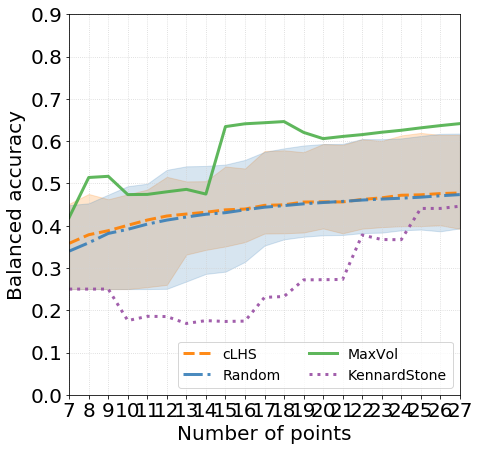

In [461]:
num=[4,1,2,3]

plt.figure(figsize=(10,7))
plt.plot(x_ac_clhs, y_ac_clhs, marker='', color=palette(num[0]), linewidth=3, alpha=0.9,linestyle="--")
plt.fill_between(x_ac_clhs, *qs_clhs, alpha=0.2, color = palette(num[0]))
plt.plot(x_ac_rnd, y_ac_rnd, marker='', color=palette(num[1]), linewidth=3, alpha=0.9, linestyle="-.")
plt.fill_between(x_ac_rnd, *qs_rnd, alpha=0.2, color=palette(num[1]))
plt.plot(x_ac_mv, y_ac_mv, marker='', color=palette(num[2]), linewidth=3, alpha=0.9)
plt.plot(x_ac_ks, y_ac_ks, marker='', color=palette(num[3]), linewidth=3, alpha=0.9, linestyle=":")

labels=["cLHS","Random","MaxVol","KennardStone"]
plt.legend(labels, loc=4, ncol=2, fontsize=14)
 
plt.xlabel("Number of points", fontsize=20)
plt.ylabel("Balanced accuracy", fontsize=20)


plt.xticks(x_ac, size=20)
plt.yticks(size=20)
plt.axis([7,27,0,0.9])
plt.grid()
plt.rc('grid', linestyle=":", color='lightgrey')

plt.savefig('custom_accuracy.pdf', format='pdf', bbox_inches='tight') #, dpi=200)

### Plain accuracy

In [ ]:
plt.style.use('default') 

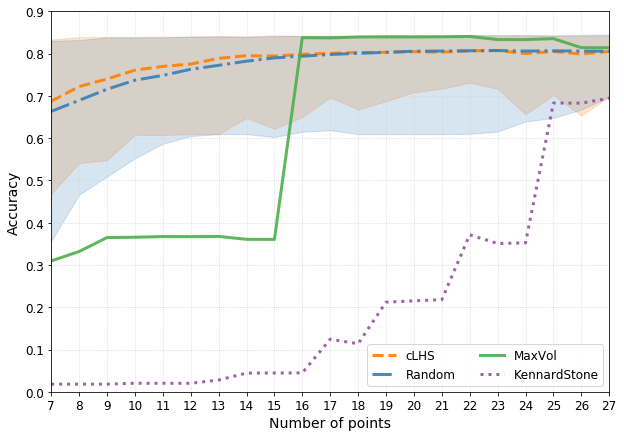

In [388]:
num=[4,1,2,3]

plt.figure(figsize=(10,7))
plt.plot(plain_x_ac_clhs, plain_y_ac_clhs, marker='', color=palette(num[0]), linewidth=3, alpha=0.9,linestyle="--")
plt.fill_between(plain_x_ac_clhs, *plain_qs_clhs, alpha=0.2, color = palette(num[0]))
plt.plot(plain_x_ac_rnd, plain_y_ac_rnd, marker='', color=palette(num[1]), linewidth=3, alpha=0.9, linestyle="-.")
plt.fill_between(plain_x_ac_rnd, *pl_qs, alpha=0.2, color=palette(num[1]))
plt.plot(x_ac_mv, y_ac_mv, marker='', color=palette(num[2]), linewidth=3, alpha=0.9)
plt.plot(plain_x_ac_ks, plain_y_ac_ks, marker='', color=palette(num[3]), linewidth=3, alpha=0.9, linestyle=":")

labels=["cLHS","Random","MaxVol","KennardStone"]
plt.legend(labels, loc=4, ncol=2, fontsize=12)
 
# Add titles
#plt.title("A (bad) Spaghetti plot", loc='left', fontsize=14, fontweight=0, color='orange')
plt.xlabel("Number of points", fontsize=14)
plt.ylabel("Accuracy", fontsize=14)



plt.xticks(x_ac, size=12)
plt.yticks(size=12)
plt.axis([7,27,0,0.9])
plt.grid()
plt.rc('grid', linestyle=":", color='lightgrey')

plt.savefig('plain_accuracy.pdf', format='pdf', bbox_inches='tight') #, dpi=200)

### Soil map

In [41]:
n=16
f_cut = lambda idx, i : f_cut_eps(idx, i, X=X[:,-2:], eps=0.1)
#f_penal = f_penal_2D(X = ar_5features[:, -2], Y = ar_5features[:, -1], bnd = 0.2, level = 1)
_, idx_mv_map = points_selection_accuracy(X,y, n_pnts = n, cut_fun = f_cut, penalty = None, to_ret_pred=True)

Accuracy: 0.66


In [17]:
idx_clhs_map = clhs.clhs(X, num_samples = n)

X_sc = (X - X.mean(axis=0)) / X.std(axis=0, ddof=1)
idx_ks_map, _ = kennardstonealgorithm.kennardstonealgorithm(X_sc, n)

cLHS:  0%|          |0/10000 [Elapsed time: 0, ETA: 0, ?it/s]/home/apetrovskaya/anaconda3/envs/gdal/lib/python3.7/site-packages/numpy/lib/function_base.py:2559: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/apetrovskaya/anaconda3/envs/gdal/lib/python3.7/site-packages/numpy/lib/function_base.py:2560: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
cLHS: 14%|█▍        |1429/10000 [Elapsed time: 2.4283699989318848, ETA: 13.551906905790675, 632.46it/s]/home/apetrovskaya/anaconda3/envs/gdal/lib/python3.7/site-packages/clhs/clhs.py:760: RuntimeWarning: overflow encountered in exp
  anneal_fac = np.exp(-delta_obj / temp)
cLHS:100%|██████████|10000/10000 [Elapsed time: 17.190954208374023, ETA: 0.0, 581.70it/s]                


In [18]:
idx_rnd_map = np.random.choice(X.shape[0], n)

In [19]:
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
svc = SVC()

def prediction (idx):
    gnb = GaussianNB()
    gnb_model = gnb.fit(X[idx], y[idx])
    gnb_pred = gnb_model.predict(X)
    score = gnb_model.score(X,y)
    return gnb_pred, score

res_mv_map, mv_score = prediction(idx_mv_map)
res_clhs_map, clhs_score = prediction(idx_clhs_map['sample_indices'])
res_ks_map, ks_score = prediction(idx_ks_map)
res_rnd_map, rnd_score = prediction(idx_rnd_map)

lst = [res_mv_map,res_clhs_map,res_rnd_map, res_ks_map]
lst_score = [mv_score,clhs_score ,rnd_score, ks_score]
lst_idx = [idx_mv_map,idx_clhs_map['sample_indices'], idx_rnd_map, idx_ks_map]

In [25]:
mv_score_bal = calc_score(idx_mv_map,X,y)
clhs_score_bal = calc_score(idx_clhs_map['sample_indices'],X,y)
ks_score_bal = calc_score(idx_ks_map,X,y)
rnd_score_bal = calc_score(idx_rnd_map,X,y)

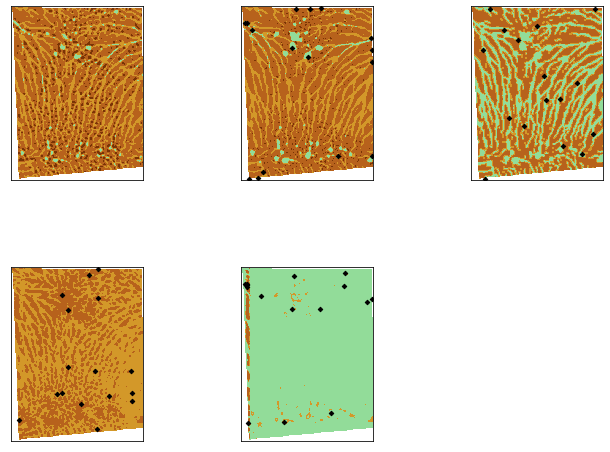

In [25]:
extent = [298248.75,298248.75+217,5717898.75,5717898.75+285]
import matplotlib.colors

plt.subplots_adjust(wspace=0.1,hspace = 0.5)
plt.subplot(231)
cmap = matplotlib.colors.ListedColormap(["#92DC99", "#D39829", "#B7621C", "#793405"])
plt.imshow(soil_types_raw2['Soil_types'].values.reshape(shapes[0]), cmap=cmap)
plt.xticks([])
plt.yticks([]);


sp = [232,233,234,235]
for i in range(len(lst)):
    plt.subplot(sp[i])
    nan = df_with_soil_types.copy() 
    nan = np.asmatrix(nan)[:,-1]
    nan[np.where(nan != global_nodata)] = lst[i]
    nan[np.where(nan == global_nodata)] = float('NaN')

    plt.imshow(nan.reshape((285, 217)), cmap=cmap)
    XY = add_coords(size=shapes[0], idx_good_mask=df_drop_with_types['Soil_types'].index.values)
    plt.scatter(XY[lst_idx[i], 0], XY[lst_idx[i], 1], marker = "D", s=10, color='black')
    plt.xticks([])
    plt.yticks([]);
plt.savefig('4soil_maps.png', dpi=300)